In [5]:
########## Imports ##########
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import time
import pickle
import os
import datetime

from utils import cost, fonctions

#Preprocessing, Upsampling, Model Selection, Model Evaluation
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, recall_score 
from sklearn.metrics import classification_report, confusion_matrix, roc_curve
from imblearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import cross_val_predict, cross_val_score, learning_curve, cross_validate
from sklearn.feature_selection import RFECV
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV
from imblearn.pipeline import Pipeline

# Modèles
#!pip install catboost
#!brew install cmake libomp
#!pip install lightgbm
from sklearn.dummy import DummyClassifier # modèle baseline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier

# Data drift
#!pip install evidently

# Feature importance
#!pip install shap
import shap
from sklearn.inspection import permutation_importance

# Warnings
import warnings
warnings.simplefilter(action = 'ignore')
warnings.filterwarnings('ignore')

# MLFLOW
#!pip install mlflow
import mlflow
from mlflow.models import infer_signature
import logging

# Set display preferences
pd.set_option('display.max_row', 250)
pd.set_option('display.max_column', 200)

In [3]:
# TERMINAL (pour traquer perfs des différents tests avec mlflow)
# Run a local tracking server

#mlflow server --host 127.0.0.1 --port 8080

In [6]:
########## Import des données ##########

path = '' #-> en local
filepath = os.path.join(path, 'data/df_train')

with open(filepath, 'rb') as f:
    df = pickle.load(f)

df.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_OUTLIERS,PREVIOUS_LOANS_COUNT,PREV_BUR_MEAN_DAYS_CREDIT,PREV_BUR_MEAN_CREDIT_DAY_OVERDUE,PREV_BUR_MEAN_DAYS_CREDIT_ENDDATE,PREV_BUR_MEAN_DAYS_ENDDATE_FACT,PREV_BUR_MEAN_AMT_CREDIT_MAX_OVERDUE,PREV_BUR_MEAN_CNT_CREDIT_PROLONG,PREV_BUR_MEAN_AMT_CREDIT_SUM,PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT,PREV_BUR_MEAN_AMT_CREDIT_SUM_LIMIT,PREV_BUR_MEAN_AMT_CREDIT_SUM_OVERDUE,PREV_BUR_MEAN_DAYS_CREDIT_UPDATE,PREV_BUR_MEAN_AMT_ANNUITY,PREV_BUR_MEAN_MONTHS_BALANCE_MEAN,PREVIOUS_APPLICATION_COUNT,PREV_APPL_MEAN_AMT_ANNUITY,PREV_APPL_MEAN_AMT_APPLICATION,PREV_APPL_MEAN_AMT_CREDIT,PREV_APPL_MEAN_AMT_DOWN_PAYMENT,PREV_APPL_MEAN_AMT_GOODS_PRICE,PREV_APPL_MEAN_HOUR_APPR_PROCESS_START,PREV_APPL_MEAN_NFLAG_LAST_APPL_IN_DAY,PREV_APPL_MEAN_RATE_DOWN_PAYMENT,PREV_APPL_MEAN_RATE_INTEREST_PRIMARY,PREV_APPL_MEAN_RATE_INTEREST_PRIVILEGED,PREV_APPL_MEAN_DAYS_DECISION,PREV_APPL_MEAN_SELLERPLACE_AREA,PREV_APPL_MEAN_CNT_PAYMENT,PREV_APPL_MEAN_DAYS_FIRST_DRAWING,PREV_APPL_MEAN_DAYS_FIRST_DUE,PREV_APPL_MEAN_DAYS_LAST_DUE_1ST_VERSION,PREV_APPL_MEAN_DAYS_LAST_DUE,PREV_APPL_MEAN_DAYS_TERMINATION,PREV_APPL_MEAN_NFLAG_INSURED_ON_APPROVAL,PREV_APPL_MEAN_CARD_MEAN_MONTHS_BALANCE,PREV_APPL_MEAN_CARD_MEAN_AMT_BALANCE,PREV_APPL_MEAN_CARD_MEAN_AMT_CREDIT_LIMIT_ACTUAL,PREV_APPL_MEAN_CARD_MEAN_AMT_DRAWINGS_ATM_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_DRAWINGS_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_DRAWINGS_OTHER_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_DRAWINGS_POS_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_INST_MIN_REGULARITY,PREV_APPL_MEAN_CARD_MEAN_AMT_PAYMENT_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_PAYMENT_TOTAL_CURRENT,PREV_APPL_MEAN_CARD_MEAN_AMT_RECEIVABLE_PRINCIPAL,PREV_APPL_MEAN_CARD_MEAN_AMT_RECIVABLE,PREV_APPL_MEAN_CARD_MEAN_AMT_TOTAL_RECEIVABLE,PREV_APPL_MEAN_CARD_MEAN_CNT_DRAWINGS_ATM_CURRENT,PREV_APPL_MEAN_CARD_MEAN_CNT_DRAWINGS_CURRENT,PREV_APPL_MEAN_CARD_MEAN_CNT_DRAWINGS_OTHER_CURRENT,PREV_APPL_MEAN_CARD_MEAN_CNT_DRAWINGS_POS_CURRENT,PREV_APPL_MEAN_CARD_MEAN_CNT_INSTALMENT_MATURE_CUM,PREV_APPL_MEAN_CARD_MEAN_SK_DPD,PREV_APPL_MEAN_CARD_MEAN_SK_DPD_DEF,PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_VERSION,PREV_

In [7]:
df.shape

(291053, 175)

In [8]:
########## Import des données de la target ##########
filepath = os.path.join(path, 'data/target')

with open(filepath, 'rb') as f:
    df_target = pickle.load(f)

df_target.head()

SK_ID_CURR
100002    1
100003    0
100004    0
100006    0
100007    0
Name: TARGET, dtype: int64

In [9]:
# Séparation en train et en test

X = df
y = df_target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

print('train shape :', X_train.shape)
print('test shape :', X_test.shape)

print('train shape (target):', y_train.shape)
print('test shape (target):', y_test.shape)

# TO DO
# -> faire varier test_size
# -> fixer le random state pour chaque analyse

train shape : (232842, 175)
test shape : (58211, 175)
train shape (target): (232842,)
test shape (target): (58211,)


In [6]:
######### ML FLOW #########

# EXPLICATIONS A DEVELOPPER

# à faire ici ? ou à mettre dans runs ?
mlflow.set_tracking_uri(uri = 'http://127.0.0.1:8080')
mlflow.set_experiment(experiment_name = 'Scoring implementation')

<Experiment: artifact_location='mlflow-artifacts:/993335670932985653', creation_time=1714995822774, experiment_id='993335670932985653', last_update_time=1714995822774, lifecycle_stage='active', name='Scoring implementation', tags={}>

In [7]:
# ici :
# -> données avec labels -> Supervised Learning
# -> 0/1 (variable discrète) -> Classification

# Le projet consiste à mieux comprendre le défaut de crédit rencontré chez certain client, l'anticiper, l'estimer, etc…
# La prédiction peut se résumer par une sortie binaire, une acceptation de crédit, ou un refus de crédit.
# Afin d'avoir une première idée des performances possibles, la modélisation par régression logistique permettra d'obtenir une baseline.

### Fonction de coût

In [8]:
######### Analyse des erreurs de prédiction ########

# L'idée est d'éviter les clients avec un fort risque de défaut. Il est donc nécessaire de pénaliser les FP et FN.
# On part du F-Score, mesure de la performance d'un modèle de classification qui combine les mesures de précision et de rappel, elles mêmes basées sur les taux de vrais positifs, faux positifs et faux négatifs
# (donc va être idéal à adapter dans notre cas)

# les pertes d'un crédit en raison d'une mauvaise classification dépendront des probabilités Faux Positifs et Faux Négatifs.

# - FP (False Positive) :
# = quand la prédiction est positive, mais la valeur réelle est négative
# va induire une perte réelle si le crédit client accepté se transforme en défaut de paiement. -> PENALITE DE 10

# - FN (False Negative) :
# = quand la prédiction est négative, mais la valeur réelle est positive
# va induire une perte d'opportunité si le crédit client est refusé à tort, alors qu'il aurait été en mesure d'être remboursé. -> PENALITE DE 1

# La fonction de coût personnalisée est définie dans le fichier cost.py (dossier packages).

In [9]:
# En parallèle, maintenir pour comparaison et contrôle des mesures comme l'AUC et l’accuracy

### Gestion du déséquilibre des classes (SMOTE)

In [10]:
# -> voir tests effectués notebook "smote.ipynb"

In [11]:
sm = SMOTE(
    k_neighbors = 5, # nombre de plus proches voisins
    sampling_strategy = 'auto', # taux d'observations minoritaires à atteindre
    random_state = 0,
    n_jobs = None
    )

# Application du SMOTE aux données
X_train_smote, y_train_smote = sm.fit_resample(X_train, y_train)

print(f'Target 0: {round(sum(y_train_smote == 0)/len(y_train_smote)*100, 1)}% | Target 1: {round(sum(y_train_smote == 1)/len(y_train_smote)*100, 1)}%')

Target 0: 50.0% | Target 1: 50.0%


### Modèle Baseline

In [12]:
# Modèle baseline = DummyClassifier
# https://scikit-learn.org/stable/modules/generated/sklearn.dummy.DummyClassifier.html

# sert de base pour comparer avec des modèles plus complexes
# fait des prédictions en ignorant les input features
# prets attribués de manière aléatoire

In [13]:
# Entrainement
dc = DummyClassifier()
dc.fit(X_train_smote, y_train_smote)

# Prédictions et évaluations
roc_auc = roc_auc_score(y_test, dc.predict_proba(X_test)[:,1])
print('AUC : %0.4f' %roc_auc)
print(classification_report(y_test, dc.predict(X_test)))

AUC : 0.5000
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     53329
           1       0.00      0.00      0.00      4882

    accuracy                           0.92     58211
   macro avg       0.46      0.50      0.48     58211
weighted avg       0.84      0.92      0.88     58211



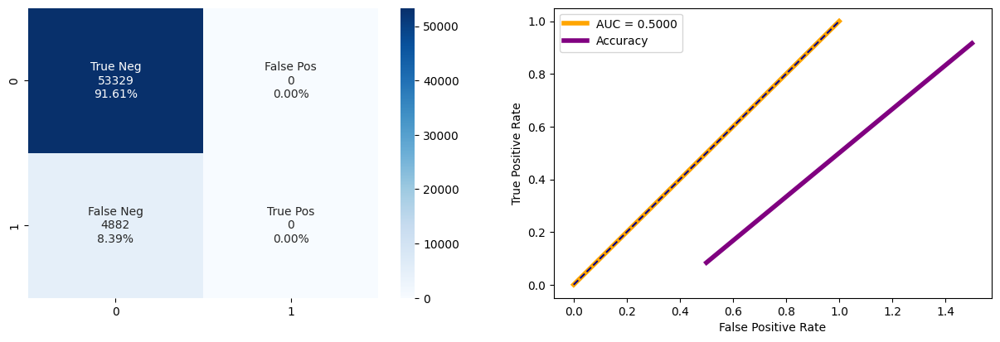

In [14]:
# Visualisation des résultats
fonctions.cf_matrix_roc_auc(dc, y_test, X_test, dc.predict(X_test), dc.predict_proba(X_test)[:,1])

In [15]:
# AUC = Area Under the Curve ROC
# courbe ROC : Recall in y-axis and 1-Specificity in x-axis

# -> indicates how well the probabilities from the positive classes are separated from the negative classes
# 0,5 -> 50%/50% -> le marqueur est non informatif
# entre 0,5 et 1,0 -> discrimination

# Accuracy
# corresponds to the number of correct predictions over the total number of predictions (percentage of correct predictions of the model (on the test set))
# plus l'accuracy est proche de 1 -> plus on a de prédictions correctes

In [16]:
# Evaluation
print(f'AUC = {roc_auc_score(y_test, dc.predict_proba(X_test)[:,1])}')
print(f'Accuracy = {accuracy_score(y_test, dc.predict(X_test))}')
print(f'Métrique coût custom = {cost.custom_metric(y_test, dc.predict(X_test))}')

AUC = 0.5
Accuracy = 0.9161326896978235
Métrique coût custom = 4509


In [17]:
# AUC de 0,5 -> non informatif
# Accuracy de 0,9 -> 91% de prédictions correctes, mais n'indique pas proportion de faux positifs

In [18]:
# Tracking du modèle baseline dans ML Flow

# Define the model hyperparameters
params = {
    'strategy': 'most_frequent'
}

# Train the model
dc = DummyClassifier(**params)
dc.fit(X_train_smote, y_train_smote)

# Predict on the test set
y_pred = dc.predict(X_test)

# Calculate metrics
custom = cost.custom_metric(y_test, y_pred)
auc = roc_auc_score(y_test, dc.predict_proba(X_test)[:,1])
accuracy = accuracy_score(y_test, dc.predict(X_test))

# Set our tracking server uri for logging
mlflow.set_tracking_uri(uri = 'http://127.0.0.1:8080')

# Create a new MLflow Experiment
mlflow.set_experiment('Scoring implementation')

# Start an MLflow run
with mlflow.start_run():
    # Log the hyperparameters
    mlflow.log_params(params)

    # Log the loss metric
    mlflow.log_metric('custom', custom)
    mlflow.log_metric('AUC', auc)
    mlflow.log_metric('Accuracy', accuracy)

    # Set a tag that we can use to remind ourselves what this run was for
    mlflow.set_tag('Training Info', 'Basic baseline model for loan data')

    # Infer the model signature
    signature = infer_signature(X_train_smote, dc.predict(X_train_smote))

    # Log the model
    model_info = mlflow.sklearn.log_model(
        sk_model = dc,
        artifact_path = 'projet7',
        signature = signature,
        input_example = X_train_smote,
        registered_model_name = 'tracking-quickstart',
    )

Registered model 'tracking-quickstart' already exists. Creating a new version of this model...
2024/05/19 23:18:43 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: tracking-quickstart, version 32
Created version '32' of model 'tracking-quickstart'.


### Regression logistique

In [19]:
# Régression Logistique
lr = LogisticRegression()
lr.fit(X_train_smote, y_train_smote)

# Prédictions et évaluations
roc_auc = roc_auc_score(y_test, lr.predict_proba(X_test)[:,1])
print('AUC : %0.4f' %roc_auc)
print(classification_report(y_test, lr.predict(X_test)))

AUC : 0.7406
              precision    recall  f1-score   support

           0       0.96      0.70      0.81     53329
           1       0.17      0.66      0.26      4882

    accuracy                           0.69     58211
   macro avg       0.56      0.68      0.54     58211
weighted avg       0.89      0.69      0.76     58211



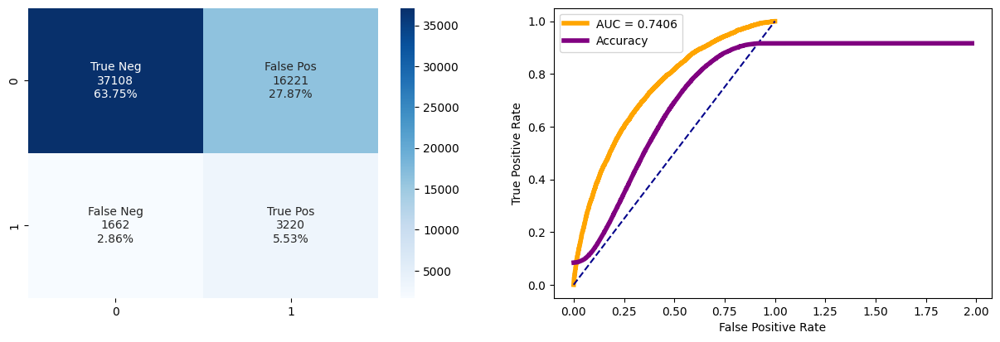

In [20]:
# Visualisation des résultats
fonctions.cf_matrix_roc_auc(lr, y_test, X_test, lr.predict(X_test), lr.predict_proba(X_test)[:,1])

In [21]:
# Evaluation
print(f'AUC = {roc_auc_score(y_test, lr.predict_proba(X_test)[:,1])}')
print(f'Accuracy = {round(accuracy_score(y_test, lr.predict(X_test)), 2)}')
print(f'Métrique coût custom = {cost.custom_metric(y_test, lr.predict(X_test))}')

AUC = 0.7406382749753682
Accuracy = 0.69
Métrique coût custom = 7487


In [22]:
# mieux ! test avec d'autres modèles et comparaison

### Test de différents modèles

In [23]:
# Liste des modèles qu'on souhaite tester

models = [
    DummyClassifier(), # modèle baseline
    KNeighborsClassifier(), # k-nearest neighbors
    LogisticRegression(), # Regression logistique
    GaussianNB(), # Naives Bayes
    #SVC(), # -> long !! # Support Vector Machines - beaucoup trop long -> exclu d'office
    CatBoostClassifier(logging_level = 'Silent'),
    LGBMClassifier(), # LightGBM
    DecisionTreeClassifier(), # Arbres de decision
    RandomForestClassifier(), # random forest
    AdaBoostClassifier(),
    GradientBoostingClassifier(), # gradient boosting
    XGBClassifier() # XGBoost - erreur sur mac perso mais pas pro
    ]

DummyClassifier


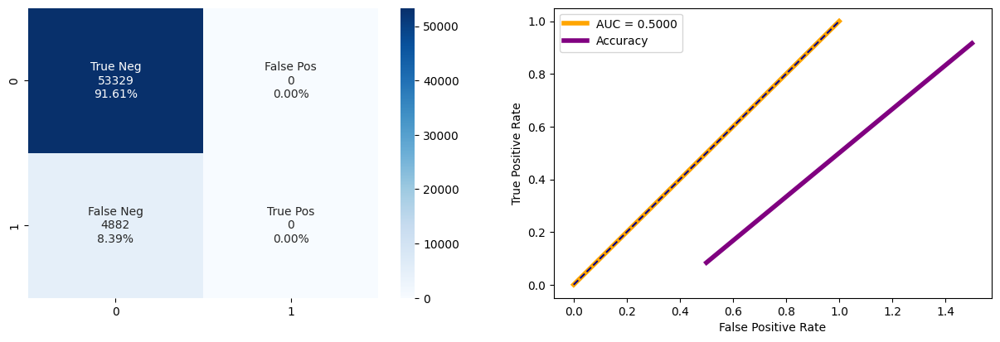

KNeighborsClassifier


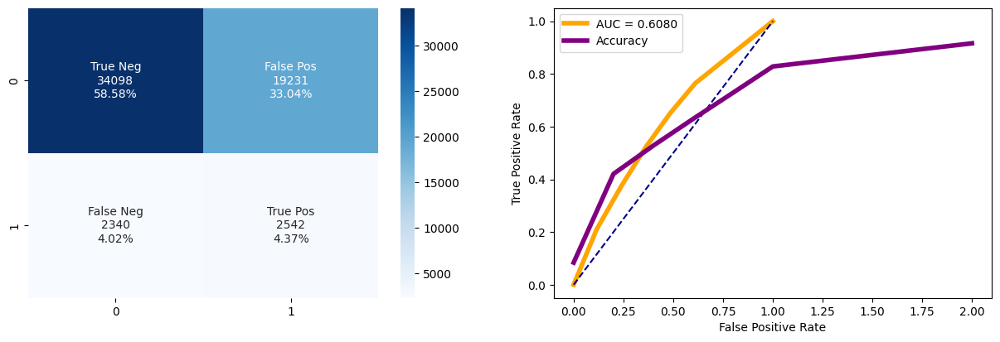

LogisticRegression


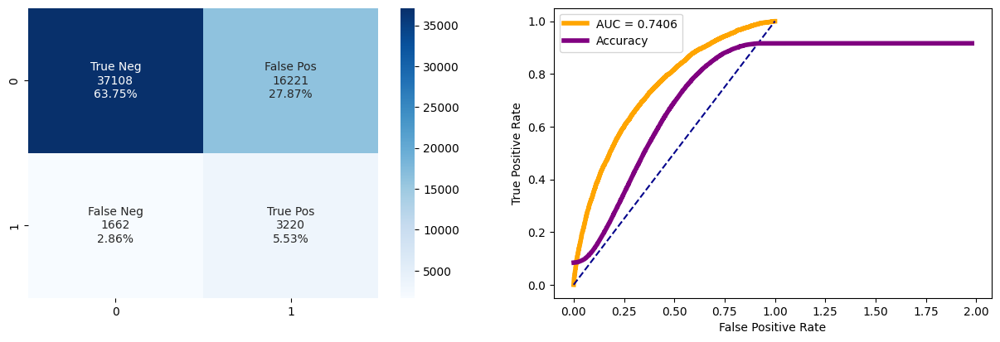

GaussianNB


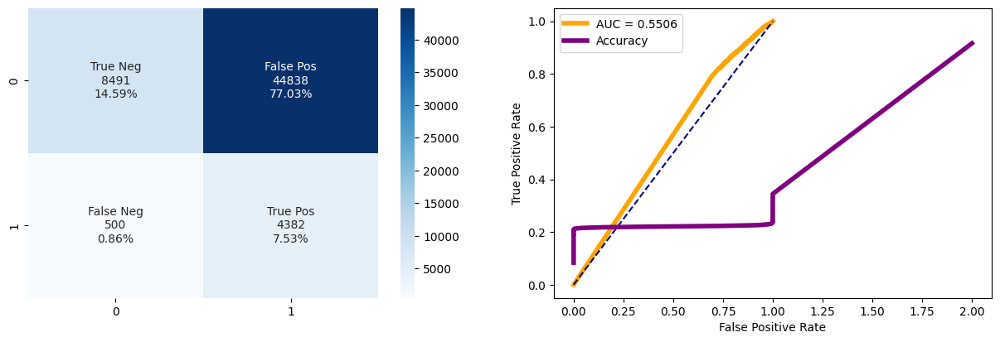

CatBoostClassifier


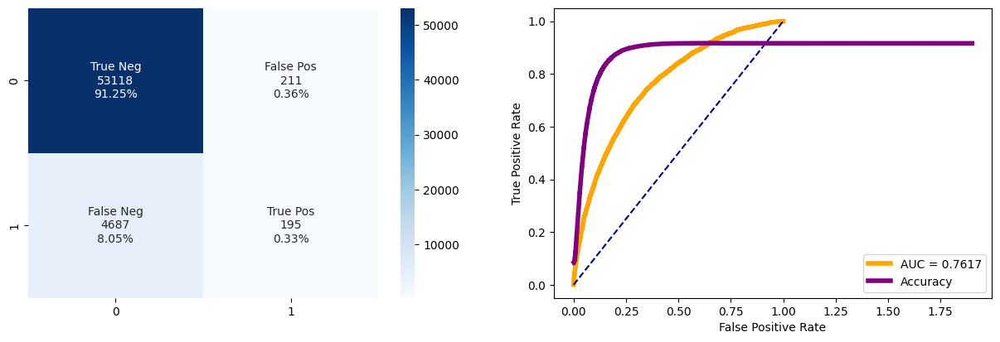

LGBMClassifier
[LightGBM] [Info] Number of positive: 213879, number of negative: 213879
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.071990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 38078
[LightGBM] [Info] Number of data points in the train set: 427758, number of used features: 172
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


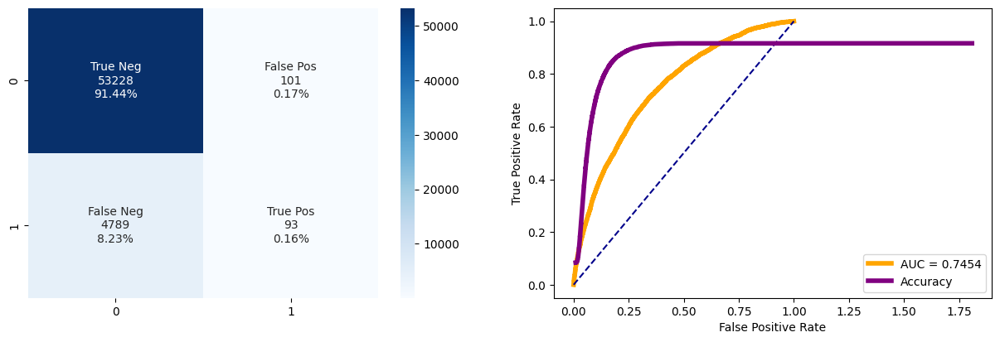

DecisionTreeClassifier


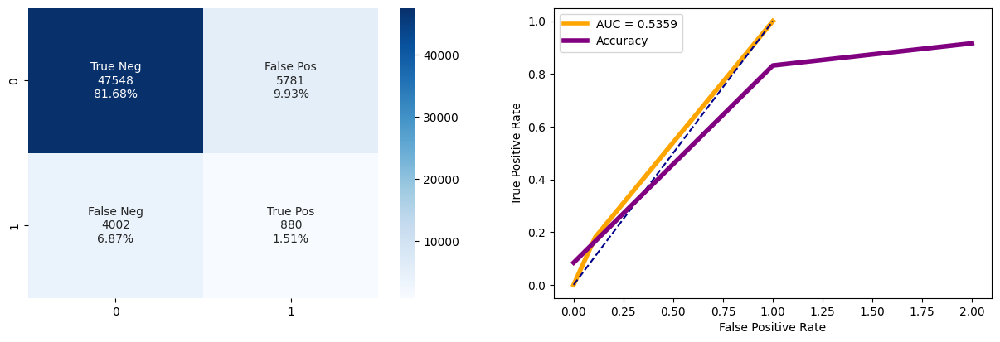

RandomForestClassifier


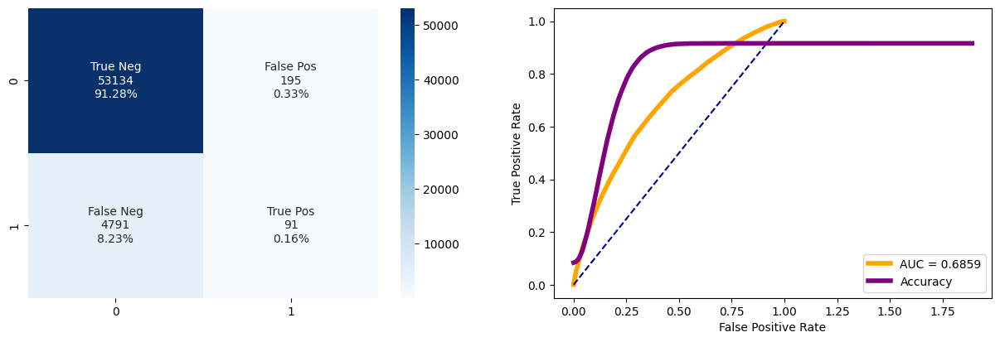

AdaBoostClassifier


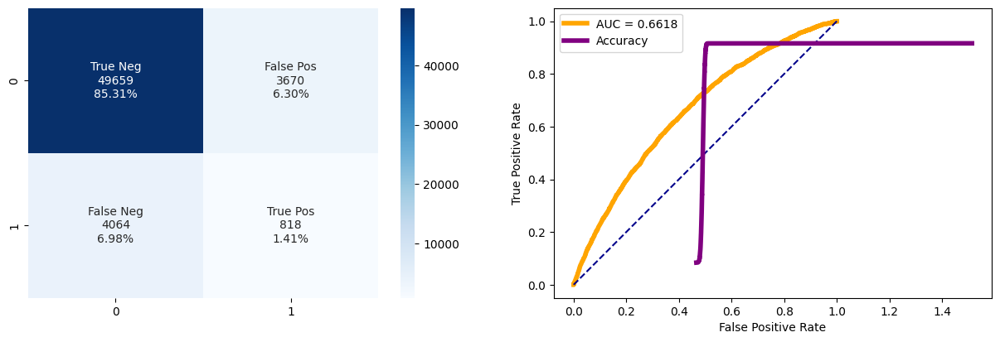

GradientBoostingClassifier


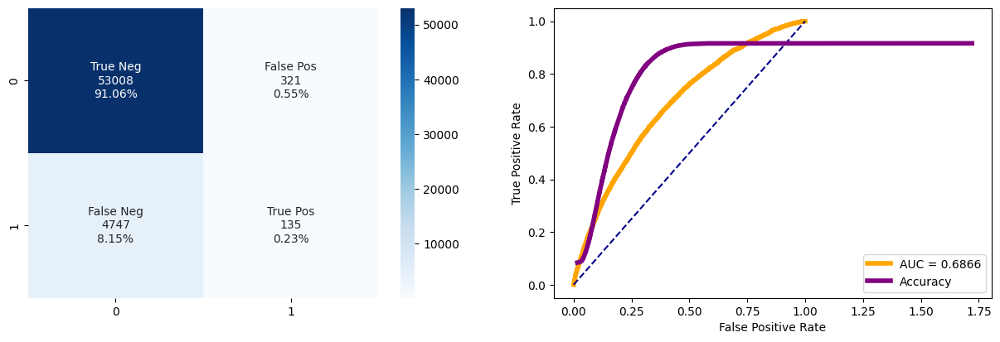

XGBClassifier


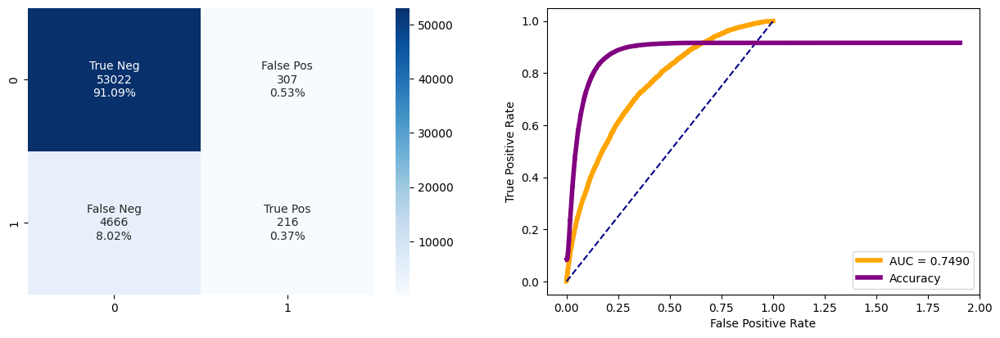

In [24]:
# mlflow et smote

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
custom = []
time_ = []

# Set our tracking server uri for logging
mlflow.set_tracking_uri(uri = 'http://127.0.0.1:8080')
mlflow.set_experiment(experiment_name = 'scoring')

with mlflow.start_run(run_name = 'Test modèles'):
    for model in models:
        print(type(model).__name__)
        start = time.time()
        results = fonctions.train_models(model, X_train_smote, X_test, y_train_smote, y_test)

        name.append(type(model).__name__)
        auc.append(results['AUC'])
        accuracy.append(results['Accuracy'])
        precision.append(results['Precision'])
        recall.append(results['Recall'])
        f1.append(results['F1'])
        custom.append(results['Custom'])
        time_.append(time.time() - start)

        mlflow.sklearn.log_model(model, 'model')
        mlflow.log_metric('AUC', results['AUC'])
        mlflow.log_metric('Accuracy', results['Accuracy'])
        mlflow.log_metric('custom', results['Custom'])

        # Visualisation des résultats
        fonctions.cf_matrix_roc_auc(model, y_test, X_test, model.predict(X_test), model.predict_proba(X_test)[:,1])

In [25]:
# Créer un dataframe avec résultats
base_models = pd.DataFrame(data = [name, auc, accuracy, precision, recall, f1, custom, time_]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Custom', 'Time']
base_models.sort_values('AUC', ascending = False, inplace = True)
base_models.reset_index(drop = True, inplace = True)
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,Custom,Time
0,CatBoostClassifier,0.761734,0.915858,0.480296,0.039943,0.073752,6232,56.964261
1,XGBClassifier,0.749036,0.914569,0.413002,0.044244,0.079926,6271,80.028737
2,LGBMClassifier,0.745436,0.915995,0.479381,0.01905,0.036643,5330,6.150363
3,LogisticRegression,0.740638,0.69279,0.165629,0.659566,0.26477,7487,9.405074
4,GradientBoostingClassifier,0.686599,0.912937,0.296053,0.027653,0.050581,5352,749.099381
5,RandomForestClassifier,0.685906,0.914346,0.318182,0.01864,0.035217,5120,247.528859
6,AdaBoostClassifier,0.661805,0.867139,0.182264,0.167554,0.1746,6167,141.090218
7,KNeighborsClassifier,0.607985,0.629434,0.11675,0.520688,0.190733,-5991,312.258105
8,GaussianNB,0.550602,0.221144,0.089029,0.897583,0.16199,-36965,0.729525
9,DecisionTreeClassifier,0.535926,0.831939,0.132112,0.180254,0.152473,2627,43.061602


In [26]:
base_models.sort_values('Custom', ascending = False)

,Model,AUC,Accuracy,Precision,Recall,F1,Custom,Time
3,LogisticRegression,0.740638,0.69279,0.165629,0.659566,0.26477,7487,9.405074
1,XGBClassifier,0.749036,0.914569,0.413002,0.044244,0.079926,6271,80.028737
0,CatBoostClassifier,0.761734,0.915858,0.480296,0.039943,0.073752,6232,56.964261
6,AdaBoostClassifier,0.661805,0.867139,0.182264,0.167554,0.1746,6167,141.090218
4,GradientBoostingClassifier,0.686599,0.912937,0.296053,0.027653,0.050581,5352,749.099381
2,LGBMClassifier,0.745436,0.915995,0.479381,0.01905,0.036643,5330,6.150363
5,RandomForestClassifier,0.685906,0.914346,0.318182,0.01864,0.035217,5120,247.528859
10,DummyClassifier,0.5,0.916133,0.0,0.0,0.0,4509,0.055517
9,DecisionTreeClassifier,0.535926,0.831939,0.132112,0.180254,0.152473,2627,43.061602
7,KNeighborsClassifier,0.607985,0.629434,0.11675,0.520688,0.190733,-5991,312.258105


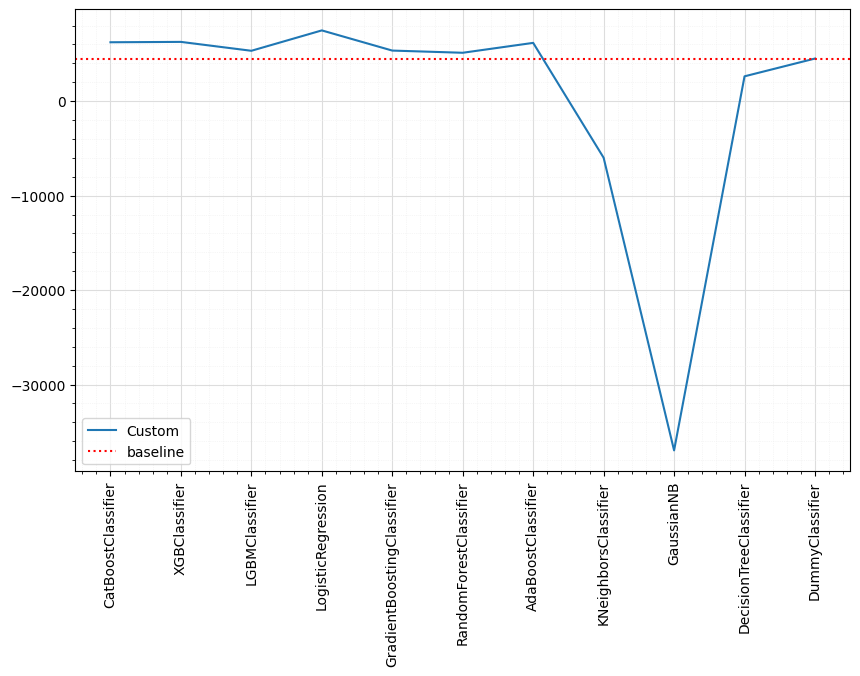

In [27]:
# plot results métrique custom only
base_models_custom = base_models[['Model', 'Custom']]

plt.figure(figsize = (10, 6))
for i in base_models_custom.drop(['Model'], axis = 1).columns:
    plt.plot(base_models_custom['Model'], base_models_custom[i], label = i)
plt.axhline(y = 4509, color = 'r', linestyle = ':', label = 'baseline') # les résultats obtenus avec le modèle baseline sont pris pour référence
plt.legend(loc = 'best')
plt.grid(which = 'major', color = '#DDDDDD', linewidth = 0.8)
plt.grid(which = 'minor', color = '#EEEEEE', linestyle = ':', linewidth = 0.5)
plt.minorticks_on()
plt.xticks(rotation = 90)
plt.show()

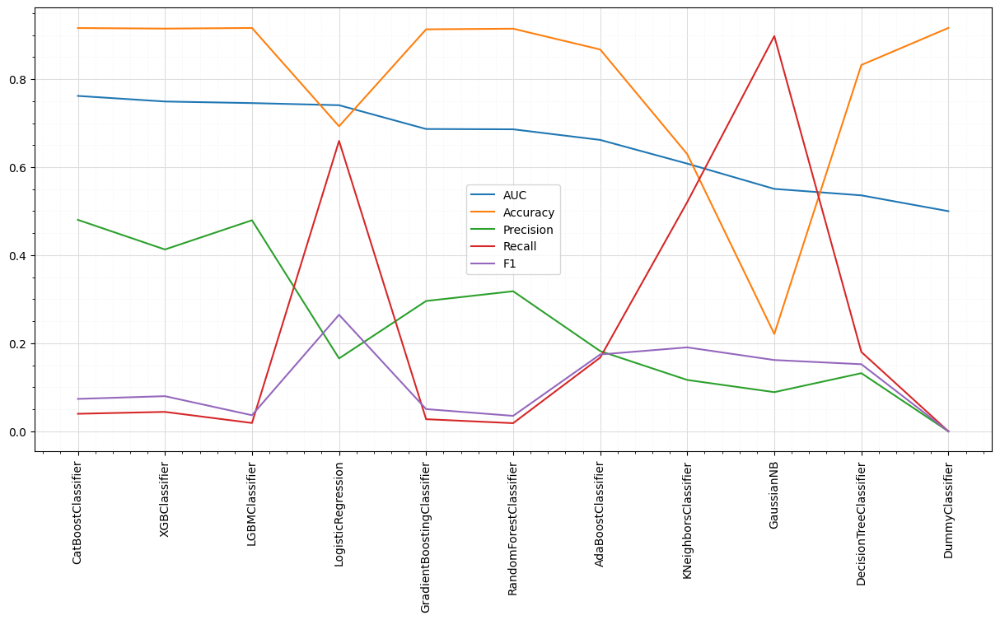

In [28]:
# plot results métrique sans custom
base_models_sans_custom = base_models[['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1']]

plt.figure(figsize = (15, 7))
for i in base_models_sans_custom.drop(['Model'], axis = 1).columns:
    plt.plot(base_models_sans_custom['Model'], base_models_sans_custom[i], label = i)
plt.legend(loc = 'best')
plt.grid(which = 'major', color = '#DDDDDD', linewidth = 0.8)
plt.grid(which = 'minor', color = '#EEEEEE', linestyle = ':', linewidth = 0.5)
plt.minorticks_on()
plt.xticks(rotation = 90)
plt.show()

In [11]:
# Make scorer
# -> permet de définir dans quel "sens" prendre notre nouvelle métrique (ici, plus la valeur est grande, mieux c'est)
custom_score = make_scorer(cost.custom_metric, greater_is_better = True)
custom_score

make_scorer(custom_metric)

In [31]:
########### Fine tunning - CatBoostClassifier() ##############

XGBClassifier


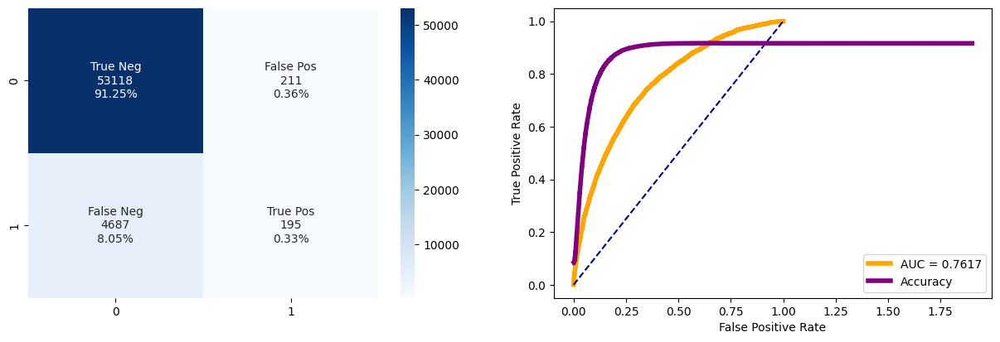

In [32]:
with mlflow.start_run(run_name = 'Fine tunning'):
    print(type(model).__name__)
    # Instancier le modèle
    cat = CatBoostClassifier(logging_level = 'Silent')

    # Entrainer le modèle
    cat.fit(X_train_smote, y_train_smote)

    # Predire
    y_pred_test_default = cat.predict(X_test)
    y_pred_train_default = cat.predict(X_train_smote)

    # Visualisation des résultats
    fonctions.cf_matrix_roc_auc(cat, y_test, X_test, cat.predict(X_test), cat.predict_proba(X_test)[:,1])

    mlflow.sklearn.log_model(cat, 'CatBoostClassifier')
    mlflow.log_metric('custom', cost.custom_metric(y_test, cat.predict(X_test)))
    mlflow.log_metric('AUC', roc_auc_score(y_test, cat.predict_proba(X_test)[:,1]))
    mlflow.log_metric('Accuracy', accuracy_score(y_test, cat.predict(X_test)))

In [33]:
# utilisation d'un pipeline de données

# Un pipeline de données en Python est une série de traitements de données organisés en étapes, où la sortie de chaque étape est utilisée comme entrée pour l'étape suivante.
# Les pipelines de données sont couramment utilisés dans les projets de science des données et d'apprentissage automatique pour préparer et transformer les données avant de les utiliser
# pour l'entraînement de modèles ou l'analyse de données.

# Les pipelines de données peuvent être créés en utilisant des bibliothèques Python telles que scikit-learn, Keras, TensorFlow et PyTorch.
# Dans scikit-learn, par exemple, les pipelines de données peuvent être créés en utilisant la classe Pipeline, qui permet de chaîner plusieurs étapes de traitement de données,
# telles que la normalisation, la sélection de caractéristiques, la réduction de la dimensionnalité et la classification, en une seule étape de transformation de données.

# Les pipelines de données offrent plusieurs avantages, tels que :
# - La modularité : les étapes de traitement de données peuvent être définies et testées séparément, ce qui facilite la maintenance et le débogage.
# - La réutilisabilité : les pipelines de données peuvent être réutilisés pour différents projets et différents jeux de données, ce qui réduit le temps et les efforts nécessaires pour préparer les données.
# - La reproductibilité : les pipelines de données peuvent être enregistrés et partagés avec d'autres personnes, ce qui facilite la collaboration et la reproductibilité des résultats.

# En résumé, un pipeline de données en Python est une série de traitements de données organisés en étapes, où la sortie de chaque étape est utilisée comme entrée pour l'étape suivante.
# Les pipelines de données sont couramment utilisés dans les projets de science des données et d'apprentissage automatique pour préparer et transformer les données avant de les utiliser
# pour l'entraînement de modèles ou l'analyse de données

Pipeline
Fitting 5 folds for each of 280 candidates, totalling 1400 fits


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.

0:	learn: 0.6860320	total: 197ms	remaining: 1.78s
1:	learn: 0.6773822	total: 356ms	remaining: 1.42s
2:	learn: 0.6707843	total: 1.09s	remaining: 2.56s
3:	learn: 0.6645330	total: 1.61s	remaining: 2.42s
4:	learn: 0.6520802	total: 2.15s	remaining: 2.15s
5:	learn: 0.6476864	total: 2.53s	remaining: 1.69s
0:	learn: 0.6895313	total: 322ms	remaining: 2.9s
0:	learn: 0.6894782	total: 346ms	remaining: 3.12s
0:	learn: 0.6858038	total: 418ms	remaining: 3.76s
6:	learn: 0.6366813	total: 2.96s	remaining: 1.27s
0:	learn: 0.6895403	total: 508ms	remaining: 4.57s
0:	learn: 0.6859028	total: 378ms	remaining: 3.4s
1:	learn: 0.6821877	total: 651ms	remaining: 2.6s
0:	learn: 0.6860028	total: 434ms	remaining: 3.9s
1:	learn: 0.6859346	total: 640ms	remaining: 2.56s
0:	learn: 0.6859948	total: 433ms	remaining: 3.9s
7:	learn: 0.6314245	total: 3.29s	remaining: 821ms
1:	learn: 0.6716258	total: 806ms	remaining: 3.23s
1:	learn: 0.6822687	total: 881ms	remaining: 3.52s
1:	learn: 0.6823811	total: 686ms	remaining: 2.74s
1:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6464425	total: 1.79s	remaining: 1.79s
4:	learn: 0.6688150	total: 1.87s	remaining: 1.87s
4:	learn: 0.6530704	total: 1.7s	remaining: 1.7s
4:	learn: 0.6712805	total: 1.68s	remaining: 1.68s
5:	learn: 0.6623070	total: 1.93s	remaining: 1.28s
4:	learn: 0.6720411	total: 1.71s	remaining: 1.71s
5:	learn: 0.6691004	total: 2.03s	remaining: 1.35s
5:	learn: 0.6407462	total: 2.14s	remaining: 1.43s
5:	learn: 0.6687487	total: 2s	remaining: 1.33s
5:	learn: 0.6679811	total: 2.01s	remaining: 1.34s
5:	learn: 0.6625083	total: 2.22s	remaining: 1.48s
6:	learn: 0.6660289	total: 2.2s	remaining: 943ms
5:	learn: 0.6414268	total: 2.04s	remaining: 1.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6561937	total: 2.29s	remaining: 981ms
6:	learn: 0.6302641	total: 2.46s	remaining: 1.05s
6:	learn: 0.6621070	total: 2.33s	remaining: 997ms
6:	learn: 0.6640624	total: 2.33s	remaining: 1000ms
6:	learn: 0.6360556	total: 2.38s	remaining: 1.02s
7:	learn: 0.6530831	total: 2.6s	remaining: 651ms
6:	learn: 0.6593617	total: 2.67s	remaining: 1.14s
7:	learn: 0.6596382	total: 2.66s	remaining: 664ms
7:	learn: 0.6224836	total: 2.75s	remaining: 688ms
7:	learn: 0.6281993	total: 2.7s	remaining: 674ms
8:	learn: 0.6476990	total: 2.89s	remaining: 321ms
7:	learn: 0.6563470	total: 2.88s	remaining: 720ms
7:	learn: 0.6590354	total: 2.68s	remaining: 671ms
7:	learn: 0.6578031	total: 2.69s	remaining: 672ms
8:	learn: 0.6572988	total: 3.01s	remaining: 335ms
8:	learn: 0.6173566	total: 3.04s	remaining: 338ms
8:	learn: 0.6503931	total: 3.19s	remaining: 354ms
9:	learn: 0.6424813	total: 3.2s	remaining: 0us
8:	learn: 0.6546862	total: 2.99s	remaining: 333ms
8:	learn: 0.6235176	total: 3.04s	remaining: 338ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6559775	total: 3.11s	remaining: 346ms
9:	learn: 0.6513846	total: 3.3s	remaining: 0us
9:	learn: 0.6084112	total: 3.33s	remaining: 0us
9:	learn: 0.6516949	total: 3.21s	remaining: 0us
9:	learn: 0.6474552	total: 3.44s	remaining: 0us
9:	learn: 0.6135191	total: 3.29s	remaining: 0us
9:	learn: 0.6530026	total: 3.28s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6792246	total: 201ms	remaining: 1.8s
1:	learn: 0.6721608	total: 376ms	remaining: 1.5s
2:	learn: 0.6654896	total: 571ms	remaining: 1.33s
3:	learn: 0.6592284	total: 735ms	remaining: 1.1s
4:	learn: 0.6473023	total: 851ms	remaining: 851ms
5:	learn: 0.6417262	total: 991ms	remaining: 661ms
6:	learn: 0.6363196	total: 1.13s	remaining: 483ms
7:	learn: 0.6255063	total: 1.26s	remaining: 315ms
8:	learn: 0.6177320	total: 1.35s	remaining: 150ms
9:	learn: 0.6129655	total: 1.44s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6791849	total: 697ms	remaining: 6.27s
1:	learn: 0.6720462	total: 1.1s	remaining: 4.39s
2:	learn: 0.6654328	total: 1.8s	remaining: 4.2s
3:	learn: 0.6590355	total: 2.28s	remaining: 3.42s
0:	learn: 0.6824580	total: 302ms	remaining: 2.71s
0:	learn: 0.6725692	total: 455ms	remaining: 4.1s
0:	learn: 0.6788885	total: 387ms	remaining: 3.49s
0:	learn: 0.6822675	total: 320ms	remaining: 2.88s
0:	learn: 0.6825058	total: 389ms	remaining: 3.5s
0:	learn: 0.6726043	total: 419ms	remaining: 3.77s
4:	learn: 0.6469585	total: 2.65s	remaining: 2.65s
1:	learn: 0.6617545	total: 710ms	remaining: 2.84s
1:	learn: 0.6523217	total: 748ms	remaining: 2.99s
1:	learn: 0.6622606	total: 845ms	remaining: 3.38s
1:	learn: 0.6698947	total: 711ms	remaining: 2.84s
1:	learn: 0.6615291	total: 721ms	remaining: 2.88s
5:	learn: 0.6412338	total: 2.91s	remaining: 1.94s
1:	learn: 0.6622833	total: 744ms	remaining: 2.98s
2:	learn: 0.6524471	total: 1.01s	remaining: 2.36s
2:	learn: 0.6404403	total: 1.05s	remaining: 2.46s
2:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6067701	total: 2.51s	remaining: 1.07s
6:	learn: 0.6077512	total: 2.6s	remaining: 1.11s
6:	learn: 0.6220146	total: 2.46s	remaining: 1.05s
6:	learn: 0.6087276	total: 2.45s	remaining: 1.05s
6:	learn: 0.6080378	total: 2.51s	remaining: 1.08s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5586634	total: 2.83s	remaining: 707ms
7:	learn: 0.6029547	total: 2.92s	remaining: 731ms
7:	learn: 0.5960953	total: 2.87s	remaining: 717ms
7:	learn: 0.6111076	total: 2.81s	remaining: 704ms
7:	learn: 0.5989723	total: 2.81s	remaining: 703ms
7:	learn: 0.5869299	total: 2.86s	remaining: 714ms
8:	learn: 0.5475918	total: 3.16s	remaining: 351ms
8:	learn: 0.5925184	total: 3.31s	remaining: 368ms
8:	learn: 0.5778334	total: 3.25s	remaining: 362ms
8:	learn: 0.5943217	total: 3.07s	remaining: 341ms
8:	learn: 0.5808029	total: 3.2s	remaining: 356ms
8:	learn: 0.5968204	total: 3.24s	remaining: 360ms
9:	learn: 0.5308183	total: 3.51s	remaining: 0us
9:	learn: 0.5732530	total: 3.56s	remaining: 0us
9:	learn: 0.5799187	total: 3.36s	remaining: 0us
9:	learn: 0.5749165	total: 3.62s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5718600	total: 3.47s	remaining: 0us
9:	learn: 0.5906105	total: 3.45s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6786995	total: 187ms	remaining: 1.68s
1:	learn: 0.6518095	total: 455ms	remaining: 1.82s
2:	learn: 0.6398237	total: 714ms	remaining: 1.67s
3:	learn: 0.6193302	total: 1.01s	remaining: 1.51s
4:	learn: 0.6046504	total: 1.21s	remaining: 1.21s
5:	learn: 0.5953042	total: 1.42s	remaining: 947ms
6:	learn: 0.5868057	total: 1.6s	remaining: 686ms
7:	learn: 0.5620573	total: 1.82s	remaining: 455ms
8:	learn: 0.5427768	total: 2.03s	remaining: 225ms
9:	learn: 0.5227501	total: 2.26s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6790083	total: 194ms	remaining: 1.75s
1:	learn: 0.6527935	total: 323ms	remaining: 1.29s
2:	learn: 0.6367343	total: 441ms	remaining: 1.03s
3:	learn: 0.6256793	total: 630ms	remaining: 945ms
4:	learn: 0.6058499	total: 769ms	remaining: 769ms
5:	learn: 0.5986131	total: 890ms	remaining: 594ms
6:	learn: 0.5900077	total: 1.08s	remaining: 462ms
7:	learn: 0.5824259	total: 1.24s	remaining: 310ms
8:	learn: 0.5700670	total: 1.43s	remaining: 159ms
9:	learn: 0.5521271	total: 1.68s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6663831	total: 904ms	remaining: 8.13s
1:	learn: 0.6531158	total: 1.5s	remaining: 5.98s
0:	learn: 0.6663161	total: 669ms	remaining: 6.02s
0:	learn: 0.6894405	total: 589ms	remaining: 11.2s
2:	learn: 0.6414218	total: 1.96s	remaining: 4.57s
0:	learn: 0.6860071	total: 695ms	remaining: 13.2s
0:	learn: 0.6895101	total: 686ms	remaining: 13s
1:	learn: 0.6530230	total: 1.16s	remaining: 4.62s
3:	learn: 0.6218235	total: 2.42s	remaining: 3.62s
0:	learn: 0.6894799	total: 783ms	remaining: 14.9s
1:	learn: 0.6821581	total: 1.15s	remaining: 10.4s
1:	learn: 0.6816767	total: 1.33s	remaining: 11.9s
2:	learn: 0.6410290	total: 1.64s	remaining: 3.84s
1:	learn: 0.6859006	total: 1.18s	remaining: 10.6s
1:	learn: 0.6825111	total: 1.41s	remaining: 12.7s
4:	learn: 0.6122622	total: 3.05s	remaining: 3.05s
2:	learn: 0.6786123	total: 1.74s	remaining: 9.84s
2:	learn: 0.6824836	total: 1.6s	remaining: 9.07s
2:	learn: 0.6781405	total: 1.88s	remaining: 10.6s
3:	learn: 0.6250388	total: 2.26s	remaining: 3.39s
2:	l

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6527702	total: 5.29s	remaining: 6.46s
0:	learn: 0.6860214	total: 692ms	remaining: 13.1s
8:	learn: 0.6625315	total: 5.1s	remaining: 6.23s
8:	learn: 0.6555752	total: 5.38s	remaining: 6.58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6499856	total: 5.42s	remaining: 6.63s
9:	learn: 0.5391060	total: 5.88s	remaining: 0us
9:	learn: 0.6470057	total: 5.79s	remaining: 5.79s
9:	learn: 0.6525215	total: 5.76s	remaining: 5.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6560795	total: 5.62s	remaining: 5.62s
1:	learn: 0.6823743	total: 1.34s	remaining: 12s
9:	learn: 0.6470013	total: 5.82s	remaining: 5.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6440775	total: 6.3s	remaining: 5.16s
10:	learn: 0.6502373	total: 6.33s	remaining: 5.18s
2:	learn: 0.6788360	total: 1.86s	remaining: 10.5s
10:	learn: 0.6440772	total: 6.25s	remaining: 5.12s
10:	learn: 0.6499205	total: 6.17s	remaining: 5.05s
11:	learn: 0.6414174	total: 6.78s	remaining: 4.52s
11:	learn: 0.6471646	total: 6.52s	remaining: 4.34s
11:	learn: 0.6444251	total: 6.79s	remaining: 4.53s
3:	learn: 0.6753917	total: 2.37s	remaining: 9.47s
11:	learn: 0.6398755	total: 6.82s	remaining: 4.55s
12:	learn: 0.6422322	total: 7.25s	remaining: 3.9s
12:	learn: 0.6387587	total: 7.32s	remaining: 3.94s
12:	learn: 0.6415022	total: 7.14s	remaining: 3.84s
4:	learn: 0.6720389	total: 3s	remaining: 9.02s
12:	learn: 0.6371067	total: 7.39s	remaining: 3.98s
13:	learn: 0.6334545	total: 7.83s	remaining: 3.36s
13:	learn: 0.6369129	total: 7.79s	remaining: 3.34s
13:	learn: 0.6388124	total: 7.63s	remaining: 3.27s
13:	learn: 0.6318601	total: 7.79s	remaining: 3.34s
5:	learn: 0.6688046	total: 3.46s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.6120006	total: 10.8s	remaining: 0us
11:	learn: 0.6430058	total: 6.44s	remaining: 4.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.6402883	total: 6.79s	remaining: 3.65s
13:	learn: 0.6362399	total: 7.01s	remaining: 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.6307656	total: 7.26s	remaining: 2.42s
15:	learn: 0.6281438	total: 7.63s	remaining: 1.91s
16:	learn: 0.6249984	total: 7.92s	remaining: 1.4s
17:	learn: 0.6224660	total: 8.22s	remaining: 913ms
18:	learn: 0.6200533	total: 8.54s	remaining: 450ms
19:	learn: 0.6177216	total: 8.77s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6859224	total: 435ms	remaining: 8.26s
1:	learn: 0.6718866	total: 744ms	remaining: 6.7s
2:	learn: 0.6652777	total: 1.15s	remaining: 6.51s
3:	learn: 0.6590810	total: 1.45s	remaining: 5.8s
4:	learn: 0.6533245	total: 1.72s	remaining: 5.15s
5:	learn: 0.6417566	total: 1.96s	remaining: 4.58s
6:	learn: 0.6364851	total: 2.27s	remaining: 4.21s
7:	learn: 0.6258021	total: 2.56s	remaining: 3.84s
8:	learn: 0.6182284	total: 2.84s	remaining: 3.47s
9:	learn: 0.6145215	total: 3.18s	remaining: 3.18s
10:	learn: 0.6077467	total: 3.46s	remaining: 2.83s
11:	learn: 0.6033433	total: 3.76s	remaining: 2.51s
12:	learn: 0.6002979	total: 4.03s	remaining: 2.17s
13:	learn: 0.5877870	total: 4.46s	remaining: 1.91s
14:	learn: 0.5837866	total: 4.98s	remaining: 1.66s
15:	learn: 0.5755439	total: 5.47s	remaining: 1.37s
0:	learn: 0.6858319	total: 411ms	remaining: 7.8s
16:	learn: 0.5695566	total: 5.98s	remaining: 1.05s
1:	learn: 0.6715493	total: 795ms	remaining: 7.15s
17:	learn: 0.5605614	total: 6.37s	remaining: 7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6463338	total: 1.76s	remaining: 5.28s
2:	learn: 0.6707174	total: 1.11s	remaining: 6.31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6406573	total: 2.14s	remaining: 4.98s
3:	learn: 0.6645597	total: 1.52s	remaining: 6.08s
6:	learn: 0.6351882	total: 2.33s	remaining: 4.32s
4:	learn: 0.6520809	total: 1.84s	remaining: 5.53s
7:	learn: 0.6248812	total: 2.73s	remaining: 4.09s
5:	learn: 0.6463296	total: 2.09s	remaining: 4.87s
8:	learn: 0.6198696	total: 3.05s	remaining: 3.73s
6:	learn: 0.6381009	total: 2.4s	remaining: 4.46s
9:	learn: 0.6122532	total: 3.33s	remaining: 3.33s
7:	learn: 0.6272151	total: 2.66s	remaining: 3.99s
10:	learn: 0.6068565	total: 3.56s	remaining: 2.91s
8:	learn: 0.6233959	total: 2.89s	remaining: 3.53s
11:	learn: 0.6024710	total: 3.81s	remaining: 2.54s
9:	learn: 0.6184966	total: 3.13s	remaining: 3.13s
12:	learn: 0.5951983	total: 4.03s	remaining: 2.17s
10:	learn: 0.6140303	total: 3.31s	remaining: 2.71s
13:	learn: 0.5901415	total: 4.36s	remaining: 1.87s
11:	learn: 0.6072805	total: 3.6s	remaining: 2.4s
14:	learn: 0.5778117	total: 4.62s	remaining: 1.54s
12:	learn: 0.6030024	total: 3.83s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5489883	total: 7.07s	remaining: 372ms
1:	learn: 0.6618802	total: 1.05s	remaining: 9.45s
0:	learn: 0.6792025	total: 478ms	remaining: 9.07s
0:	learn: 0.6821759	total: 405ms	remaining: 7.69s
0:	learn: 0.6791684	total: 514ms	remaining: 9.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5389378	total: 7.55s	remaining: 0us
2:	learn: 0.6525543	total: 1.55s	remaining: 8.76s
1:	learn: 0.6720361	total: 871ms	remaining: 7.84s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6721405	total: 858ms	remaining: 7.72s
1:	learn: 0.6615438	total: 984ms	remaining: 8.85s
2:	learn: 0.6652726	total: 1.35s	remaining: 7.68s
3:	learn: 0.6360685	total: 2.13s	remaining: 8.53s
2:	learn: 0.6655002	total: 1.32s	remaining: 7.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6520033	total: 1.44s	remaining: 8.18s
3:	learn: 0.6588649	total: 1.81s	remaining: 7.24s
4:	learn: 0.6279494	total: 2.59s	remaining: 7.76s
3:	learn: 0.6533724	total: 1.72s	remaining: 6.9s
3:	learn: 0.6355349	total: 1.89s	remaining: 7.58s
4:	learn: 0.6529626	total: 2.23s	remaining: 6.68s
4:	learn: 0.6472977	total: 2.14s	remaining: 6.41s
5:	learn: 0.6205617	total: 3.05s	remaining: 7.11s
4:	learn: 0.6272054	total: 2.4s	remaining: 7.2s
5:	learn: 0.6471971	total: 2.66s	remaining: 6.21s
6:	learn: 0.6094412	total: 3.46s	remaining: 6.43s
5:	learn: 0.6415812	total: 2.66s	remaining: 6.2s
0:	learn: 0.6824999	total: 455ms	remaining: 8.65s
5:	learn: 0.6196396	total: 2.86s	remaining: 6.68s
6:	learn: 0.6352619	total: 3.09s	remaining: 5.75s
6:	learn: 0.6349396	total: 3.05s	remaining: 5.67s
7:	learn: 0.5881615	total: 3.98s	remaining: 5.96s
6:	learn: 0.6075126	total: 3.19s	remaining: 5.93s
1:	learn: 0.6699038	total: 896ms	remaining: 8.06s
7:	learn: 0.6299470	total: 3.4s	remaining: 5.1s
7:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5295868	total: 6.18s	remaining: 2.06s
15:	learn: 0.5178689	total: 6.37s	remaining: 1.59s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5033117	total: 6.52s	remaining: 1.15s
17:	learn: 0.4931805	total: 6.73s	remaining: 748ms
18:	learn: 0.4889913	total: 6.86s	remaining: 361ms
19:	learn: 0.4750327	total: 7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6725819	total: 417ms	remaining: 7.93s
1:	learn: 0.6623367	total: 604ms	remaining: 5.43s
2:	learn: 0.6529538	total: 840ms	remaining: 4.76s
3:	learn: 0.6423533	total: 1.07s	remaining: 4.28s
4:	learn: 0.6341009	total: 1.28s	remaining: 3.85s
5:	learn: 0.6187702	total: 1.51s	remaining: 3.52s
6:	learn: 0.6116740	total: 1.76s	remaining: 3.27s
7:	learn: 0.6009274	total: 1.96s	remaining: 2.94s
8:	learn: 0.5884306	total: 2.2s	remaining: 2.69s
9:	learn: 0.5823761	total: 2.44s	remaining: 2.44s
10:	learn: 0.5647434	total: 2.79s	remaining: 2.28s
11:	learn: 0.5609925	total: 3.29s	remaining: 2.19s
12:	learn: 0.5517655	total: 3.69s	remaining: 1.99s
13:	learn: 0.5425199	total: 4.04s	remaining: 1.73s
0:	learn: 0.6822394	total: 325ms	remaining: 6.17s
0:	learn: 0.6790041	total: 255ms	remaining: 4.84s
14:	learn: 0.5377863	total: 4.33s	remaining: 1.44s
1:	learn: 0.6694757	total: 648ms	remaining: 5.83s
1:	learn: 0.6523273	total: 570ms	remaining: 5.13s
15:	learn: 0.5301377	total: 4.65s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5807408	total: 2.1s	remaining: 3.9s
7:	learn: 0.6008128	total: 2.52s	remaining: 3.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5607693	total: 2.4s	remaining: 3.6s
8:	learn: 0.5911872	total: 2.78s	remaining: 3.4s
8:	learn: 0.5393474	total: 2.77s	remaining: 3.38s
9:	learn: 0.5732490	total: 3.1s	remaining: 3.1s
9:	learn: 0.5325569	total: 3.06s	remaining: 3.06s
10:	learn: 0.5673029	total: 3.35s	remaining: 2.74s
11:	learn: 0.5539586	total: 3.56s	remaining: 2.38s
10:	learn: 0.5263950	total: 3.33s	remaining: 2.73s
12:	learn: 0.5396428	total: 3.86s	remaining: 2.08s
11:	learn: 0.5160076	total: 3.65s	remaining: 2.44s
12:	learn: 0.5119472	total: 3.93s	remaining: 2.11s
13:	learn: 0.5294078	total: 4.18s	remaining: 1.79s
13:	learn: 0.4971334	total: 4.15s	remaining: 1.78s
14:	learn: 0.5247038	total: 4.4s	remaining: 1.47s
15:	learn: 0.5136889	total: 4.65s	remaining: 1.16s
14:	learn: 0.4853125	total: 4.45s	remaining: 1.48s
16:	learn: 0.4954865	total: 4.84s	remaining: 854ms
15:	learn: 0.4726843	total: 4.6s	remaining: 1.15s
17:	learn: 0.4914341	total: 5.02s	remaining: 557ms
16:	learn: 0.4524445	total: 4.85s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6787233	total: 600ms	remaining: 11.4s
0:	learn: 0.6790819	total: 411ms	remaining: 7.82s
1:	learn: 0.6528738	total: 1.04s	remaining: 9.37s
1:	learn: 0.6519294	total: 1.34s	remaining: 12.1s
2:	learn: 0.6367554	total: 1.5s	remaining: 8.48s
2:	learn: 0.6399416	total: 1.77s	remaining: 10s
3:	learn: 0.6257801	total: 1.95s	remaining: 7.82s
3:	learn: 0.6195109	total: 2.25s	remaining: 9s
0:	learn: 0.6663457	total: 423ms	remaining: 8.04s
0:	learn: 0.6663191	total: 476ms	remaining: 9.05s
4:	learn: 0.6059219	total: 2.38s	remaining: 7.13s
4:	learn: 0.6050304	total: 2.66s	remaining: 7.99s
1:	learn: 0.6530260	total: 816ms	remaining: 7.34s
1:	learn: 0.6530142	total: 794ms	remaining: 7.14s
0:	learn: 0.6895093	total: 316ms	remaining: 9.16s
5:	learn: 0.5986415	total: 2.71s	remaining: 6.31s
5:	learn: 0.5956917	total: 2.98s	remaining: 6.96s
2:	learn: 0.6412309	total: 1.15s	remaining: 6.52s
1:	learn: 0.6822645	total: 701ms	remaining: 9.81s
2:	learn: 0.6411678	total: 1.25s	remaining: 7.06s
6:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4543378	total: 6.81s	remaining: 1.2s
15:	learn: 0.6290894	total: 6.3s	remaining: 5.51s
17:	learn: 0.4472282	total: 6.82s	remaining: 758ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4369302	total: 7.1s	remaining: 374ms
0:	learn: 0.6894295	total: 325ms	remaining: 9.43s
16:	learn: 0.6252340	total: 6.61s	remaining: 5.05s
17:	learn: 0.4480108	total: 7.13s	remaining: 793ms
19:	learn: 0.4299304	total: 7.44s	remaining: 0us
1:	learn: 0.6821475	total: 662ms	remaining: 9.27s
17:	learn: 0.6228444	total: 6.99s	remaining: 4.66s
18:	learn: 0.4319814	total: 7.56s	remaining: 398ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6785994	total: 951ms	remaining: 8.55s
18:	learn: 0.6178612	total: 7.33s	remaining: 4.24s
19:	learn: 0.4227344	total: 7.92s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6717501	total: 1.23s	remaining: 7.97s
19:	learn: 0.6130258	total: 7.59s	remaining: 3.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6683516	total: 1.54s	remaining: 7.68s
20:	learn: 0.6107770	total: 7.9s	remaining: 3.38s
5:	learn: 0.6650396	total: 1.8s	remaining: 7.21s
21:	learn: 0.6072829	total: 8.18s	remaining: 2.98s
6:	learn: 0.6618165	total: 2.03s	remaining: 6.66s
22:	learn: 0.6050966	total: 8.53s	remaining: 2.6s
7:	learn: 0.6557108	total: 2.31s	remaining: 6.37s
23:	learn: 0.6005503	total: 8.79s	remaining: 2.2s
8:	learn: 0.6497849	total: 2.59s	remaining: 6.05s
24:	learn: 0.5984305	total: 8.95s	remaining: 1.79s
9:	learn: 0.6443566	total: 2.79s	remaining: 5.58s
25:	learn: 0.5952342	total: 9.2s	remaining: 1.42s
10:	learn: 0.6414424	total: 3.16s	remaining: 5.46s
26:	learn: 0.5922586	total: 9.59s	remaining: 1.06s
11:	learn: 0.6385608	total: 3.46s	remaining: 5.19s
27:	learn: 0.5880525	total: 9.95s	remaining: 711ms
12:	learn: 0.6335500	total: 3.81s	remaining: 4.98s
28:	learn: 0.5860772	total: 10.3s	remaining: 355ms
13:	learn: 0.6307977	total: 4.1s	remaining: 4.69s
0:	learn: 0.6895476	total: 292ms	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6824920	total: 1.04s	remaining: 9.35s
15:	learn: 0.6238429	total: 4.97s	remaining: 4.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6755037	total: 1.38s	remaining: 8.95s
16:	learn: 0.6199895	total: 5.26s	remaining: 4.03s
17:	learn: 0.6172778	total: 5.59s	remaining: 3.73s
4:	learn: 0.6721763	total: 1.73s	remaining: 8.65s
0:	learn: 0.6860189	total: 323ms	remaining: 9.36s
18:	learn: 0.6137084	total: 5.84s	remaining: 3.38s
5:	learn: 0.6689588	total: 1.99s	remaining: 7.96s
1:	learn: 0.6793626	total: 597ms	remaining: 8.36s
19:	learn: 0.6112394	total: 6.14s	remaining: 3.07s
6:	learn: 0.6659033	total: 2.3s	remaining: 7.56s
2:	learn: 0.6758666	total: 814ms	remaining: 7.33s
20:	learn: 0.6088440	total: 6.44s	remaining: 2.76s
7:	learn: 0.6595115	total: 2.63s	remaining: 7.22s
3:	learn: 0.6724150	total: 1.1s	remaining: 7.14s
8:	learn: 0.6565311	total: 2.86s	remaining: 6.68s
21:	learn: 0.6041774	total: 6.73s	remaining: 2.45s
4:	learn: 0.6690778	total: 1.33s	remaining: 6.64s
9:	learn: 0.6505075	total: 3.23s	remaining: 6.46s
22:	learn: 0.6018733	total: 7.16s	remaining: 2.18s
5:	learn: 0.6628874	total: 1.72s	remaining: 6

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.6330982	total: 4.23s	remaining: 4.84s
18:	learn: 0.6165759	total: 6.01s	remaining: 3.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.6291510	total: 4.6s	remaining: 4.6s
19:	learn: 0.6142050	total: 6.38s	remaining: 3.19s
15:	learn: 0.6265810	total: 4.99s	remaining: 4.36s
20:	learn: 0.6119700	total: 6.68s	remaining: 2.86s
16:	learn: 0.6240719	total: 5.24s	remaining: 4.01s
21:	learn: 0.6082424	total: 6.93s	remaining: 2.52s
17:	learn: 0.6216477	total: 5.49s	remaining: 3.66s
22:	learn: 0.6060691	total: 7.15s	remaining: 2.18s
18:	learn: 0.6186200	total: 5.73s	remaining: 3.32s
23:	learn: 0.6039642	total: 7.4s	remaining: 1.85s
19:	learn: 0.6149722	total: 5.92s	remaining: 2.96s
24:	learn: 0.5992448	total: 7.61s	remaining: 1.52s
20:	learn: 0.6117124	total: 6.17s	remaining: 2.65s
25:	learn: 0.5959973	total: 7.88s	remaining: 1.21s
21:	learn: 0.6068915	total: 6.36s	remaining: 2.31s
26:	learn: 0.5940138	total: 8.05s	remaining: 895ms
22:	learn: 0.6023205	total: 6.59s	remaining: 2.01s
27:	learn: 0.5915550	total: 8.26s	remaining: 590ms
23:	learn: 0.5981860	total: 6.82s	remaining: 1.71s
28:	learn: 0.5853031	total: 8.46s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5917023	total: 7.4s	remaining: 823ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5896991	total: 7.64s	remaining: 546ms
28:	learn: 0.5863802	total: 8.12s	remaining: 280ms
29:	learn: 0.5843916	total: 8.63s	remaining: 0us
0:	learn: 0.6859528	total: 412ms	remaining: 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6718267	total: 784ms	remaining: 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6857774	total: 402ms	remaining: 11.7s
2:	learn: 0.6652567	total: 1.2s	remaining: 10.8s
0:	learn: 0.6860738	total: 472ms	remaining: 13.7s
1:	learn: 0.6714717	total: 842ms	remaining: 11.8s
3:	learn: 0.6531183	total: 1.62s	remaining: 10.5s
1:	learn: 0.6823940	total: 904ms	remaining: 12.7s
4:	learn: 0.6471156	total: 1.94s	remaining: 9.69s
2:	learn: 0.6647469	total: 1.32s	remaining: 11.8s
2:	learn: 0.6788180	total: 1.3s	remaining: 11.7s
5:	learn: 0.6415439	total: 2.32s	remaining: 9.28s
0:	learn: 0.6860360	total: 398ms	remaining: 11.5s
3:	learn: 0.6753446	total: 1.67s	remaining: 10.9s
3:	learn: 0.6521207	total: 1.72s	remaining: 11.2s
1:	learn: 0.6774230	total: 788ms	remaining: 11s
4:	learn: 0.6720524	total: 2.01s	remaining: 10s
6:	learn: 0.6362298	total: 2.8s	remaining: 9.2s
4:	learn: 0.6459510	total: 2.16s	remaining: 10.8s
7:	learn: 0.6276960	total: 3.08s	remaining: 8.47s
2:	learn: 0.6707060	total: 1.23s	remaining: 11.1s
5:	learn: 0.6687527	total: 2.38s	remaining: 9.51s
5:	learn

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4844750	total: 11.5s	remaining: 395ms
29:	learn: 0.5802586	total: 11.5s	remaining: 0us
4:	learn: 0.6532086	total: 1.86s	remaining: 9.33s
26:	learn: 0.5039774	total: 10.5s	remaining: 1.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5351799	total: 7.32s	remaining: 3.66s
29:	learn: 0.4777985	total: 11.9s	remaining: 0us
5:	learn: 0.6476120	total: 2.29s	remaining: 9.18s
27:	learn: 0.4972610	total: 10.9s	remaining: 776ms
20:	learn: 0.5320023	total: 7.71s	remaining: 3.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4947641	total: 11.2s	remaining: 385ms
6:	learn: 0.6355645	total: 2.73s	remaining: 8.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5288843	total: 8.13s	remaining: 2.96s
29:	learn: 0.4865639	total: 11.6s	remaining: 0us
7:	learn: 0.6274590	total: 3.11s	remaining: 8.56s
22:	learn: 0.5244969	total: 8.39s	remaining: 2.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6823614	total: 220ms	remaining: 6.39s
8:	learn: 0.6173414	total: 3.37s	remaining: 7.86s
23:	learn: 0.5216475	total: 8.71s	remaining: 2.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6124647	total: 3.8s	remaining: 7.61s
24:	learn: 0.5134154	total: 9.13s	remaining: 1.82s
1:	learn: 0.6617264	total: 781ms	remaining: 10.9s
10:	learn: 0.6048646	total: 4.11s	remaining: 7.09s
25:	learn: 0.5061711	total: 9.55s	remaining: 1.47s
2:	learn: 0.6523228	total: 1.16s	remaining: 10.5s
11:	learn: 0.6004301	total: 4.56s	remaining: 6.84s
26:	learn: 0.4989171	total: 9.85s	remaining: 1.09s
3:	learn: 0.6437546	total: 1.5s	remaining: 9.75s
12:	learn: 0.5949847	total: 4.85s	remaining: 6.35s
27:	learn: 0.4964036	total: 10.1s	remaining: 725ms
0:	learn: 0.6822741	total: 352ms	remaining: 10.2s
4:	learn: 0.6270692	total: 1.88s	remaining: 9.38s
28:	learn: 0.4851599	total: 10.4s	remaining: 360ms
13:	learn: 0.5908408	total: 5.23s	remaining: 5.97s
5:	learn: 0.6195811	total: 2.12s	remaining: 8.47s
1:	learn: 0.6617290	total: 698ms	remaining: 9.77s
29:	learn: 0.4789900	total: 10.8s	remaining: 0us
14:	learn: 0.5747261	total: 5.52s	remaining: 5.52s
6:	learn: 0.6065803	total: 2.47s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5710588	total: 5.79s	remaining: 5.07s
7:	learn: 0.5962245	total: 2.78s	remaining: 7.65s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6354955	total: 1.37s	remaining: 8.94s
16:	learn: 0.5606927	total: 6.13s	remaining: 4.69s
8:	learn: 0.5899935	total: 3.02s	remaining: 7.05s
4:	learn: 0.6271722	total: 1.74s	remaining: 8.72s
17:	learn: 0.5549395	total: 6.41s	remaining: 4.28s
9:	learn: 0.5721278	total: 3.41s	remaining: 6.82s
5:	learn: 0.6195401	total: 2.02s	remaining: 8.07s
18:	learn: 0.5444549	total: 6.75s	remaining: 3.91s
10:	learn: 0.5616152	total: 3.71s	remaining: 6.41s
6:	learn: 0.6082403	total: 2.28s	remaining: 7.5s
19:	learn: 0.5377499	total: 7.02s	remaining: 3.51s
11:	learn: 0.5563445	total: 3.92s	remaining: 5.88s
7:	learn: 0.5955333	total: 2.6s	remaining: 7.15s
20:	learn: 0.5325203	total: 7.33s	remaining: 3.14s
12:	learn: 0.5472621	total: 4.31s	remaining: 5.64s
8:	learn: 0.5893314	total: 2.92s	remaining: 6.82s
21:	learn: 0.5242418	total: 7.63s	remaining: 2.77s
13:	learn: 0.5336802	total: 4.58s	remaining: 5.24s
9:	learn: 0.5800781	total: 3.21s	remaining: 6.43s
22:	learn: 0.5213084	total: 7.89s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4555626	total: 6.99s	remaining: 2.13s
17:	learn: 0.5010799	total: 5.59s	remaining: 3.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4436603	total: 7.25s	remaining: 1.81s
18:	learn: 0.4939442	total: 5.96s	remaining: 3.45s
24:	learn: 0.4356216	total: 7.58s	remaining: 1.51s
25:	learn: 0.4326465	total: 7.78s	remaining: 1.2s
19:	learn: 0.4821162	total: 6.29s	remaining: 3.14s
26:	learn: 0.4288740	total: 8.04s	remaining: 893ms
20:	learn: 0.4785011	total: 6.48s	remaining: 2.78s
27:	learn: 0.4227931	total: 8.26s	remaining: 590ms
21:	learn: 0.4759602	total: 6.72s	remaining: 2.44s
28:	learn: 0.4161494	total: 8.58s	remaining: 296ms
22:	learn: 0.4680998	total: 7.1s	remaining: 2.16s
29:	learn: 0.4100478	total: 8.83s	remaining: 0us
23:	learn: 0.4612444	total: 7.29s	remaining: 1.82s
24:	learn: 0.4558855	total: 7.46s	remaining: 1.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4517771	total: 7.61s	remaining: 1.17s
26:	learn: 0.4487858	total: 7.74s	remaining: 860ms
27:	learn: 0.4430324	total: 7.85s	remaining: 561ms
28:	learn: 0.4360565	total: 7.97s	remaining: 275ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4272648	total: 8.07s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6725831	total: 534ms	remaining: 15.5s
0:	learn: 0.6825643	total: 510ms	remaining: 14.8s
1:	learn: 0.6648389	total: 823ms	remaining: 11.5s
0:	learn: 0.6789412	total: 280ms	remaining: 8.13s
0:	learn: 0.6727691	total: 367ms	remaining: 10.6s
1:	learn: 0.6698835	total: 882ms	remaining: 12.3s
2:	learn: 0.6551410	total: 1.11s	remaining: 9.99s
1:	learn: 0.6624688	total: 771ms	remaining: 10.8s
1:	learn: 0.6522805	total: 700ms	remaining: 9.79s
2:	learn: 0.6569382	total: 1.21s	remaining: 10.9s
3:	learn: 0.6385045	total: 1.41s	remaining: 9.2s
2:	learn: 0.6531499	total: 1.04s	remaining: 9.39s
3:	learn: 0.6481086	total: 1.45s	remaining: 9.4s
2:	learn: 0.6404435	total: 1.17s	remaining: 10.5s
4:	learn: 0.6300279	total: 1.86s	remaining: 9.31s
3:	learn: 0.6400399	total: 1.53s	remaining: 9.98s
4:	learn: 0.6415482	total: 1.88s	remaining: 9.39s
3:	learn: 0.6201249	total: 1.61s	remaining: 10.5s
5:	learn: 0.6240636	total: 2.31s	remaining: 9.25s
4:	learn: 0.6335456	total: 1.88s	remaining: 9.42s
5:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3787840	total: 10.9s	remaining: 776ms
8:	learn: 0.5599436	total: 3.58s	remaining: 8.34s
22:	learn: 0.4028077	total: 8.94s	remaining: 2.72s
29:	learn: 0.4199939	total: 11.3s	remaining: 0us
28:	learn: 0.3720581	total: 11.3s	remaining: 390ms
9:	learn: 0.5391333	total: 4.11s	remaining: 8.21s
23:	learn: 0.3945349	total: 9.36s	remaining: 2.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3698073	total: 11.8s	remaining: 0us
10:	learn: 0.5326984	total: 4.6s	remaining: 7.95s
24:	learn: 0.3920778	total: 9.71s	remaining: 1.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6663757	total: 497ms	remaining: 14.4s
11:	learn: 0.5267687	total: 4.93s	remaining: 7.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3868205	total: 10.1s	remaining: 1.55s
1:	learn: 0.6530619	total: 964ms	remaining: 13.5s
12:	learn: 0.5161916	total: 5.29s	remaining: 6.91s
0:	learn: 0.6661598	total: 468ms	remaining: 13.6s
26:	learn: 0.3744874	total: 10.5s	remaining: 1.16s
2:	learn: 0.6413029	total: 1.27s	remaining: 11.5s
1:	learn: 0.6527827	total: 741ms	remaining: 10.4s
13:	learn: 0.5011995	total: 5.59s	remaining: 6.38s
27:	learn: 0.3723033	total: 10.8s	remaining: 769ms
14:	learn: 0.4954110	total: 5.84s	remaining: 5.84s
3:	learn: 0.6215874	total: 1.61s	remaining: 10.5s
2:	learn: 0.6411020	total: 1.04s	remaining: 9.39s
28:	learn: 0.3655185	total: 11s	remaining: 380ms
15:	learn: 0.4821208	total: 6.11s	remaining: 5.35s
4:	learn: 0.6119701	total: 1.88s	remaining: 9.39s
3:	learn: 0.6303220	total: 1.35s	remaining: 8.81s
29:	learn: 0.3631390	total: 11.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4610288	total: 6.39s	remaining: 4.89s
5:	learn: 0.5975718	total: 2.16s	remaining: 8.63s
4:	learn: 0.6100456	total: 1.63s	remaining: 8.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4566066	total: 6.64s	remaining: 4.43s
6:	learn: 0.5891403	total: 2.52s	remaining: 8.28s
5:	learn: 0.5945260	total: 2.1s	remaining: 8.41s
18:	learn: 0.4421713	total: 6.99s	remaining: 4.05s
7:	learn: 0.5639810	total: 2.85s	remaining: 7.84s
6:	learn: 0.5879422	total: 2.38s	remaining: 7.82s
19:	learn: 0.4322920	total: 7.36s	remaining: 3.68s
8:	learn: 0.5429029	total: 3.19s	remaining: 7.45s
7:	learn: 0.5648867	total: 2.71s	remaining: 7.46s
20:	learn: 0.4239406	total: 7.61s	remaining: 3.26s
9:	learn: 0.5249152	total: 3.49s	remaining: 6.98s
8:	learn: 0.5531660	total: 2.97s	remaining: 6.93s
21:	learn: 0.4159282	total: 7.86s	remaining: 2.86s
10:	learn: 0.5186740	total: 3.76s	remaining: 6.5s
9:	learn: 0.5344750	total: 3.21s	remaining: 6.43s
22:	learn: 0.4123906	total: 8.19s	remaining: 2.49s
11:	learn: 0.5130997	total: 4.13s	remaining: 6.19s
10:	learn: 0.5185451	total: 3.63s	remaining: 6.26s
23:	learn: 0.4021226	total: 8.47s	remaining: 2.12s
12:	learn: 0.4991855	total: 4.38s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4607067	total: 5.26s	remaining: 4.02s
18:	learn: 0.4334462	total: 6s	remaining: 3.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4451594	total: 5.49s	remaining: 3.66s
19:	learn: 0.4296331	total: 6.19s	remaining: 3.09s
18:	learn: 0.4354196	total: 5.76s	remaining: 3.33s
20:	learn: 0.4221512	total: 6.43s	remaining: 2.75s
19:	learn: 0.4303713	total: 5.98s	remaining: 2.99s
21:	learn: 0.4139234	total: 6.65s	remaining: 2.42s
20:	learn: 0.4220068	total: 6.17s	remaining: 2.65s
22:	learn: 0.4113107	total: 6.86s	remaining: 2.09s
21:	learn: 0.4191831	total: 6.37s	remaining: 2.32s
23:	learn: 0.4067209	total: 7.06s	remaining: 1.76s
22:	learn: 0.4109093	total: 6.59s	remaining: 2.01s
24:	learn: 0.3986895	total: 7.33s	remaining: 1.47s
23:	learn: 0.3963609	total: 6.9s	remaining: 1.73s
25:	learn: 0.3919464	total: 7.59s	remaining: 1.17s
24:	learn: 0.3911756	total: 7.11s	remaining: 1.42s
26:	learn: 0.3847697	total: 7.85s	remaining: 872ms
25:	learn: 0.3813264	total: 7.43s	remaining: 1.14s
27:	learn: 0.3825985	total: 8.07s	remaining: 576ms
26:	learn: 0.3788391	total: 7.63s	remaining: 848ms
28:	learn: 0.3797625	total: 8.27

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3619391	total: 8.35s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6895274	total: 496ms	remaining: 19.3s
0:	learn: 0.6894678	total: 540ms	remaining: 21.1s
1:	learn: 0.6825236	total: 988ms	remaining: 18.8s
2:	learn: 0.6790670	total: 1.38s	remaining: 17s
1:	learn: 0.6821398	total: 1.03s	remaining: 19.5s
0:	learn: 0.6894638	total: 287ms	remaining: 11.2s
0:	learn: 0.6860304	total: 477ms	remaining: 18.6s
3:	learn: 0.6757411	total: 1.7s	remaining: 15.3s
2:	learn: 0.6786134	total: 1.36s	remaining: 16.8s
0:	learn: 0.6860376	total: 436ms	remaining: 17s
1:	learn: 0.6858525	total: 679ms	remaining: 12.9s
3:	learn: 0.6759791	total: 1.62s	remaining: 14.6s
4:	learn: 0.6724924	total: 2.05s	remaining: 14.4s
1:	learn: 0.6823946	total: 669ms	remaining: 12.7s
1:	learn: 0.6817502	total: 999ms	remaining: 19s
2:	learn: 0.6823462	total: 1.01s	remaining: 12.5s
5:	learn: 0.6693665	total: 2.39s	remaining: 13.6s
4:	learn: 0.6692720	total: 1.97s	remaining: 13.8s
2:	learn: 0.6788581	total: 1.05s	remaining: 12.9s
2:	learn: 0.6782504	total: 1.31s	remaining: 16.2s
3:	lear

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.5525655	total: 15.6s	remaining: 820ms
39:	learn: 0.5455661	total: 15.7s	remaining: 0us
14:	learn: 0.5806417	total: 6.47s	remaining: 10.8s
37:	learn: 0.5511101	total: 15.9s	remaining: 836ms
11:	learn: 0.5987736	total: 4.95s	remaining: 11.6s
28:	learn: 0.4837803	total: 12.4s	remaining: 4.69s
39:	learn: 0.5400046	total: 16.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

38:	learn: 0.5514032	total: 15.9s	remaining: 408ms
15:	learn: 0.5742030	total: 6.85s	remaining: 10.3s
38:	learn: 0.5460131	total: 16.2s	remaining: 417ms
29:	learn: 0.4769097	total: 12.6s	remaining: 4.21s
12:	learn: 0.5898317	total: 5.36s	remaining: 11.1s
39:	learn: 0.5497537	total: 16.2s	remaining: 0us
39:	learn: 0.5431466	total: 16.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5627535	total: 7.2s	remaining: 9.74s
30:	learn: 0.4710403	total: 13s	remaining: 3.77s
13:	learn: 0.5777469	total: 5.71s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5590941	total: 7.48s	remaining: 9.14s
31:	learn: 0.4664016	total: 13.3s	remaining: 3.32s
14:	learn: 0.5746607	total: 5.92s	remaining: 9.86s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5491663	total: 7.77s	remaining: 8.59s
15:	learn: 0.5708912	total: 6.17s	remaining: 9.25s
32:	learn: 0.4647012	total: 13.6s	remaining: 2.89s
16:	learn: 0.5606792	total: 6.46s	remaining: 8.74s
19:	learn: 0.5390522	total: 8.09s	remaining: 8.09s
33:	learn: 0.4619899	total: 13.9s	remaining: 2.44s
34:	learn: 0.4557501	total: 14.1s	remaining: 2.02s
17:	learn: 0.5533619	total: 6.75s	remaining: 8.26s
20:	learn: 0.5307637	total: 8.42s	remaining: 7.62s
35:	learn: 0.4505982	total: 14.4s	remaining: 1.6s
18:	learn: 0.5450107	total: 7s	remaining: 7.74s
21:	learn: 0.5251722	total: 8.76s	remaining: 7.17s
36:	learn: 0.4485354	total: 14.7s	remaining: 1.19s
19:	learn: 0.5424842	total: 7.23s	remaining: 7.23s
22:	learn: 0.5228296	total: 9s	remaining: 6.65s
37:	learn: 0.4437172	total: 14.9s	remaining: 784ms
20:	learn: 0.5371627	total: 7.48s	remaining: 6.76s
23:	learn: 0.5198542	total: 9.29s	remaining: 6.19s
21:	learn: 0.5349295	total: 7.74s	remaining: 6.33s
38:	learn: 0.4383902	total: 15.2s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.5122105	total: 9.85s	remaining: 5.3s
23:	learn: 0.5210258	total: 8.31s	remaining: 5.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


26:	learn: 0.5041611	total: 10.1s	remaining: 4.84s
24:	learn: 0.5120506	total: 8.7s	remaining: 5.22s
27:	learn: 0.4969082	total: 10.4s	remaining: 4.45s
25:	learn: 0.5041102	total: 8.94s	remaining: 4.81s
28:	learn: 0.4854166	total: 10.6s	remaining: 4.03s
26:	learn: 0.5013415	total: 9.2s	remaining: 4.43s
29:	learn: 0.4829721	total: 11s	remaining: 3.66s
27:	learn: 0.4942477	total: 9.47s	remaining: 4.06s
30:	learn: 0.4764779	total: 11.3s	remaining: 3.27s
28:	learn: 0.4881526	total: 9.74s	remaining: 3.69s
31:	learn: 0.4734952	total: 11.5s	remaining: 2.88s
29:	learn: 0.4852475	total: 9.99s	remaining: 3.33s
32:	learn: 0.4691802	total: 11.9s	remaining: 2.53s
30:	learn: 0.4827839	total: 10.3s	remaining: 3s
33:	learn: 0.4669103	total: 12.1s	remaining: 2.14s
31:	learn: 0.4718967	total: 10.7s	remaining: 2.66s
34:	learn: 0.4610851	total: 12.5s	remaining: 1.78s
32:	learn: 0.4696450	total: 11s	remaining: 2.33s
35:	learn: 0.4572134	total: 12.8s	remaining: 1.42s
33:	learn: 0.4655290	total: 11.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4356512	total: 12.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6824357	total: 476ms	remaining: 18.5s
0:	learn: 0.6858315	total: 398ms	remaining: 15.5s
0:	learn: 0.6824664	total: 335ms	remaining: 13.1s
0:	learn: 0.6790625	total: 293ms	remaining: 11.4s
1:	learn: 0.6618930	total: 934ms	remaining: 17.7s
0:	learn: 0.6822076	total: 353ms	remaining: 13.7s
1:	learn: 0.6720144	total: 575ms	remaining: 10.9s
1:	learn: 0.6771336	total: 1.04s	remaining: 19.8s
1:	learn: 0.6698280	total: 866ms	remaining: 16.5s
2:	learn: 0.6525309	total: 1.36s	remaining: 16.8s
1:	learn: 0.6614594	total: 963ms	remaining: 18.3s
2:	learn: 0.6653585	total: 1.09s	remaining: 13.5s
2:	learn: 0.6703892	total: 1.44s	remaining: 17.7s
2:	learn: 0.6623139	total: 1.26s	remaining: 15.5s
3:	learn: 0.6440225	total: 1.75s	remaining: 15.8s
2:	learn: 0.6518867	total: 1.53s	remaining: 18.9s
3:	learn: 0.6531391	total: 1.61s	remaining: 14.5s
3:	learn: 0.6439418	total: 1.82s	remaining: 16.4s
3:	learn: 0.6573344	total: 2.1s	remaining: 18.9s
4:	learn: 0.6274020	total: 2.4s	remaining: 16.8s
3:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4609884	total: 10.2s	remaining: 6.82s
39:	learn: 0.3783185	total: 17s	remaining: 0us
18:	learn: 0.4456355	total: 8.11s	remaining: 8.96s
38:	learn: 0.3902132	total: 16.9s	remaining: 434ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

35:	learn: 0.3940660	total: 15.2s	remaining: 1.69s
24:	learn: 0.4521031	total: 10.6s	remaining: 6.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4357435	total: 8.47s	remaining: 8.47s
39:	learn: 0.3824486	total: 17.3s	remaining: 0us
25:	learn: 0.4382634	total: 10.9s	remaining: 5.85s
36:	learn: 0.3835166	total: 15.6s	remaining: 1.26s
20:	learn: 0.4264769	total: 8.72s	remaining: 7.89s
26:	learn: 0.4353313	total: 11.1s	remaining: 5.36s
37:	learn: 0.3797962	total: 15.9s	remaining: 835ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4191994	total: 8.98s	remaining: 7.35s
27:	learn: 0.4281491	total: 11.4s	remaining: 4.88s
38:	learn: 0.3780329	total: 16.2s	remaining: 415ms
22:	learn: 0.4112280	total: 9.33s	remaining: 6.89s
28:	learn: 0.4259443	total: 11.7s	remaining: 4.43s
39:	learn: 0.3739408	total: 16.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4035319	total: 9.66s	remaining: 6.44s
29:	learn: 0.4191722	total: 12s	remaining: 3.98s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4156810	total: 12.2s	remaining: 3.55s
24:	learn: 0.3952677	total: 9.96s	remaining: 5.98s
25:	learn: 0.3919803	total: 10.2s	remaining: 5.5s
31:	learn: 0.4063716	total: 12.5s	remaining: 3.13s
26:	learn: 0.3843485	total: 10.4s	remaining: 5.02s
32:	learn: 0.4009056	total: 12.8s	remaining: 2.72s
27:	learn: 0.3805845	total: 10.7s	remaining: 4.57s
33:	learn: 0.3965790	total: 13s	remaining: 2.3s
28:	learn: 0.3783126	total: 10.9s	remaining: 4.14s
34:	learn: 0.3947286	total: 13.2s	remaining: 1.89s
35:	learn: 0.3893569	total: 13.4s	remaining: 1.49s
29:	learn: 0.3723959	total: 11.2s	remaining: 3.73s
36:	learn: 0.3876568	total: 13.7s	remaining: 1.11s
30:	learn: 0.3642043	total: 11.5s	remaining: 3.35s
37:	learn: 0.3820376	total: 14s	remaining: 736ms
31:	learn: 0.3586239	total: 11.8s	remaining: 2.95s
38:	learn: 0.3799757	total: 14.2s	remaining: 365ms
32:	learn: 0.3566777	total: 12.1s	remaining: 2.56s
39:	learn: 0.3783458	total: 14.4s	remaining: 0us
33:	learn: 0.3549137	total: 12.3s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3437522	total: 12.6s	remaining: 1.79s
35:	learn: 0.3350865	total: 12.8s	remaining: 1.43s
36:	learn: 0.3331647	total: 13.1s	remaining: 1.06s
37:	learn: 0.3254433	total: 13.3s	remaining: 698ms
38:	learn: 0.3214592	total: 13.5s	remaining: 345ms
39:	learn: 0.3183487	total: 13.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6787663	total: 551ms	remaining: 21.5s
1:	learn: 0.6520624	total: 1.13s	remaining: 21.5s
2:	learn: 0.6401082	total: 1.65s	remaining: 20.4s
0:	learn: 0.6664350	total: 562ms	remaining: 21.9s
0:	learn: 0.6791000	total: 429ms	remaining: 16.7s
0:	learn: 0.6894994	total: 406ms	remaining: 19.9s
3:	learn: 0.6201411	total: 2.07s	remaining: 18.7s
1:	learn: 0.6540419	total: 799ms	remaining: 15.2s
1:	learn: 0.6531060	total: 977ms	remaining: 18.6s
0:	learn: 0.6663116	total: 554ms	remaining: 21.6s
1:	learn: 0.6825565	total: 892ms	remaining: 21.4s
4:	learn: 0.6101756	total: 2.54s	remaining: 17.8s
2:	learn: 0.6413367	total: 1.43s	remaining: 17.7s
2:	learn: 0.6377769	total: 1.31s	remaining: 16.1s
2:	learn: 0.6790733	total: 1.2s	remaining: 18.9s
3:	learn: 0.6267989	total: 1.51s	remaining: 13.6s
0:	learn: 0.6894408	total: 387ms	remaining: 19s
5:	learn: 0.5947463	total: 2.91s	remaining: 16.5s
1:	learn: 0.6530346	total: 1.14s	remaining: 21.6s
3:	learn: 0.6330079	total: 1.92s	remaining: 17.3s
3:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.5575872	total: 14.7s	remaining: 6.92s
33:	learn: 0.3398287	total: 15.4s	remaining: 2.72s
22:	learn: 0.6029852	total: 9.57s	remaining: 11.2s
37:	learn: 0.5505658	total: 15.7s	remaining: 4.97s
36:	learn: 0.3377280	total: 16.2s	remaining: 1.31s
29:	learn: 0.5821893	total: 12.8s	remaining: 8.53s
34:	learn: 0.5542015	total: 15s	remaining: 6.44s
38:	learn: 0.3213485	total: 16.2s	remaining: 417ms
23:	learn: 0.5988800	total: 9.94s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3359922	total: 16.6s	remaining: 872ms
38:	learn: 0.5489817	total: 16.2s	remaining: 4.56s
34:	learn: 0.3379403	total: 15.9s	remaining: 2.27s
30:	learn: 0.5777379	total: 13.2s	remaining: 8.11s
39:	learn: 0.3173088	total: 16.6s	remaining: 0us
35:	learn: 0.5523919	total: 15.5s	remaining: 6.02s
24:	learn: 0.5966488	total: 10.3s	remaining: 10.3s
35:	learn: 0.3318134	total: 16.2s	remaining: 1.8s
38:	learn: 0.3343249	total: 16.9s	remaining: 435ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.5446141	total: 16.6s	remaining: 4.15s
31:	learn: 0.5718249	total: 13.6s	remaining: 7.64s
36:	learn: 0.5506505	total: 15.8s	remaining: 5.55s
25:	learn: 0.5945313	total: 10.7s	remaining: 9.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3300957	total: 16.6s	remaining: 1.34s
39:	learn: 0.3303613	total: 17.4s	remaining: 0us
32:	learn: 0.5700223	total: 13.9s	remaining: 7.16s
37:	learn: 0.5489570	total: 16.1s	remaining: 5.08s
40:	learn: 0.5412213	total: 17s	remaining: 3.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5888756	total: 11s	remaining: 9.35s
37:	learn: 0.3250256	total: 16.9s	remaining: 892ms
33:	learn: 0.5682222	total: 14.2s	remaining: 6.69s
41:	learn: 0.5380333	total: 17.3s	remaining: 3.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.5460645	total: 16.5s	remaining: 4.66s
27:	learn: 0.5853684	total: 11.4s	remaining: 8.94s
38:	learn: 0.3233074	total: 17.4s	remaining: 445ms
34:	learn: 0.5652467	total: 14.6s	remaining: 6.24s
42:	learn: 0.5339856	total: 17.8s	remaining: 2.89s
39:	learn: 0.5415400	total: 16.9s	remaining: 4.22s
28:	learn: 0.5833651	total: 11.7s	remaining: 8.48s
39:	learn: 0.3177557	total: 17.7s	remaining: 0us
35:	learn: 0.5587388	total: 14.9s	remaining: 5.8s
43:	learn: 0.5325263	total: 18s	remaining: 2.46s
40:	learn: 0.5370065	total: 17.2s	remaining: 3.77s
29:	learn: 0.5772451	total: 12s	remaining: 8.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.5282038	total: 18.3s	remaining: 2.03s
36:	learn: 0.5571205	total: 15.3s	remaining: 5.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.5340911	total: 17.6s	remaining: 3.35s
30:	learn: 0.5721170	total: 12.4s	remaining: 7.58s
45:	learn: 0.5254935	total: 18.6s	remaining: 1.62s
37:	learn: 0.5526366	total: 15.6s	remaining: 4.93s
31:	learn: 0.5702028	total: 12.7s	remaining: 7.13s
42:	learn: 0.5294286	total: 17.9s	remaining: 2.92s
46:	learn: 0.5209536	total: 18.9s	remaining: 1.21s
38:	learn: 0.5478635	total: 15.9s	remaining: 4.49s
32:	learn: 0.5683484	total: 12.9s	remaining: 6.66s
43:	learn: 0.5251676	total: 18.3s	remaining: 2.5s
47:	learn: 0.5181006	total: 19.3s	remaining: 804ms
39:	learn: 0.5428862	total: 16.3s	remaining: 4.07s
33:	learn: 0.5651744	total: 13.3s	remaining: 6.25s
44:	learn: 0.5228246	total: 18.7s	remaining: 2.07s
48:	learn: 0.5143542	total: 19.6s	remaining: 401ms
40:	learn: 0.5413378	total: 16.6s	remaining: 3.64s
34:	learn: 0.5596456	total: 13.6s	remaining: 5.83s
45:	learn: 0.5213181	total: 19s	remaining: 1.65s
41:	learn: 0.5398150	total: 16.8s	remaining: 3.21s
35:	learn: 0.5558791	total: 13.9s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.5357298	total: 17.1s	remaining: 2.78s
46:	learn: 0.5198738	total: 19.3s	remaining: 1.23s
36:	learn: 0.5529347	total: 14.1s	remaining: 4.95s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.5512175	total: 14.3s	remaining: 4.53s
43:	learn: 0.5331487	total: 17.4s	remaining: 2.37s
47:	learn: 0.5160905	total: 19.6s	remaining: 819ms
44:	learn: 0.5316861	total: 17.7s	remaining: 1.97s
38:	learn: 0.5492045	total: 14.7s	remaining: 4.14s
48:	learn: 0.5116790	total: 19.9s	remaining: 406ms
39:	learn: 0.5475588	total: 15s	remaining: 3.74s
45:	learn: 0.5278000	total: 18.1s	remaining: 1.57s
49:	learn: 0.5079635	total: 20.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.5459748	total: 15.2s	remaining: 3.33s
46:	learn: 0.5232076	total: 18.3s	remaining: 1.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.5443787	total: 15.4s	remaining: 2.94s
47:	learn: 0.5218785	total: 18.6s	remaining: 777ms
42:	learn: 0.5392203	total: 15.9s	remaining: 2.58s
48:	learn: 0.5186272	total: 19s	remaining: 387ms
43:	learn: 0.5365396	total: 16.2s	remaining: 2.21s
49:	learn: 0.5146014	total: 19.3s	remaining: 0us
44:	learn: 0.5333138	total: 16.4s	remaining: 1.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.5291407	total: 16.6s	remaining: 1.44s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.5247748	total: 16.8s	remaining: 1.07s
47:	learn: 0.5226428	total: 17s	remaining: 707ms
48:	learn: 0.5187148	total: 17.2s	remaining: 351ms
49:	learn: 0.5142605	total: 17.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6860396	total: 530ms	remaining: 26s
1:	learn: 0.6823835	total: 847ms	remaining: 20.3s
2:	learn: 0.6788376	total: 1.32s	remaining: 20.7s
3:	learn: 0.6753846	total: 1.61s	remaining: 18.6s
0:	learn: 0.6859658	total: 425ms	remaining: 20.8s
4:	learn: 0.6712812	total: 2.04s	remaining: 18.3s
1:	learn: 0.6723505	total: 769ms	remaining: 18.5s
5:	learn: 0.6679731	total: 2.46s	remaining: 18.1s
0:	learn: 0.6858102	total: 407ms	remaining: 20s
2:	learn: 0.6658030	total: 1.15s	remaining: 18s
6:	learn: 0.6647554	total: 2.84s	remaining: 17.4s
1:	learn: 0.6715549	total: 829ms	remaining: 19.9s
3:	learn: 0.6534274	total: 1.55s	remaining: 17.9s
0:	learn: 0.6859830	total: 325ms	remaining: 15.9s
7:	learn: 0.6617163	total: 3.11s	remaining: 16.3s
4:	learn: 0.6474193	total: 1.85s	remaining: 16.7s
2:	learn: 0.6648299	total: 1.21s	remaining: 18.9s
8:	learn: 0.6587286	total: 3.4s	remaining: 15.5s
1:	learn: 0.6773372	total: 677ms	remaining: 16.2s
5:	learn: 0.6365925	total: 2.16s	remaining: 15.9s
3:	lear

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4442942	total: 16.3s	remaining: 5.14s
47:	learn: 0.4181149	total: 19.4s	remaining: 807ms
32:	learn: 0.4656441	total: 14.1s	remaining: 7.28s
44:	learn: 0.4220575	total: 18.8s	remaining: 2.09s
23:	learn: 0.4550202	total: 10.5s	remaining: 11.4s
27:	learn: 0.4329603	total: 11.9s	remaining: 9.39s
47:	learn: 0.4073160	total: 20.3s	remaining: 847ms
33:	learn: 0.4640495	total: 14.5s	remaining: 6.83s
38:	learn: 0.4353970	total: 16.7s	remaining: 4.71s
48:	learn: 0.4138225	total: 19.8s	remaining: 404ms
45:	learn: 0.4175152	total: 19.2s	remaining: 1.67s
24:	learn: 0.4466595	total: 10.9s	remaining: 10.9s
48:	learn: 0.4037523	total: 20.7s	remaining: 423ms
28:	learn: 0.4261242	total: 12.4s	remaining: 8.96s
34:	learn: 0.4618732	total: 14.9s	remaining: 6.37s
39:	learn: 0.4310279	total: 17s	remaining: 4.26s
49:	learn: 0.4099048	total: 20.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4412185	total: 11.3s	remaining: 10.4s
46:	learn: 0.4130557	total: 19.6s	remaining: 1.25s
29:	learn: 0.4196647	total: 12.7s	remaining: 8.48s
49:	learn: 0.3997943	total: 21.1s	remaining: 0us
40:	learn: 0.4295355	total: 17.4s	remaining: 3.81s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4117823	total: 19.9s	remaining: 828ms
35:	learn: 0.4556962	total: 15.3s	remaining: 5.93s
26:	learn: 0.4276726	total: 11.6s	remaining: 9.92s
30:	learn: 0.4176692	total: 13s	remaining: 8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.4280952	total: 17.7s	remaining: 3.38s
36:	learn: 0.4541575	total: 15.6s	remaining: 5.48s
48:	learn: 0.4084927	total: 20.3s	remaining: 414ms
31:	learn: 0.4157514	total: 13.4s	remaining: 7.54s
27:	learn: 0.4165729	total: 12.1s	remaining: 9.53s
42:	learn: 0.4240824	total: 18.1s	remaining: 2.94s
37:	learn: 0.4485007	total: 16s	remaining: 5.04s
49:	learn: 0.4073445	total: 20.6s	remaining: 0us
32:	learn: 0.4139540	total: 13.7s	remaining: 7.06s
28:	learn: 0.4100634	total: 12.5s	remaining: 9.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4157376	total: 18.4s	remaining: 2.51s
38:	learn: 0.4410646	total: 16.3s	remaining: 4.59s
33:	learn: 0.4122047	total: 14s	remaining: 6.58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4040748	total: 12.8s	remaining: 8.52s
44:	learn: 0.4115953	total: 18.8s	remaining: 2.08s
39:	learn: 0.4336673	total: 16.6s	remaining: 4.15s
34:	learn: 0.4041508	total: 14.4s	remaining: 6.17s
30:	learn: 0.3988329	total: 13.1s	remaining: 8.04s
45:	learn: 0.4101965	total: 19.1s	remaining: 1.66s
40:	learn: 0.4312633	total: 17s	remaining: 3.73s
35:	learn: 0.3997461	total: 14.7s	remaining: 5.72s
31:	learn: 0.3968360	total: 13.4s	remaining: 7.52s
46:	learn: 0.4080962	total: 19.3s	remaining: 1.23s
41:	learn: 0.4272753	total: 17.4s	remaining: 3.31s
36:	learn: 0.3898374	total: 15.1s	remaining: 5.32s
32:	learn: 0.3930959	total: 13.8s	remaining: 7.11s
47:	learn: 0.4038790	total: 19.8s	remaining: 825ms
42:	learn: 0.4258673	total: 17.7s	remaining: 2.89s
37:	learn: 0.3877180	total: 15.4s	remaining: 4.85s
33:	learn: 0.3905000	total: 14.2s	remaining: 6.68s
48:	learn: 0.3999349	total: 20.1s	remaining: 411ms
38:	learn: 0.3835852	total: 15.7s	remaining: 4.43s
43:	learn: 0.4244866	total: 18.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3769158	total: 14.8s	remaining: 5.74s
45:	learn: 0.4194833	total: 18.6s	remaining: 1.62s
40:	learn: 0.3677701	total: 16.2s	remaining: 3.56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3684564	total: 15.1s	remaining: 5.29s
46:	learn: 0.4150175	total: 18.9s	remaining: 1.2s
41:	learn: 0.3643641	total: 16.5s	remaining: 3.14s
37:	learn: 0.3667074	total: 15.3s	remaining: 4.84s
42:	learn: 0.3628268	total: 16.7s	remaining: 2.72s
47:	learn: 0.4096131	total: 19.1s	remaining: 798ms
38:	learn: 0.3612011	total: 15.6s	remaining: 4.39s
43:	learn: 0.3612622	total: 16.9s	remaining: 2.31s
48:	learn: 0.4054425	total: 19.4s	remaining: 396ms
39:	learn: 0.3594271	total: 15.8s	remaining: 3.95s
44:	learn: 0.3559705	total: 17.2s	remaining: 1.91s
49:	learn: 0.3987932	total: 19.7s	remaining: 0us
40:	learn: 0.3577552	total: 16s	remaining: 3.52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3503443	total: 17.4s	remaining: 1.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3562216	total: 16.3s	remaining: 3.11s
46:	learn: 0.3473204	total: 17.7s	remaining: 1.13s
42:	learn: 0.3546452	total: 16.6s	remaining: 2.7s
47:	learn: 0.3430964	total: 18s	remaining: 748ms
43:	learn: 0.3502131	total: 16.8s	remaining: 2.29s
48:	learn: 0.3397317	total: 18.2s	remaining: 371ms
44:	learn: 0.3487757	total: 17s	remaining: 1.89s
49:	learn: 0.3360353	total: 18.4s	remaining: 0us
45:	learn: 0.3473673	total: 17.2s	remaining: 1.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3460757	total: 17.3s	remaining: 1.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.3411822	total: 17.6s	remaining: 731ms
48:	learn: 0.3341923	total: 17.8s	remaining: 364ms
49:	learn: 0.3308878	total: 18s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6824691	total: 281ms	remaining: 13.8s
1:	learn: 0.6698619	total: 458ms	remaining: 11s
2:	learn: 0.6605712	total: 591ms	remaining: 9.26s
3:	learn: 0.6427879	total: 737ms	remaining: 8.47s
4:	learn: 0.6348084	total: 871ms	remaining: 7.84s
5:	learn: 0.6275888	total: 1.07s	remaining: 7.88s
6:	learn: 0.6135508	total: 1.22s	remaining: 7.47s
7:	learn: 0.6025570	total: 1.49s	remaining: 7.82s
8:	learn: 0.5961465	total: 1.91s	remaining: 8.71s
9:	learn: 0.5800888	total: 2.33s	remaining: 9.3s
10:	learn: 0.5629922	total: 2.82s	remaining: 10s
0:	learn: 0.6725928	total: 468ms	remaining: 22.9s
0:	learn: 0.6725568	total: 414ms	remaining: 20.3s
11:	learn: 0.5538049	total: 3.14s	remaining: 9.94s
1:	learn: 0.6622456	total: 805ms	remaining: 19.3s
1:	learn: 0.6622712	total: 740ms	remaining: 17.8s
12:	learn: 0.5396718	total: 3.6s	remaining: 10.2s
2:	learn: 0.6528928	total: 1.26s	remaining: 19.7s
2:	learn: 0.6529381	total: 1.09s	remaining: 17.1s
0:	learn: 0.6789603	total: 365ms	remaining: 17.9s
13:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3359292	total: 15.7s	remaining: 4.42s
15:	learn: 0.4684639	total: 6.44s	remaining: 13.7s
20:	learn: 0.4205537	total: 8.8s	remaining: 12.2s
25:	learn: 0.4005298	total: 10.8s	remaining: 9.99s
40:	learn: 0.3620956	total: 16.7s	remaining: 3.66s
30:	learn: 0.3556836	total: 12.7s	remaining: 7.78s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3685813	total: 17.1s	remaining: 3.76s
39:	learn: 0.3322280	total: 16s	remaining: 4s
21:	learn: 0.4169782	total: 9.1s	remaining: 11.6s
16:	learn: 0.4598118	total: 6.78s	remaining: 13.2s
26:	learn: 0.3876421	total: 11.2s	remaining: 9.54s
41:	learn: 0.3604928	total: 17s	remaining: 3.24s
40:	learn: 0.3306516	total: 16.3s	remaining: 3.58s
31:	learn: 0.3502093	total: 13.2s	remaining: 7.4s
41:	learn: 0.3648639	total: 17.5s	remaining: 3.33s
22:	learn: 0.4034893	total: 9.48s	remaining: 11.1s
17:	learn: 0.4413082	total: 7.17s	remaining: 12.8s
42:	learn: 0.3590295	total: 17.4s	remaining: 2.83s
27:	learn: 0.3793966	total: 11.6s	remaining: 9.09s
32:	learn: 0.3482214	total: 13.5s	remaining: 6.95s
41:	learn: 0.3293093	total: 16.7s	remaining: 3.18s
23:	learn: 0.3952971	total: 9.86s	remaining: 10.7s
42:	learn: 0.3629131	total: 17.9s	remaining: 2.92s
43:	learn: 0.3542648	total: 17.7s	remaining: 2.42s
28:	learn: 0.3771522	total: 11.9s	remaining: 8.61s
18:	learn: 0.4327006	total: 7.65s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3055256	total: 19.3s	remaining: 394ms
30:	learn: 0.3626933	total: 12.5s	remaining: 7.64s
40:	learn: 0.3147711	total: 16.2s	remaining: 3.56s
35:	learn: 0.3382514	total: 14.4s	remaining: 5.6s
25:	learn: 0.3814973	total: 10.2s	remaining: 9.46s
49:	learn: 0.3400433	total: 20.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.3043563	total: 19.6s	remaining: 0us
41:	learn: 0.3132550	total: 16.5s	remaining: 3.14s
36:	learn: 0.3365332	total: 14.7s	remaining: 5.16s
31:	learn: 0.3606210	total: 12.8s	remaining: 7.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3682711	total: 10.6s	remaining: 9.04s
37:	learn: 0.3348281	total: 15s	remaining: 4.74s
32:	learn: 0.3537832	total: 13.1s	remaining: 6.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3096786	total: 16.9s	remaining: 2.75s
27:	learn: 0.3658277	total: 10.9s	remaining: 8.59s
38:	learn: 0.3332233	total: 15.3s	remaining: 4.32s
33:	learn: 0.3471020	total: 13.4s	remaining: 6.32s
43:	learn: 0.3042173	total: 17.3s	remaining: 2.36s
28:	learn: 0.3635348	total: 11.3s	remaining: 8.2s
34:	learn: 0.3425865	total: 13.7s	remaining: 5.88s
39:	learn: 0.3293313	total: 15.7s	remaining: 3.91s
44:	learn: 0.3028377	total: 17.6s	remaining: 1.95s
29:	learn: 0.3564048	total: 11.6s	remaining: 7.74s
35:	learn: 0.3408303	total: 14s	remaining: 5.45s
40:	learn: 0.3278357	total: 16s	remaining: 3.51s
45:	learn: 0.3014583	total: 17.9s	remaining: 1.55s
30:	learn: 0.3542752	total: 11.9s	remaining: 7.29s
36:	learn: 0.3391369	total: 14.2s	remaining: 5s
41:	learn: 0.3261889	total: 16.2s	remaining: 3.09s
46:	learn: 0.2981477	total: 18.2s	remaining: 1.16s
31:	learn: 0.3487441	total: 12.1s	remaining: 6.83s
37:	learn: 0.3374423	total: 14.5s	remaining: 4.57s
42:	learn: 0.3247219	total: 16.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3391684	total: 13.3s	remaining: 5.17s
41:	learn: 0.3230990	total: 15.6s	remaining: 2.97s
46:	learn: 0.3138239	total: 17.6s	remaining: 1.12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3341150	total: 13.6s	remaining: 4.78s
47:	learn: 0.3096808	total: 17.9s	remaining: 748ms
42:	learn: 0.3183732	total: 16s	remaining: 2.6s
43:	learn: 0.3111242	total: 16.2s	remaining: 2.21s
37:	learn: 0.3325175	total: 13.9s	remaining: 4.4s
48:	learn: 0.3060537	total: 18.2s	remaining: 371ms
38:	learn: 0.3308851	total: 14.1s	remaining: 3.99s
44:	learn: 0.3097187	total: 16.5s	remaining: 1.83s
49:	learn: 0.3020457	total: 18.5s	remaining: 0us
39:	learn: 0.3293950	total: 14.4s	remaining: 3.59s
45:	learn: 0.3050164	total: 16.8s	remaining: 1.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3246631	total: 14.7s	remaining: 3.23s
46:	learn: 0.3037426	total: 17.1s	remaining: 1.09s
41:	learn: 0.3210517	total: 14.9s	remaining: 2.85s
47:	learn: 0.2995845	total: 17.3s	remaining: 722ms
42:	learn: 0.3191478	total: 15.1s	remaining: 2.46s
48:	learn: 0.2983099	total: 17.6s	remaining: 359ms
43:	learn: 0.3148115	total: 15.4s	remaining: 2.1s
49:	learn: 0.2940308	total: 17.8s	remaining: 0us
44:	learn: 0.3135954	total: 15.6s	remaining: 1.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3123347	total: 15.8s	remaining: 1.38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3110106	total: 16.1s	remaining: 1.03s
47:	learn: 0.3065553	total: 16.3s	remaining: 678ms
48:	learn: 0.3041459	total: 16.5s	remaining: 336ms
49:	learn: 0.3015776	total: 16.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6894818	total: 219ms	remaining: 12.9s
1:	learn: 0.6822205	total: 440ms	remaining: 12.8s
2:	learn: 0.6787147	total: 637ms	remaining: 12.1s
3:	learn: 0.6753359	total: 828ms	remaining: 11.6s
4:	learn: 0.6685550	total: 1.04s	remaining: 11.5s
5:	learn: 0.6623132	total: 1.25s	remaining: 11.2s
6:	learn: 0.6591160	total: 1.39s	remaining: 10.6s
7:	learn: 0.6530462	total: 1.62s	remaining: 10.5s
8:	learn: 0.6499828	total: 1.83s	remaining: 10.4s
9:	learn: 0.6470058	total: 2s	remaining: 10s
10:	learn: 0.6441076	total: 2.25s	remaining: 10s
11:	learn: 0.6386811	total: 2.55s	remaining: 10.2s
12:	learn: 0.6359113	total: 2.79s	remaining: 10.1s
13:	learn: 0.6306227	total: 3.12s	remaining: 10.2s
14:	learn: 0.6279840	total: 3.38s	remaining: 10.1s
15:	learn: 0.6237630	total: 3.86s	remaining: 10.6s
0:	learn: 0.6895038	total: 382ms	remaining: 22.5s
16:	learn: 0.6199550	total: 4.28s	remaining: 10.8s
1:	learn: 0.6821980	total: 916ms	remaining: 26.6s
17:	learn: 0.6153552	total: 4.66s	remaining: 10.9s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.5659135	total: 14.8s	remaining: 11.3s
29:	learn: 0.4852446	total: 13s	remaining: 13s
20:	learn: 0.5335548	total: 8.62s	remaining: 16s
42:	learn: 0.5358773	total: 18.1s	remaining: 7.17s
45:	learn: 0.5196850	total: 19.4s	remaining: 5.91s
24:	learn: 0.5082523	total: 10.9s	remaining: 15.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.5284392	total: 18.3s	remaining: 7.22s
30:	learn: 0.4793971	total: 13.4s	remaining: 12.5s
34:	learn: 0.5629938	total: 15.3s	remaining: 10.9s
46:	learn: 0.5172816	total: 19.8s	remaining: 5.48s
21:	learn: 0.5239317	total: 9.08s	remaining: 15.7s
43:	learn: 0.5339481	total: 18.6s	remaining: 6.76s
43:	learn: 0.5244714	total: 18.7s	remaining: 6.8s
25:	learn: 0.5014064	total: 11.3s	remaining: 14.8s
31:	learn: 0.4741883	total: 13.8s	remaining: 12.1s
35:	learn: 0.5591958	total: 15.7s	remaining: 10.4s
44:	learn: 0.5311851	total: 18.9s	remaining: 6.29s
47:	learn: 0.5146902	total: 20.2s	remaining: 5.04s
22:	learn: 0.5210120	total: 9.43s	remaining: 15.2s
26:	learn: 0.4986594	total: 11.6s	remaining: 14.2s
44:	learn: 0.5205772	total: 19.1s	remaining: 6.38s
32:	learn: 0.4692834	total: 14.2s	remaining: 11.6s
36:	learn: 0.5539130	total: 16.1s	remaining: 9.99s
45:	learn: 0.5285360	total: 19.2s	remaining: 5.85s
23:	learn: 0.5136884	total: 9.8s	remaining: 14.7s
27:	learn: 0.4923385	total: 12.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.5153919	total: 20.9s	remaining: 4.68s
35:	learn: 0.4554687	total: 14.6s	remaining: 9.72s
57:	learn: 0.4832186	total: 24.2s	remaining: 833ms
39:	learn: 0.4345931	total: 16.9s	remaining: 8.43s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.4144679	total: 19.2s	remaining: 5.85s
58:	learn: 0.4877013	total: 24.3s	remaining: 412ms
49:	learn: 0.5139735	total: 21.2s	remaining: 4.25s
36:	learn: 0.4506662	total: 15s	remaining: 9.31s
40:	learn: 0.4322485	total: 17.2s	remaining: 7.96s
58:	learn: 0.4788803	total: 24.5s	remaining: 416ms
46:	learn: 0.4075008	total: 19.6s	remaining: 5.41s
59:	learn: 0.4864773	total: 24.6s	remaining: 0us
50:	learn: 0.5100215	total: 21.6s	remaining: 3.81s
37:	learn: 0.4451348	total: 15.3s	remaining: 8.88s
41:	learn: 0.4242215	total: 17.5s	remaining: 7.5s
59:	learn: 0.4751466	total: 24.9s	remaining: 0us
47:	learn: 0.4062781	total: 19.9s	remaining: 4.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.5058090	total: 21.9s	remaining: 3.36s
42:	learn: 0.4227296	total: 17.8s	remaining: 7.04s
48:	learn: 0.4022749	total: 20.2s	remaining: 4.54s
52:	learn: 0.5044544	total: 22.1s	remaining: 2.91s
38:	learn: 0.4403843	total: 15.7s	remaining: 8.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4202765	total: 18.2s	remaining: 6.62s
39:	learn: 0.4325764	total: 16.1s	remaining: 8.06s
49:	learn: 0.3979844	total: 20.6s	remaining: 4.12s
53:	learn: 0.4994103	total: 22.4s	remaining: 2.49s
44:	learn: 0.4188860	total: 18.5s	remaining: 6.16s
40:	learn: 0.4303242	total: 16.4s	remaining: 7.59s
50:	learn: 0.3964051	total: 20.9s	remaining: 3.68s
54:	learn: 0.4971256	total: 22.8s	remaining: 2.07s
45:	learn: 0.4175948	total: 18.8s	remaining: 5.71s
41:	learn: 0.4289198	total: 16.7s	remaining: 7.14s
51:	learn: 0.3916598	total: 21.2s	remaining: 3.26s
55:	learn: 0.4938334	total: 23.1s	remaining: 1.65s
46:	learn: 0.4138336	total: 19.1s	remaining: 5.28s
42:	learn: 0.4274589	total: 17s	remaining: 6.7s
52:	learn: 0.3886603	total: 21.5s	remaining: 2.84s
56:	learn: 0.4906838	total: 23.4s	remaining: 1.23s
47:	learn: 0.4086593	total: 19.4s	remaining: 4.84s
43:	learn: 0.4231323	total: 17.2s	remaining: 6.27s
53:	learn: 0.3857807	total: 21.8s	remaining: 2.42s
57:	learn: 0.4894226	total: 23.7s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3973688	total: 20.3s	remaining: 3.58s
56:	learn: 0.3783122	total: 22.6s	remaining: 1.19s
46:	learn: 0.4097861	total: 18.2s	remaining: 5.04s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3937844	total: 20.5s	remaining: 3.15s
57:	learn: 0.3756493	total: 23s	remaining: 794ms
52:	learn: 0.3905703	total: 20.8s	remaining: 2.75s
47:	learn: 0.4037594	total: 18.6s	remaining: 4.66s
58:	learn: 0.3719365	total: 23.4s	remaining: 396ms
48:	learn: 0.4008390	total: 19s	remaining: 4.28s
53:	learn: 0.3890055	total: 21.2s	remaining: 2.36s
59:	learn: 0.3709006	total: 23.7s	remaining: 0us
49:	learn: 0.3975100	total: 19.3s	remaining: 3.86s
54:	learn: 0.3874803	total: 21.6s	remaining: 1.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3962599	total: 19.5s	remaining: 3.44s
55:	learn: 0.3863351	total: 21.8s	remaining: 1.56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3923890	total: 19.8s	remaining: 3.04s
56:	learn: 0.3852358	total: 22.1s	remaining: 1.16s
52:	learn: 0.3911723	total: 20.1s	remaining: 2.65s
57:	learn: 0.3800998	total: 22.4s	remaining: 772ms
53:	learn: 0.3849698	total: 20.3s	remaining: 2.26s
58:	learn: 0.3761153	total: 22.6s	remaining: 384ms
54:	learn: 0.3781089	total: 20.7s	remaining: 1.88s
59:	learn: 0.3730069	total: 23s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.3769014	total: 21s	remaining: 1.5s
56:	learn: 0.3757787	total: 21.3s	remaining: 1.12s
57:	learn: 0.3746660	total: 21.5s	remaining: 740ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6790915	total: 227ms	remaining: 13.4s
58:	learn: 0.3692631	total: 21.7s	remaining: 368ms
1:	learn: 0.6720728	total: 456ms	remaining: 13.2s
59:	learn: 0.3669426	total: 21.9s	remaining: 0us
2:	learn: 0.6654446	total: 627ms	remaining: 11.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6591677	total: 841ms	remaining: 11.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6468572	total: 1.09s	remaining: 12s
5:	learn: 0.6411282	total: 1.26s	remaining: 11.3s
6:	learn: 0.6345020	total: 1.52s	remaining: 11.5s
7:	learn: 0.6263889	total: 1.73s	remaining: 11.2s
8:	learn: 0.6167152	total: 1.97s	remaining: 11.2s
9:	learn: 0.6118499	total: 2.17s	remaining: 10.8s
10:	learn: 0.6071842	total: 2.36s	remaining: 10.5s
11:	learn: 0.5997397	total: 2.53s	remaining: 10.1s
12:	learn: 0.5955942	total: 2.75s	remaining: 9.93s
13:	learn: 0.5905612	total: 2.93s	remaining: 9.64s
14:	learn: 0.5822504	total: 3.16s	remaining: 9.48s
15:	learn: 0.5704068	total: 3.36s	remaining: 9.23s
16:	learn: 0.5641826	total: 3.55s	remaining: 8.98s
17:	learn: 0.5550728	total: 3.7s	remaining: 8.63s
18:	learn: 0.5449857	total: 3.97s	remaining: 8.58s
19:	learn: 0.5416088	total: 4.26s	remaining: 8.53s
20:	learn: 0.5383979	total: 4.61s	remaining: 8.56s
21:	learn: 0.5297138	total: 4.85s	remaining: 8.37s
0:	learn: 0.6790608	total: 221ms	remaining: 13s
22:	learn: 0.5199528	total: 5.07s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5054518	total: 4.98s	remaining: 19.9s
19:	learn: 0.4755781	total: 8.79s	remaining: 17.6s
25:	learn: 0.4368322	total: 10.9s	remaining: 14.3s
35:	learn: 0.3938962	total: 14.2s	remaining: 9.49s
38:	learn: 0.4389518	total: 16.1s	remaining: 8.65s
12:	learn: 0.5011782	total: 5.32s	remaining: 19.2s
16:	learn: 0.5049424	total: 7.34s	remaining: 18.6s
33:	learn: 0.3998993	total: 14.4s	remaining: 11s
20:	learn: 0.4730183	total: 9.11s	remaining: 16.9s
26:	learn: 0.4345913	total: 11.3s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4374558	total: 16.5s	remaining: 8.24s
36:	learn: 0.3885701	total: 14.7s	remaining: 9.11s
13:	learn: 0.4962001	total: 5.64s	remaining: 18.5s
34:	learn: 0.3934143	total: 14.8s	remaining: 10.6s
17:	learn: 0.4981604	total: 7.76s	remaining: 18.1s
27:	learn: 0.4324145	total: 11.6s	remaining: 13.3s
21:	learn: 0.4689625	total: 9.51s	remaining: 16.4s
37:	learn: 0.3794271	total: 15s	remaining: 8.69s
40:	learn: 0.4325678	total: 16.8s	remaining: 7.81s
14:	learn: 0.4879146	total: 6.04s	remaining: 18.1s
35:	learn: 0.3876988	total: 15.2s	remaining: 10.1s
18:	learn: 0.4877405	total: 8.14s	remaining: 17.6s
28:	learn: 0.4257112	total: 12s	remaining: 12.9s
22:	learn: 0.4629463	total: 9.91s	remaining: 15.9s
38:	learn: 0.3727630	total: 15.4s	remaining: 8.29s
41:	learn: 0.4279233	total: 17.2s	remaining: 7.39s
36:	learn: 0.3853995	total: 15.6s	remaining: 9.69s
15:	learn: 0.4693223	total: 6.5s	remaining: 17.9s
19:	learn: 0.4763531	total: 8.52s	remaining: 17s
23:	learn: 0.4542126	total: 10.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3566607	total: 17.1s	remaining: 7.32s
58:	learn: 0.3112946	total: 22.5s	remaining: 382ms
34:	learn: 0.3480163	total: 13.4s	remaining: 9.61s
56:	learn: 0.3214555	total: 22.7s	remaining: 1.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3770183	total: 15.6s	remaining: 8.43s
48:	learn: 0.3418590	total: 19.4s	remaining: 4.36s
35:	learn: 0.3456046	total: 13.7s	remaining: 9.15s
59:	learn: 0.3084813	total: 22.9s	remaining: 0us
42:	learn: 0.3499621	total: 17.4s	remaining: 6.89s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3438508	total: 13.9s	remaining: 8.67s
57:	learn: 0.3182538	total: 23.1s	remaining: 795ms
49:	learn: 0.3383733	total: 19.7s	remaining: 3.94s
39:	learn: 0.3730418	total: 16s	remaining: 7.99s
43:	learn: 0.3483614	total: 17.8s	remaining: 6.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.3171080	total: 23.4s	remaining: 396ms
50:	learn: 0.3369297	total: 20s	remaining: 3.54s
40:	learn: 0.3696183	total: 16.3s	remaining: 7.56s
37:	learn: 0.3387288	total: 14.3s	remaining: 8.29s
44:	learn: 0.3469140	total: 18.1s	remaining: 6.03s
51:	learn: 0.3356823	total: 20.3s	remaining: 3.13s
41:	learn: 0.3680348	total: 16.6s	remaining: 7.11s
59:	learn: 0.3161074	total: 23.8s	remaining: 0us
38:	learn: 0.3371240	total: 14.7s	remaining: 7.9s
45:	learn: 0.3454195	total: 18.5s	remaining: 5.62s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.3328585	total: 20.6s	remaining: 2.73s
39:	learn: 0.3323790	total: 14.9s	remaining: 7.46s
42:	learn: 0.3665365	total: 17s	remaining: 6.7s
46:	learn: 0.3421640	total: 18.7s	remaining: 5.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.3288577	total: 21s	remaining: 2.34s
43:	learn: 0.3651090	total: 17.3s	remaining: 6.28s
40:	learn: 0.3281811	total: 15.4s	remaining: 7.12s
47:	learn: 0.3349429	total: 19.2s	remaining: 4.79s
54:	learn: 0.3276991	total: 21.4s	remaining: 1.94s
41:	learn: 0.3242785	total: 15.6s	remaining: 6.68s
44:	learn: 0.3589541	total: 17.6s	remaining: 5.87s
48:	learn: 0.3317518	total: 19.5s	remaining: 4.37s
55:	learn: 0.3252778	total: 21.7s	remaining: 1.55s
45:	learn: 0.3506140	total: 17.9s	remaining: 5.45s
42:	learn: 0.3196080	total: 15.9s	remaining: 6.29s
49:	learn: 0.3303996	total: 19.7s	remaining: 3.95s
43:	learn: 0.3182212	total: 16.2s	remaining: 5.88s
56:	learn: 0.3242009	total: 22s	remaining: 1.16s
46:	learn: 0.3461619	total: 18.2s	remaining: 5.03s
50:	learn: 0.3291458	total: 20s	remaining: 3.53s
57:	learn: 0.3187224	total: 22.2s	remaining: 766ms
47:	learn: 0.3431969	total: 18.5s	remaining: 4.62s
44:	learn: 0.3169225	total: 16.5s	remaining: 5.5s
51:	learn: 0.3279605	total: 20.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.3205099	total: 21.2s	remaining: 1.93s
51:	learn: 0.3340142	total: 19.7s	remaining: 3.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3078129	total: 17.9s	remaining: 4.01s
55:	learn: 0.3180584	total: 21.6s	remaining: 1.54s
52:	learn: 0.3289587	total: 20.1s	remaining: 2.66s
49:	learn: 0.3067601	total: 18.1s	remaining: 3.63s
56:	learn: 0.3158534	total: 21.9s	remaining: 1.15s
53:	learn: 0.3264607	total: 20.4s	remaining: 2.26s
50:	learn: 0.3023826	total: 18.4s	remaining: 3.25s
0:	learn: 0.6787254	total: 269ms	remaining: 15.9s
57:	learn: 0.3148254	total: 22.4s	remaining: 771ms
54:	learn: 0.3221380	total: 20.8s	remaining: 1.89s
1:	learn: 0.6519438	total: 704ms	remaining: 20.4s
51:	learn: 0.2984761	total: 18.9s	remaining: 2.91s
58:	learn: 0.3121713	total: 22.7s	remaining: 385ms
55:	learn: 0.3209413	total: 21.1s	remaining: 1.51s
2:	learn: 0.6399482	total: 1.05s	remaining: 19.9s
52:	learn: 0.2951142	total: 19.2s	remaining: 2.54s
59:	learn: 0.3111374	total: 23s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.3198505	total: 21.4s	remaining: 1.13s
3:	learn: 0.6195328	total: 1.28s	remaining: 17.9s
53:	learn: 0.2941499	total: 19.5s	remaining: 2.16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.3180857	total: 21.7s	remaining: 748ms
54:	learn: 0.2931018	total: 19.8s	remaining: 1.8s
4:	learn: 0.6049448	total: 1.62s	remaining: 17.8s
58:	learn: 0.3150389	total: 22s	remaining: 373ms
55:	learn: 0.2921776	total: 20s	remaining: 1.43s
5:	learn: 0.5955659	total: 1.91s	remaining: 17.2s
56:	learn: 0.2912964	total: 20.3s	remaining: 1.07s
59:	learn: 0.3092682	total: 22.3s	remaining: 0us
6:	learn: 0.5870697	total: 2.2s	remaining: 16.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2891292	total: 20.5s	remaining: 708ms
7:	learn: 0.5622795	total: 2.47s	remaining: 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

58:	learn: 0.2870690	total: 20.8s	remaining: 353ms
8:	learn: 0.5412516	total: 2.82s	remaining: 16s
59:	learn: 0.2832938	total: 21.1s	remaining: 0us
9:	learn: 0.5231462	total: 3s	remaining: 15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5007930	total: 3.2s	remaining: 14.2s
11:	learn: 0.4886017	total: 3.39s	remaining: 13.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4829123	total: 3.66s	remaining: 13.2s
13:	learn: 0.4778576	total: 3.85s	remaining: 12.6s
14:	learn: 0.4668502	total: 4.06s	remaining: 12.2s
15:	learn: 0.4580062	total: 4.33s	remaining: 11.9s
16:	learn: 0.4467553	total: 4.53s	remaining: 11.5s
17:	learn: 0.4333116	total: 4.82s	remaining: 11.2s
18:	learn: 0.4266563	total: 5.06s	remaining: 10.9s
19:	learn: 0.4236212	total: 5.31s	remaining: 10.6s
20:	learn: 0.4190238	total: 5.51s	remaining: 10.2s
21:	learn: 0.4107564	total: 5.7s	remaining: 9.85s
22:	learn: 0.4025271	total: 5.85s	remaining: 9.41s
23:	learn: 0.3990316	total: 6.25s	remaining: 9.38s
24:	learn: 0.3965809	total: 6.58s	remaining: 9.22s
25:	learn: 0.3941783	total: 6.85s	remaining: 8.95s
0:	learn: 0.6789091	total: 341ms	remaining: 20.1s
26:	learn: 0.3808571	total: 7.22s	remaining: 8.83s
1:	learn: 0.6527913	total: 644ms	remaining: 18.7s
27:	learn: 0.3786333	total: 7.51s	remaining: 8.59s
2:	learn: 0.6365508	total: 994ms	remaining: 18.9s
28:	learn: 0.3764660	total: 7.82s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.6303925	total: 6.65s	remaining: 24.4s
11:	learn: 0.6405861	total: 5.14s	remaining: 24.8s
7:	learn: 0.6577198	total: 3.44s	remaining: 26.7s
30:	learn: 0.3623006	total: 13.1s	remaining: 12.3s
22:	learn: 0.6051590	total: 9.57s	remaining: 19.6s
27:	learn: 0.3701399	total: 12s	remaining: 13.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3398253	total: 14.3s	remaining: 10.2s
12:	learn: 0.6384457	total: 5.51s	remaining: 24.1s
15:	learn: 0.6277399	total: 7.03s	remaining: 23.7s
23:	learn: 0.6015934	total: 9.85s	remaining: 18.9s
8:	learn: 0.6553242	total: 3.94s	remaining: 26.7s
28:	learn: 0.3678809	total: 12.4s	remaining: 13.2s
31:	learn: 0.3602467	total: 13.6s	remaining: 11.9s
35:	learn: 0.3347636	total: 14.7s	remaining: 9.83s
16:	learn: 0.6252845	total: 7.42s	remaining: 23.1s
13:	learn: 0.6357558	total: 5.91s	remaining: 23.7s
24:	learn: 0.5970540	total: 10.3s	remaining: 18.5s
9:	learn: 0.6523400	total: 4.34s	remaining: 26.1s
29:	learn: 0.3656704	total: 12.7s	remaining: 12.7s
36:	learn: 0.3329333	total: 15s	remaining: 9.35s
32:	learn: 0.3582384	total: 14s	remaining: 11.4s
17:	learn: 0.6203598	total: 7.82s	remaining: 22.6s
25:	learn: 0.5950264	total: 10.6s	remaining: 17.9s
14:	learn: 0.6304904	total: 6.37s	remaining: 23.3s
10:	learn: 0.6493883	total: 4.7s	remaining: 25.2s
33:	learn: 0.3530529	total: 14.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.5722747	total: 13.2s	remaining: 15.7s
35:	learn: 0.5544604	total: 14.9s	remaining: 14.1s
39:	learn: 0.5421594	total: 16.6s	remaining: 12.4s
55:	learn: 0.2891438	total: 22.9s	remaining: 1.64s
47:	learn: 0.5185052	total: 19.4s	remaining: 8.87s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.5528248	total: 15.2s	remaining: 13.6s
53:	learn: 0.2919862	total: 21.9s	remaining: 2.43s
32:	learn: 0.5704170	total: 13.6s	remaining: 15.3s
40:	learn: 0.5405804	total: 17s	remaining: 12s
48:	learn: 0.5171234	total: 19.8s	remaining: 8.48s
56:	learn: 0.2881986	total: 23.4s	remaining: 1.23s
37:	learn: 0.5498733	total: 15.6s	remaining: 13.2s
33:	learn: 0.5673828	total: 14s	remaining: 14.8s
54:	learn: 0.2886701	total: 22.3s	remaining: 2.03s
41:	learn: 0.5356715	total: 17.3s	remaining: 11.5s
57:	learn: 0.2872763	total: 23.8s	remaining: 820ms
49:	learn: 0.5146793	total: 20.2s	remaining: 8.08s
38:	learn: 0.5445973	total: 16s	remaining: 12.7s
34:	learn: 0.5619476	total: 14.3s	remaining: 14.3s
55:	learn: 0.2831513	total: 22.7s	remaining: 1.62s
42:	learn: 0.5327976	total: 17.6s	remaining: 11.1s
58:	learn: 0.2864797	total: 24.1s	remaining: 408ms
50:	learn: 0.5133712	total: 20.5s	remaining: 7.64s
39:	learn: 0.5430495	total: 16.2s	remaining: 12.2s
35:	learn: 0.5606962	total: 14.7s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.5561765	total: 15.1s	remaining: 13.5s
44:	learn: 0.5285491	total: 18.3s	remaining: 10.2s
52:	learn: 0.5082488	total: 21.3s	remaining: 6.82s
41:	learn: 0.5400101	total: 17s	remaining: 11.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2803492	total: 23.7s	remaining: 402ms
37:	learn: 0.5544537	total: 15.5s	remaining: 13.1s
45:	learn: 0.5245642	total: 18.9s	remaining: 9.84s
53:	learn: 0.5046700	total: 21.7s	remaining: 6.44s
59:	learn: 0.2795177	total: 24.2s	remaining: 0us
42:	learn: 0.5365242	total: 17.6s	remaining: 11s
38:	learn: 0.5492469	total: 15.9s	remaining: 12.7s
46:	learn: 0.5231161	total: 19.2s	remaining: 9.39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.5009343	total: 22.2s	remaining: 6.06s
43:	learn: 0.5324468	total: 18.1s	remaining: 10.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.5190600	total: 19.7s	remaining: 9.02s
39:	learn: 0.5473625	total: 16.5s	remaining: 12.3s
55:	learn: 0.4949336	total: 22.7s	remaining: 5.68s
44:	learn: 0.5298269	total: 18.5s	remaining: 10.3s
48:	learn: 0.5162374	total: 20.1s	remaining: 8.6s
40:	learn: 0.5447250	total: 16.9s	remaining: 11.9s
0:	learn: 0.6860129	total: 393ms	remaining: 27.1s
56:	learn: 0.4916753	total: 23.1s	remaining: 5.26s
45:	learn: 0.5260060	total: 18.8s	remaining: 9.82s
49:	learn: 0.5124717	total: 20.4s	remaining: 8.15s
41:	learn: 0.5399233	total: 17.2s	remaining: 11.4s
1:	learn: 0.6823763	total: 693ms	remaining: 23.6s
57:	learn: 0.4877510	total: 23.4s	remaining: 4.84s
50:	learn: 0.5110848	total: 20.7s	remaining: 7.7s
42:	learn: 0.5383090	total: 17.5s	remaining: 11s
2:	learn: 0.6789504	total: 952ms	remaining: 21.3s
46:	learn: 0.5199028	total: 19.3s	remaining: 9.46s
58:	learn: 0.4865275	total: 23.7s	remaining: 4.42s
51:	learn: 0.5068860	total: 21s	remaining: 7.28s
43:	learn: 0.5342131	total: 17.9s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.5032763	total: 22.1s	remaining: 5.53s
59:	learn: 0.4879930	total: 23.9s	remaining: 3.98s
64:	learn: 0.4750480	total: 25.5s	remaining: 1.96s
16:	learn: 0.6281632	total: 5.78s	remaining: 18s
56:	learn: 0.5011009	total: 22.5s	remaining: 5.13s
60:	learn: 0.4848811	total: 24.3s	remaining: 3.59s
65:	learn: 0.4699378	total: 25.9s	remaining: 1.57s
17:	learn: 0.6248584	total: 6.12s	remaining: 17.7s
57:	learn: 0.4970845	total: 22.9s	remaining: 4.73s
66:	learn: 0.4672830	total: 26.2s	remaining: 1.17s
61:	learn: 0.4820256	total: 24.7s	remaining: 3.18s
18:	learn: 0.6197162	total: 6.41s	remaining: 17.2s
58:	learn: 0.4932929	total: 23.2s	remaining: 4.32s
67:	learn: 0.4641832	total: 26.6s	remaining: 782ms
62:	learn: 0.4765552	total: 25.1s	remaining: 2.79s
59:	learn: 0.4901074	total: 23.5s	remaining: 3.91s
19:	learn: 0.6147867	total: 6.93s	remaining: 17.3s
63:	learn: 0.4757274	total: 25.4s	remaining: 2.38s
20:	learn: 0.6110127	total: 7.18s	remaining: 16.8s
60:	learn: 0.4866031	total: 23.8s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.4710827	total: 26s	remaining: 1.58s
62:	learn: 0.4798577	total: 24.4s	remaining: 2.71s
22:	learn: 0.6064852	total: 7.84s	remaining: 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.4678974	total: 26.4s	remaining: 1.18s
23:	learn: 0.6043056	total: 8.11s	remaining: 15.5s
63:	learn: 0.4769611	total: 24.7s	remaining: 2.31s
64:	learn: 0.4737109	total: 25s	remaining: 1.92s
67:	learn: 0.4652410	total: 26.7s	remaining: 787ms
24:	learn: 0.6010820	total: 8.59s	remaining: 15.5s
65:	learn: 0.4706168	total: 25.5s	remaining: 1.54s
68:	learn: 0.4639504	total: 27.2s	remaining: 394ms
25:	learn: 0.5945695	total: 9.04s	remaining: 15.3s
66:	learn: 0.4679262	total: 25.8s	remaining: 1.15s
69:	learn: 0.4628950	total: 27.5s	remaining: 0us
26:	learn: 0.5931120	total: 9.34s	remaining: 14.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.4665745	total: 26.1s	remaining: 767ms
27:	learn: 0.5910665	total: 9.68s	remaining: 14.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.4638787	total: 26.4s	remaining: 382ms
0:	learn: 0.6859224	total: 273ms	remaining: 18.8s
28:	learn: 0.5881185	total: 10s	remaining: 14.1s
69:	learn: 0.4599299	total: 26.8s	remaining: 0us
1:	learn: 0.6716617	total: 688ms	remaining: 23.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.5861800	total: 10.4s	remaining: 13.9s
2:	learn: 0.6650623	total: 941ms	remaining: 21s
30:	learn: 0.5812987	total: 10.7s	remaining: 13.5s
3:	learn: 0.6527614	total: 1.31s	remaining: 21.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.5784843	total: 11s	remaining: 13.1s
4:	learn: 0.6467566	total: 1.65s	remaining: 21.4s
32:	learn: 0.5730782	total: 11.4s	remaining: 12.8s
5:	learn: 0.6360671	total: 1.9s	remaining: 20.2s
6:	learn: 0.6282634	total: 2.17s	remaining: 19.6s
33:	learn: 0.5672519	total: 11.7s	remaining: 12.4s
0:	learn: 0.6858849	total: 405ms	remaining: 28s
34:	learn: 0.5627447	total: 12.1s	remaining: 12.1s
7:	learn: 0.6230563	total: 2.6s	remaining: 20.2s
1:	learn: 0.6716341	total: 812ms	remaining: 27.6s
8:	learn: 0.6133216	total: 2.99s	remaining: 20.3s
35:	learn: 0.5586782	total: 12.6s	remaining: 11.9s
2:	learn: 0.6650219	total: 1.18s	remaining: 26.3s
9:	learn: 0.6065274	total: 3.38s	remaining: 20.3s
36:	learn: 0.5539488	total: 12.9s	remaining: 11.5s
0:	learn: 0.6860009	total: 343ms	remaining: 23.7s
3:	learn: 0.6526364	total: 1.52s	remaining: 25.1s
10:	learn: 0.6028943	total: 3.63s	remaining: 19.5s
37:	learn: 0.5486492	total: 13.2s	remaining: 11.1s
4:	learn: 0.6465346	total: 1.87s	remaining: 24.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6618202	total: 1.1s	remaining: 37.3s
42:	learn: 0.4293795	total: 16.2s	remaining: 10.2s
32:	learn: 0.4723580	total: 13s	remaining: 14.6s
17:	learn: 0.5471781	total: 7.37s	remaining: 21.3s
35:	learn: 0.4508896	total: 14.4s	remaining: 13.6s
2:	learn: 0.6524349	total: 1.49s	remaining: 33.3s
43:	learn: 0.4280174	total: 16.5s	remaining: 9.77s
33:	learn: 0.4675579	total: 13.4s	remaining: 14.2s
8:	learn: 0.6276573	total: 4.3s	remaining: 29.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6438672	total: 1.8s	remaining: 29.7s
18:	learn: 0.5372088	total: 7.77s	remaining: 20.8s
36:	learn: 0.4452422	total: 14.8s	remaining: 13.2s
44:	learn: 0.4234753	total: 16.9s	remaining: 9.4s
0:	learn: 0.6822538	total: 418ms	remaining: 28.8s
34:	learn: 0.4616158	total: 13.7s	remaining: 13.7s
9:	learn: 0.6228452	total: 4.71s	remaining: 28.3s
4:	learn: 0.6272418	total: 2.23s	remaining: 29s
37:	learn: 0.4408111	total: 15.2s	remaining: 12.8s
19:	learn: 0.5338980	total: 8.19s	remaining: 20.5s
45:	learn: 0.4198356	total: 17.4s	remaining: 9.06s
35:	learn: 0.4590897	total: 14.2s	remaining: 13.4s
1:	learn: 0.6617246	total: 877ms	remaining: 29.8s
10:	learn: 0.6125840	total: 5.13s	remaining: 27.5s
38:	learn: 0.4360872	total: 15.5s	remaining: 12.3s
5:	learn: 0.6197447	total: 2.64s	remaining: 28.1s
20:	learn: 0.5286592	total: 8.6s	remaining: 20.1s
46:	learn: 0.4145183	total: 17.7s	remaining: 8.68s
36:	learn: 0.4494933	total: 14.5s	remaining: 13s
11:	learn: 0.6069341	total: 5.57s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3751219	total: 23.6s	remaining: 3.93s
62:	learn: 0.3605338	total: 24.8s	remaining: 2.76s
43:	learn: 0.4171150	total: 17.8s	remaining: 10.5s
25:	learn: 0.4376808	total: 10.4s	remaining: 17.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.4583022	total: 14.6s	remaining: 14.6s
60:	learn: 0.3722983	total: 23.9s	remaining: 3.52s
30:	learn: 0.4059311	total: 12.1s	remaining: 15.2s
63:	learn: 0.3595698	total: 25.2s	remaining: 2.36s
44:	learn: 0.4152661	total: 18.2s	remaining: 10.1s
26:	learn: 0.4307500	total: 10.8s	remaining: 17.2s
35:	learn: 0.4557450	total: 15.1s	remaining: 14.2s
64:	learn: 0.3585439	total: 25.5s	remaining: 1.96s
61:	learn: 0.3685349	total: 24.3s	remaining: 3.14s
31:	learn: 0.4023132	total: 12.6s	remaining: 14.9s
45:	learn: 0.4105657	total: 18.5s	remaining: 9.67s
27:	learn: 0.4278521	total: 11.2s	remaining: 16.9s
36:	learn: 0.4506494	total: 15.5s	remaining: 13.8s
62:	learn: 0.3652621	total: 24.7s	remaining: 2.74s
46:	learn: 0.4063270	total: 18.9s	remaining: 9.23s
65:	learn: 0.3540367	total: 25.8s	remaining: 1.57s
32:	learn: 0.3994745	total: 12.9s	remaining: 14.5s
28:	learn: 0.4257493	total: 11.6s	remaining: 16.3s
37:	learn: 0.4485600	total: 15.9s	remaining: 13.4s
33:	learn: 0.3947394	total: 13.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4088897	total: 13.3s	remaining: 14.9s
37:	learn: 0.3816547	total: 14.9s	remaining: 12.5s
1:	learn: 0.6724185	total: 736ms	remaining: 25s
41:	learn: 0.4261532	total: 17.5s	remaining: 11.7s
51:	learn: 0.3883130	total: 20.9s	remaining: 7.24s
67:	learn: 0.3574129	total: 26.7s	remaining: 785ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4070577	total: 13.7s	remaining: 14.5s
38:	learn: 0.3768826	total: 15.2s	remaining: 12.1s
2:	learn: 0.6527971	total: 1.06s	remaining: 23.7s
52:	learn: 0.3870181	total: 21.2s	remaining: 6.81s
42:	learn: 0.4247309	total: 17.9s	remaining: 11.3s
68:	learn: 0.3544494	total: 27s	remaining: 391ms
34:	learn: 0.4020017	total: 14s	remaining: 14s
53:	learn: 0.3842627	total: 21.5s	remaining: 6.38s
39:	learn: 0.3677526	total: 15.6s	remaining: 11.7s
69:	learn: 0.3501833	total: 27.4s	remaining: 0us
3:	learn: 0.6362240	total: 1.57s	remaining: 25.9s
43:	learn: 0.4204254	total: 18.4s	remaining: 10.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3952524	total: 14.3s	remaining: 13.5s
54:	learn: 0.3830194	total: 21.9s	remaining: 5.97s
40:	learn: 0.3661175	total: 16s	remaining: 11.3s
4:	learn: 0.6280042	total: 1.9s	remaining: 24.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.4158928	total: 18.7s	remaining: 10.4s
36:	learn: 0.3909063	total: 14.7s	remaining: 13.1s
55:	learn: 0.3819121	total: 22.2s	remaining: 5.55s
41:	learn: 0.3574254	total: 16.4s	remaining: 10.9s
5:	learn: 0.6206540	total: 2.27s	remaining: 24.2s
45:	learn: 0.4142132	total: 19.1s	remaining: 9.98s
37:	learn: 0.3892304	total: 15s	remaining: 12.7s
56:	learn: 0.3790386	total: 22.5s	remaining: 5.14s
42:	learn: 0.3520759	total: 16.7s	remaining: 10.5s
6:	learn: 0.6093423	total: 2.6s	remaining: 23.4s
38:	learn: 0.3834902	total: 15.3s	remaining: 12.2s
57:	learn: 0.3760780	total: 22.8s	remaining: 4.72s
46:	learn: 0.4107937	total: 19.5s	remaining: 9.54s
43:	learn: 0.3500344	total: 17.1s	remaining: 10.1s
7:	learn: 0.6027173	total: 2.94s	remaining: 22.8s
47:	learn: 0.4073573	total: 19.8s	remaining: 9.05s
58:	learn: 0.3734154	total: 23.2s	remaining: 4.32s
39:	learn: 0.3769851	total: 15.7s	remaining: 11.8s
59:	learn: 0.3723865	total: 23.4s	remaining: 3.9s
44:	learn: 0.3464019	total: 17.5s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4961737	total: 6.85s	remaining: 18.4s
55:	learn: 0.3149127	total: 21s	remaining: 5.25s
50:	learn: 0.3375251	total: 19.5s	remaining: 7.26s
59:	learn: 0.3687973	total: 23.6s	remaining: 3.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3339257	total: 19.8s	remaining: 6.86s
60:	learn: 0.3677119	total: 24s	remaining: 3.54s
19:	learn: 0.4935078	total: 7.34s	remaining: 18.4s
56:	learn: 0.3134107	total: 21.5s	remaining: 4.9s
52:	learn: 0.3309771	total: 20.2s	remaining: 6.48s
61:	learn: 0.3666561	total: 24.5s	remaining: 3.16s
57:	learn: 0.3101661	total: 22s	remaining: 4.54s
20:	learn: 0.4827696	total: 7.81s	remaining: 18.2s
53:	learn: 0.3298127	total: 20.6s	remaining: 6.09s
62:	learn: 0.3656541	total: 24.8s	remaining: 2.75s
58:	learn: 0.3076434	total: 22.3s	remaining: 4.16s
21:	learn: 0.4711835	total: 8.19s	remaining: 17.9s
54:	learn: 0.3271682	total: 20.8s	remaining: 5.68s
63:	learn: 0.3624602	total: 25.1s	remaining: 2.35s
59:	learn: 0.3065592	total: 22.6s	remaining: 3.77s
55:	learn: 0.3260495	total: 21.1s	remaining: 5.28s
22:	learn: 0.4620825	total: 8.57s	remaining: 17.5s
64:	learn: 0.3594753	total: 25.4s	remaining: 1.96s
60:	learn: 0.3049368	total: 22.9s	remaining: 3.38s
56:	learn: 0.3213147	total: 21.4s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4258838	total: 10.6s	remaining: 15s
0:	learn: 0.6726066	total: 391ms	remaining: 27s
61:	learn: 0.3149248	total: 23.3s	remaining: 3.01s
66:	learn: 0.2973731	total: 25s	remaining: 1.12s
29:	learn: 0.4210028	total: 11s	remaining: 14.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6623627	total: 775ms	remaining: 26.3s
62:	learn: 0.3109064	total: 23.7s	remaining: 2.63s
67:	learn: 0.2919472	total: 25.4s	remaining: 747ms
30:	learn: 0.4104351	total: 11.4s	remaining: 14.3s
2:	learn: 0.6530387	total: 1.06s	remaining: 23.8s
63:	learn: 0.3072507	total: 24s	remaining: 2.25s
68:	learn: 0.2911472	total: 25.6s	remaining: 371ms
64:	learn: 0.3064022	total: 24.3s	remaining: 1.86s
3:	learn: 0.6367784	total: 1.41s	remaining: 23.2s
69:	learn: 0.2885558	total: 25.9s	remaining: 0us
31:	learn: 0.3987208	total: 11.7s	remaining: 13.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.3055463	total: 24.5s	remaining: 1.49s
4:	learn: 0.6288859	total: 1.64s	remaining: 21.3s
32:	learn: 0.3967309	total: 12.1s	remaining: 13.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3948021	total: 12.3s	remaining: 13s
5:	learn: 0.6149468	total: 2.05s	remaining: 21.8s
66:	learn: 0.3046774	total: 25s	remaining: 1.12s
34:	learn: 0.3911396	total: 12.5s	remaining: 12.5s
6:	learn: 0.6077221	total: 2.25s	remaining: 20.2s
67:	learn: 0.3029047	total: 25.3s	remaining: 743ms
35:	learn: 0.3894314	total: 12.9s	remaining: 12.2s
7:	learn: 0.5960011	total: 2.67s	remaining: 20.7s
68:	learn: 0.3002188	total: 25.8s	remaining: 374ms
36:	learn: 0.3835478	total: 13.4s	remaining: 12s
8:	learn: 0.5896894	total: 3.14s	remaining: 21.3s
69:	learn: 0.2984707	total: 26.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3738330	total: 13.9s	remaining: 11.7s
9:	learn: 0.5790306	total: 3.63s	remaining: 21.8s
0:	learn: 0.6822135	total: 429ms	remaining: 29.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3665206	total: 14.3s	remaining: 11.4s
10:	learn: 0.5615016	total: 4.02s	remaining: 21.5s
1:	learn: 0.6618080	total: 804ms	remaining: 27.3s
0:	learn: 0.6790779	total: 297ms	remaining: 20.5s
11:	learn: 0.5562068	total: 4.3s	remaining: 20.8s
39:	learn: 0.3649017	total: 14.7s	remaining: 11s
2:	learn: 0.6545281	total: 1.11s	remaining: 24.8s
1:	learn: 0.6523020	total: 609ms	remaining: 20.7s
12:	learn: 0.5417974	total: 4.58s	remaining: 20.1s
40:	learn: 0.3604948	total: 15s	remaining: 10.6s
3:	learn: 0.6455220	total: 1.39s	remaining: 22.9s
2:	learn: 0.6405806	total: 925ms	remaining: 20.6s
13:	learn: 0.5340003	total: 4.96s	remaining: 19.8s
41:	learn: 0.3563048	total: 15.3s	remaining: 10.2s
4:	learn: 0.6290100	total: 1.68s	remaining: 21.9s
3:	learn: 0.6205413	total: 1.25s	remaining: 20.7s
14:	learn: 0.5219004	total: 5.23s	remaining: 19.2s
42:	learn: 0.3546735	total: 15.6s	remaining: 9.8s
5:	learn: 0.6211206	total: 1.99s	remaining: 21.2s
15:	learn: 0.5176487	total: 5.5s	remaining: 18

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6408245	total: 1.15s	remaining: 25.8s
12:	learn: 0.4967136	total: 5.11s	remaining: 22.4s
30:	learn: 0.3558166	total: 11.3s	remaining: 14.2s
42:	learn: 0.3578854	total: 15.5s	remaining: 9.73s
3:	learn: 0.6248420	total: 1.52s	remaining: 25.1s
33:	learn: 0.3935875	total: 12.2s	remaining: 12.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4913577	total: 5.63s	remaining: 22.5s
31:	learn: 0.3516542	total: 11.9s	remaining: 14.1s
43:	learn: 0.3563335	total: 15.9s	remaining: 9.41s
34:	learn: 0.3917696	total: 12.6s	remaining: 12.6s
4:	learn: 0.6147508	total: 2.1s	remaining: 27.3s
14:	learn: 0.4798030	total: 6.06s	remaining: 22.2s
32:	learn: 0.3452244	total: 12.2s	remaining: 13.7s
44:	learn: 0.3549356	total: 16.4s	remaining: 9.09s
0:	learn: 0.6660798	total: 495ms	remaining: 34.1s
35:	learn: 0.3820442	total: 12.9s	remaining: 12.2s
33:	learn: 0.3433886	total: 12.6s	remaining: 13.3s
15:	learn: 0.4749845	total: 6.57s	remaining: 22.2s
5:	learn: 0.6060295	total: 2.62s	remaining: 28s
36:	learn: 0.3799066	total: 13.4s	remaining: 11.9s
45:	learn: 0.3511962	total: 16.9s	remaining: 8.8s
1:	learn: 0.6526962	total: 1.07s	remaining: 36.3s
34:	learn: 0.3381590	total: 13.2s	remaining: 13.2s
6:	learn: 0.5876256	total: 3.07s	remaining: 27.6s
16:	learn: 0.4608855	total: 7.04s	remaining: 21.9s
46:	learn: 0.3497667	total: 17.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3614157	total: 12s	remaining: 16s
20:	learn: 0.4166926	total: 8.41s	remaining: 19.6s
61:	learn: 0.3029512	total: 22.7s	remaining: 2.93s
40:	learn: 0.3293268	total: 16.1s	remaining: 11.4s
25:	learn: 0.3906071	total: 10.4s	remaining: 17.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2796642	total: 22.4s	remaining: 4.18s
30:	learn: 0.3558903	total: 12.4s	remaining: 15.6s
21:	learn: 0.4016357	total: 8.8s	remaining: 19.2s
62:	learn: 0.3020042	total: 23.1s	remaining: 2.57s
41:	learn: 0.3272766	total: 16.5s	remaining: 11s
26:	learn: 0.3780587	total: 10.8s	remaining: 17.3s
59:	learn: 0.2758712	total: 22.8s	remaining: 3.8s
31:	learn: 0.3537183	total: 12.8s	remaining: 15.2s
63:	learn: 0.3010526	total: 23.4s	remaining: 2.2s
22:	learn: 0.3962517	total: 9.26s	remaining: 18.9s
42:	learn: 0.3257872	total: 16.9s	remaining: 10.6s
27:	learn: 0.3756412	total: 11.2s	remaining: 16.8s
60:	learn: 0.2750272	total: 23.1s	remaining: 3.41s
64:	learn: 0.2989703	total: 23.8s	remaining: 1.83s
32:	learn: 0.3516902	total: 13.1s	remaining: 14.7s
23:	learn: 0.3899771	total: 9.65s	remaining: 18.5s
28:	learn: 0.3697003	total: 11.6s	remaining: 16.4s
43:	learn: 0.3218572	total: 17.3s	remaining: 10.2s
61:	learn: 0.2722210	total: 23.6s	remaining: 3.04s
33:	learn: 0.3498608	total: 13.6s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.2659547	total: 25.5s	remaining: 1.14s
38:	learn: 0.3214614	total: 15.4s	remaining: 12.2s
2:	learn: 0.6790652	total: 1.13s	remaining: 29s
33:	learn: 0.3461410	total: 13.8s	remaining: 14.6s
48:	learn: 0.3088080	total: 19.5s	remaining: 8.37s
39:	learn: 0.3175116	total: 15.7s	remaining: 11.8s
29:	learn: 0.3581941	total: 12.1s	remaining: 16.2s
3:	learn: 0.6723349	total: 1.49s	remaining: 28.3s
67:	learn: 0.2627256	total: 25.9s	remaining: 762ms
49:	learn: 0.3025758	total: 19.9s	remaining: 7.94s
34:	learn: 0.3443222	total: 14.2s	remaining: 14.2s
30:	learn: 0.3562734	total: 12.4s	remaining: 15.6s
40:	learn: 0.3158845	total: 16.1s	remaining: 11.4s
68:	learn: 0.2620116	total: 26.3s	remaining: 381ms
4:	learn: 0.6690373	total: 1.9s	remaining: 28.4s
50:	learn: 0.3013392	total: 20.2s	remaining: 7.53s
35:	learn: 0.3424873	total: 14.6s	remaining: 13.8s
31:	learn: 0.3542347	total: 12.8s	remaining: 15.2s
41:	learn: 0.3143701	total: 16.4s	remaining: 11s
69:	learn: 0.2602880	total: 26.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3515361	total: 13.1s	remaining: 14.7s
42:	learn: 0.3098186	total: 16.9s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6565782	total: 2.69s	remaining: 28.1s
52:	learn: 0.2990740	total: 20.9s	remaining: 6.71s
37:	learn: 0.3281039	total: 15.3s	remaining: 12.9s
43:	learn: 0.3083857	total: 17.1s	remaining: 10.1s
33:	learn: 0.3417900	total: 13.5s	remaining: 14.3s
7:	learn: 0.6535143	total: 3.05s	remaining: 27.4s
53:	learn: 0.2980905	total: 21.3s	remaining: 6.32s
44:	learn: 0.3070795	total: 17.5s	remaining: 9.73s
38:	learn: 0.3263447	total: 15.7s	remaining: 12.5s
34:	learn: 0.3377164	total: 13.9s	remaining: 13.9s
8:	learn: 0.6504972	total: 3.41s	remaining: 26.9s
54:	learn: 0.2948329	total: 21.7s	remaining: 5.92s
39:	learn: 0.3247176	total: 16.1s	remaining: 12.1s
45:	learn: 0.3057211	total: 17.9s	remaining: 9.36s
35:	learn: 0.3327475	total: 14.3s	remaining: 13.5s
9:	learn: 0.6475639	total: 3.77s	remaining: 26.4s
40:	learn: 0.3199705	total: 16.3s	remaining: 11.6s
55:	learn: 0.2911440	total: 22.1s	remaining: 5.52s
36:	learn: 0.3310534	total: 14.7s	remaining: 13.1s
46:	learn: 0.3043950	total: 18.3s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2895172	total: 21.5s	remaining: 5.37s
60:	learn: 0.2760632	total: 23.4s	remaining: 3.45s
51:	learn: 0.2902190	total: 19.8s	remaining: 6.85s
24:	learn: 0.5954143	total: 9.19s	remaining: 20.2s
56:	learn: 0.2853819	total: 21.9s	remaining: 4.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2753289	total: 23.7s	remaining: 3.06s
52:	learn: 0.2871095	total: 20.2s	remaining: 6.47s
25:	learn: 0.5923644	total: 9.64s	remaining: 20s
57:	learn: 0.2843918	total: 22.3s	remaining: 4.61s
62:	learn: 0.2746165	total: 24.1s	remaining: 2.68s
53:	learn: 0.2861070	total: 20.6s	remaining: 6.12s
26:	learn: 0.5903625	total: 10s	remaining: 19.7s
63:	learn: 0.2738994	total: 24.5s	remaining: 2.3s
58:	learn: 0.2835479	total: 22.8s	remaining: 4.26s
54:	learn: 0.2836998	total: 21.1s	remaining: 5.74s
27:	learn: 0.5860613	total: 10.6s	remaining: 19.7s
64:	learn: 0.2718750	total: 24.9s	remaining: 1.92s
59:	learn: 0.2803686	total: 23.2s	remaining: 3.87s
55:	learn: 0.2827555	total: 21.4s	remaining: 5.35s
65:	learn: 0.2698097	total: 25.2s	remaining: 1.53s
0:	learn: 0.6894281	total: 423ms	remaining: 33.4s
28:	learn: 0.5805999	total: 11s	remaining: 19.3s
56:	learn: 0.2792082	total: 21.7s	remaining: 4.95s
60:	learn: 0.2784958	total: 23.6s	remaining: 3.48s
66:	learn: 0.2691512	total: 25.5s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.5616221	total: 12.5s	remaining: 16.9s
61:	learn: 0.2733331	total: 23.2s	remaining: 2.99s
64:	learn: 0.2656002	total: 25.2s	remaining: 1.94s
5:	learn: 0.6621296	total: 2.22s	remaining: 27.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.5587592	total: 13s	remaining: 16.7s
62:	learn: 0.2724962	total: 23.6s	remaining: 2.63s
65:	learn: 0.2647836	total: 25.6s	remaining: 1.55s
6:	learn: 0.6588845	total: 2.77s	remaining: 28.9s
63:	learn: 0.2696539	total: 24s	remaining: 2.25s
35:	learn: 0.5552947	total: 13.4s	remaining: 16.4s
66:	learn: 0.2601940	total: 26s	remaining: 1.17s
7:	learn: 0.6529707	total: 3.17s	remaining: 28.5s
36:	learn: 0.5539896	total: 13.7s	remaining: 16s
64:	learn: 0.2688795	total: 24.4s	remaining: 1.88s
0:	learn: 0.6894708	total: 356ms	remaining: 28.1s
67:	learn: 0.2594656	total: 26.5s	remaining: 779ms
37:	learn: 0.5495382	total: 14.1s	remaining: 15.6s
65:	learn: 0.2680869	total: 24.8s	remaining: 1.5s
8:	learn: 0.6498922	total: 3.59s	remaining: 28.3s
68:	learn: 0.2587930	total: 26.8s	remaining: 388ms
1:	learn: 0.6858799	total: 766ms	remaining: 29.9s
38:	learn: 0.5443574	total: 14.6s	remaining: 15.3s
66:	learn: 0.2654856	total: 25.3s	remaining: 1.13s
9:	learn: 0.6444229	total: 4.12s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.5427372	total: 15s	remaining: 15s
67:	learn: 0.2648020	total: 25.8s	remaining: 759ms
3:	learn: 0.6781292	total: 1.59s	remaining: 30.3s
10:	learn: 0.6390365	total: 4.63s	remaining: 29.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.5381817	total: 15.4s	remaining: 14.7s
68:	learn: 0.2628880	total: 26.1s	remaining: 379ms
11:	learn: 0.6361308	total: 4.96s	remaining: 28.1s
4:	learn: 0.6747732	total: 1.95s	remaining: 29.2s
41:	learn: 0.5355743	total: 15.7s	remaining: 14.2s
0:	learn: 0.6860000	total: 400ms	remaining: 31.6s
5:	learn: 0.6715476	total: 2.26s	remaining: 27.9s
12:	learn: 0.6313459	total: 5.32s	remaining: 27.4s
69:	learn: 0.2607999	total: 26.6s	remaining: 0us
1:	learn: 0.6816716	total: 746ms	remaining: 29.1s
42:	learn: 0.5308911	total: 16.1s	remaining: 13.9s
13:	learn: 0.6285915	total: 5.64s	remaining: 26.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6648947	total: 2.63s	remaining: 27.4s
2:	learn: 0.6781180	total: 1.02s	remaining: 26.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.5293524	total: 16.4s	remaining: 13.4s
7:	learn: 0.6617888	total: 2.93s	remaining: 26.4s
14:	learn: 0.6246976	total: 5.97s	remaining: 25.9s
3:	learn: 0.6746849	total: 1.33s	remaining: 25.3s
44:	learn: 0.5279312	total: 16.8s	remaining: 13s
15:	learn: 0.6220402	total: 6.33s	remaining: 25.3s
8:	learn: 0.6588402	total: 3.32s	remaining: 26.2s
4:	learn: 0.6681521	total: 1.7s	remaining: 25.5s
45:	learn: 0.5240009	total: 17s	remaining: 12.6s
16:	learn: 0.6194505	total: 6.64s	remaining: 24.6s
9:	learn: 0.6524263	total: 3.65s	remaining: 25.6s
46:	learn: 0.5184917	total: 17.3s	remaining: 12.2s
5:	learn: 0.6649527	total: 2.01s	remaining: 24.8s
17:	learn: 0.6153797	total: 6.97s	remaining: 24s
10:	learn: 0.6466390	total: 3.94s	remaining: 24.7s
6:	learn: 0.6617930	total: 2.25s	remaining: 23.5s
47:	learn: 0.5145484	total: 17.7s	remaining: 11.8s
18:	learn: 0.6117677	total: 7.32s	remaining: 23.5s
11:	learn: 0.6438560	total: 4.3s	remaining: 24.4s
7:	learn: 0.6557028	total: 2.54s	remaining: 22

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.6237661	total: 7.48s	remaining: 27.7s
44:	learn: 0.5329149	total: 17.4s	remaining: 13.5s
2:	learn: 0.6648829	total: 1.51s	remaining: 38.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.4995747	total: 20.5s	remaining: 11.1s
17:	learn: 0.6213203	total: 7.7s	remaining: 26.5s
8:	learn: 0.6221014	total: 4.19s	remaining: 33.1s
0:	learn: 0.6858665	total: 446ms	remaining: 35.2s
41:	learn: 0.5460733	total: 15.8s	remaining: 14.3s
45:	learn: 0.5291070	total: 17.8s	remaining: 13.2s
3:	learn: 0.6523076	total: 2.04s	remaining: 38.7s
52:	learn: 0.4982105	total: 21s	remaining: 10.7s
1:	learn: 0.6772503	total: 879ms	remaining: 34.3s
42:	learn: 0.5408894	total: 16.2s	remaining: 13.9s
9:	learn: 0.6172818	total: 4.63s	remaining: 32.4s
18:	learn: 0.6188973	total: 8.23s	remaining: 26.4s
46:	learn: 0.5248713	total: 18.2s	remaining: 12.8s
2:	learn: 0.6645116	total: 1.28s	remaining: 32.9s
43:	learn: 0.5368373	total: 16.6s	remaining: 13.6s
4:	learn: 0.6461749	total: 2.51s	remaining: 37.6s
19:	learn: 0.6158122	total: 8.59s	remaining: 25.8s
53:	learn: 0.4961980	total: 21.4s	remaining: 10.3s
10:	learn: 0.6057725	total: 5.15s	remaining: 32.3s
47:	learn: 0.5204261	total: 18.6s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4392078	total: 16.1s	remaining: 17.8s
30:	learn: 0.4742908	total: 12.4s	remaining: 19.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

71:	learn: 0.4580477	total: 27.9s	remaining: 3.1s
47:	learn: 0.5147965	total: 19.9s	remaining: 13.3s
75:	learn: 0.4542746	total: 29.7s	remaining: 1.56s
33:	learn: 0.4556425	total: 13.9s	remaining: 18.8s
31:	learn: 0.4680872	total: 12.8s	remaining: 19.1s
38:	learn: 0.4371513	total: 16.6s	remaining: 17.5s
76:	learn: 0.4516543	total: 30.1s	remaining: 1.17s
34:	learn: 0.4507809	total: 14.2s	remaining: 18.3s
48:	learn: 0.5122753	total: 20.3s	remaining: 12.8s
72:	learn: 0.4557318	total: 28.4s	remaining: 2.72s
32:	learn: 0.4652118	total: 13.1s	remaining: 18.7s
39:	learn: 0.4329248	total: 17s	remaining: 17s
35:	learn: 0.4483612	total: 14.6s	remaining: 17.9s
49:	learn: 0.5098294	total: 20.7s	remaining: 12.4s
77:	learn: 0.4493580	total: 30.5s	remaining: 782ms
33:	learn: 0.4615533	total: 13.5s	remaining: 18.2s
73:	learn: 0.4539361	total: 28.8s	remaining: 2.34s
40:	learn: 0.4305801	total: 17.3s	remaining: 16.5s
78:	learn: 0.4468318	total: 30.8s	remaining: 390ms
50:	learn: 0.5059475	total: 21.1s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.4201537	total: 18.2s	remaining: 15.7s
75:	learn: 0.4463021	total: 29.8s	remaining: 1.57s
38:	learn: 0.4381959	total: 15.9s	remaining: 16.7s
36:	learn: 0.4525219	total: 14.7s	remaining: 17.1s
52:	learn: 0.5003753	total: 21.9s	remaining: 11.2s
43:	learn: 0.4159879	total: 18.6s	remaining: 15.2s
76:	learn: 0.4452487	total: 30.2s	remaining: 1.18s
39:	learn: 0.4367352	total: 16.2s	remaining: 16.2s
53:	learn: 0.4967965	total: 22.3s	remaining: 10.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4468330	total: 15.1s	remaining: 16.7s
44:	learn: 0.4145776	total: 19s	remaining: 14.8s
77:	learn: 0.4440868	total: 30.6s	remaining: 786ms
40:	learn: 0.4344145	total: 16.6s	remaining: 15.8s
38:	learn: 0.4419018	total: 15.4s	remaining: 16.2s
0:	learn: 0.6790380	total: 429ms	remaining: 33.9s
54:	learn: 0.4941845	total: 22.8s	remaining: 10.3s
45:	learn: 0.4095404	total: 19.4s	remaining: 14.3s
78:	learn: 0.4418238	total: 31s	remaining: 393ms
1:	learn: 0.6720475	total: 836ms	remaining: 32.6s
41:	learn: 0.4330660	total: 17.1s	remaining: 15.5s
55:	learn: 0.4928950	total: 23.2s	remaining: 9.93s
39:	learn: 0.4365043	total: 16s	remaining: 16s
46:	learn: 0.4046287	total: 19.8s	remaining: 13.9s
79:	learn: 0.4393369	total: 31.5s	remaining: 0us
2:	learn: 0.6654498	total: 1.16s	remaining: 29.9s
56:	learn: 0.4907375	total: 23.5s	remaining: 9.47s
42:	learn: 0.4284360	total: 17.5s	remaining: 15s
40:	learn: 0.4350491	total: 16.2s	remaining: 15.4s
47:	learn: 0.4027856	total: 20s	remaining: 13.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6591883	total: 1.53s	remaining: 29.1s
57:	learn: 0.4873722	total: 23.9s	remaining: 9.05s
43:	learn: 0.4251061	total: 17.9s	remaining: 14.6s
41:	learn: 0.4283259	total: 16.6s	remaining: 15s
48:	learn: 0.3968054	total: 20.5s	remaining: 13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6471776	total: 1.9s	remaining: 28.5s
44:	learn: 0.4229866	total: 18.2s	remaining: 14.1s
58:	learn: 0.4842935	total: 24.2s	remaining: 8.63s
42:	learn: 0.4269254	total: 17s	remaining: 14.6s
49:	learn: 0.3939295	total: 20.9s	remaining: 12.5s
5:	learn: 0.6414960	total: 2.23s	remaining: 27.5s
59:	learn: 0.4813829	total: 24.6s	remaining: 8.2s
45:	learn: 0.4151046	total: 18.6s	remaining: 13.7s
43:	learn: 0.4210259	total: 17.4s	remaining: 14.2s
50:	learn: 0.3926831	total: 21.3s	remaining: 12.1s
6:	learn: 0.6361082	total: 2.55s	remaining: 26.6s
46:	learn: 0.4134538	total: 18.8s	remaining: 13.2s
44:	learn: 0.4189504	total: 17.7s	remaining: 13.8s
60:	learn: 0.4786273	total: 25s	remaining: 7.77s
51:	learn: 0.3914751	total: 21.6s	remaining: 11.6s
7:	learn: 0.6251636	total: 2.92s	remaining: 26.2s
47:	learn: 0.4064075	total: 19.1s	remaining: 12.8s
61:	learn: 0.4774445	total: 25.4s	remaining: 7.37s
45:	learn: 0.4163852	total: 18.1s	remaining: 13.4s
52:	learn: 0.3879994	total: 22s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.3621542	total: 24.5s	remaining: 6.12s
66:	learn: 0.3550463	total: 25.9s	remaining: 5.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5073598	total: 9.71s	remaining: 19.1s
71:	learn: 0.3439959	total: 28.5s	remaining: 3.17s
64:	learn: 0.3562827	total: 24.9s	remaining: 5.75s
67:	learn: 0.3540907	total: 26.2s	remaining: 4.62s
27:	learn: 0.5026048	total: 10.2s	remaining: 18.9s
72:	learn: 0.3405814	total: 29s	remaining: 2.78s
65:	learn: 0.3534216	total: 25.4s	remaining: 5.38s
68:	learn: 0.3500401	total: 26.7s	remaining: 4.25s
28:	learn: 0.4954094	total: 10.5s	remaining: 18.5s
73:	learn: 0.3397319	total: 29.4s	remaining: 2.38s
66:	learn: 0.3524515	total: 25.7s	remaining: 4.98s
69:	learn: 0.3474725	total: 27s	remaining: 3.85s
0:	learn: 0.6791486	total: 334ms	remaining: 26.4s
74:	learn: 0.3376857	total: 29.7s	remaining: 1.98s
29:	learn: 0.4870869	total: 10.9s	remaining: 18.1s
67:	learn: 0.3493476	total: 26s	remaining: 4.58s
1:	learn: 0.6720404	total: 634ms	remaining: 24.7s
70:	learn: 0.3424049	total: 27.3s	remaining: 3.46s
68:	learn: 0.3465360	total: 26.2s	remaining: 4.18s
75:	learn: 0.3343249	total: 30.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6356940	total: 2.74s	remaining: 28.5s
73:	learn: 0.3380311	total: 28.4s	remaining: 2.3s
35:	learn: 0.4557434	total: 13.4s	remaining: 16.4s
0:	learn: 0.6824826	total: 516ms	remaining: 40.8s
76:	learn: 0.3356391	total: 29.8s	remaining: 1.16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6250926	total: 3.22s	remaining: 29s
74:	learn: 0.3355743	total: 28.8s	remaining: 1.92s
36:	learn: 0.4497534	total: 13.8s	remaining: 16.1s
77:	learn: 0.3308359	total: 30.2s	remaining: 775ms
1:	learn: 0.6619820	total: 1.1s	remaining: 42.8s
8:	learn: 0.6166965	total: 3.58s	remaining: 28.3s
37:	learn: 0.4477729	total: 14.2s	remaining: 15.7s
75:	learn: 0.3347322	total: 29.2s	remaining: 1.54s
2:	learn: 0.6526812	total: 1.44s	remaining: 36.9s
78:	learn: 0.3281770	total: 30.6s	remaining: 388ms
9:	learn: 0.6118205	total: 3.99s	remaining: 27.9s
76:	learn: 0.3338761	total: 29.6s	remaining: 1.15s
38:	learn: 0.4398329	total: 14.6s	remaining: 15.4s
79:	learn: 0.3273519	total: 31s	remaining: 0us
3:	learn: 0.6362662	total: 1.84s	remaining: 35.1s
10:	learn: 0.6048737	total: 4.39s	remaining: 27.5s
0:	learn: 0.6822309	total: 348ms	remaining: 27.5s
77:	learn: 0.3318374	total: 30s	remaining: 769ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4349904	total: 15s	remaining: 15s
4:	learn: 0.6281640	total: 2.15s	remaining: 32.2s
11:	learn: 0.5993678	total: 4.79s	remaining: 27.2s
1:	learn: 0.6615141	total: 715ms	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.3310950	total: 30.3s	remaining: 384ms
5:	learn: 0.6207914	total: 2.44s	remaining: 30.1s
40:	learn: 0.4304621	total: 15.5s	remaining: 14.7s
2:	learn: 0.6520054	total: 1.08s	remaining: 27.8s
12:	learn: 0.5866060	total: 5.2s	remaining: 26.8s
79:	learn: 0.3288586	total: 30.7s	remaining: 0us
6:	learn: 0.6096078	total: 2.79s	remaining: 29.1s
41:	learn: 0.4259223	total: 15.8s	remaining: 14.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6351375	total: 1.44s	remaining: 27.4s
13:	learn: 0.5824683	total: 5.54s	remaining: 26.1s
7:	learn: 0.5883439	total: 3.16s	remaining: 28.4s
42:	learn: 0.4213537	total: 16.2s	remaining: 13.9s
4:	learn: 0.6267926	total: 1.77s	remaining: 26.5s
14:	learn: 0.5785379	total: 5.88s	remaining: 25.5s
8:	learn: 0.5823554	total: 3.46s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4174088	total: 16.5s	remaining: 13.5s
15:	learn: 0.5727117	total: 6.15s	remaining: 24.6s
5:	learn: 0.6153147	total: 2.21s	remaining: 27.3s
9:	learn: 0.5738250	total: 3.84s	remaining: 26.9s
44:	learn: 0.4095051	total: 16.8s	remaining: 13.1s
16:	learn: 0.5690516	total: 6.53s	remaining: 24.2s
10:	learn: 0.5603548	total: 4.14s	remaining: 26s
6:	learn: 0.6016964	total: 2.59s	remaining: 27s
45:	learn: 0.4026026	total: 17.2s	remaining: 12.7s
17:	learn: 0.5610171	total: 6.95s	remaining: 23.9s
7:	learn: 0.5947520	total: 2.91s	remaining: 26.2s
46:	learn: 0.4012584	total: 17.4s	remaining: 12.2s
11:	learn: 0.5443428	total: 4.63s	remaining: 26.2s
18:	learn: 0.5512012	total: 7.26s	remaining: 23.3s
8:	learn: 0.5882897	total: 3.27s	remaining: 25.8s
47:	learn: 0.3969755	total: 17.8s	remaining: 11.9s
12:	learn: 0.5394475	total: 4.96s	remaining: 25.5s
19:	learn: 0.5411096	total: 7.57s	remaining: 22.7s
48:	learn: 0.3955669	total: 18.1s	remaining: 11.4s
9:	learn: 0.5785266	total: 3.67s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3469151	total: 17.6s	remaining: 14.4s
8:	learn: 0.5931915	total: 4.3s	remaining: 33.9s
52:	learn: 0.3851767	total: 20.2s	remaining: 10.3s
40:	learn: 0.3687465	total: 16.1s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6202397	total: 1.75s	remaining: 33.3s
17:	learn: 0.4975479	total: 7.66s	remaining: 26.4s
6:	learn: 0.6095975	total: 3.15s	remaining: 32.9s
44:	learn: 0.3386202	total: 18s	remaining: 14s
9:	learn: 0.5833567	total: 4.68s	remaining: 32.8s
41:	learn: 0.3649039	total: 16.5s	remaining: 14.9s
53:	learn: 0.3822046	total: 20.6s	remaining: 9.93s
18:	learn: 0.4864967	total: 8.04s	remaining: 25.8s
4:	learn: 0.6103580	total: 2.19s	remaining: 32.9s
7:	learn: 0.6029316	total: 3.58s	remaining: 32.2s
45:	learn: 0.3362430	total: 18.3s	remaining: 13.5s
54:	learn: 0.3810886	total: 21s	remaining: 9.52s
10:	learn: 0.5777697	total: 5.11s	remaining: 32.1s
42:	learn: 0.3633969	total: 16.9s	remaining: 14.6s
19:	learn: 0.4746736	total: 8.44s	remaining: 25.3s
8:	learn: 0.5925742	total: 3.94s	remaining: 31.1s
5:	learn: 0.5962557	total: 2.63s	remaining: 32.5s
46:	learn: 0.3347926	total: 18.7s	remaining: 13.1s
55:	learn: 0.3799225	total: 21.3s	remaining: 9.13s
11:	learn: 0.5666027	total: 5.49s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.2965897	total: 26.5s	remaining: 4.68s
33:	learn: 0.3845434	total: 13.6s	remaining: 18.4s
35:	learn: 0.3941149	total: 14.9s	remaining: 18.2s
45:	learn: 0.3497621	total: 18.2s	remaining: 13.4s
68:	learn: 0.2958024	total: 26.8s	remaining: 4.26s
30:	learn: 0.3618765	total: 12.4s	remaining: 19.5s
72:	learn: 0.2888842	total: 28.5s	remaining: 2.73s
34:	learn: 0.3826492	total: 13.9s	remaining: 17.9s
46:	learn: 0.3484586	total: 18.5s	remaining: 13s
69:	learn: 0.2949574	total: 27.1s	remaining: 3.87s
36:	learn: 0.3912421	total: 15.4s	remaining: 17.9s
31:	learn: 0.3503577	total: 12.8s	remaining: 19.2s
35:	learn: 0.3803761	total: 14.2s	remaining: 17.3s
73:	learn: 0.2837760	total: 28.9s	remaining: 2.34s
37:	learn: 0.3855162	total: 15.6s	remaining: 17.3s
47:	learn: 0.3471083	total: 19s	remaining: 12.6s
70:	learn: 0.2942075	total: 27.6s	remaining: 3.5s
74:	learn: 0.2831016	total: 29.4s	remaining: 1.96s
32:	learn: 0.3439356	total: 13.3s	remaining: 18.9s
38:	learn: 0.3838198	total: 16s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3539821	total: 17s	remaining: 14.6s
3:	learn: 0.6193971	total: 1.63s	remaining: 31s
54:	learn: 0.3360182	total: 21.6s	remaining: 9.84s
39:	learn: 0.3261467	total: 15.8s	remaining: 15.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.2826978	total: 30.3s	remaining: 777ms
44:	learn: 0.3609256	total: 18.6s	remaining: 14.4s
4:	learn: 0.6093085	total: 2.03s	remaining: 30.5s
43:	learn: 0.3495817	total: 17.4s	remaining: 14.3s
55:	learn: 0.3332598	total: 22s	remaining: 9.44s
40:	learn: 0.3221447	total: 16.2s	remaining: 15.4s
78:	learn: 0.2799196	total: 30.7s	remaining: 388ms
45:	learn: 0.3546780	total: 19s	remaining: 14s
44:	learn: 0.3460295	total: 17.8s	remaining: 13.8s
5:	learn: 0.5938654	total: 2.43s	remaining: 30s
56:	learn: 0.3321715	total: 22.4s	remaining: 9.04s
79:	learn: 0.2792802	total: 31s	remaining: 0us
41:	learn: 0.3167451	total: 16.6s	remaining: 15s
46:	learn: 0.3503818	total: 19.4s	remaining: 13.6s
45:	learn: 0.3446293	total: 18.2s	remaining: 13.4s
57:	learn: 0.3311555	total: 22.7s	remaining: 8.61s
6:	learn: 0.5824062	total: 2.84s	remaining: 29.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3132519	total: 16.9s	remaining: 14.6s
47:	learn: 0.3490492	total: 19.7s	remaining: 13.1s
46:	learn: 0.3432430	total: 18.5s	remaining: 13s
7:	learn: 0.5743863	total: 3.18s	remaining: 28.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.3237149	total: 23.1s	remaining: 8.21s
43:	learn: 0.3119191	total: 17.3s	remaining: 14.1s
48:	learn: 0.3446728	total: 20.1s	remaining: 12.7s
47:	learn: 0.3418617	total: 18.8s	remaining: 12.6s
59:	learn: 0.3191934	total: 23.4s	remaining: 7.81s
8:	learn: 0.5559817	total: 3.58s	remaining: 28.3s
49:	learn: 0.3406705	total: 20.4s	remaining: 12.2s
44:	learn: 0.3105764	total: 17.7s	remaining: 13.8s
60:	learn: 0.3181506	total: 23.7s	remaining: 7.39s
48:	learn: 0.3406653	total: 19.2s	remaining: 12.1s
9:	learn: 0.5352328	total: 3.9s	remaining: 27.3s
45:	learn: 0.3092772	total: 18s	remaining: 13.3s
50:	learn: 0.3393523	total: 20.8s	remaining: 11.8s
61:	learn: 0.3172668	total: 24.1s	remaining: 6.99s
49:	learn: 0.3375709	total: 19.6s	remaining: 11.7s
10:	learn: 0.5304391	total: 4.25s	remaining: 26.6s
46:	learn: 0.3079918	total: 18.4s	remaining: 12.9s
51:	learn: 0.3320394	total: 21.2s	remaining: 11.4s
50:	learn: 0.3339229	total: 19.9s	remaining: 11.3s
62:	learn: 0.3164277	total: 24.4s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6790029	total: 340ms	remaining: 26.9s
70:	learn: 0.2966134	total: 27.5s	remaining: 3.49s
69:	learn: 0.2925107	total: 26.4s	remaining: 3.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3780689	total: 11.1s	remaining: 18.4s
65:	learn: 0.2657839	total: 25.1s	remaining: 5.32s
71:	learn: 0.2958251	total: 28s	remaining: 3.11s
1:	learn: 0.6626523	total: 843ms	remaining: 32.9s
66:	learn: 0.2649995	total: 25.4s	remaining: 4.92s
30:	learn: 0.3660327	total: 11.4s	remaining: 18s
70:	learn: 0.2917305	total: 26.9s	remaining: 3.4s
72:	learn: 0.2933406	total: 28.3s	remaining: 2.72s
67:	learn: 0.2632189	total: 25.7s	remaining: 4.53s
2:	learn: 0.6503777	total: 1.26s	remaining: 32.4s
71:	learn: 0.2880788	total: 27.1s	remaining: 3.02s
31:	learn: 0.3590033	total: 11.8s	remaining: 17.7s
68:	learn: 0.2625846	total: 26s	remaining: 4.14s
73:	learn: 0.2910574	total: 28.7s	remaining: 2.33s
3:	learn: 0.6396539	total: 1.6s	remaining: 30.4s
32:	learn: 0.3569715	total: 12.1s	remaining: 17.2s
72:	learn: 0.2843301	total: 27.5s	remaining: 2.64s
69:	learn: 0.2619920	total: 26.3s	remaining: 3.76s
33:	learn: 0.3516495	total: 12.4s	remaining: 16.8s
73:	learn: 0.2836112	total: 27.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2550042	total: 28.8s	remaining: 1.52s
10:	learn: 0.5225780	total: 4.41s	remaining: 27.6s
79:	learn: 0.2760032	total: 30.3s	remaining: 0us
39:	learn: 0.3280034	total: 14.9s	remaining: 14.9s
0:	learn: 0.6663242	total: 553ms	remaining: 43.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3264910	total: 15.2s	remaining: 14.5s
76:	learn: 0.2544831	total: 29.2s	remaining: 1.14s
11:	learn: 0.5121288	total: 4.83s	remaining: 27.4s
1:	learn: 0.6529749	total: 1.01s	remaining: 39.3s
41:	learn: 0.3249559	total: 15.6s	remaining: 14.1s
77:	learn: 0.2539248	total: 29.6s	remaining: 758ms
12:	learn: 0.4973835	total: 5.16s	remaining: 26.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6416316	total: 1.35s	remaining: 34.8s
13:	learn: 0.4921421	total: 5.42s	remaining: 25.6s
42:	learn: 0.3211352	total: 15.9s	remaining: 13.7s
78:	learn: 0.2491085	total: 30s	remaining: 380ms
0:	learn: 0.6664627	total: 399ms	remaining: 31.5s
3:	learn: 0.6310271	total: 1.71s	remaining: 32.4s
14:	learn: 0.4828169	total: 5.73s	remaining: 24.8s
43:	learn: 0.3198143	total: 16.3s	remaining: 13.3s
1:	learn: 0.6531285	total: 692ms	remaining: 27s
79:	learn: 0.2486239	total: 30.3s	remaining: 0us
4:	learn: 0.6115116	total: 2s	remaining: 29.9s
44:	learn: 0.3184058	total: 16.6s	remaining: 12.9s
15:	learn: 0.4707343	total: 6.15s	remaining: 24.6s
2:	learn: 0.6410879	total: 1.01s	remaining: 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5958500	total: 2.32s	remaining: 28.6s
3:	learn: 0.6249373	total: 1.28s	remaining: 24.3s
45:	learn: 0.3136350	total: 16.9s	remaining: 12.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4570153	total: 6.54s	remaining: 24.2s
6:	learn: 0.5876375	total: 2.63s	remaining: 27.5s
4:	learn: 0.6148759	total: 1.64s	remaining: 24.7s
46:	learn: 0.3099780	total: 17.3s	remaining: 12.1s
17:	learn: 0.4476105	total: 6.87s	remaining: 23.7s
7:	learn: 0.5750590	total: 2.94s	remaining: 26.5s
47:	learn: 0.3078631	total: 17.6s	remaining: 11.7s
5:	learn: 0.6031916	total: 2.01s	remaining: 24.8s
18:	learn: 0.4435793	total: 7.22s	remaining: 23.2s
8:	learn: 0.5604338	total: 3.27s	remaining: 25.8s
48:	learn: 0.3018217	total: 17.9s	remaining: 11.3s
6:	learn: 0.5856307	total: 2.31s	remaining: 24.1s
19:	learn: 0.4341302	total: 7.53s	remaining: 22.6s
9:	learn: 0.5408837	total: 3.61s	remaining: 25.2s
49:	learn: 0.2966345	total: 18.2s	remaining: 10.9s
7:	learn: 0.5777617	total: 2.61s	remaining: 23.5s
20:	learn: 0.4306189	total: 7.84s	remaining: 22s
10:	learn: 0.5208643	total: 3.94s	remaining: 24.7s
8:	learn: 0.5554165	total: 2.91s	remaining: 23s
21:	learn: 0.4257274	total: 8.1s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6448712	total: 4.16s	remaining: 29.9s
39:	learn: 0.3358131	total: 13.8s	remaining: 13.8s
50:	learn: 0.2860362	total: 17.9s	remaining: 10.2s
37:	learn: 0.3361685	total: 12.9s	remaining: 14.3s
11:	learn: 0.6407076	total: 4.63s	remaining: 30.1s
51:	learn: 0.2849515	total: 18.3s	remaining: 9.85s
40:	learn: 0.3323932	total: 14.5s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3307964	total: 13.4s	remaining: 14s
12:	learn: 0.6380074	total: 5.11s	remaining: 30.3s
52:	learn: 0.2839322	total: 18.8s	remaining: 9.56s
41:	learn: 0.3275840	total: 14.9s	remaining: 13.5s
39:	learn: 0.3292885	total: 13.9s	remaining: 13.9s
0:	learn: 0.6894816	total: 402ms	remaining: 35.8s
13:	learn: 0.6324629	total: 5.55s	remaining: 30.1s
53:	learn: 0.2828885	total: 19.2s	remaining: 9.25s
42:	learn: 0.3261108	total: 15.4s	remaining: 13.3s
40:	learn: 0.3277007	total: 14.4s	remaining: 13.7s
0:	learn: 0.6895324	total: 404ms	remaining: 35.9s
54:	learn: 0.2790667	total: 19.6s	remaining: 8.92s
14:	learn: 0.6293967	total: 5.96s	remaining: 29.8s
1:	learn: 0.6821580	total: 1.04s	remaining: 45.9s
43:	learn: 0.3247352	total: 15.9s	remaining: 13s
55:	learn: 0.2781194	total: 20.1s	remaining: 8.6s
41:	learn: 0.3187703	total: 14.9s	remaining: 13.5s
2:	learn: 0.6786575	total: 1.43s	remaining: 41.5s
15:	learn: 0.6256025	total: 6.48s	remaining: 30s
1:	learn: 0.6859391	total: 1.13s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5995242	total: 9.71s	remaining: 26.7s
68:	learn: 0.2618507	total: 26s	remaining: 4.14s
66:	learn: 0.2661961	total: 25s	remaining: 4.85s
40:	learn: 0.5433051	total: 16.5s	remaining: 19.7s
27:	learn: 0.5854398	total: 11.5s	remaining: 25.4s
27:	learn: 0.5925230	total: 11.1s	remaining: 24.6s
24:	learn: 0.5952773	total: 10.1s	remaining: 26.3s
69:	learn: 0.2602559	total: 26.3s	remaining: 3.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.5799779	total: 11.8s	remaining: 24.8s
67:	learn: 0.2650623	total: 25.4s	remaining: 4.48s
41:	learn: 0.5420965	total: 16.9s	remaining: 19.3s
25:	learn: 0.5931040	total: 10.4s	remaining: 25.6s
28:	learn: 0.5869872	total: 11.6s	remaining: 24.4s
70:	learn: 0.2596336	total: 26.9s	remaining: 3.41s
29:	learn: 0.5780004	total: 12.3s	remaining: 24.6s
26:	learn: 0.5901160	total: 10.8s	remaining: 25.3s
68:	learn: 0.2620181	total: 25.9s	remaining: 4.13s
42:	learn: 0.5374749	total: 17.6s	remaining: 19.2s
29:	learn: 0.5826710	total: 12.1s	remaining: 24.2s
71:	learn: 0.2589607	total: 27.4s	remaining: 3.04s
30:	learn: 0.5751465	total: 12.7s	remaining: 24.2s
27:	learn: 0.5880161	total: 11.3s	remaining: 25.1s
69:	learn: 0.2612526	total: 26.4s	remaining: 3.77s
30:	learn: 0.5766925	total: 12.5s	remaining: 23.8s
43:	learn: 0.5325273	total: 18.1s	remaining: 18.9s
31:	learn: 0.5731900	total: 13.1s	remaining: 23.8s
72:	learn: 0.2572396	total: 27.9s	remaining: 2.67s
28:	learn: 0.5859703	total: 11.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.5560467	total: 14.6s	remaining: 21.9s
51:	learn: 0.5073397	total: 21.3s	remaining: 15.6s
38:	learn: 0.5457087	total: 15.8s	remaining: 20.7s
39:	learn: 0.5449714	total: 16.3s	remaining: 20.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6556697	total: 3.31s	remaining: 33.9s
78:	learn: 0.2487562	total: 30s	remaining: 379ms
36:	learn: 0.5508409	total: 15s	remaining: 21.4s
39:	learn: 0.5428167	total: 16.2s	remaining: 20.3s
52:	learn: 0.5059948	total: 21.8s	remaining: 15.2s
40:	learn: 0.5404127	total: 16.8s	remaining: 20.1s
79:	learn: 0.2481932	total: 30.4s	remaining: 0us
8:	learn: 0.6526674	total: 3.79s	remaining: 34.1s
37:	learn: 0.5449066	total: 15.5s	remaining: 21.2s
40:	learn: 0.5383982	total: 16.6s	remaining: 19.8s
9:	learn: 0.6497609	total: 4.02s	remaining: 32.1s
53:	learn: 0.5039503	total: 22.2s	remaining: 14.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.5352709	total: 17.3s	remaining: 19.8s
38:	learn: 0.5407332	total: 15.8s	remaining: 20.7s
41:	learn: 0.5368403	total: 17s	remaining: 19.4s
54:	learn: 0.5005949	total: 22.5s	remaining: 14.3s
10:	learn: 0.6468600	total: 4.48s	remaining: 32.2s
42:	learn: 0.5337219	total: 17.7s	remaining: 19.3s
39:	learn: 0.5391032	total: 16.2s	remaining: 20.3s
55:	learn: 0.4973948	total: 22.8s	remaining: 13.9s
42:	learn: 0.5303665	total: 17.4s	remaining: 19s
11:	learn: 0.6412459	total: 4.81s	remaining: 31.3s
43:	learn: 0.5294734	total: 18s	remaining: 18.8s
40:	learn: 0.5374859	total: 16.5s	remaining: 19.7s
56:	learn: 0.4961315	total: 23.1s	remaining: 13.4s
12:	learn: 0.6384425	total: 5.12s	remaining: 30.3s
43:	learn: 0.5262018	total: 17.8s	remaining: 18.6s
44:	learn: 0.5246744	total: 18.3s	remaining: 18.3s
57:	learn: 0.4952303	total: 23.4s	remaining: 12.9s
41:	learn: 0.5359419	total: 16.9s	remaining: 19.4s
44:	learn: 0.5235787	total: 18.1s	remaining: 18.1s
13:	learn: 0.6342831	total: 5.49s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.4484990	total: 29.6s	remaining: 6.4s
77:	learn: 0.4404859	total: 30.7s	remaining: 4.72s
14:	learn: 0.5772961	total: 6.22s	remaining: 31.1s
1:	learn: 0.6717001	total: 946ms	remaining: 41.6s
45:	learn: 0.5255522	total: 18.3s	remaining: 17.5s
78:	learn: 0.4393803	total: 31.5s	remaining: 4.38s
74:	learn: 0.4476965	total: 30.1s	remaining: 6.02s
46:	learn: 0.5209511	total: 18.7s	remaining: 17.1s
2:	learn: 0.6650044	total: 1.34s	remaining: 38.9s
78:	learn: 0.4379193	total: 31.3s	remaining: 4.36s
15:	learn: 0.5711002	total: 6.69s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

79:	learn: 0.4384082	total: 31.8s	remaining: 3.98s
75:	learn: 0.4454374	total: 30.6s	remaining: 5.64s
16:	learn: 0.5616816	total: 7.08s	remaining: 30.4s
79:	learn: 0.4372007	total: 31.7s	remaining: 3.96s
80:	learn: 0.4363187	total: 32.2s	remaining: 3.58s
3:	learn: 0.6601557	total: 1.77s	remaining: 38s
0:	learn: 0.6860055	total: 549ms	remaining: 48.8s
47:	learn: 0.5152126	total: 19.3s	remaining: 16.9s
76:	learn: 0.4446793	total: 31s	remaining: 5.24s
17:	learn: 0.5546658	total: 7.5s	remaining: 30s
81:	learn: 0.4355762	total: 32.6s	remaining: 3.18s
4:	learn: 0.6483048	total: 2.25s	remaining: 38.3s
80:	learn: 0.4349186	total: 32.2s	remaining: 3.58s
1:	learn: 0.6790893	total: 975ms	remaining: 42.9s
48:	learn: 0.5122068	total: 19.7s	remaining: 16.5s
77:	learn: 0.4425248	total: 31.5s	remaining: 4.84s
18:	learn: 0.5448211	total: 7.92s	remaining: 29.6s
81:	learn: 0.4340013	total: 32.5s	remaining: 3.17s
82:	learn: 0.4331932	total: 33.1s	remaining: 2.79s
2:	learn: 0.6725540	total: 1.36s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

89:	learn: 0.4185336	total: 35.8s	remaining: 0us
13:	learn: 0.5899611	total: 5.86s	remaining: 31.8s
10:	learn: 0.6113238	total: 4.52s	remaining: 32.5s
57:	learn: 0.4859860	total: 23.2s	remaining: 12.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5017708	total: 11.5s	remaining: 25.5s
86:	learn: 0.4223747	total: 35.1s	remaining: 1.21s
11:	learn: 0.6015902	total: 4.98s	remaining: 32.4s
14:	learn: 0.5742896	total: 6.35s	remaining: 31.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.4847865	total: 23.8s	remaining: 12.5s
28:	learn: 0.4942684	total: 11.9s	remaining: 25.1s
87:	learn: 0.4204670	total: 35.5s	remaining: 808ms
15:	learn: 0.5669644	total: 6.68s	remaining: 30.9s
12:	learn: 0.5891281	total: 5.45s	remaining: 32.3s
59:	learn: 0.4818144	total: 24.2s	remaining: 12.1s
29:	learn: 0.4882197	total: 12.3s	remaining: 24.5s
88:	learn: 0.4184652	total: 35.9s	remaining: 403ms
16:	learn: 0.5634326	total: 7.05s	remaining: 30.3s
13:	learn: 0.5862964	total: 5.78s	remaining: 31.4s
60:	learn: 0.4797673	total: 24.5s	remaining: 11.7s
30:	learn: 0.4806374	total: 12.6s	remaining: 24s
89:	learn: 0.4178147	total: 36.3s	remaining: 0us
17:	learn: 0.5533393	total: 7.4s	remaining: 29.6s
61:	learn: 0.4769989	total: 24.8s	remaining: 11.2s
14:	learn: 0.5796922	total: 6.14s	remaining: 30.7s
31:	learn: 0.4740440	total: 12.9s	remaining: 23.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5475045	total: 7.65s	remaining: 28.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5702203	total: 6.53s	remaining: 30.2s
62:	learn: 0.4742049	total: 25.3s	remaining: 10.8s
32:	learn: 0.4716666	total: 13.3s	remaining: 23s
19:	learn: 0.5371897	total: 8.08s	remaining: 28.3s
16:	learn: 0.5675112	total: 6.85s	remaining: 29.4s
33:	learn: 0.4676268	total: 13.6s	remaining: 22.4s
63:	learn: 0.4701910	total: 25.6s	remaining: 10.4s
20:	learn: 0.5288605	total: 8.51s	remaining: 28s
17:	learn: 0.5628161	total: 7.22s	remaining: 28.9s
64:	learn: 0.4693736	total: 25.9s	remaining: 9.98s
34:	learn: 0.4617651	total: 14s	remaining: 22s
21:	learn: 0.5258319	total: 8.84s	remaining: 27.3s
65:	learn: 0.4671819	total: 26.2s	remaining: 9.52s
18:	learn: 0.5593185	total: 7.51s	remaining: 28.1s
35:	learn: 0.4565029	total: 14.4s	remaining: 21.5s
22:	learn: 0.5237119	total: 9.14s	remaining: 26.6s
66:	learn: 0.4636047	total: 26.5s	remaining: 9.11s
19:	learn: 0.5518386	total: 7.94s	remaining: 27.8s
36:	learn: 0.4468155	total: 14.7s	remaining: 21s
23:	learn: 0.5209313	total: 9.41s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.4311971	total: 16s	remaining: 18.3s
59:	learn: 0.3737027	total: 22.8s	remaining: 11.4s
11:	learn: 0.6004726	total: 4.29s	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.4151385	total: 17.6s	remaining: 16.1s
60:	learn: 0.3726613	total: 23.1s	remaining: 11s
42:	learn: 0.4276385	total: 16.4s	remaining: 17.9s
12:	learn: 0.5917481	total: 4.58s	remaining: 27.2s
47:	learn: 0.4112652	total: 17.8s	remaining: 15.6s
43:	learn: 0.4262183	total: 16.7s	remaining: 17.4s
61:	learn: 0.3704275	total: 23.4s	remaining: 10.6s
13:	learn: 0.5876042	total: 4.92s	remaining: 26.7s
48:	learn: 0.4082720	total: 18.2s	remaining: 15.2s
44:	learn: 0.4217620	total: 17s	remaining: 17s
14:	learn: 0.5835973	total: 5.23s	remaining: 26.1s
62:	learn: 0.3645659	total: 23.7s	remaining: 10.2s
49:	learn: 0.4037909	total: 18.6s	remaining: 14.8s
15:	learn: 0.5716999	total: 5.5s	remaining: 25.5s
45:	learn: 0.4176478	total: 17.4s	remaining: 16.6s
63:	learn: 0.3618818	total: 24.3s	remaining: 9.86s
50:	learn: 0.4025652	total: 19s	remaining: 14.5s
46:	learn: 0.4141086	total: 17.9s	remaining: 16.3s
16:	learn: 0.5680711	total: 6.07s	remaining: 26.1s
64:	learn: 0.3594870	total: 24.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

76:	learn: 0.3397455	total: 29.5s	remaining: 4.98s
72:	learn: 0.3439712	total: 28.2s	remaining: 6.57s
19:	learn: 0.4787808	total: 8.15s	remaining: 28.5s
23:	learn: 0.5189660	total: 9.65s	remaining: 26.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4585832	total: 10s	remaining: 26.1s
41:	learn: 0.4202018	total: 16.6s	remaining: 19s
77:	learn: 0.3360803	total: 29.9s	remaining: 4.6s
73:	learn: 0.3430966	total: 28.6s	remaining: 6.18s
24:	learn: 0.5111954	total: 10s	remaining: 26.1s
20:	learn: 0.4730967	total: 8.58s	remaining: 28.2s
25:	learn: 0.4442844	total: 10.4s	remaining: 25.5s
42:	learn: 0.4158886	total: 17.1s	remaining: 18.7s
78:	learn: 0.3352930	total: 30.3s	remaining: 4.21s
74:	learn: 0.3422421	total: 29s	remaining: 5.8s
25:	learn: 0.5084832	total: 10.3s	remaining: 25.5s
21:	learn: 0.4642835	total: 8.96s	remaining: 27.7s
26:	learn: 0.4369309	total: 10.8s	remaining: 25.1s
79:	learn: 0.3345083	total: 30.6s	remaining: 3.82s
43:	learn: 0.4144548	total: 17.5s	remaining: 18.3s
26:	learn: 0.4967097	total: 10.7s	remaining: 25s
75:	learn: 0.3399191	total: 29.4s	remaining: 5.41s
27:	learn: 0.4347215	total: 11.1s	remaining: 24.6s
22:	learn: 0.4569064	total: 9.36s	remaining: 27.3s
80:	learn: 0.3321987	total: 30.9s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3976729	total: 13.6s	remaining: 24.6s
86:	learn: 0.3203539	total: 33.9s	remaining: 1.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4453364	total: 15.2s	remaining: 20.8s
38:	learn: 0.3794197	total: 15.7s	remaining: 20.5s
7:	learn: 0.6019992	total: 3.34s	remaining: 34.2s
32:	learn: 0.3952090	total: 14s	remaining: 24.2s
55:	learn: 0.3757975	total: 22.4s	remaining: 13.6s
38:	learn: 0.4411218	total: 15.6s	remaining: 20.4s
87:	learn: 0.3186083	total: 34.3s	remaining: 781ms
39:	learn: 0.3708956	total: 16.1s	remaining: 20.1s
8:	learn: 0.5969771	total: 3.66s	remaining: 32.9s
33:	learn: 0.3932106	total: 14.3s	remaining: 23.6s
56:	learn: 0.3719758	total: 22.7s	remaining: 13.2s
88:	learn: 0.3171080	total: 34.7s	remaining: 390ms
39:	learn: 0.4396431	total: 16s	remaining: 20s
57:	learn: 0.3690129	total: 23s	remaining: 12.7s
40:	learn: 0.3661107	total: 16.5s	remaining: 19.7s
9:	learn: 0.5793423	total: 4.13s	remaining: 33s
34:	learn: 0.3913649	total: 14.8s	remaining: 23.2s
41:	learn: 0.3645945	total: 16.8s	remaining: 19.2s
89:	learn: 0.3151233	total: 35.2s	remaining: 0us
40:	learn: 0.4381979	total: 16.4s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3625788	total: 17.1s	remaining: 18.7s
41:	learn: 0.4349820	total: 16.8s	remaining: 19.2s
59:	learn: 0.3635806	total: 23.8s	remaining: 11.9s
11:	learn: 0.5582040	total: 4.83s	remaining: 31.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3841592	total: 15.6s	remaining: 22.3s
43:	learn: 0.3585776	total: 17.5s	remaining: 18.3s
12:	learn: 0.5502943	total: 5.14s	remaining: 30.5s
42:	learn: 0.4304679	total: 17.2s	remaining: 18.8s
37:	learn: 0.3753648	total: 15.8s	remaining: 21.7s
60:	learn: 0.3625131	total: 24.3s	remaining: 11.5s
44:	learn: 0.3547367	total: 17.8s	remaining: 17.8s
43:	learn: 0.4221097	total: 17.5s	remaining: 18.3s
13:	learn: 0.5331163	total: 5.52s	remaining: 30s
38:	learn: 0.3736939	total: 16.2s	remaining: 21.1s
61:	learn: 0.3600528	total: 24.5s	remaining: 11.1s
45:	learn: 0.3528891	total: 18.2s	remaining: 17.4s
14:	learn: 0.5212012	total: 5.84s	remaining: 29.2s
39:	learn: 0.3689758	total: 16.5s	remaining: 20.6s
44:	learn: 0.4171248	total: 17.9s	remaining: 17.9s
62:	learn: 0.3559204	total: 24.9s	remaining: 10.7s
46:	learn: 0.3489458	total: 18.5s	remaining: 16.9s
40:	learn: 0.3646670	total: 16.8s	remaining: 20s
15:	learn: 0.5167157	total: 6.14s	remaining: 28.4s
63:	learn: 0.3548999	total: 25.1s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3691473	total: 15.8s	remaining: 18.9s
72:	learn: 0.2913982	total: 28.4s	remaining: 6.6s
0:	learn: 0.6725903	total: 513ms	remaining: 45.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.2941317	total: 26.7s	remaining: 9.15s
72:	learn: 0.3436675	total: 28.1s	remaining: 6.54s
41:	learn: 0.3603038	total: 16.1s	remaining: 18.4s
1:	learn: 0.6623770	total: 780ms	remaining: 34.3s
12:	learn: 0.5520699	total: 5.55s	remaining: 32.9s
73:	learn: 0.2881654	total: 29s	remaining: 6.26s
2:	learn: 0.6528954	total: 1.15s	remaining: 33.2s
73:	learn: 0.3409009	total: 28.7s	remaining: 6.2s
42:	learn: 0.3569375	total: 16.7s	remaining: 18.2s
67:	learn: 0.2905802	total: 27.3s	remaining: 8.83s
13:	learn: 0.5375498	total: 6.11s	remaining: 33.2s
3:	learn: 0.6462215	total: 1.55s	remaining: 33.4s
74:	learn: 0.3388870	total: 29.1s	remaining: 5.81s
74:	learn: 0.2868303	total: 29.5s	remaining: 5.9s
43:	learn: 0.3545400	total: 17.1s	remaining: 17.9s
68:	learn: 0.2884861	total: 27.8s	remaining: 8.47s
14:	learn: 0.5254678	total: 6.62s	remaining: 33.1s
4:	learn: 0.6380327	total: 1.98s	remaining: 33.6s
75:	learn: 0.3379883	total: 29.5s	remaining: 5.43s
44:	learn: 0.3530664	total: 17.5s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5148855	total: 5.39s	remaining: 31.9s
89:	learn: 0.2614951	total: 35.3s	remaining: 0us
58:	learn: 0.3188659	total: 23s	remaining: 12.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4768003	total: 7.71s	remaining: 27s
28:	learn: 0.4140343	total: 12.5s	remaining: 26.2s
83:	learn: 0.2704087	total: 33.9s	remaining: 2.42s
13:	learn: 0.4923740	total: 5.84s	remaining: 31.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3143723	total: 23.4s	remaining: 11.7s
20:	learn: 0.4738768	total: 8.05s	remaining: 26.4s
29:	learn: 0.4114468	total: 12.8s	remaining: 25.7s
84:	learn: 0.2698143	total: 34.3s	remaining: 2.02s
14:	learn: 0.4748596	total: 6.25s	remaining: 31.3s
60:	learn: 0.3134215	total: 23.8s	remaining: 11.3s
21:	learn: 0.4650457	total: 8.43s	remaining: 26.1s
30:	learn: 0.4059972	total: 13.2s	remaining: 25.1s
85:	learn: 0.2692288	total: 34.6s	remaining: 1.61s
15:	learn: 0.4713075	total: 6.58s	remaining: 30.4s
31:	learn: 0.4040851	total: 13.4s	remaining: 24.4s
61:	learn: 0.3088611	total: 24.1s	remaining: 10.9s
22:	learn: 0.4596588	total: 8.71s	remaining: 25.4s
86:	learn: 0.2679240	total: 35s	remaining: 1.21s
32:	learn: 0.4017048	total: 13.8s	remaining: 23.8s
16:	learn: 0.4623817	total: 6.95s	remaining: 29.8s
62:	learn: 0.3079206	total: 24.5s	remaining: 10.5s
23:	learn: 0.4453672	total: 9.16s	remaining: 25.2s
87:	learn: 0.2674325	total: 35.4s	remaining: 803ms
63:	learn: 0.3070086	total: 24.8s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4214817	total: 10.1s	remaining: 23.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4384831	total: 8.32s	remaining: 27.3s
27:	learn: 0.4149550	total: 10.4s	remaining: 23s
66:	learn: 0.2977497	total: 25.8s	remaining: 8.86s
36:	learn: 0.3808593	total: 15.2s	remaining: 21.8s
28:	learn: 0.4111252	total: 10.7s	remaining: 22.6s
67:	learn: 0.2969196	total: 26.2s	remaining: 8.47s
21:	learn: 0.4185561	total: 8.71s	remaining: 26.9s
37:	learn: 0.3753567	total: 15.5s	remaining: 21.3s
29:	learn: 0.4091239	total: 11s	remaining: 22s
68:	learn: 0.2944969	total: 26.5s	remaining: 8.07s
38:	learn: 0.3661545	total: 15.9s	remaining: 20.8s
22:	learn: 0.4117196	total: 9.09s	remaining: 26.5s
30:	learn: 0.4064032	total: 11.3s	remaining: 21.5s
69:	learn: 0.2936072	total: 26.8s	remaining: 7.66s
39:	learn: 0.3594257	total: 16.2s	remaining: 20.3s
23:	learn: 0.4033267	total: 9.44s	remaining: 26s
31:	learn: 0.4044205	total: 11.6s	remaining: 21.1s
70:	learn: 0.2928500	total: 27.1s	remaining: 7.25s
40:	learn: 0.3555784	total: 16.6s	remaining: 19.8s
24:	learn: 0.4006707	total: 9.74s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3337195	total: 18.4s	remaining: 14s
59:	learn: 0.3050825	total: 23.2s	remaining: 11.6s
13:	learn: 0.4999714	total: 4.85s	remaining: 26.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3248393	total: 16.5s	remaining: 17.3s
51:	learn: 0.3324830	total: 18.7s	remaining: 13.7s
60:	learn: 0.3014415	total: 23.5s	remaining: 11.2s
14:	learn: 0.4949611	total: 5.13s	remaining: 25.7s
44:	learn: 0.3138681	total: 16.9s	remaining: 16.9s
52:	learn: 0.3291433	total: 19.1s	remaining: 13.3s
61:	learn: 0.3004817	total: 23.9s	remaining: 10.8s
15:	learn: 0.4795134	total: 5.53s	remaining: 25.6s
45:	learn: 0.3125114	total: 17.1s	remaining: 16.4s
53:	learn: 0.3265878	total: 19.3s	remaining: 12.9s
62:	learn: 0.2982350	total: 24.2s	remaining: 10.4s
16:	learn: 0.4740150	total: 5.89s	remaining: 25.3s
46:	learn: 0.3112112	total: 17.6s	remaining: 16.1s
54:	learn: 0.3231939	total: 19.9s	remaining: 12.7s
63:	learn: 0.2972737	total: 24.7s	remaining: 10.1s
17:	learn: 0.4539328	total: 6.35s	remaining: 25.4s
47:	learn: 0.3067078	total: 18.1s	remaining: 15.9s
55:	learn: 0.3220513	total: 20.4s	remaining: 12.4s
64:	learn: 0.2955045	total: 25.1s	remaining: 9.66s
18:	learn: 0.4499466	total: 6.8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

80:	learn: 0.2800372	total: 30.2s	remaining: 3.36s
72:	learn: 0.2526879	total: 28.2s	remaining: 6.58s
14:	learn: 0.4716422	total: 6.05s	remaining: 30.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3989847	total: 9.87s	remaining: 27.1s
81:	learn: 0.2782843	total: 30.5s	remaining: 2.98s
22:	learn: 0.4020952	total: 9.46s	remaining: 27.6s
44:	learn: 0.3128230	total: 16.9s	remaining: 16.9s
15:	learn: 0.4666652	total: 6.34s	remaining: 29.3s
73:	learn: 0.2511344	total: 28.7s	remaining: 6.2s
24:	learn: 0.3909216	total: 10.3s	remaining: 26.8s
82:	learn: 0.2776692	total: 30.9s	remaining: 2.61s
23:	learn: 0.3944136	total: 9.84s	remaining: 27.1s
45:	learn: 0.3099203	total: 17.3s	remaining: 16.6s
74:	learn: 0.2505251	total: 29s	remaining: 5.79s
16:	learn: 0.4590119	total: 6.83s	remaining: 29.3s
24:	learn: 0.3872091	total: 10.2s	remaining: 26.4s
25:	learn: 0.3846561	total: 10.7s	remaining: 26.2s
83:	learn: 0.2751365	total: 31.3s	remaining: 2.24s
75:	learn: 0.2473041	total: 29.3s	remaining: 5.39s
46:	learn: 0.3086725	total: 17.7s	remaining: 16.2s
17:	learn: 0.4498620	total: 7.16s	remaining: 28.7s
25:	learn: 0.3846369	total: 10.5s	remaining: 25.9s
26:	learn: 0.3821670	total: 11s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3648846	total: 13s	remaining: 23.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6790212	total: 1.13s	remaining: 36.5s
82:	learn: 0.2367925	total: 32.2s	remaining: 2.72s
33:	learn: 0.3528953	total: 13.7s	remaining: 22.6s
32:	learn: 0.3629923	total: 13.3s	remaining: 22.9s
53:	learn: 0.2966698	total: 20.7s	remaining: 13.8s
24:	learn: 0.3894145	total: 10.2s	remaining: 26.5s
83:	learn: 0.2356409	total: 32.6s	remaining: 2.33s
3:	learn: 0.6756661	total: 1.49s	remaining: 35.8s
34:	learn: 0.3481809	total: 14.1s	remaining: 22.2s
33:	learn: 0.3610531	total: 13.7s	remaining: 22.5s
25:	learn: 0.3868449	total: 10.5s	remaining: 25.9s
54:	learn: 0.2955795	total: 21.2s	remaining: 13.5s
84:	learn: 0.2338937	total: 32.9s	remaining: 1.94s
35:	learn: 0.3464426	total: 14.5s	remaining: 21.7s
4:	learn: 0.6724021	total: 1.88s	remaining: 35.7s
34:	learn: 0.3593037	total: 14s	remaining: 22s
26:	learn: 0.3778869	total: 10.9s	remaining: 25.3s
55:	learn: 0.2910438	total: 21.6s	remaining: 13.1s
85:	learn: 0.2334089	total: 33.3s	remaining: 1.55s
5:	learn: 0.6658280	total: 2.23s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3358183	total: 16.1s	remaining: 19.2s
61:	learn: 0.2761002	total: 23.5s	remaining: 10.6s
10:	learn: 0.6470929	total: 4.04s	remaining: 32.6s
32:	learn: 0.3487733	total: 13.1s	remaining: 22.6s
41:	learn: 0.3241341	total: 16.9s	remaining: 19.3s
41:	learn: 0.3308646	total: 16.5s	remaining: 18.9s
62:	learn: 0.2753098	total: 23.9s	remaining: 10.3s
11:	learn: 0.6442730	total: 4.52s	remaining: 33.1s
33:	learn: 0.3383775	total: 13.5s	remaining: 22.2s
42:	learn: 0.3227279	total: 17.2s	remaining: 18.8s
42:	learn: 0.3283951	total: 16.8s	remaining: 18.4s
63:	learn: 0.2744996	total: 24.3s	remaining: 9.86s
43:	learn: 0.3168398	total: 17.5s	remaining: 18.3s
12:	learn: 0.6415280	total: 4.94s	remaining: 33s
34:	learn: 0.3352418	total: 13.9s	remaining: 21.8s
43:	learn: 0.3269556	total: 17.2s	remaining: 17.9s
64:	learn: 0.2726647	total: 24.6s	remaining: 9.47s
44:	learn: 0.3154011	total: 17.7s	remaining: 17.7s
13:	learn: 0.6358402	total: 5.26s	remaining: 32.3s
35:	learn: 0.3301087	total: 14.3s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6367741	total: 4.73s	remaining: 34.7s
2:	learn: 0.6824665	total: 1.04s	remaining: 33.7s
70:	learn: 0.2611277	total: 27.5s	remaining: 7.36s
39:	learn: 0.5445054	total: 15s	remaining: 22.4s
70:	learn: 0.2622762	total: 27.2s	remaining: 7.29s
61:	learn: 0.2699108	total: 24s	remaining: 10.8s
71:	learn: 0.2604995	total: 27.9s	remaining: 6.97s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6790612	total: 1.46s	remaining: 35s
40:	learn: 0.5429454	total: 15.4s	remaining: 22.1s
12:	learn: 0.6317811	total: 5.22s	remaining: 34.9s
62:	learn: 0.2672469	total: 24.3s	remaining: 10.4s
71:	learn: 0.2606587	total: 27.7s	remaining: 6.91s
4:	learn: 0.6758957	total: 1.75s	remaining: 33.2s
72:	learn: 0.2599253	total: 28.3s	remaining: 6.59s
63:	learn: 0.2665633	total: 24.6s	remaining: 9.98s
13:	learn: 0.6290132	total: 5.57s	remaining: 34.2s
41:	learn: 0.5397728	total: 15.8s	remaining: 21.8s
72:	learn: 0.2558796	total: 28.1s	remaining: 6.53s
5:	learn: 0.6726581	total: 2.13s	remaining: 33.4s
73:	learn: 0.2594178	total: 28.6s	remaining: 6.19s
64:	learn: 0.2657539	total: 24.9s	remaining: 9.59s
14:	learn: 0.6270503	total: 5.97s	remaining: 33.8s
42:	learn: 0.5357112	total: 16.1s	remaining: 21.4s
73:	learn: 0.2552815	total: 28.4s	remaining: 6.15s
6:	learn: 0.6656406	total: 2.53s	remaining: 33.6s
65:	learn: 0.2650884	total: 25.3s	remaining: 9.19s
74:	learn: 0.2559219	total: 29s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.4901866	total: 22.9s	remaining: 15.3s
22:	learn: 0.6074022	total: 9.19s	remaining: 30.8s
12:	learn: 0.6417527	total: 5.21s	remaining: 34.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.5692690	total: 13s	remaining: 27.6s
82:	learn: 0.2395522	total: 32.1s	remaining: 2.71s
60:	learn: 0.4871692	total: 23.4s	remaining: 14.9s
23:	learn: 0.6036581	total: 9.58s	remaining: 30.3s
13:	learn: 0.6361403	total: 5.68s	remaining: 34.9s
32:	learn: 0.5645273	total: 13.4s	remaining: 27.2s
83:	learn: 0.2391079	total: 32.5s	remaining: 2.32s
61:	learn: 0.4843381	total: 23.7s	remaining: 14.5s
24:	learn: 0.6005049	total: 9.94s	remaining: 29.8s
84:	learn: 0.2386159	total: 32.7s	remaining: 1.92s
14:	learn: 0.6321323	total: 6.02s	remaining: 34.1s
33:	learn: 0.5626162	total: 13.7s	remaining: 26.7s
62:	learn: 0.4831901	total: 24.1s	remaining: 14.1s
85:	learn: 0.2382507	total: 32.9s	remaining: 1.53s
25:	learn: 0.5983422	total: 10.2s	remaining: 29.1s
15:	learn: 0.6295347	total: 6.34s	remaining: 33.3s
34:	learn: 0.5607961	total: 14s	remaining: 26.1s
86:	learn: 0.2345210	total: 33.3s	remaining: 1.15s
26:	learn: 0.5961949	total: 10.6s	remaining: 28.6s
63:	learn: 0.4783619	total: 24.5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.5468811	total: 15.6s	remaining: 24.4s
30:	learn: 0.5780663	total: 12s	remaining: 26.7s
20:	learn: 0.6132071	total: 8.05s	remaining: 30.3s
67:	learn: 0.4661155	total: 25.9s	remaining: 12.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.5455576	total: 15.9s	remaining: 23.9s
31:	learn: 0.5761566	total: 12.3s	remaining: 26.2s
21:	learn: 0.6108913	total: 8.43s	remaining: 29.9s
68:	learn: 0.4648044	total: 26.3s	remaining: 11.8s
40:	learn: 0.5403953	total: 16.3s	remaining: 23.4s
32:	learn: 0.5713823	total: 12.6s	remaining: 25.7s
69:	learn: 0.4618805	total: 26.6s	remaining: 11.4s
22:	learn: 0.6061509	total: 8.8s	remaining: 29.5s
33:	learn: 0.5695552	total: 13s	remaining: 25.2s
41:	learn: 0.5354791	total: 16.7s	remaining: 23.1s
70:	learn: 0.4593256	total: 27s	remaining: 11s
23:	learn: 0.6016585	total: 9.24s	remaining: 29.3s
34:	learn: 0.5654901	total: 13.2s	remaining: 24.6s
71:	learn: 0.4559865	total: 27.3s	remaining: 10.6s
42:	learn: 0.5327585	total: 17.2s	remaining: 22.7s
35:	learn: 0.5600198	total: 13.7s	remaining: 24.3s
24:	learn: 0.5975073	total: 9.66s	remaining: 29s
72:	learn: 0.4521762	total: 27.6s	remaining: 10.2s
43:	learn: 0.5311131	total: 17.4s	remaining: 22.2s
36:	learn: 0.5587929	total: 13.9s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.6107964	total: 8.56s	remaining: 30.4s
52:	learn: 0.5036718	total: 20.4s	remaining: 18.1s
2:	learn: 0.6648814	total: 1.15s	remaining: 37.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6528635	total: 1.77s	remaining: 42.4s
72:	learn: 0.4539545	total: 28.4s	remaining: 10.5s
63:	learn: 0.4791433	total: 24.8s	remaining: 13.9s
53:	learn: 0.5023963	total: 20.9s	remaining: 17.8s
22:	learn: 0.6072123	total: 9.08s	remaining: 30.4s
3:	learn: 0.6525074	total: 1.58s	remaining: 37.9s
4:	learn: 0.6468406	total: 2.25s	remaining: 42.8s
73:	learn: 0.4515807	total: 28.9s	remaining: 10.1s
23:	learn: 0.6039882	total: 9.38s	remaining: 29.7s
64:	learn: 0.4761238	total: 25.2s	remaining: 13.6s
54:	learn: 0.4989543	total: 21.3s	remaining: 17.4s
4:	learn: 0.6463459	total: 2s	remaining: 37.9s
74:	learn: 0.4492481	total: 29.3s	remaining: 9.77s
5:	learn: 0.6412924	total: 2.82s	remaining: 44.1s
65:	learn: 0.4734109	total: 25.7s	remaining: 13.3s
55:	learn: 0.4977246	total: 21.7s	remaining: 17.1s
24:	learn: 0.6018433	total: 9.93s	remaining: 29.8s
5:	learn: 0.6406561	total: 2.47s	remaining: 38.7s
75:	learn: 0.4480458	total: 29.8s	remaining: 9.42s
6:	learn: 0.6308473	total: 3.31s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.5143890	total: 20.5s	remaining: 20.5s
31:	learn: 0.4726863	total: 13.5s	remaining: 28.6s
91:	learn: 0.4191739	total: 36.4s	remaining: 3.16s
31:	learn: 0.4638012	total: 13.1s	remaining: 27.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.5049728	total: 10.1s	remaining: 30.2s
81:	learn: 0.4330091	total: 32.7s	remaining: 7.18s
32:	learn: 0.4654846	total: 13.9s	remaining: 28.2s
50:	learn: 0.5113216	total: 21s	remaining: 20.1s
92:	learn: 0.4154629	total: 36.9s	remaining: 2.77s
32:	learn: 0.4615168	total: 13.5s	remaining: 27.5s
25:	learn: 0.4970830	total: 10.5s	remaining: 29.8s
82:	learn: 0.4322841	total: 33.1s	remaining: 6.78s
33:	learn: 0.4594927	total: 14.2s	remaining: 27.7s
51:	learn: 0.5076276	total: 21.4s	remaining: 19.8s
93:	learn: 0.4146085	total: 37.3s	remaining: 2.38s
33:	learn: 0.4598077	total: 14s	remaining: 27.2s
26:	learn: 0.4945260	total: 10.8s	remaining: 29.3s
83:	learn: 0.4281055	total: 33.5s	remaining: 6.39s
52:	learn: 0.5040670	total: 21.9s	remaining: 19.4s
34:	learn: 0.4578495	total: 14.8s	remaining: 27.4s
94:	learn: 0.4139653	total: 37.7s	remaining: 1.98s
27:	learn: 0.4879057	total: 11.2s	remaining: 28.9s
34:	learn: 0.4581678	total: 14.4s	remaining: 26.8s
84:	learn: 0.4273970	total: 34s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.4901745	total: 24s	remaining: 17.4s
39:	learn: 0.4296471	total: 16.5s	remaining: 24.8s
32:	learn: 0.4643381	total: 13.4s	remaining: 27.2s
89:	learn: 0.4164453	total: 36s	remaining: 4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6593244	total: 1.64s	remaining: 39.4s
40:	learn: 0.4347698	total: 17.3s	remaining: 24.8s
58:	learn: 0.4889457	total: 24.4s	remaining: 17s
40:	learn: 0.4270715	total: 16.8s	remaining: 24.2s
90:	learn: 0.4143935	total: 36.4s	remaining: 3.6s
33:	learn: 0.4544725	total: 13.9s	remaining: 27s
4:	learn: 0.6470661	total: 2.07s	remaining: 39.3s
41:	learn: 0.4328433	total: 17.7s	remaining: 24.4s
91:	learn: 0.4136959	total: 36.7s	remaining: 3.19s
41:	learn: 0.4234709	total: 17.3s	remaining: 23.9s
59:	learn: 0.4855814	total: 24.9s	remaining: 16.6s
5:	learn: 0.6413568	total: 2.37s	remaining: 37.2s
34:	learn: 0.4492713	total: 14.3s	remaining: 26.6s
42:	learn: 0.4266323	total: 18.1s	remaining: 24s
42:	learn: 0.4196198	total: 17.7s	remaining: 23.5s
60:	learn: 0.4822175	total: 25.3s	remaining: 16.2s
92:	learn: 0.4107071	total: 37.2s	remaining: 2.8s
6:	learn: 0.6347785	total: 2.77s	remaining: 36.8s
35:	learn: 0.4472641	total: 14.7s	remaining: 26.1s
61:	learn: 0.4790054	total: 25.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.4614673	total: 28s	remaining: 13.2s
13:	learn: 0.5858717	total: 5.39s	remaining: 33.1s
50:	learn: 0.3953795	total: 20.5s	remaining: 19.7s
50:	learn: 0.3983044	total: 21.1s	remaining: 20.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4205611	total: 17.6s	remaining: 22.4s
14:	learn: 0.5818988	total: 5.73s	remaining: 32.5s
51:	learn: 0.3918209	total: 20.8s	remaining: 19.2s
68:	learn: 0.4594641	total: 28.4s	remaining: 12.8s
51:	learn: 0.3954044	total: 21.5s	remaining: 19.8s
44:	learn: 0.4174109	total: 17.9s	remaining: 21.9s
15:	learn: 0.5747805	total: 6.11s	remaining: 32.1s
52:	learn: 0.3873517	total: 21.2s	remaining: 18.8s
69:	learn: 0.4565090	total: 28.8s	remaining: 12.4s
52:	learn: 0.3919803	total: 21.8s	remaining: 19.3s
45:	learn: 0.4097729	total: 18.2s	remaining: 21.4s
16:	learn: 0.5710459	total: 6.4s	remaining: 31.3s
53:	learn: 0.3861087	total: 21.5s	remaining: 18.3s
70:	learn: 0.4538579	total: 29.3s	remaining: 12s
53:	learn: 0.3846601	total: 22.3s	remaining: 19s
46:	learn: 0.4056004	total: 18.6s	remaining: 21s
17:	learn: 0.5618736	total: 6.78s	remaining: 30.9s
54:	learn: 0.3823323	total: 21.8s	remaining: 17.9s
71:	learn: 0.4510802	total: 29.6s	remaining: 11.5s
54:	learn: 0.3834706	total: 22.6s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5574435	total: 6.78s	remaining: 33.1s
46:	learn: 0.4105897	total: 18.1s	remaining: 20.4s
7:	learn: 0.6022432	total: 3.07s	remaining: 35.4s
76:	learn: 0.3364328	total: 30s	remaining: 8.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.3199090	total: 33.9s	remaining: 5.99s
85:	learn: 0.3198997	total: 33.5s	remaining: 5.45s
17:	learn: 0.5538501	total: 7.2s	remaining: 32.8s
47:	learn: 0.4065403	total: 18.6s	remaining: 20.1s
77:	learn: 0.3345601	total: 30.5s	remaining: 8.61s
8:	learn: 0.5942663	total: 3.64s	remaining: 36.8s
86:	learn: 0.3176133	total: 33.9s	remaining: 5.07s
85:	learn: 0.3191951	total: 34.4s	remaining: 5.6s
18:	learn: 0.5482450	total: 7.63s	remaining: 32.5s
48:	learn: 0.4037127	total: 19.1s	remaining: 19.8s
78:	learn: 0.3337620	total: 31s	remaining: 8.24s
9:	learn: 0.5851741	total: 4.18s	remaining: 37.7s
87:	learn: 0.3168640	total: 34.3s	remaining: 4.67s
86:	learn: 0.3184524	total: 35s	remaining: 5.23s
19:	learn: 0.5383250	total: 8.18s	remaining: 32.7s
49:	learn: 0.4024072	total: 19.5s	remaining: 19.5s
79:	learn: 0.3330019	total: 31.4s	remaining: 7.86s
10:	learn: 0.5655709	total: 4.58s	remaining: 37.1s
88:	learn: 0.3161730	total: 34.8s	remaining: 4.3s
80:	learn: 0.3322946	total: 31.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.3714265	total: 24.1s	remaining: 14.8s
31:	learn: 0.4681252	total: 12.9s	remaining: 27.4s
92:	learn: 0.3133966	total: 36.1s	remaining: 2.72s
98:	learn: 0.2990167	total: 39.8s	remaining: 402ms
11:	learn: 0.5578360	total: 4.6s	remaining: 33.7s
22:	learn: 0.4461127	total: 9.32s	remaining: 31.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.3663758	total: 24.5s	remaining: 14.4s
93:	learn: 0.3127421	total: 36.6s	remaining: 2.33s
32:	learn: 0.4583134	total: 13.4s	remaining: 27.2s
99:	learn: 0.2975998	total: 40.3s	remaining: 0us
12:	learn: 0.5448610	total: 5.11s	remaining: 34.2s
23:	learn: 0.4408651	total: 9.85s	remaining: 31.2s
63:	learn: 0.3635626	total: 24.9s	remaining: 14s
94:	learn: 0.3116141	total: 36.9s	remaining: 1.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4526094	total: 13.8s	remaining: 26.7s
13:	learn: 0.5303624	total: 5.42s	remaining: 33.3s
24:	learn: 0.4378431	total: 10.1s	remaining: 30.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.3600578	total: 25.3s	remaining: 13.6s
95:	learn: 0.3094595	total: 37.3s	remaining: 1.55s
34:	learn: 0.4490512	total: 14.1s	remaining: 26.2s
25:	learn: 0.4326326	total: 10.5s	remaining: 30s
14:	learn: 0.5258552	total: 5.85s	remaining: 33.1s
65:	learn: 0.3575091	total: 25.8s	remaining: 13.3s
96:	learn: 0.3084074	total: 37.7s	remaining: 1.17s
35:	learn: 0.4442669	total: 14.6s	remaining: 25.9s
15:	learn: 0.5148122	total: 6.15s	remaining: 32.3s
26:	learn: 0.4260458	total: 10.9s	remaining: 29.4s
97:	learn: 0.3052270	total: 38s	remaining: 775ms
66:	learn: 0.3551900	total: 26.1s	remaining: 12.9s
27:	learn: 0.4191880	total: 11.1s	remaining: 28.7s
16:	learn: 0.5106985	total: 6.46s	remaining: 31.5s
36:	learn: 0.4417387	total: 14.9s	remaining: 25.4s
98:	learn: 0.3046948	total: 38.2s	remaining: 386ms
37:	learn: 0.4369516	total: 15.2s	remaining: 24.8s
67:	learn: 0.3542350	total: 26.5s	remaining: 12.5s
28:	learn: 0.4164066	total: 11.5s	remaining: 28.2s
17:	learn: 0.4982566	total: 6.86s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.3531080	total: 26.8s	remaining: 12s
38:	learn: 0.4282407	total: 15.5s	remaining: 24.3s
29:	learn: 0.4127915	total: 11.9s	remaining: 27.7s
18:	learn: 0.4944621	total: 7.27s	remaining: 31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.3479460	total: 27.2s	remaining: 11.7s
39:	learn: 0.4207010	total: 16s	remaining: 24.1s
30:	learn: 0.4090008	total: 12.3s	remaining: 27.4s
19:	learn: 0.4877208	total: 7.79s	remaining: 31.1s
70:	learn: 0.3447208	total: 27.6s	remaining: 11.3s
40:	learn: 0.4164906	total: 16.4s	remaining: 23.6s
31:	learn: 0.4032408	total: 12.7s	remaining: 27s
20:	learn: 0.4785212	total: 8.08s	remaining: 30.4s
71:	learn: 0.3437824	total: 27.9s	remaining: 10.8s
41:	learn: 0.4126589	total: 16.6s	remaining: 22.9s
32:	learn: 0.3970202	total: 13.1s	remaining: 26.5s
21:	learn: 0.4745323	total: 8.37s	remaining: 29.7s
72:	learn: 0.3428628	total: 28.1s	remaining: 10.4s
42:	learn: 0.4104702	total: 17s	remaining: 22.5s
33:	learn: 0.3945633	total: 13.4s	remaining: 25.9s
73:	learn: 0.3408712	total: 28.4s	remaining: 9.99s
22:	learn: 0.4657896	total: 8.71s	remaining: 29.2s
43:	learn: 0.4089808	total: 17.3s	remaining: 22s
34:	learn: 0.3927644	total: 13.7s	remaining: 25.4s
23:	learn: 0.4527628	total: 9.07s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5047511	total: 6.98s	remaining: 31.8s
1:	learn: 0.6624085	total: 1.2s	remaining: 58.7s
48:	learn: 0.3531189	total: 18.4s	remaining: 19.2s
59:	learn: 0.3139119	total: 23.2s	remaining: 15.5s
69:	learn: 0.3478784	total: 27.1s	remaining: 11.6s
2:	learn: 0.6531533	total: 1.56s	remaining: 50.6s
18:	learn: 0.4957804	total: 7.38s	remaining: 31.5s
49:	learn: 0.3452993	total: 18.8s	remaining: 18.8s
0:	learn: 0.6726330	total: 401ms	remaining: 39.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.3127240	total: 23.7s	remaining: 15.1s
70:	learn: 0.3469729	total: 27.5s	remaining: 11.2s
3:	learn: 0.6369254	total: 1.94s	remaining: 46.6s
50:	learn: 0.3420183	total: 19.2s	remaining: 18.4s
19:	learn: 0.4854769	total: 7.79s	remaining: 31.1s
1:	learn: 0.6624017	total: 920ms	remaining: 45.1s
61:	learn: 0.3117442	total: 24.1s	remaining: 14.8s
71:	learn: 0.3430346	total: 27.9s	remaining: 10.9s
4:	learn: 0.6288443	total: 2.33s	remaining: 44.3s
51:	learn: 0.3408015	total: 19.6s	remaining: 18.1s
2:	learn: 0.6531362	total: 1.21s	remaining: 39.1s
20:	learn: 0.4690221	total: 8.23s	remaining: 31s
62:	learn: 0.3108423	total: 24.4s	remaining: 14.3s
72:	learn: 0.3421687	total: 28.3s	remaining: 10.5s
5:	learn: 0.6150757	total: 2.7s	remaining: 42.3s
52:	learn: 0.3392388	total: 19.9s	remaining: 17.7s
3:	learn: 0.6447052	total: 1.61s	remaining: 38.7s
21:	learn: 0.4573272	total: 8.64s	remaining: 30.6s
63:	learn: 0.3099913	total: 24.8s	remaining: 13.9s
53:	learn: 0.3380793	total: 20.3s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3948427	total: 13.9s	remaining: 26.9s
23:	learn: 0.4138104	total: 9.75s	remaining: 30.9s
31:	learn: 0.4034509	total: 12.7s	remaining: 27.1s
80:	learn: 0.2780839	total: 31.2s	remaining: 7.32s
91:	learn: 0.2618551	total: 36s	remaining: 3.13s
49:	learn: 0.3311795	total: 20s	remaining: 20s
34:	learn: 0.3930647	total: 14.3s	remaining: 26.6s
24:	learn: 0.4056826	total: 10.2s	remaining: 30.5s
32:	learn: 0.4015805	total: 13.1s	remaining: 26.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

81:	learn: 0.2764590	total: 31.7s	remaining: 6.96s
92:	learn: 0.2613406	total: 36.5s	remaining: 2.75s
50:	learn: 0.3274573	total: 20.6s	remaining: 19.7s
35:	learn: 0.3908694	total: 14.8s	remaining: 26.3s
33:	learn: 0.3997348	total: 13.6s	remaining: 26.5s
25:	learn: 0.3998816	total: 10.7s	remaining: 30.5s
82:	learn: 0.2757861	total: 32.2s	remaining: 6.59s
93:	learn: 0.2602137	total: 36.9s	remaining: 2.35s
51:	learn: 0.3262357	total: 20.9s	remaining: 19.3s
36:	learn: 0.3817203	total: 15.2s	remaining: 25.9s
34:	learn: 0.3970523	total: 14s	remaining: 26s
26:	learn: 0.3974391	total: 11.1s	remaining: 29.9s
0:	learn: 0.6787741	total: 371ms	remaining: 36.8s
94:	learn: 0.2581871	total: 37.2s	remaining: 1.96s
83:	learn: 0.2751707	total: 32.6s	remaining: 6.21s
37:	learn: 0.3800087	total: 15.6s	remaining: 25.4s
35:	learn: 0.3952891	total: 14.4s	remaining: 25.5s
52:	learn: 0.3246056	total: 21.4s	remaining: 19s
27:	learn: 0.3894699	total: 11.5s	remaining: 29.5s
1:	learn: 0.6519914	total: 789ms	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3585765	total: 17.4s	remaining: 23.1s
57:	learn: 0.3151679	total: 23.3s	remaining: 16.9s
32:	learn: 0.3584300	total: 13.4s	remaining: 27.1s
6:	learn: 0.5876753	total: 2.63s	remaining: 34.9s
89:	learn: 0.2694994	total: 34.8s	remaining: 3.86s
40:	learn: 0.3686427	total: 16.5s	remaining: 23.7s
43:	learn: 0.3534120	total: 17.9s	remaining: 22.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3564581	total: 13.8s	remaining: 26.7s
58:	learn: 0.3141228	total: 23.7s	remaining: 16.5s
7:	learn: 0.5751753	total: 3.04s	remaining: 35s
90:	learn: 0.2690118	total: 35.3s	remaining: 3.49s
41:	learn: 0.3641273	total: 16.9s	remaining: 23.3s
44:	learn: 0.3519646	total: 18.3s	remaining: 22.3s
34:	learn: 0.3546043	total: 14.1s	remaining: 26.2s
59:	learn: 0.3130990	total: 24.1s	remaining: 16s
8:	learn: 0.5530318	total: 3.45s	remaining: 34.9s
91:	learn: 0.2671029	total: 35.7s	remaining: 3.1s
42:	learn: 0.3626372	total: 17.4s	remaining: 23s
60:	learn: 0.3093397	total: 24.4s	remaining: 15.6s
35:	learn: 0.3478553	total: 14.5s	remaining: 25.8s
45:	learn: 0.3504833	total: 18.7s	remaining: 21.9s
9:	learn: 0.5342207	total: 3.82s	remaining: 34.4s
92:	learn: 0.2666213	total: 36s	remaining: 2.71s
43:	learn: 0.3584570	total: 17.7s	remaining: 22.6s
61:	learn: 0.3084460	total: 24.8s	remaining: 15.2s
46:	learn: 0.3466766	total: 19s	remaining: 21.4s
36:	learn: 0.3461466	total: 14.9s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.2985032	total: 27.3s	remaining: 12.3s
43:	learn: 0.3180417	total: 17.4s	remaining: 22.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.3236617	total: 21.8s	remaining: 17.8s
17:	learn: 0.4453797	total: 6.81s	remaining: 31s
51:	learn: 0.3359387	total: 20.5s	remaining: 19s
69:	learn: 0.2952347	total: 27.6s	remaining: 11.8s
44:	learn: 0.3167956	total: 17.7s	remaining: 21.6s
70:	learn: 0.2944556	total: 27.9s	remaining: 11.4s
52:	learn: 0.3340945	total: 20.9s	remaining: 18.5s
55:	learn: 0.3204320	total: 22.2s	remaining: 17.4s
45:	learn: 0.3121591	total: 18s	remaining: 21.1s
18:	learn: 0.4359539	total: 7.21s	remaining: 30.7s
19:	learn: 0.4195019	total: 7.54s	remaining: 30.2s
53:	learn: 0.3329554	total: 21.3s	remaining: 18.1s
71:	learn: 0.2921511	total: 28.3s	remaining: 11s
56:	learn: 0.3193459	total: 22.5s	remaining: 17s
46:	learn: 0.3109374	total: 18.5s	remaining: 20.9s
57:	learn: 0.3169436	total: 22.8s	remaining: 16.5s
54:	learn: 0.3318088	total: 21.6s	remaining: 17.6s
20:	learn: 0.4079201	total: 7.89s	remaining: 29.7s
72:	learn: 0.2895377	total: 28.7s	remaining: 10.6s
47:	learn: 0.3096021	total: 19s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

81:	learn: 0.2794404	total: 32.1s	remaining: 7.06s
47:	learn: 0.3030958	total: 18.4s	remaining: 19.9s
16:	learn: 0.4524003	total: 6.95s	remaining: 33.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

74:	learn: 0.2589352	total: 29.5s	remaining: 9.83s
9:	learn: 0.5354017	total: 4.11s	remaining: 37s
86:	learn: 0.2688705	total: 33.7s	remaining: 5.04s
48:	learn: 0.3019457	total: 18.7s	remaining: 19.5s
82:	learn: 0.2756606	total: 32.7s	remaining: 6.69s
75:	learn: 0.2583288	total: 29.8s	remaining: 9.41s
17:	learn: 0.4433903	total: 7.54s	remaining: 34.4s
10:	learn: 0.5290988	total: 4.51s	remaining: 36.5s
87:	learn: 0.2670360	total: 34.3s	remaining: 4.67s
83:	learn: 0.2750154	total: 33.1s	remaining: 6.3s
49:	learn: 0.3008692	total: 19.3s	remaining: 19.3s
11:	learn: 0.5131406	total: 4.91s	remaining: 36s
76:	learn: 0.2577450	total: 30.3s	remaining: 9.05s
18:	learn: 0.4351645	total: 8.04s	remaining: 34.3s
88:	learn: 0.2665691	total: 34.8s	remaining: 4.29s
84:	learn: 0.2744465	total: 33.6s	remaining: 5.93s
50:	learn: 0.2952162	total: 19.8s	remaining: 19s
12:	learn: 0.5003250	total: 5.45s	remaining: 36.5s
77:	learn: 0.2572324	total: 30.8s	remaining: 8.7s
19:	learn: 0.4323344	total: 8.57s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4084682	total: 9.56s	remaining: 32s
96:	learn: 0.2613062	total: 38s	remaining: 1.17s
61:	learn: 0.2676686	total: 24.2s	remaining: 14.8s
30:	learn: 0.3621469	total: 12.8s	remaining: 28.5s
9:	learn: 0.5284818	total: 4.11s	remaining: 37s
89:	learn: 0.2440353	total: 35.2s	remaining: 3.92s
23:	learn: 0.4057377	total: 9.88s	remaining: 31.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

97:	learn: 0.2587575	total: 38.3s	remaining: 782ms
31:	learn: 0.3602362	total: 13.1s	remaining: 27.8s
62:	learn: 0.2669039	total: 24.6s	remaining: 14.4s
90:	learn: 0.2436392	total: 35.5s	remaining: 3.51s
10:	learn: 0.5129578	total: 4.53s	remaining: 36.7s
24:	learn: 0.3978863	total: 10.4s	remaining: 31.1s
98:	learn: 0.2572453	total: 38.7s	remaining: 391ms
32:	learn: 0.3547269	total: 13.5s	remaining: 27.5s
11:	learn: 0.5068991	total: 4.88s	remaining: 35.8s
63:	learn: 0.2654348	total: 25s	remaining: 14.1s
91:	learn: 0.2432600	total: 36s	remaining: 3.13s
25:	learn: 0.3949139	total: 10.7s	remaining: 30.4s
99:	learn: 0.2568231	total: 39s	remaining: 0us
12:	learn: 0.5012034	total: 5.14s	remaining: 34.4s
64:	learn: 0.2647018	total: 25.3s	remaining: 13.6s
33:	learn: 0.3522544	total: 13.9s	remaining: 27s
92:	learn: 0.2428987	total: 36.3s	remaining: 2.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3926006	total: 11s	remaining: 29.8s
34:	learn: 0.3503598	total: 14.2s	remaining: 26.3s
13:	learn: 0.4881545	total: 5.46s	remaining: 33.5s
65:	learn: 0.2621662	total: 25.7s	remaining: 13.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.2400224	total: 36.7s	remaining: 2.34s
27:	learn: 0.3849163	total: 11.4s	remaining: 29.2s
14:	learn: 0.4766149	total: 5.82s	remaining: 33s
35:	learn: 0.3449044	total: 14.6s	remaining: 25.9s
66:	learn: 0.2603020	total: 26.1s	remaining: 12.8s
94:	learn: 0.2396597	total: 37s	remaining: 1.95s
28:	learn: 0.3827864	total: 11.8s	remaining: 28.8s
36:	learn: 0.3432733	total: 14.9s	remaining: 25.4s
15:	learn: 0.4698018	total: 6.23s	remaining: 32.7s
95:	learn: 0.2392956	total: 37.3s	remaining: 1.55s
67:	learn: 0.2558198	total: 26.4s	remaining: 12.4s
29:	learn: 0.3766672	total: 12.1s	remaining: 28.3s
37:	learn: 0.3338464	total: 15.2s	remaining: 24.8s
68:	learn: 0.2551669	total: 26.7s	remaining: 12s
16:	learn: 0.4553149	total: 6.65s	remaining: 32.5s
96:	learn: 0.2388900	total: 37.7s	remaining: 1.17s
30:	learn: 0.3746295	total: 12.5s	remaining: 27.9s
69:	learn: 0.2545083	total: 27s	remaining: 11.6s
97:	learn: 0.2385793	total: 37.9s	remaining: 774ms
38:	learn: 0.3322745	total: 15.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3556166	total: 13.5s	remaining: 26.1s
72:	learn: 0.2515740	total: 27.9s	remaining: 10.3s
41:	learn: 0.3271725	total: 16.5s	remaining: 22.8s
20:	learn: 0.4233293	total: 7.84s	remaining: 29.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.2509995	total: 28.2s	remaining: 9.91s
34:	learn: 0.3497990	total: 13.8s	remaining: 25.6s
42:	learn: 0.3256846	total: 16.9s	remaining: 22.4s
21:	learn: 0.4143729	total: 8.21s	remaining: 29.1s
74:	learn: 0.2503955	total: 28.5s	remaining: 9.51s
35:	learn: 0.3445260	total: 14.1s	remaining: 25s
43:	learn: 0.3225501	total: 17.2s	remaining: 21.9s
22:	learn: 0.4107443	total: 8.6s	remaining: 28.8s
75:	learn: 0.2498465	total: 28.8s	remaining: 9.1s
36:	learn: 0.3414080	total: 14.4s	remaining: 24.5s
44:	learn: 0.3136818	total: 17.5s	remaining: 21.4s
76:	learn: 0.2493213	total: 29.1s	remaining: 8.69s
23:	learn: 0.4027908	total: 8.98s	remaining: 28.4s
37:	learn: 0.3372206	total: 14.8s	remaining: 24.1s
45:	learn: 0.3089134	total: 17.9s	remaining: 21s
77:	learn: 0.2488754	total: 29.4s	remaining: 8.29s
24:	learn: 0.4002511	total: 9.31s	remaining: 27.9s
38:	learn: 0.3355364	total: 15.1s	remaining: 23.6s
46:	learn: 0.3076100	total: 18.2s	remaining: 20.5s
78:	learn: 0.2467423	total: 29.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2943838	total: 21.1s	remaining: 16.6s
96:	learn: 0.2295802	total: 35.7s	remaining: 1.1s
42:	learn: 0.3209673	total: 15.6s	remaining: 20.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2647923	total: 24.4s	remaining: 13.7s
56:	learn: 0.2925595	total: 21.4s	remaining: 16.1s
97:	learn: 0.2292723	total: 36.1s	remaining: 737ms
43:	learn: 0.3196529	total: 16s	remaining: 20.4s
64:	learn: 0.2640416	total: 24.9s	remaining: 13.4s
57:	learn: 0.2885688	total: 21.9s	remaining: 15.9s
98:	learn: 0.2289225	total: 36.5s	remaining: 369ms
44:	learn: 0.3110538	total: 16.5s	remaining: 20.1s
65:	learn: 0.2618463	total: 25.2s	remaining: 13s
58:	learn: 0.2876919	total: 22.3s	remaining: 15.5s
99:	learn: 0.2285845	total: 36.9s	remaining: 0us
45:	learn: 0.3075636	total: 16.9s	remaining: 19.8s
66:	learn: 0.2586193	total: 25.6s	remaining: 12.6s
59:	learn: 0.2854860	total: 22.6s	remaining: 15.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3041871	total: 17.2s	remaining: 19.4s
0:	learn: 0.6888648	total: 336ms	remaining: 3.02s
67:	learn: 0.2564994	total: 26s	remaining: 12.2s
60:	learn: 0.2833452	total: 23.1s	remaining: 14.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.3001647	total: 17.6s	remaining: 19.1s
68:	learn: 0.2557929	total: 26.4s	remaining: 11.9s
1:	learn: 0.6812567	total: 782ms	remaining: 3.13s
61:	learn: 0.2826056	total: 23.5s	remaining: 14.4s
48:	learn: 0.2970170	total: 18.1s	remaining: 18.8s
69:	learn: 0.2537214	total: 26.9s	remaining: 11.5s
2:	learn: 0.6740424	total: 1.3s	remaining: 3.03s
62:	learn: 0.2817255	total: 24s	remaining: 14.1s
49:	learn: 0.2938184	total: 18.5s	remaining: 18.5s
70:	learn: 0.2530204	total: 27.3s	remaining: 11.1s
3:	learn: 0.6700897	total: 1.75s	remaining: 2.62s
63:	learn: 0.2780546	total: 24.4s	remaining: 13.7s
71:	learn: 0.2519093	total: 27.5s	remaining: 10.7s
50:	learn: 0.2917822	total: 18.9s	remaining: 18.1s
0:	learn: 0.6890075	total: 560ms	remaining: 5.04s
64:	learn: 0.2773374	total: 24.7s	remaining: 13.3s
4:	learn: 0.6662468	total: 2.17s	remaining: 2.17s
72:	learn: 0.2513499	total: 27.9s	remaining: 10.3s
51:	learn: 0.2888352	total: 19.2s	remaining: 17.7s
65:	learn: 0.2766702	total: 25s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.2416470	total: 30.4s	remaining: 8.09s
7:	learn: 0.6617345	total: 3.45s	remaining: 862ms
58:	learn: 0.2748333	total: 21.9s	remaining: 15.2s
71:	learn: 0.2652559	total: 27.6s	remaining: 10.7s
1:	learn: 0.6813596	total: 853ms	remaining: 3.41s
79:	learn: 0.2410635	total: 30.8s	remaining: 7.69s
8:	learn: 0.6566292	total: 3.77s	remaining: 419ms
59:	learn: 0.2740457	total: 22.3s	remaining: 14.8s
72:	learn: 0.2646053	total: 28s	remaining: 10.4s
2:	learn: 0.6773861	total: 1.22s	remaining: 2.85s
80:	learn: 0.2405725	total: 31.1s	remaining: 7.29s
60:	learn: 0.2732634	total: 22.5s	remaining: 14.4s
9:	learn: 0.6532607	total: 4.19s	remaining: 0us
3:	learn: 0.6742341	total: 1.51s	remaining: 2.27s
73:	learn: 0.2588153	total: 28.3s	remaining: 9.96s
81:	learn: 0.2381042	total: 31.5s	remaining: 6.91s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2724352	total: 22.9s	remaining: 14s
82:	learn: 0.2364450	total: 31.7s	remaining: 6.5s
74:	learn: 0.2582371	total: 28.7s	remaining: 9.56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2692271	total: 23.1s	remaining: 13.6s
4:	learn: 0.6704724	total: 1.89s	remaining: 1.89s
75:	learn: 0.2537003	total: 29s	remaining: 9.15s
83:	learn: 0.2359709	total: 32s	remaining: 6.1s
63:	learn: 0.2684387	total: 23.4s	remaining: 13.2s
5:	learn: 0.6666993	total: 2.25s	remaining: 1.5s
76:	learn: 0.2520652	total: 29.3s	remaining: 8.74s
64:	learn: 0.2676830	total: 23.7s	remaining: 12.8s
84:	learn: 0.2355294	total: 32.4s	remaining: 5.72s
6:	learn: 0.6597440	total: 2.57s	remaining: 1.1s
77:	learn: 0.2496352	total: 29.5s	remaining: 8.32s
85:	learn: 0.2349724	total: 32.6s	remaining: 5.3s
65:	learn: 0.2670409	total: 24s	remaining: 12.4s
78:	learn: 0.2491403	total: 29.8s	remaining: 7.92s
7:	learn: 0.6562546	total: 2.96s	remaining: 739ms
86:	learn: 0.2332786	total: 33s	remaining: 4.93s
66:	learn: 0.2654603	total: 24.4s	remaining: 12s
79:	learn: 0.2485756	total: 30.1s	remaining: 7.53s
8:	learn: 0.6528018	total: 3.29s	remaining: 366ms
67:	learn: 0.2647608	total: 24.7s	remaining: 11.6s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

82:	learn: 0.2466090	total: 30.8s	remaining: 6.32s
69:	learn: 0.2614656	total: 25.2s	remaining: 10.8s
89:	learn: 0.2301612	total: 33.9s	remaining: 3.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.2460979	total: 31.1s	remaining: 5.92s
70:	learn: 0.2608438	total: 25.4s	remaining: 10.4s
90:	learn: 0.2297990	total: 34.2s	remaining: 3.38s
84:	learn: 0.2452881	total: 31.4s	remaining: 5.55s
71:	learn: 0.2602817	total: 25.8s	remaining: 10s
91:	learn: 0.2294260	total: 34.6s	remaining: 3.01s
72:	learn: 0.2597302	total: 26.1s	remaining: 9.65s
85:	learn: 0.2449227	total: 31.7s	remaining: 5.17s
92:	learn: 0.2290605	total: 35s	remaining: 2.63s
86:	learn: 0.2439312	total: 32.1s	remaining: 4.79s
73:	learn: 0.2591663	total: 26.4s	remaining: 9.28s
93:	learn: 0.2287211	total: 35.3s	remaining: 2.25s
74:	learn: 0.2586260	total: 26.7s	remaining: 8.89s
87:	learn: 0.2435146	total: 32.3s	remaining: 4.41s
94:	learn: 0.2267243	total: 35.5s	remaining: 1.87s
75:	learn: 0.2571226	total: 27s	remaining: 8.52s
88:	learn: 0.2392351	total: 32.7s	remaining: 4.04s
95:	learn: 0.2263247	total: 35.9s	remaining: 1.5s
89:	learn: 0.2388502	total: 33s	remaining: 3.67s
76:	learn: 0.2560994	total: 27.4s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.2369709	total: 34.7s	remaining: 1.82s
81:	learn: 0.2473714	total: 29.2s	remaining: 6.41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

95:	learn: 0.2366590	total: 35.1s	remaining: 1.46s
1:	learn: 0.6813557	total: 959ms	remaining: 3.84s
82:	learn: 0.2440888	total: 29.6s	remaining: 6.06s
96:	learn: 0.2362904	total: 35.4s	remaining: 1.1s
2:	learn: 0.6772830	total: 1.34s	remaining: 3.12s
83:	learn: 0.2436562	total: 29.9s	remaining: 5.69s
97:	learn: 0.2359705	total: 35.8s	remaining: 730ms
84:	learn: 0.2431891	total: 30.1s	remaining: 5.32s
3:	learn: 0.6733126	total: 1.67s	remaining: 2.51s
98:	learn: 0.2356746	total: 36.1s	remaining: 364ms
85:	learn: 0.2388932	total: 30.5s	remaining: 4.96s
4:	learn: 0.6694807	total: 2.04s	remaining: 2.04s
0:	learn: 0.6848080	total: 411ms	remaining: 3.7s
99:	learn: 0.2325328	total: 36.4s	remaining: 0us
86:	learn: 0.2384636	total: 30.8s	remaining: 4.6s
5:	learn: 0.6657637	total: 2.46s	remaining: 1.64s
1:	learn: 0.6768714	total: 756ms	remaining: 3.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

87:	learn: 0.2380469	total: 31s	remaining: 4.23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2376523	total: 31.3s	remaining: 3.87s
2:	learn: 0.6694555	total: 1.15s	remaining: 2.69s
6:	learn: 0.6621397	total: 2.87s	remaining: 1.23s
3:	learn: 0.6624707	total: 1.48s	remaining: 2.21s
89:	learn: 0.2372215	total: 31.7s	remaining: 3.52s
7:	learn: 0.6586352	total: 3.28s	remaining: 821ms
90:	learn: 0.2367860	total: 32s	remaining: 3.16s
4:	learn: 0.6489178	total: 1.8s	remaining: 1.8s
8:	learn: 0.6552581	total: 3.63s	remaining: 403ms
91:	learn: 0.2364108	total: 32.2s	remaining: 2.8s
5:	learn: 0.6425464	total: 2.21s	remaining: 1.47s
9:	learn: 0.6519765	total: 3.92s	remaining: 0us
92:	learn: 0.2360438	total: 32.5s	remaining: 2.44s
6:	learn: 0.6337969	total: 2.46s	remaining: 1.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.2337739	total: 32.7s	remaining: 2.09s
7:	learn: 0.6281395	total: 2.76s	remaining: 689ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.2332803	total: 33.1s	remaining: 1.74s
8:	learn: 0.6158846	total: 3.11s	remaining: 345ms
95:	learn: 0.2320794	total: 33.5s	remaining: 1.39s
9:	learn: 0.6003419	total: 3.5s	remaining: 0us
96:	learn: 0.2300735	total: 33.8s	remaining: 1.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

97:	learn: 0.2297488	total: 34.1s	remaining: 697ms
98:	learn: 0.2294015	total: 34.4s	remaining: 348ms
0:	learn: 0.6846351	total: 389ms	remaining: 3.5s
99:	learn: 0.2291101	total: 34.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6645646	total: 832ms	remaining: 3.33s
2:	learn: 0.6585025	total: 1.21s	remaining: 2.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6512489	total: 1.53s	remaining: 2.3s
0:	learn: 0.6849083	total: 379ms	remaining: 3.41s
4:	learn: 0.6443776	total: 1.87s	remaining: 1.87s
1:	learn: 0.6771321	total: 715ms	remaining: 2.86s
5:	learn: 0.6379141	total: 2.14s	remaining: 1.43s
2:	learn: 0.6695875	total: 1.01s	remaining: 2.37s
6:	learn: 0.6318071	total: 2.42s	remaining: 1.03s
3:	learn: 0.6624989	total: 1.3s	remaining: 1.95s
7:	learn: 0.6227930	total: 2.64s	remaining: 661ms
8:	learn: 0.6070414	total: 2.95s	remaining: 328ms
4:	learn: 0.6480667	total: 1.72s	remaining: 1.72s
5:	learn: 0.6386365	total: 2.2s	remaining: 1.47s
9:	learn: 0.6027469	total: 3.48s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6267902	total: 2.56s	remaining: 1.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6210056	total: 2.9s	remaining: 726ms
0:	learn: 0.6781145	total: 241ms	remaining: 2.17s
8:	learn: 0.6165255	total: 3.17s	remaining: 353ms
1:	learn: 0.6700987	total: 505ms	remaining: 2.02s
9:	learn: 0.6112174	total: 3.49s	remaining: 0us
2:	learn: 0.6624067	total: 761ms	remaining: 1.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6566264	total: 1.01s	remaining: 1.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6499775	total: 1.28s	remaining: 1.28s
5:	learn: 0.6433708	total: 1.47s	remaining: 983ms
6:	learn: 0.6341977	total: 1.74s	remaining: 745ms
7:	learn: 0.6295687	total: 1.97s	remaining: 491ms
8:	learn: 0.6176303	total: 2.28s	remaining: 253ms
9:	learn: 0.6121878	total: 2.48s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6847229	total: 234ms	remaining: 2.11s
1:	learn: 0.6786085	total: 459ms	remaining: 1.84s
2:	learn: 0.6710984	total: 684ms	remaining: 1.6s
3:	learn: 0.6564043	total: 924ms	remaining: 1.39s
4:	learn: 0.6465773	total: 1.11s	remaining: 1.11s
5:	learn: 0.6401173	total: 1.47s	remaining: 981ms
6:	learn: 0.6338411	total: 1.86s	remaining: 798ms
7:	learn: 0.6279701	total: 2.17s	remaining: 542ms
8:	learn: 0.6162243	total: 2.67s	remaining: 297ms
0:	learn: 0.6807372	total: 533ms	remaining: 4.8s
1:	learn: 0.6692603	total: 902ms	remaining: 3.61s
9:	learn: 0.6079651	total: 3.06s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6587392	total: 1.17s	remaining: 2.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6443411	total: 1.47s	remaining: 2.21s
0:	learn: 0.6804951	total: 407ms	remaining: 3.66s
4:	learn: 0.6260088	total: 1.9s	remaining: 1.9s
1:	learn: 0.6511944	total: 885ms	remaining: 3.54s
5:	learn: 0.6175788	total: 2.3s	remaining: 1.53s
2:	learn: 0.6426078	total: 1.2s	remaining: 2.8s
6:	learn: 0.6005151	total: 2.65s	remaining: 1.14s
3:	learn: 0.6327155	total: 1.49s	remaining: 2.23s
0:	learn: 0.6808716	total: 331ms	remaining: 2.98s
7:	learn: 0.5819282	total: 2.98s	remaining: 744ms
4:	learn: 0.6236754	total: 1.81s	remaining: 1.81s
1:	learn: 0.6698312	total: 615ms	remaining: 2.46s
8:	learn: 0.5716707	total: 3.28s	remaining: 365ms
5:	learn: 0.6152676	total: 2.24s	remaining: 1.49s
2:	learn: 0.6479699	total: 1.14s	remaining: 2.66s
9:	learn: 0.5665135	total: 3.77s	remaining: 0us
6:	learn: 0.5929083	total: 2.79s	remaining: 1.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6384600	total: 1.66s	remaining: 2.49s
7:	learn: 0.5855924	total: 3.21s	remaining: 802ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6246088	total: 2s	remaining: 2s
0:	learn: 0.6710661	total: 400ms	remaining: 3.6s
8:	learn: 0.5695675	total: 3.53s	remaining: 393ms
5:	learn: 0.6010661	total: 2.31s	remaining: 1.54s
9:	learn: 0.5583681	total: 3.84s	remaining: 0us
1:	learn: 0.6595163	total: 748ms	remaining: 2.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5934889	total: 2.56s	remaining: 1.1s
2:	learn: 0.6489808	total: 1.01s	remaining: 2.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5824300	total: 2.83s	remaining: 707ms
3:	learn: 0.6390983	total: 1.34s	remaining: 2.02s
8:	learn: 0.5757158	total: 3.16s	remaining: 351ms
4:	learn: 0.6302992	total: 1.65s	remaining: 1.65s
9:	learn: 0.5579541	total: 3.46s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6141729	total: 1.9s	remaining: 1.27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6015940	total: 2.35s	remaining: 1.01s
7:	learn: 0.5941458	total: 2.69s	remaining: 673ms
8:	learn: 0.5871984	total: 3.04s	remaining: 338ms
0:	learn: 0.6805043	total: 354ms	remaining: 3.19s
9:	learn: 0.5807844	total: 3.41s	remaining: 0us
1:	learn: 0.6688331	total: 751ms	remaining: 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6581380	total: 1.14s	remaining: 2.67s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6384961	total: 1.51s	remaining: 2.27s
4:	learn: 0.6293604	total: 1.78s	remaining: 1.78s
0:	learn: 0.6765922	total: 307ms	remaining: 2.76s
5:	learn: 0.6154127	total: 2.09s	remaining: 1.39s
1:	learn: 0.6489197	total: 645ms	remaining: 2.58s
6:	learn: 0.6037188	total: 2.35s	remaining: 1.01s
2:	learn: 0.6382135	total: 878ms	remaining: 2.05s
7:	learn: 0.5965197	total: 2.64s	remaining: 661ms
3:	learn: 0.6259658	total: 1.23s	remaining: 1.85s
8:	learn: 0.5896488	total: 3.18s	remaining: 354ms
4:	learn: 0.6148926	total: 1.66s	remaining: 1.66s
5:	learn: 0.5986945	total: 1.99s	remaining: 1.33s
9:	learn: 0.5646782	total: 3.57s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5787234	total: 2.28s	remaining: 978ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6764585	total: 296ms	remaining: 2.67s
7:	learn: 0.5490806	total: 2.61s	remaining: 652ms
1:	learn: 0.6614538	total: 538ms	remaining: 2.15s
8:	learn: 0.5180585	total: 2.94s	remaining: 326ms
2:	learn: 0.6482335	total: 908ms	remaining: 2.12s
9:	learn: 0.5112630	total: 3.24s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6133021	total: 1.22s	remaining: 1.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5966412	total: 1.5s	remaining: 1.5s
5:	learn: 0.5827358	total: 1.72s	remaining: 1.15s
6:	learn: 0.5618025	total: 1.98s	remaining: 850ms
7:	learn: 0.5328204	total: 2.25s	remaining: 564ms
8:	learn: 0.5270469	total: 2.44s	remaining: 272ms
9:	learn: 0.5199225	total: 2.64s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6769211	total: 247ms	remaining: 2.23s
1:	learn: 0.6624487	total: 447ms	remaining: 1.79s
2:	learn: 0.6360129	total: 660ms	remaining: 1.54s
3:	learn: 0.6240451	total: 909ms	remaining: 1.36s
4:	learn: 0.6134595	total: 1.12s	remaining: 1.12s
5:	learn: 0.6037289	total: 1.48s	remaining: 986ms
6:	learn: 0.5879702	total: 1.78s	remaining: 764ms
7:	learn: 0.5566929	total: 2.09s	remaining: 523ms
8:	learn: 0.5443258	total: 2.43s	remaining: 270ms
0:	learn: 0.6641521	total: 323ms	remaining: 2.91s
1:	learn: 0.6524913	total: 578ms	remaining: 2.31s
9:	learn: 0.5249105	total: 2.72s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6386191	total: 939ms	remaining: 2.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6261682	total: 1.34s	remaining: 2.01s
4:	learn: 0.6061833	total: 1.78s	remaining: 1.78s
5:	learn: 0.5981537	total: 2.16s	remaining: 1.44s
0:	learn: 0.6643886	total: 418ms	remaining: 3.76s
6:	learn: 0.5759116	total: 2.49s	remaining: 1.06s
1:	learn: 0.6491342	total: 720ms	remaining: 2.88s
2:	learn: 0.6355102	total: 1.04s	remaining: 2.43s
7:	learn: 0.5527999	total: 2.88s	remaining: 720ms
0:	learn: 0.6889426	total: 346ms	remaining: 6.58s
3:	learn: 0.6231920	total: 1.37s	remaining: 2.06s
8:	learn: 0.5448719	total: 3.36s	remaining: 373ms
1:	learn: 0.6848305	total: 948ms	remaining: 8.53s
4:	learn: 0.6050918	total: 1.93s	remaining: 1.93s
9:	learn: 0.5304179	total: 3.82s	remaining: 0us
2:	learn: 0.6808804	total: 1.32s	remaining: 7.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5955300	total: 2.36s	remaining: 1.57s
3:	learn: 0.6770194	total: 1.75s	remaining: 7.01s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5714141	total: 2.66s	remaining: 1.14s
4:	learn: 0.6732864	total: 2.08s	remaining: 6.25s
0:	learn: 0.6888731	total: 419ms	remaining: 7.95s
7:	learn: 0.5600027	total: 3.06s	remaining: 764ms
5:	learn: 0.6696197	total: 2.42s	remaining: 5.64s
1:	learn: 0.6813126	total: 830ms	remaining: 7.47s
8:	learn: 0.5390138	total: 3.42s	remaining: 380ms
6:	learn: 0.6597632	total: 2.78s	remaining: 5.16s
2:	learn: 0.6741115	total: 1.19s	remaining: 6.75s
9:	learn: 0.5223157	total: 3.76s	remaining: 0us
7:	learn: 0.6563864	total: 3.17s	remaining: 4.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6701716	total: 1.58s	remaining: 6.31s
8:	learn: 0.6530202	total: 3.54s	remaining: 4.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6663584	total: 1.82s	remaining: 5.45s
9:	learn: 0.6465029	total: 3.77s	remaining: 3.77s
5:	learn: 0.6627080	total: 2.03s	remaining: 4.74s
10:	learn: 0.6378928	total: 4s	remaining: 3.27s
6:	learn: 0.6591013	total: 2.33s	remaining: 4.33s
11:	learn: 0.6333563	total: 4.31s	remaining: 2.87s
7:	learn: 0.6555437	total: 2.66s	remaining: 4s
12:	learn: 0.6303660	total: 4.72s	remaining: 2.54s
8:	learn: 0.6520734	total: 3.08s	remaining: 3.76s
13:	learn: 0.6280204	total: 5.12s	remaining: 2.19s
9:	learn: 0.6493735	total: 3.42s	remaining: 3.42s
14:	learn: 0.6250800	total: 5.53s	remaining: 1.84s
10:	learn: 0.6461169	total: 3.83s	remaining: 3.14s
0:	learn: 0.6889424	total: 437ms	remaining: 8.3s
15:	learn: 0.6222334	total: 5.94s	remaining: 1.49s
11:	learn: 0.6397811	total: 4.26s	remaining: 2.84s
1:	learn: 0.6848798	total: 911ms	remaining: 8.2s
16:	learn: 0.6164639	total: 6.49s	remaining: 1.15s
12:	learn: 0.6367632	total: 4.86s	remaining: 2.62s
2:	learn: 0.6808214	total: 1.44s	remaining: 8.14

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6658670	total: 2.77s	remaining: 6.45s
2:	learn: 0.6775169	total: 1.27s	remaining: 7.22s
16:	learn: 0.6223004	total: 6.47s	remaining: 1.14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.6196107	total: 6.98s	remaining: 776ms
3:	learn: 0.6744005	total: 1.81s	remaining: 7.25s
6:	learn: 0.6629534	total: 3.32s	remaining: 6.17s
4:	learn: 0.6705799	total: 2.19s	remaining: 6.57s
7:	learn: 0.6594726	total: 3.69s	remaining: 5.54s
18:	learn: 0.6151535	total: 7.4s	remaining: 389ms
0:	learn: 0.6855120	total: 446ms	remaining: 8.48s
5:	learn: 0.6669217	total: 2.58s	remaining: 6.03s
1:	learn: 0.6813279	total: 715ms	remaining: 6.44s
8:	learn: 0.6568113	total: 4.18s	remaining: 5.11s
19:	learn: 0.6125531	total: 7.88s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6632679	total: 2.99s	remaining: 5.55s
2:	learn: 0.6772241	total: 1.07s	remaining: 6.07s
9:	learn: 0.6502291	total: 4.55s	remaining: 4.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6740578	total: 1.38s	remaining: 5.52s
7:	learn: 0.6565256	total: 3.33s	remaining: 5s
10:	learn: 0.6475727	total: 4.96s	remaining: 4.06s
4:	learn: 0.6701775	total: 1.84s	remaining: 5.54s
8:	learn: 0.6531577	total: 3.81s	remaining: 4.65s
11:	learn: 0.6443136	total: 5.42s	remaining: 3.61s
5:	learn: 0.6664020	total: 2.16s	remaining: 5.03s
9:	learn: 0.6498696	total: 4.13s	remaining: 4.13s
12:	learn: 0.6412024	total: 5.75s	remaining: 3.09s
10:	learn: 0.6466152	total: 4.44s	remaining: 3.64s
6:	learn: 0.6612525	total: 2.52s	remaining: 4.67s
13:	learn: 0.6365357	total: 6.09s	remaining: 2.61s
7:	learn: 0.6576293	total: 2.81s	remaining: 4.22s
11:	learn: 0.6434159	total: 4.78s	remaining: 3.19s
14:	learn: 0.6315762	total: 6.42s	remaining: 2.14s
12:	learn: 0.6403067	total: 5.09s	remaining: 2.74s
8:	learn: 0.6523098	total: 3.2s	remaining: 3.91s
15:	learn: 0.6292338	total: 6.72s	remaining: 1.68s
13:	learn: 0.6355585	total: 5.55s	remaining: 2.38s
9:	learn: 0.6489540	total: 3.72s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.6245273	total: 5.69s	remaining: 1.9s
2:	learn: 0.6624909	total: 1.39s	remaining: 7.88s
18:	learn: 0.6127567	total: 7.74s	remaining: 407ms
15:	learn: 0.6215446	total: 6.23s	remaining: 1.56s
3:	learn: 0.6553544	total: 1.84s	remaining: 7.35s
19:	learn: 0.6101296	total: 8.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6486614	total: 2.25s	remaining: 6.75s
16:	learn: 0.6187510	total: 6.79s	remaining: 1.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6424212	total: 2.57s	remaining: 6s
17:	learn: 0.6159328	total: 7.17s	remaining: 797ms
0:	learn: 0.6846701	total: 380ms	remaining: 7.21s
6:	learn: 0.6295026	total: 3.03s	remaining: 5.62s
18:	learn: 0.6137539	total: 7.53s	remaining: 396ms
1:	learn: 0.6645706	total: 755ms	remaining: 6.79s
7:	learn: 0.6206533	total: 3.37s	remaining: 5.05s
2:	learn: 0.6570639	total: 1.07s	remaining: 6.08s
19:	learn: 0.6110836	total: 7.87s	remaining: 0us
8:	learn: 0.6151666	total: 3.82s	remaining: 4.67s
3:	learn: 0.6499403	total: 1.59s	remaining: 6.37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6069993	total: 4.25s	remaining: 4.25s
4:	learn: 0.6432193	total: 1.98s	remaining: 5.95s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5969771	total: 4.74s	remaining: 3.88s
5:	learn: 0.6369002	total: 2.37s	remaining: 5.54s
0:	learn: 0.6848737	total: 459ms	remaining: 8.72s
11:	learn: 0.5921318	total: 5.14s	remaining: 3.43s
6:	learn: 0.6247963	total: 2.79s	remaining: 5.19s
1:	learn: 0.6770969	total: 828ms	remaining: 7.45s
12:	learn: 0.5758236	total: 5.46s	remaining: 2.94s
7:	learn: 0.6159679	total: 3.16s	remaining: 4.74s
2:	learn: 0.6695425	total: 1.13s	remaining: 6.39s
13:	learn: 0.5715807	total: 5.78s	remaining: 2.48s
8:	learn: 0.6104698	total: 3.53s	remaining: 4.32s
3:	learn: 0.6554416	total: 1.46s	remaining: 5.82s
14:	learn: 0.5577345	total: 6.15s	remaining: 2.05s
4:	learn: 0.6487926	total: 1.78s	remaining: 5.33s
9:	learn: 0.5956767	total: 3.86s	remaining: 3.86s
15:	learn: 0.5537197	total: 6.45s	remaining: 1.61s
10:	learn: 0.5907412	total: 4.18s	remaining: 3.42s
5:	learn: 0.6423513	total: 2.13s	remaining: 4.98s
16:	learn: 0.5478144	total: 6.83s	remaining: 1.21s
11:	learn: 0.5758920	total: 4.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6026679	total: 3.89s	remaining: 3.89s
15:	learn: 0.5401493	total: 6.22s	remaining: 1.55s
10:	learn: 0.5987751	total: 4.22s	remaining: 3.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5302325	total: 6.57s	remaining: 1.16s
11:	learn: 0.5910092	total: 4.52s	remaining: 3.01s
0:	learn: 0.6780600	total: 401ms	remaining: 7.62s
17:	learn: 0.5248524	total: 6.95s	remaining: 772ms
12:	learn: 0.5813900	total: 4.9s	remaining: 2.64s
1:	learn: 0.6700871	total: 917ms	remaining: 8.26s
18:	learn: 0.5214066	total: 7.42s	remaining: 390ms
13:	learn: 0.5771310	total: 5.36s	remaining: 2.3s
2:	learn: 0.6625077	total: 1.33s	remaining: 7.57s
14:	learn: 0.5729438	total: 5.85s	remaining: 1.95s
19:	learn: 0.5134896	total: 7.94s	remaining: 0us
3:	learn: 0.6554979	total: 1.86s	remaining: 7.44s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5661883	total: 6.28s	remaining: 1.57s
4:	learn: 0.6485929	total: 2.15s	remaining: 6.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6782238	total: 479ms	remaining: 9.1s
16:	learn: 0.5513990	total: 6.63s	remaining: 1.17s
5:	learn: 0.6421858	total: 2.66s	remaining: 6.21s
1:	learn: 0.6701554	total: 887ms	remaining: 7.98s
17:	learn: 0.5414805	total: 6.99s	remaining: 777ms
6:	learn: 0.6360945	total: 2.99s	remaining: 5.56s
2:	learn: 0.6624403	total: 1.23s	remaining: 6.95s
18:	learn: 0.5281725	total: 7.3s	remaining: 384ms
7:	learn: 0.6240467	total: 3.35s	remaining: 5.03s
3:	learn: 0.6551279	total: 1.54s	remaining: 6.18s
19:	learn: 0.5248020	total: 7.61s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6148033	total: 3.67s	remaining: 4.48s
4:	learn: 0.6483274	total: 1.84s	remaining: 5.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5989721	total: 4.09s	remaining: 4.09s
5:	learn: 0.6419349	total: 2.24s	remaining: 5.22s
10:	learn: 0.5939540	total: 4.41s	remaining: 3.6s
6:	learn: 0.6358369	total: 2.51s	remaining: 4.67s
7:	learn: 0.6300967	total: 2.78s	remaining: 4.17s
11:	learn: 0.5815131	total: 4.72s	remaining: 3.15s
8:	learn: 0.6245256	total: 3.07s	remaining: 3.75s
12:	learn: 0.5705982	total: 5.12s	remaining: 2.75s
9:	learn: 0.6126539	total: 3.45s	remaining: 3.45s
13:	learn: 0.5616770	total: 5.55s	remaining: 2.38s
10:	learn: 0.5966024	total: 3.86s	remaining: 3.16s
14:	learn: 0.5551396	total: 5.96s	remaining: 1.99s
11:	learn: 0.5839389	total: 4.24s	remaining: 2.82s
15:	learn: 0.5436050	total: 6.36s	remaining: 1.59s
12:	learn: 0.5795345	total: 4.75s	remaining: 2.56s
16:	learn: 0.5283299	total: 6.76s	remaining: 1.19s
0:	learn: 0.6806567	total: 510ms	remaining: 9.7s
13:	learn: 0.5736387	total: 5.23s	remaining: 2.24s
17:	learn: 0.5168273	total: 7.23s	remaining: 803ms
1:	learn: 0.6514609	total: 1.1s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6805070	total: 429ms	remaining: 8.16s
3:	learn: 0.6333204	total: 1.78s	remaining: 7.14s
16:	learn: 0.5397090	total: 6.68s	remaining: 1.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6688206	total: 1.02s	remaining: 9.19s
4:	learn: 0.6261723	total: 2.38s	remaining: 7.13s
17:	learn: 0.5275522	total: 7.11s	remaining: 791ms
2:	learn: 0.6582838	total: 1.4s	remaining: 7.95s
5:	learn: 0.6132354	total: 2.9s	remaining: 6.78s
18:	learn: 0.5217618	total: 7.61s	remaining: 401ms
3:	learn: 0.6308459	total: 1.84s	remaining: 7.37s
6:	learn: 0.6051221	total: 3.23s	remaining: 5.99s
19:	learn: 0.5184364	total: 7.9s	remaining: 0us
0:	learn: 0.6808302	total: 361ms	remaining: 6.87s
4:	learn: 0.6220434	total: 2.15s	remaining: 6.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5932595	total: 3.59s	remaining: 5.39s
1:	learn: 0.6694068	total: 625ms	remaining: 5.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6153002	total: 2.55s	remaining: 5.95s
8:	learn: 0.5648268	total: 3.95s	remaining: 4.83s
2:	learn: 0.6589296	total: 1.07s	remaining: 6.08s
6:	learn: 0.6027569	total: 2.95s	remaining: 5.48s
3:	learn: 0.6493160	total: 1.39s	remaining: 5.56s
9:	learn: 0.5452801	total: 4.45s	remaining: 4.45s
7:	learn: 0.5954505	total: 3.33s	remaining: 5s
4:	learn: 0.6353184	total: 1.76s	remaining: 5.28s
10:	learn: 0.5327477	total: 4.95s	remaining: 4.05s
8:	learn: 0.5795493	total: 3.76s	remaining: 4.6s
5:	learn: 0.6168157	total: 2.16s	remaining: 5.04s
11:	learn: 0.5271502	total: 5.3s	remaining: 3.53s
9:	learn: 0.5623766	total: 4.1s	remaining: 4.1s
6:	learn: 0.6013797	total: 2.47s	remaining: 4.58s
12:	learn: 0.5113152	total: 5.67s	remaining: 3.05s
7:	learn: 0.5939371	total: 2.79s	remaining: 4.19s
10:	learn: 0.5474975	total: 4.46s	remaining: 3.65s
13:	learn: 0.5063888	total: 5.95s	remaining: 2.55s
11:	learn: 0.5420346	total: 4.78s	remaining: 3.18s
8:	learn: 0.5838675	total: 3.24s	remaining: 3.96s
1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6410455	total: 1.53s	remaining: 6.11s
15:	learn: 0.4852895	total: 6.2s	remaining: 1.55s
19:	learn: 0.4563299	total: 7.88s	remaining: 0us
4:	learn: 0.6317374	total: 1.94s	remaining: 5.81s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4753210	total: 6.61s	remaining: 1.17s
5:	learn: 0.6180927	total: 2.25s	remaining: 5.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6010549	total: 2.54s	remaining: 4.73s
17:	learn: 0.4619378	total: 7.01s	remaining: 779ms
0:	learn: 0.6805549	total: 326ms	remaining: 6.19s
7:	learn: 0.5898916	total: 2.83s	remaining: 4.24s
1:	learn: 0.6689420	total: 607ms	remaining: 5.46s
18:	learn: 0.4545311	total: 7.46s	remaining: 393ms
8:	learn: 0.5828323	total: 3.09s	remaining: 3.78s
2:	learn: 0.6606471	total: 998ms	remaining: 5.66s
19:	learn: 0.4471855	total: 7.85s	remaining: 0us
9:	learn: 0.5762801	total: 3.39s	remaining: 3.39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6506571	total: 1.4s	remaining: 5.61s
10:	learn: 0.5491354	total: 3.84s	remaining: 3.15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6366301	total: 1.77s	remaining: 5.32s
11:	learn: 0.5435729	total: 4.2s	remaining: 2.8s
5:	learn: 0.6278663	total: 2.22s	remaining: 5.18s
12:	learn: 0.5307871	total: 4.73s	remaining: 2.55s
0:	learn: 0.6768626	total: 400ms	remaining: 7.59s
6:	learn: 0.6197641	total: 2.6s	remaining: 4.82s
13:	learn: 0.5130152	total: 5.08s	remaining: 2.18s
1:	learn: 0.6625572	total: 732ms	remaining: 6.59s
7:	learn: 0.6123349	total: 2.94s	remaining: 4.42s
14:	learn: 0.4992618	total: 5.43s	remaining: 1.81s
2:	learn: 0.6431642	total: 1.04s	remaining: 5.92s
8:	learn: 0.5929809	total: 3.29s	remaining: 4.03s
3:	learn: 0.6195921	total: 1.34s	remaining: 5.36s
15:	learn: 0.4897476	total: 5.81s	remaining: 1.45s
9:	learn: 0.5696331	total: 3.64s	remaining: 3.64s
16:	learn: 0.4847070	total: 6.17s	remaining: 1.09s
4:	learn: 0.6090501	total: 1.87s	remaining: 5.6s
10:	learn: 0.5598762	total: 4.05s	remaining: 3.32s
17:	learn: 0.4746679	total: 6.55s	remaining: 728ms
5:	learn: 0.5873923	total: 2.25s	remaining: 5.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5310731	total: 3.26s	remaining: 3.99s
14:	learn: 0.5061420	total: 5.41s	remaining: 1.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5159248	total: 3.52s	remaining: 3.52s
15:	learn: 0.5016845	total: 5.64s	remaining: 1.41s
10:	learn: 0.4993256	total: 3.91s	remaining: 3.2s
16:	learn: 0.4859516	total: 6.13s	remaining: 1.08s
11:	learn: 0.4879985	total: 4.28s	remaining: 2.85s
17:	learn: 0.4770531	total: 6.58s	remaining: 731ms
12:	learn: 0.4834365	total: 4.62s	remaining: 2.48s
18:	learn: 0.4693032	total: 6.89s	remaining: 363ms
13:	learn: 0.4699137	total: 4.89s	remaining: 2.1s
0:	learn: 0.6764693	total: 350ms	remaining: 6.65s
19:	learn: 0.4601434	total: 7.41s	remaining: 0us
1:	learn: 0.6488738	total: 807ms	remaining: 7.26s
14:	learn: 0.4596763	total: 5.37s	remaining: 1.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6379871	total: 1.24s	remaining: 7.02s
15:	learn: 0.4489706	total: 5.86s	remaining: 1.47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6256404	total: 1.57s	remaining: 6.26s
16:	learn: 0.4350692	total: 6.19s	remaining: 1.09s
0:	learn: 0.6769001	total: 360ms	remaining: 6.85s
4:	learn: 0.6145125	total: 1.84s	remaining: 5.53s
17:	learn: 0.4259544	total: 6.57s	remaining: 730ms
5:	learn: 0.5983230	total: 2.24s	remaining: 5.24s
18:	learn: 0.4191907	total: 6.81s	remaining: 358ms
1:	learn: 0.6622738	total: 831ms	remaining: 7.48s
19:	learn: 0.4150414	total: 7.13s	remaining: 0us
6:	learn: 0.5768656	total: 2.58s	remaining: 4.8s
2:	learn: 0.6515809	total: 1.13s	remaining: 6.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6184101	total: 1.41s	remaining: 5.65s
7:	learn: 0.5530655	total: 2.95s	remaining: 4.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6073808	total: 1.7s	remaining: 5.11s
8:	learn: 0.5387626	total: 3.24s	remaining: 3.96s
9:	learn: 0.5241886	total: 3.57s	remaining: 3.57s
5:	learn: 0.5974978	total: 2.13s	remaining: 4.96s
10:	learn: 0.5087204	total: 3.81s	remaining: 3.12s
6:	learn: 0.5734138	total: 2.42s	remaining: 4.49s
11:	learn: 0.4935922	total: 4.07s	remaining: 2.71s
7:	learn: 0.5528750	total: 2.73s	remaining: 4.1s
12:	learn: 0.4718958	total: 4.38s	remaining: 2.36s
8:	learn: 0.5453779	total: 2.98s	remaining: 3.64s
13:	learn: 0.4656424	total: 4.63s	remaining: 1.98s
9:	learn: 0.5187333	total: 3.25s	remaining: 3.25s
14:	learn: 0.4560967	total: 4.91s	remaining: 1.64s
10:	learn: 0.5117306	total: 3.56s	remaining: 2.91s
15:	learn: 0.4403709	total: 5.23s	remaining: 1.31s
11:	learn: 0.4866707	total: 3.88s	remaining: 2.59s
16:	learn: 0.4263533	total: 5.52s	remaining: 974ms
12:	learn: 0.4766238	total: 4.21s	remaining: 2.26s
17:	learn: 0.4228924	total: 5.93s	remaining: 659ms
13:	learn: 0.4651173	total: 4.6s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4415814	total: 5.85s	remaining: 1.03s
1:	learn: 0.6524040	total: 864ms	remaining: 7.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6642902	total: 437ms	remaining: 8.3s
17:	learn: 0.4249229	total: 6.29s	remaining: 699ms
2:	learn: 0.6385304	total: 1.23s	remaining: 6.98s
1:	learn: 0.6490643	total: 879ms	remaining: 7.91s
18:	learn: 0.4180978	total: 6.8s	remaining: 358ms
3:	learn: 0.6259221	total: 1.71s	remaining: 6.84s
2:	learn: 0.6356053	total: 1.34s	remaining: 7.61s
19:	learn: 0.4150947	total: 7.21s	remaining: 0us
4:	learn: 0.6148681	total: 2.22s	remaining: 6.67s
3:	learn: 0.6233326	total: 1.75s	remaining: 7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5979476	total: 2.56s	remaining: 5.99s
4:	learn: 0.6124549	total: 2.05s	remaining: 6.16s
0:	learn: 0.6889468	total: 354ms	remaining: 10.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5777898	total: 2.9s	remaining: 5.38s
5:	learn: 0.5924519	total: 2.39s	remaining: 5.58s
1:	learn: 0.6848388	total: 703ms	remaining: 9.85s
7:	learn: 0.5650491	total: 3.24s	remaining: 4.87s
2:	learn: 0.6776478	total: 1.07s	remaining: 9.68s
6:	learn: 0.5700222	total: 2.8s	remaining: 5.2s
8:	learn: 0.5306289	total: 3.63s	remaining: 4.44s
3:	learn: 0.6737769	total: 1.4s	remaining: 9.13s
7:	learn: 0.5418781	total: 3.26s	remaining: 4.89s
9:	learn: 0.5235523	total: 3.99s	remaining: 3.99s
4:	learn: 0.6700431	total: 1.75s	remaining: 8.74s
8:	learn: 0.5346678	total: 3.61s	remaining: 4.41s
10:	learn: 0.5026607	total: 4.36s	remaining: 3.56s
5:	learn: 0.6664507	total: 2.08s	remaining: 8.33s
9:	learn: 0.5187536	total: 3.96s	remaining: 3.96s
11:	learn: 0.4883787	total: 4.74s	remaining: 3.16s
6:	learn: 0.6628946	total: 2.49s	remaining: 8.19s
10:	learn: 0.5083975	total: 4.37s	remaining: 3.57s
12:	learn: 0.4742323	total: 5.21s	remaining: 2.8s
7:	learn: 0.6594427	total: 3.02s	remaining: 8.31s
1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.6281511	total: 6.32s	remaining: 5.53s
5:	learn: 0.6641966	total: 2.64s	remaining: 10.6s
19:	learn: 0.4088393	total: 8.14s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6889345	total: 477ms	remaining: 13.8s
6:	learn: 0.6613139	total: 2.94s	remaining: 9.68s
16:	learn: 0.6196116	total: 6.78s	remaining: 5.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6848613	total: 762ms	remaining: 10.7s
7:	learn: 0.6546385	total: 3.28s	remaining: 9.01s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.6169169	total: 7.19s	remaining: 4.79s
2:	learn: 0.6808660	total: 1.25s	remaining: 11.2s
8:	learn: 0.6476839	total: 3.69s	remaining: 8.6s
18:	learn: 0.6142783	total: 7.55s	remaining: 4.37s
3:	learn: 0.6770087	total: 1.6s	remaining: 10.4s
9:	learn: 0.6443329	total: 4.17s	remaining: 8.33s
19:	learn: 0.6101759	total: 8s	remaining: 4s
4:	learn: 0.6732489	total: 2.08s	remaining: 10.4s
10:	learn: 0.6410522	total: 4.59s	remaining: 7.92s
20:	learn: 0.6076710	total: 8.4s	remaining: 3.6s
5:	learn: 0.6695738	total: 2.52s	remaining: 10.1s
21:	learn: 0.6041190	total: 8.8s	remaining: 3.2s
11:	learn: 0.6378879	total: 5.13s	remaining: 7.69s
6:	learn: 0.6667254	total: 2.85s	remaining: 9.35s
0:	learn: 0.6855120	total: 453ms	remaining: 13.2s
22:	learn: 0.5965072	total: 9.2s	remaining: 2.8s
7:	learn: 0.6633327	total: 3.18s	remaining: 8.74s
12:	learn: 0.6319786	total: 5.51s	remaining: 7.21s
1:	learn: 0.6813978	total: 771ms	remaining: 10.8s
23:	learn: 0.5941429	total: 9.62s	remaining: 2.4s
8:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.6052269	total: 8.65s	remaining: 4.33s
15:	learn: 0.6336371	total: 6.45s	remaining: 5.65s
9:	learn: 0.6488477	total: 3.97s	remaining: 7.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.5993554	total: 9.06s	remaining: 3.88s
10:	learn: 0.6454963	total: 4.34s	remaining: 7.5s
16:	learn: 0.6291223	total: 6.86s	remaining: 5.25s
21:	learn: 0.5969051	total: 9.42s	remaining: 3.43s
0:	learn: 0.6889396	total: 409ms	remaining: 11.9s
17:	learn: 0.6263582	total: 7.2s	remaining: 4.8s
11:	learn: 0.6422588	total: 4.7s	remaining: 7.05s
1:	learn: 0.6847580	total: 848ms	remaining: 11.9s
18:	learn: 0.6221037	total: 7.74s	remaining: 4.48s
22:	learn: 0.5928678	total: 10.1s	remaining: 3.06s
12:	learn: 0.6361950	total: 5.25s	remaining: 6.86s
2:	learn: 0.6806900	total: 1.36s	remaining: 12.3s
13:	learn: 0.6331829	total: 5.64s	remaining: 6.44s
23:	learn: 0.5874062	total: 10.6s	remaining: 2.66s
19:	learn: 0.6178080	total: 8.31s	remaining: 4.16s
3:	learn: 0.6775468	total: 1.8s	remaining: 11.7s
14:	learn: 0.6302091	total: 6.17s	remaining: 6.17s
24:	learn: 0.5850311	total: 11.1s	remaining: 2.21s
20:	learn: 0.6118968	total: 8.81s	remaining: 3.77s
4:	learn: 0.6737100	total: 2.17s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6437022	total: 2.5s	remaining: 10s
10:	learn: 0.6456630	total: 4.53s	remaining: 7.83s
26:	learn: 0.5845348	total: 11.3s	remaining: 1.25s
20:	learn: 0.6068919	total: 8.8s	remaining: 3.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5793476	total: 11.7s	remaining: 836ms
6:	learn: 0.6306527	total: 2.93s	remaining: 9.63s
21:	learn: 0.6026819	total: 9.28s	remaining: 3.38s
11:	learn: 0.6409463	total: 5.08s	remaining: 7.63s
7:	learn: 0.6217344	total: 3.37s	remaining: 9.26s
28:	learn: 0.5759432	total: 12.1s	remaining: 419ms
12:	learn: 0.6377845	total: 5.4s	remaining: 7.06s
22:	learn: 0.6002567	total: 9.67s	remaining: 2.94s
8:	learn: 0.6162015	total: 3.83s	remaining: 8.94s
29:	learn: 0.5710852	total: 12.6s	remaining: 0us
13:	learn: 0.6348267	total: 5.92s	remaining: 6.76s
23:	learn: 0.5943080	total: 10.2s	remaining: 2.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6109077	total: 4.16s	remaining: 8.31s
14:	learn: 0.6318456	total: 6.22s	remaining: 6.22s
24:	learn: 0.5892956	total: 10.5s	remaining: 2.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6059897	total: 4.58s	remaining: 7.91s
25:	learn: 0.5870513	total: 10.9s	remaining: 1.68s
15:	learn: 0.6289479	total: 6.78s	remaining: 5.93s
11:	learn: 0.5958635	total: 4.98s	remaining: 7.47s
26:	learn: 0.5815204	total: 11.4s	remaining: 1.26s
16:	learn: 0.6261258	total: 7.15s	remaining: 5.47s
12:	learn: 0.5806661	total: 5.41s	remaining: 7.08s
17:	learn: 0.6234134	total: 7.65s	remaining: 5.1s
27:	learn: 0.5756028	total: 11.9s	remaining: 852ms
13:	learn: 0.5672256	total: 6.03s	remaining: 6.89s
28:	learn: 0.5719237	total: 12.4s	remaining: 426ms
18:	learn: 0.6190913	total: 8.16s	remaining: 4.72s
14:	learn: 0.5567799	total: 6.56s	remaining: 6.56s
19:	learn: 0.6149882	total: 8.62s	remaining: 4.31s
29:	learn: 0.5684094	total: 12.9s	remaining: 0us
0:	learn: 0.6846340	total: 605ms	remaining: 17.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5528651	total: 6.87s	remaining: 6.01s
20:	learn: 0.6124559	total: 9.01s	remaining: 3.86s
0:	learn: 0.6848616	total: 366ms	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6765295	total: 1.03s	remaining: 14.4s
16:	learn: 0.5465675	total: 7.21s	remaining: 5.52s
21:	learn: 0.6048986	total: 9.36s	remaining: 3.4s
1:	learn: 0.6769609	total: 750ms	remaining: 10.5s
17:	learn: 0.5329649	total: 7.54s	remaining: 5.03s
2:	learn: 0.6690079	total: 1.43s	remaining: 12.9s
22:	learn: 0.6025123	total: 9.7s	remaining: 2.95s
2:	learn: 0.6694595	total: 1.14s	remaining: 10.3s
18:	learn: 0.5294539	total: 7.93s	remaining: 4.59s
3:	learn: 0.6541906	total: 1.86s	remaining: 12.1s
23:	learn: 0.5988863	total: 10s	remaining: 2.5s
3:	learn: 0.6623406	total: 1.5s	remaining: 9.75s
19:	learn: 0.5262561	total: 8.3s	remaining: 4.15s
4:	learn: 0.6475527	total: 2.21s	remaining: 11s
24:	learn: 0.5924981	total: 10.4s	remaining: 2.08s
4:	learn: 0.6555900	total: 1.84s	remaining: 9.19s
20:	learn: 0.5210072	total: 8.65s	remaining: 3.71s
5:	learn: 0.6352147	total: 2.6s	remaining: 10.4s
25:	learn: 0.5863632	total: 10.8s	remaining: 1.66s
5:	learn: 0.6458411	total: 2.24s	remaining: 8.95s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4747849	total: 10.9s	remaining: 1.21s
10:	learn: 0.6063023	total: 4.18s	remaining: 7.23s
11:	learn: 0.5914850	total: 4.94s	remaining: 7.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4644264	total: 11.3s	remaining: 808ms
11:	learn: 0.5935381	total: 4.63s	remaining: 6.94s
12:	learn: 0.5868424	total: 5.33s	remaining: 6.96s
28:	learn: 0.4620672	total: 11.8s	remaining: 406ms
12:	learn: 0.5888900	total: 5.08s	remaining: 6.64s
13:	learn: 0.5758382	total: 5.75s	remaining: 6.57s
29:	learn: 0.4597213	total: 12.1s	remaining: 0us
13:	learn: 0.5787970	total: 5.44s	remaining: 6.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5611533	total: 6.18s	remaining: 6.18s
0:	learn: 0.6781317	total: 433ms	remaining: 12.5s
14:	learn: 0.5640261	total: 5.75s	remaining: 5.75s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5571400	total: 6.47s	remaining: 5.66s
1:	learn: 0.6701958	total: 749ms	remaining: 10.5s
15:	learn: 0.5538027	total: 6.07s	remaining: 5.31s
16:	learn: 0.5468698	total: 6.92s	remaining: 5.29s
2:	learn: 0.6627749	total: 1.07s	remaining: 9.67s
16:	learn: 0.5446432	total: 6.45s	remaining: 4.93s
17:	learn: 0.5376194	total: 7.21s	remaining: 4.81s
3:	learn: 0.6569923	total: 1.44s	remaining: 9.35s
17:	learn: 0.5308856	total: 6.82s	remaining: 4.54s
18:	learn: 0.5303372	total: 7.6s	remaining: 4.4s
4:	learn: 0.6502914	total: 1.77s	remaining: 8.84s
18:	learn: 0.5280391	total: 7.16s	remaining: 4.14s
19:	learn: 0.5185102	total: 7.9s	remaining: 3.95s
5:	learn: 0.6437211	total: 2.15s	remaining: 8.58s
19:	learn: 0.5244119	total: 7.45s	remaining: 3.72s
20:	learn: 0.5152626	total: 8.29s	remaining: 3.55s
6:	learn: 0.6314860	total: 2.48s	remaining: 8.15s
20:	learn: 0.5187749	total: 7.78s	remaining: 3.33s
7:	learn: 0.6257607	total: 2.75s	remaining: 7.58s
21:	learn: 0.5122309	total: 8.62s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6484025	total: 1.95s	remaining: 9.74s
16:	learn: 0.5519565	total: 6.3s	remaining: 4.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6419091	total: 2.36s	remaining: 9.43s
17:	learn: 0.5347804	total: 6.76s	remaining: 4.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6319096	total: 2.7s	remaining: 8.86s
18:	learn: 0.5231133	total: 7.09s	remaining: 4.1s
7:	learn: 0.6195483	total: 3.05s	remaining: 8.38s
19:	learn: 0.5144857	total: 7.42s	remaining: 3.71s
0:	learn: 0.6807028	total: 431ms	remaining: 12.5s
8:	learn: 0.6113522	total: 3.48s	remaining: 8.12s
20:	learn: 0.5021952	total: 7.83s	remaining: 3.35s
1:	learn: 0.6694018	total: 779ms	remaining: 10.9s
21:	learn: 0.4991249	total: 8.12s	remaining: 2.95s
9:	learn: 0.6035938	total: 3.84s	remaining: 7.68s
2:	learn: 0.6412156	total: 1.12s	remaining: 10.1s
22:	learn: 0.4915158	total: 8.46s	remaining: 2.57s
10:	learn: 0.5906688	total: 4.18s	remaining: 7.23s
3:	learn: 0.6338095	total: 1.48s	remaining: 9.6s
23:	learn: 0.4893119	total: 8.84s	remaining: 2.21s
11:	learn: 0.5858242	total: 4.68s	remaining: 7.03s
4:	learn: 0.6249987	total: 1.99s	remaining: 9.93s
24:	learn: 0.4828680	total: 9.29s	remaining: 1.86s
12:	learn: 0.5812623	total: 5.2s	remaining: 6.8s
5:	learn: 0.6165681	total: 2.38s	remaining: 9

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5282804	total: 7.16s	remaining: 4.78s
3:	learn: 0.6333857	total: 1.54s	remaining: 10s
10:	learn: 0.5460036	total: 4.45s	remaining: 7.68s
4:	learn: 0.6199848	total: 1.87s	remaining: 9.36s
18:	learn: 0.5166283	total: 7.5s	remaining: 4.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5325839	total: 4.76s	remaining: 7.14s
19:	learn: 0.5133252	total: 7.91s	remaining: 3.96s
5:	learn: 0.6132217	total: 2.33s	remaining: 9.32s
12:	learn: 0.5240728	total: 5.21s	remaining: 6.81s
6:	learn: 0.6049758	total: 2.65s	remaining: 8.69s
20:	learn: 0.5057065	total: 8.31s	remaining: 3.56s
13:	learn: 0.5192941	total: 5.55s	remaining: 6.34s
7:	learn: 0.5883623	total: 3.12s	remaining: 8.57s
21:	learn: 0.5010196	total: 8.79s	remaining: 3.2s
14:	learn: 0.5076134	total: 6.08s	remaining: 6.08s
8:	learn: 0.5722556	total: 3.53s	remaining: 8.24s
22:	learn: 0.4918251	total: 9.32s	remaining: 2.84s
15:	learn: 0.4973759	total: 6.49s	remaining: 5.68s
9:	learn: 0.5516463	total: 3.98s	remaining: 7.96s
23:	learn: 0.4849846	total: 9.84s	remaining: 2.46s
16:	learn: 0.4809009	total: 7.01s	remaining: 5.36s
10:	learn: 0.5303596	total: 4.46s	remaining: 7.7s
0:	learn: 0.6810505	total: 531ms	remaining: 15.4s
24:	learn: 0.4786423	total: 10.2s	remaining: 2.05s
17:	learn: 0.4759178	total: 7.48s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4636713	total: 7.01s	remaining: 5.36s
23:	learn: 0.4204163	total: 9.71s	remaining: 2.43s
6:	learn: 0.6108970	total: 3.07s	remaining: 10.1s
4:	learn: 0.6301321	total: 1.88s	remaining: 9.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4549312	total: 7.37s	remaining: 4.91s
7:	learn: 0.6034532	total: 3.38s	remaining: 9.3s
24:	learn: 0.4173509	total: 10s	remaining: 2.01s
5:	learn: 0.6177158	total: 2.27s	remaining: 9.07s
8:	learn: 0.5966980	total: 3.85s	remaining: 8.97s
18:	learn: 0.4494618	total: 7.84s	remaining: 4.54s
25:	learn: 0.4138140	total: 10.6s	remaining: 1.63s
6:	learn: 0.6016059	total: 2.84s	remaining: 9.33s
9:	learn: 0.5801906	total: 4.21s	remaining: 8.43s
19:	learn: 0.4456168	total: 8.22s	remaining: 4.11s
26:	learn: 0.4040256	total: 10.9s	remaining: 1.21s
7:	learn: 0.5943119	total: 3.21s	remaining: 8.82s
10:	learn: 0.5554473	total: 4.59s	remaining: 7.93s
20:	learn: 0.4386084	total: 8.59s	remaining: 3.68s
27:	learn: 0.3986101	total: 11.2s	remaining: 803ms
8:	learn: 0.5874991	total: 3.47s	remaining: 8.1s
11:	learn: 0.5403034	total: 4.97s	remaining: 7.45s
28:	learn: 0.3923085	total: 11.6s	remaining: 402ms
21:	learn: 0.4336199	total: 9.03s	remaining: 3.28s
9:	learn: 0.5743483	total: 3.88s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5107983	total: 5.61s	remaining: 6.41s
11:	learn: 0.5376004	total: 4.51s	remaining: 6.76s
23:	learn: 0.4142024	total: 9.7s	remaining: 2.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5063372	total: 5.96s	remaining: 5.96s
12:	learn: 0.5192253	total: 4.88s	remaining: 6.38s
24:	learn: 0.4084095	total: 10.1s	remaining: 2.03s
15:	learn: 0.4949310	total: 6.28s	remaining: 5.5s
13:	learn: 0.5151356	total: 5.1s	remaining: 5.82s
25:	learn: 0.3971250	total: 10.4s	remaining: 1.6s
14:	learn: 0.5114233	total: 5.69s	remaining: 5.69s
16:	learn: 0.4806013	total: 6.93s	remaining: 5.3s
26:	learn: 0.3942726	total: 11.1s	remaining: 1.23s
15:	learn: 0.5070321	total: 6.23s	remaining: 5.45s
17:	learn: 0.4686392	total: 7.46s	remaining: 4.97s
27:	learn: 0.3914847	total: 11.5s	remaining: 823ms
16:	learn: 0.5018967	total: 6.72s	remaining: 5.14s
28:	learn: 0.3892664	total: 11.9s	remaining: 411ms
18:	learn: 0.4609158	total: 7.94s	remaining: 4.6s
0:	learn: 0.6710916	total: 424ms	remaining: 12.3s
29:	learn: 0.3871633	total: 12.3s	remaining: 0us
19:	learn: 0.4521065	total: 8.3s	remaining: 4.15s
17:	learn: 0.4816492	total: 7.11s	remaining: 4.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6767307	total: 391ms	remaining: 11.3s
1:	learn: 0.6591934	total: 789ms	remaining: 11.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4719084	total: 7.49s	remaining: 4.34s
20:	learn: 0.4445628	total: 8.69s	remaining: 3.72s
1:	learn: 0.6620063	total: 771ms	remaining: 10.8s
2:	learn: 0.6483603	total: 1.12s	remaining: 10.1s
19:	learn: 0.4623029	total: 7.85s	remaining: 3.93s
21:	learn: 0.4402616	total: 9.09s	remaining: 3.31s
2:	learn: 0.6491350	total: 1.13s	remaining: 10.1s
3:	learn: 0.6383307	total: 1.41s	remaining: 9.17s
20:	learn: 0.4595691	total: 8.26s	remaining: 3.54s
4:	learn: 0.6290274	total: 1.75s	remaining: 8.75s
22:	learn: 0.4335389	total: 9.57s	remaining: 2.91s
3:	learn: 0.6308647	total: 1.64s	remaining: 10.7s
21:	learn: 0.4478898	total: 8.65s	remaining: 3.14s
5:	learn: 0.6205507	total: 2.17s	remaining: 8.68s
23:	learn: 0.4265129	total: 9.93s	remaining: 2.48s
4:	learn: 0.6068083	total: 2.06s	remaining: 10.3s
22:	learn: 0.4356436	total: 9.07s	remaining: 2.76s
6:	learn: 0.6076518	total: 2.59s	remaining: 8.5s
24:	learn: 0.4174077	total: 10.4s	remaining: 2.07s
5:	learn: 0.5970008	total: 2.58s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4949180	total: 4.79s	remaining: 8.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5194147	total: 5.33s	remaining: 6.97s
11:	learn: 0.4732818	total: 5.19s	remaining: 7.79s
29:	learn: 0.3883371	total: 12s	remaining: 0us
0:	learn: 0.6765182	total: 627ms	remaining: 18.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4594768	total: 5.51s	remaining: 7.21s
13:	learn: 0.5041771	total: 5.8s	remaining: 6.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6386739	total: 1.08s	remaining: 15.1s
13:	learn: 0.4536762	total: 5.89s	remaining: 6.73s
14:	learn: 0.5005180	total: 6.28s	remaining: 6.28s
2:	learn: 0.6255499	total: 1.44s	remaining: 13s
14:	learn: 0.4496011	total: 6.28s	remaining: 6.28s
15:	learn: 0.4923462	total: 6.67s	remaining: 5.84s
3:	learn: 0.6163550	total: 1.85s	remaining: 12s
15:	learn: 0.4399612	total: 6.7s	remaining: 5.87s
16:	learn: 0.4882418	total: 7.03s	remaining: 5.38s
4:	learn: 0.6056135	total: 2.19s	remaining: 11s
16:	learn: 0.4259937	total: 7.05s	remaining: 5.39s
17:	learn: 0.4694856	total: 7.41s	remaining: 4.94s
5:	learn: 0.5810786	total: 2.51s	remaining: 10s
17:	learn: 0.4179280	total: 7.4s	remaining: 4.93s
18:	learn: 0.4656618	total: 7.83s	remaining: 4.53s
6:	learn: 0.5615066	total: 2.99s	remaining: 9.84s
18:	learn: 0.4051382	total: 7.83s	remaining: 4.53s
19:	learn: 0.4519804	total: 8.2s	remaining: 4.1s
7:	learn: 0.5418685	total: 3.45s	remaining: 9.48s
19:	learn: 0.4011401	total: 8.37s	remaining: 4.18s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3226508	total: 12.5s	remaining: 0us
7:	learn: 0.5369461	total: 3.24s	remaining: 8.91s
17:	learn: 0.4216491	total: 7.86s	remaining: 5.24s
1:	learn: 0.6521669	total: 832ms	remaining: 11.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4063200	total: 8.16s	remaining: 4.73s
8:	learn: 0.5294980	total: 3.56s	remaining: 8.31s
2:	learn: 0.6385184	total: 1.21s	remaining: 10.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3980110	total: 8.65s	remaining: 4.33s
9:	learn: 0.5135546	total: 4.14s	remaining: 8.28s
3:	learn: 0.6190830	total: 1.73s	remaining: 11.2s
20:	learn: 0.3949262	total: 9.14s	remaining: 3.92s
10:	learn: 0.4988874	total: 4.57s	remaining: 7.89s
4:	learn: 0.6082086	total: 2.27s	remaining: 11.4s
21:	learn: 0.3871067	total: 9.55s	remaining: 3.47s
11:	learn: 0.4835593	total: 4.93s	remaining: 7.4s
5:	learn: 0.5982493	total: 2.61s	remaining: 10.5s
0:	learn: 0.6642730	total: 378ms	remaining: 11s
12:	learn: 0.4771825	total: 5.23s	remaining: 6.84s
22:	learn: 0.3761102	total: 9.94s	remaining: 3.02s
6:	learn: 0.5791495	total: 2.98s	remaining: 9.8s
13:	learn: 0.4662324	total: 5.53s	remaining: 6.32s
1:	learn: 0.6490996	total: 720ms	remaining: 10.1s
23:	learn: 0.3695889	total: 10.3s	remaining: 2.58s
7:	learn: 0.5708257	total: 3.33s	remaining: 9.17s
14:	learn: 0.4468891	total: 5.92s	remaining: 5.92s
2:	learn: 0.6355807	total: 1.09s	remaining: 9.81s
24:	learn: 0.3668579	total: 10.7s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5244983	total: 3.43s	remaining: 8s
14:	learn: 0.4545070	total: 5.89s	remaining: 5.89s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3868399	total: 8.57s	remaining: 3.12s
9:	learn: 0.5083607	total: 3.92s	remaining: 7.84s
15:	learn: 0.4487037	total: 6.4s	remaining: 5.6s
22:	learn: 0.3803393	total: 8.99s	remaining: 2.73s
16:	learn: 0.4450573	total: 6.79s	remaining: 5.19s
10:	learn: 0.4906391	total: 4.49s	remaining: 7.75s
23:	learn: 0.3774743	total: 9.39s	remaining: 2.35s
11:	learn: 0.4797846	total: 4.83s	remaining: 7.24s
17:	learn: 0.4353855	total: 7.21s	remaining: 4.8s
24:	learn: 0.3749648	total: 9.91s	remaining: 1.98s
0:	learn: 0.6889609	total: 494ms	remaining: 19.3s
18:	learn: 0.4265080	total: 7.65s	remaining: 4.43s
25:	learn: 0.3724933	total: 10.3s	remaining: 1.58s
12:	learn: 0.4706910	total: 5.46s	remaining: 7.14s
19:	learn: 0.4108165	total: 8.06s	remaining: 4.03s
1:	learn: 0.6848607	total: 1.07s	remaining: 20.3s
13:	learn: 0.4599756	total: 5.88s	remaining: 6.72s
26:	learn: 0.3659803	total: 10.8s	remaining: 1.2s
20:	learn: 0.4077513	total: 8.41s	remaining: 3.6s
2:	learn: 0.6809562	total: 1.49s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6713315	total: 1.33s	remaining: 16.4s
17:	learn: 0.4317620	total: 7.4s	remaining: 4.93s
24:	learn: 0.3718809	total: 9.92s	remaining: 1.98s
3:	learn: 0.6674030	total: 1.67s	remaining: 15.1s
6:	learn: 0.6626850	total: 3s	remaining: 14.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4151228	total: 7.84s	remaining: 4.54s
25:	learn: 0.3692045	total: 10.2s	remaining: 1.57s
4:	learn: 0.6635875	total: 2.08s	remaining: 14.6s
19:	learn: 0.4009844	total: 8.18s	remaining: 4.09s
7:	learn: 0.6554408	total: 3.5s	remaining: 14s
26:	learn: 0.3662370	total: 10.6s	remaining: 1.17s
5:	learn: 0.6598593	total: 2.46s	remaining: 14s
20:	learn: 0.3939497	total: 8.55s	remaining: 3.66s
8:	learn: 0.6521680	total: 3.91s	remaining: 13.5s
27:	learn: 0.3604594	total: 11s	remaining: 789ms
6:	learn: 0.6569851	total: 2.83s	remaining: 13.4s
21:	learn: 0.3909573	total: 8.9s	remaining: 3.24s
9:	learn: 0.6489507	total: 4.24s	remaining: 12.7s
28:	learn: 0.3497572	total: 11.3s	remaining: 391ms
7:	learn: 0.6534814	total: 3.15s	remaining: 12.6s
10:	learn: 0.6457847	total: 4.63s	remaining: 12.2s
29:	learn: 0.3414719	total: 11.7s	remaining: 0us
22:	learn: 0.3829822	total: 9.47s	remaining: 2.88s
8:	learn: 0.6500989	total: 3.52s	remaining: 12.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6409707	total: 5s	remaining: 11.7s
23:	learn: 0.3793690	total: 9.8s	remaining: 2.45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6437645	total: 4.01s	remaining: 12s
12:	learn: 0.6364138	total: 5.52s	remaining: 11.5s
24:	learn: 0.3690827	total: 10.3s	remaining: 2.07s
10:	learn: 0.6404614	total: 4.38s	remaining: 11.5s
13:	learn: 0.6335130	total: 5.85s	remaining: 10.9s
25:	learn: 0.3577675	total: 10.7s	remaining: 1.65s
11:	learn: 0.6372667	total: 4.72s	remaining: 11s
14:	learn: 0.6291205	total: 6.13s	remaining: 10.2s
26:	learn: 0.3508390	total: 11.1s	remaining: 1.23s
12:	learn: 0.6341672	total: 5s	remaining: 10.4s
15:	learn: 0.6247730	total: 6.52s	remaining: 9.79s
27:	learn: 0.3422284	total: 11.4s	remaining: 813ms
13:	learn: 0.6311871	total: 5.34s	remaining: 9.92s
16:	learn: 0.6190052	total: 6.83s	remaining: 9.24s
28:	learn: 0.3374805	total: 11.7s	remaining: 403ms
14:	learn: 0.6282506	total: 5.63s	remaining: 9.38s
17:	learn: 0.6163053	total: 7.16s	remaining: 8.74s
29:	learn: 0.3335144	total: 12s	remaining: 0us
15:	learn: 0.6254458	total: 5.89s	remaining: 8.84s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.6128165	total: 7.43s	remaining: 8.21s
16:	learn: 0.6171865	total: 6.19s	remaining: 8.37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.6089338	total: 7.99s	remaining: 7.99s
17:	learn: 0.6127569	total: 6.72s	remaining: 8.22s
20:	learn: 0.6056749	total: 8.55s	remaining: 7.74s
18:	learn: 0.6085551	total: 7.26s	remaining: 8.03s
21:	learn: 0.6017539	total: 8.98s	remaining: 7.34s
19:	learn: 0.6045976	total: 7.68s	remaining: 7.68s
22:	learn: 0.5993371	total: 9.39s	remaining: 6.94s
0:	learn: 0.6890118	total: 409ms	remaining: 15.9s
20:	learn: 0.6020447	total: 8.1s	remaining: 7.33s
0:	learn: 0.6855461	total: 406ms	remaining: 15.8s
23:	learn: 0.5935797	total: 9.78s	remaining: 6.52s
1:	learn: 0.6850184	total: 801ms	remaining: 15.2s
21:	learn: 0.5962819	total: 8.55s	remaining: 7s
1:	learn: 0.6814412	total: 808ms	remaining: 15.3s
2:	learn: 0.6771155	total: 1.16s	remaining: 14.3s
24:	learn: 0.5912577	total: 10.1s	remaining: 6.09s
2:	learn: 0.6774265	total: 1.16s	remaining: 14.3s
22:	learn: 0.5888181	total: 9.01s	remaining: 6.66s
3:	learn: 0.6732284	total: 1.53s	remaining: 13.8s
25:	learn: 0.5828012	total: 10.6s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.6132740	total: 8.16s	remaining: 9.02s
0:	learn: 0.6847468	total: 455ms	remaining: 17.7s
7:	learn: 0.6577640	total: 3.7s	remaining: 14.8s
18:	learn: 0.6176932	total: 8.19s	remaining: 9.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.5277063	total: 16.2s	remaining: 415ms
19:	learn: 0.6083215	total: 8.64s	remaining: 8.64s
1:	learn: 0.6767668	total: 946ms	remaining: 18s
8:	learn: 0.6542835	total: 4.25s	remaining: 14.6s
19:	learn: 0.6117380	total: 8.75s	remaining: 8.75s
39:	learn: 0.5200559	total: 16.7s	remaining: 0us
20:	learn: 0.6057651	total: 9.07s	remaining: 8.21s
2:	learn: 0.6692990	total: 1.31s	remaining: 16.1s
20:	learn: 0.6092042	total: 9.11s	remaining: 8.24s
9:	learn: 0.6508692	total: 4.64s	remaining: 13.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.6032967	total: 9.45s	remaining: 7.73s
3:	learn: 0.6622189	total: 1.63s	remaining: 14.7s
21:	learn: 0.6067078	total: 9.44s	remaining: 7.72s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6475416	total: 5.1s	remaining: 13.4s
4:	learn: 0.6555041	total: 1.94s	remaining: 13.6s
22:	learn: 0.5992658	total: 9.76s	remaining: 7.22s
22:	learn: 0.6042664	total: 9.91s	remaining: 7.32s
11:	learn: 0.6443135	total: 5.64s	remaining: 13.2s
23:	learn: 0.5953178	total: 10.2s	remaining: 6.83s
5:	learn: 0.6422166	total: 2.53s	remaining: 14.4s
23:	learn: 0.5988730	total: 10.4s	remaining: 6.92s
24:	learn: 0.5915824	total: 10.7s	remaining: 6.42s
12:	learn: 0.6396298	total: 6.17s	remaining: 12.8s
6:	learn: 0.6329704	total: 2.94s	remaining: 13.9s
24:	learn: 0.5950161	total: 10.9s	remaining: 6.52s
25:	learn: 0.5858677	total: 11.2s	remaining: 6.05s
13:	learn: 0.6349015	total: 6.72s	remaining: 12.5s
7:	learn: 0.6239171	total: 3.65s	remaining: 14.6s
25:	learn: 0.5918562	total: 11.4s	remaining: 6.16s
26:	learn: 0.5798167	total: 11.7s	remaining: 5.61s
14:	learn: 0.6287084	total: 7.2s	remaining: 12s
8:	learn: 0.6184597	total: 3.98s	remaining: 13.7s
26:	learn: 0.5855859	total: 11.8s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.5724897	total: 13.4s	remaining: 5.07s
13:	learn: 0.5592540	total: 6.49s	remaining: 12.1s
21:	learn: 0.5102272	total: 10.3s	remaining: 8.45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6277215	total: 3.69s	remaining: 14.8s
14:	learn: 0.5490209	total: 6.86s	remaining: 11.4s
29:	learn: 0.5674780	total: 13.9s	remaining: 4.62s
22:	learn: 0.5073119	total: 10.6s	remaining: 7.86s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6154954	total: 4.11s	remaining: 14.2s
15:	learn: 0.5450940	total: 7.23s	remaining: 10.8s
23:	learn: 0.5030290	total: 11s	remaining: 7.36s
30:	learn: 0.5654286	total: 14.3s	remaining: 4.16s
9:	learn: 0.6103130	total: 4.49s	remaining: 13.5s
16:	learn: 0.5371854	total: 7.62s	remaining: 10.3s
24:	learn: 0.4896046	total: 11.3s	remaining: 6.8s
31:	learn: 0.5603198	total: 14.7s	remaining: 3.68s
10:	learn: 0.5974281	total: 4.89s	remaining: 12.9s
17:	learn: 0.5337009	total: 8.03s	remaining: 9.81s
25:	learn: 0.4825315	total: 11.8s	remaining: 6.36s
32:	learn: 0.5555998	total: 15.1s	remaining: 3.2s
11:	learn: 0.5822460	total: 5.21s	remaining: 12.2s
18:	learn: 0.5302187	total: 8.44s	remaining: 9.32s
33:	learn: 0.5524070	total: 15.4s	remaining: 2.72s
26:	learn: 0.4791629	total: 12.3s	remaining: 5.91s
12:	learn: 0.5752823	total: 5.62s	remaining: 11.7s
19:	learn: 0.5269612	total: 8.87s	remaining: 8.87s
34:	learn: 0.5471738	total: 15.8s	remaining: 2.26s
27:	learn: 0.4725778	total: 12.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4370340	total: 15.3s	remaining: 2.69s
19:	learn: 0.5201494	total: 8.51s	remaining: 8.51s
26:	learn: 0.4627431	total: 11.7s	remaining: 5.63s
34:	learn: 0.4323230	total: 15.7s	remaining: 2.24s
20:	learn: 0.5175355	total: 8.89s	remaining: 8.04s
27:	learn: 0.4569105	total: 12.1s	remaining: 5.17s
35:	learn: 0.4269853	total: 16s	remaining: 1.78s
21:	learn: 0.5072420	total: 9.27s	remaining: 7.58s
28:	learn: 0.4518308	total: 12.5s	remaining: 4.75s
0:	learn: 0.6782139	total: 528ms	remaining: 20.6s
36:	learn: 0.4200558	total: 16.5s	remaining: 1.34s
22:	learn: 0.4991842	total: 9.8s	remaining: 7.24s
1:	learn: 0.6702573	total: 924ms	remaining: 17.6s
29:	learn: 0.4488126	total: 13s	remaining: 4.34s
2:	learn: 0.6626185	total: 1.43s	remaining: 17.7s
30:	learn: 0.4418455	total: 13.4s	remaining: 3.9s
23:	learn: 0.4917198	total: 10.3s	remaining: 6.9s
37:	learn: 0.4184213	total: 17.2s	remaining: 904ms
24:	learn: 0.4888469	total: 10.8s	remaining: 6.45s
3:	learn: 0.6568064	total: 1.85s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6699858	total: 803ms	remaining: 15.3s
33:	learn: 0.4233850	total: 14.6s	remaining: 2.57s
5:	learn: 0.6435792	total: 2.63s	remaining: 14.9s
26:	learn: 0.4744879	total: 11.5s	remaining: 5.56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6622741	total: 1.14s	remaining: 14.1s
34:	learn: 0.4216423	total: 14.9s	remaining: 2.13s
27:	learn: 0.4718761	total: 11.9s	remaining: 5.09s
6:	learn: 0.6341820	total: 2.99s	remaining: 14.1s
3:	learn: 0.6549770	total: 1.58s	remaining: 14.2s
7:	learn: 0.6283766	total: 3.37s	remaining: 13.5s
28:	learn: 0.4663440	total: 12.3s	remaining: 4.66s
35:	learn: 0.4144325	total: 15.5s	remaining: 1.72s
4:	learn: 0.6482535	total: 1.95s	remaining: 13.7s
8:	learn: 0.6169840	total: 3.71s	remaining: 12.8s
29:	learn: 0.4628385	total: 12.6s	remaining: 4.21s
36:	learn: 0.4118500	total: 15.8s	remaining: 1.28s
5:	learn: 0.6417628	total: 2.3s	remaining: 13.1s
30:	learn: 0.4580621	total: 13s	remaining: 3.77s
9:	learn: 0.6115729	total: 4.16s	remaining: 12.5s
37:	learn: 0.4079942	total: 16.3s	remaining: 856ms
6:	learn: 0.6355976	total: 2.63s	remaining: 12.4s
31:	learn: 0.4487210	total: 13.4s	remaining: 3.34s
10:	learn: 0.6064771	total: 4.53s	remaining: 11.9s
38:	learn: 0.4063830	total: 16.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6244491	total: 3.48s	remaining: 12s
33:	learn: 0.4325362	total: 14.2s	remaining: 2.5s
12:	learn: 0.5823131	total: 5.33s	remaining: 11.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6191828	total: 3.86s	remaining: 11.6s
34:	learn: 0.4303630	total: 14.6s	remaining: 2.08s
13:	learn: 0.5749753	total: 5.69s	remaining: 10.6s
10:	learn: 0.6028944	total: 4.24s	remaining: 11.2s
35:	learn: 0.4259744	total: 15s	remaining: 1.66s
14:	learn: 0.5606331	total: 6.17s	remaining: 10.3s
11:	learn: 0.5903638	total: 4.62s	remaining: 10.8s
36:	learn: 0.4192577	total: 15.3s	remaining: 1.24s
15:	learn: 0.5564999	total: 6.52s	remaining: 9.78s
12:	learn: 0.5858919	total: 4.94s	remaining: 10.3s
37:	learn: 0.4143183	total: 15.7s	remaining: 824ms
16:	learn: 0.5526916	total: 6.85s	remaining: 9.27s
13:	learn: 0.5747255	total: 5.19s	remaining: 9.64s
17:	learn: 0.5431481	total: 7.15s	remaining: 8.74s
38:	learn: 0.4122865	total: 16.1s	remaining: 412ms
14:	learn: 0.5620314	total: 5.52s	remaining: 9.2s
18:	learn: 0.5297026	total: 7.41s	remaining: 8.19s
39:	learn: 0.4081015	total: 16.4s	remaining: 0us
15:	learn: 0.5489767	total: 5.81s	remaining: 8.72s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5242535	total: 7.66s	remaining: 7.66s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5399619	total: 6.29s	remaining: 8.51s
20:	learn: 0.5125371	total: 8.24s	remaining: 7.45s
17:	learn: 0.5308152	total: 6.77s	remaining: 8.27s
21:	learn: 0.5095129	total: 8.71s	remaining: 7.13s
18:	learn: 0.5224293	total: 7.28s	remaining: 8.04s
22:	learn: 0.5025141	total: 9.25s	remaining: 6.83s
19:	learn: 0.5118487	total: 7.67s	remaining: 7.67s
0:	learn: 0.6806870	total: 385ms	remaining: 15s
23:	learn: 0.4949533	total: 9.57s	remaining: 6.38s
20:	learn: 0.4991618	total: 8.11s	remaining: 7.33s
0:	learn: 0.6805830	total: 457ms	remaining: 17.8s
1:	learn: 0.6691681	total: 732ms	remaining: 13.9s
24:	learn: 0.4921532	total: 9.96s	remaining: 5.98s
21:	learn: 0.4922683	total: 8.47s	remaining: 6.93s
1:	learn: 0.6689668	total: 814ms	remaining: 15.5s
2:	learn: 0.6586321	total: 1.19s	remaining: 14.6s
25:	learn: 0.4807171	total: 10.5s	remaining: 5.63s
2:	learn: 0.6584993	total: 1.2s	remaining: 14.9s
22:	learn: 0.4813163	total: 8.94s	remaining: 6.61s
3:	learn: 0.6442935	total: 1.58s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6709321	total: 416ms	remaining: 16.2s
18:	learn: 0.4612033	total: 7.92s	remaining: 8.75s
38:	learn: 0.4050818	total: 15.6s	remaining: 400ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4679032	total: 8.25s	remaining: 9.12s
7:	learn: 0.5824759	total: 3.66s	remaining: 14.7s
1:	learn: 0.6593067	total: 843ms	remaining: 16s
19:	learn: 0.4521123	total: 8.39s	remaining: 8.39s
19:	learn: 0.4571554	total: 8.72s	remaining: 8.72s
39:	learn: 0.4000649	total: 16.1s	remaining: 0us
8:	learn: 0.5756267	total: 4.07s	remaining: 14s
2:	learn: 0.6487703	total: 1.26s	remaining: 15.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4409499	total: 8.76s	remaining: 7.93s
20:	learn: 0.4489189	total: 9.15s	remaining: 8.28s
9:	learn: 0.5654562	total: 4.53s	remaining: 13.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6408943	total: 1.74s	remaining: 15.6s
21:	learn: 0.4288154	total: 9.24s	remaining: 7.56s
21:	learn: 0.4407359	total: 9.53s	remaining: 7.8s
10:	learn: 0.5398253	total: 5s	remaining: 13.2s
4:	learn: 0.6318234	total: 2.14s	remaining: 15s
22:	learn: 0.4255061	total: 9.61s	remaining: 7.1s
22:	learn: 0.4330945	total: 9.97s	remaining: 7.37s
11:	learn: 0.5319753	total: 5.4s	remaining: 12.6s
5:	learn: 0.6207200	total: 2.51s	remaining: 14.2s
23:	learn: 0.4216360	total: 9.97s	remaining: 6.64s
23:	learn: 0.4217057	total: 10.4s	remaining: 6.91s
6:	learn: 0.6124795	total: 2.9s	remaining: 13.7s
12:	learn: 0.5209510	total: 5.86s	remaining: 12.2s
24:	learn: 0.4191532	total: 10.4s	remaining: 6.23s
24:	learn: 0.4149280	total: 10.8s	remaining: 6.47s
7:	learn: 0.5965535	total: 3.25s	remaining: 13s
13:	learn: 0.5087366	total: 6.43s	remaining: 11.9s
25:	learn: 0.4124217	total: 10.9s	remaining: 5.87s
25:	learn: 0.4034090	total: 11.3s	remaining: 6.09s
8:	learn: 0.5797530	total: 3.75s	remaining: 12.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5128319	total: 6.2s	remaining: 11.5s
23:	learn: 0.4218125	total: 10.1s	remaining: 6.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3790787	total: 13.3s	remaining: 4.45s
8:	learn: 0.5298104	total: 4.08s	remaining: 14.1s
24:	learn: 0.4150576	total: 10.5s	remaining: 6.28s
14:	learn: 0.5034284	total: 6.62s	remaining: 11s
30:	learn: 0.3768897	total: 13.7s	remaining: 3.96s
9:	learn: 0.5229937	total: 4.37s	remaining: 13.1s
15:	learn: 0.4868807	total: 6.9s	remaining: 10.4s
25:	learn: 0.4040565	total: 10.9s	remaining: 5.89s
31:	learn: 0.3747544	total: 14s	remaining: 3.51s
16:	learn: 0.4793193	total: 7.21s	remaining: 9.75s
10:	learn: 0.5028312	total: 4.73s	remaining: 12.5s
26:	learn: 0.4011213	total: 11.3s	remaining: 5.44s
32:	learn: 0.3728399	total: 14.4s	remaining: 3.05s
11:	learn: 0.4806226	total: 5.09s	remaining: 11.9s
17:	learn: 0.4650286	total: 7.57s	remaining: 9.26s
27:	learn: 0.3958243	total: 11.7s	remaining: 5s
12:	learn: 0.4665663	total: 5.48s	remaining: 11.4s
33:	learn: 0.3702339	total: 14.8s	remaining: 2.61s
18:	learn: 0.4565962	total: 7.97s	remaining: 8.81s
28:	learn: 0.3936157	total: 12.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3561684	total: 14.7s	remaining: 2.1s
25:	learn: 0.4005083	total: 10.8s	remaining: 5.84s
20:	learn: 0.4046509	total: 8.42s	remaining: 7.62s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3525771	total: 15.3s	remaining: 1.7s
21:	learn: 0.4010213	total: 9.01s	remaining: 7.37s
26:	learn: 0.3976090	total: 11.5s	remaining: 5.53s
36:	learn: 0.3507682	total: 15.9s	remaining: 1.29s
22:	learn: 0.3927940	total: 9.54s	remaining: 7.05s
27:	learn: 0.3920229	total: 12.1s	remaining: 5.17s
0:	learn: 0.6765322	total: 381ms	remaining: 14.9s
37:	learn: 0.3455905	total: 16.2s	remaining: 855ms
28:	learn: 0.3875967	total: 12.4s	remaining: 4.7s
23:	learn: 0.3900825	total: 9.96s	remaining: 6.64s
0:	learn: 0.6769308	total: 424ms	remaining: 16.6s
38:	learn: 0.3385418	total: 16.6s	remaining: 425ms
1:	learn: 0.6616048	total: 752ms	remaining: 14.3s
29:	learn: 0.3778590	total: 12.8s	remaining: 4.25s
24:	learn: 0.3772995	total: 10.3s	remaining: 6.2s
1:	learn: 0.6624421	total: 812ms	remaining: 15.4s
39:	learn: 0.3366836	total: 16.9s	remaining: 0us
2:	learn: 0.6360018	total: 1.14s	remaining: 14.1s
30:	learn: 0.3725748	total: 13.1s	remaining: 3.8s
25:	learn: 0.3682549	total: 10.7s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6240795	total: 1.47s	remaining: 13.2s
2:	learn: 0.6361816	total: 1.17s	remaining: 14.5s
31:	learn: 0.3704697	total: 13.4s	remaining: 3.36s
26:	learn: 0.3573457	total: 11s	remaining: 5.31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6132740	total: 1.86s	remaining: 13s
32:	learn: 0.3631844	total: 13.8s	remaining: 2.93s
3:	learn: 0.6239924	total: 1.61s	remaining: 14.5s
27:	learn: 0.3509027	total: 11.4s	remaining: 4.87s
5:	learn: 0.5969677	total: 2.25s	remaining: 12.8s
4:	learn: 0.6132726	total: 1.98s	remaining: 13.9s
33:	learn: 0.3594865	total: 14.2s	remaining: 2.51s
28:	learn: 0.3408463	total: 11.8s	remaining: 4.49s
6:	learn: 0.5708055	total: 2.6s	remaining: 12.3s
5:	learn: 0.5918915	total: 2.33s	remaining: 13.2s
34:	learn: 0.3522710	total: 14.6s	remaining: 2.08s
29:	learn: 0.3384699	total: 12.1s	remaining: 4.04s
30:	learn: 0.3306775	total: 12.5s	remaining: 3.62s
7:	learn: 0.5502050	total: 3.06s	remaining: 12.3s
6:	learn: 0.5681421	total: 2.83s	remaining: 13.4s
35:	learn: 0.3503573	total: 15.1s	remaining: 1.68s
31:	learn: 0.3258107	total: 12.9s	remaining: 3.21s
7:	learn: 0.5603750	total: 3.14s	remaining: 12.6s
8:	learn: 0.5254309	total: 3.46s	remaining: 11.9s
36:	learn: 0.3436137	total: 15.6s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4789832	total: 4.98s	remaining: 10.3s
36:	learn: 0.3051315	total: 14.6s	remaining: 1.18s
12:	learn: 0.4827354	total: 4.93s	remaining: 10.2s
13:	learn: 0.4725492	total: 5.34s	remaining: 9.92s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3007459	total: 15s	remaining: 788ms
13:	learn: 0.4699226	total: 5.25s	remaining: 9.76s
14:	learn: 0.4676461	total: 5.73s	remaining: 9.55s
38:	learn: 0.2976008	total: 15.3s	remaining: 392ms
14:	learn: 0.4636216	total: 5.5s	remaining: 9.16s
15:	learn: 0.4575510	total: 6.07s	remaining: 9.1s
15:	learn: 0.4472986	total: 5.87s	remaining: 8.8s
39:	learn: 0.2959728	total: 15.7s	remaining: 0us
16:	learn: 0.4385844	total: 6.3s	remaining: 8.53s
16:	learn: 0.4318604	total: 6.08s	remaining: 8.22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4309899	total: 6.68s	remaining: 8.16s
17:	learn: 0.4286011	total: 6.4s	remaining: 7.82s
18:	learn: 0.4192400	total: 6.93s	remaining: 7.66s
18:	learn: 0.4165348	total: 6.96s	remaining: 7.7s
19:	learn: 0.4160049	total: 7.42s	remaining: 7.42s
19:	learn: 0.4133961	total: 7.39s	remaining: 7.39s
20:	learn: 0.4095227	total: 7.88s	remaining: 7.13s
20:	learn: 0.4102856	total: 7.89s	remaining: 7.14s
21:	learn: 0.3972504	total: 8.47s	remaining: 6.93s
0:	learn: 0.6643058	total: 467ms	remaining: 18.2s
21:	learn: 0.4072218	total: 8.39s	remaining: 6.87s
22:	learn: 0.3944050	total: 8.79s	remaining: 6.5s
0:	learn: 0.6642597	total: 293ms	remaining: 11.4s
1:	learn: 0.6494658	total: 871ms	remaining: 16.5s
22:	learn: 0.3941644	total: 8.8s	remaining: 6.5s
23:	learn: 0.3878513	total: 9.2s	remaining: 6.13s
1:	learn: 0.6491005	total: 731ms	remaining: 13.9s
2:	learn: 0.6361419	total: 1.2s	remaining: 14.8s
23:	learn: 0.3865470	total: 9.12s	remaining: 6.08s
24:	learn: 0.3749255	total: 9.62s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6606707	total: 3.61s	remaining: 18.9s
17:	learn: 0.4253968	total: 7.75s	remaining: 9.47s
18:	learn: 0.4136148	total: 8.03s	remaining: 8.88s
0:	learn: 0.6888559	total: 598ms	remaining: 29.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3013895	total: 16.1s	remaining: 0us
8:	learn: 0.6572072	total: 4.03s	remaining: 18.4s
1:	learn: 0.6784388	total: 902ms	remaining: 21.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4161346	total: 8.16s	remaining: 9.01s
19:	learn: 0.4052538	total: 8.44s	remaining: 8.44s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6538397	total: 4.41s	remaining: 17.6s
2:	learn: 0.6743812	total: 1.32s	remaining: 20.7s
19:	learn: 0.4041319	total: 8.51s	remaining: 8.51s
20:	learn: 0.4004911	total: 8.79s	remaining: 7.95s
10:	learn: 0.6468402	total: 4.79s	remaining: 17s
20:	learn: 0.3926879	total: 8.82s	remaining: 7.99s
3:	learn: 0.6704463	total: 1.74s	remaining: 20s
21:	learn: 0.3934927	total: 9.33s	remaining: 7.63s
11:	learn: 0.6436737	total: 5.12s	remaining: 16.2s
21:	learn: 0.3866965	total: 9.16s	remaining: 7.49s
4:	learn: 0.6666210	total: 2.12s	remaining: 19.1s
22:	learn: 0.3808120	total: 9.71s	remaining: 7.18s
22:	learn: 0.3837264	total: 9.46s	remaining: 6.99s
12:	learn: 0.6375565	total: 5.58s	remaining: 15.9s
5:	learn: 0.6628878	total: 2.55s	remaining: 18.7s
23:	learn: 0.3754025	total: 10.1s	remaining: 6.72s
23:	learn: 0.3805195	total: 9.81s	remaining: 6.54s
13:	learn: 0.6330154	total: 6.1s	remaining: 15.7s
6:	learn: 0.6559450	total: 3.08s	remaining: 18.9s
24:	learn: 0.3661756	total: 10.6s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.6329231	total: 6.04s	remaining: 15.5s
22:	learn: 0.5874788	total: 10.1s	remaining: 11.8s
8:	learn: 0.6560031	total: 4.04s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5518938	total: 13.4s	remaining: 8.19s
14:	learn: 0.6299350	total: 6.43s	remaining: 15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5824935	total: 10.5s	remaining: 11.4s
9:	learn: 0.6525989	total: 4.44s	remaining: 17.8s
31:	learn: 0.5499813	total: 13.7s	remaining: 7.72s
15:	learn: 0.6270104	total: 6.66s	remaining: 14.2s
24:	learn: 0.5769887	total: 11s	remaining: 11s
10:	learn: 0.6457156	total: 4.85s	remaining: 17.2s
32:	learn: 0.5417767	total: 14.1s	remaining: 7.29s
16:	learn: 0.6233331	total: 7.16s	remaining: 13.9s
25:	learn: 0.5705674	total: 11.3s	remaining: 10.5s
11:	learn: 0.6424761	total: 5.21s	remaining: 16.5s
33:	learn: 0.5358516	total: 14.7s	remaining: 6.9s
17:	learn: 0.6211088	total: 7.53s	remaining: 13.4s
26:	learn: 0.5683598	total: 11.7s	remaining: 9.98s
12:	learn: 0.6393274	total: 5.6s	remaining: 15.9s
18:	learn: 0.6184442	total: 7.86s	remaining: 12.8s
34:	learn: 0.5283224	total: 15s	remaining: 6.43s
13:	learn: 0.6346020	total: 5.93s	remaining: 15.2s
27:	learn: 0.5648419	total: 12.1s	remaining: 9.48s
19:	learn: 0.6158641	total: 8.16s	remaining: 12.2s
35:	learn: 0.5265673	total: 15.5s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.5472204	total: 14.6s	remaining: 6.26s
27:	learn: 0.5740996	total: 12.5s	remaining: 9.85s
2:	learn: 0.6692409	total: 1.33s	remaining: 20.9s
5:	learn: 0.6662669	total: 2.7s	remaining: 19.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.5116209	total: 19s	remaining: 3.1s
6:	learn: 0.6625644	total: 3.13s	remaining: 19.2s
35:	learn: 0.5427662	total: 15.2s	remaining: 5.9s
3:	learn: 0.6501012	total: 1.83s	remaining: 21s
28:	learn: 0.5696138	total: 13.1s	remaining: 9.48s
43:	learn: 0.5054536	total: 19.5s	remaining: 2.65s
36:	learn: 0.5377695	total: 15.6s	remaining: 5.46s
7:	learn: 0.6576230	total: 3.57s	remaining: 18.7s
4:	learn: 0.6449193	total: 2.22s	remaining: 20s
29:	learn: 0.5663890	total: 13.5s	remaining: 9s
44:	learn: 0.5016975	total: 19.9s	remaining: 2.21s
37:	learn: 0.5312473	total: 15.9s	remaining: 5.02s
5:	learn: 0.6384448	total: 2.62s	remaining: 19.2s
8:	learn: 0.6524552	total: 3.98s	remaining: 18.1s
30:	learn: 0.5643345	total: 13.9s	remaining: 8.51s
45:	learn: 0.4980210	total: 20.2s	remaining: 1.76s
6:	learn: 0.6324394	total: 2.96s	remaining: 18.2s
38:	learn: 0.5283660	total: 16.3s	remaining: 4.61s
9:	learn: 0.6490921	total: 4.44s	remaining: 17.8s
31:	learn: 0.5590493	total: 14.3s	remaining: 8.06s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5920000	total: 5.02s	remaining: 15.9s
43:	learn: 0.5146632	total: 18.4s	remaining: 2.51s
36:	learn: 0.5429142	total: 16.3s	remaining: 5.74s
14:	learn: 0.6303231	total: 6.55s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5873926	total: 5.5s	remaining: 15.7s
44:	learn: 0.5100896	total: 18.9s	remaining: 2.1s
37:	learn: 0.5382142	total: 16.8s	remaining: 5.31s
15:	learn: 0.6274015	total: 7s	remaining: 14.9s
13:	learn: 0.5749771	total: 5.85s	remaining: 15s
45:	learn: 0.5072021	total: 19.4s	remaining: 1.69s
38:	learn: 0.5364845	total: 17.3s	remaining: 4.87s
16:	learn: 0.6245467	total: 7.5s	remaining: 14.6s
14:	learn: 0.5708995	total: 6.37s	remaining: 14.9s
46:	learn: 0.5057403	total: 19.8s	remaining: 1.27s
39:	learn: 0.5307733	total: 17.8s	remaining: 4.45s
17:	learn: 0.6201693	total: 7.99s	remaining: 14.2s
15:	learn: 0.5537036	total: 6.84s	remaining: 14.5s
47:	learn: 0.5017314	total: 20.3s	remaining: 845ms
40:	learn: 0.5260663	total: 18.3s	remaining: 4.01s
18:	learn: 0.6174768	total: 8.6s	remaining: 14s
16:	learn: 0.5454296	total: 7.43s	remaining: 14.4s
48:	learn: 0.4962440	total: 20.8s	remaining: 425ms
41:	learn: 0.5199538	total: 18.8s	remaining: 3.58s
0:	learn: 0.6846573	total: 507ms	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5299364	total: 8.37s	remaining: 13.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.5128148	total: 19.8s	remaining: 2.7s
21:	learn: 0.6023676	total: 10.1s	remaining: 12.8s
2:	learn: 0.6566524	total: 1.53s	remaining: 23.9s
19:	learn: 0.5266169	total: 8.87s	remaining: 13.3s
0:	learn: 0.6848832	total: 519ms	remaining: 25.4s
44:	learn: 0.5085981	total: 20.2s	remaining: 2.25s
22:	learn: 0.5999392	total: 10.5s	remaining: 12.3s
3:	learn: 0.6494244	total: 1.96s	remaining: 22.5s
1:	learn: 0.6771213	total: 912ms	remaining: 21.9s
20:	learn: 0.5156860	total: 9.3s	remaining: 12.8s
45:	learn: 0.5046013	total: 20.6s	remaining: 1.79s
4:	learn: 0.6425953	total: 2.28s	remaining: 20.6s
23:	learn: 0.5946252	total: 10.8s	remaining: 11.7s
2:	learn: 0.6695446	total: 1.29s	remaining: 20.2s
21:	learn: 0.5033581	total: 9.71s	remaining: 12.4s
46:	learn: 0.4976172	total: 21s	remaining: 1.34s
5:	learn: 0.6361532	total: 2.58s	remaining: 18.9s
24:	learn: 0.5889597	total: 11.3s	remaining: 11.3s
3:	learn: 0.6624639	total: 1.74s	remaining: 20s
22:	learn: 0.5004304	total: 10.1s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6373989	total: 2.9s	remaining: 17.8s
28:	learn: 0.5603129	total: 12.9s	remaining: 9.33s
10:	learn: 0.5972600	total: 4.45s	remaining: 15.8s
26:	learn: 0.4744729	total: 11.7s	remaining: 9.93s
7:	learn: 0.6315552	total: 3.39s	remaining: 17.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.5535630	total: 13.2s	remaining: 8.83s
27:	learn: 0.4659319	total: 12s	remaining: 9.45s
11:	learn: 0.5923255	total: 4.88s	remaining: 15.5s
8:	learn: 0.6144140	total: 3.74s	remaining: 17s
30:	learn: 0.5486453	total: 13.6s	remaining: 8.36s
28:	learn: 0.4605681	total: 12.4s	remaining: 9s
12:	learn: 0.5853565	total: 5.27s	remaining: 15s
9:	learn: 0.6060780	total: 4.23s	remaining: 16.9s
31:	learn: 0.5455098	total: 14s	remaining: 7.86s
29:	learn: 0.4578677	total: 12.8s	remaining: 8.54s
13:	learn: 0.5721516	total: 5.67s	remaining: 14.6s
10:	learn: 0.5987647	total: 4.61s	remaining: 16.3s
32:	learn: 0.5413416	total: 14.4s	remaining: 7.39s
30:	learn: 0.4482235	total: 13.2s	remaining: 8.06s
14:	learn: 0.5619255	total: 6.09s	remaining: 14.2s
33:	learn: 0.5394601	total: 14.7s	remaining: 6.94s
11:	learn: 0.5876246	total: 5.07s	remaining: 16.1s
31:	learn: 0.4398244	total: 13.5s	remaining: 7.58s
15:	learn: 0.5556852	total: 6.31s	remaining: 13.4s
12:	learn: 0.5830623	total: 5.42s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3705205	total: 20.9s	remaining: 426ms
10:	learn: 0.6042157	total: 4.88s	remaining: 17.3s
33:	learn: 0.4253070	total: 13.9s	remaining: 6.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6698695	total: 889ms	remaining: 21.3s
29:	learn: 0.4617065	total: 12.8s	remaining: 8.52s
49:	learn: 0.3643294	total: 21.4s	remaining: 0us
11:	learn: 0.5963209	total: 5.3s	remaining: 16.8s
2:	learn: 0.6621414	total: 1.26s	remaining: 19.8s
30:	learn: 0.4599516	total: 13.1s	remaining: 8.05s
34:	learn: 0.4206204	total: 14.3s	remaining: 6.12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4189566	total: 14.7s	remaining: 5.72s
12:	learn: 0.5916770	total: 5.74s	remaining: 16.3s
3:	learn: 0.6548585	total: 1.7s	remaining: 19.6s
31:	learn: 0.4532368	total: 13.6s	remaining: 7.67s
36:	learn: 0.4168904	total: 15.2s	remaining: 5.34s
4:	learn: 0.6443034	total: 2.27s	remaining: 20.5s
13:	learn: 0.5872329	total: 6.34s	remaining: 16.3s
32:	learn: 0.4445179	total: 14.2s	remaining: 7.33s
37:	learn: 0.4123061	total: 15.5s	remaining: 4.91s
14:	learn: 0.5758884	total: 6.78s	remaining: 15.8s
5:	learn: 0.6377779	total: 2.92s	remaining: 21.4s
33:	learn: 0.4369306	total: 14.8s	remaining: 6.98s
38:	learn: 0.4079150	total: 16.1s	remaining: 4.53s
15:	learn: 0.5636718	total: 7.26s	remaining: 15.4s
6:	learn: 0.6290373	total: 3.34s	remaining: 20.5s
34:	learn: 0.4351661	total: 15.2s	remaining: 6.53s
39:	learn: 0.4038605	total: 16.6s	remaining: 4.15s
16:	learn: 0.5571417	total: 7.75s	remaining: 15.1s
0:	learn: 0.6807914	total: 514ms	remaining: 25.2s
35:	learn: 0.4335243	total: 15.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3822438	total: 20.5s	remaining: 1.31s
27:	learn: 0.4732254	total: 12.8s	remaining: 10.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5146376	total: 8.87s	remaining: 14.5s
5:	learn: 0.6080836	total: 2.63s	remaining: 19.3s
11:	learn: 0.5272287	total: 5.7s	remaining: 18s
47:	learn: 0.3759023	total: 20.9s	remaining: 872ms
28:	learn: 0.4667878	total: 13.2s	remaining: 9.59s
12:	learn: 0.5219985	total: 6.04s	remaining: 17.2s
6:	learn: 0.6000517	total: 3.01s	remaining: 18.5s
19:	learn: 0.5066785	total: 9.32s	remaining: 14s
48:	learn: 0.3742557	total: 21.3s	remaining: 435ms
29:	learn: 0.4579910	total: 13.6s	remaining: 9.08s
13:	learn: 0.5033881	total: 6.44s	remaining: 16.6s
7:	learn: 0.5781057	total: 3.41s	remaining: 17.9s
20:	learn: 0.5016291	total: 9.74s	remaining: 13.5s
49:	learn: 0.3729226	total: 21.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4919342	total: 6.76s	remaining: 15.8s
30:	learn: 0.4540708	total: 14s	remaining: 8.59s
21:	learn: 0.4970341	total: 10.1s	remaining: 12.9s
8:	learn: 0.5711396	total: 3.87s	remaining: 17.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4485736	total: 14.4s	remaining: 8.07s
15:	learn: 0.4875832	total: 7.13s	remaining: 15.1s
9:	learn: 0.5563752	total: 4.22s	remaining: 16.9s
22:	learn: 0.4856215	total: 10.5s	remaining: 12.3s
32:	learn: 0.4392468	total: 14.7s	remaining: 7.59s
16:	learn: 0.4779550	total: 7.54s	remaining: 14.6s
10:	learn: 0.5380324	total: 4.62s	remaining: 16.4s
23:	learn: 0.4744902	total: 10.9s	remaining: 11.8s
17:	learn: 0.4738627	total: 7.91s	remaining: 14.1s
33:	learn: 0.4365487	total: 15.2s	remaining: 7.14s
11:	learn: 0.5172125	total: 5.01s	remaining: 15.9s
24:	learn: 0.4657759	total: 11.3s	remaining: 11.3s
18:	learn: 0.4619668	total: 8.34s	remaining: 13.6s
25:	learn: 0.4631112	total: 11.6s	remaining: 10.7s
34:	learn: 0.4277046	total: 15.7s	remaining: 6.71s
12:	learn: 0.5120703	total: 5.45s	remaining: 15.5s
26:	learn: 0.4610050	total: 11.9s	remaining: 10.2s
19:	learn: 0.4551839	total: 8.74s	remaining: 13.1s
13:	learn: 0.5004809	total: 5.72s	remaining: 14.7s
35:	learn: 0.4256152	total: 16s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3662896	total: 15s	remaining: 6.45s
7:	learn: 0.5924270	total: 3.56s	remaining: 18.7s
28:	learn: 0.3844366	total: 12.2s	remaining: 8.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3951334	total: 18.6s	remaining: 3.53s
5:	learn: 0.6187130	total: 2.53s	remaining: 18.6s
35:	learn: 0.3633554	total: 15.5s	remaining: 6.03s
8:	learn: 0.5753277	total: 3.99s	remaining: 18.2s
29:	learn: 0.3799842	total: 12.6s	remaining: 8.42s
42:	learn: 0.3909134	total: 19s	remaining: 3.09s
6:	learn: 0.6107278	total: 3.02s	remaining: 18.5s
36:	learn: 0.3594045	total: 15.9s	remaining: 5.6s
9:	learn: 0.5551490	total: 4.45s	remaining: 17.8s
30:	learn: 0.3751439	total: 13s	remaining: 7.96s
43:	learn: 0.3865310	total: 19.4s	remaining: 2.64s
7:	learn: 0.5909729	total: 3.41s	remaining: 17.9s
37:	learn: 0.3557713	total: 16.3s	remaining: 5.15s
10:	learn: 0.5311597	total: 4.79s	remaining: 17s
31:	learn: 0.3731010	total: 13.4s	remaining: 7.53s
44:	learn: 0.3851188	total: 19.7s	remaining: 2.19s
38:	learn: 0.3509086	total: 16.6s	remaining: 4.69s
8:	learn: 0.5801953	total: 3.82s	remaining: 17.4s
11:	learn: 0.5230580	total: 5.2s	remaining: 16.5s
32:	learn: 0.3688907	total: 13.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3468818	total: 15.9s	remaining: 5.03s
44:	learn: 0.3266349	total: 19.2s	remaining: 2.13s
14:	learn: 0.4998617	total: 6.47s	remaining: 15.1s
17:	learn: 0.4720564	total: 7.77s	remaining: 13.8s
38:	learn: 0.3451995	total: 16.4s	remaining: 4.63s
45:	learn: 0.3252591	total: 19.5s	remaining: 1.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4947409	total: 6.94s	remaining: 14.8s
18:	learn: 0.4605792	total: 8.24s	remaining: 13.4s
39:	learn: 0.3434167	total: 16.9s	remaining: 4.23s
46:	learn: 0.3217862	total: 20s	remaining: 1.28s
19:	learn: 0.4534696	total: 8.66s	remaining: 13s
16:	learn: 0.4790283	total: 7.38s	remaining: 14.3s
40:	learn: 0.3404147	total: 17.3s	remaining: 3.79s
47:	learn: 0.3203552	total: 20.4s	remaining: 848ms
0:	learn: 0.6804788	total: 390ms	remaining: 19.1s
17:	learn: 0.4749603	total: 7.85s	remaining: 14s
48:	learn: 0.3189282	total: 20.8s	remaining: 425ms
20:	learn: 0.4394608	total: 9.27s	remaining: 12.8s
41:	learn: 0.3365603	total: 17.8s	remaining: 3.39s
1:	learn: 0.6690817	total: 964ms	remaining: 23.1s
18:	learn: 0.4621259	total: 8.39s	remaining: 13.7s
49:	learn: 0.3132443	total: 21.3s	remaining: 0us
21:	learn: 0.4359475	total: 9.77s	remaining: 12.4s
42:	learn: 0.3289197	total: 18.4s	remaining: 2.99s
2:	learn: 0.6485157	total: 1.4s	remaining: 22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4535128	total: 8.92s	remaining: 13.4s
22:	learn: 0.4327136	total: 10.3s	remaining: 12s
43:	learn: 0.3263868	total: 18.9s	remaining: 2.58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6386187	total: 1.82s	remaining: 21s
23:	learn: 0.4206815	total: 10.6s	remaining: 11.5s
0:	learn: 0.6767947	total: 477ms	remaining: 23.4s
20:	learn: 0.4499758	total: 9.4s	remaining: 13s
4:	learn: 0.6292923	total: 2.27s	remaining: 20.4s
44:	learn: 0.3218237	total: 19.4s	remaining: 2.15s
21:	learn: 0.4401739	total: 9.77s	remaining: 12.4s
1:	learn: 0.6621236	total: 859ms	remaining: 20.6s
24:	learn: 0.4162679	total: 11.1s	remaining: 11.1s
45:	learn: 0.3204494	total: 19.7s	remaining: 1.72s
5:	learn: 0.6207888	total: 2.65s	remaining: 19.4s
22:	learn: 0.4368727	total: 10.1s	remaining: 11.9s
25:	learn: 0.4139276	total: 11.4s	remaining: 10.6s
2:	learn: 0.6440103	total: 1.32s	remaining: 20.6s
46:	learn: 0.3190346	total: 20.1s	remaining: 1.28s
6:	learn: 0.6129864	total: 3.1s	remaining: 19s
26:	learn: 0.4069081	total: 11.8s	remaining: 10s
23:	learn: 0.4295868	total: 10.6s	remaining: 11.4s
3:	learn: 0.6102562	total: 1.72s	remaining: 19.8s
47:	learn: 0.3175858	total: 20.5s	remaining: 853m

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5569187	total: 2.86s	remaining: 17.6s
10:	learn: 0.5554290	total: 4.69s	remaining: 16.6s
27:	learn: 0.4027642	total: 12.1s	remaining: 9.5s
30:	learn: 0.3874748	total: 13.4s	remaining: 8.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5448819	total: 3.29s	remaining: 17.3s
28:	learn: 0.3963268	total: 12.5s	remaining: 9.04s
31:	learn: 0.3855208	total: 13.8s	remaining: 7.75s
11:	learn: 0.5309942	total: 5.2s	remaining: 16.5s
8:	learn: 0.5244115	total: 3.78s	remaining: 17.2s
32:	learn: 0.3755284	total: 14.2s	remaining: 7.29s
29:	learn: 0.3911860	total: 12.9s	remaining: 8.6s
12:	learn: 0.5259186	total: 5.63s	remaining: 16s
9:	learn: 0.4995376	total: 4.16s	remaining: 16.6s
13:	learn: 0.5134779	total: 5.94s	remaining: 15.3s
33:	learn: 0.3720217	total: 14.5s	remaining: 6.83s
30:	learn: 0.3886094	total: 13.3s	remaining: 8.16s
10:	learn: 0.4864124	total: 4.58s	remaining: 16.2s
34:	learn: 0.3633196	total: 14.9s	remaining: 6.4s
31:	learn: 0.3866338	total: 13.7s	remaining: 7.68s
14:	learn: 0.4961649	total: 6.44s	remaining: 15s
11:	learn: 0.4803791	total: 4.87s	remaining: 15.4s
35:	learn: 0.3586849	total: 15.3s	remaining: 5.93s
32:	learn: 0.3766117	total: 14.1s	remaining: 7.24s
12:	learn: 0.4747529	total: 5.15s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3920664	total: 12.5s	remaining: 9.09s
47:	learn: 0.3199666	total: 20.2s	remaining: 841ms
29:	learn: 0.3828833	total: 12.9s	remaining: 8.6s
9:	learn: 0.5044156	total: 4.18s	remaining: 16.7s
26:	learn: 0.3651280	total: 11.4s	remaining: 9.72s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3187032	total: 20.6s	remaining: 421ms
27:	learn: 0.3593610	total: 11.7s	remaining: 9.21s
30:	learn: 0.3790732	total: 13.4s	remaining: 8.24s
10:	learn: 0.4897456	total: 4.76s	remaining: 16.9s
28:	learn: 0.3559284	total: 12.1s	remaining: 8.78s
0:	learn: 0.6769115	total: 351ms	remaining: 17.2s
31:	learn: 0.3769658	total: 13.8s	remaining: 7.77s
49:	learn: 0.3161137	total: 21.2s	remaining: 0us
11:	learn: 0.4835443	total: 5.31s	remaining: 16.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6622890	total: 870ms	remaining: 20.9s
32:	learn: 0.3720428	total: 14.3s	remaining: 7.38s
29:	learn: 0.3468084	total: 12.7s	remaining: 8.47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4606083	total: 5.79s	remaining: 16.5s
2:	learn: 0.6492445	total: 1.28s	remaining: 20.1s
33:	learn: 0.3648299	total: 14.8s	remaining: 6.94s
30:	learn: 0.3391628	total: 13.3s	remaining: 8.15s
13:	learn: 0.4526465	total: 6.33s	remaining: 16.3s
34:	learn: 0.3628845	total: 15.2s	remaining: 6.5s
31:	learn: 0.3370555	total: 13.6s	remaining: 7.66s
3:	learn: 0.6240535	total: 1.91s	remaining: 21.9s
14:	learn: 0.4342846	total: 6.82s	remaining: 15.9s
35:	learn: 0.3581491	total: 15.6s	remaining: 6.08s
32:	learn: 0.3272244	total: 14.1s	remaining: 7.29s
0:	learn: 0.6643032	total: 615ms	remaining: 30.1s
4:	learn: 0.6154166	total: 2.33s	remaining: 21s
15:	learn: 0.4260728	total: 7.22s	remaining: 15.3s
36:	learn: 0.3563867	total: 16s	remaining: 5.62s
5:	learn: 0.5988683	total: 2.71s	remaining: 19.9s
1:	learn: 0.6495560	total: 1s	remaining: 24.1s
33:	learn: 0.3221719	total: 14.5s	remaining: 6.84s
37:	learn: 0.3546509	total: 16.3s	remaining: 5.14s
16:	learn: 0.4110586	total: 7.71s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4784908	total: 6.37s	remaining: 18.1s
7:	learn: 0.5567932	total: 3.32s	remaining: 17.4s
46:	learn: 0.2845549	total: 20s	remaining: 1.28s
28:	learn: 0.3406300	total: 12.9s	remaining: 9.35s
17:	learn: 0.4308253	total: 8.26s	remaining: 14.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4581847	total: 6.75s	remaining: 17.4s
8:	learn: 0.5335559	total: 3.67s	remaining: 16.7s
47:	learn: 0.2803155	total: 20.5s	remaining: 852ms
18:	learn: 0.4274648	total: 8.67s	remaining: 14.1s
29:	learn: 0.3384650	total: 13.4s	remaining: 8.92s
14:	learn: 0.4532654	total: 7.2s	remaining: 16.8s
9:	learn: 0.5181649	total: 4.16s	remaining: 16.6s
48:	learn: 0.2781741	total: 20.9s	remaining: 426ms
19:	learn: 0.4180651	total: 9.06s	remaining: 13.6s
30:	learn: 0.3358560	total: 13.8s	remaining: 8.46s
15:	learn: 0.4455453	total: 7.56s	remaining: 16.1s
10:	learn: 0.5119693	total: 4.53s	remaining: 16s
20:	learn: 0.4113739	total: 9.4s	remaining: 13s
31:	learn: 0.3308496	total: 14.1s	remaining: 7.93s
49:	learn: 0.2756486	total: 21.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4347182	total: 7.89s	remaining: 15.3s
11:	learn: 0.4900128	total: 4.9s	remaining: 15.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3281433	total: 14.5s	remaining: 7.49s
21:	learn: 0.3975255	total: 9.87s	remaining: 12.6s
17:	learn: 0.4206722	total: 8.38s	remaining: 14.9s
33:	learn: 0.3221238	total: 15s	remaining: 7.06s
12:	learn: 0.4769560	total: 5.51s	remaining: 15.7s
22:	learn: 0.3911265	total: 10.4s	remaining: 12.2s
18:	learn: 0.4165616	total: 8.79s	remaining: 14.3s
34:	learn: 0.3202835	total: 15.3s	remaining: 6.58s
13:	learn: 0.4705603	total: 5.83s	remaining: 15s
23:	learn: 0.3883082	total: 10.7s	remaining: 11.6s
19:	learn: 0.4081989	total: 9.1s	remaining: 13.7s
24:	learn: 0.3838112	total: 11s	remaining: 11s
35:	learn: 0.3156312	total: 15.7s	remaining: 6.12s
14:	learn: 0.4599663	total: 6.23s	remaining: 14.5s
20:	learn: 0.4032983	total: 9.45s	remaining: 13s
25:	learn: 0.3795104	total: 11.4s	remaining: 10.5s
36:	learn: 0.3091683	total: 16.1s	remaining: 5.65s
15:	learn: 0.4403598	total: 6.6s	remaining: 14s
21:	learn: 0.3946960	total: 9.78s	remaining: 12.5s
26:	learn: 0.3770110	total: 11.7s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3192347	total: 15.8s	remaining: 6.76s
5:	learn: 0.6600852	total: 2.65s	remaining: 23.8s
29:	learn: 0.3410092	total: 12.8s	remaining: 8.56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6467424	total: 4.36s	remaining: 21.8s
39:	learn: 0.3097085	total: 17.8s	remaining: 4.46s
35:	learn: 0.3142109	total: 16.2s	remaining: 6.31s
30:	learn: 0.3388018	total: 13.3s	remaining: 8.16s
10:	learn: 0.6436137	total: 4.76s	remaining: 21.2s
6:	learn: 0.6572703	total: 3.14s	remaining: 23.8s
40:	learn: 0.3081335	total: 18.3s	remaining: 4.01s
36:	learn: 0.3096049	total: 16.7s	remaining: 5.86s
31:	learn: 0.3366998	total: 13.7s	remaining: 7.7s
11:	learn: 0.6405835	total: 5.11s	remaining: 20.5s
7:	learn: 0.6544400	total: 3.51s	remaining: 22.8s
41:	learn: 0.3036842	total: 18.7s	remaining: 3.55s
37:	learn: 0.3053002	total: 17.1s	remaining: 5.39s
8:	learn: 0.6481743	total: 3.87s	remaining: 21.9s
32:	learn: 0.3348071	total: 14.1s	remaining: 7.25s
12:	learn: 0.6346068	total: 5.49s	remaining: 19.9s
42:	learn: 0.3022962	total: 19.1s	remaining: 3.1s
38:	learn: 0.3036420	total: 17.4s	remaining: 4.92s
33:	learn: 0.3307777	total: 14.4s	remaining: 6.79s
13:	learn: 0.6322628	total: 5.86s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3006916	total: 17.6s	remaining: 3.86s
20:	learn: 0.6058701	total: 9.07s	remaining: 16.8s
1:	learn: 0.6849089	total: 832ms	remaining: 24.1s
16:	learn: 0.6167249	total: 7.56s	remaining: 19.1s
46:	learn: 0.2828397	total: 20.9s	remaining: 1.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2983241	total: 18.1s	remaining: 3.45s
21:	learn: 0.6034400	total: 9.64s	remaining: 16.6s
17:	learn: 0.6139466	total: 8.18s	remaining: 19.1s
2:	learn: 0.6808956	total: 1.49s	remaining: 28.3s
47:	learn: 0.2816907	total: 21.6s	remaining: 899ms
42:	learn: 0.2968849	total: 18.6s	remaining: 3.03s
22:	learn: 0.5995291	total: 10.1s	remaining: 16.3s
48:	learn: 0.2805357	total: 21.9s	remaining: 447ms
3:	learn: 0.6770056	total: 1.99s	remaining: 27.8s
18:	learn: 0.6095597	total: 8.8s	remaining: 19s
43:	learn: 0.2933815	total: 19.1s	remaining: 2.6s
23:	learn: 0.5937289	total: 10.7s	remaining: 16s
49:	learn: 0.2779223	total: 22.4s	remaining: 0us
4:	learn: 0.6732258	total: 2.46s	remaining: 27s
19:	learn: 0.6053979	total: 9.18s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.2917610	total: 19.6s	remaining: 2.17s
24:	learn: 0.5887188	total: 11.2s	remaining: 15.6s
20:	learn: 0.6016574	total: 9.63s	remaining: 17.9s
5:	learn: 0.6696192	total: 2.99s	remaining: 26.9s
0:	learn: 0.6855191	total: 603ms	remaining: 35.6s
45:	learn: 0.2898090	total: 20s	remaining: 1.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.5851691	total: 11.6s	remaining: 15.2s
6:	learn: 0.6661181	total: 3.38s	remaining: 25.6s
21:	learn: 0.5975380	total: 10.1s	remaining: 17.4s
1:	learn: 0.6814209	total: 991ms	remaining: 28.7s
46:	learn: 0.2832974	total: 20.6s	remaining: 1.31s
22:	learn: 0.5950878	total: 10.5s	remaining: 16.8s
26:	learn: 0.5788949	total: 12.1s	remaining: 14.8s
2:	learn: 0.6773678	total: 1.37s	remaining: 26.1s
7:	learn: 0.6626040	total: 3.78s	remaining: 24.6s
47:	learn: 0.2821012	total: 21s	remaining: 874ms
27:	learn: 0.5767512	total: 12.5s	remaining: 14.2s
23:	learn: 0.5893996	total: 10.8s	remaining: 16.3s
8:	learn: 0.6592383	total: 4.25s	remaining: 24.1s
3:	learn: 0.6734785	total: 1.86s	remaining: 26s
48:	learn: 0.2809400	total: 21.4s	remaining: 437ms
24:	learn: 0.5870628	total: 11.2s	remaining: 15.7s
9:	learn: 0.6558947	total: 4.63s	remaining: 23.1s
28:	learn: 0.5733536	total: 13s	remaining: 13.9s
4:	learn: 0.6697713	total: 2.33s	remaining: 25.7s
49:	learn: 0.2796612	total: 21.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5744769	total: 12s	remaining: 14.7s
11:	learn: 0.6477762	total: 5.43s	remaining: 21.7s
30:	learn: 0.5649171	total: 13.7s	remaining: 12.9s
6:	learn: 0.6632182	total: 3.04s	remaining: 23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5722825	total: 12.4s	remaining: 14.2s
12:	learn: 0.6429793	total: 5.82s	remaining: 21s
7:	learn: 0.6596736	total: 3.42s	remaining: 22.2s
31:	learn: 0.5570240	total: 14.2s	remaining: 12.4s
28:	learn: 0.5701435	total: 12.8s	remaining: 13.6s
13:	learn: 0.6384739	total: 6.23s	remaining: 20.5s
32:	learn: 0.5517468	total: 14.6s	remaining: 11.9s
8:	learn: 0.6529351	total: 4.02s	remaining: 22.8s
29:	learn: 0.5649908	total: 13.3s	remaining: 13.3s
33:	learn: 0.5467483	total: 15s	remaining: 11.5s
14:	learn: 0.6293236	total: 6.74s	remaining: 20.2s
9:	learn: 0.6496057	total: 4.38s	remaining: 21.9s
30:	learn: 0.5594205	total: 13.7s	remaining: 12.8s
15:	learn: 0.6269856	total: 7.19s	remaining: 19.8s
10:	learn: 0.6463195	total: 4.81s	remaining: 21.4s
34:	learn: 0.5418611	total: 15.5s	remaining: 11.1s
31:	learn: 0.5574154	total: 14.1s	remaining: 12.3s
11:	learn: 0.6431657	total: 5.07s	remaining: 20.3s
16:	learn: 0.6227714	total: 7.62s	remaining: 19.3s
35:	learn: 0.5372698	total: 16s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.5422815	total: 16.4s	remaining: 9.52s
6:	learn: 0.6364695	total: 3.46s	remaining: 26.2s
18:	learn: 0.6099911	total: 9.21s	remaining: 19.9s
57:	learn: 0.4595778	total: 26s	remaining: 895ms
1:	learn: 0.6766026	total: 1.05s	remaining: 30.4s
41:	learn: 0.5098694	total: 19.3s	remaining: 8.26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.5378319	total: 16.9s	remaining: 9.11s
7:	learn: 0.6196240	total: 3.87s	remaining: 25.2s
19:	learn: 0.6074021	total: 9.54s	remaining: 19.1s
58:	learn: 0.4585544	total: 26.4s	remaining: 448ms
2:	learn: 0.6689746	total: 1.52s	remaining: 29s
39:	learn: 0.5306200	total: 17.5s	remaining: 8.75s
42:	learn: 0.5062464	total: 19.9s	remaining: 7.88s
20:	learn: 0.6035149	total: 10.1s	remaining: 18.8s
8:	learn: 0.6142439	total: 4.58s	remaining: 26s
3:	learn: 0.6548780	total: 2.12s	remaining: 29.7s
59:	learn: 0.4561065	total: 27s	remaining: 0us
43:	learn: 0.5038808	total: 20.4s	remaining: 7.4s
21:	learn: 0.6010378	total: 10.5s	remaining: 18.2s
40:	learn: 0.5289829	total: 18.1s	remaining: 8.38s
9:	learn: 0.6060515	total: 5.03s	remaining: 25.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5973278	total: 11s	remaining: 17.7s
4:	learn: 0.6427308	total: 2.75s	remaining: 30.2s
44:	learn: 0.5002884	total: 20.9s	remaining: 6.98s
10:	learn: 0.5917634	total: 5.52s	remaining: 24.6s
41:	learn: 0.5273510	total: 18.6s	remaining: 7.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5949320	total: 11.5s	remaining: 17.2s
11:	learn: 0.5870658	total: 5.92s	remaining: 23.7s
5:	learn: 0.6362792	total: 3.22s	remaining: 29s
45:	learn: 0.4971213	total: 21.5s	remaining: 6.54s
42:	learn: 0.5216161	total: 19.1s	remaining: 7.56s
0:	learn: 0.6849341	total: 539ms	remaining: 31.8s
24:	learn: 0.5897334	total: 12s	remaining: 16.7s
12:	learn: 0.5720551	total: 6.37s	remaining: 23s
46:	learn: 0.4956830	total: 21.8s	remaining: 6.03s
6:	learn: 0.6301472	total: 3.64s	remaining: 27.6s
43:	learn: 0.5176312	total: 19.5s	remaining: 7.1s
1:	learn: 0.6771465	total: 946ms	remaining: 27.4s
13:	learn: 0.5601597	total: 6.79s	remaining: 22.3s
47:	learn: 0.4919912	total: 22.2s	remaining: 5.55s
25:	learn: 0.5831611	total: 12.4s	remaining: 16.2s
7:	learn: 0.6211960	total: 4.17s	remaining: 27.1s
44:	learn: 0.5111275	total: 20.1s	remaining: 6.68s
2:	learn: 0.6695705	total: 1.43s	remaining: 27.1s
8:	learn: 0.6156388	total: 4.47s	remaining: 25.4s
26:	learn: 0.5774308	total: 12.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4701540	total: 12.4s	remaining: 16.2s
56:	learn: 0.4700911	total: 25.6s	remaining: 1.34s
14:	learn: 0.5665735	total: 6.81s	remaining: 20.4s
20:	learn: 0.5195296	total: 9.87s	remaining: 18.3s
38:	learn: 0.5241793	total: 18.2s	remaining: 9.82s
26:	learn: 0.4646896	total: 12.8s	remaining: 15.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.4658713	total: 26s	remaining: 896ms
15:	learn: 0.5604596	total: 7.19s	remaining: 19.8s
39:	learn: 0.5225453	total: 18.6s	remaining: 9.28s
21:	learn: 0.5121981	total: 10.5s	remaining: 18.1s
27:	learn: 0.4621013	total: 13.3s	remaining: 15.2s
58:	learn: 0.4632590	total: 26.5s	remaining: 449ms
16:	learn: 0.5478190	total: 7.71s	remaining: 19.5s
40:	learn: 0.5166840	total: 19.1s	remaining: 8.86s
22:	learn: 0.4988113	total: 10.9s	remaining: 17.5s
28:	learn: 0.4597040	total: 13.7s	remaining: 14.7s
59:	learn: 0.4606877	total: 26.9s	remaining: 0us
17:	learn: 0.5386483	total: 8.09s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.5128854	total: 19.6s	remaining: 8.39s
23:	learn: 0.4923319	total: 11.3s	remaining: 16.9s
29:	learn: 0.4495455	total: 14s	remaining: 14s
18:	learn: 0.5247207	total: 8.46s	remaining: 18.3s
42:	learn: 0.5082539	total: 19.9s	remaining: 7.88s
24:	learn: 0.4859118	total: 11.6s	remaining: 16.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4436295	total: 14.5s	remaining: 13.6s
19:	learn: 0.5214783	total: 8.88s	remaining: 17.8s
25:	learn: 0.4832537	total: 12s	remaining: 15.7s
43:	learn: 0.5028741	total: 20.4s	remaining: 7.4s
31:	learn: 0.4418394	total: 14.9s	remaining: 13s
20:	learn: 0.5131550	total: 9.27s	remaining: 17.2s
26:	learn: 0.4807052	total: 12.3s	remaining: 15.1s
44:	learn: 0.4989489	total: 20.7s	remaining: 6.89s
32:	learn: 0.4373665	total: 15.3s	remaining: 12.5s
21:	learn: 0.5055604	total: 9.62s	remaining: 16.6s
45:	learn: 0.4971793	total: 21s	remaining: 6.39s
27:	learn: 0.4702898	total: 12.8s	remaining: 14.6s
33:	learn: 0.4322035	total: 15.7s	remaining: 12s
22:	learn: 0.4989319	total: 10s	remaining: 16.1s
46:	learn: 0.4921532	total: 21.4s	remaining: 5.92s
28:	learn: 0.4672343	total: 13.2s	remaining: 14.1s
34:	learn: 0.4256136	total: 16.1s	remaining: 11.5s
23:	learn: 0.4921004	total: 10.4s	remaining: 15.7s
47:	learn: 0.4861500	total: 21.9s	remaining: 5.46s
29:	learn: 0.4589596	total: 13.6s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.3751426	total: 22.1s	remaining: 5.54s
36:	learn: 0.4279171	total: 16.4s	remaining: 10.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6420368	total: 2.54s	remaining: 22.9s
42:	learn: 0.3895720	total: 19.7s	remaining: 7.78s
8:	learn: 0.6168713	total: 4.03s	remaining: 22.9s
37:	learn: 0.4194913	total: 16.8s	remaining: 9.73s
48:	learn: 0.3738458	total: 22.6s	remaining: 5.07s
43:	learn: 0.3880568	total: 20s	remaining: 7.28s
6:	learn: 0.6320509	total: 2.93s	remaining: 22.2s
9:	learn: 0.6115351	total: 4.37s	remaining: 21.9s
38:	learn: 0.4179110	total: 17.2s	remaining: 9.26s
49:	learn: 0.3682151	total: 23s	remaining: 4.6s
44:	learn: 0.3829820	total: 20.4s	remaining: 6.79s
10:	learn: 0.6064820	total: 4.74s	remaining: 21.1s
7:	learn: 0.6202274	total: 3.41s	remaining: 22.2s
39:	learn: 0.4151020	total: 17.6s	remaining: 8.82s
50:	learn: 0.3640519	total: 23.4s	remaining: 4.13s
45:	learn: 0.3793823	total: 20.7s	remaining: 6.3s
11:	learn: 0.5925590	total: 5.12s	remaining: 20.5s
8:	learn: 0.6147124	total: 3.75s	remaining: 21.2s
40:	learn: 0.4073906	total: 18s	remaining: 8.34s
51:	learn: 0.3612138	total: 23.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5318595	total: 7.64s	remaining: 17.8s
55:	learn: 0.3475824	total: 24.8s	remaining: 1.77s
20:	learn: 0.5051899	total: 9.2s	remaining: 17.1s
49:	learn: 0.3731083	total: 21.9s	remaining: 4.38s
0:	learn: 0.6806617	total: 424ms	remaining: 25s
18:	learn: 0.5230009	total: 8.09s	remaining: 17.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.3461887	total: 25.4s	remaining: 1.34s
21:	learn: 0.5026580	total: 9.71s	remaining: 16.8s
50:	learn: 0.3712240	total: 22.5s	remaining: 3.96s
1:	learn: 0.6578325	total: 1.01s	remaining: 29.3s
19:	learn: 0.5196863	total: 8.67s	remaining: 17.3s
22:	learn: 0.4996479	total: 10.1s	remaining: 16.3s
57:	learn: 0.3449807	total: 25.9s	remaining: 892ms
51:	learn: 0.3676312	total: 22.9s	remaining: 3.52s
2:	learn: 0.6474969	total: 1.46s	remaining: 27.7s
20:	learn: 0.5143362	total: 9.1s	remaining: 16.9s
23:	learn: 0.4968194	total: 10.6s	remaining: 15.9s
58:	learn: 0.3421129	total: 26.5s	remaining: 448ms
52:	learn: 0.3644029	total: 23.5s	remaining: 3.11s
3:	learn: 0.6337083	total: 1.94s	remaining: 27.1s
21:	learn: 0.5112508	total: 9.64s	remaining: 16.6s
24:	learn: 0.4918736	total: 11s	remaining: 15.5s
59:	learn: 0.3377520	total: 26.9s	remaining: 0us
53:	learn: 0.3631422	total: 23.9s	remaining: 2.65s
4:	learn: 0.6246819	total: 2.34s	remaining: 25.7s
0:	learn: 0.6805657	total: 421ms	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4999280	total: 10.1s	remaining: 16.3s
54:	learn: 0.3606745	total: 24.3s	remaining: 2.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6163145	total: 2.76s	remaining: 24.9s
1:	learn: 0.6514012	total: 836ms	remaining: 24.2s
26:	learn: 0.4787133	total: 11.9s	remaining: 14.6s
23:	learn: 0.4930904	total: 10.6s	remaining: 15.9s
55:	learn: 0.3583566	total: 24.7s	remaining: 1.76s
6:	learn: 0.6000275	total: 3.25s	remaining: 24.6s
2:	learn: 0.6408338	total: 1.32s	remaining: 25.1s
27:	learn: 0.4683423	total: 12.3s	remaining: 14s
24:	learn: 0.4903708	total: 10.9s	remaining: 15.2s
56:	learn: 0.3534143	total: 25.1s	remaining: 1.32s
7:	learn: 0.5751502	total: 3.6s	remaining: 23.4s
3:	learn: 0.6311934	total: 1.7s	remaining: 23.8s
28:	learn: 0.4646092	total: 12.6s	remaining: 13.5s
25:	learn: 0.4795939	total: 11.3s	remaining: 14.7s
57:	learn: 0.3522468	total: 25.5s	remaining: 880ms
4:	learn: 0.6143498	total: 2.06s	remaining: 22.7s
8:	learn: 0.5545061	total: 4s	remaining: 22.7s
29:	learn: 0.4592791	total: 13s	remaining: 13s
26:	learn: 0.4763287	total: 11.7s	remaining: 14.2s
58:	learn: 0.3466708	total: 25.9s	remaining: 439ms

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5292006	total: 5.16s	remaining: 20.6s
7:	learn: 0.5815944	total: 3.24s	remaining: 21s
32:	learn: 0.4433428	total: 14.2s	remaining: 11.7s
29:	learn: 0.4525942	total: 12.9s	remaining: 12.9s
12:	learn: 0.5168764	total: 5.49s	remaining: 19.8s
8:	learn: 0.5639761	total: 3.66s	remaining: 20.7s
33:	learn: 0.4410865	total: 14.5s	remaining: 11.1s
30:	learn: 0.4478557	total: 13.4s	remaining: 12.5s
13:	learn: 0.4982114	total: 5.91s	remaining: 19.4s
9:	learn: 0.5515259	total: 4.09s	remaining: 20.4s
34:	learn: 0.4354863	total: 15s	remaining: 10.7s
31:	learn: 0.4428216	total: 13.8s	remaining: 12.1s
14:	learn: 0.4947237	total: 6.27s	remaining: 18.8s
10:	learn: 0.5314694	total: 4.49s	remaining: 20s
35:	learn: 0.4314495	total: 15.4s	remaining: 10.3s
32:	learn: 0.4386205	total: 14.3s	remaining: 11.7s
15:	learn: 0.4803564	total: 6.72s	remaining: 18.5s
11:	learn: 0.5259341	total: 4.83s	remaining: 19.3s
36:	learn: 0.4288451	total: 15.8s	remaining: 9.8s
33:	learn: 0.4305133	total: 14.6s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3637976	total: 15.1s	remaining: 10s
0:	learn: 0.6805517	total: 452ms	remaining: 26.7s
57:	learn: 0.3450990	total: 24.8s	remaining: 856ms
39:	learn: 0.3373862	total: 17.2s	remaining: 8.62s
17:	learn: 0.4733826	total: 8.2s	remaining: 19.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6149577	total: 3.08s	remaining: 27.7s
36:	learn: 0.3583774	total: 15.6s	remaining: 9.68s
1:	learn: 0.6689081	total: 864ms	remaining: 25.1s
58:	learn: 0.3422438	total: 25.1s	remaining: 426ms
40:	learn: 0.3357402	total: 17.6s	remaining: 8.14s
18:	learn: 0.4639665	total: 8.73s	remaining: 18.8s
59:	learn: 0.3373751	total: 25.5s	remaining: 0us
6:	learn: 0.5976178	total: 3.54s	remaining: 26.8s
37:	learn: 0.3519738	total: 16.1s	remaining: 9.35s
41:	learn: 0.3281915	total: 18s	remaining: 7.71s
2:	learn: 0.6483448	total: 1.38s	remaining: 26.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5900731	total: 3.91s	remaining: 25.4s
19:	learn: 0.4526070	total: 9.12s	remaining: 18.2s
42:	learn: 0.3249489	total: 18.4s	remaining: 7.28s
38:	learn: 0.3473561	total: 16.6s	remaining: 8.94s
3:	learn: 0.6385782	total: 1.84s	remaining: 25.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5830087	total: 4.34s	remaining: 24.6s
20:	learn: 0.4388108	total: 9.65s	remaining: 17.9s
43:	learn: 0.3234686	total: 18.9s	remaining: 6.87s
39:	learn: 0.3396089	total: 17.1s	remaining: 8.54s
4:	learn: 0.6294304	total: 2.31s	remaining: 25.5s
9:	learn: 0.5654655	total: 4.79s	remaining: 23.9s
21:	learn: 0.4353145	total: 10.1s	remaining: 17.4s
40:	learn: 0.3378364	total: 17.6s	remaining: 8.15s
44:	learn: 0.3207219	total: 19.4s	remaining: 6.48s
10:	learn: 0.5404637	total: 5.18s	remaining: 23.1s
5:	learn: 0.6210692	total: 2.93s	remaining: 26.4s
22:	learn: 0.4237340	total: 10.6s	remaining: 17s
41:	learn: 0.3357929	total: 18s	remaining: 7.72s
6:	learn: 0.6041058	total: 3.38s	remaining: 25.6s
45:	learn: 0.3171956	total: 20s	remaining: 6.09s
11:	learn: 0.5347266	total: 5.67s	remaining: 22.7s
23:	learn: 0.4210300	total: 11.1s	remaining: 16.7s
42:	learn: 0.3300848	total: 18.5s	remaining: 7.33s
7:	learn: 0.5917438	total: 3.77s	remaining: 24.5s
12:	learn: 0.5217726	total: 6.14s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4123914	total: 11.8s	remaining: 15.4s
56:	learn: 0.2975853	total: 24.4s	remaining: 1.28s
13:	learn: 0.4558941	total: 5.99s	remaining: 19.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3449591	total: 17.2s	remaining: 9.28s
21:	learn: 0.4290954	total: 9.8s	remaining: 16.9s
26:	learn: 0.4060212	total: 12.2s	remaining: 14.9s
57:	learn: 0.2965639	total: 24.7s	remaining: 851ms
14:	learn: 0.4457219	total: 6.48s	remaining: 19.4s
39:	learn: 0.3408612	total: 17.7s	remaining: 8.85s
22:	learn: 0.4233582	total: 10.3s	remaining: 16.5s
27:	learn: 0.4006730	total: 12.6s	remaining: 14.4s
58:	learn: 0.2942799	total: 25.1s	remaining: 426ms
15:	learn: 0.4421574	total: 6.8s	remaining: 18.7s
40:	learn: 0.3367577	total: 18.1s	remaining: 8.37s
28:	learn: 0.3915270	total: 12.9s	remaining: 13.8s
59:	learn: 0.2933223	total: 25.4s	remaining: 0us
23:	learn: 0.4202764	total: 10.7s	remaining: 16s
16:	learn: 0.4280702	total: 7.13s	remaining: 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3351751	total: 18.4s	remaining: 7.88s
29:	learn: 0.3852086	total: 13.2s	remaining: 13.2s
24:	learn: 0.4137026	total: 11s	remaining: 15.5s
17:	learn: 0.4118062	total: 7.48s	remaining: 17.5s
30:	learn: 0.3830294	total: 13.5s	remaining: 12.6s
42:	learn: 0.3336265	total: 18.7s	remaining: 7.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4113709	total: 11.3s	remaining: 14.8s
18:	learn: 0.4026529	total: 7.86s	remaining: 17s
43:	learn: 0.3321381	total: 19.1s	remaining: 6.94s
31:	learn: 0.3733397	total: 14s	remaining: 12.2s
26:	learn: 0.4026754	total: 11.7s	remaining: 14.3s
19:	learn: 0.3950472	total: 8.22s	remaining: 16.4s
44:	learn: 0.3306999	total: 19.4s	remaining: 6.47s
32:	learn: 0.3677726	total: 14.3s	remaining: 11.7s
27:	learn: 0.3962360	total: 12s	remaining: 13.8s
20:	learn: 0.3912123	total: 8.68s	remaining: 16.1s
45:	learn: 0.3293788	total: 19.8s	remaining: 6.04s
28:	learn: 0.3871564	total: 12.4s	remaining: 13.2s
33:	learn: 0.3606857	total: 14.7s	remaining: 11.2s
21:	learn: 0.3837147	total: 9.03s	remaining: 15.6s
29:	learn: 0.3827009	total: 12.8s	remaining: 12.8s
46:	learn: 0.3266262	total: 20.3s	remaining: 5.6s
34:	learn: 0.3561356	total: 15.1s	remaining: 10.8s
22:	learn: 0.3733846	total: 9.43s	remaining: 15.2s
35:	learn: 0.3517935	total: 15.4s	remaining: 10.3s
30:	learn: 0.3778171	total: 13.2s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3161235	total: 20.8s	remaining: 4.67s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3165373	total: 15.1s	remaining: 10.1s
43:	learn: 0.3302643	total: 18.9s	remaining: 6.88s
4:	learn: 0.5979187	total: 2.26s	remaining: 24.9s
49:	learn: 0.3120623	total: 21.3s	remaining: 4.27s
7:	learn: 0.5407365	total: 3.77s	remaining: 24.5s
36:	learn: 0.3148280	total: 15.5s	remaining: 9.66s
44:	learn: 0.3265718	total: 19.3s	remaining: 6.45s
5:	learn: 0.5881902	total: 2.76s	remaining: 24.8s
8:	learn: 0.5203666	total: 4.2s	remaining: 23.8s
50:	learn: 0.3084682	total: 21.9s	remaining: 3.86s
37:	learn: 0.3083285	total: 16.1s	remaining: 9.29s
45:	learn: 0.3251691	total: 19.7s	remaining: 5.99s
6:	learn: 0.5793905	total: 3.19s	remaining: 24.2s
9:	learn: 0.5111907	total: 4.61s	remaining: 23.1s
51:	learn: 0.3059328	total: 22.3s	remaining: 3.42s
46:	learn: 0.3188295	total: 20.1s	remaining: 5.56s
38:	learn: 0.3016711	total: 16.5s	remaining: 8.87s
7:	learn: 0.5565708	total: 3.58s	remaining: 23.2s
10:	learn: 0.4906598	total: 5.04s	remaining: 22.5s
52:	learn: 0.3036172	total: 22.7s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2971802	total: 23.8s	remaining: 2.17s
18:	learn: 0.4306417	total: 8.75s	remaining: 18.9s
16:	learn: 0.4352753	total: 7.44s	remaining: 18.8s
47:	learn: 0.2744556	total: 20.6s	remaining: 5.14s
55:	learn: 0.2960479	total: 24.3s	remaining: 1.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4320882	total: 7.89s	remaining: 18.4s
48:	learn: 0.2731808	total: 20.9s	remaining: 4.7s
19:	learn: 0.4135043	total: 9.45s	remaining: 18.9s
0:	learn: 0.6644499	total: 644ms	remaining: 38s
56:	learn: 0.2949569	total: 24.8s	remaining: 1.3s
18:	learn: 0.4251168	total: 8.38s	remaining: 18.1s
49:	learn: 0.2715947	total: 21.4s	remaining: 4.29s
20:	learn: 0.4028718	total: 9.86s	remaining: 18.3s
1:	learn: 0.6495155	total: 1.07s	remaining: 31s
57:	learn: 0.2936571	total: 25.3s	remaining: 871ms
0:	learn: 0.6643524	total: 477ms	remaining: 28.1s
50:	learn: 0.2706217	total: 21.9s	remaining: 3.86s
21:	learn: 0.3945723	total: 10.2s	remaining: 17.7s
19:	learn: 0.4096618	total: 8.9s	remaining: 17.8s
2:	learn: 0.6362302	total: 1.51s	remaining: 28.7s
58:	learn: 0.2925996	total: 25.7s	remaining: 436ms
1:	learn: 0.6491739	total: 928ms	remaining: 26.9s
51:	learn: 0.2682048	total: 22.3s	remaining: 3.43s
22:	learn: 0.3810960	total: 10.7s	remaining: 17.2s
3:	learn: 0.6240687	total: 1.86s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3956029	total: 9.83s	remaining: 17s
3:	learn: 0.6234117	total: 1.69s	remaining: 23.7s
24:	learn: 0.3708188	total: 11.4s	remaining: 15.9s
5:	learn: 0.5966188	total: 2.56s	remaining: 23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2652243	total: 23.1s	remaining: 2.56s
22:	learn: 0.3870218	total: 10.2s	remaining: 16.5s
25:	learn: 0.3682211	total: 11.8s	remaining: 15.4s
54:	learn: 0.2620744	total: 23.5s	remaining: 2.13s
4:	learn: 0.6055110	total: 2.18s	remaining: 23.9s
6:	learn: 0.5646614	total: 3.01s	remaining: 22.8s
23:	learn: 0.3742271	total: 10.7s	remaining: 16.1s
26:	learn: 0.3657393	total: 12.1s	remaining: 14.8s
7:	learn: 0.5518864	total: 3.35s	remaining: 21.8s
5:	learn: 0.5832214	total: 2.58s	remaining: 23.2s
55:	learn: 0.2575457	total: 24s	remaining: 1.71s
24:	learn: 0.3660126	total: 11.1s	remaining: 15.6s
27:	learn: 0.3634673	total: 12.5s	remaining: 14.3s
8:	learn: 0.5324766	total: 3.82s	remaining: 21.6s
6:	learn: 0.5598727	total: 3.06s	remaining: 23.2s
56:	learn: 0.2557433	total: 24.4s	remaining: 1.28s
25:	learn: 0.3577384	total: 11.5s	remaining: 15s
28:	learn: 0.3577436	total: 12.9s	remaining: 13.8s
9:	learn: 0.5165385	total: 4.16s	remaining: 20.8s
57:	learn: 0.2548594	total: 24.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4721010	total: 5.38s	remaining: 19.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3416163	total: 13.1s	remaining: 13.1s
10:	learn: 0.5048696	total: 4.92s	remaining: 21.9s
32:	learn: 0.3339378	total: 14.7s	remaining: 12s
13:	learn: 0.4601217	total: 5.98s	remaining: 19.7s
30:	learn: 0.3361519	total: 13.6s	remaining: 12.7s
11:	learn: 0.4905008	total: 5.33s	remaining: 21.3s
33:	learn: 0.3271839	total: 15.1s	remaining: 11.5s
14:	learn: 0.4551195	total: 6.36s	remaining: 19.1s
31:	learn: 0.3340779	total: 14s	remaining: 12.2s
12:	learn: 0.4789002	total: 5.77s	remaining: 20.9s
15:	learn: 0.4490947	total: 6.61s	remaining: 18.2s
34:	learn: 0.3229806	total: 15.6s	remaining: 11.1s
32:	learn: 0.3299922	total: 14.4s	remaining: 11.8s
13:	learn: 0.4581639	total: 6.32s	remaining: 20.8s
16:	learn: 0.4383433	total: 7.17s	remaining: 18.1s
35:	learn: 0.3211419	total: 16.1s	remaining: 10.7s
33:	learn: 0.3278866	total: 14.9s	remaining: 11.4s
17:	learn: 0.4212085	total: 7.62s	remaining: 17.8s
14:	learn: 0.4409520	total: 6.81s	remaining: 20.4s
36:	learn: 0.3193443	total: 16.6s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6421326	total: 5.38s	remaining: 28.9s
41:	learn: 0.2902349	total: 18.6s	remaining: 7.98s
21:	learn: 0.6022211	total: 10.8s	remaining: 23.5s
58:	learn: 0.2687389	total: 26.3s	remaining: 445ms
6:	learn: 0.6659836	total: 3.3s	remaining: 29.7s
39:	learn: 0.2969012	total: 18s	remaining: 9.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6389773	total: 5.89s	remaining: 28.5s
22:	learn: 0.5971475	total: 11.3s	remaining: 23.1s
42:	learn: 0.2860242	total: 19.3s	remaining: 7.63s
7:	learn: 0.6624741	total: 3.84s	remaining: 29.8s
59:	learn: 0.2679594	total: 26.9s	remaining: 0us
40:	learn: 0.2917974	total: 18.6s	remaining: 8.63s
12:	learn: 0.6342524	total: 6.46s	remaining: 28.3s
23:	learn: 0.5907958	total: 11.8s	remaining: 22.7s
43:	learn: 0.2831315	total: 19.8s	remaining: 7.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6573238	total: 4.26s	remaining: 28.9s
41:	learn: 0.2901993	total: 19.1s	remaining: 8.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.6318092	total: 6.94s	remaining: 27.7s
24:	learn: 0.5852723	total: 12.3s	remaining: 22.1s
9:	learn: 0.6540114	total: 4.7s	remaining: 28.2s
0:	learn: 0.6854707	total: 603ms	remaining: 41.6s
42:	learn: 0.2872544	total: 19.5s	remaining: 7.7s
44:	learn: 0.2810631	total: 20.5s	remaining: 6.83s
14:	learn: 0.6249390	total: 7.48s	remaining: 27.4s
25:	learn: 0.5813246	total: 12.8s	remaining: 21.6s
1:	learn: 0.6813380	total: 1.03s	remaining: 35.2s
10:	learn: 0.6507625	total: 5.16s	remaining: 27.7s
45:	learn: 0.2786572	total: 20.8s	remaining: 6.34s
43:	learn: 0.2829650	total: 20.1s	remaining: 7.33s
15:	learn: 0.6205930	total: 7.95s	remaining: 26.8s
26:	learn: 0.5731534	total: 13.2s	remaining: 21s
2:	learn: 0.6773650	total: 1.54s	remaining: 34.4s
11:	learn: 0.6475974	total: 5.66s	remaining: 27.4s
46:	learn: 0.2757838	total: 21.3s	remaining: 5.88s
44:	learn: 0.2799923	total: 20.6s	remaining: 6.85s
16:	learn: 0.6183192	total: 8.34s	remaining: 26s
27:	learn: 0.5710494	total: 13.6s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2546568	total: 26.3s	remaining: 446ms
40:	learn: 0.5174601	total: 19.3s	remaining: 13.6s
25:	learn: 0.5852748	total: 11.8s	remaining: 20s
16:	learn: 0.6215892	total: 7.82s	remaining: 24.4s
30:	learn: 0.5614093	total: 14.4s	remaining: 18.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2539307	total: 26.8s	remaining: 0us
41:	learn: 0.5118711	total: 19.7s	remaining: 13.1s
26:	learn: 0.5797587	total: 12.1s	remaining: 19.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.6188438	total: 8.24s	remaining: 23.8s
31:	learn: 0.5558572	total: 14.8s	remaining: 17.6s
42:	learn: 0.5079268	total: 20.1s	remaining: 12.6s
27:	learn: 0.5775831	total: 12.6s	remaining: 18.9s
18:	learn: 0.6161564	total: 8.62s	remaining: 23.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.5469339	total: 15.2s	remaining: 17.1s
43:	learn: 0.5040901	total: 20.6s	remaining: 12.2s
28:	learn: 0.5703545	total: 13s	remaining: 18.4s
19:	learn: 0.6119970	total: 8.96s	remaining: 22.4s
33:	learn: 0.5404720	total: 15.7s	remaining: 16.6s
44:	learn: 0.5006323	total: 21s	remaining: 11.6s
29:	learn: 0.5651454	total: 13.3s	remaining: 17.8s
20:	learn: 0.6050677	total: 9.4s	remaining: 21.9s
34:	learn: 0.5358170	total: 16s	remaining: 16s
45:	learn: 0.4970766	total: 21.3s	remaining: 11.1s
30:	learn: 0.5606574	total: 13.7s	remaining: 17.3s
21:	learn: 0.6010862	total: 9.81s	remaining: 21.4s
35:	learn: 0.5340808	total: 16.5s	remaining: 15.6s
46:	learn: 0.4911472	total: 21.8s	remaining: 10.7s
31:	learn: 0.5543345	total: 14.1s	remaining: 16.8s
22:	learn: 0.5986658	total: 10.2s	remaining: 20.9s
36:	learn: 0.5291529	total: 16.9s	remaining: 15.1s
47:	learn: 0.4880634	total: 22.2s	remaining: 10.2s
32:	learn: 0.5524207	total: 14.6s	remaining: 16.4s
23:	learn: 0.5927256	total: 10.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.5050440	total: 20.5s	remaining: 11.4s
15:	learn: 0.6251875	total: 7s	remaining: 23.6s
13:	learn: 0.5765232	total: 6.16s	remaining: 24.6s
59:	learn: 0.4478000	total: 27.3s	remaining: 4.54s
54:	learn: 0.4700141	total: 24.8s	remaining: 6.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.5011527	total: 20.9s	remaining: 10.9s
16:	learn: 0.6224499	total: 7.42s	remaining: 23.2s
14:	learn: 0.5583065	total: 6.67s	remaining: 24.5s
60:	learn: 0.4452051	total: 27.6s	remaining: 4.07s
55:	learn: 0.4687451	total: 25.2s	remaining: 6.29s
46:	learn: 0.4996993	total: 21.5s	remaining: 10.5s
17:	learn: 0.6148644	total: 7.99s	remaining: 23.1s
61:	learn: 0.4406639	total: 28.2s	remaining: 3.63s
15:	learn: 0.5522247	total: 7.3s	remaining: 24.6s
56:	learn: 0.4659905	total: 25.9s	remaining: 5.9s
47:	learn: 0.4944419	total: 22.1s	remaining: 10.1s
62:	learn: 0.4395090	total: 28.7s	remaining: 3.19s
18:	learn: 0.6108842	total: 8.64s	remaining: 23.2s
16:	learn: 0.5439082	total: 7.79s	remaining: 24.3s
57:	learn: 0.4631297	total: 26.5s	remaining: 5.49s
48:	learn: 0.4886714	total: 22.7s	remaining: 9.71s
19:	learn: 0.6083002	total: 9.24s	remaining: 23.1s
17:	learn: 0.5350062	total: 8.42s	remaining: 24.3s
63:	learn: 0.4368535	total: 29.5s	remaining: 2.76s
0:	learn: 0.6847198	total: 638ms	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.4675193	total: 26.2s	remaining: 5.97s
24:	learn: 0.4863602	total: 11.8s	remaining: 21.3s
7:	learn: 0.6226633	total: 3.96s	remaining: 30.7s
26:	learn: 0.5759125	total: 12.8s	remaining: 20.5s
5:	learn: 0.6508457	total: 2.76s	remaining: 29.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.4407248	total: 30.5s	remaining: 1.85s
25:	learn: 0.4797145	total: 12.2s	remaining: 20.7s
57:	learn: 0.4618575	total: 26.7s	remaining: 5.52s
8:	learn: 0.6169620	total: 4.4s	remaining: 29.8s
27:	learn: 0.5699859	total: 13.3s	remaining: 20s
6:	learn: 0.6412765	total: 3.26s	remaining: 29.3s
66:	learn: 0.4366632	total: 31s	remaining: 1.39s
26:	learn: 0.4743696	total: 12.7s	remaining: 20.2s
58:	learn: 0.4606699	total: 27s	remaining: 5.04s
9:	learn: 0.6082481	total: 4.85s	remaining: 29.1s
7:	learn: 0.6356126	total: 3.58s	remaining: 27.7s
28:	learn: 0.5621232	total: 13.9s	remaining: 19.6s
27:	learn: 0.4699844	total: 13s	remaining: 19.6s
59:	learn: 0.4556954	total: 27.4s	remaining: 4.57s
67:	learn: 0.4343941	total: 31.5s	remaining: 927ms
10:	learn: 0.6004945	total: 5.22s	remaining: 28s
8:	learn: 0.6190015	total: 3.91s	remaining: 26.5s
28:	learn: 0.4637569	total: 13.4s	remaining: 19s
68:	learn: 0.4330217	total: 31.9s	remaining: 462ms
9:	learn: 0.6136934	total: 4.23s	remaining: 25.4s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5806633	total: 6.19s	remaining: 27.2s
30:	learn: 0.4487122	total: 14.2s	remaining: 17.9s
31:	learn: 0.5537211	total: 15.1s	remaining: 17.9s
11:	learn: 0.5904058	total: 5.11s	remaining: 24.7s
62:	learn: 0.4475981	total: 28.8s	remaining: 3.2s
13:	learn: 0.5760934	total: 6.59s	remaining: 26.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4463538	total: 14.7s	remaining: 17.5s
32:	learn: 0.5487534	total: 15.6s	remaining: 17.5s
12:	learn: 0.5770415	total: 5.61s	remaining: 24.6s
63:	learn: 0.4466867	total: 29.3s	remaining: 2.75s
32:	learn: 0.4411450	total: 15.1s	remaining: 16.9s
14:	learn: 0.5665635	total: 7.15s	remaining: 26.2s
33:	learn: 0.5439999	total: 16.1s	remaining: 17.1s
13:	learn: 0.5635123	total: 6.02s	remaining: 24.1s
64:	learn: 0.4442474	total: 29.7s	remaining: 2.29s
33:	learn: 0.4359394	total: 15.5s	remaining: 16.4s
15:	learn: 0.5602106	total: 7.55s	remaining: 25.5s
14:	learn: 0.5573517	total: 6.44s	remaining: 23.6s
65:	learn: 0.4418623	total: 30.1s	remaining: 1.82s
34:	learn: 0.5376624	total: 16.7s	remaining: 16.7s
16:	learn: 0.5503352	total: 7.89s	remaining: 24.6s
34:	learn: 0.4288307	total: 16s	remaining: 16s
15:	learn: 0.5434088	total: 6.91s	remaining: 23.3s
17:	learn: 0.5401195	total: 8.29s	remaining: 24s
35:	learn: 0.5348541	total: 17.1s	remaining: 16.2s
66:	learn: 0.4379577	total: 30.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4098659	total: 18.1s	remaining: 13.6s
20:	learn: 0.4975564	total: 8.97s	remaining: 20.9s
40:	learn: 0.5127741	total: 19.1s	remaining: 13.5s
22:	learn: 0.5032616	total: 10.3s	remaining: 21s
40:	learn: 0.4073730	total: 18.5s	remaining: 13.1s
41:	learn: 0.5087598	total: 19.4s	remaining: 12.9s
23:	learn: 0.4899471	total: 10.6s	remaining: 20.4s
21:	learn: 0.4945457	total: 9.36s	remaining: 20.4s
41:	learn: 0.4044849	total: 18.8s	remaining: 12.5s
42:	learn: 0.5049413	total: 19.7s	remaining: 12.4s
24:	learn: 0.4830910	total: 10.9s	remaining: 19.7s
22:	learn: 0.4851945	total: 9.71s	remaining: 19.8s
42:	learn: 0.4004764	total: 19.2s	remaining: 12s
25:	learn: 0.4797669	total: 11.3s	remaining: 19.1s
43:	learn: 0.5016107	total: 20.2s	remaining: 11.9s
23:	learn: 0.4793662	total: 10.1s	remaining: 19.4s
43:	learn: 0.3943280	total: 19.5s	remaining: 11.5s
26:	learn: 0.4693815	total: 11.7s	remaining: 18.6s
24:	learn: 0.4720429	total: 10.5s	remaining: 18.8s
44:	learn: 0.4972441	total: 20.6s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3661669	total: 23.1s	remaining: 7.98s
48:	learn: 0.3764025	total: 21.8s	remaining: 9.35s
21:	learn: 0.5077610	total: 10.2s	remaining: 22.2s
69:	learn: 0.3184164	total: 31.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6305506	total: 2.45s	remaining: 31.8s
52:	learn: 0.3616212	total: 23.4s	remaining: 7.51s
12:	learn: 0.5858808	total: 5.93s	remaining: 26s
49:	learn: 0.3724092	total: 22.3s	remaining: 8.94s
22:	learn: 0.5029180	total: 10.7s	remaining: 21.8s
5:	learn: 0.6224381	total: 2.94s	remaining: 31.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.3603745	total: 23.9s	remaining: 7.09s
13:	learn: 0.5788883	total: 6.44s	remaining: 25.7s
50:	learn: 0.3664743	total: 22.8s	remaining: 8.48s
23:	learn: 0.4912214	total: 11.1s	remaining: 21.3s
6:	learn: 0.6146750	total: 3.46s	remaining: 31.1s
54:	learn: 0.3574643	total: 24.4s	remaining: 6.66s
14:	learn: 0.5625190	total: 6.94s	remaining: 25.4s
24:	learn: 0.4885593	total: 11.6s	remaining: 20.9s
51:	learn: 0.3630244	total: 23.4s	remaining: 8.09s
15:	learn: 0.5518494	total: 7.33s	remaining: 24.7s
7:	learn: 0.5907250	total: 3.97s	remaining: 30.8s
55:	learn: 0.3562742	total: 24.9s	remaining: 6.23s
25:	learn: 0.4791200	total: 12.1s	remaining: 20.4s
52:	learn: 0.3617834	total: 23.8s	remaining: 7.65s
8:	learn: 0.5808387	total: 4.42s	remaining: 29.9s
56:	learn: 0.3550955	total: 25.3s	remaining: 5.77s
16:	learn: 0.5410864	total: 7.88s	remaining: 24.6s
26:	learn: 0.4765473	total: 12.6s	remaining: 20s
53:	learn: 0.3556951	total: 24.3s	remaining: 7.21s
57:	learn: 0.3518599	total: 25.7s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4137663	total: 17.9s	remaining: 14.3s
21:	learn: 0.4369397	total: 10.2s	remaining: 22.3s
66:	learn: 0.3297349	total: 29.8s	remaining: 1.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5175338	total: 5.7s	remaining: 25s
30:	learn: 0.4433246	total: 13.7s	remaining: 17.3s
39:	learn: 0.4091288	total: 18.6s	remaining: 13.9s
22:	learn: 0.4336780	total: 10.8s	remaining: 22.1s
67:	learn: 0.3277802	total: 30.3s	remaining: 891ms
13:	learn: 0.5126608	total: 6.21s	remaining: 24.8s
31:	learn: 0.4346641	total: 14.3s	remaining: 16.9s
40:	learn: 0.4049130	total: 18.9s	remaining: 13.4s
14:	learn: 0.4923358	total: 6.56s	remaining: 24.1s
23:	learn: 0.4276484	total: 11.2s	remaining: 21.5s
68:	learn: 0.3256092	total: 30.7s	remaining: 445ms
32:	learn: 0.4323106	total: 14.6s	remaining: 16.4s
41:	learn: 0.3975135	total: 19.4s	remaining: 12.9s
69:	learn: 0.3246758	total: 31.1s	remaining: 0us
24:	learn: 0.4169490	total: 11.6s	remaining: 20.8s
15:	learn: 0.4828137	total: 6.98s	remaining: 23.6s
33:	learn: 0.4254583	total: 15.1s	remaining: 16s
42:	learn: 0.3941366	total: 19.7s	remaining: 12.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4056629	total: 11.9s	remaining: 20.2s
34:	learn: 0.4191485	total: 15.4s	remaining: 15.4s
16:	learn: 0.4684345	total: 7.44s	remaining: 23.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3926591	total: 20.1s	remaining: 11.9s
26:	learn: 0.4005296	total: 12.3s	remaining: 19.6s
35:	learn: 0.4174878	total: 15.7s	remaining: 14.8s
17:	learn: 0.4594293	total: 7.84s	remaining: 22.7s
44:	learn: 0.3883575	total: 20.4s	remaining: 11.3s
36:	learn: 0.4142588	total: 16s	remaining: 14.3s
27:	learn: 0.3923963	total: 12.7s	remaining: 19s
18:	learn: 0.4555658	total: 8.22s	remaining: 22.1s
45:	learn: 0.3869397	total: 20.8s	remaining: 10.8s
28:	learn: 0.3826083	total: 13s	remaining: 18.4s
37:	learn: 0.4067348	total: 16.4s	remaining: 13.8s
19:	learn: 0.4510103	total: 8.58s	remaining: 21.4s
46:	learn: 0.3855716	total: 21.2s	remaining: 10.4s
29:	learn: 0.3770213	total: 13.4s	remaining: 17.9s
38:	learn: 0.4032332	total: 16.9s	remaining: 13.4s
20:	learn: 0.4373445	total: 8.99s	remaining: 21s
47:	learn: 0.3842533	total: 21.6s	remaining: 9.9s
39:	learn: 0.3989480	total: 17.1s	remaining: 12.9s
21:	learn: 0.4297314	total: 9.29s	remaining: 20.3s
30:	learn: 0.3689123	total: 13.9s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3210765	total: 19.4s	remaining: 11.4s
15:	learn: 0.4900482	total: 7.52s	remaining: 25.4s
16:	learn: 0.4939493	total: 7.81s	remaining: 24.4s
53:	learn: 0.3007697	total: 24.2s	remaining: 7.17s
63:	learn: 0.3280471	total: 27.7s	remaining: 2.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3141583	total: 19.8s	remaining: 11s
54:	learn: 0.2996087	total: 24.6s	remaining: 6.71s
17:	learn: 0.4746241	total: 8.27s	remaining: 23.9s
16:	learn: 0.4749110	total: 7.99s	remaining: 24.9s
64:	learn: 0.3270177	total: 28.2s	remaining: 2.17s
0:	learn: 0.6710855	total: 613ms	remaining: 42.3s
45:	learn: 0.3116757	total: 20.3s	remaining: 10.6s
55:	learn: 0.2961354	total: 25.1s	remaining: 6.28s
18:	learn: 0.4649877	total: 8.78s	remaining: 23.6s
17:	learn: 0.4653999	total: 8.6s	remaining: 24.8s
1:	learn: 0.6592728	total: 973ms	remaining: 33.1s
46:	learn: 0.3101838	total: 20.8s	remaining: 10.2s
65:	learn: 0.3223175	total: 28.9s	remaining: 1.75s
56:	learn: 0.2951550	total: 25.6s	remaining: 5.83s
18:	learn: 0.4511756	total: 9.08s	remaining: 24.4s
19:	learn: 0.4603272	total: 9.42s	remaining: 23.5s
2:	learn: 0.6484895	total: 1.58s	remaining: 35.2s
19:	learn: 0.4475183	total: 9.38s	remaining: 23.5s
47:	learn: 0.3064553	total: 21.4s	remaining: 9.83s
57:	learn: 0.2931096	total: 26.1s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6083160	total: 3.47s	remaining: 31.2s
61:	learn: 0.2853762	total: 27.9s	remaining: 3.6s
51:	learn: 0.2961134	total: 23.3s	remaining: 8.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4271634	total: 11.7s	remaining: 22.3s
23:	learn: 0.4189280	total: 11.4s	remaining: 21.9s
2:	learn: 0.6427461	total: 1.42s	remaining: 31.8s
7:	learn: 0.5820914	total: 3.91s	remaining: 30.3s
52:	learn: 0.2949362	total: 23.7s	remaining: 7.59s
62:	learn: 0.2844623	total: 28.3s	remaining: 3.15s
24:	learn: 0.4164517	total: 11.8s	remaining: 21.3s
24:	learn: 0.4186817	total: 12.1s	remaining: 21.9s
3:	learn: 0.6305850	total: 1.9s	remaining: 31.3s
8:	learn: 0.5752689	total: 4.35s	remaining: 29.5s
63:	learn: 0.2830139	total: 28.8s	remaining: 2.7s
53:	learn: 0.2937767	total: 24.2s	remaining: 7.17s
25:	learn: 0.4072139	total: 12.3s	remaining: 20.8s
25:	learn: 0.4161492	total: 12.6s	remaining: 21.4s
4:	learn: 0.6058188	total: 2.28s	remaining: 29.7s
9:	learn: 0.5617154	total: 4.73s	remaining: 28.4s
64:	learn: 0.2821600	total: 29.2s	remaining: 2.25s
54:	learn: 0.2910139	total: 24.7s	remaining: 6.73s
26:	learn: 0.4092337	total: 13s	remaining: 20.8s
26:	learn: 0.4015469	total: 12.8s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5037694	total: 5.04s	remaining: 27s
32:	learn: 0.3758502	total: 15.5s	remaining: 17.4s
16:	learn: 0.4836416	total: 7.57s	remaining: 23.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.2789934	total: 27.4s	remaining: 4.04s
32:	learn: 0.3757368	total: 15.5s	remaining: 17.4s
11:	learn: 0.4891610	total: 5.57s	remaining: 26.9s
33:	learn: 0.3660815	total: 16s	remaining: 16.9s
17:	learn: 0.4710671	total: 8.04s	remaining: 23.2s
61:	learn: 0.2773455	total: 27.9s	remaining: 3.59s
33:	learn: 0.3689173	total: 16s	remaining: 16.9s
12:	learn: 0.4749643	total: 5.89s	remaining: 25.9s
18:	learn: 0.4647752	total: 8.36s	remaining: 22.4s
62:	learn: 0.2764290	total: 28.1s	remaining: 3.12s
34:	learn: 0.3618580	total: 16.4s	remaining: 16.4s
19:	learn: 0.4611194	total: 8.75s	remaining: 21.9s
13:	learn: 0.4585889	total: 6.31s	remaining: 25.2s
63:	learn: 0.2732504	total: 28.6s	remaining: 2.68s
35:	learn: 0.3599086	total: 16.8s	remaining: 15.9s
34:	learn: 0.3613447	total: 16.6s	remaining: 16.6s
20:	learn: 0.4459481	total: 9.16s	remaining: 21.4s
14:	learn: 0.4409007	total: 6.73s	remaining: 24.7s
36:	learn: 0.3563442	total: 17.2s	remaining: 15.3s
64:	learn: 0.2724295	total: 29s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3401960	total: 19.4s	remaining: 12.9s
26:	learn: 0.4050073	total: 11.9s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3295905	total: 19.9s	remaining: 12.5s
21:	learn: 0.3968772	total: 9.58s	remaining: 20.9s
42:	learn: 0.3363740	total: 19.9s	remaining: 12.5s
27:	learn: 0.3958242	total: 12.4s	remaining: 18.6s
43:	learn: 0.3225689	total: 20.4s	remaining: 12s
22:	learn: 0.3841401	total: 10.1s	remaining: 20.6s
43:	learn: 0.3289455	total: 20.4s	remaining: 12s
28:	learn: 0.3854703	total: 12.9s	remaining: 18.2s
44:	learn: 0.3186003	total: 20.9s	remaining: 11.6s
23:	learn: 0.3765124	total: 10.6s	remaining: 20.3s
44:	learn: 0.3254095	total: 20.9s	remaining: 11.6s
29:	learn: 0.3833038	total: 13.2s	remaining: 17.6s
24:	learn: 0.3740405	total: 11s	remaining: 19.8s
45:	learn: 0.3151193	total: 21.4s	remaining: 11.2s
0:	learn: 0.6766390	total: 469ms	remaining: 32.3s
30:	learn: 0.3806298	total: 13.6s	remaining: 17.1s
45:	learn: 0.3239368	total: 21.4s	remaining: 11.2s
25:	learn: 0.3708079	total: 11.4s	remaining: 19.3s
46:	learn: 0.3135383	total: 21.8s	remaining: 10.7s
1:	learn: 0.6620679	total: 892ms	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3711447	total: 11.1s	remaining: 21.3s
16:	learn: 0.4263223	total: 7.63s	remaining: 23.8s
4:	learn: 0.6153858	total: 2.66s	remaining: 34.6s
69:	learn: 0.2716188	total: 32.1s	remaining: 0us
48:	learn: 0.2811063	total: 22s	remaining: 9.44s
55:	learn: 0.2956174	total: 24.5s	remaining: 6.13s
24:	learn: 0.3683483	total: 11.5s	remaining: 20.7s
17:	learn: 0.4220844	total: 8.02s	remaining: 23.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5986359	total: 3.12s	remaining: 33.3s
49:	learn: 0.2752530	total: 22.4s	remaining: 8.98s
56:	learn: 0.2937989	total: 25s	remaining: 5.7s
18:	learn: 0.4145127	total: 8.44s	remaining: 22.7s
25:	learn: 0.3624093	total: 12s	remaining: 20.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5661702	total: 3.63s	remaining: 32.7s
50:	learn: 0.2741368	total: 22.9s	remaining: 8.52s
57:	learn: 0.2911269	total: 25.5s	remaining: 5.28s
19:	learn: 0.4063142	total: 9.04s	remaining: 22.6s
26:	learn: 0.3566385	total: 12.6s	remaining: 20s
7:	learn: 0.5531716	total: 4.14s	remaining: 32.1s
51:	learn: 0.2719865	total: 23.4s	remaining: 8.11s
58:	learn: 0.2901157	total: 26s	remaining: 4.84s
27:	learn: 0.3483011	total: 13s	remaining: 19.4s
20:	learn: 0.3911637	total: 9.54s	remaining: 22.3s
8:	learn: 0.5248303	total: 4.59s	remaining: 31.1s
52:	learn: 0.2706365	total: 23.8s	remaining: 7.65s
59:	learn: 0.2869763	total: 26.5s	remaining: 4.42s
28:	learn: 0.3425157	total: 13.4s	remaining: 19s
21:	learn: 0.3854943	total: 10s	remaining: 21.8s
53:	learn: 0.2695938	total: 24.3s	remaining: 7.2s
9:	learn: 0.5179994	total: 5.13s	remaining: 30.8s
60:	learn: 0.2860217	total: 26.8s	remaining: 3.96s
29:	learn: 0.3382397	total: 13.9s	remaining: 18.5s
0:	learn: 0.6763749	total: 354ms	remaining: 24

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4209396	total: 9.15s	remaining: 24.6s
9:	learn: 0.5092194	total: 4.34s	remaining: 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

39:	learn: 0.2926764	total: 18.1s	remaining: 13.5s
64:	learn: 0.2575831	total: 28.8s	remaining: 2.21s
32:	learn: 0.3167076	total: 14.7s	remaining: 16.4s
19:	learn: 0.4121926	total: 9.61s	remaining: 24s
10:	learn: 0.5028911	total: 4.84s	remaining: 26s
40:	learn: 0.2911175	total: 18.5s	remaining: 13.1s
33:	learn: 0.3147904	total: 15.1s	remaining: 16s
65:	learn: 0.2555030	total: 29.3s	remaining: 1.77s
11:	learn: 0.4819508	total: 5.2s	remaining: 25.1s
20:	learn: 0.4028587	total: 10.1s	remaining: 23.7s
41:	learn: 0.2882288	total: 18.9s	remaining: 12.6s
34:	learn: 0.3127337	total: 15.5s	remaining: 15.5s
66:	learn: 0.2545426	total: 29.6s	remaining: 1.33s
12:	learn: 0.4689412	total: 5.64s	remaining: 24.7s
21:	learn: 0.3964683	total: 10.7s	remaining: 23.2s
42:	learn: 0.2867902	total: 19.3s	remaining: 12.1s
67:	learn: 0.2539569	total: 30s	remaining: 883ms
13:	learn: 0.4589497	total: 6.01s	remaining: 24s
35:	learn: 0.3094461	total: 16.1s	remaining: 15.2s
22:	learn: 0.3928399	total: 11.1s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4361989	total: 6.83s	remaining: 23.1s
24:	learn: 0.3727822	total: 11.8s	remaining: 21.2s
45:	learn: 0.2794935	total: 20.4s	remaining: 10.7s
37:	learn: 0.3040861	total: 17s	remaining: 14.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4224678	total: 7.29s	remaining: 22.7s
46:	learn: 0.2768021	total: 20.8s	remaining: 10.2s
25:	learn: 0.3618362	total: 12.2s	remaining: 20.7s
38:	learn: 0.3025132	total: 17.3s	remaining: 13.8s
47:	learn: 0.2716751	total: 21.2s	remaining: 9.72s
26:	learn: 0.3548920	total: 12.6s	remaining: 20.1s
39:	learn: 0.2959699	total: 17.7s	remaining: 13.3s
17:	learn: 0.4093861	total: 7.73s	remaining: 22.3s
27:	learn: 0.3523788	total: 13s	remaining: 19.5s
48:	learn: 0.2705040	total: 21.6s	remaining: 9.25s
40:	learn: 0.2919155	total: 18.1s	remaining: 12.8s
18:	learn: 0.4004093	total: 8.11s	remaining: 21.8s
28:	learn: 0.3500398	total: 13.3s	remaining: 18.9s
49:	learn: 0.2694022	total: 22s	remaining: 8.79s
41:	learn: 0.2854375	total: 18.5s	remaining: 12.3s
19:	learn: 0.3899474	total: 8.61s	remaining: 21.5s
29:	learn: 0.3477219	total: 13.7s	remaining: 18.3s
50:	learn: 0.2683605	total: 22.3s	remaining: 8.32s
42:	learn: 0.2830587	total: 18.9s	remaining: 11.9s
20:	learn: 0.3866366	total: 8.95s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2980244	total: 17.8s	remaining: 12.6s
62:	learn: 0.2476583	total: 27.9s	remaining: 3.1s
13:	learn: 0.6356934	total: 6.19s	remaining: 29.2s
1:	learn: 0.6849281	total: 1.06s	remaining: 41.3s
48:	learn: 0.2813783	total: 22.9s	remaining: 9.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.6288275	total: 6.74s	remaining: 31.8s
41:	learn: 0.2934126	total: 18.3s	remaining: 12.2s
14:	learn: 0.6327520	total: 6.65s	remaining: 28.8s
63:	learn: 0.2453744	total: 28.4s	remaining: 2.66s
49:	learn: 0.2802859	total: 23.5s	remaining: 9.4s
2:	learn: 0.6808860	total: 1.66s	remaining: 42.6s
14:	learn: 0.6264861	total: 7.24s	remaining: 31.4s
64:	learn: 0.2444674	total: 28.8s	remaining: 2.21s
15:	learn: 0.6240491	total: 7.19s	remaining: 28.8s
42:	learn: 0.2908216	total: 18.9s	remaining: 11.9s
3:	learn: 0.6769749	total: 2.12s	remaining: 40.4s
50:	learn: 0.2777310	total: 24s	remaining: 8.94s
15:	learn: 0.6236410	total: 7.61s	remaining: 30.5s
65:	learn: 0.2438652	total: 29.2s	remaining: 1.77s
43:	learn: 0.2895103	total: 19.2s	remaining: 11.4s
16:	learn: 0.6183696	total: 7.66s	remaining: 28.4s
4:	learn: 0.6722471	total: 2.57s	remaining: 38.6s
66:	learn: 0.2431757	total: 29.5s	remaining: 1.32s
51:	learn: 0.2743346	total: 24.5s	remaining: 8.47s
16:	learn: 0.6214351	total: 8.15s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2677119	total: 26.4s	remaining: 6.6s
20:	learn: 0.6019008	total: 10.1s	remaining: 28.3s
8:	learn: 0.6545982	total: 4.64s	remaining: 36.6s
0:	learn: 0.6855072	total: 569ms	remaining: 45s
21:	learn: 0.6008592	total: 10.1s	remaining: 26.6s
48:	learn: 0.2794234	total: 21.8s	remaining: 9.32s
56:	learn: 0.2639887	total: 26.9s	remaining: 6.13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6814373	total: 906ms	remaining: 35.3s
22:	learn: 0.5929568	total: 10.3s	remaining: 25.6s
21:	learn: 0.5980247	total: 10.6s	remaining: 28s
49:	learn: 0.2773752	total: 22.1s	remaining: 8.83s
9:	learn: 0.6512301	total: 5.24s	remaining: 36.7s
57:	learn: 0.2602223	total: 27.3s	remaining: 5.66s
50:	learn: 0.2764138	total: 22.4s	remaining: 8.35s
2:	learn: 0.6773862	total: 1.41s	remaining: 36.3s
10:	learn: 0.6479460	total: 5.57s	remaining: 34.9s
22:	learn: 0.5943803	total: 11.1s	remaining: 27.5s
23:	learn: 0.5880937	total: 10.9s	remaining: 25.4s
51:	learn: 0.2741762	total: 22.8s	remaining: 7.9s
3:	learn: 0.6742306	total: 1.86s	remaining: 35.4s
58:	learn: 0.2588008	total: 27.9s	remaining: 5.2s
24:	learn: 0.5824993	total: 11.3s	remaining: 25s
11:	learn: 0.6433009	total: 6.12s	remaining: 34.7s
23:	learn: 0.5871319	total: 11.6s	remaining: 27s
52:	learn: 0.2732044	total: 23.2s	remaining: 7.45s
59:	learn: 0.2580245	total: 28.3s	remaining: 4.71s
4:	learn: 0.6711887	total: 2.26s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2499699	total: 28.1s	remaining: 2.63s
35:	learn: 0.5357635	total: 16.4s	remaining: 20.1s
15:	learn: 0.6285885	total: 7.16s	remaining: 28.6s
35:	learn: 0.5284656	total: 16.8s	remaining: 20.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5931185	total: 11.5s	remaining: 26.8s
64:	learn: 0.2486360	total: 28.5s	remaining: 2.19s
36:	learn: 0.5328753	total: 16.9s	remaining: 19.7s
16:	learn: 0.6227441	total: 7.58s	remaining: 28.1s
36:	learn: 0.5244138	total: 17.3s	remaining: 20.1s
24:	learn: 0.5866892	total: 11.9s	remaining: 26.3s
65:	learn: 0.2479059	total: 28.9s	remaining: 1.75s
17:	learn: 0.6200459	total: 7.99s	remaining: 27.5s
37:	learn: 0.5227196	total: 17.6s	remaining: 19.4s
25:	learn: 0.5844535	total: 12.2s	remaining: 25.4s
37:	learn: 0.5288113	total: 17.5s	remaining: 19.4s
66:	learn: 0.2465917	total: 29.4s	remaining: 1.31s
18:	learn: 0.6154974	total: 8.42s	remaining: 27s
38:	learn: 0.5186934	total: 18.1s	remaining: 19s
38:	learn: 0.5244235	total: 17.9s	remaining: 18.9s
26:	learn: 0.5822341	total: 12.7s	remaining: 24.9s
67:	learn: 0.2459592	total: 29.8s	remaining: 876ms
19:	learn: 0.6113442	total: 8.83s	remaining: 26.5s
39:	learn: 0.5139279	total: 18.4s	remaining: 18.4s
39:	learn: 0.5227793	total: 18.3s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.5675428	total: 14s	remaining: 23.3s
22:	learn: 0.5965943	total: 10s	remaining: 24.9s
42:	learn: 0.5075019	total: 19.6s	remaining: 16.9s
42:	learn: 0.5119113	total: 19.4s	remaining: 16.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5642228	total: 14.5s	remaining: 23s
43:	learn: 0.5056805	total: 20s	remaining: 16.4s
23:	learn: 0.5942161	total: 10.7s	remaining: 25s
43:	learn: 0.5064545	total: 20.1s	remaining: 16.5s
31:	learn: 0.5613507	total: 15.2s	remaining: 22.8s
44:	learn: 0.5031002	total: 20.7s	remaining: 16.1s
44:	learn: 0.5028363	total: 20.5s	remaining: 16s
24:	learn: 0.5918828	total: 11.2s	remaining: 24.6s
45:	learn: 0.5016322	total: 21.1s	remaining: 15.6s
32:	learn: 0.5560203	total: 15.7s	remaining: 22.3s
25:	learn: 0.5862011	total: 11.6s	remaining: 24.2s
45:	learn: 0.4992390	total: 21s	remaining: 15.5s
46:	learn: 0.4952704	total: 21.4s	remaining: 15s
0:	learn: 0.6888717	total: 401ms	remaining: 31.7s
33:	learn: 0.5486502	total: 16.1s	remaining: 21.8s
26:	learn: 0.5801456	total: 12s	remaining: 23.6s
46:	learn: 0.4949664	total: 21.4s	remaining: 15.1s
47:	learn: 0.4903332	total: 21.8s	remaining: 14.5s
34:	learn: 0.5438307	total: 16.5s	remaining: 21.2s
1:	learn: 0.6846848	total: 916ms	remaining: 35

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.4410492	total: 31.6s	remaining: 6.71s
58:	learn: 0.4613103	total: 27.5s	remaining: 9.77s
33:	learn: 0.5461497	total: 16s	remaining: 21.7s
3:	learn: 0.6624833	total: 2s	remaining: 38.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4666350	total: 13s	remaining: 25.5s
10:	learn: 0.5908161	total: 5.63s	remaining: 35.3s
79:	learn: 0.4113765	total: 37.3s	remaining: 0us
66:	learn: 0.4389236	total: 32.1s	remaining: 6.22s
59:	learn: 0.4603735	total: 28s	remaining: 9.33s
4:	learn: 0.6489202	total: 2.4s	remaining: 36s
34:	learn: 0.5408527	total: 16.5s	remaining: 21.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5798882	total: 6.07s	remaining: 34.4s
27:	learn: 0.4646083	total: 13.5s	remaining: 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.4344345	total: 32.6s	remaining: 5.75s
35:	learn: 0.5350031	total: 17s	remaining: 20.8s
5:	learn: 0.6426082	total: 2.94s	remaining: 36.3s
60:	learn: 0.4580073	total: 28.6s	remaining: 8.91s
28:	learn: 0.4588603	total: 14s	remaining: 24.6s
12:	learn: 0.5662814	total: 6.58s	remaining: 33.9s
68:	learn: 0.4315207	total: 33.1s	remaining: 5.28s
6:	learn: 0.6365143	total: 3.35s	remaining: 35s
36:	learn: 0.5306631	total: 17.5s	remaining: 20.3s
13:	learn: 0.5628014	total: 6.98s	remaining: 32.9s
61:	learn: 0.4568340	total: 29.1s	remaining: 8.43s
29:	learn: 0.4535479	total: 14.4s	remaining: 24s
69:	learn: 0.4295032	total: 33.5s	remaining: 4.79s
7:	learn: 0.6275316	total: 3.81s	remaining: 34.3s
37:	learn: 0.5231405	total: 17.9s	remaining: 19.8s
14:	learn: 0.5560063	total: 7.34s	remaining: 31.8s
62:	learn: 0.4527318	total: 29.4s	remaining: 7.94s
30:	learn: 0.4467398	total: 14.9s	remaining: 23.6s
70:	learn: 0.4271503	total: 33.9s	remaining: 4.29s
8:	learn: 0.6219635	total: 4.18s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4927162	total: 22.4s	remaining: 14.9s
24:	learn: 0.4779765	total: 11.8s	remaining: 26s
40:	learn: 0.3973832	total: 19.3s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5313598	total: 8.51s	remaining: 27.3s
48:	learn: 0.4880917	total: 22.7s	remaining: 14.3s
73:	learn: 0.4251175	total: 34.3s	remaining: 2.78s
25:	learn: 0.4662932	total: 12.3s	remaining: 25.6s
41:	learn: 0.3935515	total: 19.8s	remaining: 18s
19:	learn: 0.5239585	total: 9.06s	remaining: 27.2s
49:	learn: 0.4851094	total: 23.2s	remaining: 13.9s
74:	learn: 0.4214645	total: 34.7s	remaining: 2.31s
26:	learn: 0.4637362	total: 12.7s	remaining: 24.9s
42:	learn: 0.3893775	total: 20.3s	remaining: 17.4s
50:	learn: 0.4815771	total: 23.6s	remaining: 13.4s
75:	learn: 0.4171480	total: 35.1s	remaining: 1.84s
20:	learn: 0.5160049	total: 9.53s	remaining: 26.8s
43:	learn: 0.3859738	total: 20.6s	remaining: 16.8s
27:	learn: 0.4539397	total: 13.3s	remaining: 24.7s
76:	learn: 0.4159359	total: 35.5s	remaining: 1.38s
21:	learn: 0.5049723	total: 9.97s	remaining: 26.3s
51:	learn: 0.4782896	total: 24.1s	remaining: 13s
44:	learn: 0.3845278	total: 20.9s	remaining: 16.3s
28:	learn: 0.4490686	total: 13.7s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4313251	total: 14.9s	remaining: 22.4s
25:	learn: 0.4831350	total: 11.4s	remaining: 23.7s
55:	learn: 0.4672578	total: 25.7s	remaining: 11s
48:	learn: 0.3677675	total: 22.6s	remaining: 14.3s
26:	learn: 0.4805052	total: 11.8s	remaining: 23.1s
32:	learn: 0.4284785	total: 15.3s	remaining: 21.8s
56:	learn: 0.4645453	total: 26.1s	remaining: 10.5s
49:	learn: 0.3641472	total: 23s	remaining: 13.8s
33:	learn: 0.4243449	total: 15.7s	remaining: 21.2s
27:	learn: 0.4715957	total: 12.2s	remaining: 22.6s
57:	learn: 0.4623719	total: 26.4s	remaining: 10s
50:	learn: 0.3619106	total: 23.2s	remaining: 13.2s
34:	learn: 0.4226642	total: 16.1s	remaining: 20.7s
28:	learn: 0.4691533	total: 12.7s	remaining: 22.2s
58:	learn: 0.4597988	total: 26.8s	remaining: 9.55s
51:	learn: 0.3561342	total: 23.7s	remaining: 12.8s
35:	learn: 0.4152739	total: 16.5s	remaining: 20.2s
29:	learn: 0.4632364	total: 13s	remaining: 21.6s
59:	learn: 0.4551266	total: 27.2s	remaining: 9.07s
52:	learn: 0.3512105	total: 24.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

72:	learn: 0.3141295	total: 33s	remaining: 3.16s
50:	learn: 0.3716802	total: 22.1s	remaining: 12.6s
56:	learn: 0.3461550	total: 25.6s	remaining: 10.3s
11:	learn: 0.5909327	total: 5.83s	remaining: 33s
12:	learn: 0.5912237	total: 5.93s	remaining: 30.6s
57:	learn: 0.3426456	total: 26s	remaining: 9.88s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.3105167	total: 33.5s	remaining: 2.72s
0:	learn: 0.6806428	total: 471ms	remaining: 37.2s
51:	learn: 0.3653614	total: 22.7s	remaining: 12.2s
12:	learn: 0.5783471	total: 6.29s	remaining: 32.4s
13:	learn: 0.5867737	total: 6.4s	remaining: 30.2s
74:	learn: 0.3096434	total: 34s	remaining: 2.26s
1:	learn: 0.6690892	total: 838ms	remaining: 32.7s
58:	learn: 0.3410486	total: 26.6s	remaining: 9.46s
52:	learn: 0.3620455	total: 23.1s	remaining: 11.8s
13:	learn: 0.5739285	total: 6.72s	remaining: 31.7s
14:	learn: 0.5705671	total: 6.83s	remaining: 29.6s
75:	learn: 0.3087828	total: 34.3s	remaining: 1.81s
2:	learn: 0.6587117	total: 1.24s	remaining: 31.7s
59:	learn: 0.3399784	total: 27.1s	remaining: 9.02s
53:	learn: 0.3607652	total: 23.6s	remaining: 11.4s
14:	learn: 0.5670932	total: 7.13s	remaining: 30.9s
15:	learn: 0.5625444	total: 7.26s	remaining: 29s
76:	learn: 0.3068908	total: 34.8s	remaining: 1.35s
3:	learn: 0.6489807	total: 1.68s	remaining: 31.9s
60:	learn: 0.3375222	total: 27.4s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5873832	total: 3.53s	remaining: 31.8s
63:	learn: 0.3289543	total: 29.2s	remaining: 7.31s
18:	learn: 0.5272807	total: 9.2s	remaining: 29.5s
58:	learn: 0.3451840	total: 25.8s	remaining: 9.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5237948	total: 9.54s	remaining: 28.6s
8:	learn: 0.5685801	total: 3.97s	remaining: 31.3s
64:	learn: 0.3241957	total: 29.7s	remaining: 6.86s
19:	learn: 0.5185619	total: 9.68s	remaining: 29s
59:	learn: 0.3424029	total: 26.3s	remaining: 8.75s
0:	learn: 0.6805333	total: 595ms	remaining: 47s
20:	learn: 0.5212079	total: 9.96s	remaining: 28s
9:	learn: 0.5545245	total: 4.33s	remaining: 30.3s
65:	learn: 0.3220613	total: 30.2s	remaining: 6.4s
20:	learn: 0.5060198	total: 10.2s	remaining: 28.6s
60:	learn: 0.3386454	total: 26.8s	remaining: 8.34s
1:	learn: 0.6688715	total: 1.04s	remaining: 40.5s
21:	learn: 0.5180445	total: 10.3s	remaining: 27.1s
10:	learn: 0.5374343	total: 4.81s	remaining: 30.2s
66:	learn: 0.3198839	total: 30.6s	remaining: 5.94s
61:	learn: 0.3375077	total: 27.2s	remaining: 7.89s
21:	learn: 0.4999512	total: 10.6s	remaining: 28.1s
2:	learn: 0.6535408	total: 1.48s	remaining: 38.1s
22:	learn: 0.5050204	total: 10.8s	remaining: 26.7s
11:	learn: 0.5152316	total: 5.23s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.4251693	total: 16.5s	remaining: 21.2s
35:	learn: 0.4305003	total: 16.6s	remaining: 20.3s
24:	learn: 0.4007400	total: 10.9s	remaining: 24.1s
15:	learn: 0.4949371	total: 7.48s	remaining: 29.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.3150650	total: 33.3s	remaining: 1.75s
35:	learn: 0.4213117	total: 16.9s	remaining: 20.7s
16:	learn: 0.4753295	total: 7.87s	remaining: 29.2s
36:	learn: 0.4259319	total: 17.1s	remaining: 19.8s
25:	learn: 0.3949857	total: 11.5s	remaining: 23.8s
76:	learn: 0.3129457	total: 33.8s	remaining: 1.32s
36:	learn: 0.4172477	total: 17.4s	remaining: 20.2s
37:	learn: 0.4243165	total: 17.4s	remaining: 19.3s
17:	learn: 0.4655916	total: 8.36s	remaining: 28.8s
26:	learn: 0.3921300	total: 11.9s	remaining: 23.4s
77:	learn: 0.3121576	total: 34.2s	remaining: 876ms
37:	learn: 0.4151459	total: 17.8s	remaining: 19.6s
78:	learn: 0.3100259	total: 34.5s	remaining: 436ms
38:	learn: 0.4162710	total: 18s	remaining: 18.9s
18:	learn: 0.4575890	total: 8.77s	remaining: 28.2s
27:	learn: 0.3879196	total: 12.4s	remaining: 22.9s
38:	learn: 0.4080997	total: 18.2s	remaining: 19.1s
19:	learn: 0.4532784	total: 9.09s	remaining: 27.3s
79:	learn: 0.3084334	total: 34.9s	remaining: 0us
39:	learn: 0.4097959	total: 18.4s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.4058828	total: 18.8s	remaining: 17.9s
20:	learn: 0.4392743	total: 9.63s	remaining: 27s
29:	learn: 0.3803949	total: 13.3s	remaining: 22.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.4028505	total: 19.1s	remaining: 18.2s
21:	learn: 0.4363448	total: 10s	remaining: 26.4s
41:	learn: 0.4043604	total: 19.3s	remaining: 17.5s
30:	learn: 0.3783497	total: 13.8s	remaining: 21.9s
41:	learn: 0.3987342	total: 19.6s	remaining: 17.8s
22:	learn: 0.4287750	total: 10.5s	remaining: 26s
42:	learn: 0.4025648	total: 19.7s	remaining: 17s
31:	learn: 0.3727708	total: 14.3s	remaining: 21.4s
42:	learn: 0.3933658	total: 19.9s	remaining: 17.2s
0:	learn: 0.6808909	total: 421ms	remaining: 33.2s
23:	learn: 0.4215164	total: 10.9s	remaining: 25.4s
43:	learn: 0.3975531	total: 20.1s	remaining: 16.4s
32:	learn: 0.3650735	total: 14.7s	remaining: 20.9s
43:	learn: 0.3882927	total: 20.4s	remaining: 16.7s
24:	learn: 0.4157545	total: 11.2s	remaining: 24.6s
1:	learn: 0.6696083	total: 842ms	remaining: 32.8s
44:	learn: 0.3915652	total: 20.5s	remaining: 16s
33:	learn: 0.3609202	total: 15.1s	remaining: 20.4s
25:	learn: 0.4071731	total: 11.6s	remaining: 24s
44:	learn: 0.3868501	total: 20.8s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.2735822	total: 30.8s	remaining: 4.91s
30:	learn: 0.3767440	total: 14s	remaining: 22.2s
60:	learn: 0.2889432	total: 27.4s	remaining: 8.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3565242	total: 17.1s	remaining: 18.9s
4:	learn: 0.5963241	total: 2.4s	remaining: 36s
10:	learn: 0.5472580	total: 5.51s	remaining: 34.6s
79:	learn: 0.3041306	total: 36.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.2711172	total: 31.2s	remaining: 4.46s
31:	learn: 0.3680107	total: 14.4s	remaining: 21.6s
61:	learn: 0.2866902	total: 27.8s	remaining: 8.08s
38:	learn: 0.3524347	total: 17.6s	remaining: 18.5s
11:	learn: 0.5341108	total: 6.03s	remaining: 34.2s
5:	learn: 0.5864848	total: 2.95s	remaining: 36.3s
70:	learn: 0.2670296	total: 31.7s	remaining: 4.02s
32:	learn: 0.3635938	total: 14.8s	remaining: 21.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2856872	total: 28.3s	remaining: 7.65s
39:	learn: 0.3506898	total: 18s	remaining: 18s
12:	learn: 0.5223043	total: 6.45s	remaining: 33.3s
6:	learn: 0.5606654	total: 3.39s	remaining: 35.3s
71:	learn: 0.2644416	total: 32.1s	remaining: 3.57s
33:	learn: 0.3554940	total: 15.3s	remaining: 20.7s
63:	learn: 0.2830191	total: 28.7s	remaining: 7.19s
40:	learn: 0.3444971	total: 18.5s	remaining: 17.6s
13:	learn: 0.5074694	total: 6.89s	remaining: 32.5s
7:	learn: 0.5482958	total: 3.81s	remaining: 34.3s
72:	learn: 0.2636887	total: 32.5s	remaining: 3.12s
34:	learn: 0.3514084	total: 15.7s	remaining: 20.2s
64:	learn: 0.2793740	total: 29.1s	remaining: 6.73s
41:	learn: 0.3428876	total: 18.9s	remaining: 17.1s
14:	learn: 0.4910855	total: 7.28s	remaining: 31.6s
8:	learn: 0.5289949	total: 4.25s	remaining: 33.5s
73:	learn: 0.2630457	total: 32.9s	remaining: 2.67s
65:	learn: 0.2785378	total: 29.5s	remaining: 6.25s
35:	learn: 0.3494625	total: 16.1s	remaining: 19.7s
42:	learn: 0.3413267	total: 19.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4342519	total: 7.13s	remaining: 28.5s
49:	learn: 0.3266657	total: 22.1s	remaining: 13.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3280234	total: 19.1s	remaining: 16.4s
72:	learn: 0.2676246	total: 32.4s	remaining: 3.11s
22:	learn: 0.4194177	total: 10.6s	remaining: 26.3s
16:	learn: 0.4197047	total: 7.55s	remaining: 28s
43:	learn: 0.3264810	total: 19.5s	remaining: 15.9s
50:	learn: 0.3233523	total: 22.5s	remaining: 12.8s
73:	learn: 0.2653545	total: 32.9s	remaining: 2.67s
23:	learn: 0.4163059	total: 10.9s	remaining: 25.5s
17:	learn: 0.4111502	total: 7.98s	remaining: 27.5s
74:	learn: 0.2647044	total: 33.2s	remaining: 2.21s
44:	learn: 0.3235023	total: 19.9s	remaining: 15.5s
51:	learn: 0.3221645	total: 22.9s	remaining: 12.3s
24:	learn: 0.4107665	total: 11.4s	remaining: 25s
18:	learn: 0.4079018	total: 8.34s	remaining: 26.8s
45:	learn: 0.3194643	total: 20.2s	remaining: 14.9s
75:	learn: 0.2633901	total: 33.5s	remaining: 1.76s
52:	learn: 0.3163384	total: 23.4s	remaining: 11.9s
25:	learn: 0.4067033	total: 11.8s	remaining: 24.4s
19:	learn: 0.4038245	total: 8.76s	remaining: 26.3s
46:	learn: 0.3181070	total: 20.6s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3068206	total: 21.9s	remaining: 12.5s
23:	learn: 0.3764096	total: 10.3s	remaining: 24s
56:	learn: 0.3074896	total: 25.1s	remaining: 10.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3875714	total: 13.5s	remaining: 22.6s
51:	learn: 0.3056226	total: 22.4s	remaining: 12s
57:	learn: 0.3064755	total: 25.5s	remaining: 9.66s
24:	learn: 0.3641373	total: 10.7s	remaining: 23.6s
30:	learn: 0.3786476	total: 14s	remaining: 22.1s
52:	learn: 0.3045026	total: 22.7s	remaining: 11.5s
25:	learn: 0.3610785	total: 11s	remaining: 22.9s
58:	learn: 0.3044003	total: 25.9s	remaining: 9.21s
31:	learn: 0.3692043	total: 14.3s	remaining: 21.5s
53:	learn: 0.3033998	total: 23s	remaining: 11.1s
26:	learn: 0.3541244	total: 11.4s	remaining: 22.4s
59:	learn: 0.2981888	total: 26.2s	remaining: 8.74s
32:	learn: 0.3608575	total: 14.7s	remaining: 20.9s
54:	learn: 0.3024183	total: 23.4s	remaining: 10.6s
27:	learn: 0.3437191	total: 11.7s	remaining: 21.8s
60:	learn: 0.2971639	total: 26.5s	remaining: 8.27s
33:	learn: 0.3533707	total: 15s	remaining: 20.3s
55:	learn: 0.3013260	total: 23.7s	remaining: 10.2s
28:	learn: 0.3383212	total: 12.2s	remaining: 21.4s
61:	learn: 0.2911982	total: 27s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5176332	total: 4.44s	remaining: 31.1s
47:	learn: 0.2843868	total: 20.6s	remaining: 13.7s
53:	learn: 0.2915505	total: 23.7s	remaining: 11.4s
11:	learn: 0.5058507	total: 5.32s	remaining: 30.2s
76:	learn: 0.2604652	total: 32.6s	remaining: 1.27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4963996	total: 4.95s	remaining: 31s
48:	learn: 0.2800171	total: 21s	remaining: 13.3s
54:	learn: 0.2904536	total: 24.1s	remaining: 11s
12:	learn: 0.4933054	total: 5.83s	remaining: 30s
77:	learn: 0.2598007	total: 33.1s	remaining: 849ms
11:	learn: 0.4879196	total: 5.44s	remaining: 30.8s
49:	learn: 0.2789278	total: 21.5s	remaining: 12.9s
13:	learn: 0.4777204	total: 6.1s	remaining: 28.8s
55:	learn: 0.2866574	total: 24.7s	remaining: 10.6s
0:	learn: 0.6643148	total: 551ms	remaining: 43.6s
78:	learn: 0.2586899	total: 33.6s	remaining: 425ms
50:	learn: 0.2776621	total: 21.9s	remaining: 12.5s
12:	learn: 0.4825261	total: 5.93s	remaining: 30.6s
56:	learn: 0.2838862	total: 25s	remaining: 10.1s
14:	learn: 0.4574445	total: 6.65s	remaining: 28.8s
1:	learn: 0.6523290	total: 1.04s	remaining: 40.8s
79:	learn: 0.2570164	total: 34s	remaining: 0us
51:	learn: 0.2767244	total: 22.3s	remaining: 12s
57:	learn: 0.2828507	total: 25.4s	remaining: 9.64s
13:	learn: 0.4651855	total: 6.43s	remaining: 30.3s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6386086	total: 1.44s	remaining: 36.9s
52:	learn: 0.2755371	total: 22.7s	remaining: 11.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2817635	total: 25.8s	remaining: 9.18s
14:	learn: 0.4525001	total: 6.82s	remaining: 29.5s
16:	learn: 0.4284535	total: 7.52s	remaining: 27.9s
3:	learn: 0.6260478	total: 1.94s	remaining: 36.9s
53:	learn: 0.2704098	total: 23.1s	remaining: 11.1s
15:	learn: 0.4341248	total: 7.21s	remaining: 28.8s
59:	learn: 0.2792349	total: 26.2s	remaining: 8.73s
17:	learn: 0.4240213	total: 7.98s	remaining: 27.5s
4:	learn: 0.6150017	total: 2.4s	remaining: 36s
54:	learn: 0.2683066	total: 23.6s	remaining: 10.7s
60:	learn: 0.2782800	total: 26.6s	remaining: 8.28s
16:	learn: 0.4255152	total: 7.64s	remaining: 28.3s
18:	learn: 0.4189840	total: 8.55s	remaining: 27.5s
17:	learn: 0.4218936	total: 8.03s	remaining: 27.7s
55:	learn: 0.2674081	total: 24s	remaining: 10.3s
61:	learn: 0.2756761	total: 27.1s	remaining: 7.87s
5:	learn: 0.5983130	total: 3.08s	remaining: 38s
19:	learn: 0.4117021	total: 8.98s	remaining: 27s
56:	learn: 0.2650857	total: 24.5s	remaining: 9.87s
18:	learn: 0.4130671	total: 8.5s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2390794	total: 32.5s	remaining: 1.71s
24:	learn: 0.3699779	total: 11.4s	remaining: 25s
37:	learn: 0.3105540	total: 16.5s	remaining: 18.2s
16:	learn: 0.4262822	total: 7.54s	remaining: 28s
39:	learn: 0.2985418	total: 17.2s	remaining: 17.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

76:	learn: 0.2385264	total: 32.9s	remaining: 1.28s
17:	learn: 0.4131686	total: 7.93s	remaining: 27.3s
25:	learn: 0.3668511	total: 11.9s	remaining: 24.6s
38:	learn: 0.3088564	total: 16.9s	remaining: 17.8s
40:	learn: 0.2969015	total: 17.6s	remaining: 16.7s
77:	learn: 0.2375012	total: 33.4s	remaining: 856ms
18:	learn: 0.4042941	total: 8.44s	remaining: 27.1s
41:	learn: 0.2942189	total: 18.1s	remaining: 16.4s
39:	learn: 0.3025181	total: 17.6s	remaining: 17.6s
26:	learn: 0.3645196	total: 12.5s	remaining: 24.6s
19:	learn: 0.4004556	total: 8.85s	remaining: 26.6s
78:	learn: 0.2353286	total: 33.9s	remaining: 429ms
42:	learn: 0.2922065	total: 18.6s	remaining: 16s
27:	learn: 0.3578236	total: 13s	remaining: 24.1s
40:	learn: 0.2991205	total: 18.1s	remaining: 17.2s
79:	learn: 0.2348159	total: 34.3s	remaining: 0us
20:	learn: 0.3851808	total: 9.38s	remaining: 26.4s
43:	learn: 0.2909159	total: 19.1s	remaining: 15.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3555008	total: 13.5s	remaining: 23.7s
41:	learn: 0.2947556	total: 18.5s	remaining: 16.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3794701	total: 9.83s	remaining: 25.9s
0:	learn: 0.6889382	total: 479ms	remaining: 42.7s
29:	learn: 0.3474530	total: 13.9s	remaining: 23.1s
44:	learn: 0.2896000	total: 19.6s	remaining: 15.2s
42:	learn: 0.2918117	total: 19.1s	remaining: 16.4s
22:	learn: 0.3664820	total: 10.2s	remaining: 25.4s
45:	learn: 0.2883043	total: 19.9s	remaining: 14.7s
30:	learn: 0.3433735	total: 14.2s	remaining: 22.5s
1:	learn: 0.6848189	total: 936ms	remaining: 41.2s
43:	learn: 0.2904939	total: 19.5s	remaining: 16s
23:	learn: 0.3603215	total: 10.8s	remaining: 25.3s
31:	learn: 0.3390273	total: 14.8s	remaining: 22.3s
2:	learn: 0.6808544	total: 1.55s	remaining: 45s
46:	learn: 0.2864784	total: 20.7s	remaining: 14.5s
44:	learn: 0.2887096	total: 20.1s	remaining: 15.7s
24:	learn: 0.3550904	total: 11.4s	remaining: 25s
32:	learn: 0.3286143	total: 15.4s	remaining: 21.9s
3:	learn: 0.6769976	total: 2.08s	remaining: 44.8s
47:	learn: 0.2853473	total: 21.2s	remaining: 14.1s
45:	learn: 0.2848170	total: 20.6s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6666108	total: 2.45s	remaining: 41.6s
7:	learn: 0.6589039	total: 4.2s	remaining: 43s
31:	learn: 0.5541358	total: 15s	remaining: 27.3s
65:	learn: 0.2412512	total: 30.5s	remaining: 6.47s
35:	learn: 0.5411766	total: 17.3s	remaining: 25.9s
58:	learn: 0.2565359	total: 26.7s	remaining: 9.5s
78:	learn: 0.2328713	total: 35.8s	remaining: 453ms
5:	learn: 0.6628973	total: 2.85s	remaining: 40s
8:	learn: 0.6555313	total: 4.64s	remaining: 41.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.5487410	total: 15.5s	remaining: 26.8s
66:	learn: 0.2406479	total: 30.9s	remaining: 6s
36:	learn: 0.5394610	total: 17.7s	remaining: 25.4s
59:	learn: 0.2539813	total: 27.2s	remaining: 9.07s
79:	learn: 0.2301636	total: 36.3s	remaining: 0us
6:	learn: 0.6593045	total: 3.32s	remaining: 39.4s
33:	learn: 0.5422510	total: 15.9s	remaining: 26.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6521676	total: 5.24s	remaining: 41.9s
67:	learn: 0.2388998	total: 31.5s	remaining: 5.55s
37:	learn: 0.5334734	total: 18.2s	remaining: 24.9s
60:	learn: 0.2525981	total: 27.6s	remaining: 8.6s
7:	learn: 0.6557811	total: 3.7s	remaining: 38s
34:	learn: 0.5403531	total: 16.2s	remaining: 25.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.2382936	total: 31.8s	remaining: 5.07s
10:	learn: 0.6488974	total: 5.71s	remaining: 41s
38:	learn: 0.5267534	total: 18.8s	remaining: 24.5s
8:	learn: 0.6523900	total: 4.29s	remaining: 38.6s
61:	learn: 0.2494978	total: 28.2s	remaining: 8.2s
69:	learn: 0.2349035	total: 32.2s	remaining: 4.61s
35:	learn: 0.5385338	total: 17s	remaining: 25.5s
11:	learn: 0.6457451	total: 6.19s	remaining: 40.3s
39:	learn: 0.5225620	total: 19.2s	remaining: 24s
9:	learn: 0.6459327	total: 4.67s	remaining: 37.3s
70:	learn: 0.2315702	total: 32.7s	remaining: 4.14s
62:	learn: 0.2488156	total: 28.7s	remaining: 7.73s
36:	learn: 0.5338223	total: 17.4s	remaining: 24.9s
12:	learn: 0.6392411	total: 6.65s	remaining: 39.4s
40:	learn: 0.5209639	total: 19.6s	remaining: 23.4s
63:	learn: 0.2447957	total: 29s	remaining: 7.26s
10:	learn: 0.6426892	total: 5.15s	remaining: 37s
71:	learn: 0.2309764	total: 33.1s	remaining: 3.67s
37:	learn: 0.5320409	total: 17.8s	remaining: 24.4s
13:	learn: 0.6345602	total: 7.15s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.6061018	total: 10.5s	remaining: 32.4s
18:	learn: 0.6101491	total: 8.8s	remaining: 32.9s
71:	learn: 0.2329076	total: 32.7s	remaining: 3.63s
45:	learn: 0.4946517	total: 21.5s	remaining: 20.6s
22:	learn: 0.6002941	total: 10.8s	remaining: 31.5s
49:	learn: 0.4881754	total: 23.7s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.6075633	total: 9.19s	remaining: 32.2s
72:	learn: 0.2324117	total: 33.1s	remaining: 3.17s
46:	learn: 0.4914078	total: 21.9s	remaining: 20.1s
23:	learn: 0.5951070	total: 11.3s	remaining: 31s
50:	learn: 0.4864917	total: 24.1s	remaining: 18.4s
73:	learn: 0.2318745	total: 33.5s	remaining: 2.71s
20:	learn: 0.6050542	total: 9.71s	remaining: 31.9s
47:	learn: 0.4881809	total: 22.4s	remaining: 19.6s
74:	learn: 0.2313935	total: 33.8s	remaining: 2.26s
24:	learn: 0.5927766	total: 11.7s	remaining: 30.4s
51:	learn: 0.4851558	total: 24.5s	remaining: 17.9s
21:	learn: 0.6007847	total: 9.99s	remaining: 30.9s
48:	learn: 0.4825437	total: 22.8s	remaining: 19.1s
25:	learn: 0.5854423	total: 12.1s	remaining: 29.8s
52:	learn: 0.4818452	total: 24.9s	remaining: 17.4s
75:	learn: 0.2302781	total: 34.3s	remaining: 1.81s
22:	learn: 0.5933005	total: 10.6s	remaining: 30.9s
49:	learn: 0.4777110	total: 23.2s	remaining: 18.6s
26:	learn: 0.5819059	total: 12.4s	remaining: 29s
76:	learn: 0.2294607	total: 34.7s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5633600	total: 14.1s	remaining: 26.8s
27:	learn: 0.5710747	total: 12.5s	remaining: 27.6s
58:	learn: 0.4623076	total: 27.1s	remaining: 14.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.4612422	total: 25.2s	remaining: 16s
31:	learn: 0.5582967	total: 14.6s	remaining: 26.4s
28:	learn: 0.5666952	total: 12.8s	remaining: 27s
59:	learn: 0.4606194	total: 27.6s	remaining: 13.8s
55:	learn: 0.4585210	total: 25.6s	remaining: 15.5s
29:	learn: 0.5632974	total: 13.2s	remaining: 26.5s
32:	learn: 0.5521100	total: 15s	remaining: 25.9s
60:	learn: 0.4572669	total: 27.9s	remaining: 13.3s
56:	learn: 0.4557727	total: 25.9s	remaining: 15s
33:	learn: 0.5501886	total: 15.3s	remaining: 25.2s
30:	learn: 0.5579969	total: 13.7s	remaining: 26s
61:	learn: 0.4534687	total: 28.3s	remaining: 12.8s
57:	learn: 0.4529511	total: 26.4s	remaining: 14.5s
34:	learn: 0.5483292	total: 15.7s	remaining: 24.7s
62:	learn: 0.4509372	total: 28.6s	remaining: 12.3s
31:	learn: 0.5559886	total: 14.1s	remaining: 25.6s
58:	learn: 0.4514539	total: 26.7s	remaining: 14s
35:	learn: 0.5439966	total: 16s	remaining: 24.1s
32:	learn: 0.5540766	total: 14.4s	remaining: 24.9s
63:	learn: 0.4474116	total: 29s	remaining: 11

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.4549473	total: 29.1s	remaining: 12.5s
87:	learn: 0.3940303	total: 40.1s	remaining: 911ms
6:	learn: 0.6313845	total: 3.81s	remaining: 45.2s
19:	learn: 0.5145583	total: 9.66s	remaining: 33.8s
20:	learn: 0.6069364	total: 10.4s	remaining: 34.1s
61:	learn: 0.4617577	total: 27.9s	remaining: 12.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.4521475	total: 29.6s	remaining: 12s
88:	learn: 0.3906209	total: 40.5s	remaining: 456ms
7:	learn: 0.6255460	total: 4.32s	remaining: 44.3s
0:	learn: 0.6848084	total: 626ms	remaining: 55.7s
20:	learn: 0.5057163	total: 10.2s	remaining: 33.6s
21:	learn: 0.6031385	total: 10.9s	remaining: 33.6s
62:	learn: 0.4588257	total: 28.4s	remaining: 12.2s
64:	learn: 0.4501208	total: 30.1s	remaining: 11.6s
89:	learn: 0.3886814	total: 41s	remaining: 0us
8:	learn: 0.6146342	total: 4.83s	remaining: 43.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.6006292	total: 11.3s	remaining: 32.9s
1:	learn: 0.6768577	total: 1.17s	remaining: 51.5s
21:	learn: 0.4952275	total: 10.7s	remaining: 33.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.4490188	total: 30.6s	remaining: 11.1s
63:	learn: 0.4538108	total: 28.9s	remaining: 11.8s
9:	learn: 0.6103776	total: 5.26s	remaining: 42.1s
23:	learn: 0.5967705	total: 11.8s	remaining: 32.4s
22:	learn: 0.4886204	total: 11.1s	remaining: 32.4s
2:	learn: 0.6693203	total: 1.7s	remaining: 49.4s
66:	learn: 0.4465626	total: 31s	remaining: 10.7s
64:	learn: 0.4510625	total: 29.5s	remaining: 11.3s
10:	learn: 0.6052540	total: 5.76s	remaining: 41.4s
23:	learn: 0.4858012	total: 11.5s	remaining: 31.7s
24:	learn: 0.5913613	total: 12.3s	remaining: 31.9s
3:	learn: 0.6621368	total: 2.1s	remaining: 45.1s
67:	learn: 0.4438194	total: 31.4s	remaining: 10.2s
11:	learn: 0.5950449	total: 6.15s	remaining: 40s
65:	learn: 0.4499221	total: 29.9s	remaining: 10.9s
24:	learn: 0.4799125	total: 11.9s	remaining: 31s
4:	learn: 0.6568144	total: 2.5s	remaining: 42.4s
25:	learn: 0.5850055	total: 12.7s	remaining: 31.3s
68:	learn: 0.4412822	total: 31.8s	remaining: 9.69s
66:	learn: 0.4488238	total: 30.3s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.3948725	total: 40s	remaining: 449ms
34:	learn: 0.4248557	total: 16.3s	remaining: 25.6s
47:	learn: 0.3717054	total: 22.1s	remaining: 19.3s
28:	learn: 0.4588350	total: 12.6s	remaining: 26.5s
49:	learn: 0.4779464	total: 22.8s	remaining: 18.2s
89:	learn: 0.3941571	total: 40.4s	remaining: 0us
35:	learn: 0.4222719	total: 16.7s	remaining: 25.1s
50:	learn: 0.4752938	total: 23.1s	remaining: 17.6s
29:	learn: 0.4564712	total: 13s	remaining: 26s
48:	learn: 0.3683275	total: 22.5s	remaining: 18.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.4738952	total: 23.5s	remaining: 17.2s
36:	learn: 0.4144129	total: 17.2s	remaining: 24.6s
30:	learn: 0.4509041	total: 13.4s	remaining: 25.5s
49:	learn: 0.3626627	total: 23s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.4708658	total: 24s	remaining: 16.8s
50:	learn: 0.3583341	total: 23.4s	remaining: 17.9s
37:	learn: 0.4078139	total: 17.8s	remaining: 24.3s
31:	learn: 0.4459764	total: 13.9s	remaining: 25.3s
51:	learn: 0.3570471	total: 23.8s	remaining: 17.4s
53:	learn: 0.4695735	total: 24.5s	remaining: 16.3s
32:	learn: 0.4389269	total: 14.3s	remaining: 24.8s
38:	learn: 0.4061925	total: 18.2s	remaining: 23.8s
33:	learn: 0.4344058	total: 14.8s	remaining: 24.4s
54:	learn: 0.4680568	total: 25s	remaining: 15.9s
52:	learn: 0.3531160	total: 24.4s	remaining: 17s
39:	learn: 0.4046556	total: 18.8s	remaining: 23.4s
0:	learn: 0.6781076	total: 582ms	remaining: 51.8s
53:	learn: 0.3512365	total: 24.8s	remaining: 16.6s
55:	learn: 0.4629156	total: 25.5s	remaining: 15.5s
34:	learn: 0.4251043	total: 15.3s	remaining: 24.1s
40:	learn: 0.4005160	total: 19.3s	remaining: 23.1s
1:	learn: 0.6701671	total: 1.01s	remaining: 44.7s
35:	learn: 0.4209992	total: 15.8s	remaining: 23.7s
54:	learn: 0.3482560	total: 25.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2883974	total: 40.7s	remaining: 457ms
69:	learn: 0.3231498	total: 31.1s	remaining: 8.9s
32:	learn: 0.4265457	total: 15.6s	remaining: 27s
6:	learn: 0.6037945	total: 3.33s	remaining: 39.4s
8:	learn: 0.5714281	total: 4.4s	remaining: 39.6s
36:	learn: 0.4166113	total: 16.9s	remaining: 24.2s
75:	learn: 0.3118310	total: 35.2s	remaining: 6.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

89:	learn: 0.2877620	total: 41.1s	remaining: 0us
33:	learn: 0.4215229	total: 16s	remaining: 26.4s
70:	learn: 0.3222299	total: 31.6s	remaining: 8.45s
9:	learn: 0.5662871	total: 4.78s	remaining: 38.2s
7:	learn: 0.5811421	total: 3.82s	remaining: 39.2s
76:	learn: 0.3109542	total: 35.6s	remaining: 6.01s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4089066	total: 17.4s	remaining: 23.9s
34:	learn: 0.4188002	total: 16.5s	remaining: 25.9s
8:	learn: 0.5744295	total: 4.21s	remaining: 37.9s
71:	learn: 0.3202454	total: 32.1s	remaining: 8.02s
10:	learn: 0.5408750	total: 5.29s	remaining: 38s
77:	learn: 0.3101074	total: 36.1s	remaining: 5.55s
38:	learn: 0.4069635	total: 17.9s	remaining: 23.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4166915	total: 16.9s	remaining: 25.3s
72:	learn: 0.3181969	total: 32.5s	remaining: 7.56s
9:	learn: 0.5574368	total: 4.67s	remaining: 37.4s
11:	learn: 0.5291712	total: 5.72s	remaining: 37.2s
78:	learn: 0.3088099	total: 36.5s	remaining: 5.08s
39:	learn: 0.4032399	total: 18.3s	remaining: 22.9s
36:	learn: 0.4125008	total: 17.3s	remaining: 24.7s
73:	learn: 0.3145821	total: 32.9s	remaining: 7.11s
10:	learn: 0.5323096	total: 5.06s	remaining: 36.3s
12:	learn: 0.5240595	total: 6.15s	remaining: 36.4s
79:	learn: 0.3066051	total: 36.9s	remaining: 4.62s
40:	learn: 0.3989178	total: 18.7s	remaining: 22.3s
37:	learn: 0.4088179	total: 17.7s	remaining: 24.2s
11:	learn: 0.5270971	total: 5.46s	remaining: 35.5s
13:	learn: 0.5109508	total: 6.49s	remaining: 35.2s
74:	learn: 0.3125924	total: 33.3s	remaining: 6.67s
80:	learn: 0.3036397	total: 37.3s	remaining: 4.14s
41:	learn: 0.3973932	total: 19.1s	remaining: 21.8s
38:	learn: 0.4072231	total: 18.1s	remaining: 23.7s
12:	learn: 0.5193228	total: 5.89

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4305925	total: 10.3s	remaining: 30s
50:	learn: 0.3680574	total: 22.7s	remaining: 17.4s
47:	learn: 0.3698926	total: 21.7s	remaining: 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4263428	total: 9.59s	remaining: 29.6s
84:	learn: 0.2960150	total: 37.5s	remaining: 2.2s
23:	learn: 0.4183528	total: 10.8s	remaining: 29.6s
48:	learn: 0.3685612	total: 22.2s	remaining: 18.6s
51:	learn: 0.3639954	total: 23.3s	remaining: 17s
22:	learn: 0.4237346	total: 10s	remaining: 29.2s
85:	learn: 0.2942380	total: 37.9s	remaining: 1.76s
24:	learn: 0.4158319	total: 11.2s	remaining: 29s
49:	learn: 0.3652755	total: 22.5s	remaining: 18s
52:	learn: 0.3605453	total: 23.7s	remaining: 16.5s
86:	learn: 0.2935355	total: 38.2s	remaining: 1.32s
23:	learn: 0.4172936	total: 10.4s	remaining: 28.7s
25:	learn: 0.4128845	total: 11.5s	remaining: 28.3s
50:	learn: 0.3640576	total: 22.9s	remaining: 17.5s
53:	learn: 0.3592425	total: 24s	remaining: 16s
87:	learn: 0.2910681	total: 38.5s	remaining: 875ms
24:	learn: 0.4111698	total: 10.8s	remaining: 28s
26:	learn: 0.4018093	total: 11.9s	remaining: 27.8s
51:	learn: 0.3595902	total: 23.2s	remaining: 17s
88:	learn: 0.2904043	total: 38.9s	remaining: 437

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.3521017	total: 23.9s	remaining: 16s
28:	learn: 0.3937481	total: 12.8s	remaining: 26.9s
56:	learn: 0.3497545	total: 25.2s	remaining: 14.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3930271	total: 12s	remaining: 26.5s
54:	learn: 0.3508565	total: 24.3s	remaining: 15.5s
29:	learn: 0.3853994	total: 13.3s	remaining: 26.5s
57:	learn: 0.3485823	total: 25.7s	remaining: 14.2s
28:	learn: 0.3851849	total: 12.4s	remaining: 26s
55:	learn: 0.3473471	total: 24.8s	remaining: 15s
30:	learn: 0.3833705	total: 13.6s	remaining: 25.9s
58:	learn: 0.3455228	total: 26s	remaining: 13.6s
29:	learn: 0.3826252	total: 12.7s	remaining: 25.4s
56:	learn: 0.3453343	total: 25.1s	remaining: 14.5s
31:	learn: 0.3813801	total: 13.9s	remaining: 25.3s
30:	learn: 0.3805203	total: 13s	remaining: 24.7s
59:	learn: 0.3421377	total: 26.4s	remaining: 13.2s
57:	learn: 0.3441861	total: 25.4s	remaining: 14s
32:	learn: 0.3760446	total: 14.3s	remaining: 24.6s
60:	learn: 0.3410977	total: 26.7s	remaining: 12.7s
31:	learn: 0.3717916	total: 13.4s	remaining: 24.3s
58:	learn: 0.3430524	total: 25.8s	remaining: 13.6s
33:	learn: 0.3719684	total: 14.7s	remaining: 24.2s
61:	learn: 0.3400119	total: 27.1s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6311280	total: 2.58s	remaining: 43.8s
18:	learn: 0.4665735	total: 9.28s	remaining: 34.7s
18:	learn: 0.4601528	total: 8.77s	remaining: 32.8s
87:	learn: 0.2872724	total: 38.8s	remaining: 882ms
63:	learn: 0.2818886	total: 27.5s	remaining: 11.2s
61:	learn: 0.2791344	total: 26.6s	remaining: 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6179582	total: 3.19s	remaining: 44.7s
62:	learn: 0.2782329	total: 26.9s	remaining: 11.5s
19:	learn: 0.4630891	total: 9.82s	remaining: 34.4s
64:	learn: 0.2809839	total: 28.1s	remaining: 10.8s
19:	learn: 0.4469417	total: 9.45s	remaining: 33.1s
88:	learn: 0.2865841	total: 39.5s	remaining: 443ms
63:	learn: 0.2773438	total: 27.3s	remaining: 11.1s
6:	learn: 0.6097347	total: 3.62s	remaining: 42.9s
20:	learn: 0.4562175	total: 10.3s	remaining: 33.8s
0:	learn: 0.6766837	total: 518ms	remaining: 46.1s
65:	learn: 0.2797941	total: 28.6s	remaining: 10.4s
20:	learn: 0.4426216	total: 9.92s	remaining: 32.6s
7:	learn: 0.6020904	total: 3.98s	remaining: 40.7s
89:	learn: 0.2842773	total: 40s	remaining: 0us
1:	learn: 0.6621855	total: 833ms	remaining: 36.6s
64:	learn: 0.2743578	total: 27.8s	remaining: 10.7s
21:	learn: 0.4518534	total: 10.7s	remaining: 33.2s
21:	learn: 0.4330937	total: 10.3s	remaining: 31.9s
66:	learn: 0.2789561	total: 29s	remaining: 9.97s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6426181	total: 1.24s	remaining: 35.8s
8:	learn: 0.5765477	total: 4.45s	remaining: 40s
65:	learn: 0.2735114	total: 28.3s	remaining: 10.3s
22:	learn: 0.4443210	total: 11.2s	remaining: 32.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4275778	total: 10.7s	remaining: 31.3s
67:	learn: 0.2774153	total: 29.4s	remaining: 9.53s
9:	learn: 0.5701403	total: 5.01s	remaining: 40.1s
3:	learn: 0.6189350	total: 1.91s	remaining: 41s
68:	learn: 0.2766219	total: 29.8s	remaining: 9.08s
66:	learn: 0.2726236	total: 28.8s	remaining: 9.89s
23:	learn: 0.4315048	total: 11.8s	remaining: 32.3s
23:	learn: 0.4138813	total: 11.2s	remaining: 30.9s
10:	learn: 0.5599835	total: 5.4s	remaining: 38.8s
69:	learn: 0.2751279	total: 30.3s	remaining: 8.64s
4:	learn: 0.6081778	total: 2.4s	remaining: 40.8s
67:	learn: 0.2702808	total: 29.3s	remaining: 9.49s
24:	learn: 0.4248566	total: 12.3s	remaining: 31.9s
24:	learn: 0.4107387	total: 11.7s	remaining: 30.4s
11:	learn: 0.5347725	total: 5.89s	remaining: 38.3s
70:	learn: 0.2743643	total: 30.7s	remaining: 8.21s
25:	learn: 0.4082554	total: 12.1s	remaining: 29.7s
5:	learn: 0.5864103	total: 2.88s	remaining: 40.3s
68:	learn: 0.2694654	total: 29.7s	remaining: 9.05s
25:	learn: 0.4136746	total: 12.7s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3259829	total: 20s	remaining: 20s
30:	learn: 0.3820634	total: 14s	remaining: 26.7s
24:	learn: 0.3707203	total: 10.9s	remaining: 28.2s
45:	learn: 0.3272528	total: 20.7s	remaining: 19.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2431285	total: 37.8s	remaining: 425ms
45:	learn: 0.3218984	total: 20.5s	remaining: 19.6s
31:	learn: 0.3763322	total: 14.5s	remaining: 26.3s
46:	learn: 0.3245795	total: 21.1s	remaining: 19.3s
25:	learn: 0.3677859	total: 11.4s	remaining: 28.1s
89:	learn: 0.2426815	total: 38.3s	remaining: 0us
46:	learn: 0.3179235	total: 20.8s	remaining: 19s
32:	learn: 0.3686667	total: 14.8s	remaining: 25.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.3177600	total: 21.5s	remaining: 18.8s
26:	learn: 0.3649380	total: 11.8s	remaining: 27.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3666961	total: 15.2s	remaining: 25s
47:	learn: 0.3115962	total: 21.3s	remaining: 18.6s
27:	learn: 0.3589388	total: 12.2s	remaining: 27s
48:	learn: 0.3126161	total: 22s	remaining: 18.4s
34:	learn: 0.3648145	total: 15.5s	remaining: 24.4s
48:	learn: 0.3075257	total: 21.6s	remaining: 18.1s
49:	learn: 0.3113474	total: 22.4s	remaining: 17.9s
28:	learn: 0.3481651	total: 12.7s	remaining: 26.8s
35:	learn: 0.3586804	total: 16s	remaining: 24s
49:	learn: 0.3041639	total: 22.3s	remaining: 17.8s
50:	learn: 0.3077303	total: 22.9s	remaining: 17.5s
29:	learn: 0.3384764	total: 13.2s	remaining: 26.3s
36:	learn: 0.3523527	total: 16.4s	remaining: 23.6s
51:	learn: 0.3063923	total: 23.3s	remaining: 17.1s
50:	learn: 0.2985677	total: 22.8s	remaining: 17.4s
30:	learn: 0.3295000	total: 13.6s	remaining: 25.9s
37:	learn: 0.3465462	total: 16.9s	remaining: 23.1s
0:	learn: 0.6762842	total: 396ms	remaining: 35.2s
52:	learn: 0.3050863	total: 23.7s	remaining: 16.6s
51:	learn: 0.2962473	total: 23.2s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2367638	total: 40.1s	remaining: 450ms
76:	learn: 0.2621137	total: 34.1s	remaining: 5.75s
9:	learn: 0.5033890	total: 5.26s	remaining: 42.1s
68:	learn: 0.2382500	total: 31.1s	remaining: 9.46s
34:	learn: 0.3127585	total: 16.2s	remaining: 25.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3101779	total: 17.8s	remaining: 25.5s
89:	learn: 0.2362786	total: 40.5s	remaining: 0us
12:	learn: 0.4809919	total: 6.34s	remaining: 37.5s
35:	learn: 0.3109398	total: 16.5s	remaining: 24.8s
77:	learn: 0.2615127	total: 34.6s	remaining: 5.32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4856295	total: 5.75s	remaining: 41.3s
69:	learn: 0.2366662	total: 31.5s	remaining: 9.01s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3084627	total: 18.3s	remaining: 25.1s
78:	learn: 0.2589637	total: 35.1s	remaining: 4.88s
13:	learn: 0.4580954	total: 6.9s	remaining: 37.5s
70:	learn: 0.2360629	total: 32s	remaining: 8.57s
36:	learn: 0.3065559	total: 17.1s	remaining: 24.5s
11:	learn: 0.4629682	total: 6.3s	remaining: 41s
38:	learn: 0.3052800	total: 18.8s	remaining: 24.5s
14:	learn: 0.4486151	total: 7.3s	remaining: 36.5s
71:	learn: 0.2351429	total: 32.4s	remaining: 8.09s
79:	learn: 0.2555946	total: 35.5s	remaining: 4.44s
12:	learn: 0.4518890	total: 6.7s	remaining: 39.7s
37:	learn: 0.3027977	total: 17.7s	remaining: 24.2s
39:	learn: 0.2986544	total: 19.2s	remaining: 24s
15:	learn: 0.4384938	total: 7.7s	remaining: 35.6s
72:	learn: 0.2346657	total: 32.8s	remaining: 7.64s
80:	learn: 0.2544416	total: 36s	remaining: 4s
13:	learn: 0.4464108	total: 7.12s	remaining: 38.7s
38:	learn: 0.3011056	total: 18s	remaining: 23.6s
40:	learn: 0.2947368	total: 19.6s	remaining: 23.4s
16:	learn: 0.4292087	total: 8.12s	remaining: 34.9

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2709338	total: 21.7s	remaining: 19s
49:	learn: 0.2703081	total: 23.2s	remaining: 18.5s
25:	learn: 0.3621160	total: 11.7s	remaining: 28.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

82:	learn: 0.2250058	total: 36.9s	remaining: 3.11s
48:	learn: 0.2689311	total: 22s	remaining: 18.4s
23:	learn: 0.3738821	total: 11.2s	remaining: 30.8s
50:	learn: 0.2692275	total: 23.6s	remaining: 18s
26:	learn: 0.3574317	total: 12.2s	remaining: 28.4s
83:	learn: 0.2244375	total: 37.2s	remaining: 2.66s
49:	learn: 0.2671038	total: 22.4s	remaining: 17.9s
51:	learn: 0.2670902	total: 24s	remaining: 17.6s
24:	learn: 0.3677064	total: 11.7s	remaining: 30.5s
27:	learn: 0.3531181	total: 12.6s	remaining: 27.9s
84:	learn: 0.2240038	total: 37.7s	remaining: 2.21s
50:	learn: 0.2660831	total: 22.9s	remaining: 17.5s
52:	learn: 0.2661048	total: 24.3s	remaining: 17s
25:	learn: 0.3607247	total: 12.1s	remaining: 29.7s
28:	learn: 0.3507715	total: 13s	remaining: 27.3s
85:	learn: 0.2216301	total: 38.1s	remaining: 1.77s
51:	learn: 0.2641519	total: 23.2s	remaining: 16.9s
53:	learn: 0.2651737	total: 24.7s	remaining: 16.5s
26:	learn: 0.3561122	total: 12.4s	remaining: 29s
29:	learn: 0.3486086	total: 13.3s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3274306	total: 14.8s	remaining: 24.4s
56:	learn: 0.2557545	total: 25.1s	remaining: 14.5s
58:	learn: 0.2565917	total: 26.6s	remaining: 14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3221950	total: 14.4s	remaining: 26.1s
34:	learn: 0.3227548	total: 15.1s	remaining: 23.8s
57:	learn: 0.2549264	total: 25.4s	remaining: 14s
59:	learn: 0.2557260	total: 27s	remaining: 13.5s
32:	learn: 0.3201501	total: 14.9s	remaining: 25.7s
35:	learn: 0.3209464	total: 15.6s	remaining: 23.4s
58:	learn: 0.2541741	total: 25.9s	remaining: 13.6s
60:	learn: 0.2549263	total: 27.5s	remaining: 13.1s
33:	learn: 0.3182619	total: 15.2s	remaining: 25.1s
36:	learn: 0.3138149	total: 16s	remaining: 23s
59:	learn: 0.2508453	total: 26.3s	remaining: 13.1s
61:	learn: 0.2534584	total: 27.8s	remaining: 12.5s
34:	learn: 0.3163569	total: 15.6s	remaining: 24.5s
37:	learn: 0.3121171	total: 16.4s	remaining: 22.5s
60:	learn: 0.2499931	total: 26.7s	remaining: 12.7s
62:	learn: 0.2506941	total: 28.2s	remaining: 12.1s
35:	learn: 0.3121533	total: 15.9s	remaining: 23.8s
61:	learn: 0.2492575	total: 27s	remaining: 12.2s
38:	learn: 0.3066258	total: 16.8s	remaining: 22s
63:	learn: 0.2480920	total: 28.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.6081022	total: 9.61s	remaining: 38.5s
88:	learn: 0.2246552	total: 39.5s	remaining: 444ms
66:	learn: 0.2499420	total: 29.4s	remaining: 10.1s
21:	learn: 0.6031680	total: 10.3s	remaining: 36.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2404263	total: 28.8s	remaining: 11.1s
8:	learn: 0.6591582	total: 4.43s	remaining: 44.8s
20:	learn: 0.6004972	total: 10.2s	remaining: 38.5s
89:	learn: 0.2234534	total: 40.1s	remaining: 0us
22:	learn: 0.6008183	total: 10.9s	remaining: 36.5s
67:	learn: 0.2480750	total: 30s	remaining: 9.7s
0:	learn: 0.6855121	total: 428ms	remaining: 42.4s
65:	learn: 0.2397261	total: 29.3s	remaining: 10.7s
9:	learn: 0.6558388	total: 5s	remaining: 45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5980036	total: 10.7s	remaining: 38s
68:	learn: 0.2474212	total: 30.4s	remaining: 9.25s
23:	learn: 0.5969722	total: 11.4s	remaining: 36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6813996	total: 947ms	remaining: 46.4s
66:	learn: 0.2378585	total: 29.9s	remaining: 10.3s
10:	learn: 0.6526257	total: 5.46s	remaining: 44.1s
22:	learn: 0.5917288	total: 11.2s	remaining: 37.6s
69:	learn: 0.2468710	total: 30.9s	remaining: 8.82s
24:	learn: 0.5911818	total: 11.8s	remaining: 35.4s
11:	learn: 0.6494884	total: 5.92s	remaining: 43.4s
2:	learn: 0.6736911	total: 1.51s	remaining: 48.8s
67:	learn: 0.2366741	total: 30.4s	remaining: 9.84s
23:	learn: 0.5879652	total: 11.6s	remaining: 36.9s
70:	learn: 0.2463723	total: 31.3s	remaining: 8.37s
25:	learn: 0.5847092	total: 12.3s	remaining: 34.9s
12:	learn: 0.6464209	total: 6.29s	remaining: 42.1s
3:	learn: 0.6705757	total: 1.88s	remaining: 45.1s
68:	learn: 0.2360895	total: 30.8s	remaining: 9.37s
24:	learn: 0.5805352	total: 12s	remaining: 36.1s
71:	learn: 0.2450380	total: 31.7s	remaining: 7.91s
26:	learn: 0.5771997	total: 12.7s	remaining: 34.3s
13:	learn: 0.6434532	total: 6.67s	remaining: 41s
69:	learn: 0.2352143	total: 31.1s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.5122250	total: 19.7s	remaining: 26.1s
21:	learn: 0.6076507	total: 9.75s	remaining: 34.6s
31:	learn: 0.5560199	total: 14.2s	remaining: 30.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

87:	learn: 0.2181111	total: 38.8s	remaining: 882ms
44:	learn: 0.4983373	total: 20.5s	remaining: 25s
32:	learn: 0.5512852	total: 14.6s	remaining: 29.7s
43:	learn: 0.5078212	total: 20.2s	remaining: 25.7s
22:	learn: 0.6022189	total: 10.2s	remaining: 34.3s
45:	learn: 0.4946389	total: 20.8s	remaining: 24.4s
88:	learn: 0.2177469	total: 39.2s	remaining: 440ms
33:	learn: 0.5448452	total: 15s	remaining: 29.1s
44:	learn: 0.5024392	total: 20.6s	remaining: 25.1s
23:	learn: 0.5981801	total: 10.6s	remaining: 33.5s
89:	learn: 0.2167180	total: 39.5s	remaining: 0us
46:	learn: 0.4932298	total: 21.3s	remaining: 24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.5915529	total: 10.9s	remaining: 32.9s
45:	learn: 0.4988325	total: 21s	remaining: 24.6s
34:	learn: 0.5402129	total: 15.5s	remaining: 28.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4901425	total: 21.7s	remaining: 23.5s
46:	learn: 0.4973171	total: 21.4s	remaining: 24.1s
25:	learn: 0.5892916	total: 11.5s	remaining: 32.6s
35:	learn: 0.5341248	total: 15.9s	remaining: 28.3s
48:	learn: 0.4856334	total: 22.1s	remaining: 23s
47:	learn: 0.4958775	total: 21.7s	remaining: 23.5s
26:	learn: 0.5796806	total: 11.8s	remaining: 31.9s
36:	learn: 0.5323788	total: 16.3s	remaining: 27.8s
49:	learn: 0.4822658	total: 22.5s	remaining: 22.5s
48:	learn: 0.4922637	total: 22.1s	remaining: 23s
27:	learn: 0.5739349	total: 12.2s	remaining: 31.4s
37:	learn: 0.5306710	total: 16.7s	remaining: 27.3s
50:	learn: 0.4806459	total: 22.9s	remaining: 22s
49:	learn: 0.4889732	total: 22.5s	remaining: 22.5s
28:	learn: 0.5703534	total: 12.6s	remaining: 30.8s
38:	learn: 0.5289962	total: 17.1s	remaining: 26.7s
51:	learn: 0.4779527	total: 23.4s	remaining: 21.6s
50:	learn: 0.4830738	total: 22.9s	remaining: 22s
39:	learn: 0.5239944	total: 17.4s	remaining: 26.1s
29:	learn: 0.5635274	total: 13.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5265961	total: 9.3s	remaining: 39.7s
22:	learn: 0.4942992	total: 11.8s	remaining: 39.7s
45:	learn: 0.4952304	total: 21.8s	remaining: 25.6s
99:	learn: 0.3715103	total: 46.2s	remaining: 0us
87:	learn: 0.4006398	total: 40.7s	remaining: 5.54s
77:	learn: 0.4075531	total: 36.2s	remaining: 10.2s
41:	learn: 0.3957984	total: 20.4s	remaining: 28.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5234069	total: 9.84s	remaining: 39.3s
88:	learn: 0.3985203	total: 41s	remaining: 5.06s
23:	learn: 0.4878631	total: 12.3s	remaining: 39s
46:	learn: 0.4917670	total: 22.2s	remaining: 25.1s
78:	learn: 0.4063671	total: 36.6s	remaining: 9.73s
42:	learn: 0.3916308	total: 20.9s	remaining: 27.7s
20:	learn: 0.5139058	total: 10.2s	remaining: 38.5s
89:	learn: 0.3963473	total: 41.4s	remaining: 4.6s
47:	learn: 0.4885528	total: 22.6s	remaining: 24.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

79:	learn: 0.4030658	total: 37s	remaining: 9.25s
24:	learn: 0.4850688	total: 12.9s	remaining: 38.6s
43:	learn: 0.3872819	total: 21.4s	remaining: 27.2s
90:	learn: 0.3955141	total: 41.8s	remaining: 4.13s
21:	learn: 0.5062825	total: 10.8s	remaining: 38.1s
48:	learn: 0.4871561	total: 23.1s	remaining: 24s
80:	learn: 0.4011709	total: 37.5s	remaining: 8.8s
25:	learn: 0.4765490	total: 13.4s	remaining: 38.1s
44:	learn: 0.3858538	total: 21.8s	remaining: 26.7s
81:	learn: 0.4004260	total: 37.8s	remaining: 8.3s
49:	learn: 0.4823548	total: 23.5s	remaining: 23.5s
22:	learn: 0.4990804	total: 11.2s	remaining: 37.5s
91:	learn: 0.3938917	total: 42.4s	remaining: 3.68s
26:	learn: 0.4723377	total: 13.7s	remaining: 37s
82:	learn: 0.3993827	total: 38.2s	remaining: 7.83s
45:	learn: 0.3815289	total: 22.4s	remaining: 26.2s
50:	learn: 0.4793434	total: 24s	remaining: 23s
92:	learn: 0.3922673	total: 42.8s	remaining: 3.22s
23:	learn: 0.4969353	total: 11.7s	remaining: 37.1s
27:	learn: 0.4641707	total: 14.2s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.3548064	total: 25.7s	remaining: 21.9s
90:	learn: 0.3855765	total: 41.6s	remaining: 4.12s
58:	learn: 0.4558393	total: 27.4s	remaining: 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.3513651	total: 26s	remaining: 21.3s
35:	learn: 0.4213508	total: 17.7s	remaining: 31.5s
91:	learn: 0.3838637	total: 42s	remaining: 3.65s
31:	learn: 0.4463441	total: 15.3s	remaining: 32.5s
59:	learn: 0.4516367	total: 27.8s	remaining: 18.5s
55:	learn: 0.3484391	total: 26.5s	remaining: 20.8s
92:	learn: 0.3805257	total: 42.4s	remaining: 3.19s
32:	learn: 0.4436562	total: 15.7s	remaining: 31.9s
36:	learn: 0.4168600	total: 18.2s	remaining: 31s
60:	learn: 0.4501788	total: 28.2s	remaining: 18s
56:	learn: 0.3450285	total: 26.9s	remaining: 20.3s
33:	learn: 0.4362951	total: 16.1s	remaining: 31.3s
37:	learn: 0.4152291	total: 18.6s	remaining: 30.3s
93:	learn: 0.3781782	total: 42.9s	remaining: 2.74s
61:	learn: 0.4475502	total: 28.7s	remaining: 17.6s
57:	learn: 0.3438665	total: 27.2s	remaining: 19.7s
34:	learn: 0.4271917	total: 16.6s	remaining: 30.7s
38:	learn: 0.4072697	total: 19s	remaining: 29.7s
94:	learn: 0.3775096	total: 43.2s	remaining: 2.28s
62:	learn: 0.4466335	total: 29.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3834503	total: 21.3s	remaining: 26s
63:	learn: 0.3324780	total: 29.7s	remaining: 16.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.4048666	total: 19.1s	remaining: 27.5s
68:	learn: 0.4319535	total: 31.5s	remaining: 14.2s
64:	learn: 0.3314234	total: 30s	remaining: 16.2s
45:	learn: 0.3779942	total: 21.9s	remaining: 25.7s
41:	learn: 0.4034390	total: 19.5s	remaining: 27s
69:	learn: 0.4282436	total: 31.9s	remaining: 13.7s
65:	learn: 0.3304267	total: 30.5s	remaining: 15.7s
46:	learn: 0.3760840	total: 22.3s	remaining: 25.1s
42:	learn: 0.3974944	total: 19.9s	remaining: 26.4s
70:	learn: 0.4240140	total: 32.3s	remaining: 13.2s
66:	learn: 0.3278842	total: 30.9s	remaining: 15.2s
47:	learn: 0.3743894	total: 22.7s	remaining: 24.6s
43:	learn: 0.3905895	total: 20.4s	remaining: 25.9s
71:	learn: 0.4205017	total: 32.7s	remaining: 12.7s
67:	learn: 0.3253367	total: 31.2s	remaining: 14.7s
48:	learn: 0.3715451	total: 23s	remaining: 24s
44:	learn: 0.3845425	total: 20.7s	remaining: 25.4s
72:	learn: 0.4165299	total: 33.2s	remaining: 12.3s
68:	learn: 0.3216376	total: 31.7s	remaining: 14.2s
49:	learn: 0.3679745	total: 23.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

95:	learn: 0.2858475	total: 44.6s	remaining: 1.86s
10:	learn: 0.5411755	total: 5.5s	remaining: 44.5s
72:	learn: 0.3129667	total: 33.9s	remaining: 12.5s
77:	learn: 0.3096963	total: 36.3s	remaining: 10.2s
20:	learn: 0.5201424	total: 10.3s	remaining: 38.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6804759	total: 568ms	remaining: 56.2s
21:	learn: 0.4935710	total: 10.7s	remaining: 38.1s
73:	learn: 0.3116400	total: 34.4s	remaining: 12.1s
11:	learn: 0.5296146	total: 5.99s	remaining: 43.9s
78:	learn: 0.3075189	total: 36.8s	remaining: 9.78s
96:	learn: 0.2852537	total: 45.2s	remaining: 1.4s
21:	learn: 0.5085583	total: 10.9s	remaining: 38.5s
1:	learn: 0.6687676	total: 1.11s	remaining: 54.2s
22:	learn: 0.4907309	total: 11.2s	remaining: 37.7s
97:	learn: 0.2821691	total: 45.7s	remaining: 932ms
12:	learn: 0.5121109	total: 6.56s	remaining: 43.9s
79:	learn: 0.3033694	total: 37.4s	remaining: 9.34s
74:	learn: 0.3107828	total: 35s	remaining: 11.7s
22:	learn: 0.5011114	total: 11.4s	remaining: 38.3s
2:	learn: 0.6580105	total: 1.58s	remaining: 51.2s
98:	learn: 0.2801214	total: 46s	remaining: 465ms
23:	learn: 0.4837209	total: 11.8s	remaining: 37.3s
80:	learn: 0.2994908	total: 37.8s	remaining: 8.88s
75:	learn: 0.3097397	total: 35.4s	remaining: 11.2s
13:	learn: 0.5004739	total: 7.11s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4866926	total: 12.3s	remaining: 37s
25:	learn: 0.4723974	total: 12.6s	remaining: 35.9s
4:	learn: 0.6290180	total: 2.5s	remaining: 47.6s
82:	learn: 0.2978735	total: 38.6s	remaining: 7.91s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4784627	total: 7.9s	remaining: 41.5s
77:	learn: 0.3073045	total: 36.4s	remaining: 10.3s
25:	learn: 0.4795319	total: 12.8s	remaining: 36.5s
26:	learn: 0.4624644	total: 13.1s	remaining: 35.4s
83:	learn: 0.2971615	total: 39.2s	remaining: 7.46s
16:	learn: 0.4662127	total: 8.38s	remaining: 40.9s
5:	learn: 0.6040926	total: 3.08s	remaining: 48.3s
78:	learn: 0.3040343	total: 36.9s	remaining: 9.81s
26:	learn: 0.4760710	total: 13.3s	remaining: 36s
6:	learn: 0.5890462	total: 3.51s	remaining: 46.7s
17:	learn: 0.4614856	total: 8.82s	remaining: 40.2s
84:	learn: 0.2953104	total: 39.6s	remaining: 6.99s
27:	learn: 0.4550695	total: 13.7s	remaining: 35.1s
79:	learn: 0.3032427	total: 37.4s	remaining: 9.34s
27:	learn: 0.4705353	total: 13.8s	remaining: 35.4s
28:	learn: 0.4526488	total: 14s	remaining: 34.4s
85:	learn: 0.2946216	total: 40s	remaining: 6.51s
18:	learn: 0.4583639	total: 9.28s	remaining: 39.6s
7:	learn: 0.5817478	total: 4s	remaining: 46s
80:	learn: 0.3024496	total: 37.8s	remaining: 8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3971013	total: 20s	remaining: 26.5s
33:	learn: 0.3644378	total: 15.5s	remaining: 30.1s
95:	learn: 0.2798775	total: 43.9s	remaining: 1.83s
43:	learn: 0.3825867	total: 20.4s	remaining: 26s
22:	learn: 0.4320220	total: 10.4s	remaining: 34.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3925022	total: 20.5s	remaining: 26s
34:	learn: 0.3624568	total: 15.9s	remaining: 29.6s
96:	learn: 0.2792943	total: 44.4s	remaining: 1.37s
44:	learn: 0.3789837	total: 20.9s	remaining: 25.5s
23:	learn: 0.4243263	total: 10.9s	remaining: 34.5s
44:	learn: 0.3911165	total: 20.9s	remaining: 25.6s
35:	learn: 0.3576032	total: 16.4s	remaining: 29.2s
97:	learn: 0.2786452	total: 44.8s	remaining: 914ms
45:	learn: 0.3732577	total: 21.2s	remaining: 24.9s
24:	learn: 0.4219375	total: 11.3s	remaining: 33.8s
45:	learn: 0.3897130	total: 21.2s	remaining: 24.9s
36:	learn: 0.3558357	total: 16.7s	remaining: 28.5s
98:	learn: 0.2780894	total: 45.2s	remaining: 456ms
46:	learn: 0.3715563	total: 21.7s	remaining: 24.4s
25:	learn: 0.4188895	total: 11.6s	remaining: 33s
46:	learn: 0.3859209	total: 21.7s	remaining: 24.5s
99:	learn: 0.2775130	total: 45.5s	remaining: 0us
37:	learn: 0.3494446	total: 17.1s	remaining: 28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4166021	total: 12s	remaining: 32.4s
47:	learn: 0.3684959	total: 22.1s	remaining: 23.9s
47:	learn: 0.3804435	total: 22s	remaining: 23.9s
38:	learn: 0.3418051	total: 17.5s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3670916	total: 22.5s	remaining: 23.4s
27:	learn: 0.4072144	total: 12.4s	remaining: 31.8s
48:	learn: 0.3790950	total: 22.5s	remaining: 23.4s
39:	learn: 0.3369965	total: 17.9s	remaining: 26.9s
49:	learn: 0.3620234	total: 22.8s	remaining: 22.8s
28:	learn: 0.3990790	total: 12.8s	remaining: 31.3s
49:	learn: 0.3759337	total: 22.9s	remaining: 22.9s
40:	learn: 0.3354033	total: 18.4s	remaining: 26.4s
29:	learn: 0.3970051	total: 13.2s	remaining: 30.8s
50:	learn: 0.3569287	total: 23.3s	remaining: 22.4s
50:	learn: 0.3726689	total: 23.5s	remaining: 22.5s
41:	learn: 0.3325729	total: 18.9s	remaining: 26.1s
51:	learn: 0.3556300	total: 23.8s	remaining: 22s
30:	learn: 0.3887925	total: 13.7s	remaining: 30.5s
51:	learn: 0.3714719	total: 24s	remaining: 22.2s
31:	learn: 0.3822572	total: 14.1s	remaining: 30s
42:	learn: 0.3286296	total: 19.4s	remaining: 25.8s
52:	learn: 0.3537663	total: 24.4s	remaining: 21.6s
0:	learn: 0.6806852	total: 423ms	remaining: 41.9s
52:	learn: 0.3695518	total: 24.4s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

99:	learn: 0.2777252	total: 45.7s	remaining: 0us
89:	learn: 0.2439548	total: 41.1s	remaining: 4.57s
41:	learn: 0.3371364	total: 19.8s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4278095	total: 11.5s	remaining: 38.6s
47:	learn: 0.3244126	total: 22.1s	remaining: 23.9s
80:	learn: 0.2558064	total: 36.1s	remaining: 8.46s
19:	learn: 0.4015067	total: 9.57s	remaining: 38.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

90:	learn: 0.2431780	total: 41.5s	remaining: 4.11s
48:	learn: 0.3231054	total: 22.4s	remaining: 23.3s
42:	learn: 0.3325426	total: 20.3s	remaining: 26.9s
23:	learn: 0.4208587	total: 12s	remaining: 38s
81:	learn: 0.2542046	total: 36.5s	remaining: 8.02s
20:	learn: 0.3984837	total: 10.1s	remaining: 37.9s
91:	learn: 0.2408189	total: 42.1s	remaining: 3.66s
49:	learn: 0.3197417	total: 22.9s	remaining: 22.9s
43:	learn: 0.3296617	total: 20.7s	remaining: 26.4s
82:	learn: 0.2512609	total: 36.9s	remaining: 7.57s
24:	learn: 0.4100124	total: 12.5s	remaining: 37.5s
21:	learn: 0.3933042	total: 10.5s	remaining: 37.2s
50:	learn: 0.3185437	total: 23.2s	remaining: 22.3s
92:	learn: 0.2404070	total: 42.6s	remaining: 3.2s
83:	learn: 0.2506533	total: 37.3s	remaining: 7.11s
25:	learn: 0.4071236	total: 12.8s	remaining: 36.5s
22:	learn: 0.3810316	total: 10.9s	remaining: 36.4s
44:	learn: 0.3282109	total: 21.2s	remaining: 25.9s
51:	learn: 0.3174357	total: 23.6s	remaining: 21.8s
93:	learn: 0.2383382	total: 42.9s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3072288	total: 24s	remaining: 22.1s
29:	learn: 0.3440978	total: 13.7s	remaining: 32s
33:	learn: 0.3692532	total: 15.8s	remaining: 30.7s
91:	learn: 0.2444518	total: 40.4s	remaining: 3.51s
58:	learn: 0.2987950	total: 26.5s	remaining: 18.4s
52:	learn: 0.3060113	total: 24.3s	remaining: 21.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3365388	total: 14.1s	remaining: 31.5s
34:	learn: 0.3651980	total: 16.2s	remaining: 30s
92:	learn: 0.2440227	total: 40.7s	remaining: 3.07s
59:	learn: 0.2949168	total: 26.9s	remaining: 18s
53:	learn: 0.3048585	total: 24.7s	remaining: 21.1s
35:	learn: 0.3633281	total: 16.5s	remaining: 29.4s
31:	learn: 0.3297613	total: 14.5s	remaining: 30.9s
93:	learn: 0.2424068	total: 41.1s	remaining: 2.62s
54:	learn: 0.3011726	total: 25.1s	remaining: 20.5s
60:	learn: 0.2933925	total: 27.4s	remaining: 17.5s
36:	learn: 0.3587270	total: 16.9s	remaining: 28.8s
94:	learn: 0.2419887	total: 41.5s	remaining: 2.18s
32:	learn: 0.3276797	total: 15s	remaining: 30.5s
55:	learn: 0.3000062	total: 25.4s	remaining: 20s
61:	learn: 0.2917553	total: 27.7s	remaining: 17s
37:	learn: 0.3570396	total: 17.3s	remaining: 28.2s
95:	learn: 0.2416041	total: 41.8s	remaining: 1.74s
33:	learn: 0.3208071	total: 15.4s	remaining: 29.8s
62:	learn: 0.2884228	total: 28s	remaining: 16.5s
38:	learn: 0.3533588	total: 17.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3071439	total: 17s	remaining: 27.7s
66:	learn: 0.2820081	total: 29.6s	remaining: 14.6s
42:	learn: 0.3340626	total: 19.1s	remaining: 25.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.2892776	total: 27.6s	remaining: 17.7s
38:	learn: 0.3037759	total: 17.4s	remaining: 27.2s
67:	learn: 0.2792156	total: 30s	remaining: 14.1s
43:	learn: 0.3294796	total: 19.6s	remaining: 25s
39:	learn: 0.3019939	total: 17.7s	remaining: 26.6s
61:	learn: 0.2866677	total: 28.1s	remaining: 17.2s
68:	learn: 0.2783980	total: 30.4s	remaining: 13.7s
44:	learn: 0.3254058	total: 20s	remaining: 24.4s
40:	learn: 0.3005248	total: 18.1s	remaining: 26s
62:	learn: 0.2857469	total: 28.4s	remaining: 16.7s
69:	learn: 0.2775482	total: 30.7s	remaining: 13.2s
45:	learn: 0.3238489	total: 20.3s	remaining: 23.9s
63:	learn: 0.2848552	total: 28.7s	remaining: 16.2s
41:	learn: 0.2931378	total: 18.4s	remaining: 25.5s
70:	learn: 0.2742680	total: 31.1s	remaining: 12.7s
46:	learn: 0.3223915	total: 20.6s	remaining: 23.3s
64:	learn: 0.2814758	total: 29.1s	remaining: 15.6s
42:	learn: 0.2916244	total: 18.8s	remaining: 24.9s
71:	learn: 0.2735135	total: 31.4s	remaining: 12.2s
47:	learn: 0.3198557	total: 21s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.2373841	total: 31.2s	remaining: 13.4s
17:	learn: 0.4363156	total: 8.47s	remaining: 38.6s
15:	learn: 0.4378887	total: 7.67s	remaining: 40.3s
75:	learn: 0.2672668	total: 33.5s	remaining: 10.6s
93:	learn: 0.2432893	total: 41.9s	remaining: 2.67s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2363842	total: 31.7s	remaining: 12.9s
8:	learn: 0.5373581	total: 3.93s	remaining: 39.7s
18:	learn: 0.4276515	total: 8.97s	remaining: 38.2s
76:	learn: 0.2644937	total: 34.1s	remaining: 10.2s
16:	learn: 0.4286378	total: 8.41s	remaining: 41.1s
94:	learn: 0.2415863	total: 42.4s	remaining: 2.23s
71:	learn: 0.2358289	total: 32.2s	remaining: 12.5s
9:	learn: 0.5074390	total: 4.47s	remaining: 40.3s
19:	learn: 0.4086975	total: 9.57s	remaining: 38.3s
77:	learn: 0.2635799	total: 34.5s	remaining: 9.74s
17:	learn: 0.4126667	total: 8.9s	remaining: 40.5s
72:	learn: 0.2352850	total: 32.6s	remaining: 12.1s
95:	learn: 0.2411605	total: 42.9s	remaining: 1.79s
0:	learn: 0.6642919	total: 460ms	remaining: 45.5s
10:	learn: 0.4885427	total: 4.95s	remaining: 40.1s
20:	learn: 0.4000446	total: 9.95s	remaining: 37.4s
18:	learn: 0.4042915	total: 9.27s	remaining: 39.5s
78:	learn: 0.2612003	total: 35s	remaining: 9.31s
96:	learn: 0.2407594	total: 43.4s	remaining: 1.34s
73:	learn: 0.2347585	total: 33.1s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3764904	total: 12s	remaining: 34.1s
5:	learn: 0.5960040	total: 2.61s	remaining: 40.9s
82:	learn: 0.2531237	total: 36.9s	remaining: 7.55s
15:	learn: 0.4420210	total: 7.24s	remaining: 38s
23:	learn: 0.3715882	total: 11.4s	remaining: 36s
77:	learn: 0.2280437	total: 35.1s	remaining: 9.9s
83:	learn: 0.2525634	total: 37.3s	remaining: 7.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3628621	total: 12.4s	remaining: 33.5s
6:	learn: 0.5761103	total: 3.09s	remaining: 41.1s
24:	learn: 0.3664978	total: 11.8s	remaining: 35.4s
16:	learn: 0.4375142	total: 7.68s	remaining: 37.5s
78:	learn: 0.2275735	total: 35.5s	remaining: 9.45s
84:	learn: 0.2517066	total: 37.7s	remaining: 6.66s
27:	learn: 0.3575652	total: 12.9s	remaining: 33.2s
7:	learn: 0.5500128	total: 3.58s	remaining: 41.2s
17:	learn: 0.4285660	total: 8.13s	remaining: 37s
79:	learn: 0.2259226	total: 35.9s	remaining: 8.98s
25:	learn: 0.3592369	total: 12.3s	remaining: 35s
85:	learn: 0.2511996	total: 38.2s	remaining: 6.21s
28:	learn: 0.3516021	total: 13.4s	remaining: 32.7s
8:	learn: 0.5172154	total: 4.03s	remaining: 40.7s
80:	learn: 0.2246776	total: 36.3s	remaining: 8.51s
18:	learn: 0.4143821	total: 8.57s	remaining: 36.5s
26:	learn: 0.3508929	total: 12.8s	remaining: 34.5s
86:	learn: 0.2479236	total: 38.6s	remaining: 5.77s
29:	learn: 0.3492741	total: 13.7s	remaining: 32s
81:	learn: 0.2232064	total: 36.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3004512	total: 19.2s	remaining: 25.5s
32:	learn: 0.3311039	total: 14.4s	remaining: 29.1s
40:	learn: 0.3033529	total: 18.5s	remaining: 26.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3730921	total: 10.1s	remaining: 33.7s
96:	learn: 0.2087362	total: 42.4s	remaining: 1.31s
43:	learn: 0.2990776	total: 19.6s	remaining: 24.9s
33:	learn: 0.3267068	total: 14.7s	remaining: 28.6s
41:	learn: 0.3019427	total: 18.9s	remaining: 26.1s
97:	learn: 0.2084684	total: 42.8s	remaining: 874ms
23:	learn: 0.3612699	total: 10.6s	remaining: 33.4s
34:	learn: 0.3184124	total: 15.1s	remaining: 28s
44:	learn: 0.2955006	total: 20.1s	remaining: 24.6s
42:	learn: 0.2981682	total: 19.4s	remaining: 25.7s
98:	learn: 0.2081902	total: 43.2s	remaining: 436ms
24:	learn: 0.3584640	total: 10.9s	remaining: 32.8s
35:	learn: 0.3166892	total: 15.4s	remaining: 27.4s
45:	learn: 0.2917453	total: 20.5s	remaining: 24.1s
43:	learn: 0.2960486	total: 19.8s	remaining: 25.2s
99:	learn: 0.2075479	total: 43.5s	remaining: 0us
25:	learn: 0.3524561	total: 11.3s	remaining: 32.2s
36:	learn: 0.3122419	total: 15.8s	remaining: 26.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2906009	total: 21s	remaining: 23.7s
44:	learn: 0.2926263	total: 20.3s	remaining: 24.8s
37:	learn: 0.3104979	total: 16.3s	remaining: 26.5s
26:	learn: 0.3500171	total: 11.8s	remaining: 31.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2873849	total: 21.5s	remaining: 23.3s
27:	learn: 0.3452831	total: 12.3s	remaining: 31.6s
45:	learn: 0.2913891	total: 20.8s	remaining: 24.5s
38:	learn: 0.3073232	total: 16.9s	remaining: 26.4s
48:	learn: 0.2860672	total: 22s	remaining: 22.9s
28:	learn: 0.3429450	total: 12.7s	remaining: 31.1s
46:	learn: 0.2885680	total: 21.3s	remaining: 24s
39:	learn: 0.3024379	total: 17.2s	remaining: 25.9s
49:	learn: 0.2834428	total: 22.4s	remaining: 22.4s
0:	learn: 0.6847217	total: 408ms	remaining: 3.67s
29:	learn: 0.3407970	total: 13s	remaining: 30.4s
40:	learn: 0.2976394	total: 17.7s	remaining: 25.4s
47:	learn: 0.2862316	total: 21.7s	remaining: 23.5s
50:	learn: 0.2823189	total: 22.7s	remaining: 21.8s
1:	learn: 0.6765320	total: 793ms	remaining: 3.17s
30:	learn: 0.3320029	total: 13.5s	remaining: 30s
48:	learn: 0.2836743	total: 22.1s	remaining: 23s
41:	learn: 0.2960560	total: 18.1s	remaining: 25s
51:	learn: 0.2812034	total: 23.1s	remaining: 21.3s
31:	learn: 0.3282991	total: 13.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2951883	total: 17.7s	remaining: 25.4s
51:	learn: 0.2712211	total: 22.2s	remaining: 20.5s
58:	learn: 0.2617435	total: 26.3s	remaining: 18.3s
61:	learn: 0.2589957	total: 27.3s	remaining: 16.8s
1:	learn: 0.6782638	total: 963ms	remaining: 3.85s
41:	learn: 0.2933034	total: 18.1s	remaining: 25s
52:	learn: 0.2681263	total: 22.7s	remaining: 20.1s
59:	learn: 0.2609536	total: 26.7s	remaining: 17.8s
62:	learn: 0.2581963	total: 27.7s	remaining: 16.3s
2:	learn: 0.6682245	total: 1.5s	remaining: 3.51s
42:	learn: 0.2901601	total: 18.5s	remaining: 24.5s
53:	learn: 0.2671736	total: 23s	remaining: 19.6s
60:	learn: 0.2601640	total: 27.2s	remaining: 17.4s
63:	learn: 0.2538502	total: 28.1s	remaining: 15.8s
43:	learn: 0.2866025	total: 18.9s	remaining: 24.1s
54:	learn: 0.2662582	total: 23.4s	remaining: 19.2s
3:	learn: 0.6604915	total: 2.07s	remaining: 3.11s
64:	learn: 0.2531759	total: 28.5s	remaining: 15.3s
61:	learn: 0.2570735	total: 27.6s	remaining: 16.9s
44:	learn: 0.2852697	total: 19.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2752958	total: 22.1s	remaining: 20.4s
69:	learn: 0.2420552	total: 30.7s	remaining: 13.2s
72:	learn: 0.2426641	total: 31.6s	remaining: 11.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2477293	total: 26.8s	remaining: 15.1s
52:	learn: 0.2743230	total: 22.4s	remaining: 19.9s
73:	learn: 0.2420564	total: 32.1s	remaining: 11.3s
70:	learn: 0.2408243	total: 31.2s	remaining: 12.7s
64:	learn: 0.2469890	total: 27.2s	remaining: 14.6s
53:	learn: 0.2681267	total: 22.8s	remaining: 19.5s
71:	learn: 0.2402533	total: 31.6s	remaining: 12.3s
74:	learn: 0.2415263	total: 32.5s	remaining: 10.8s
65:	learn: 0.2433500	total: 27.6s	remaining: 14.2s
54:	learn: 0.2643211	total: 23.3s	remaining: 19.1s
75:	learn: 0.2410103	total: 32.9s	remaining: 10.4s
72:	learn: 0.2397028	total: 32.1s	remaining: 11.9s
66:	learn: 0.2427049	total: 28s	remaining: 13.8s
55:	learn: 0.2634440	total: 23.8s	remaining: 18.7s
76:	learn: 0.2405469	total: 33.4s	remaining: 9.98s
67:	learn: 0.2408407	total: 28.5s	remaining: 13.4s
73:	learn: 0.2352008	total: 32.6s	remaining: 11.5s
56:	learn: 0.2596987	total: 24.1s	remaining: 18.2s
77:	learn: 0.2401049	total: 33.8s	remaining: 9.53s
57:	learn: 0.2577858	total: 24.5s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.2283492	total: 33.6s	remaining: 8.93s
85:	learn: 0.2249358	total: 37.7s	remaining: 6.14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6456925	total: 3.1s	remaining: 2.07s
68:	learn: 0.2395538	total: 29.4s	remaining: 13.2s
88:	learn: 0.2236752	total: 38.8s	remaining: 4.8s
79:	learn: 0.2275551	total: 34s	remaining: 8.51s
86:	learn: 0.2245507	total: 38.2s	remaining: 5.71s
69:	learn: 0.2389779	total: 29.8s	remaining: 12.8s
6:	learn: 0.6390066	total: 3.62s	remaining: 1.55s
89:	learn: 0.2233427	total: 39.4s	remaining: 4.38s
80:	learn: 0.2271817	total: 34.5s	remaining: 8.1s
87:	learn: 0.2232368	total: 38.8s	remaining: 5.28s
70:	learn: 0.2383283	total: 30.2s	remaining: 12.3s
7:	learn: 0.6330220	total: 4.13s	remaining: 1.03s
81:	learn: 0.2262193	total: 35s	remaining: 7.68s
90:	learn: 0.2219242	total: 39.9s	remaining: 3.95s
88:	learn: 0.2229193	total: 39.2s	remaining: 4.84s
71:	learn: 0.2377556	total: 30.7s	remaining: 11.9s
8:	learn: 0.6281236	total: 4.6s	remaining: 511ms
82:	learn: 0.2255137	total: 35.4s	remaining: 7.24s
91:	learn: 0.2215901	total: 40.4s	remaining: 3.51s
89:	learn: 0.2226026	total: 39.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

90:	learn: 0.2223040	total: 40s	remaining: 3.96s
92:	learn: 0.2200148	total: 41s	remaining: 3.08s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

73:	learn: 0.2354915	total: 31.7s	remaining: 11.1s
84:	learn: 0.2232141	total: 36.3s	remaining: 6.4s
0:	learn: 0.6827742	total: 540ms	remaining: 4.86s
91:	learn: 0.2219826	total: 40.4s	remaining: 3.52s
93:	learn: 0.2197196	total: 41.4s	remaining: 2.64s
74:	learn: 0.2349525	total: 32.1s	remaining: 10.7s
85:	learn: 0.2223911	total: 36.7s	remaining: 5.97s
1:	learn: 0.6744985	total: 1.05s	remaining: 4.21s
92:	learn: 0.2198947	total: 40.9s	remaining: 3.08s
94:	learn: 0.2190695	total: 41.9s	remaining: 2.2s
86:	learn: 0.2217820	total: 37s	remaining: 5.54s
75:	learn: 0.2333729	total: 32.6s	remaining: 10.3s
93:	learn: 0.2195413	total: 41.2s	remaining: 2.63s
2:	learn: 0.6665087	total: 1.52s	remaining: 3.55s
95:	learn: 0.2171984	total: 42.2s	remaining: 1.76s
87:	learn: 0.2200772	total: 37.4s	remaining: 5.1s
94:	learn: 0.2192590	total: 41.6s	remaining: 2.19s
76:	learn: 0.2322797	total: 33s	remaining: 9.87s
3:	learn: 0.6603184	total: 2.04s	remaining: 3.06s
96:	learn: 0.2153800	total: 42.7s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6361743	total: 3.63s	remaining: 909ms
92:	learn: 0.2142654	total: 39.4s	remaining: 2.96s
81:	learn: 0.2253030	total: 35s	remaining: 7.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

99:	learn: 0.2157330	total: 43.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6295634	total: 4.17s	remaining: 464ms
93:	learn: 0.2109219	total: 39.9s	remaining: 2.55s
82:	learn: 0.2230215	total: 35.6s	remaining: 7.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6214471	total: 4.72s	remaining: 0us
83:	learn: 0.2226098	total: 35.9s	remaining: 6.84s
94:	learn: 0.2094531	total: 40.5s	remaining: 2.13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.2215436	total: 36.3s	remaining: 6.41s
95:	learn: 0.2091037	total: 40.9s	remaining: 1.7s
0:	learn: 0.6763506	total: 494ms	remaining: 4.45s
85:	learn: 0.2211693	total: 36.7s	remaining: 5.97s
96:	learn: 0.2085005	total: 41.3s	remaining: 1.28s
1:	learn: 0.6644398	total: 930ms	remaining: 3.72s
86:	learn: 0.2178795	total: 37s	remaining: 5.53s
97:	learn: 0.2080129	total: 41.6s	remaining: 849ms
2:	learn: 0.6500311	total: 1.21s	remaining: 2.82s
87:	learn: 0.2158423	total: 37.3s	remaining: 5.09s
98:	learn: 0.2077150	total: 41.9s	remaining: 424ms
3:	learn: 0.6366086	total: 1.65s	remaining: 2.47s
88:	learn: 0.2154986	total: 37.7s	remaining: 4.65s
99:	learn: 0.2074648	total: 42.3s	remaining: 0us
4:	learn: 0.6257232	total: 2.01s	remaining: 2.01s
89:	learn: 0.2151550	total: 38s	remaining: 4.22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6170501	total: 2.29s	remaining: 1.53s
90:	learn: 0.2145663	total: 38.3s	remaining: 3.79s
6:	learn: 0.6057250	total: 2.63s	remaining: 1.13s
91:	learn: 0.2131411	total: 38.6s	remaining: 3.36s
92:	learn: 0.2128154	total: 38.8s	remaining: 2.92s
7:	learn: 0.5904857	total: 2.92s	remaining: 730ms
93:	learn: 0.2123224	total: 39.2s	remaining: 2.5s
8:	learn: 0.5807807	total: 3.27s	remaining: 363ms
94:	learn: 0.2120002	total: 39.5s	remaining: 2.08s
9:	learn: 0.5690728	total: 3.64s	remaining: 0us
95:	learn: 0.2116328	total: 39.7s	remaining: 1.65s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

96:	learn: 0.2112855	total: 40s	remaining: 1.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

97:	learn: 0.2108523	total: 40.2s	remaining: 820ms
98:	learn: 0.2098297	total: 40.4s	remaining: 408ms
99:	learn: 0.2089583	total: 40.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6765252	total: 220ms	remaining: 1.98s
1:	learn: 0.6645728	total: 505ms	remaining: 2.02s
2:	learn: 0.6502196	total: 803ms	remaining: 1.87s
3:	learn: 0.6379799	total: 1.2s	remaining: 1.8s
4:	learn: 0.6270460	total: 1.64s	remaining: 1.64s
5:	learn: 0.6183250	total: 1.96s	remaining: 1.31s
0:	learn: 0.6765831	total: 374ms	remaining: 3.36s
6:	learn: 0.6058234	total: 2.29s	remaining: 984ms
1:	learn: 0.6625788	total: 711ms	remaining: 2.84s
7:	learn: 0.5907375	total: 2.65s	remaining: 663ms
2:	learn: 0.6483811	total: 1s	remaining: 2.34s
8:	learn: 0.5808828	total: 3.04s	remaining: 338ms
3:	learn: 0.6370644	total: 1.4s	remaining: 2.1s
9:	learn: 0.5690797	total: 3.44s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6264504	total: 1.69s	remaining: 1.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6144788	total: 1.99s	remaining: 1.33s
6:	learn: 0.5998569	total: 2.28s	remaining: 977ms
7:	learn: 0.5843583	total: 2.51s	remaining: 629ms
8:	learn: 0.5706890	total: 2.89s	remaining: 321ms
9:	learn: 0.5630353	total: 3.37s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6724799	total: 807ms	remaining: 7.26s
1:	learn: 0.6569120	total: 1.34s	remaining: 5.35s
0:	learn: 0.6685305	total: 425ms	remaining: 3.82s
2:	learn: 0.6448344	total: 1.75s	remaining: 4.08s
0:	learn: 0.6724734	total: 482ms	remaining: 4.34s
1:	learn: 0.6516261	total: 883ms	remaining: 3.53s
3:	learn: 0.6313278	total: 2.19s	remaining: 3.28s
1:	learn: 0.6567878	total: 1.09s	remaining: 4.36s
2:	learn: 0.6321306	total: 1.45s	remaining: 3.38s
4:	learn: 0.6154764	total: 2.78s	remaining: 2.78s
2:	learn: 0.6423560	total: 1.55s	remaining: 3.61s
3:	learn: 0.6076002	total: 2.02s	remaining: 3.03s
5:	learn: 0.6054476	total: 3.31s	remaining: 2.21s
3:	learn: 0.6310088	total: 2s	remaining: 3s
4:	learn: 0.5937664	total: 2.48s	remaining: 2.48s
6:	learn: 0.5941389	total: 3.84s	remaining: 1.65s
0:	learn: 0.6683773	total: 549ms	remaining: 4.94s
4:	learn: 0.6208096	total: 2.5s	remaining: 2.5s
5:	learn: 0.5742626	total: 2.93s	remaining: 1.96s
7:	learn: 0.5789290	total: 4.3s	remaining: 1.07s
1:	learn:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5252644	total: 4.32s	remaining: 480ms
7:	learn: 0.5853919	total: 4.05s	remaining: 1.01s
4:	learn: 0.5977078	total: 2.35s	remaining: 2.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5742821	total: 4.48s	remaining: 497ms
9:	learn: 0.5108428	total: 4.91s	remaining: 0us
5:	learn: 0.5810398	total: 2.81s	remaining: 1.87s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5614771	total: 5.01s	remaining: 0us
6:	learn: 0.5616691	total: 3.22s	remaining: 1.38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6687032	total: 356ms	remaining: 3.21s
7:	learn: 0.5474646	total: 3.62s	remaining: 905ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6488602	total: 665ms	remaining: 2.66s
8:	learn: 0.5280055	total: 4.07s	remaining: 452ms
2:	learn: 0.6335262	total: 1.14s	remaining: 2.66s
9:	learn: 0.5129073	total: 4.53s	remaining: 0us
3:	learn: 0.6152892	total: 1.57s	remaining: 2.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5956810	total: 1.92s	remaining: 1.92s
0:	learn: 0.6625958	total: 603ms	remaining: 5.43s
5:	learn: 0.5749695	total: 2.35s	remaining: 1.56s
6:	learn: 0.5539874	total: 2.75s	remaining: 1.18s
1:	learn: 0.6405518	total: 1.04s	remaining: 4.17s
7:	learn: 0.5360456	total: 3.14s	remaining: 785ms
2:	learn: 0.6236761	total: 1.42s	remaining: 3.32s
3:	learn: 0.6058029	total: 1.78s	remaining: 2.68s
8:	learn: 0.5190379	total: 3.53s	remaining: 393ms
4:	learn: 0.5843782	total: 2.18s	remaining: 2.18s
9:	learn: 0.5072866	total: 3.95s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5631898	total: 2.39s	remaining: 1.59s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5522635	total: 2.63s	remaining: 1.13s
7:	learn: 0.5394627	total: 2.92s	remaining: 729ms
8:	learn: 0.5195225	total: 3.22s	remaining: 357ms
9:	learn: 0.5076752	total: 3.64s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6627216	total: 276ms	remaining: 2.49s
1:	learn: 0.6407659	total: 565ms	remaining: 2.26s
2:	learn: 0.6213126	total: 837ms	remaining: 1.95s
3:	learn: 0.6056416	total: 1.29s	remaining: 1.94s
4:	learn: 0.5922255	total: 1.69s	remaining: 1.69s
5:	learn: 0.5752250	total: 2.12s	remaining: 1.41s
0:	learn: 0.6610341	total: 383ms	remaining: 3.44s
6:	learn: 0.5529018	total: 2.45s	remaining: 1.05s
1:	learn: 0.6401040	total: 689ms	remaining: 2.76s
7:	learn: 0.5420474	total: 2.82s	remaining: 704ms
2:	learn: 0.6194479	total: 1.01s	remaining: 2.37s
8:	learn: 0.5185184	total: 3.14s	remaining: 349ms
3:	learn: 0.5892583	total: 1.27s	remaining: 1.91s
9:	learn: 0.5065684	total: 3.57s	remaining: 0us
4:	learn: 0.5690856	total: 1.7s	remaining: 1.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5514462	total: 1.92s	remaining: 1.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5248753	total: 2.23s	remaining: 955ms
7:	learn: 0.4964005	total: 2.63s	remaining: 657ms
8:	learn: 0.4854899	total: 2.93s	remaining: 326ms
9:	learn: 0.4697374	total: 3.15s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6605626	total: 238ms	remaining: 2.14s
1:	learn: 0.6389416	total: 462ms	remaining: 1.85s
2:	learn: 0.6151106	total: 951ms	remaining: 2.22s
3:	learn: 0.5842664	total: 1.47s	remaining: 2.21s
4:	learn: 0.5583197	total: 2.24s	remaining: 2.24s
5:	learn: 0.5352414	total: 2.75s	remaining: 1.84s
0:	learn: 0.6608347	total: 494ms	remaining: 4.44s
0:	learn: 0.6533097	total: 473ms	remaining: 4.25s
6:	learn: 0.5201805	total: 3.23s	remaining: 1.39s
1:	learn: 0.6407885	total: 953ms	remaining: 3.81s
1:	learn: 0.6257507	total: 889ms	remaining: 3.56s
0:	learn: 0.6539176	total: 510ms	remaining: 4.59s
2:	learn: 0.6076781	total: 1.37s	remaining: 3.19s
7:	learn: 0.4911346	total: 3.77s	remaining: 943ms
2:	learn: 0.6045377	total: 1.36s	remaining: 3.17s
1:	learn: 0.6262593	total: 1.02s	remaining: 4.07s
3:	learn: 0.5895805	total: 1.84s	remaining: 2.77s
8:	learn: 0.4806180	total: 4.19s	remaining: 466ms
3:	learn: 0.5889372	total: 1.77s	remaining: 2.66s
2:	learn: 0.5955870	total: 1.41s	remaining: 3.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5765633	total: 1.82s	remaining: 2.73s
5:	learn: 0.5486292	total: 2.7s	remaining: 1.8s
5:	learn: 0.5368480	total: 2.55s	remaining: 1.7s
4:	learn: 0.5610087	total: 2.24s	remaining: 2.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5217907	total: 3.24s	remaining: 1.39s
6:	learn: 0.5161178	total: 3.12s	remaining: 1.34s
5:	learn: 0.5406045	total: 2.79s	remaining: 1.86s
7:	learn: 0.5024478	total: 3.86s	remaining: 965ms
7:	learn: 0.4965021	total: 3.65s	remaining: 913ms
6:	learn: 0.5188646	total: 3.27s	remaining: 1.4s
8:	learn: 0.4787997	total: 4.35s	remaining: 483ms
8:	learn: 0.4791885	total: 4.13s	remaining: 458ms
7:	learn: 0.4995812	total: 3.74s	remaining: 935ms
0:	learn: 0.6847372	total: 585ms	remaining: 11.1s
9:	learn: 0.4678991	total: 4.53s	remaining: 0us
9:	learn: 0.4719521	total: 4.78s	remaining: 0us
8:	learn: 0.4749207	total: 4.12s	remaining: 458ms
1:	learn: 0.6765606	total: 1.04s	remaining: 9.37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4588894	total: 4.59s	remaining: 0us
2:	learn: 0.6688511	total: 1.49s	remaining: 8.46s
3:	learn: 0.6613627	total: 1.91s	remaining: 7.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6541880	total: 2.23s	remaining: 6.71s
0:	learn: 0.6846506	total: 335ms	remaining: 6.37s
5:	learn: 0.6491633	total: 2.54s	remaining: 5.92s
6:	learn: 0.6425169	total: 2.93s	remaining: 5.44s
1:	learn: 0.6744807	total: 879ms	remaining: 7.91s
7:	learn: 0.6377146	total: 3.3s	remaining: 4.96s
2:	learn: 0.6666403	total: 1.29s	remaining: 7.31s
8:	learn: 0.6314371	total: 3.62s	remaining: 4.43s
3:	learn: 0.6590471	total: 1.57s	remaining: 6.27s
9:	learn: 0.6243453	total: 3.94s	remaining: 3.94s
4:	learn: 0.6530106	total: 2s	remaining: 6.01s
10:	learn: 0.6193799	total: 4.35s	remaining: 3.56s
5:	learn: 0.6480145	total: 2.42s	remaining: 5.65s
11:	learn: 0.6151594	total: 4.71s	remaining: 3.14s
6:	learn: 0.6410370	total: 2.78s	remaining: 5.17s
12:	learn: 0.6072118	total: 5.05s	remaining: 2.72s
7:	learn: 0.6350327	total: 3.09s	remaining: 4.63s
13:	learn: 0.5997928	total: 5.48s	remaining: 2.35s
8:	learn: 0.6286778	total: 3.65s	remaining: 4.46s
14:	learn: 0.5957029	total: 6s	remaining: 2s
9:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5876909	total: 6.75s	remaining: 1.69s
5:	learn: 0.6482411	total: 2.7s	remaining: 6.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6825503	total: 432ms	remaining: 8.2s
16:	learn: 0.5828139	total: 7.11s	remaining: 1.25s
6:	learn: 0.6415267	total: 3.18s	remaining: 5.91s
1:	learn: 0.6742697	total: 874ms	remaining: 7.87s
17:	learn: 0.5751953	total: 7.48s	remaining: 832ms
7:	learn: 0.6361060	total: 3.6s	remaining: 5.39s
2:	learn: 0.6663343	total: 1.24s	remaining: 7.04s
18:	learn: 0.5680448	total: 7.82s	remaining: 411ms
8:	learn: 0.6308401	total: 4.06s	remaining: 4.96s
19:	learn: 0.5626869	total: 8.28s	remaining: 0us
3:	learn: 0.6588349	total: 1.75s	remaining: 7.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6245778	total: 4.42s	remaining: 4.42s
4:	learn: 0.6516604	total: 2.09s	remaining: 6.26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6196738	total: 4.76s	remaining: 3.9s
5:	learn: 0.6457239	total: 2.43s	remaining: 5.66s
11:	learn: 0.6148540	total: 5.21s	remaining: 3.48s
6:	learn: 0.6390319	total: 2.82s	remaining: 5.23s
12:	learn: 0.6072178	total: 5.61s	remaining: 3.02s
7:	learn: 0.6330657	total: 3.21s	remaining: 4.82s
8:	learn: 0.6281750	total: 3.51s	remaining: 4.29s
13:	learn: 0.6016703	total: 5.97s	remaining: 2.56s
9:	learn: 0.6234906	total: 3.95s	remaining: 3.95s
14:	learn: 0.5964233	total: 6.45s	remaining: 2.15s
10:	learn: 0.6184463	total: 4.34s	remaining: 3.55s
15:	learn: 0.5888157	total: 6.82s	remaining: 1.7s
16:	learn: 0.5847003	total: 7.16s	remaining: 1.26s
11:	learn: 0.6111847	total: 4.76s	remaining: 3.18s
17:	learn: 0.5776654	total: 7.51s	remaining: 834ms
0:	learn: 0.6826910	total: 459ms	remaining: 8.73s
12:	learn: 0.6064123	total: 5.26s	remaining: 2.83s
18:	learn: 0.5721928	total: 7.94s	remaining: 418ms
1:	learn: 0.6743634	total: 890ms	remaining: 8.01s
13:	learn: 0.5983779	total: 5.63s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5910838	total: 6.2s	remaining: 2.07s
3:	learn: 0.6601115	total: 1.86s	remaining: 7.46s
15:	learn: 0.5869343	total: 6.69s	remaining: 1.67s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6542709	total: 2.45s	remaining: 7.34s
16:	learn: 0.5829931	total: 7.22s	remaining: 1.27s
5:	learn: 0.6470432	total: 2.95s	remaining: 6.88s
0:	learn: 0.6764032	total: 530ms	remaining: 10.1s
17:	learn: 0.5772140	total: 7.82s	remaining: 869ms
0:	learn: 0.6764928	total: 628ms	remaining: 11.9s
6:	learn: 0.6400357	total: 3.56s	remaining: 6.61s
1:	learn: 0.6572555	total: 1.03s	remaining: 9.25s
18:	learn: 0.5722904	total: 8.38s	remaining: 441ms
1:	learn: 0.6646724	total: 1.24s	remaining: 11.1s
7:	learn: 0.6345570	total: 4.08s	remaining: 6.12s
2:	learn: 0.6432074	total: 1.6s	remaining: 9.08s
19:	learn: 0.5676103	total: 8.96s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6503560	total: 1.72s	remaining: 9.77s
8:	learn: 0.6293619	total: 4.52s	remaining: 5.53s
3:	learn: 0.6312115	total: 2.1s	remaining: 8.41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6766623	total: 487ms	remaining: 9.25s
3:	learn: 0.6370456	total: 2.24s	remaining: 8.97s
9:	learn: 0.6211665	total: 5.03s	remaining: 5.03s
4:	learn: 0.6203406	total: 2.67s	remaining: 8.01s
1:	learn: 0.6625498	total: 925ms	remaining: 8.33s
4:	learn: 0.6263588	total: 2.67s	remaining: 8.02s
10:	learn: 0.6133383	total: 5.51s	remaining: 4.51s
5:	learn: 0.6116743	total: 3.06s	remaining: 7.14s
2:	learn: 0.6483142	total: 1.41s	remaining: 7.97s
5:	learn: 0.6177689	total: 3.04s	remaining: 7.1s
11:	learn: 0.6091892	total: 5.92s	remaining: 3.95s
6:	learn: 0.6006745	total: 3.43s	remaining: 6.37s
3:	learn: 0.6370117	total: 1.79s	remaining: 7.17s
6:	learn: 0.6064232	total: 3.49s	remaining: 6.49s
12:	learn: 0.6039822	total: 6.42s	remaining: 3.46s
7:	learn: 0.5857151	total: 4.01s	remaining: 6.01s
4:	learn: 0.6264094	total: 2.3s	remaining: 6.91s
7:	learn: 0.5912563	total: 3.87s	remaining: 5.8s
13:	learn: 0.5977176	total: 6.83s	remaining: 2.93s
8:	learn: 0.5760619	total: 4.43s	remaining: 5.41s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5067919	total: 7.28s	remaining: 2.43s
11:	learn: 0.5423524	total: 5.65s	remaining: 3.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4953405	total: 7.74s	remaining: 1.93s
15:	learn: 0.5018804	total: 7.58s	remaining: 1.9s
12:	learn: 0.5312729	total: 6.14s	remaining: 3.31s
16:	learn: 0.4892878	total: 8.24s	remaining: 1.46s
16:	learn: 0.4928584	total: 8.04s	remaining: 1.42s
13:	learn: 0.5212131	total: 6.67s	remaining: 2.86s
17:	learn: 0.4856030	total: 8.59s	remaining: 955ms
17:	learn: 0.4816524	total: 8.48s	remaining: 942ms
0:	learn: 0.6723303	total: 474ms	remaining: 9.01s
14:	learn: 0.5068143	total: 7.06s	remaining: 2.35s
18:	learn: 0.4767282	total: 9.04s	remaining: 476ms
18:	learn: 0.4742364	total: 8.88s	remaining: 467ms
1:	learn: 0.6566688	total: 856ms	remaining: 7.7s
15:	learn: 0.4978381	total: 7.47s	remaining: 1.87s
19:	learn: 0.4660216	total: 9.45s	remaining: 0us
2:	learn: 0.6447693	total: 1.26s	remaining: 7.14s
19:	learn: 0.4662116	total: 9.31s	remaining: 0us
16:	learn: 0.4898625	total: 7.85s	remaining: 1.39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6312328	total: 1.58s	remaining: 6.34s
17:	learn: 0.4775158	total: 8.15s	remaining: 906ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6154676	total: 2.17s	remaining: 6.51s
18:	learn: 0.4735424	total: 8.71s	remaining: 458ms
19:	learn: 0.4694384	total: 9.16s	remaining: 0us
5:	learn: 0.6055879	total: 2.68s	remaining: 6.25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5909649	total: 3.06s	remaining: 5.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6758007	total: 454ms	remaining: 8.63s
7:	learn: 0.5805660	total: 3.48s	remaining: 5.23s
1:	learn: 0.6601745	total: 853ms	remaining: 7.68s
8:	learn: 0.5731682	total: 3.86s	remaining: 4.72s
2:	learn: 0.6483253	total: 1.22s	remaining: 6.93s
9:	learn: 0.5620184	total: 4.13s	remaining: 4.13s
3:	learn: 0.6348380	total: 1.52s	remaining: 6.1s
10:	learn: 0.5490482	total: 4.43s	remaining: 3.62s
4:	learn: 0.6254970	total: 1.82s	remaining: 5.45s
11:	learn: 0.5375167	total: 4.73s	remaining: 3.15s
5:	learn: 0.6098206	total: 2.32s	remaining: 5.41s
12:	learn: 0.5288436	total: 5.24s	remaining: 2.82s
13:	learn: 0.5139895	total: 5.64s	remaining: 2.42s
6:	learn: 0.5987041	total: 2.76s	remaining: 5.12s
14:	learn: 0.5057800	total: 6.06s	remaining: 2.02s
7:	learn: 0.5901140	total: 3.21s	remaining: 4.81s
15:	learn: 0.4925588	total: 6.43s	remaining: 1.61s
0:	learn: 0.6687149	total: 441ms	remaining: 8.38s
8:	learn: 0.5783904	total: 3.68s	remaining: 4.5s
16:	learn: 0.4841831	total: 6.82s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5267227	total: 5.64s	remaining: 3.04s
5:	learn: 0.5740903	total: 2.72s	remaining: 6.35s
13:	learn: 0.5164700	total: 6.05s	remaining: 2.59s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5545700	total: 3.14s	remaining: 5.83s
0:	learn: 0.6686096	total: 451ms	remaining: 8.56s
14:	learn: 0.5062446	total: 6.5s	remaining: 2.17s
7:	learn: 0.5375141	total: 3.48s	remaining: 5.23s
15:	learn: 0.4982647	total: 6.88s	remaining: 1.72s
1:	learn: 0.6516474	total: 893ms	remaining: 8.04s
8:	learn: 0.5217068	total: 3.78s	remaining: 4.62s
16:	learn: 0.4902243	total: 7.24s	remaining: 1.28s
2:	learn: 0.6321885	total: 1.33s	remaining: 7.55s
9:	learn: 0.5085191	total: 4.14s	remaining: 4.14s
17:	learn: 0.4817649	total: 7.54s	remaining: 837ms
10:	learn: 0.4913891	total: 4.51s	remaining: 3.69s
3:	learn: 0.6072823	total: 1.74s	remaining: 6.97s
18:	learn: 0.4728153	total: 7.96s	remaining: 419ms
11:	learn: 0.4777163	total: 4.88s	remaining: 3.25s
4:	learn: 0.5935788	total: 2.11s	remaining: 6.33s
19:	learn: 0.4647112	total: 8.4s	remaining: 0us
5:	learn: 0.5790862	total: 2.49s	remaining: 5.8s
12:	learn: 0.4696357	total: 5.28s	remaining: 2.85s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5591134	total: 2.79s	remaining: 5.18s
13:	learn: 0.4540513	total: 5.6s	remaining: 2.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4425045	total: 5.9s	remaining: 1.97s
7:	learn: 0.5332806	total: 3.13s	remaining: 4.7s
15:	learn: 0.4283175	total: 6.28s	remaining: 1.57s
8:	learn: 0.5232292	total: 3.51s	remaining: 4.29s
16:	learn: 0.4208267	total: 6.55s	remaining: 1.16s
9:	learn: 0.5099462	total: 3.82s	remaining: 3.82s
17:	learn: 0.4173979	total: 7.01s	remaining: 779ms
10:	learn: 0.4926093	total: 4.29s	remaining: 3.51s
18:	learn: 0.4127870	total: 7.42s	remaining: 391ms
11:	learn: 0.4791630	total: 4.73s	remaining: 3.15s
19:	learn: 0.4063623	total: 7.8s	remaining: 0us
12:	learn: 0.4627608	total: 5.04s	remaining: 2.71s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6689071	total: 309ms	remaining: 5.88s
13:	learn: 0.4579081	total: 5.46s	remaining: 2.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6532685	total: 771ms	remaining: 6.94s
14:	learn: 0.4474863	total: 5.8s	remaining: 1.93s
2:	learn: 0.6340503	total: 1.26s	remaining: 7.17s
15:	learn: 0.4340232	total: 6.29s	remaining: 1.57s
3:	learn: 0.6190868	total: 1.74s	remaining: 6.98s
16:	learn: 0.4297330	total: 6.77s	remaining: 1.19s
4:	learn: 0.5999304	total: 2.24s	remaining: 6.71s
17:	learn: 0.4230629	total: 7.3s	remaining: 812ms
0:	learn: 0.6627747	total: 389ms	remaining: 7.39s
5:	learn: 0.5783904	total: 2.69s	remaining: 6.29s
18:	learn: 0.4138706	total: 7.94s	remaining: 418ms
1:	learn: 0.6409209	total: 1.08s	remaining: 9.73s
6:	learn: 0.5592451	total: 3.47s	remaining: 6.45s
19:	learn: 0.4039302	total: 8.49s	remaining: 0us
0:	learn: 0.6680033	total: 502ms	remaining: 9.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6239721	total: 1.71s	remaining: 9.69s
7:	learn: 0.5406042	total: 3.95s	remaining: 5.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6462787	total: 1.14s	remaining: 10.3s
8:	learn: 0.5170648	total: 4.42s	remaining: 5.41s
3:	learn: 0.6063179	total: 2.34s	remaining: 9.36s
2:	learn: 0.6297045	total: 1.63s	remaining: 9.25s
9:	learn: 0.5058228	total: 4.92s	remaining: 4.92s
4:	learn: 0.5847700	total: 2.86s	remaining: 8.57s
0:	learn: 0.6611773	total: 556ms	remaining: 10.6s
3:	learn: 0.6066942	total: 2.05s	remaining: 8.22s
10:	learn: 0.4900848	total: 5.32s	remaining: 4.36s
5:	learn: 0.5634954	total: 3.36s	remaining: 7.85s
1:	learn: 0.6402398	total: 1.08s	remaining: 9.77s
11:	learn: 0.4781596	total: 5.72s	remaining: 3.82s
4:	learn: 0.5846887	total: 2.58s	remaining: 7.73s
6:	learn: 0.5525049	total: 3.83s	remaining: 7.12s
2:	learn: 0.6193917	total: 1.55s	remaining: 8.77s
5:	learn: 0.5629148	total: 3.05s	remaining: 7.11s
12:	learn: 0.4729747	total: 6.26s	remaining: 3.37s
7:	learn: 0.5350749	total: 4.29s	remaining: 6.44s
3:	learn: 0.5891017	total: 2s	remaining: 8.02s
13:	learn: 0.4562701	total: 6.69s	remaining: 2.87s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4487172	total: 5.25s	remaining: 4.3s
14:	learn: 0.4505657	total: 7.64s	remaining: 2.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4548436	total: 7s	remaining: 3s
0:	learn: 0.6607890	total: 571ms	remaining: 10.9s
15:	learn: 0.4395595	total: 8.19s	remaining: 2.05s
11:	learn: 0.4318973	total: 5.86s	remaining: 3.91s
14:	learn: 0.4457697	total: 7.4s	remaining: 2.47s
1:	learn: 0.6393160	total: 1s	remaining: 9.04s
16:	learn: 0.4309829	total: 8.59s	remaining: 1.51s
15:	learn: 0.4421568	total: 7.71s	remaining: 1.93s
12:	learn: 0.4202689	total: 6.31s	remaining: 3.4s
2:	learn: 0.6183824	total: 1.45s	remaining: 8.24s
17:	learn: 0.4222199	total: 9.01s	remaining: 1s
13:	learn: 0.4084981	total: 6.72s	remaining: 2.88s
16:	learn: 0.4306589	total: 8.22s	remaining: 1.45s
18:	learn: 0.4096240	total: 9.37s	remaining: 493ms
14:	learn: 0.3999915	total: 7.04s	remaining: 2.35s
3:	learn: 0.5879717	total: 1.9s	remaining: 7.62s
17:	learn: 0.4266310	total: 8.7s	remaining: 967ms
19:	learn: 0.4037944	total: 9.97s	remaining: 0us
15:	learn: 0.3915927	total: 7.66s	remaining: 1.91s
4:	learn: 0.5596217	total: 2.56s	remaining: 7.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4201218	total: 9.27s	remaining: 488ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3869352	total: 8.23s	remaining: 1.45s
5:	learn: 0.5424517	total: 3.1s	remaining: 7.22s
19:	learn: 0.4071119	total: 9.77s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3780525	total: 8.61s	remaining: 956ms
6:	learn: 0.5113620	total: 3.49s	remaining: 6.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6613647	total: 519ms	remaining: 9.86s
18:	learn: 0.3660664	total: 9.01s	remaining: 474ms
7:	learn: 0.5008981	total: 3.95s	remaining: 5.93s
1:	learn: 0.6414533	total: 910ms	remaining: 8.19s
19:	learn: 0.3592808	total: 9.45s	remaining: 0us
8:	learn: 0.4873363	total: 4.37s	remaining: 5.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6087830	total: 1.31s	remaining: 7.44s
9:	learn: 0.4683895	total: 4.73s	remaining: 4.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5803497	total: 1.68s	remaining: 6.72s
10:	learn: 0.4483776	total: 5.16s	remaining: 4.22s
4:	learn: 0.5583234	total: 2.16s	remaining: 6.49s
11:	learn: 0.4381216	total: 5.54s	remaining: 3.69s
5:	learn: 0.5431414	total: 2.59s	remaining: 6.04s
12:	learn: 0.4321349	total: 5.95s	remaining: 3.2s
6:	learn: 0.5208611	total: 3.03s	remaining: 5.62s
13:	learn: 0.4232577	total: 6.32s	remaining: 2.71s
0:	learn: 0.6535460	total: 426ms	remaining: 8.09s
7:	learn: 0.5017756	total: 3.48s	remaining: 5.23s
1:	learn: 0.6259647	total: 818ms	remaining: 7.36s
14:	learn: 0.4098802	total: 6.82s	remaining: 2.27s
8:	learn: 0.4846983	total: 3.86s	remaining: 4.71s
2:	learn: 0.6048612	total: 1.18s	remaining: 6.66s
15:	learn: 0.3951156	total: 7.16s	remaining: 1.79s
9:	learn: 0.4619219	total: 4.25s	remaining: 4.25s
3:	learn: 0.5768966	total: 1.65s	remaining: 6.61s
16:	learn: 0.3848156	total: 7.63s	remaining: 1.35s
10:	learn: 0.4483618	total: 4.71s	remaining: 3.86s
17:	learn: 0.3811227	total: 8.1s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4924190	total: 3.49s	remaining: 5.24s
1:	learn: 0.6331441	total: 944ms	remaining: 8.49s
14:	learn: 0.4111335	total: 6.34s	remaining: 2.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4757754	total: 3.83s	remaining: 4.68s
2:	learn: 0.6028299	total: 1.3s	remaining: 7.37s
15:	learn: 0.3992929	total: 6.67s	remaining: 1.67s
9:	learn: 0.4615283	total: 4.21s	remaining: 4.21s
3:	learn: 0.5726988	total: 1.77s	remaining: 7.09s
16:	learn: 0.3912228	total: 7.15s	remaining: 1.26s
10:	learn: 0.4470980	total: 4.57s	remaining: 3.74s
4:	learn: 0.5566598	total: 2.18s	remaining: 6.53s
17:	learn: 0.3780447	total: 7.6s	remaining: 844ms
11:	learn: 0.4421343	total: 5s	remaining: 3.33s
5:	learn: 0.5388117	total: 2.63s	remaining: 6.13s
18:	learn: 0.3714156	total: 8.07s	remaining: 425ms
12:	learn: 0.4290935	total: 5.41s	remaining: 2.91s
6:	learn: 0.5156004	total: 3.09s	remaining: 5.75s
19:	learn: 0.3605449	total: 8.45s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4131841	total: 5.91s	remaining: 2.53s
7:	learn: 0.4880191	total: 3.47s	remaining: 5.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4081391	total: 6.26s	remaining: 2.09s
8:	learn: 0.4720412	total: 3.91s	remaining: 4.78s
15:	learn: 0.3962783	total: 6.66s	remaining: 1.66s
9:	learn: 0.4564708	total: 4.21s	remaining: 4.21s
16:	learn: 0.3865461	total: 7.04s	remaining: 1.24s
10:	learn: 0.4453311	total: 4.63s	remaining: 3.78s
17:	learn: 0.3743423	total: 7.45s	remaining: 828ms
11:	learn: 0.4284874	total: 5.04s	remaining: 3.36s
18:	learn: 0.3652858	total: 7.89s	remaining: 416ms
12:	learn: 0.4178543	total: 5.56s	remaining: 2.99s
19:	learn: 0.3595562	total: 8.32s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4074915	total: 5.89s	remaining: 2.52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3943030	total: 6.23s	remaining: 2.08s
0:	learn: 0.6847110	total: 379ms	remaining: 11s
15:	learn: 0.3832669	total: 6.71s	remaining: 1.68s
1:	learn: 0.6784061	total: 855ms	remaining: 12s
16:	learn: 0.3724016	total: 7.06s	remaining: 1.25s
2:	learn: 0.6705584	total: 1.16s	remaining: 10.4s
17:	learn: 0.3687410	total: 7.35s	remaining: 817ms
3:	learn: 0.6629205	total: 1.48s	remaining: 9.6s
18:	learn: 0.3640673	total: 7.88s	remaining: 415ms
4:	learn: 0.6556160	total: 2.05s	remaining: 10.3s
19:	learn: 0.3600442	total: 8.36s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6505344	total: 2.6s	remaining: 10.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6846664	total: 513ms	remaining: 14.9s
6:	learn: 0.6437359	total: 3.09s	remaining: 10.2s
1:	learn: 0.6783500	total: 970ms	remaining: 13.6s
7:	learn: 0.6349284	total: 3.47s	remaining: 9.53s
2:	learn: 0.6683440	total: 1.44s	remaining: 12.9s
0:	learn: 0.6847312	total: 695ms	remaining: 20.2s
8:	learn: 0.6285933	total: 4.2s	remaining: 9.8s
3:	learn: 0.6606653	total: 2.05s	remaining: 13.3s
1:	learn: 0.6772168	total: 1.08s	remaining: 15.2s
9:	learn: 0.6239755	total: 4.81s	remaining: 9.63s
4:	learn: 0.6533169	total: 2.52s	remaining: 12.6s
2:	learn: 0.6692910	total: 1.52s	remaining: 13.7s
10:	learn: 0.6189481	total: 5.18s	remaining: 8.94s
0:	learn: 0.6825254	total: 524ms	remaining: 15.2s
5:	learn: 0.6480903	total: 2.95s	remaining: 11.8s
3:	learn: 0.6618019	total: 1.92s	remaining: 12.5s
11:	learn: 0.6141120	total: 5.61s	remaining: 8.42s
1:	learn: 0.6742278	total: 917ms	remaining: 12.8s
6:	learn: 0.6412722	total: 3.35s	remaining: 11s
4:	learn: 0.6556862	total: 2.41s	remaining: 12.1s
12

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5462813	total: 12.2s	remaining: 3.71s
20:	learn: 0.5581255	total: 11.2s	remaining: 4.78s
25:	learn: 0.5331920	total: 13.5s	remaining: 2.08s
12:	learn: 0.6037624	total: 7.2s	remaining: 9.41s
5:	learn: 0.6178332	total: 3.53s	remaining: 14.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5420501	total: 12.8s	remaining: 3.19s
21:	learn: 0.5544860	total: 11.7s	remaining: 4.24s
0:	learn: 0.6764521	total: 702ms	remaining: 20.4s
26:	learn: 0.5278018	total: 14.1s	remaining: 1.56s
6:	learn: 0.6065879	total: 4.04s	remaining: 13.3s
13:	learn: 0.5974975	total: 7.73s	remaining: 8.84s
24:	learn: 0.5363978	total: 13.4s	remaining: 2.68s
22:	learn: 0.5471486	total: 12.3s	remaining: 3.73s
1:	learn: 0.6603772	total: 1.32s	remaining: 18.5s
27:	learn: 0.5201932	total: 14.6s	remaining: 1.05s
7:	learn: 0.5914967	total: 4.61s	remaining: 12.7s
14:	learn: 0.5904326	total: 8.3s	remaining: 8.3s
25:	learn: 0.5325412	total: 13.9s	remaining: 2.13s
23:	learn: 0.5414499	total: 12.8s	remaining: 3.21s
28:	learn: 0.5149356	total: 15.1s	remaining: 522ms
2:	learn: 0.6463221	total: 2s	remaining: 18s
8:	learn: 0.5818828	total: 5.14s	remaining: 12s
26:	learn: 0.5272314	total: 14.4s	remaining: 1.6s
15:	learn: 0.5833440	total: 8.98s	remaining: 7.86s
24:	learn: 0.5375633	total: 13.4s	remaining: 2.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5701793	total: 5.78s	remaining: 11.6s
3:	learn: 0.6343471	total: 2.77s	remaining: 18s
16:	learn: 0.5794441	total: 9.71s	remaining: 7.42s
27:	learn: 0.5229908	total: 15.1s	remaining: 1.08s
25:	learn: 0.5295278	total: 13.9s	remaining: 2.15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5544368	total: 6.42s	remaining: 11.1s
4:	learn: 0.6233793	total: 3.4s	remaining: 17s
17:	learn: 0.5723408	total: 10.3s	remaining: 6.88s
26:	learn: 0.5219148	total: 14.6s	remaining: 1.62s
28:	learn: 0.5180574	total: 15.9s	remaining: 547ms
11:	learn: 0.5423979	total: 6.96s	remaining: 10.4s
5:	learn: 0.6146755	total: 3.97s	remaining: 15.9s
18:	learn: 0.5656909	total: 10.9s	remaining: 6.29s
27:	learn: 0.5192043	total: 15.1s	remaining: 1.08s
29:	learn: 0.5138641	total: 16.4s	remaining: 0us
0:	learn: 0.6765710	total: 609ms	remaining: 17.6s
12:	learn: 0.5269697	total: 7.38s	remaining: 9.65s
6:	learn: 0.6035683	total: 4.42s	remaining: 14.5s
19:	learn: 0.5608377	total: 11.3s	remaining: 5.65s
28:	learn: 0.5119637	total: 15.6s	remaining: 537ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6625142	total: 1.06s	remaining: 14.8s
13:	learn: 0.5188851	total: 7.91s	remaining: 9.04s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5886049	total: 5.06s	remaining: 13.9s
20:	learn: 0.5521626	total: 11.8s	remaining: 5.08s
29:	learn: 0.5066932	total: 16.2s	remaining: 0us
14:	learn: 0.5077847	total: 8.39s	remaining: 8.39s
2:	learn: 0.6494331	total: 1.68s	remaining: 15.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5790143	total: 5.52s	remaining: 12.9s
21:	learn: 0.5485350	total: 12.3s	remaining: 4.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6380683	total: 2.17s	remaining: 14.1s
15:	learn: 0.4963609	total: 8.96s	remaining: 7.84s
9:	learn: 0.5671937	total: 6.08s	remaining: 12.2s
22:	learn: 0.5437115	total: 12.8s	remaining: 3.91s
16:	learn: 0.4903353	total: 9.35s	remaining: 7.15s
4:	learn: 0.6273939	total: 2.65s	remaining: 13.2s
10:	learn: 0.5517345	total: 6.48s	remaining: 11.2s
23:	learn: 0.5394220	total: 13.2s	remaining: 3.31s
17:	learn: 0.4784020	total: 9.76s	remaining: 6.51s
5:	learn: 0.6153577	total: 3.04s	remaining: 12.2s
24:	learn: 0.5339293	total: 13.7s	remaining: 2.74s
11:	learn: 0.5421948	total: 7s	remaining: 10.5s
18:	learn: 0.4702928	total: 10.1s	remaining: 5.86s
6:	learn: 0.5995027	total: 3.47s	remaining: 11.4s
12:	learn: 0.5264758	total: 7.37s	remaining: 9.63s
19:	learn: 0.4637056	total: 10.5s	remaining: 5.25s
25:	learn: 0.5287446	total: 14.2s	remaining: 2.19s
7:	learn: 0.5878894	total: 4.01s	remaining: 11s
13:	learn: 0.5193343	total: 7.79s	remaining: 8.91s
20:	learn: 0.4561316	total: 10.9s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4367763	total: 12.6s	remaining: 2.53s
17:	learn: 0.4858340	total: 9.68s	remaining: 6.45s
12:	learn: 0.5268586	total: 6.02s	remaining: 7.87s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4311518	total: 13s	remaining: 2s
18:	learn: 0.4746061	total: 10.1s	remaining: 5.86s
13:	learn: 0.5115835	total: 6.47s	remaining: 7.39s
26:	learn: 0.4226796	total: 13.5s	remaining: 1.5s
14:	learn: 0.5029619	total: 6.92s	remaining: 6.92s
19:	learn: 0.4666695	total: 10.6s	remaining: 5.3s
27:	learn: 0.4182165	total: 13.8s	remaining: 988ms
20:	learn: 0.4589632	total: 11s	remaining: 4.7s
15:	learn: 0.4933168	total: 7.33s	remaining: 6.41s
28:	learn: 0.4107325	total: 14.2s	remaining: 490ms
21:	learn: 0.4512133	total: 11.3s	remaining: 4.12s
16:	learn: 0.4874025	total: 7.67s	remaining: 5.87s
29:	learn: 0.4074542	total: 14.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4458084	total: 11.7s	remaining: 3.56s
17:	learn: 0.4781588	total: 8.03s	remaining: 5.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4735507	total: 8.3s	remaining: 4.8s
23:	learn: 0.4428571	total: 12.1s	remaining: 3.03s
19:	learn: 0.4662841	total: 8.72s	remaining: 4.36s
24:	learn: 0.4369993	total: 12.4s	remaining: 2.49s
20:	learn: 0.4602309	total: 9.08s	remaining: 3.89s
25:	learn: 0.4295465	total: 12.8s	remaining: 1.97s
26:	learn: 0.4247624	total: 13.1s	remaining: 1.45s
21:	learn: 0.4570492	total: 9.6s	remaining: 3.49s
27:	learn: 0.4184822	total: 13.5s	remaining: 964ms
22:	learn: 0.4475835	total: 10.1s	remaining: 3.07s
28:	learn: 0.4108380	total: 14s	remaining: 481ms
23:	learn: 0.4424207	total: 10.4s	remaining: 2.61s
29:	learn: 0.4071797	total: 14.4s	remaining: 0us
24:	learn: 0.4395218	total: 10.9s	remaining: 2.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4350086	total: 11.2s	remaining: 1.72s
0:	learn: 0.6724021	total: 319ms	remaining: 9.24s
26:	learn: 0.4286640	total: 11.5s	remaining: 1.27s
1:	learn: 0.6567471	total: 598ms	remaining: 8.38s
27:	learn: 0.4233899	total: 11.8s	remaining: 845ms
2:	learn: 0.6424382	total: 975ms	remaining: 8.77s
28:	learn: 0.4174049	total: 12.1s	remaining: 418ms
3:	learn: 0.6311861	total: 1.27s	remaining: 8.29s
29:	learn: 0.4128659	total: 12.4s	remaining: 0us
4:	learn: 0.6152872	total: 1.59s	remaining: 7.97s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6053307	total: 2.07s	remaining: 8.29s
6:	learn: 0.5907132	total: 2.49s	remaining: 8.19s
7:	learn: 0.5802685	total: 2.82s	remaining: 7.75s
0:	learn: 0.6723895	total: 273ms	remaining: 7.92s
8:	learn: 0.5727271	total: 3.26s	remaining: 7.61s
1:	learn: 0.6569198	total: 762ms	remaining: 10.7s
9:	learn: 0.5623703	total: 3.71s	remaining: 7.42s
2:	learn: 0.6425695	total: 1.36s	remaining: 12.2s
10:	learn: 0.5549330	total: 4.33s	remaining: 7.47s
3:	learn: 0.6311962	total: 1.83s	remaining: 11.9s
0:	learn: 0.6686138	total: 606ms	remaining: 17.6s
11:	learn: 0.5426044	total: 4.89s	remaining: 7.33s
4:	learn: 0.6209759	total: 2.34s	remaining: 11.7s
1:	learn: 0.6516189	total: 1.1s	remaining: 15.4s
12:	learn: 0.5334464	total: 5.33s	remaining: 6.97s
5:	learn: 0.6109635	total: 2.83s	remaining: 11.3s
2:	learn: 0.6321791	total: 1.5s	remaining: 13.5s
13:	learn: 0.5174339	total: 5.78s	remaining: 6.6s
0:	learn: 0.6685671	total: 696ms	remaining: 20.2s
6:	learn: 0.5962313	total: 3.36s	remaining: 11s
3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4076352	total: 9.82s	remaining: 4.91s
22:	learn: 0.4490475	total: 11.5s	remaining: 3.51s
2:	learn: 0.6238400	total: 1.77s	remaining: 15.9s
17:	learn: 0.4163748	total: 9.15s	remaining: 6.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3960138	total: 10.4s	remaining: 4.45s
9:	learn: 0.5146255	total: 5.27s	remaining: 10.5s
23:	learn: 0.4437936	total: 12s	remaining: 3s
3:	learn: 0.6060813	total: 2.29s	remaining: 14.9s
18:	learn: 0.4085484	total: 9.63s	remaining: 5.58s
21:	learn: 0.3888493	total: 10.9s	remaining: 3.95s
10:	learn: 0.4978971	total: 5.79s	remaining: 10s
24:	learn: 0.4372226	total: 12.5s	remaining: 2.49s
4:	learn: 0.5844550	total: 2.77s	remaining: 13.8s
19:	learn: 0.4021348	total: 10.2s	remaining: 5.09s
11:	learn: 0.4858431	total: 6.25s	remaining: 9.38s
22:	learn: 0.3839505	total: 11.4s	remaining: 3.47s
25:	learn: 0.4325082	total: 13s	remaining: 2s
20:	learn: 0.3956734	total: 10.7s	remaining: 4.57s
5:	learn: 0.5716121	total: 3.48s	remaining: 13.9s
12:	learn: 0.4679233	total: 6.81s	remaining: 8.91s
23:	learn: 0.3780372	total: 12s	remaining: 3s
26:	learn: 0.4279467	total: 13.5s	remaining: 1.5s
21:	learn: 0.3927761	total: 11.2s	remaining: 4.09s
13:	learn: 0.4601738	total: 7.27s	remaining: 8.31s
6:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4387779	total: 9.06s	remaining: 6.93s
9:	learn: 0.5083301	total: 5.76s	remaining: 11.5s
2:	learn: 0.6168569	total: 1.82s	remaining: 16.4s
24:	learn: 0.3740881	total: 13.1s	remaining: 2.62s
27:	learn: 0.3535616	total: 14.5s	remaining: 1.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4949995	total: 6.33s	remaining: 10.9s
17:	learn: 0.4243348	total: 9.68s	remaining: 6.45s
25:	learn: 0.3645908	total: 13.7s	remaining: 2.11s
3:	learn: 0.6013155	total: 2.55s	remaining: 16.6s
28:	learn: 0.3473498	total: 15s	remaining: 517ms
0:	learn: 0.6610978	total: 651ms	remaining: 18.9s
11:	learn: 0.4790593	total: 6.78s	remaining: 10.2s
18:	learn: 0.4174435	total: 10.2s	remaining: 5.9s
26:	learn: 0.3583579	total: 14.2s	remaining: 1.58s
4:	learn: 0.5880513	total: 3.1s	remaining: 15.5s
1:	learn: 0.6402357	total: 1.22s	remaining: 17.1s
29:	learn: 0.3405778	total: 15.6s	remaining: 0us
12:	learn: 0.4707849	total: 7.33s	remaining: 9.59s
19:	learn: 0.4121892	total: 10.6s	remaining: 5.32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3503149	total: 14.7s	remaining: 1.05s
5:	learn: 0.5712667	total: 3.6s	remaining: 14.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6195051	total: 1.76s	remaining: 15.8s
20:	learn: 0.4029488	total: 11.1s	remaining: 4.74s
28:	learn: 0.3479636	total: 15.2s	remaining: 525ms
13:	learn: 0.4655167	total: 7.98s	remaining: 9.12s
6:	learn: 0.5523621	total: 4.24s	remaining: 13.9s
3:	learn: 0.5892747	total: 2.3s	remaining: 14.9s
21:	learn: 0.3994852	total: 11.6s	remaining: 4.2s
29:	learn: 0.3420286	total: 15.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4504881	total: 8.5s	remaining: 8.5s
22:	learn: 0.3928396	total: 12s	remaining: 3.64s
7:	learn: 0.5343134	total: 4.69s	remaining: 12.9s
4:	learn: 0.5691619	total: 2.73s	remaining: 13.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4404358	total: 8.96s	remaining: 7.84s
5:	learn: 0.5352817	total: 3.07s	remaining: 12.3s
8:	learn: 0.5185092	total: 5.18s	remaining: 12.1s
23:	learn: 0.3874655	total: 12.5s	remaining: 3.12s
16:	learn: 0.4361109	total: 9.43s	remaining: 7.21s
6:	learn: 0.5130628	total: 3.5s	remaining: 11.5s
24:	learn: 0.3778831	total: 12.9s	remaining: 2.57s
9:	learn: 0.5104279	total: 5.71s	remaining: 11.4s
17:	learn: 0.4319357	total: 9.81s	remaining: 6.54s
7:	learn: 0.4978423	total: 3.91s	remaining: 10.8s
25:	learn: 0.3737046	total: 13.3s	remaining: 2.04s
10:	learn: 0.4932942	total: 6.11s	remaining: 10.6s
8:	learn: 0.4826219	total: 4.27s	remaining: 9.96s
18:	learn: 0.4228621	total: 10.3s	remaining: 5.97s
26:	learn: 0.3649200	total: 13.8s	remaining: 1.53s
11:	learn: 0.4805162	total: 6.56s	remaining: 9.84s
9:	learn: 0.4616695	total: 4.72s	remaining: 9.43s
19:	learn: 0.4165377	total: 10.8s	remaining: 5.41s
27:	learn: 0.3598340	total: 14.1s	remaining: 1.01s
12:	learn: 0.4677916	total: 6.99s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4227710	total: 5.97s	remaining: 7.81s
22:	learn: 0.3958105	total: 12.1s	remaining: 3.68s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4322919	total: 8.2s	remaining: 7.18s
13:	learn: 0.4120183	total: 6.55s	remaining: 7.49s
23:	learn: 0.3932433	total: 12.6s	remaining: 3.15s
16:	learn: 0.4288027	total: 8.72s	remaining: 6.67s
14:	learn: 0.4076778	total: 6.94s	remaining: 6.94s
24:	learn: 0.3882525	total: 13.1s	remaining: 2.61s
17:	learn: 0.4216610	total: 9.09s	remaining: 6.06s
15:	learn: 0.3941048	total: 7.42s	remaining: 6.49s
18:	learn: 0.4146351	total: 9.54s	remaining: 5.53s
25:	learn: 0.3852632	total: 13.5s	remaining: 2.08s
16:	learn: 0.3859759	total: 7.79s	remaining: 5.95s
26:	learn: 0.3750034	total: 13.8s	remaining: 1.54s
19:	learn: 0.4070204	total: 9.88s	remaining: 4.94s
17:	learn: 0.3820258	total: 8.12s	remaining: 5.42s
27:	learn: 0.3612302	total: 14.3s	remaining: 1.02s
20:	learn: 0.3986154	total: 10.4s	remaining: 4.46s
18:	learn: 0.3762681	total: 8.55s	remaining: 4.95s
28:	learn: 0.3511640	total: 14.7s	remaining: 507ms
21:	learn: 0.3887726	total: 10.7s	remaining: 3.9s
19:	learn: 0.3641119	total: 8.89s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3781573	total: 11.6s	remaining: 2.89s
21:	learn: 0.3532731	total: 9.74s	remaining: 3.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3718956	total: 12s	remaining: 2.4s
22:	learn: 0.3467009	total: 10.1s	remaining: 3.09s
23:	learn: 0.3410944	total: 10.5s	remaining: 2.63s
25:	learn: 0.3654374	total: 12.5s	remaining: 1.93s
26:	learn: 0.3625032	total: 12.8s	remaining: 1.42s
24:	learn: 0.3309291	total: 10.8s	remaining: 2.17s
0:	learn: 0.6607934	total: 535ms	remaining: 15.5s
27:	learn: 0.3561538	total: 13.2s	remaining: 944ms
25:	learn: 0.3256032	total: 11.3s	remaining: 1.73s
1:	learn: 0.6393262	total: 996ms	remaining: 13.9s
28:	learn: 0.3524879	total: 13.6s	remaining: 470ms
26:	learn: 0.3178825	total: 11.8s	remaining: 1.31s
2:	learn: 0.6182956	total: 1.46s	remaining: 13.2s
29:	learn: 0.3443105	total: 14.1s	remaining: 0us
3:	learn: 0.5877814	total: 1.8s	remaining: 11.7s
27:	learn: 0.3110988	total: 12.2s	remaining: 871ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5675782	total: 2.24s	remaining: 11.2s
28:	learn: 0.3064770	total: 12.7s	remaining: 436ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5338751	total: 2.72s	remaining: 10.9s
29:	learn: 0.3042303	total: 13.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5138789	total: 3.14s	remaining: 10.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6613437	total: 464ms	remaining: 13.5s
7:	learn: 0.5020454	total: 3.58s	remaining: 9.86s
1:	learn: 0.6414200	total: 842ms	remaining: 11.8s
8:	learn: 0.4957694	total: 4.01s	remaining: 9.37s
2:	learn: 0.6084758	total: 1.3s	remaining: 11.7s
9:	learn: 0.4759613	total: 4.54s	remaining: 9.08s
3:	learn: 0.5804433	total: 1.67s	remaining: 10.8s
10:	learn: 0.4622523	total: 4.91s	remaining: 8.49s
4:	learn: 0.5582553	total: 2.03s	remaining: 10.1s
0:	learn: 0.6533430	total: 428ms	remaining: 12.4s
11:	learn: 0.4430037	total: 5.25s	remaining: 7.88s
5:	learn: 0.5432112	total: 2.36s	remaining: 9.44s
1:	learn: 0.6258651	total: 893ms	remaining: 12.5s
12:	learn: 0.4374609	total: 5.71s	remaining: 7.47s
6:	learn: 0.5208469	total: 2.96s	remaining: 9.73s
2:	learn: 0.6045971	total: 1.55s	remaining: 14s
13:	learn: 0.4277565	total: 6.3s	remaining: 7.2s
7:	learn: 0.4933971	total: 3.47s	remaining: 9.55s
14:	learn: 0.4128770	total: 6.69s	remaining: 6.69s
3:	learn: 0.5888949	total: 2.15s	remaining: 14s
8:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4047846	total: 7.44s	remaining: 7.44s
18:	learn: 0.3831042	total: 9.21s	remaining: 5.33s
23:	learn: 0.3275790	total: 10.9s	remaining: 2.72s
7:	learn: 0.6349626	total: 4.01s	remaining: 16.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3773401	total: 9.65s	remaining: 4.82s
24:	learn: 0.3217547	total: 11.4s	remaining: 2.28s
8:	learn: 0.6286197	total: 4.5s	remaining: 15.5s
15:	learn: 0.3956878	total: 8.22s	remaining: 7.19s
25:	learn: 0.3190195	total: 11.9s	remaining: 1.83s
20:	learn: 0.3688241	total: 10.2s	remaining: 4.38s
0:	learn: 0.6846596	total: 569ms	remaining: 22.2s
16:	learn: 0.3831056	total: 8.66s	remaining: 6.62s
9:	learn: 0.6239978	total: 5.04s	remaining: 15.1s
26:	learn: 0.3145797	total: 12.4s	remaining: 1.38s
21:	learn: 0.3609391	total: 10.8s	remaining: 3.92s
1:	learn: 0.6761510	total: 1.11s	remaining: 21.2s
10:	learn: 0.6190102	total: 5.48s	remaining: 14.5s
17:	learn: 0.3750251	total: 9.32s	remaining: 6.21s
22:	learn: 0.3548110	total: 11.2s	remaining: 3.42s
27:	learn: 0.3076786	total: 12.9s	remaining: 923ms
11:	learn: 0.6141996	total: 5.92s	remaining: 13.8s
2:	learn: 0.6663562	total: 1.66s	remaining: 20.4s
18:	learn: 0.3698992	total: 9.81s	remaining: 5.68s
23:	learn: 0.3449793	total: 11.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3577597	total: 10.9s	remaining: 4.65s
25:	learn: 0.3291598	total: 12.7s	remaining: 1.96s
14:	learn: 0.5939848	total: 7.45s	remaining: 12.4s
5:	learn: 0.6462597	total: 3.26s	remaining: 18.5s
21:	learn: 0.3494699	total: 11.3s	remaining: 4.12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5874791	total: 7.94s	remaining: 11.9s
26:	learn: 0.3231967	total: 13.3s	remaining: 1.48s
6:	learn: 0.6395076	total: 3.91s	remaining: 18.4s
22:	learn: 0.3434671	total: 12s	remaining: 3.64s
27:	learn: 0.3186873	total: 13.9s	remaining: 996ms
0:	learn: 0.6848092	total: 555ms	remaining: 21.6s
16:	learn: 0.5804050	total: 8.7s	remaining: 11.8s
7:	learn: 0.6336725	total: 4.64s	remaining: 18.6s
23:	learn: 0.3305174	total: 12.7s	remaining: 3.17s
28:	learn: 0.3125330	total: 14.5s	remaining: 502ms
1:	learn: 0.6773451	total: 1.14s	remaining: 21.8s
17:	learn: 0.5735717	total: 9.36s	remaining: 11.4s
8:	learn: 0.6282903	total: 5.18s	remaining: 17.8s
24:	learn: 0.3183330	total: 13.2s	remaining: 2.65s
29:	learn: 0.3101136	total: 15s	remaining: 0us
2:	learn: 0.6694810	total: 1.6s	remaining: 19.7s
0:	learn: 0.6825766	total: 598ms	remaining: 23.3s
18:	learn: 0.5671655	total: 9.85s	remaining: 10.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6230643	total: 5.67s	remaining: 17s
25:	learn: 0.3156448	total: 13.7s	remaining: 2.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6742904	total: 1.08s	remaining: 20.5s
3:	learn: 0.6620054	total: 2.19s	remaining: 19.8s
19:	learn: 0.5615146	total: 10.4s	remaining: 10.4s
10:	learn: 0.6170516	total: 6.16s	remaining: 16.3s
26:	learn: 0.3107421	total: 14.2s	remaining: 1.58s
4:	learn: 0.6559064	total: 2.6s	remaining: 18.2s
2:	learn: 0.6663482	total: 1.59s	remaining: 19.6s
20:	learn: 0.5569410	total: 10.9s	remaining: 9.87s
27:	learn: 0.3073317	total: 14.6s	remaining: 1.04s
11:	learn: 0.6122854	total: 6.75s	remaining: 15.7s
5:	learn: 0.6488456	total: 3.15s	remaining: 17.9s
3:	learn: 0.6588490	total: 2.13s	remaining: 19.2s
28:	learn: 0.3024249	total: 15.1s	remaining: 519ms
21:	learn: 0.5533398	total: 11.4s	remaining: 9.36s
12:	learn: 0.6077307	total: 7.22s	remaining: 15s
6:	learn: 0.6421742	total: 3.57s	remaining: 16.9s
4:	learn: 0.6516758	total: 2.61s	remaining: 18.3s
22:	learn: 0.5486490	total: 11.9s	remaining: 8.79s
29:	learn: 0.2972292	total: 15.6s	remaining: 0us
13:	learn: 0.6002775	total: 7.63s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6367620	total: 4.04s	remaining: 16.2s
5:	learn: 0.6457830	total: 3.06s	remaining: 17.4s
23:	learn: 0.5425891	total: 12.3s	remaining: 8.22s
14:	learn: 0.5962188	total: 8.02s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6281438	total: 4.54s	remaining: 15.6s
24:	learn: 0.5369762	total: 12.7s	remaining: 7.64s
15:	learn: 0.5896362	total: 8.53s	remaining: 12.8s
6:	learn: 0.6390971	total: 3.67s	remaining: 17.3s
25:	learn: 0.5315772	total: 13.2s	remaining: 7.11s
9:	learn: 0.6219335	total: 5.12s	remaining: 15.4s
16:	learn: 0.5826268	total: 8.95s	remaining: 12.1s
7:	learn: 0.6331194	total: 4.18s	remaining: 16.7s
10:	learn: 0.6170282	total: 5.5s	remaining: 14.5s
26:	learn: 0.5259327	total: 13.7s	remaining: 6.58s
8:	learn: 0.6283166	total: 4.55s	remaining: 15.7s
17:	learn: 0.5754852	total: 9.48s	remaining: 11.6s
11:	learn: 0.6122029	total: 5.83s	remaining: 13.6s
27:	learn: 0.5182066	total: 14s	remaining: 6.01s
9:	learn: 0.6227964	total: 4.95s	remaining: 14.9s
18:	learn: 0.5690151	total: 9.91s	remaining: 11s
12:	learn: 0.6046146	total: 6.25s	remaining: 13s
28:	learn: 0.5127992	total: 14.5s	remaining: 5.5s
10:	learn: 0.6177800	total: 5.33s	remaining: 14.1s
19:	learn: 0.5632169	total: 10.3s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5068913	total: 15.4s	remaining: 4.48s
21:	learn: 0.5555064	total: 10.6s	remaining: 8.69s
24:	learn: 0.5375423	total: 11.8s	remaining: 7.09s
2:	learn: 0.6663131	total: 1.43s	remaining: 17.7s
31:	learn: 0.5012751	total: 15.8s	remaining: 3.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5480327	total: 11.1s	remaining: 8.2s
25:	learn: 0.5343507	total: 12.3s	remaining: 6.62s
3:	learn: 0.6601121	total: 1.82s	remaining: 16.4s
23:	learn: 0.5421638	total: 11.5s	remaining: 7.64s
32:	learn: 0.4965811	total: 16.4s	remaining: 3.47s
4:	learn: 0.6542891	total: 2.17s	remaining: 15.2s
26:	learn: 0.5287911	total: 12.8s	remaining: 6.17s
33:	learn: 0.4947121	total: 16.8s	remaining: 2.97s
5:	learn: 0.6486100	total: 2.59s	remaining: 14.7s
24:	learn: 0.5364901	total: 12.1s	remaining: 7.24s
27:	learn: 0.5245503	total: 13.5s	remaining: 5.79s
6:	learn: 0.6412904	total: 3.16s	remaining: 14.9s
25:	learn: 0.5308489	total: 12.6s	remaining: 6.77s
34:	learn: 0.4909087	total: 17.5s	remaining: 2.5s
28:	learn: 0.5192042	total: 14.1s	remaining: 5.34s
7:	learn: 0.6359072	total: 3.66s	remaining: 14.6s
35:	learn: 0.4894499	total: 18.1s	remaining: 2.01s
26:	learn: 0.5233009	total: 13.2s	remaining: 6.37s
29:	learn: 0.5116929	total: 14.6s	remaining: 4.86s
8:	learn: 0.6293086	total: 4.24s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.4897212	total: 17.2s	remaining: 2.45s
4:	learn: 0.6260750	total: 2.67s	remaining: 18.7s
32:	learn: 0.4944768	total: 16.2s	remaining: 3.43s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5973939	total: 6.89s	remaining: 12.8s
35:	learn: 0.4860346	total: 17.6s	remaining: 1.96s
5:	learn: 0.6174788	total: 3.15s	remaining: 17.9s
0:	learn: 0.6763388	total: 543ms	remaining: 21.2s
14:	learn: 0.5903097	total: 7.36s	remaining: 12.3s
33:	learn: 0.4898257	total: 16.8s	remaining: 2.96s
6:	learn: 0.6063189	total: 3.62s	remaining: 17.1s
36:	learn: 0.4823696	total: 18.1s	remaining: 1.47s
1:	learn: 0.6600566	total: 935ms	remaining: 17.8s
34:	learn: 0.4880131	total: 17.2s	remaining: 2.46s
15:	learn: 0.5832827	total: 7.98s	remaining: 12s
2:	learn: 0.6459225	total: 1.4s	remaining: 17.3s
37:	learn: 0.4790567	total: 18.7s	remaining: 983ms
7:	learn: 0.5911484	total: 4.22s	remaining: 16.9s
35:	learn: 0.4836480	total: 17.7s	remaining: 1.97s
16:	learn: 0.5793950	total: 8.44s	remaining: 11.4s
3:	learn: 0.6339088	total: 1.83s	remaining: 16.5s
8:	learn: 0.5814652	total: 4.67s	remaining: 16.1s
38:	learn: 0.4758627	total: 19.2s	remaining: 492ms
36:	learn: 0.4815065	total: 18.1s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6142283	total: 2.88s	remaining: 16.3s
38:	learn: 0.4713265	total: 19.2s	remaining: 493ms
10:	learn: 0.5557887	total: 5.89s	remaining: 15.5s
19:	learn: 0.5628144	total: 9.97s	remaining: 9.97s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6033220	total: 3.49s	remaining: 16.4s
11:	learn: 0.5419760	total: 6.39s	remaining: 14.9s
39:	learn: 0.4677472	total: 19.8s	remaining: 0us
20:	learn: 0.5540378	total: 10.5s	remaining: 9.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6765353	total: 454ms	remaining: 17.7s
7:	learn: 0.5881476	total: 3.98s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5312744	total: 6.85s	remaining: 14.2s
21:	learn: 0.5503419	total: 11s	remaining: 9.03s
1:	learn: 0.6623469	total: 1s	remaining: 19.1s
8:	learn: 0.5784296	total: 4.49s	remaining: 15.5s
13:	learn: 0.5221525	total: 7.28s	remaining: 13.5s
22:	learn: 0.5446809	total: 11.5s	remaining: 8.48s
9:	learn: 0.5666978	total: 4.89s	remaining: 14.7s
2:	learn: 0.6493371	total: 1.45s	remaining: 17.9s
14:	learn: 0.5130422	total: 7.6s	remaining: 12.7s
23:	learn: 0.5397498	total: 11.9s	remaining: 7.93s
15:	learn: 0.5009065	total: 7.98s	remaining: 12s
3:	learn: 0.6378838	total: 1.94s	remaining: 17.5s
10:	learn: 0.5526244	total: 5.4s	remaining: 14.2s
24:	learn: 0.5317609	total: 12.3s	remaining: 7.38s
16:	learn: 0.4914023	total: 8.35s	remaining: 11.3s
4:	learn: 0.6271355	total: 2.31s	remaining: 16.2s
11:	learn: 0.5426411	total: 5.83s	remaining: 13.6s
25:	learn: 0.5255150	total: 12.8s	remaining: 6.88s
17:	learn: 0.4845182	total: 8.82s	remaining: 10.8s
12:	learn: 0.5312890	total: 6.25s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6311493	total: 1.87s	remaining: 16.8s
33:	learn: 0.3946921	total: 15.7s	remaining: 2.78s
27:	learn: 0.4185484	total: 13.1s	remaining: 5.6s
20:	learn: 0.4568661	total: 9.71s	remaining: 8.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6152811	total: 2.39s	remaining: 16.7s
28:	learn: 0.4133756	total: 13.5s	remaining: 5.14s
34:	learn: 0.3928969	total: 16.2s	remaining: 2.32s
21:	learn: 0.4515368	total: 10.2s	remaining: 8.33s
5:	learn: 0.6000961	total: 2.84s	remaining: 16.1s
29:	learn: 0.4108734	total: 13.9s	remaining: 4.65s
35:	learn: 0.3896787	total: 16.7s	remaining: 1.85s
22:	learn: 0.4428885	total: 10.6s	remaining: 7.86s
6:	learn: 0.5909013	total: 3.34s	remaining: 15.7s
30:	learn: 0.4084223	total: 14.5s	remaining: 4.22s
36:	learn: 0.3868417	total: 17.2s	remaining: 1.4s
23:	learn: 0.4395565	total: 11.2s	remaining: 7.48s
31:	learn: 0.4043151	total: 15s	remaining: 3.74s
7:	learn: 0.5804915	total: 3.86s	remaining: 15.5s
37:	learn: 0.3826471	total: 17.8s	remaining: 938ms
24:	learn: 0.4330071	total: 11.8s	remaining: 7.07s
8:	learn: 0.5728875	total: 4.26s	remaining: 14.7s
32:	learn: 0.4003130	total: 15.5s	remaining: 3.28s
38:	learn: 0.3803411	total: 18.3s	remaining: 469ms
25:	learn: 0.4285458	total: 12.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4178692	total: 13.3s	remaining: 5.7s
2:	learn: 0.6426723	total: 1.5s	remaining: 18.6s
11:	learn: 0.5417213	total: 5.69s	remaining: 13.3s
35:	learn: 0.3798449	total: 16.9s	remaining: 1.88s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4117886	total: 13.8s	remaining: 5.22s
12:	learn: 0.5306096	total: 6.2s	remaining: 12.9s
3:	learn: 0.6313384	total: 2.04s	remaining: 18.3s
36:	learn: 0.3781592	total: 17.4s	remaining: 1.41s
29:	learn: 0.4039868	total: 14.2s	remaining: 4.72s
13:	learn: 0.5195815	total: 6.76s	remaining: 12.6s
4:	learn: 0.6211092	total: 2.61s	remaining: 18.3s
37:	learn: 0.3726435	total: 18s	remaining: 949ms
30:	learn: 0.3983852	total: 14.7s	remaining: 4.26s
14:	learn: 0.5103681	total: 7.24s	remaining: 12.1s
5:	learn: 0.6110833	total: 3.11s	remaining: 17.6s
38:	learn: 0.3706242	total: 18.5s	remaining: 474ms
31:	learn: 0.3963808	total: 15.3s	remaining: 3.81s
15:	learn: 0.4968788	total: 7.71s	remaining: 11.6s
6:	learn: 0.5993643	total: 3.56s	remaining: 16.8s
39:	learn: 0.3643473	total: 19s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3941026	total: 15.8s	remaining: 3.35s
16:	learn: 0.4916118	total: 8.33s	remaining: 11.3s
7:	learn: 0.5873565	total: 4.24s	remaining: 17s
0:	learn: 0.6687045	total: 713ms	remaining: 27.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3906437	total: 16.5s	remaining: 2.91s
8:	learn: 0.5793280	total: 4.79s	remaining: 16.5s
17:	learn: 0.4827237	total: 8.95s	remaining: 10.9s
1:	learn: 0.6520024	total: 1.37s	remaining: 26s
34:	learn: 0.3867720	total: 16.9s	remaining: 2.42s
9:	learn: 0.5663924	total: 5.21s	remaining: 15.6s
18:	learn: 0.4701104	total: 9.4s	remaining: 10.4s
2:	learn: 0.6326062	total: 1.81s	remaining: 22.4s
0:	learn: 0.6686139	total: 517ms	remaining: 20.2s
35:	learn: 0.3827520	total: 17.4s	remaining: 1.93s
19:	learn: 0.4644043	total: 9.83s	remaining: 9.83s
3:	learn: 0.6078599	total: 2.15s	remaining: 19.4s
10:	learn: 0.5535005	total: 5.76s	remaining: 15.2s
1:	learn: 0.6516703	total: 1.07s	remaining: 20.3s
36:	learn: 0.3797422	total: 17.9s	remaining: 1.45s
20:	learn: 0.4582843	total: 10.3s	remaining: 9.29s
4:	learn: 0.5940047	total: 2.67s	remaining: 18.7s
11:	learn: 0.5411257	total: 6.23s	remaining: 14.5s
2:	learn: 0.6322098	total: 1.59s	remaining: 19.7s
37:	learn: 0.3738291	total: 18.4s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5808032	total: 2.95s	remaining: 16.7s
8:	learn: 0.5255755	total: 4.37s	remaining: 15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4327980	total: 12.2s	remaining: 7.32s
6:	learn: 0.5619704	total: 3.29s	remaining: 15.5s
15:	learn: 0.4910967	total: 8.18s	remaining: 12.3s
9:	learn: 0.5105393	total: 4.95s	remaining: 14.8s
7:	learn: 0.5456447	total: 3.76s	remaining: 15s
25:	learn: 0.4238530	total: 12.8s	remaining: 6.91s
16:	learn: 0.4844151	total: 8.81s	remaining: 11.9s
10:	learn: 0.4946005	total: 5.5s	remaining: 14.5s
8:	learn: 0.5256073	total: 4.2s	remaining: 14.5s
26:	learn: 0.4193983	total: 13.3s	remaining: 6.41s
17:	learn: 0.4783021	total: 9.25s	remaining: 11.3s
11:	learn: 0.4768974	total: 5.89s	remaining: 13.7s
27:	learn: 0.4110050	total: 13.7s	remaining: 5.87s
9:	learn: 0.5123702	total: 4.68s	remaining: 14.1s
18:	learn: 0.4702858	total: 9.68s	remaining: 10.7s
12:	learn: 0.4688694	total: 6.34s	remaining: 13.2s
10:	learn: 0.4959346	total: 5.09s	remaining: 13.4s
28:	learn: 0.4053743	total: 14.2s	remaining: 5.38s
19:	learn: 0.4637553	total: 10.1s	remaining: 10.1s
13:	learn: 0.4591013	total: 6.75s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3736088	total: 11.6s	remaining: 6.96s
22:	learn: 0.3846933	total: 10.3s	remaining: 7.61s
2:	learn: 0.6317212	total: 1.49s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3936994	total: 15.5s	remaining: 3.87s
23:	learn: 0.3796766	total: 10.8s	remaining: 7.19s
25:	learn: 0.3641645	total: 12.2s	remaining: 6.57s
3:	learn: 0.6138063	total: 2.02s	remaining: 18.2s
32:	learn: 0.3918380	total: 15.9s	remaining: 3.38s
24:	learn: 0.3738796	total: 11.2s	remaining: 6.7s
26:	learn: 0.3576725	total: 12.6s	remaining: 6.07s
4:	learn: 0.5902969	total: 2.35s	remaining: 16.4s
33:	learn: 0.3874877	total: 16.3s	remaining: 2.87s
25:	learn: 0.3713904	total: 11.6s	remaining: 6.23s
27:	learn: 0.3531282	total: 13.1s	remaining: 5.61s
5:	learn: 0.5699865	total: 2.83s	remaining: 16s
34:	learn: 0.3835559	total: 16.9s	remaining: 2.41s
26:	learn: 0.3628542	total: 12.1s	remaining: 5.84s
28:	learn: 0.3449833	total: 13.6s	remaining: 5.15s
6:	learn: 0.5511457	total: 3.32s	remaining: 15.6s
35:	learn: 0.3810156	total: 17.5s	remaining: 1.94s
27:	learn: 0.3603473	total: 12.7s	remaining: 5.45s
7:	learn: 0.5379740	total: 3.84s	remaining: 15.4s
29:	learn: 0.3398431	total: 14.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3392517	total: 14.9s	remaining: 3.74s
3:	learn: 0.6075240	total: 2.2s	remaining: 19.8s
11:	learn: 0.4707938	total: 6.07s	remaining: 14.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6629127	total: 725ms	remaining: 28.3s
34:	learn: 0.3207503	total: 16.6s	remaining: 2.37s
32:	learn: 0.3366332	total: 15.4s	remaining: 3.27s
4:	learn: 0.5857959	total: 2.76s	remaining: 19.3s
12:	learn: 0.4550393	total: 6.63s	remaining: 13.8s
35:	learn: 0.3168842	total: 17.1s	remaining: 1.9s
33:	learn: 0.3304650	total: 15.8s	remaining: 2.79s
1:	learn: 0.6409385	total: 1.33s	remaining: 25.4s
5:	learn: 0.5728586	total: 3.27s	remaining: 18.5s
13:	learn: 0.4469977	total: 7.18s	remaining: 13.3s
36:	learn: 0.3147707	total: 17.5s	remaining: 1.42s
2:	learn: 0.6214865	total: 1.81s	remaining: 22.4s
34:	learn: 0.3263470	total: 16.4s	remaining: 2.34s
6:	learn: 0.5536946	total: 3.75s	remaining: 17.7s
14:	learn: 0.4423383	total: 7.66s	remaining: 12.8s
37:	learn: 0.3129694	total: 18.1s	remaining: 950ms
3:	learn: 0.6057166	total: 2.29s	remaining: 20.6s
35:	learn: 0.3227812	total: 16.8s	remaining: 1.87s
7:	learn: 0.5371411	total: 4.06s	remaining: 16.2s
15:	learn: 0.4326417	total: 8.14s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4121215	total: 9.4s	remaining: 11.5s
38:	learn: 0.3140237	total: 18.5s	remaining: 475ms
6:	learn: 0.5523096	total: 4.03s	remaining: 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4940553	total: 5.85s	remaining: 15.4s
18:	learn: 0.4090673	total: 9.85s	remaining: 10.9s
0:	learn: 0.6609556	total: 516ms	remaining: 20.1s
39:	learn: 0.3123147	total: 19s	remaining: 0us
11:	learn: 0.4885479	total: 6.22s	remaining: 14.5s
7:	learn: 0.5414260	total: 4.48s	remaining: 17.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4016808	total: 10.2s	remaining: 10.2s
1:	learn: 0.6396900	total: 898ms	remaining: 17.1s
12:	learn: 0.4691950	total: 6.54s	remaining: 13.6s
8:	learn: 0.5178194	total: 4.89s	remaining: 16.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3943486	total: 10.7s	remaining: 9.64s
2:	learn: 0.6190713	total: 1.32s	remaining: 16.2s
13:	learn: 0.4576088	total: 7.08s	remaining: 13.1s
9:	learn: 0.5018234	total: 5.4s	remaining: 16.2s
3:	learn: 0.5890464	total: 1.69s	remaining: 15.2s
21:	learn: 0.3872817	total: 11.1s	remaining: 9.11s
10:	learn: 0.4959809	total: 5.85s	remaining: 15.4s
14:	learn: 0.4423541	total: 7.6s	remaining: 12.7s
4:	learn: 0.5688634	total: 2.09s	remaining: 14.6s
22:	learn: 0.3808455	total: 11.5s	remaining: 8.52s
11:	learn: 0.4879395	total: 6.25s	remaining: 14.6s
15:	learn: 0.4310161	total: 8.08s	remaining: 12.1s
5:	learn: 0.5349922	total: 2.5s	remaining: 14.2s
23:	learn: 0.3749024	total: 12s	remaining: 7.97s
12:	learn: 0.4722533	total: 6.67s	remaining: 13.9s
6:	learn: 0.5126397	total: 2.89s	remaining: 13.6s
16:	learn: 0.4230277	total: 8.53s	remaining: 11.5s
24:	learn: 0.3657342	total: 12.3s	remaining: 7.41s
13:	learn: 0.4586367	total: 7.1s	remaining: 13.2s
17:	learn: 0.4156395	total: 8.9s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3495330	total: 13.7s	remaining: 5.19s
5:	learn: 0.5358564	total: 2.74s	remaining: 15.5s
22:	learn: 0.3525380	total: 9.9s	remaining: 7.32s
32:	learn: 0.3210945	total: 15.5s	remaining: 3.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3449447	total: 14.1s	remaining: 4.69s
23:	learn: 0.3480031	total: 10.4s	remaining: 6.93s
33:	learn: 0.3154873	total: 16s	remaining: 2.83s
6:	learn: 0.5155333	total: 3.42s	remaining: 16.1s
30:	learn: 0.3391158	total: 14.6s	remaining: 4.25s
34:	learn: 0.3132588	total: 16.5s	remaining: 2.36s
24:	learn: 0.3363393	total: 11s	remaining: 6.58s
7:	learn: 0.5035203	total: 3.96s	remaining: 15.8s
31:	learn: 0.3370028	total: 15.1s	remaining: 3.78s
35:	learn: 0.3112721	total: 16.9s	remaining: 1.88s
25:	learn: 0.3308849	total: 11.4s	remaining: 6.14s
8:	learn: 0.4897722	total: 4.43s	remaining: 15.3s
32:	learn: 0.3312333	total: 15.5s	remaining: 3.29s
36:	learn: 0.3075885	total: 17.3s	remaining: 1.41s
0:	learn: 0.6612985	total: 446ms	remaining: 17.4s
26:	learn: 0.3263710	total: 11.9s	remaining: 5.72s
33:	learn: 0.3279237	total: 15.9s	remaining: 2.81s
9:	learn: 0.4692291	total: 5s	remaining: 15s
37:	learn: 0.3002860	total: 17.8s	remaining: 939ms
27:	learn: 0.3239569	total: 12.3s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4270597	total: 6.35s	remaining: 13.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3158958	total: 17.6s	remaining: 924ms
4:	learn: 0.5580629	total: 2.29s	remaining: 16s
30:	learn: 0.3134337	total: 13.8s	remaining: 4s
13:	learn: 0.4155713	total: 6.8s	remaining: 12.6s
38:	learn: 0.3142332	total: 18s	remaining: 462ms
5:	learn: 0.5413268	total: 2.83s	remaining: 16s
31:	learn: 0.3099731	total: 14.3s	remaining: 3.57s
14:	learn: 0.4064846	total: 7.34s	remaining: 12.2s
39:	learn: 0.3064199	total: 18.6s	remaining: 0us
6:	learn: 0.5186999	total: 3.29s	remaining: 15.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3031873	total: 15s	remaining: 3.17s
15:	learn: 0.3950004	total: 7.99s	remaining: 12s
7:	learn: 0.5068238	total: 3.77s	remaining: 15.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2993356	total: 15.4s	remaining: 2.72s
16:	learn: 0.3901858	total: 8.4s	remaining: 11.4s
8:	learn: 0.4797045	total: 4.4s	remaining: 15.2s
0:	learn: 0.6532295	total: 612ms	remaining: 23.9s
34:	learn: 0.2946166	total: 16s	remaining: 2.28s
17:	learn: 0.3813288	total: 9.03s	remaining: 11s
9:	learn: 0.4670493	total: 4.97s	remaining: 14.9s
1:	learn: 0.6256633	total: 1.1s	remaining: 21s
35:	learn: 0.2928838	total: 16.5s	remaining: 1.83s
18:	learn: 0.3726182	total: 9.62s	remaining: 10.6s
10:	learn: 0.4459053	total: 5.4s	remaining: 14.2s
2:	learn: 0.6046193	total: 1.62s	remaining: 19.9s
36:	learn: 0.2906145	total: 17s	remaining: 1.38s
19:	learn: 0.3664280	total: 10s	remaining: 10s
0:	learn: 0.6537770	total: 509ms	remaining: 19.9s
11:	learn: 0.4336036	total: 5.83s	remaining: 13.6s
37:	learn: 0.2881296	total: 17.4s	remaining: 916ms
3:	learn: 0.5780974	total: 2.14s	remaining: 19.3s
20:	learn: 0.3530482	total: 10.5s	remaining: 9.52s
4:	learn: 0.5624390	total: 2.47s	remaining: 17.3s
12:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4049204	total: 7.46s	remaining: 12.4s
23:	learn: 0.3321924	total: 11.8s	remaining: 7.86s
7:	learn: 0.4955060	total: 3.91s	remaining: 15.6s
4:	learn: 0.5498404	total: 2.5s	remaining: 17.5s
15:	learn: 0.3940436	total: 7.93s	remaining: 11.9s
24:	learn: 0.3231302	total: 12.3s	remaining: 7.41s
5:	learn: 0.5322404	total: 2.88s	remaining: 16.3s
8:	learn: 0.4791857	total: 4.3s	remaining: 14.8s
16:	learn: 0.3850357	total: 8.3s	remaining: 11.2s
25:	learn: 0.3175340	total: 12.7s	remaining: 6.86s
9:	learn: 0.4737943	total: 4.63s	remaining: 13.9s
6:	learn: 0.5192489	total: 3.22s	remaining: 15.2s
17:	learn: 0.3714079	total: 8.68s	remaining: 10.6s
26:	learn: 0.3149161	total: 13.2s	remaining: 6.34s
7:	learn: 0.4997915	total: 3.57s	remaining: 14.3s
10:	learn: 0.4568682	total: 5s	remaining: 13.2s
18:	learn: 0.3644959	total: 9.05s	remaining: 10s
27:	learn: 0.3124880	total: 13.6s	remaining: 5.84s
8:	learn: 0.4751497	total: 4.05s	remaining: 13.9s
11:	learn: 0.4412016	total: 5.55s	remaining: 12

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2985121	total: 14.7s	remaining: 3.67s
23:	learn: 0.3334371	total: 10.9s	remaining: 7.27s
20:	learn: 0.3455186	total: 9.58s	remaining: 8.67s
1:	learn: 0.6760274	total: 1.04s	remaining: 24.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2962496	total: 15.1s	remaining: 3.21s
24:	learn: 0.3301260	total: 11.3s	remaining: 6.8s
21:	learn: 0.3423435	total: 10.1s	remaining: 8.25s
2:	learn: 0.6682013	total: 1.57s	remaining: 24.6s
33:	learn: 0.2891240	total: 15.6s	remaining: 2.76s
25:	learn: 0.3249434	total: 11.9s	remaining: 6.39s
22:	learn: 0.3337033	total: 10.5s	remaining: 7.79s
34:	learn: 0.2873797	total: 16.1s	remaining: 2.3s
3:	learn: 0.6605858	total: 2.37s	remaining: 27.3s
26:	learn: 0.3168782	total: 12.5s	remaining: 6.01s
23:	learn: 0.3260595	total: 11.1s	remaining: 7.42s
35:	learn: 0.2815480	total: 16.7s	remaining: 1.86s
4:	learn: 0.6533745	total: 2.95s	remaining: 26.5s
27:	learn: 0.3143502	total: 13s	remaining: 5.58s
24:	learn: 0.3212526	total: 11.7s	remaining: 7.02s
36:	learn: 0.2798500	total: 17.2s	remaining: 1.39s
28:	learn: 0.3077720	total: 13.5s	remaining: 5.11s
5:	learn: 0.6483239	total: 3.44s	remaining: 25.2s
0:	learn: 0.6846760	total: 676ms	remaining: 33.1s
25:	learn: 0.3173226	total: 12.3s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6294756	total: 5.22s	remaining: 23.8s
28:	learn: 0.3010366	total: 14s	remaining: 5.3s
32:	learn: 0.2917466	total: 15.5s	remaining: 3.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6526212	total: 2.86s	remaining: 25.8s
1:	learn: 0.6771550	total: 1.01s	remaining: 24.2s
9:	learn: 0.6224349	total: 5.79s	remaining: 23.2s
29:	learn: 0.2987714	total: 14.4s	remaining: 4.81s
33:	learn: 0.2898421	total: 16s	remaining: 2.81s
5:	learn: 0.6475648	total: 3.34s	remaining: 24.5s
10:	learn: 0.6173781	total: 6.16s	remaining: 21.8s
2:	learn: 0.6698833	total: 1.55s	remaining: 24.3s
30:	learn: 0.2948735	total: 15s	remaining: 4.34s
34:	learn: 0.2843600	total: 16.5s	remaining: 2.35s
6:	learn: 0.6406401	total: 3.8s	remaining: 23.3s
3:	learn: 0.6623483	total: 1.99s	remaining: 22.9s
11:	learn: 0.6124933	total: 6.7s	remaining: 21.2s
31:	learn: 0.2927971	total: 15.4s	remaining: 3.84s
35:	learn: 0.2826167	total: 16.9s	remaining: 1.88s
7:	learn: 0.6346415	total: 4.25s	remaining: 22.3s
4:	learn: 0.6562847	total: 2.48s	remaining: 22.3s
12:	learn: 0.6044062	total: 7.22s	remaining: 20.6s
32:	learn: 0.2907387	total: 16s	remaining: 3.39s
36:	learn: 0.2786396	total: 17.5s	remaining: 1.4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6316846	total: 4.6s	remaining: 21s
11:	learn: 0.6113054	total: 6.54s	remaining: 20.7s
16:	learn: 0.5806874	total: 9.35s	remaining: 18.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2831011	total: 18.1s	remaining: 1.47s
1:	learn: 0.6742572	total: 1.09s	remaining: 26.2s
9:	learn: 0.6254407	total: 5.07s	remaining: 20.3s
17:	learn: 0.5736017	total: 9.93s	remaining: 17.7s
12:	learn: 0.6061145	total: 7.25s	remaining: 20.6s
37:	learn: 0.2815843	total: 18.7s	remaining: 982ms
2:	learn: 0.6662851	total: 1.73s	remaining: 27s
10:	learn: 0.6170953	total: 5.66s	remaining: 20.1s
18:	learn: 0.5668165	total: 10.4s	remaining: 17s
38:	learn: 0.2801645	total: 19.1s	remaining: 490ms
13:	learn: 0.5986262	total: 7.72s	remaining: 19.8s
3:	learn: 0.6587553	total: 2.19s	remaining: 25.1s
11:	learn: 0.6127977	total: 6.03s	remaining: 19.1s
39:	learn: 0.2782089	total: 19.5s	remaining: 0us
19:	learn: 0.5605435	total: 10.9s	remaining: 16.4s
14:	learn: 0.5945752	total: 8.21s	remaining: 19.1s
4:	learn: 0.6515542	total: 2.62s	remaining: 23.6s
12:	learn: 0.6051688	total: 6.45s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.5561742	total: 11.3s	remaining: 15.7s
15:	learn: 0.5902303	total: 8.67s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6456120	total: 3.1s	remaining: 22.7s
13:	learn: 0.5996420	total: 6.97s	remaining: 17.9s
16:	learn: 0.5852516	total: 9.07s	remaining: 17.6s
21:	learn: 0.5498567	total: 11.9s	remaining: 15.1s
6:	learn: 0.6388453	total: 3.56s	remaining: 21.9s
14:	learn: 0.5944992	total: 7.48s	remaining: 17.5s
22:	learn: 0.5451377	total: 12.3s	remaining: 14.4s
17:	learn: 0.5778203	total: 9.49s	remaining: 16.9s
7:	learn: 0.6328449	total: 4.03s	remaining: 21.2s
15:	learn: 0.5875704	total: 7.9s	remaining: 16.8s
23:	learn: 0.5392455	total: 12.6s	remaining: 13.7s
18:	learn: 0.5707724	total: 9.9s	remaining: 16.2s
8:	learn: 0.6279467	total: 4.42s	remaining: 20.1s
16:	learn: 0.5833961	total: 8.36s	remaining: 16.2s
24:	learn: 0.5337267	total: 13.1s	remaining: 13.1s
19:	learn: 0.5640632	total: 10.4s	remaining: 15.6s
9:	learn: 0.6224373	total: 4.88s	remaining: 19.5s
17:	learn: 0.5762657	total: 8.78s	remaining: 15.6s
25:	learn: 0.5289991	total: 13.5s	remaining: 12.5s
20:	learn: 0.5579033	total: 10.8s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4838514	total: 18.6s	remaining: 7.24s
18:	learn: 0.5652845	total: 10.8s	remaining: 17.6s
45:	learn: 0.4495759	total: 24.4s	remaining: 2.12s
11:	learn: 0.5379585	total: 6.82s	remaining: 21.6s
43:	learn: 0.4585805	total: 22.8s	remaining: 3.11s
3:	learn: 0.6378011	total: 2.7s	remaining: 31s
36:	learn: 0.4809709	total: 19.2s	remaining: 6.74s
46:	learn: 0.4470382	total: 24.9s	remaining: 1.59s
19:	learn: 0.5605725	total: 11.4s	remaining: 17.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5313591	total: 7.41s	remaining: 21.1s
4:	learn: 0.6267908	total: 3.19s	remaining: 28.7s
44:	learn: 0.4547569	total: 23.4s	remaining: 2.6s
37:	learn: 0.4782146	total: 19.6s	remaining: 6.19s
0:	learn: 0.6764850	total: 681ms	remaining: 33.3s
47:	learn: 0.4448787	total: 25.4s	remaining: 1.06s
20:	learn: 0.5518606	total: 11.9s	remaining: 16.5s
45:	learn: 0.4525311	total: 23.9s	remaining: 2.08s
13:	learn: 0.5228220	total: 8s	remaining: 20.6s
5:	learn: 0.6180115	total: 3.76s	remaining: 27.6s
38:	learn: 0.4742011	total: 20.3s	remaining: 5.72s
48:	learn: 0.4410766	total: 26s	remaining: 531ms
1:	learn: 0.6622559	total: 1.37s	remaining: 32.8s
21:	learn: 0.5482213	total: 12.5s	remaining: 15.9s
46:	learn: 0.4489813	total: 24.5s	remaining: 1.56s
14:	learn: 0.5122929	total: 8.59s	remaining: 20.1s
6:	learn: 0.6026614	total: 4.42s	remaining: 27.1s
39:	learn: 0.4684570	total: 20.9s	remaining: 5.22s
49:	learn: 0.4384622	total: 26.6s	remaining: 0us
2:	learn: 0.6491989	total: 1.92s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5876055	total: 4.95s	remaining: 26s
40:	learn: 0.4646818	total: 21.5s	remaining: 4.72s
3:	learn: 0.6377998	total: 2.48s	remaining: 28.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5391430	total: 13.7s	remaining: 14.8s
16:	learn: 0.4932694	total: 9.67s	remaining: 18.8s
48:	learn: 0.4429249	total: 25.6s	remaining: 522ms
8:	learn: 0.5777953	total: 5.57s	remaining: 25.4s
4:	learn: 0.6271185	total: 3.04s	remaining: 27.4s
41:	learn: 0.4613602	total: 22.1s	remaining: 4.21s
24:	learn: 0.5310603	total: 14.2s	remaining: 14.2s
17:	learn: 0.4828327	total: 10.3s	remaining: 18.3s
49:	learn: 0.4394888	total: 26.2s	remaining: 0us
9:	learn: 0.5660600	total: 6.09s	remaining: 24.4s
42:	learn: 0.4578773	total: 22.6s	remaining: 3.68s
5:	learn: 0.6150183	total: 3.58s	remaining: 26.3s
25:	learn: 0.5254944	total: 14.8s	remaining: 13.6s
18:	learn: 0.4751829	total: 10.7s	remaining: 17.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5519352	total: 6.56s	remaining: 23.2s
43:	learn: 0.4542281	total: 23s	remaining: 3.14s
6:	learn: 0.6041792	total: 4.01s	remaining: 24.6s
26:	learn: 0.5204977	total: 15.1s	remaining: 12.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4717603	total: 11.1s	remaining: 16.7s
11:	learn: 0.5419579	total: 7.03s	remaining: 22.3s
7:	learn: 0.5885450	total: 4.53s	remaining: 23.8s
44:	learn: 0.4526866	total: 23.6s	remaining: 2.62s
20:	learn: 0.4638602	total: 11.5s	remaining: 15.9s
27:	learn: 0.5144987	total: 15.7s	remaining: 12.4s
12:	learn: 0.5304870	total: 7.54s	remaining: 21.5s
45:	learn: 0.4503644	total: 24.1s	remaining: 2.09s
8:	learn: 0.5750030	total: 5s	remaining: 22.8s
21:	learn: 0.4551230	total: 12s	remaining: 15.3s
28:	learn: 0.5089261	total: 16.2s	remaining: 11.8s
13:	learn: 0.5196709	total: 7.96s	remaining: 20.5s
46:	learn: 0.4475799	total: 24.5s	remaining: 1.56s
9:	learn: 0.5658362	total: 5.44s	remaining: 21.8s
22:	learn: 0.4500402	total: 12.4s	remaining: 14.6s
29:	learn: 0.5021110	total: 16.7s	remaining: 11.1s
14:	learn: 0.5093899	total: 8.49s	remaining: 19.8s
10:	learn: 0.5487001	total: 5.85s	remaining: 20.7s
47:	learn: 0.4426857	total: 24.9s	remaining: 1.04s
23:	learn: 0.4467090	total: 12.9s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4890639	total: 18.2s	remaining: 9.37s
25:	learn: 0.4357177	total: 14.1s	remaining: 13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5143102	total: 7.3s	remaining: 18.8s
17:	learn: 0.4821805	total: 10.3s	remaining: 18.3s
33:	learn: 0.4872245	total: 18.8s	remaining: 8.85s
14:	learn: 0.5055318	total: 7.71s	remaining: 18s
26:	learn: 0.4289597	total: 14.6s	remaining: 12.5s
15:	learn: 0.4961671	total: 8.03s	remaining: 17.1s
34:	learn: 0.4848838	total: 19.2s	remaining: 8.21s
18:	learn: 0.4740182	total: 10.7s	remaining: 17.5s
27:	learn: 0.4240552	total: 15.2s	remaining: 11.9s
35:	learn: 0.4813189	total: 19.5s	remaining: 7.59s
19:	learn: 0.4634812	total: 11.1s	remaining: 16.6s
16:	learn: 0.4900097	total: 8.45s	remaining: 16.4s
28:	learn: 0.4215463	total: 15.6s	remaining: 11.3s
17:	learn: 0.4777909	total: 8.76s	remaining: 15.6s
20:	learn: 0.4552869	total: 11.6s	remaining: 16s
36:	learn: 0.4771114	total: 20s	remaining: 7.04s
18:	learn: 0.4731703	total: 9.11s	remaining: 14.9s
29:	learn: 0.4134098	total: 16.1s	remaining: 10.8s
21:	learn: 0.4518009	total: 12.1s	remaining: 15.4s
37:	learn: 0.4730098	total: 20.5s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3816789	total: 18s	remaining: 7.7s
43:	learn: 0.3538862	total: 22.3s	remaining: 3.04s
1:	learn: 0.6567270	total: 1.08s	remaining: 26s
32:	learn: 0.3995714	total: 15.6s	remaining: 8.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3750264	total: 18.5s	remaining: 7.21s
2:	learn: 0.6424508	total: 1.59s	remaining: 24.9s
44:	learn: 0.3478637	total: 22.8s	remaining: 2.53s
33:	learn: 0.3960686	total: 16.3s	remaining: 7.68s
45:	learn: 0.3461345	total: 23.3s	remaining: 2.03s
3:	learn: 0.6312404	total: 2.18s	remaining: 25.1s
36:	learn: 0.3728707	total: 19.2s	remaining: 6.75s
34:	learn: 0.3896139	total: 16.8s	remaining: 7.21s
46:	learn: 0.3420394	total: 23.8s	remaining: 1.52s
4:	learn: 0.6153054	total: 2.75s	remaining: 24.8s
37:	learn: 0.3703773	total: 19.9s	remaining: 6.28s
35:	learn: 0.3855821	total: 17.3s	remaining: 6.72s
0:	learn: 0.6726358	total: 722ms	remaining: 35.4s
47:	learn: 0.3401334	total: 24.4s	remaining: 1.01s
5:	learn: 0.6054082	total: 3.33s	remaining: 24.4s
38:	learn: 0.3684382	total: 20.4s	remaining: 5.75s
36:	learn: 0.3819635	total: 17.8s	remaining: 6.27s
48:	learn: 0.3387232	total: 24.9s	remaining: 509ms
1:	learn: 0.6570068	total: 1.34s	remaining: 32.3s
6:	learn: 0.5906796	total: 3.94s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5802899	total: 4.5s	remaining: 23.6s
40:	learn: 0.3613288	total: 21.5s	remaining: 4.72s
38:	learn: 0.3711190	total: 19s	remaining: 5.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6685377	total: 580ms	remaining: 28.4s
3:	learn: 0.6312400	total: 2.38s	remaining: 27.4s
41:	learn: 0.3597358	total: 22s	remaining: 4.19s
39:	learn: 0.3655840	total: 19.4s	remaining: 4.84s
8:	learn: 0.5728061	total: 5.09s	remaining: 23.2s
1:	learn: 0.6515890	total: 1.05s	remaining: 25.3s
4:	learn: 0.6211054	total: 2.93s	remaining: 26.3s
42:	learn: 0.3581777	total: 22.4s	remaining: 3.65s
9:	learn: 0.5616485	total: 5.5s	remaining: 22s
40:	learn: 0.3616209	total: 19.8s	remaining: 4.34s
2:	learn: 0.6320766	total: 1.52s	remaining: 23.9s
5:	learn: 0.6110609	total: 3.37s	remaining: 24.7s
41:	learn: 0.3600365	total: 20.1s	remaining: 3.83s
43:	learn: 0.3549750	total: 22.8s	remaining: 3.11s
10:	learn: 0.5542940	total: 6.09s	remaining: 21.6s
6:	learn: 0.5935669	total: 3.8s	remaining: 23.4s
42:	learn: 0.3585058	total: 20.6s	remaining: 3.35s
3:	learn: 0.6073008	total: 2.1s	remaining: 24.2s
44:	learn: 0.3493061	total: 23.3s	remaining: 2.59s
11:	learn: 0.5396681	total: 6.52s	remaining: 20.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6319248	total: 1.5s	remaining: 23.5s
17:	learn: 0.4787724	total: 9.72s	remaining: 17.3s
13:	learn: 0.5145270	total: 7.37s	remaining: 18.9s
10:	learn: 0.4885295	total: 5.67s	remaining: 20.1s
49:	learn: 0.3311845	total: 24.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4667451	total: 10.1s	remaining: 16.5s
14:	learn: 0.5002273	total: 7.79s	remaining: 18.2s
3:	learn: 0.6160362	total: 1.99s	remaining: 22.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4752416	total: 6.3s	remaining: 19.9s
19:	learn: 0.4612893	total: 10.6s	remaining: 15.9s
15:	learn: 0.4936420	total: 8.26s	remaining: 17.5s
4:	learn: 0.5922206	total: 2.46s	remaining: 22.2s
12:	learn: 0.4639573	total: 6.74s	remaining: 19.2s
20:	learn: 0.4560632	total: 11s	remaining: 15.1s
5:	learn: 0.5805937	total: 2.83s	remaining: 20.7s
16:	learn: 0.4852027	total: 8.68s	remaining: 16.9s
13:	learn: 0.4525911	total: 7.11s	remaining: 18.3s
21:	learn: 0.4513418	total: 11.3s	remaining: 14.4s
6:	learn: 0.5651792	total: 3.22s	remaining: 19.8s
17:	learn: 0.4767945	total: 9.04s	remaining: 16.1s
14:	learn: 0.4384821	total: 7.55s	remaining: 17.6s
22:	learn: 0.4461376	total: 11.8s	remaining: 13.8s
18:	learn: 0.4699933	total: 9.43s	remaining: 15.4s
7:	learn: 0.5387768	total: 3.71s	remaining: 19.5s
15:	learn: 0.4297606	total: 7.93s	remaining: 16.8s
23:	learn: 0.4403403	total: 12.1s	remaining: 13.1s
19:	learn: 0.4634886	total: 9.77s	remaining: 14.7s
8:	learn: 0.5290482	total: 4.17s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4207643	total: 9.75s	remaining: 17.3s
35:	learn: 0.3134458	total: 17.6s	remaining: 6.86s
1:	learn: 0.6413223	total: 1.32s	remaining: 31.8s
10:	learn: 0.4984246	total: 6.4s	remaining: 22.7s
46:	learn: 0.3394945	total: 23.7s	remaining: 1.51s
42:	learn: 0.2919165	total: 22s	remaining: 3.58s
18:	learn: 0.4149786	total: 10.3s	remaining: 16.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6169881	total: 1.9s	remaining: 29.8s
36:	learn: 0.3090641	total: 18.3s	remaining: 6.42s
0:	learn: 0.6609044	total: 725ms	remaining: 35.5s
11:	learn: 0.4860771	total: 6.94s	remaining: 22s
43:	learn: 0.2879024	total: 22.6s	remaining: 3.08s
47:	learn: 0.3353025	total: 24.4s	remaining: 1.01s
19:	learn: 0.4047364	total: 10.8s	remaining: 16.2s
3:	learn: 0.6015519	total: 2.38s	remaining: 27.3s
37:	learn: 0.3044166	total: 18.7s	remaining: 5.91s
1:	learn: 0.6395354	total: 1.29s	remaining: 31.1s
12:	learn: 0.4751408	total: 7.46s	remaining: 21.2s
44:	learn: 0.2851391	total: 23s	remaining: 2.56s
48:	learn: 0.3313626	total: 24.8s	remaining: 507ms
20:	learn: 0.3952993	total: 11.3s	remaining: 15.6s
4:	learn: 0.5882520	total: 2.85s	remaining: 25.6s
38:	learn: 0.3007778	total: 19.2s	remaining: 5.42s
13:	learn: 0.4698472	total: 7.9s	remaining: 20.3s
2:	learn: 0.6188864	total: 1.8s	remaining: 28.2s
45:	learn: 0.2806947	total: 23.5s	remaining: 2.04s
49:	learn: 0.3299353	total: 25.3s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2773486	total: 24s	remaining: 1.53s
22:	learn: 0.3830162	total: 12.3s	remaining: 14.5s
40:	learn: 0.2962348	total: 20.1s	remaining: 4.41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5524648	total: 3.92s	remaining: 24.1s
47:	learn: 0.2750678	total: 24.4s	remaining: 1.02s
15:	learn: 0.4424133	total: 8.94s	remaining: 19s
4:	learn: 0.5682783	total: 2.87s	remaining: 25.8s
41:	learn: 0.2935204	total: 20.6s	remaining: 3.93s
23:	learn: 0.3757015	total: 12.9s	remaining: 14s
7:	learn: 0.5283622	total: 4.45s	remaining: 23.4s
48:	learn: 0.2738209	total: 24.8s	remaining: 507ms
16:	learn: 0.4332443	total: 9.41s	remaining: 18.3s
5:	learn: 0.5344463	total: 3.42s	remaining: 25s
42:	learn: 0.2919091	total: 21.1s	remaining: 3.44s
24:	learn: 0.3665390	total: 13.4s	remaining: 13.4s
8:	learn: 0.5185478	total: 4.97s	remaining: 22.7s
49:	learn: 0.2725192	total: 25.4s	remaining: 0us
17:	learn: 0.4260523	total: 9.92s	remaining: 17.6s
6:	learn: 0.5145375	total: 3.9s	remaining: 24s
25:	learn: 0.3622722	total: 13.8s	remaining: 12.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2904224	total: 21.5s	remaining: 2.94s
9:	learn: 0.5056157	total: 5.44s	remaining: 21.8s
18:	learn: 0.4137259	total: 10.4s	remaining: 16.9s
7:	learn: 0.5028528	total: 4.37s	remaining: 22.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3575232	total: 14.2s	remaining: 12.1s
44:	learn: 0.2889192	total: 22s	remaining: 2.44s
10:	learn: 0.4920440	total: 6s	remaining: 21.3s
19:	learn: 0.4060642	total: 10.9s	remaining: 16.3s
8:	learn: 0.4855605	total: 4.91s	remaining: 22.3s
45:	learn: 0.2862086	total: 22.5s	remaining: 1.96s
27:	learn: 0.3513498	total: 14.9s	remaining: 11.7s
11:	learn: 0.4824846	total: 6.44s	remaining: 20.4s
20:	learn: 0.3964163	total: 11.4s	remaining: 15.8s
46:	learn: 0.2848505	total: 23s	remaining: 1.47s
9:	learn: 0.4702364	total: 5.51s	remaining: 22s
12:	learn: 0.4689101	total: 6.81s	remaining: 19.4s
28:	learn: 0.3439065	total: 15.5s	remaining: 11.2s
21:	learn: 0.3934813	total: 12s	remaining: 15.3s
47:	learn: 0.2825731	total: 23.5s	remaining: 978ms
10:	learn: 0.4496164	total: 6.01s	remaining: 21.3s
13:	learn: 0.4554011	total: 7.33s	remaining: 18.9s
29:	learn: 0.3369388	total: 15.9s	remaining: 10.6s
48:	learn: 0.2793661	total: 23.9s	remaining: 489ms
22:	learn: 0.3884142	total: 12.5s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4303423	total: 8.33s	remaining: 17.7s
24:	learn: 0.3755054	total: 13.4s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3259595	total: 17.2s	remaining: 8.85s
13:	learn: 0.4084805	total: 7.41s	remaining: 19.1s
16:	learn: 0.4267907	total: 8.7s	remaining: 16.9s
33:	learn: 0.3239441	total: 17.6s	remaining: 8.28s
25:	learn: 0.3712034	total: 13.9s	remaining: 12.8s
14:	learn: 0.3984770	total: 7.82s	remaining: 18.2s
17:	learn: 0.4192079	total: 9.24s	remaining: 16.4s
15:	learn: 0.3876099	total: 8.22s	remaining: 17.5s
34:	learn: 0.3200617	total: 18s	remaining: 7.72s
26:	learn: 0.3623198	total: 14.3s	remaining: 12.2s
18:	learn: 0.4104543	total: 9.56s	remaining: 15.6s
35:	learn: 0.3156867	total: 18.4s	remaining: 7.16s
16:	learn: 0.3835844	total: 8.69s	remaining: 16.9s
19:	learn: 0.4029611	total: 9.93s	remaining: 14.9s
27:	learn: 0.3555974	total: 14.8s	remaining: 11.6s
36:	learn: 0.3116176	total: 18.8s	remaining: 6.62s
20:	learn: 0.3998976	total: 10.3s	remaining: 14.3s
17:	learn: 0.3800429	total: 9.15s	remaining: 16.3s
28:	learn: 0.3507816	total: 15.3s	remaining: 11.1s
21:	learn: 0.3920166	total: 10.7s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2988736	total: 14.9s	remaining: 9.14s
2:	learn: 0.6188109	total: 1.39s	remaining: 21.8s
34:	learn: 0.3301028	total: 16.5s	remaining: 7.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2967532	total: 15.6s	remaining: 8.76s
42:	learn: 0.2957614	total: 21.7s	remaining: 3.53s
3:	learn: 0.5885554	total: 1.93s	remaining: 22.2s
35:	learn: 0.3282495	total: 17s	remaining: 6.61s
43:	learn: 0.2942208	total: 22.2s	remaining: 3.03s
32:	learn: 0.2923126	total: 16.2s	remaining: 8.32s
4:	learn: 0.5683896	total: 2.45s	remaining: 22s
36:	learn: 0.3264174	total: 17.6s	remaining: 6.18s
33:	learn: 0.2879237	total: 16.5s	remaining: 7.78s
44:	learn: 0.2908792	total: 22.6s	remaining: 2.52s
0:	learn: 0.6613246	total: 574ms	remaining: 28.1s
5:	learn: 0.5346024	total: 3.05s	remaining: 22.4s
37:	learn: 0.3200376	total: 18.2s	remaining: 5.75s
45:	learn: 0.2895696	total: 23.2s	remaining: 2.02s
34:	learn: 0.2837169	total: 17.2s	remaining: 7.38s
1:	learn: 0.6413209	total: 1.07s	remaining: 25.8s
6:	learn: 0.5143078	total: 3.64s	remaining: 22.4s
38:	learn: 0.3171709	total: 18.8s	remaining: 5.29s
46:	learn: 0.2882580	total: 23.9s	remaining: 1.52s
35:	learn: 0.2819902	total: 17.9s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6042826	total: 1.57s	remaining: 24.7s
38:	learn: 0.2709396	total: 19.4s	remaining: 5.47s
5:	learn: 0.5331740	total: 3.09s	remaining: 22.7s
42:	learn: 0.3059772	total: 20.7s	remaining: 3.37s
10:	learn: 0.4520127	total: 5.69s	remaining: 20.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5886281	total: 2.02s	remaining: 23.2s
39:	learn: 0.2685625	total: 19.8s	remaining: 4.95s
6:	learn: 0.5193724	total: 3.5s	remaining: 21.5s
43:	learn: 0.3044801	total: 21.1s	remaining: 2.88s
11:	learn: 0.4406480	total: 6.12s	remaining: 19.4s
4:	learn: 0.5555034	total: 2.61s	remaining: 23.5s
40:	learn: 0.2671343	total: 20.4s	remaining: 4.48s
44:	learn: 0.2971938	total: 21.7s	remaining: 2.41s
7:	learn: 0.4995217	total: 4.26s	remaining: 22.4s
12:	learn: 0.4334718	total: 6.86s	remaining: 19.5s
41:	learn: 0.2651691	total: 20.8s	remaining: 3.97s
5:	learn: 0.5363215	total: 3.15s	remaining: 23.1s
8:	learn: 0.4935087	total: 4.82s	remaining: 21.9s
45:	learn: 0.2957143	total: 22.3s	remaining: 1.94s
13:	learn: 0.4178472	total: 7.47s	remaining: 19.2s
42:	learn: 0.2638517	total: 21.4s	remaining: 3.48s
6:	learn: 0.5155235	total: 3.78s	remaining: 23.2s
46:	learn: 0.2913998	total: 22.9s	remaining: 1.46s
9:	learn: 0.4768615	total: 5.56s	remaining: 22.3s
43:	learn: 0.2611958	total: 21.9s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4381906	total: 6.05s	remaining: 19.2s
2:	learn: 0.6017288	total: 1.79s	remaining: 28.1s
18:	learn: 0.3746406	total: 10.1s	remaining: 16.4s
47:	learn: 0.2484214	total: 23.9s	remaining: 995ms
13:	learn: 0.4289896	total: 7.6s	remaining: 19.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4284562	total: 6.5s	remaining: 18.5s
48:	learn: 0.2473141	total: 24.3s	remaining: 495ms
3:	learn: 0.5734921	total: 2.25s	remaining: 25.8s
19:	learn: 0.3633226	total: 10.5s	remaining: 15.7s
14:	learn: 0.4210120	total: 8.11s	remaining: 18.9s
49:	learn: 0.2459443	total: 24.7s	remaining: 0us
13:	learn: 0.4221629	total: 6.96s	remaining: 17.9s
4:	learn: 0.5574201	total: 2.7s	remaining: 24.3s
20:	learn: 0.3601838	total: 10.9s	remaining: 15.1s
15:	learn: 0.4058338	total: 8.63s	remaining: 18.4s
14:	learn: 0.4139827	total: 7.37s	remaining: 17.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5331841	total: 3.15s	remaining: 23.1s
21:	learn: 0.3558592	total: 11.4s	remaining: 14.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3936430	total: 9.2s	remaining: 17.9s
15:	learn: 0.4023800	total: 7.88s	remaining: 16.7s
22:	learn: 0.3484627	total: 11.8s	remaining: 13.9s
6:	learn: 0.5164076	total: 3.65s	remaining: 22.4s
17:	learn: 0.3842740	total: 9.69s	remaining: 17.2s
7:	learn: 0.4882967	total: 4s	remaining: 21s
23:	learn: 0.3424723	total: 12.3s	remaining: 13.3s
16:	learn: 0.3929359	total: 8.39s	remaining: 16.3s
8:	learn: 0.4723724	total: 4.42s	remaining: 20.1s
18:	learn: 0.3720924	total: 10.2s	remaining: 16.6s
24:	learn: 0.3327676	total: 12.7s	remaining: 12.7s
17:	learn: 0.3803097	total: 8.87s	remaining: 15.8s
9:	learn: 0.4575495	total: 4.82s	remaining: 19.3s
19:	learn: 0.3615921	total: 10.6s	remaining: 15.8s
25:	learn: 0.3273917	total: 13.1s	remaining: 12.1s
18:	learn: 0.3768872	total: 9.3s	remaining: 15.2s
20:	learn: 0.3582829	total: 11s	remaining: 15.1s
10:	learn: 0.4451784	total: 5.28s	remaining: 18.7s
26:	learn: 0.3248825	total: 13.6s	remaining: 11.6s
19:	learn: 0.3674511	total: 9.71s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6292474	total: 5.04s	remaining: 28.5s
44:	learn: 0.2564358	total: 22.9s	remaining: 2.54s
34:	learn: 0.2875751	total: 17.1s	remaining: 7.35s
0:	learn: 0.6847164	total: 764ms	remaining: 45.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2542382	total: 21.7s	remaining: 2.96s
9:	learn: 0.6221775	total: 5.67s	remaining: 28.3s
16:	learn: 0.5803684	total: 9.36s	remaining: 23.7s
45:	learn: 0.2551017	total: 23.5s	remaining: 2.04s
1:	learn: 0.6771909	total: 1.34s	remaining: 38.8s
35:	learn: 0.2859249	total: 17.9s	remaining: 6.98s
44:	learn: 0.2498059	total: 22.3s	remaining: 2.48s
10:	learn: 0.6171937	total: 6.26s	remaining: 27.9s
17:	learn: 0.5736550	total: 9.95s	remaining: 23.2s
46:	learn: 0.2525060	total: 24s	remaining: 1.53s
36:	learn: 0.2818371	total: 18.4s	remaining: 6.47s
2:	learn: 0.6692561	total: 1.96s	remaining: 37.3s
45:	learn: 0.2470235	total: 22.8s	remaining: 1.98s
11:	learn: 0.6123775	total: 6.78s	remaining: 27.1s
47:	learn: 0.2513297	total: 24.4s	remaining: 1.02s
0:	learn: 0.6825625	total: 635ms	remaining: 37.5s
18:	learn: 0.5669566	total: 10.5s	remaining: 22.7s
37:	learn: 0.2758974	total: 18.9s	remaining: 5.96s
46:	learn: 0.2452563	total: 23.2s	remaining: 1.48s
3:	learn: 0.6617554	total: 2.62s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2407050	total: 24.3s	remaining: 496ms
5:	learn: 0.6486896	total: 3.6s	remaining: 32.4s
3:	learn: 0.6588079	total: 2.04s	remaining: 28.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5952660	total: 8.45s	remaining: 25.4s
21:	learn: 0.5534465	total: 12.1s	remaining: 20.8s
40:	learn: 0.2695408	total: 20.4s	remaining: 4.48s
6:	learn: 0.6420286	total: 4.06s	remaining: 30.7s
49:	learn: 0.2395940	total: 25s	remaining: 0us
4:	learn: 0.6515865	total: 2.61s	remaining: 28.7s
22:	learn: 0.5486277	total: 12.5s	remaining: 20.2s
15:	learn: 0.5909694	total: 8.94s	remaining: 24.6s
41:	learn: 0.2680936	total: 20.9s	remaining: 3.98s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6366499	total: 4.54s	remaining: 29.5s
5:	learn: 0.6456733	total: 3.03s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5859488	total: 9.41s	remaining: 23.8s
23:	learn: 0.5440486	total: 13s	remaining: 19.5s
42:	learn: 0.2667028	total: 21.4s	remaining: 3.49s
8:	learn: 0.6280429	total: 5s	remaining: 28.3s
6:	learn: 0.6389788	total: 3.6s	remaining: 27.3s
17:	learn: 0.5777510	total: 9.87s	remaining: 23s
43:	learn: 0.2654971	total: 21.9s	remaining: 2.99s
9:	learn: 0.6218555	total: 5.48s	remaining: 27.4s
24:	learn: 0.5388598	total: 13.8s	remaining: 19.3s
18:	learn: 0.5706335	total: 10.4s	remaining: 22.4s
44:	learn: 0.2627245	total: 22.3s	remaining: 2.48s
7:	learn: 0.6329846	total: 4.22s	remaining: 27.5s
10:	learn: 0.6169618	total: 5.96s	remaining: 26.5s
25:	learn: 0.5306669	total: 14.2s	remaining: 18.6s
19:	learn: 0.5632216	total: 10.8s	remaining: 21.6s
8:	learn: 0.6281029	total: 4.64s	remaining: 26.3s
45:	learn: 0.2605277	total: 22.8s	remaining: 1.98s
11:	learn: 0.6121514	total: 6.34s	remaining: 25.4s
26:	learn: 0.5251499	total: 14.7s	remaining: 17.9s
20:	learn: 0.5568819	total: 11.3s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4967939	total: 17s	remaining: 14.9s
25:	learn: 0.5294517	total: 13.5s	remaining: 17.7s
14:	learn: 0.5901974	total: 7.29s	remaining: 21.9s
17:	learn: 0.5757378	total: 9.03s	remaining: 21.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4925030	total: 17.4s	remaining: 14.3s
15:	learn: 0.5850166	total: 7.73s	remaining: 21.3s
18:	learn: 0.5702930	total: 9.39s	remaining: 20.3s
26:	learn: 0.5266396	total: 14.1s	remaining: 17.3s
33:	learn: 0.4906510	total: 18s	remaining: 13.8s
16:	learn: 0.5810789	total: 8.21s	remaining: 20.8s
19:	learn: 0.5666488	total: 9.91s	remaining: 19.8s
27:	learn: 0.5229006	total: 14.5s	remaining: 16.6s
17:	learn: 0.5754680	total: 8.56s	remaining: 20s
34:	learn: 0.4845283	total: 18.4s	remaining: 13.2s
20:	learn: 0.5577917	total: 10.3s	remaining: 19.2s
28:	learn: 0.5170056	total: 15s	remaining: 16s
35:	learn: 0.4830587	total: 18.8s	remaining: 12.5s
18:	learn: 0.5706293	total: 9s	remaining: 19.4s
21:	learn: 0.5522062	total: 10.7s	remaining: 18.5s
29:	learn: 0.5137328	total: 15.5s	remaining: 15.5s
19:	learn: 0.5660318	total: 9.31s	remaining: 18.6s
36:	learn: 0.4796216	total: 19.4s	remaining: 12.1s
22:	learn: 0.5454536	total: 11.3s	remaining: 18.1s
30:	learn: 0.5095174	total: 16s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5889188	total: 8.62s	remaining: 25.9s
46:	learn: 0.4470252	total: 23.9s	remaining: 6.62s
9:	learn: 0.5697704	total: 5.88s	remaining: 29.4s
7:	learn: 0.5849711	total: 4.5s	remaining: 29.2s
54:	learn: 0.4260551	total: 29s	remaining: 2.63s
44:	learn: 0.4497197	total: 22.7s	remaining: 7.58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5836452	total: 9.23s	remaining: 25.4s
47:	learn: 0.4451540	total: 24.6s	remaining: 6.14s
10:	learn: 0.5557245	total: 6.63s	remaining: 29.5s
8:	learn: 0.5754573	total: 5.17s	remaining: 29.3s
55:	learn: 0.4229195	total: 29.5s	remaining: 2.11s
45:	learn: 0.4463472	total: 23.4s	remaining: 7.13s
48:	learn: 0.4420538	total: 25.1s	remaining: 5.64s
11:	learn: 0.5459392	total: 7.08s	remaining: 28.3s
16:	learn: 0.5777962	total: 9.95s	remaining: 25.2s
9:	learn: 0.5638209	total: 5.69s	remaining: 28.4s
0:	learn: 0.6765913	total: 720ms	remaining: 42.5s
56:	learn: 0.4193314	total: 30.1s	remaining: 1.58s
46:	learn: 0.4438884	total: 23.9s	remaining: 6.62s
49:	learn: 0.4386632	total: 25.7s	remaining: 5.13s
12:	learn: 0.5300224	total: 7.69s	remaining: 27.8s
17:	learn: 0.5734658	total: 10.5s	remaining: 24.6s
10:	learn: 0.5497654	total: 6.2s	remaining: 27.6s
57:	learn: 0.4168732	total: 30.6s	remaining: 1.05s
47:	learn: 0.4411896	total: 24.5s	remaining: 6.11s
1:	learn: 0.6625355	total: 1.47s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6381130	total: 2.54s	remaining: 35.6s
52:	learn: 0.4281156	total: 27.3s	remaining: 3.6s
15:	learn: 0.5043948	total: 9.21s	remaining: 25.3s
20:	learn: 0.5531054	total: 12.2s	remaining: 22.6s
13:	learn: 0.5136669	total: 7.88s	remaining: 25.9s
50:	learn: 0.4287276	total: 26s	remaining: 4.59s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6273672	total: 3.06s	remaining: 33.6s
53:	learn: 0.4267878	total: 27.7s	remaining: 3.08s
16:	learn: 0.4945943	total: 9.7s	remaining: 24.5s
21:	learn: 0.5494388	total: 12.8s	remaining: 22.1s
14:	learn: 0.5035513	total: 8.57s	remaining: 25.7s
51:	learn: 0.4261335	total: 26.7s	remaining: 4.11s
5:	learn: 0.6157732	total: 3.66s	remaining: 33s
54:	learn: 0.4239306	total: 28.4s	remaining: 2.58s
17:	learn: 0.4855116	total: 10.4s	remaining: 24.4s
22:	learn: 0.5434746	total: 13.3s	remaining: 21.4s
15:	learn: 0.4905746	total: 9s	remaining: 24.8s
52:	learn: 0.4247717	total: 27.1s	remaining: 3.58s
6:	learn: 0.5997303	total: 4.07s	remaining: 30.8s
55:	learn: 0.4228693	total: 28.8s	remaining: 2.06s
18:	learn: 0.4785350	total: 10.8s	remaining: 23.4s
23:	learn: 0.5386923	total: 13.8s	remaining: 20.6s
16:	learn: 0.4811774	total: 9.56s	remaining: 24.2s
19:	learn: 0.4704064	total: 11.3s	remaining: 22.5s
53:	learn: 0.4221751	total: 27.7s	remaining: 3.08s
7:	learn: 0.5880817	total: 4.76s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4496257	total: 13.2s	remaining: 19.8s
57:	learn: 0.4125788	total: 29.8s	remaining: 1.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4503141	total: 11.9s	remaining: 20.5s
28:	learn: 0.5140250	total: 16.4s	remaining: 17.5s
11:	learn: 0.5403762	total: 6.98s	remaining: 27.9s
24:	learn: 0.4441337	total: 13.8s	remaining: 19.3s
58:	learn: 0.4114967	total: 30.3s	remaining: 514ms
29:	learn: 0.5068437	total: 16.8s	remaining: 16.8s
22:	learn: 0.4472599	total: 12.3s	remaining: 19.8s
12:	learn: 0.5291970	total: 7.49s	remaining: 27.1s
25:	learn: 0.4385086	total: 14.3s	remaining: 18.7s
59:	learn: 0.4100374	total: 30.8s	remaining: 0us
30:	learn: 0.5011372	total: 17.2s	remaining: 16.1s
23:	learn: 0.4443578	total: 12.8s	remaining: 19.2s
13:	learn: 0.5216748	total: 7.91s	remaining: 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4290560	total: 14.8s	remaining: 18.1s
31:	learn: 0.4974577	total: 17.6s	remaining: 15.4s
24:	learn: 0.4386610	total: 13.2s	remaining: 18.4s
14:	learn: 0.5121811	total: 8.26s	remaining: 24.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4246114	total: 15.2s	remaining: 17.4s
25:	learn: 0.4314726	total: 13.6s	remaining: 17.8s
15:	learn: 0.5024197	total: 8.78s	remaining: 24.1s
32:	learn: 0.4928330	total: 18.2s	remaining: 14.9s
28:	learn: 0.4166640	total: 15.7s	remaining: 16.8s
26:	learn: 0.4231348	total: 14.1s	remaining: 17.2s
16:	learn: 0.4944502	total: 9.15s	remaining: 23.2s
33:	learn: 0.4896368	total: 18.7s	remaining: 14.3s
29:	learn: 0.4109394	total: 16.1s	remaining: 16.1s
27:	learn: 0.4185127	total: 14.4s	remaining: 16.5s
17:	learn: 0.4851571	total: 9.62s	remaining: 22.4s
34:	learn: 0.4834051	total: 19.1s	remaining: 13.6s
28:	learn: 0.4127424	total: 14.8s	remaining: 15.9s
30:	learn: 0.4088068	total: 16.5s	remaining: 15.5s
18:	learn: 0.4781235	total: 9.93s	remaining: 21.4s
35:	learn: 0.4774314	total: 19.5s	remaining: 13s
19:	learn: 0.4701047	total: 10.4s	remaining: 20.8s
31:	learn: 0.4042048	total: 17s	remaining: 14.9s
29:	learn: 0.4047707	total: 15.3s	remaining: 15.3s
36:	learn: 0.4746400	total: 19.9s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.3145155	total: 29s	remaining: 2.07s
54:	learn: 0.3155014	total: 27.4s	remaining: 2.49s
0:	learn: 0.6685564	total: 692ms	remaining: 40.8s
44:	learn: 0.3518780	total: 22.8s	remaining: 7.58s
9:	learn: 0.5615419	total: 5.55s	remaining: 27.8s
16:	learn: 0.4855984	total: 8.99s	remaining: 22.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.3102129	total: 28.1s	remaining: 2.01s
56:	learn: 0.3122634	total: 29.9s	remaining: 1.57s
1:	learn: 0.6516157	total: 1.3s	remaining: 37.7s
10:	learn: 0.5487250	total: 6.13s	remaining: 27.3s
45:	learn: 0.3501724	total: 23.5s	remaining: 7.16s
17:	learn: 0.4785714	total: 9.73s	remaining: 22.7s
56:	learn: 0.3078105	total: 28.7s	remaining: 1.51s
57:	learn: 0.3101910	total: 30.5s	remaining: 1.05s
2:	learn: 0.6321358	total: 1.84s	remaining: 34.9s
46:	learn: 0.3449650	total: 24s	remaining: 6.64s
18:	learn: 0.4727521	total: 10.2s	remaining: 21.9s
11:	learn: 0.5359948	total: 6.92s	remaining: 27.7s
57:	learn: 0.3055749	total: 29.2s	remaining: 1.01s
58:	learn: 0.3090323	total: 30.9s	remaining: 524ms
0:	learn: 0.6685577	total: 487ms	remaining: 28.7s
3:	learn: 0.6072721	total: 2.3s	remaining: 32.2s
19:	learn: 0.4676828	total: 10.5s	remaining: 21s
47:	learn: 0.3435935	total: 24.4s	remaining: 6.1s
12:	learn: 0.5280327	total: 7.43s	remaining: 26.9s
58:	learn: 0.3043921	total: 29.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3032579	total: 30.3s	remaining: 0us
2:	learn: 0.6320738	total: 1.55s	remaining: 29.4s
5:	learn: 0.5738366	total: 3.37s	remaining: 30.4s
49:	learn: 0.3375399	total: 25.5s	remaining: 5.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5053605	total: 8.44s	remaining: 25.3s
22:	learn: 0.4527066	total: 11.9s	remaining: 19.2s
3:	learn: 0.6071948	total: 2.02s	remaining: 28.3s
50:	learn: 0.3349548	total: 26s	remaining: 4.59s
6:	learn: 0.5542782	total: 3.99s	remaining: 30.2s
15:	learn: 0.4966325	total: 8.88s	remaining: 24.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5934815	total: 2.55s	remaining: 28.1s
23:	learn: 0.4449723	total: 12.5s	remaining: 18.8s
51:	learn: 0.3322029	total: 26.5s	remaining: 4.08s
7:	learn: 0.5367207	total: 4.5s	remaining: 29.3s
16:	learn: 0.4886595	total: 9.36s	remaining: 23.7s
5:	learn: 0.5789569	total: 3.02s	remaining: 27.2s
24:	learn: 0.4353462	total: 13s	remaining: 18.2s
52:	learn: 0.3293517	total: 27s	remaining: 3.56s
8:	learn: 0.5253496	total: 4.99s	remaining: 28.3s
17:	learn: 0.4804614	total: 9.82s	remaining: 22.9s
25:	learn: 0.4264701	total: 13.4s	remaining: 17.6s
6:	learn: 0.5589165	total: 3.51s	remaining: 26.6s
9:	learn: 0.5107770	total: 5.42s	remaining: 27.1s
53:	learn: 0.3259537	total: 27.5s	remaining: 3.05s
18:	learn: 0.4733236	total: 10.3s	remaining: 22.2s
7:	learn: 0.5426770	total: 3.93s	remaining: 25.5s
26:	learn: 0.4218920	total: 13.9s	remaining: 16.9s
54:	learn: 0.3228523	total: 27.9s	remaining: 2.53s
10:	learn: 0.4899867	total: 6.01s	remaining: 26.8s
19:	learn: 0.4652807	total: 10.8s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3936194	total: 16.6s	remaining: 13.6s
24:	learn: 0.4316514	total: 13.2s	remaining: 18.5s
13:	learn: 0.4598926	total: 6.72s	remaining: 22.1s
16:	learn: 0.4349534	total: 8.7s	remaining: 22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4264047	total: 13.6s	remaining: 17.8s
33:	learn: 0.3875347	total: 17.1s	remaining: 13.1s
14:	learn: 0.4485893	total: 7.28s	remaining: 21.8s
17:	learn: 0.4231947	total: 9.27s	remaining: 21.6s
26:	learn: 0.4206403	total: 14.1s	remaining: 17.2s
34:	learn: 0.3848698	total: 17.6s	remaining: 12.6s
15:	learn: 0.4378631	total: 7.71s	remaining: 21.2s
18:	learn: 0.4148131	total: 9.67s	remaining: 20.9s
27:	learn: 0.4124729	total: 14.5s	remaining: 16.6s
35:	learn: 0.3820333	total: 17.9s	remaining: 11.9s
16:	learn: 0.4334097	total: 8.09s	remaining: 20.5s
19:	learn: 0.4031990	total: 10.1s	remaining: 20.3s
28:	learn: 0.4062693	total: 14.9s	remaining: 16s
36:	learn: 0.3765255	total: 18.3s	remaining: 11.4s
17:	learn: 0.4245651	total: 8.45s	remaining: 19.7s
29:	learn: 0.4041613	total: 15.3s	remaining: 15.3s
20:	learn: 0.3948380	total: 10.5s	remaining: 19.6s
37:	learn: 0.3727512	total: 18.8s	remaining: 10.9s
18:	learn: 0.4157838	total: 8.97s	remaining: 19.4s
21:	learn: 0.3919593	total: 11s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5347833	total: 4.33s	remaining: 28.1s
15:	learn: 0.4443467	total: 8.44s	remaining: 23.2s
6:	learn: 0.5521015	total: 4.01s	remaining: 30.4s
41:	learn: 0.3022264	total: 20.4s	remaining: 8.73s
52:	learn: 0.3209491	total: 27.1s	remaining: 3.58s
8:	learn: 0.5191337	total: 5s	remaining: 28.3s
44:	learn: 0.2902273	total: 22.5s	remaining: 7.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5380268	total: 4.64s	remaining: 30.2s
42:	learn: 0.2988384	total: 20.9s	remaining: 8.27s
16:	learn: 0.4324772	total: 9.12s	remaining: 23.1s
9:	learn: 0.5122410	total: 5.67s	remaining: 28.3s
53:	learn: 0.3196537	total: 27.9s	remaining: 3.1s
45:	learn: 0.2888818	total: 23.2s	remaining: 7.05s
8:	learn: 0.5148599	total: 5.25s	remaining: 29.8s
17:	learn: 0.4190189	total: 9.7s	remaining: 22.6s
43:	learn: 0.2922101	total: 21.5s	remaining: 7.83s
10:	learn: 0.4977538	total: 6.2s	remaining: 27.6s
54:	learn: 0.3165150	total: 28.4s	remaining: 2.58s
46:	learn: 0.2858006	total: 23.7s	remaining: 6.55s
18:	learn: 0.4158835	total: 10.2s	remaining: 22s
9:	learn: 0.4999024	total: 5.78s	remaining: 28.9s
44:	learn: 0.2906262	total: 22s	remaining: 7.35s
0:	learn: 0.6609444	total: 522ms	remaining: 30.8s
11:	learn: 0.4932640	total: 6.7s	remaining: 26.8s
47:	learn: 0.2831431	total: 24.2s	remaining: 6.05s
55:	learn: 0.3138357	total: 28.9s	remaining: 2.07s
19:	learn: 0.4094231	total: 10.7s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2762439	total: 26.4s	remaining: 4.05s
14:	learn: 0.4313707	total: 8.31s	remaining: 24.9s
15:	learn: 0.4376522	total: 9s	remaining: 24.8s
5:	learn: 0.5541884	total: 3.02s	remaining: 27.1s
49:	learn: 0.2767392	total: 24.9s	remaining: 4.98s
52:	learn: 0.2726763	total: 26.8s	remaining: 3.54s
15:	learn: 0.4236836	total: 8.74s	remaining: 24s
24:	learn: 0.3786084	total: 13.2s	remaining: 18.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4321516	total: 9.54s	remaining: 24.1s
6:	learn: 0.5280121	total: 3.57s	remaining: 27s
50:	learn: 0.2754847	total: 25.5s	remaining: 4.5s
53:	learn: 0.2698401	total: 27.4s	remaining: 3.04s
25:	learn: 0.3714897	total: 13.8s	remaining: 18s
16:	learn: 0.4164270	total: 9.36s	remaining: 23.7s
17:	learn: 0.4234979	total: 10s	remaining: 23.4s
7:	learn: 0.5040979	total: 4.03s	remaining: 26.2s
51:	learn: 0.2742510	total: 25.9s	remaining: 3.99s
54:	learn: 0.2686991	total: 27.8s	remaining: 2.53s
17:	learn: 0.4111916	total: 9.81s	remaining: 22.9s
26:	learn: 0.3636826	total: 14.3s	remaining: 17.5s
18:	learn: 0.4100385	total: 10.6s	remaining: 22.9s
8:	learn: 0.4809272	total: 4.57s	remaining: 25.9s
55:	learn: 0.2662667	total: 28.2s	remaining: 2.02s
52:	learn: 0.2704294	total: 26.4s	remaining: 3.49s
27:	learn: 0.3614361	total: 14.8s	remaining: 16.9s
18:	learn: 0.4023115	total: 10.4s	remaining: 22.4s
9:	learn: 0.4742050	total: 5.09s	remaining: 25.5s
19:	learn: 0.4063149	total: 11.1s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2640827	total: 28.7s	remaining: 989ms
32:	learn: 0.3306288	total: 17s	remaining: 13.9s
23:	learn: 0.3763149	total: 12.6s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4115335	total: 7.35s	remaining: 24.2s
24:	learn: 0.3780654	total: 13.5s	remaining: 18.9s
58:	learn: 0.2631944	total: 29.1s	remaining: 494ms
24:	learn: 0.3737338	total: 13.1s	remaining: 18.4s
33:	learn: 0.3286547	total: 17.6s	remaining: 13.4s
14:	learn: 0.4011233	total: 7.88s	remaining: 23.6s
25:	learn: 0.3715690	total: 13.9s	remaining: 18.2s
59:	learn: 0.2596174	total: 29.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3704926	total: 13.6s	remaining: 17.8s
34:	learn: 0.3248358	total: 18s	remaining: 12.9s
26:	learn: 0.3632385	total: 14.3s	remaining: 17.5s
15:	learn: 0.3926261	total: 8.33s	remaining: 22.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3676452	total: 14.1s	remaining: 17.2s
27:	learn: 0.3544543	total: 14.7s	remaining: 16.8s
35:	learn: 0.3208876	total: 18.5s	remaining: 12.3s
16:	learn: 0.3760188	total: 8.89s	remaining: 22.5s
27:	learn: 0.3613150	total: 14.4s	remaining: 16.5s
36:	learn: 0.3190861	total: 18.9s	remaining: 11.7s
28:	learn: 0.3504456	total: 15.1s	remaining: 16.2s
17:	learn: 0.3671345	total: 9.2s	remaining: 21.5s
28:	learn: 0.3555497	total: 14.9s	remaining: 15.9s
29:	learn: 0.3482785	total: 15.5s	remaining: 15.5s
37:	learn: 0.3140042	total: 19.3s	remaining: 11.2s
18:	learn: 0.3620693	total: 9.59s	remaining: 20.7s
38:	learn: 0.3122983	total: 19.6s	remaining: 10.6s
29:	learn: 0.3515968	total: 15.3s	remaining: 15.3s
30:	learn: 0.3416850	total: 16s	remaining: 14.9s
19:	learn: 0.3584796	total: 10.1s	remaining: 20.2s
39:	learn: 0.3045774	total: 20.1s	remaining: 10.1s
30:	learn: 0.3437790	total: 15.8s	remaining: 14.7s
31:	learn: 0.3396131	total: 16.4s	remaining: 14.4s
20:	learn: 0.3512357	total: 10.5s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2725787	total: 26.1s	remaining: 4.02s
15:	learn: 0.3917601	total: 8.48s	remaining: 23.3s
6:	learn: 0.5185592	total: 4.11s	remaining: 31.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2642516	total: 21.1s	remaining: 9.04s
52:	learn: 0.2714412	total: 27.3s	remaining: 3.6s
7:	learn: 0.5004893	total: 4.81s	remaining: 31.3s
16:	learn: 0.3753969	total: 9.21s	remaining: 23.3s
52:	learn: 0.2714461	total: 26.9s	remaining: 3.55s
42:	learn: 0.2619496	total: 21.6s	remaining: 8.54s
53:	learn: 0.2702763	total: 27.8s	remaining: 3.09s
0:	learn: 0.6535309	total: 894ms	remaining: 52.7s
8:	learn: 0.4823276	total: 5.41s	remaining: 30.6s
17:	learn: 0.3690101	total: 9.83s	remaining: 22.9s
53:	learn: 0.2696036	total: 27.5s	remaining: 3.06s
43:	learn: 0.2578312	total: 22.2s	remaining: 8.06s
1:	learn: 0.6259970	total: 1.42s	remaining: 41.2s
54:	learn: 0.2666609	total: 28.4s	remaining: 2.58s
54:	learn: 0.2663699	total: 27.9s	remaining: 2.54s
44:	learn: 0.2565767	total: 22.5s	remaining: 7.51s
9:	learn: 0.4601608	total: 5.95s	remaining: 29.7s
18:	learn: 0.3621326	total: 10.4s	remaining: 22.4s
55:	learn: 0.2656065	total: 28.9s	remaining: 2.06s
2:	learn: 0.6048629	total: 1.94s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5326951	total: 3.07s	remaining: 27.6s
50:	learn: 0.2474900	total: 25.4s	remaining: 4.49s
7:	learn: 0.4966423	total: 4.55s	remaining: 29.6s
15:	learn: 0.3954621	total: 8.87s	remaining: 24.4s
24:	learn: 0.3223454	total: 13.3s	remaining: 18.6s
51:	learn: 0.2444048	total: 25.9s	remaining: 3.99s
16:	learn: 0.3874733	total: 9.34s	remaining: 23.6s
8:	learn: 0.4754178	total: 5.05s	remaining: 28.6s
6:	learn: 0.5177552	total: 3.64s	remaining: 27.6s
25:	learn: 0.3170018	total: 13.9s	remaining: 18.2s
17:	learn: 0.3742305	total: 9.77s	remaining: 22.8s
9:	learn: 0.4684531	total: 5.54s	remaining: 27.7s
7:	learn: 0.5055306	total: 4.13s	remaining: 26.9s
52:	learn: 0.2396815	total: 26.5s	remaining: 3.49s
26:	learn: 0.3143610	total: 14.3s	remaining: 17.5s
18:	learn: 0.3686573	total: 10.2s	remaining: 22s
8:	learn: 0.4789688	total: 4.55s	remaining: 25.8s
10:	learn: 0.4588160	total: 5.97s	remaining: 26.6s
53:	learn: 0.2363617	total: 27s	remaining: 3s
27:	learn: 0.3099795	total: 14.9s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3853776	total: 8.95s	remaining: 20.9s
25:	learn: 0.3233895	total: 13.3s	remaining: 17.3s
15:	learn: 0.3852755	total: 7.57s	remaining: 20.8s
34:	learn: 0.2861213	total: 17.8s	remaining: 12.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3188582	total: 13.7s	remaining: 16.7s
18:	learn: 0.3780663	total: 9.42s	remaining: 20.3s
16:	learn: 0.3737726	total: 8.06s	remaining: 20.4s
35:	learn: 0.2835297	total: 18.3s	remaining: 12.2s
27:	learn: 0.3133452	total: 14.1s	remaining: 16.1s
19:	learn: 0.3688943	total: 9.87s	remaining: 19.7s
17:	learn: 0.3694067	total: 8.51s	remaining: 19.9s
36:	learn: 0.2819482	total: 18.7s	remaining: 11.6s
28:	learn: 0.3071406	total: 14.5s	remaining: 15.5s
20:	learn: 0.3652870	total: 10.2s	remaining: 19s
37:	learn: 0.2799246	total: 19.1s	remaining: 11s
18:	learn: 0.3638339	total: 8.98s	remaining: 19.4s
29:	learn: 0.3007477	total: 14.9s	remaining: 14.9s
21:	learn: 0.3618826	total: 10.7s	remaining: 18.4s
38:	learn: 0.2726819	total: 19.5s	remaining: 10.5s
19:	learn: 0.3553526	total: 9.39s	remaining: 18.8s
30:	learn: 0.2986135	total: 15.4s	remaining: 14.4s
22:	learn: 0.3542226	total: 11.1s	remaining: 17.8s
20:	learn: 0.3519721	total: 9.81s	remaining: 18.2s
39:	learn: 0.2691602	total: 20s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2667353	total: 19.9s	remaining: 8.54s
43:	learn: 0.2597208	total: 21.4s	remaining: 7.77s
4:	learn: 0.6553230	total: 2.83s	remaining: 36.8s
52:	learn: 0.2467102	total: 25.6s	remaining: 3.39s
14:	learn: 0.5972183	total: 7.55s	remaining: 27.7s
3:	learn: 0.6617179	total: 2.2s	remaining: 36.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2636568	total: 20.4s	remaining: 8.08s
44:	learn: 0.2584245	total: 21.9s	remaining: 7.31s
5:	learn: 0.6502627	total: 3.4s	remaining: 36.2s
53:	learn: 0.2459279	total: 26.3s	remaining: 2.92s
4:	learn: 0.6557143	total: 2.69s	remaining: 34.9s
15:	learn: 0.5906369	total: 8.19s	remaining: 27.6s
43:	learn: 0.2624562	total: 21s	remaining: 7.65s
45:	learn: 0.2565370	total: 22.4s	remaining: 6.83s
54:	learn: 0.2445574	total: 26.8s	remaining: 2.43s
5:	learn: 0.6485751	total: 3.15s	remaining: 33.6s
6:	learn: 0.6412909	total: 4.01s	remaining: 36.1s
16:	learn: 0.5832246	total: 8.8s	remaining: 27.4s
46:	learn: 0.2533830	total: 23s	remaining: 6.36s
44:	learn: 0.2612920	total: 21.7s	remaining: 7.25s
55:	learn: 0.2437693	total: 27.4s	remaining: 1.96s
7:	learn: 0.6353276	total: 4.71s	remaining: 36.5s
6:	learn: 0.6418874	total: 3.88s	remaining: 34.9s
47:	learn: 0.2522534	total: 23.5s	remaining: 5.87s
17:	learn: 0.5764190	total: 9.46s	remaining: 27.3s
45:	learn: 0.2600855	total: 22.3s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.6063808	total: 7.34s	remaining: 32.2s
49:	learn: 0.2514072	total: 24.5s	remaining: 4.9s
52:	learn: 0.2424885	total: 26.1s	remaining: 3.45s
12:	learn: 0.6076482	total: 6.75s	remaining: 29.6s
22:	learn: 0.5492470	total: 12.2s	remaining: 24.9s
3:	learn: 0.6590228	total: 2.39s	remaining: 39.5s
50:	learn: 0.2504173	total: 24.9s	remaining: 4.4s
13:	learn: 0.5988485	total: 7.93s	remaining: 31.7s
53:	learn: 0.2406080	total: 26.6s	remaining: 2.96s
13:	learn: 0.6021166	total: 7.24s	remaining: 28.9s
51:	learn: 0.2494994	total: 25.4s	remaining: 3.91s
23:	learn: 0.5432310	total: 12.7s	remaining: 24.4s
4:	learn: 0.6518325	total: 2.89s	remaining: 37.6s
14:	learn: 0.5948143	total: 8.51s	remaining: 31.2s
14:	learn: 0.5968915	total: 7.77s	remaining: 28.5s
54:	learn: 0.2397227	total: 27.2s	remaining: 2.48s
52:	learn: 0.2486654	total: 25.9s	remaining: 3.42s
5:	learn: 0.6459410	total: 3.45s	remaining: 36.8s
24:	learn: 0.5378657	total: 13.3s	remaining: 24s
15:	learn: 0.5904729	total: 9s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2403553	total: 28.4s	remaining: 978ms
29:	learn: 0.5126455	total: 15.9s	remaining: 21.2s
20:	learn: 0.5563853	total: 11.4s	remaining: 26.6s
58:	learn: 0.2396306	total: 28.8s	remaining: 487ms
11:	learn: 0.6135922	total: 6.24s	remaining: 30.2s
20:	learn: 0.5613041	total: 10.7s	remaining: 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5077413	total: 16.4s	remaining: 20.7s
21:	learn: 0.5526641	total: 12s	remaining: 26.1s
59:	learn: 0.2387042	total: 29.2s	remaining: 0us
12:	learn: 0.6089259	total: 6.73s	remaining: 29.5s
21:	learn: 0.5552134	total: 11.2s	remaining: 24.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5476648	total: 12.5s	remaining: 25.5s
31:	learn: 0.5023106	total: 17s	remaining: 20.1s
22:	learn: 0.5481063	total: 11.7s	remaining: 24s
13:	learn: 0.6025463	total: 7.26s	remaining: 29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5417701	total: 13s	remaining: 24.9s
32:	learn: 0.4974809	total: 17.5s	remaining: 19.7s
23:	learn: 0.5438582	total: 12.2s	remaining: 23.4s
14:	learn: 0.5952882	total: 7.72s	remaining: 28.3s
24:	learn: 0.5365204	total: 13.5s	remaining: 24.2s
24:	learn: 0.5380773	total: 12.7s	remaining: 22.9s
15:	learn: 0.5901963	total: 8.22s	remaining: 27.7s
33:	learn: 0.4929411	total: 18.1s	remaining: 19.1s
25:	learn: 0.5316880	total: 13.9s	remaining: 23.6s
34:	learn: 0.4867215	total: 18.5s	remaining: 18.5s
25:	learn: 0.5348658	total: 13.2s	remaining: 22.4s
16:	learn: 0.5859811	total: 8.74s	remaining: 27.3s
35:	learn: 0.4847294	total: 18.9s	remaining: 17.9s
26:	learn: 0.5261950	total: 14.5s	remaining: 23.2s
26:	learn: 0.5293542	total: 13.8s	remaining: 21.9s
17:	learn: 0.5803100	total: 9.28s	remaining: 26.8s
36:	learn: 0.4799415	total: 19.4s	remaining: 17.3s
27:	learn: 0.5187788	total: 15s	remaining: 22.5s
27:	learn: 0.5255790	total: 14.1s	remaining: 21.2s
18:	learn: 0.5734139	total: 9.7s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.4284625	total: 27.9s	remaining: 9.66s
60:	learn: 0.4092877	total: 32.4s	remaining: 4.78s
61:	learn: 0.4092588	total: 33.3s	remaining: 4.29s
28:	learn: 0.5115315	total: 15.6s	remaining: 22s
9:	learn: 0.5597739	total: 5.55s	remaining: 33.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4657487	total: 11.8s	remaining: 29.4s
11:	learn: 0.5404332	total: 7.15s	remaining: 34.6s
52:	learn: 0.4257261	total: 28.5s	remaining: 9.13s
29:	learn: 0.5045835	total: 16.1s	remaining: 21.5s
10:	learn: 0.5434587	total: 6.07s	remaining: 32.5s
61:	learn: 0.4065688	total: 33.1s	remaining: 4.27s
62:	learn: 0.4068253	total: 34s	remaining: 3.78s
20:	learn: 0.4582177	total: 12.4s	remaining: 29s
12:	learn: 0.5330229	total: 7.71s	remaining: 33.8s
53:	learn: 0.4234643	total: 29s	remaining: 8.59s
30:	learn: 0.5010415	total: 16.6s	remaining: 20.9s
63:	learn: 0.4046984	total: 34.4s	remaining: 3.22s
62:	learn: 0.4035693	total: 33.6s	remaining: 3.73s
11:	learn: 0.5321034	total: 6.72s	remaining: 32.5s
21:	learn: 0.4556580	total: 13s	remaining: 28.3s
13:	learn: 0.5178285	total: 8.22s	remaining: 32.9s
64:	learn: 0.4021225	total: 34.8s	remaining: 2.68s
31:	learn: 0.4974741	total: 17.1s	remaining: 20.3s
54:	learn: 0.4223588	total: 29.6s	remaining: 8.06s
63:	learn: 0.4026114	total: 34.2s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.4097212	total: 32.2s	remaining: 5.37s
27:	learn: 0.4219059	total: 15.9s	remaining: 23.8s
68:	learn: 0.3907894	total: 36.8s	remaining: 534ms
17:	learn: 0.4793371	total: 9.94s	remaining: 28.7s
19:	learn: 0.4628117	total: 11.3s	remaining: 28.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.4080286	total: 32.7s	remaining: 4.83s
37:	learn: 0.4747752	total: 20.4s	remaining: 17.2s
69:	learn: 0.3889564	total: 37.4s	remaining: 0us
28:	learn: 0.4133501	total: 16.6s	remaining: 23.4s
18:	learn: 0.4719622	total: 10.6s	remaining: 28.4s
20:	learn: 0.4549389	total: 11.9s	remaining: 27.8s
61:	learn: 0.4056638	total: 33.2s	remaining: 4.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4730816	total: 20.9s	remaining: 16.6s
29:	learn: 0.4077471	total: 17s	remaining: 22.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4649348	total: 11s	remaining: 27.5s
21:	learn: 0.4523905	total: 12.4s	remaining: 27s
62:	learn: 0.4028520	total: 33.7s	remaining: 3.74s
39:	learn: 0.4677823	total: 21.4s	remaining: 16.1s
30:	learn: 0.4003160	total: 17.5s	remaining: 22s
22:	learn: 0.4484336	total: 12.8s	remaining: 26.2s
20:	learn: 0.4593175	total: 11.5s	remaining: 26.8s
63:	learn: 0.4015436	total: 34.1s	remaining: 3.2s
40:	learn: 0.4655088	total: 21.8s	remaining: 15.4s
31:	learn: 0.3962142	total: 17.9s	remaining: 21.3s
23:	learn: 0.4445011	total: 13.2s	remaining: 25.4s
21:	learn: 0.4496682	total: 11.9s	remaining: 26s
64:	learn: 0.4002230	total: 34.5s	remaining: 2.65s
41:	learn: 0.4623970	total: 22.3s	remaining: 14.9s
32:	learn: 0.3929059	total: 18.3s	remaining: 20.6s
22:	learn: 0.4466510	total: 12.3s	remaining: 25.1s
24:	learn: 0.4383135	total: 13.7s	remaining: 24.6s
65:	learn: 0.3974529	total: 35s	remaining: 2.12s
42:	learn: 0.4605952	total: 22.8s	remaining: 14.3s
33:	learn: 0.3866649	total: 18.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4061747	total: 15.9s	remaining: 21.3s
27:	learn: 0.4182025	total: 14.8s	remaining: 22.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3717811	total: 20.9s	remaining: 16.6s
47:	learn: 0.4438168	total: 25.1s	remaining: 11.5s
30:	learn: 0.4041076	total: 16.4s	remaining: 20.6s
28:	learn: 0.4142056	total: 15.3s	remaining: 21.6s
39:	learn: 0.3665500	total: 21.4s	remaining: 16s
31:	learn: 0.3996994	total: 16.7s	remaining: 19.8s
48:	learn: 0.4409406	total: 25.5s	remaining: 10.9s
40:	learn: 0.3627165	total: 21.7s	remaining: 15.4s
29:	learn: 0.4121446	total: 15.6s	remaining: 20.8s
49:	learn: 0.4385851	total: 25.9s	remaining: 10.4s
32:	learn: 0.3966707	total: 17.2s	remaining: 19.2s
30:	learn: 0.4081084	total: 16.1s	remaining: 20.2s
41:	learn: 0.3566878	total: 22.2s	remaining: 14.8s
50:	learn: 0.4338994	total: 26.3s	remaining: 9.78s
33:	learn: 0.3931606	total: 17.7s	remaining: 18.7s
42:	learn: 0.3550828	total: 22.8s	remaining: 14.3s
31:	learn: 0.4008722	total: 16.6s	remaining: 19.8s
51:	learn: 0.4312050	total: 26.8s	remaining: 9.27s
34:	learn: 0.3886049	total: 18.2s	remaining: 18.2s
32:	learn: 0.3953209	total: 17s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.3007399	total: 31.7s	remaining: 4.09s
11:	learn: 0.5393328	total: 5.96s	remaining: 28.8s
50:	learn: 0.3304031	total: 25.7s	remaining: 9.58s
1:	learn: 0.6604970	total: 1.28s	remaining: 43.6s
53:	learn: 0.3227076	total: 27.3s	remaining: 8.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2974639	total: 32.3s	remaining: 3.59s
0:	learn: 0.6685076	total: 554ms	remaining: 38.2s
51:	learn: 0.3273936	total: 26.2s	remaining: 9.07s
12:	learn: 0.5302427	total: 6.62s	remaining: 29s
2:	learn: 0.6486927	total: 1.92s	remaining: 42.8s
54:	learn: 0.3214276	total: 27.8s	remaining: 7.57s
63:	learn: 0.2960205	total: 32.9s	remaining: 3.08s
1:	learn: 0.6515212	total: 1.14s	remaining: 38.8s
13:	learn: 0.5196118	total: 7.11s	remaining: 28.5s
52:	learn: 0.3260987	total: 26.8s	remaining: 8.61s
55:	learn: 0.3173626	total: 28.3s	remaining: 7.07s
3:	learn: 0.6318418	total: 2.64s	remaining: 43.6s
53:	learn: 0.3248640	total: 27.3s	remaining: 8.1s
64:	learn: 0.2935992	total: 33.5s	remaining: 2.57s
2:	learn: 0.6320019	total: 1.74s	remaining: 39s
14:	learn: 0.5091837	total: 7.77s	remaining: 28.5s
56:	learn: 0.3161433	total: 28.9s	remaining: 6.59s
4:	learn: 0.6225533	total: 3.15s	remaining: 41s
54:	learn: 0.3228482	total: 27.8s	remaining: 7.58s
65:	learn: 0.2925533	total: 34s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.3018791	total: 31.7s	remaining: 4.09s
9:	learn: 0.5635844	total: 5.96s	remaining: 35.8s
19:	learn: 0.4644010	total: 10.7s	remaining: 26.8s
59:	learn: 0.3097219	total: 30.5s	remaining: 5.08s
0:	learn: 0.6684754	total: 561ms	remaining: 38.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5252966	total: 4.95s	remaining: 33.5s
62:	learn: 0.3008316	total: 32.2s	remaining: 3.57s
10:	learn: 0.5508847	total: 6.52s	remaining: 35s
1:	learn: 0.6514343	total: 1.01s	remaining: 34.5s
20:	learn: 0.4591322	total: 11.3s	remaining: 26.5s
60:	learn: 0.3066192	total: 31.1s	remaining: 4.59s
9:	learn: 0.5107200	total: 5.54s	remaining: 33.3s
11:	learn: 0.5367502	total: 7.02s	remaining: 33.9s
63:	learn: 0.2997982	total: 32.8s	remaining: 3.08s
2:	learn: 0.6318782	total: 1.52s	remaining: 33.9s
21:	learn: 0.4505424	total: 11.9s	remaining: 26s
61:	learn: 0.3048365	total: 31.6s	remaining: 4.08s
10:	learn: 0.4948064	total: 6.03s	remaining: 32.3s
12:	learn: 0.5285168	total: 7.5s	remaining: 32.9s
64:	learn: 0.2972143	total: 33.3s	remaining: 2.56s
3:	learn: 0.6069888	total: 1.99s	remaining: 32.8s
22:	learn: 0.4445528	total: 12.4s	remaining: 25.3s
11:	learn: 0.4774208	total: 6.41s	remaining: 31s
62:	learn: 0.3026403	total: 32.2s	remaining: 3.57s
13:	learn: 0.5200173	total: 8s	remaining: 3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5260865	total: 4.53s	remaining: 30.7s
18:	learn: 0.4661978	total: 10.3s	remaining: 27.8s
28:	learn: 0.4107602	total: 15.1s	remaining: 21.4s
68:	learn: 0.2891855	total: 34.9s	remaining: 506ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4226239	total: 9.35s	remaining: 27s
9:	learn: 0.5108787	total: 5.09s	remaining: 30.5s
69:	learn: 0.2867370	total: 35.3s	remaining: 0us
19:	learn: 0.4583237	total: 10.9s	remaining: 27.3s
29:	learn: 0.4050959	total: 15.7s	remaining: 21s
18:	learn: 0.4117919	total: 9.77s	remaining: 26.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4969311	total: 5.66s	remaining: 30.3s
19:	learn: 0.4031893	total: 10.2s	remaining: 25.4s
20:	learn: 0.4506318	total: 11.4s	remaining: 26.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4013747	total: 16.2s	remaining: 20.4s
11:	learn: 0.4793096	total: 6.11s	remaining: 29.5s
20:	learn: 0.3992996	total: 10.5s	remaining: 24.6s
21:	learn: 0.4480520	total: 11.8s	remaining: 25.8s
31:	learn: 0.3994936	total: 16.6s	remaining: 19.7s
12:	learn: 0.4702506	total: 6.59s	remaining: 28.9s
21:	learn: 0.3939175	total: 11s	remaining: 24.1s
22:	learn: 0.4414128	total: 12.3s	remaining: 25.1s
32:	learn: 0.3969751	total: 17s	remaining: 19.1s
33:	learn: 0.3933213	total: 17.4s	remaining: 18.4s
23:	learn: 0.4360434	total: 12.7s	remaining: 24.4s
22:	learn: 0.3864846	total: 11.5s	remaining: 23.5s
13:	learn: 0.4595635	total: 7.2s	remaining: 28.8s
34:	learn: 0.3887710	total: 17.9s	remaining: 17.9s
23:	learn: 0.3802362	total: 12s	remaining: 22.9s
14:	learn: 0.4484521	total: 7.73s	remaining: 28.4s
24:	learn: 0.4319063	total: 13.3s	remaining: 24s
35:	learn: 0.3843531	total: 18.3s	remaining: 17.3s
24:	learn: 0.3702873	total: 12.4s	remaining: 22.3s
25:	learn: 0.4241956	total: 13.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2623203	total: 30.2s	remaining: 5.03s
30:	learn: 0.3475602	total: 16.3s	remaining: 20.5s
8:	learn: 0.4755519	total: 5.14s	remaining: 34.8s
10:	learn: 0.4992239	total: 6.19s	remaining: 33.2s
20:	learn: 0.3967903	total: 11.3s	remaining: 26.3s
60:	learn: 0.3030721	total: 31.6s	remaining: 4.67s
50:	learn: 0.2789933	total: 26.3s	remaining: 9.79s
60:	learn: 0.2606633	total: 30.7s	remaining: 4.53s
31:	learn: 0.3434321	total: 16.8s	remaining: 20s
9:	learn: 0.4574864	total: 5.7s	remaining: 34.2s
21:	learn: 0.3932354	total: 11.8s	remaining: 25.7s
11:	learn: 0.4809624	total: 6.76s	remaining: 32.7s
61:	learn: 0.3017719	total: 32.1s	remaining: 4.15s
61:	learn: 0.2595915	total: 31.1s	remaining: 4.01s
51:	learn: 0.2773568	total: 26.9s	remaining: 9.3s
62:	learn: 0.3007084	total: 32.6s	remaining: 3.62s
32:	learn: 0.3409228	total: 17.3s	remaining: 19.4s
22:	learn: 0.3868777	total: 12.2s	remaining: 25s
12:	learn: 0.4683352	total: 7.3s	remaining: 32s
10:	learn: 0.4510329	total: 6.28s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4009066	total: 10.7s	remaining: 26.9s
69:	learn: 0.2473297	total: 34.9s	remaining: 0us
17:	learn: 0.3809184	total: 9.83s	remaining: 28.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2628600	total: 30.9s	remaining: 5.15s
40:	learn: 0.3140487	total: 21.2s	remaining: 15s
30:	learn: 0.3449322	total: 16.2s	remaining: 20.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3978160	total: 11.3s	remaining: 26.3s
18:	learn: 0.3768847	total: 10.4s	remaining: 27.8s
60:	learn: 0.2619506	total: 31.4s	remaining: 4.64s
41:	learn: 0.3114632	total: 21.8s	remaining: 14.5s
31:	learn: 0.3386507	total: 16.7s	remaining: 19.8s
19:	learn: 0.3697953	total: 10.8s	remaining: 26.9s
21:	learn: 0.3897760	total: 11.8s	remaining: 25.8s
32:	learn: 0.3366306	total: 17s	remaining: 19.1s
61:	learn: 0.2598326	total: 31.9s	remaining: 4.11s
42:	learn: 0.3087352	total: 22.3s	remaining: 14s
22:	learn: 0.3871021	total: 12.2s	remaining: 25s
62:	learn: 0.2590567	total: 32.2s	remaining: 3.58s
20:	learn: 0.3623324	total: 11.3s	remaining: 26.5s
33:	learn: 0.3318027	total: 17.4s	remaining: 18.4s
43:	learn: 0.3037274	total: 22.9s	remaining: 13.5s
23:	learn: 0.3797996	total: 12.8s	remaining: 24.5s
21:	learn: 0.3495531	total: 11.8s	remaining: 25.8s
34:	learn: 0.3258481	total: 17.9s	remaining: 17.9s
63:	learn: 0.2583025	total: 32.7s	remaining: 3.07s
44:	learn: 0.3006878	total: 23.4s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2813598	total: 25.8s	remaining: 9.62s
30:	learn: 0.3427373	total: 15.9s	remaining: 19.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3102941	total: 15.1s	remaining: 21.3s
41:	learn: 0.3035945	total: 21.1s	remaining: 14.1s
51:	learn: 0.2801425	total: 26.4s	remaining: 9.14s
31:	learn: 0.3362859	total: 16.4s	remaining: 19.5s
42:	learn: 0.3004614	total: 21.5s	remaining: 13.5s
29:	learn: 0.3070280	total: 15.5s	remaining: 20.7s
52:	learn: 0.2770995	total: 26.8s	remaining: 8.6s
32:	learn: 0.3277086	total: 16.8s	remaining: 18.9s
30:	learn: 0.3024305	total: 15.8s	remaining: 19.9s
43:	learn: 0.2931195	total: 21.9s	remaining: 12.9s
53:	learn: 0.2732530	total: 27.3s	remaining: 8.08s
31:	learn: 0.2985330	total: 16.2s	remaining: 19.3s
33:	learn: 0.3257714	total: 17.3s	remaining: 18.3s
44:	learn: 0.2886164	total: 22.4s	remaining: 12.4s
54:	learn: 0.2721866	total: 27.6s	remaining: 7.54s
34:	learn: 0.3211142	total: 17.7s	remaining: 17.7s
32:	learn: 0.2965131	total: 16.7s	remaining: 18.7s
45:	learn: 0.2871623	total: 22.8s	remaining: 11.9s
55:	learn: 0.2710925	total: 28s	remaining: 7.01s
35:	learn: 0.3127899	total: 18.3s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4446578	total: 5.83s	remaining: 28.2s
59:	learn: 0.2558050	total: 30s	remaining: 5s
47:	learn: 0.2557017	total: 24s	remaining: 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2791893	total: 25.2s	remaining: 10.1s
0:	learn: 0.6611495	total: 624ms	remaining: 43s
60:	learn: 0.2516969	total: 30.5s	remaining: 4.5s
12:	learn: 0.4292555	total: 6.53s	remaining: 28.6s
48:	learn: 0.2534436	total: 24.6s	remaining: 10.6s
0:	learn: 0.6535266	total: 675ms	remaining: 46.6s
50:	learn: 0.2736233	total: 25.8s	remaining: 9.63s
1:	learn: 0.6409820	total: 1.2s	remaining: 40.8s
61:	learn: 0.2481844	total: 31.1s	remaining: 4.01s
49:	learn: 0.2523974	total: 25.1s	remaining: 10s
13:	learn: 0.4149773	total: 6.99s	remaining: 28s
1:	learn: 0.6260126	total: 1.12s	remaining: 38s
51:	learn: 0.2719895	total: 26.4s	remaining: 9.12s
2:	learn: 0.6084828	total: 1.72s	remaining: 38.5s
62:	learn: 0.2472556	total: 31.5s	remaining: 3.5s
50:	learn: 0.2514067	total: 25.5s	remaining: 9.5s
14:	learn: 0.4062159	total: 7.41s	remaining: 27.2s
52:	learn: 0.2701816	total: 26.8s	remaining: 8.6s
2:	learn: 0.6048830	total: 1.71s	remaining: 38.2s
63:	learn: 0.2464308	total: 31.9s	remaining: 3s
51

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3635185	total: 11.2s	remaining: 24.3s
59:	learn: 0.2591879	total: 30.4s	remaining: 5.07s
9:	learn: 0.4622030	total: 5.34s	remaining: 32.1s
10:	learn: 0.4518828	total: 5.89s	remaining: 31.6s
58:	learn: 0.2388928	total: 29.7s	remaining: 5.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3508390	total: 11.7s	remaining: 24s
60:	learn: 0.2550944	total: 31s	remaining: 4.57s
10:	learn: 0.4559850	total: 5.96s	remaining: 31.9s
0:	learn: 0.6538370	total: 564ms	remaining: 38.9s
59:	learn: 0.2367567	total: 30.1s	remaining: 5.02s
11:	learn: 0.4379601	total: 6.47s	remaining: 31.3s
23:	learn: 0.3412575	total: 12.3s	remaining: 23.5s
61:	learn: 0.2541912	total: 31.4s	remaining: 4.06s
11:	learn: 0.4363360	total: 6.37s	remaining: 30.8s
60:	learn: 0.2348011	total: 30.6s	remaining: 4.51s
1:	learn: 0.6323008	total: 1.11s	remaining: 37.9s
24:	learn: 0.3313487	total: 12.7s	remaining: 22.8s
12:	learn: 0.4320809	total: 7.06s	remaining: 30.9s
12:	learn: 0.4308499	total: 6.88s	remaining: 30.2s
62:	learn: 0.2526436	total: 32s	remaining: 3.56s
61:	learn: 0.2334209	total: 31.1s	remaining: 4.01s
2:	learn: 0.6010445	total: 1.6s	remaining: 35.7s
25:	learn: 0.3215122	total: 13.2s	remaining: 22.3s
13:	learn: 0.4134042	total: 7.55s	remaining: 30.2s
13:	learn: 0.4185949	total: 7.32s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2885596	total: 16.4s	remaining: 18.4s
20:	learn: 0.3597030	total: 10.8s	remaining: 25.2s
20:	learn: 0.3569476	total: 10.5s	remaining: 24.4s
9:	learn: 0.4660139	total: 5.06s	remaining: 30.4s
69:	learn: 0.2248047	total: 34.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2865216	total: 16.9s	remaining: 17.9s
21:	learn: 0.3458314	total: 11.3s	remaining: 24.6s
21:	learn: 0.3516294	total: 10.9s	remaining: 23.9s
10:	learn: 0.4518122	total: 5.58s	remaining: 29.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3428887	total: 11.7s	remaining: 24s
34:	learn: 0.2846133	total: 17.4s	remaining: 17.4s
22:	learn: 0.3486911	total: 11.4s	remaining: 23.4s
11:	learn: 0.4376855	total: 6.02s	remaining: 29.1s
35:	learn: 0.2795871	total: 17.8s	remaining: 16.8s
23:	learn: 0.3346254	total: 12.2s	remaining: 23.4s
12:	learn: 0.4246189	total: 6.41s	remaining: 28.1s
23:	learn: 0.3460218	total: 11.9s	remaining: 22.8s
36:	learn: 0.2765974	total: 18.1s	remaining: 16.2s
24:	learn: 0.3351240	total: 12.3s	remaining: 22.1s
24:	learn: 0.3255320	total: 12.7s	remaining: 22.8s
13:	learn: 0.4132428	total: 6.92s	remaining: 27.7s
37:	learn: 0.2742992	total: 18.5s	remaining: 15.6s
25:	learn: 0.3292146	total: 12.7s	remaining: 21.5s
14:	learn: 0.3984683	total: 7.39s	remaining: 27.1s
25:	learn: 0.3226799	total: 13.2s	remaining: 22.3s
38:	learn: 0.2711380	total: 19s	remaining: 15.1s
26:	learn: 0.3236765	total: 13.2s	remaining: 21s
26:	learn: 0.3177436	total: 13.6s	remaining: 21.7s
15:	learn: 0.3898378	total: 7.88s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2570568	total: 24.1s	remaining: 11.8s
17:	learn: 0.5758741	total: 10.4s	remaining: 35.9s
6:	learn: 0.6402312	total: 3.89s	remaining: 40.5s
7:	learn: 0.6369968	total: 4.45s	remaining: 40.1s
58:	learn: 0.2375940	total: 30.4s	remaining: 5.66s
28:	learn: 0.5171264	total: 15.3s	remaining: 26.9s
59:	learn: 0.2259344	total: 30.1s	remaining: 5.02s
47:	learn: 0.2528104	total: 24.7s	remaining: 11.3s
7:	learn: 0.6340602	total: 4.36s	remaining: 39.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5690372	total: 11.1s	remaining: 35.7s
8:	learn: 0.6317337	total: 5.02s	remaining: 39.6s
29:	learn: 0.5094732	total: 15.8s	remaining: 26.3s
59:	learn: 0.2365458	total: 30.9s	remaining: 5.14s
60:	learn: 0.2249240	total: 30.6s	remaining: 4.52s
19:	learn: 0.5652102	total: 11.5s	remaining: 34.5s
48:	learn: 0.2508054	total: 25.3s	remaining: 10.9s
8:	learn: 0.6292616	total: 5.05s	remaining: 39.8s
9:	learn: 0.6254738	total: 5.64s	remaining: 39.5s
60:	learn: 0.2358466	total: 31.3s	remaining: 4.62s
30:	learn: 0.5024853	total: 16.4s	remaining: 25.9s
61:	learn: 0.2221381	total: 31.2s	remaining: 4.02s
20:	learn: 0.5588286	total: 12.1s	remaining: 34s
9:	learn: 0.6236016	total: 5.44s	remaining: 38.1s
49:	learn: 0.2497830	total: 25.9s	remaining: 10.4s
31:	learn: 0.4984075	total: 16.8s	remaining: 25.1s
10:	learn: 0.6205613	total: 6.16s	remaining: 38.7s
61:	learn: 0.2351626	total: 31.9s	remaining: 4.12s
62:	learn: 0.2192224	total: 31.6s	remaining: 3.51s
21:	learn: 0.5552616	total: 12.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4748775	total: 20.6s	remaining: 21.7s
68:	learn: 0.2228420	total: 35.8s	remaining: 519ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2355633	total: 30.2s	remaining: 6.25s
28:	learn: 0.5185871	total: 16.5s	remaining: 29s
17:	learn: 0.5753416	total: 10s	remaining: 34.4s
18:	learn: 0.5735589	total: 10.5s	remaining: 33.8s
39:	learn: 0.4709080	total: 21.3s	remaining: 21.3s
58:	learn: 0.2348194	total: 30.7s	remaining: 5.72s
69:	learn: 0.2211071	total: 36.6s	remaining: 0us
29:	learn: 0.5107343	total: 17.1s	remaining: 28.5s
18:	learn: 0.5704987	total: 10.5s	remaining: 33.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5681231	total: 11s	remaining: 33.1s
40:	learn: 0.4679344	total: 21.8s	remaining: 20.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5060002	total: 17.5s	remaining: 27.7s
59:	learn: 0.2321917	total: 31.2s	remaining: 5.21s
20:	learn: 0.5591611	total: 11.5s	remaining: 32.3s
41:	learn: 0.4623098	total: 22.2s	remaining: 20.1s
19:	learn: 0.5659013	total: 11.2s	remaining: 33.6s
31:	learn: 0.5014074	total: 18s	remaining: 27.1s
60:	learn: 0.2315267	total: 31.7s	remaining: 4.68s
21:	learn: 0.5532791	total: 12s	remaining: 31.6s
42:	learn: 0.4586726	total: 22.6s	remaining: 19.5s
20:	learn: 0.5606163	total: 11.5s	remaining: 32.4s
61:	learn: 0.2308838	total: 32.2s	remaining: 4.15s
32:	learn: 0.4978891	total: 18.5s	remaining: 26.3s
43:	learn: 0.4552555	total: 23s	remaining: 18.8s
21:	learn: 0.5556889	total: 11.9s	remaining: 31.5s
22:	learn: 0.5478254	total: 12.5s	remaining: 31s
33:	learn: 0.4959811	total: 18.9s	remaining: 25.6s
62:	learn: 0.2302848	total: 32.6s	remaining: 3.63s
44:	learn: 0.4526962	total: 23.5s	remaining: 18.3s
22:	learn: 0.5482324	total: 12.4s	remaining: 30.7s
23:	learn: 0.5434936	total: 13s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.4617357	total: 22.6s	remaining: 20.4s
30:	learn: 0.5039708	total: 16.1s	remaining: 25.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4967305	total: 16.6s	remaining: 24.9s
52:	learn: 0.4283809	total: 27.3s	remaining: 13.9s
42:	learn: 0.4590405	total: 23.1s	remaining: 19.9s
31:	learn: 0.4993984	total: 16.5s	remaining: 24.8s
53:	learn: 0.4270434	total: 27.8s	remaining: 13.4s
32:	learn: 0.4948624	total: 17.1s	remaining: 24.4s
32:	learn: 0.4925536	total: 16.9s	remaining: 24s
43:	learn: 0.4537857	total: 23.6s	remaining: 19.3s
33:	learn: 0.4916172	total: 17.7s	remaining: 23.9s
54:	learn: 0.4239912	total: 28.4s	remaining: 12.9s
33:	learn: 0.4879760	total: 17.4s	remaining: 23.5s
44:	learn: 0.4498816	total: 24.1s	remaining: 18.8s
34:	learn: 0.4858610	total: 18.2s	remaining: 23.4s
55:	learn: 0.4196890	total: 28.9s	remaining: 12.4s
34:	learn: 0.4861650	total: 17.9s	remaining: 23.1s
45:	learn: 0.4451376	total: 24.7s	remaining: 18.3s
56:	learn: 0.4180470	total: 29.4s	remaining: 11.9s
35:	learn: 0.4823218	total: 18.7s	remaining: 22.9s
46:	learn: 0.4436670	total: 25.1s	remaining: 17.6s
35:	learn: 0.4818552	total: 18.6s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.4086871	total: 31.2s	remaining: 9.71s
70:	learn: 0.3855927	total: 37.4s	remaining: 4.74s
8:	learn: 0.5744450	total: 4.81s	remaining: 37.9s
24:	learn: 0.5347292	total: 12.8s	remaining: 28.1s
59:	learn: 0.4119447	total: 31.2s	remaining: 10.4s
11:	learn: 0.5419092	total: 7.1s	remaining: 40.2s
61:	learn: 0.4066576	total: 31.9s	remaining: 9.25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5628805	total: 5.41s	remaining: 37.9s
71:	learn: 0.3834336	total: 38.2s	remaining: 4.24s
25:	learn: 0.5289241	total: 13.5s	remaining: 27.9s
60:	learn: 0.4076433	total: 31.9s	remaining: 9.94s
12:	learn: 0.5260457	total: 7.75s	remaining: 39.9s
62:	learn: 0.4045240	total: 32.6s	remaining: 8.8s
72:	learn: 0.3814761	total: 38.8s	remaining: 3.72s
10:	learn: 0.5473798	total: 6.14s	remaining: 38.5s
26:	learn: 0.5257474	total: 14.1s	remaining: 27.7s
13:	learn: 0.5155461	total: 8.26s	remaining: 38.9s
61:	learn: 0.4058145	total: 32.5s	remaining: 9.45s
73:	learn: 0.3793698	total: 39.3s	remaining: 3.19s
63:	learn: 0.4006818	total: 33.1s	remaining: 8.27s
27:	learn: 0.5202312	total: 14.5s	remaining: 26.9s
11:	learn: 0.5379865	total: 6.76s	remaining: 38.3s
14:	learn: 0.5055461	total: 8.82s	remaining: 38.2s
0:	learn: 0.6767334	total: 629ms	remaining: 49.7s
64:	learn: 0.3986353	total: 33.5s	remaining: 7.74s
74:	learn: 0.3779015	total: 39.8s	remaining: 2.65s
62:	learn: 0.4015739	total: 33.1s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4569721	total: 12s	remaining: 33.8s
34:	learn: 0.4896873	total: 18.1s	remaining: 23.2s
7:	learn: 0.5882209	total: 3.93s	remaining: 35.4s
70:	learn: 0.3855415	total: 36.8s	remaining: 4.67s
69:	learn: 0.3877646	total: 36.5s	remaining: 5.21s
18:	learn: 0.4783447	total: 10.7s	remaining: 34.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4850705	total: 18.5s	remaining: 22.6s
21:	learn: 0.4538344	total: 12.6s	remaining: 33.1s
8:	learn: 0.5743405	total: 4.42s	remaining: 34.8s
71:	learn: 0.3837397	total: 37.3s	remaining: 4.15s
70:	learn: 0.3868734	total: 37s	remaining: 4.69s
19:	learn: 0.4688936	total: 11.2s	remaining: 33.6s
36:	learn: 0.4809919	total: 19s	remaining: 22.1s
22:	learn: 0.4500886	total: 13.2s	remaining: 32.6s
72:	learn: 0.3802779	total: 37.8s	remaining: 3.63s
9:	learn: 0.5610735	total: 4.97s	remaining: 34.8s
71:	learn: 0.3849700	total: 37.4s	remaining: 4.16s
20:	learn: 0.4608926	total: 11.7s	remaining: 32.8s
23:	learn: 0.4448538	total: 13.6s	remaining: 31.8s
37:	learn: 0.4767578	total: 19.6s	remaining: 21.7s
73:	learn: 0.3792162	total: 38.3s	remaining: 3.1s
72:	learn: 0.3816740	total: 38s	remaining: 3.64s
10:	learn: 0.5485144	total: 5.55s	remaining: 34.8s
21:	learn: 0.4572925	total: 12.2s	remaining: 32.2s
38:	learn: 0.4735237	total: 20.1s	remaining: 21.1s
24:	learn: 0.4384231	total: 14.1s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4866853	total: 8.53s	remaining: 31.6s
27:	learn: 0.4246885	total: 15s	remaining: 27.8s
44:	learn: 0.4484417	total: 22.9s	remaining: 17.8s
30:	learn: 0.4024595	total: 16.9s	remaining: 26.7s
79:	learn: 0.3698586	total: 41.3s	remaining: 0us
17:	learn: 0.4782076	total: 9.01s	remaining: 31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4155986	total: 15.5s	remaining: 27.3s
45:	learn: 0.4455808	total: 23.4s	remaining: 17.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3976608	total: 17.6s	remaining: 26.4s
18:	learn: 0.4722846	total: 9.56s	remaining: 30.7s
46:	learn: 0.4426529	total: 23.9s	remaining: 16.8s
29:	learn: 0.4118141	total: 16.1s	remaining: 26.8s
32:	learn: 0.3927130	total: 18s	remaining: 25.7s
19:	learn: 0.4647468	total: 9.89s	remaining: 29.7s
30:	learn: 0.4051225	total: 16.4s	remaining: 25.9s
47:	learn: 0.4398819	total: 24.4s	remaining: 16.2s
33:	learn: 0.3888561	total: 18.5s	remaining: 25.1s
31:	learn: 0.4005183	total: 16.8s	remaining: 25.2s
20:	learn: 0.4542295	total: 10.4s	remaining: 29.1s
48:	learn: 0.4373628	total: 24.8s	remaining: 15.7s
34:	learn: 0.3825983	total: 18.9s	remaining: 24.4s
32:	learn: 0.3952001	total: 17.2s	remaining: 24.5s
21:	learn: 0.4476095	total: 10.8s	remaining: 28.4s
49:	learn: 0.4353192	total: 25.2s	remaining: 15.1s
35:	learn: 0.3804578	total: 19.3s	remaining: 23.6s
22:	learn: 0.4414313	total: 11.1s	remaining: 27.6s
33:	learn: 0.3886183	total: 17.6s	remaining: 23.8s
50:	learn: 0.4333985	total: 25.6s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.3212856	total: 26.8s	remaining: 13.7s
66:	learn: 0.2902540	total: 35.1s	remaining: 6.81s
15:	learn: 0.4917394	total: 8.98s	remaining: 35.9s
3:	learn: 0.6070810	total: 2.42s	remaining: 45.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


64:	learn: 0.2994982	total: 33.5s	remaining: 7.73s
4:	learn: 0.5936673	total: 2.85s	remaining: 42.8s
25:	learn: 0.4232328	total: 14s	remaining: 29s
67:	learn: 0.2892705	total: 35.6s	remaining: 6.28s
53:	learn: 0.3200193	total: 27.4s	remaining: 13.2s
16:	learn: 0.4836427	total: 9.54s	remaining: 35.4s
4:	learn: 0.5930686	total: 3.01s	remaining: 45.2s
26:	learn: 0.4159470	total: 14.5s	remaining: 28.5s
65:	learn: 0.2984420	total: 34.1s	remaining: 7.23s
5:	learn: 0.5741197	total: 3.49s	remaining: 43.1s
68:	learn: 0.2868176	total: 36.1s	remaining: 5.75s
54:	learn: 0.3169301	total: 27.9s	remaining: 12.7s
17:	learn: 0.4767546	total: 10s	remaining: 34.6s
5:	learn: 0.5724260	total: 3.57s	remaining: 44s
27:	learn: 0.4076727	total: 15s	remaining: 27.8s
66:	learn: 0.2975059	total: 34.5s	remaining: 6.7s
6:	learn: 0.5543703	total: 3.99s	remaining: 41.6s
55:	learn: 0.3156782	total: 28.3s	remaining: 12.1s
69:	learn: 0.2856971	total: 36.7s	remaining: 5.24s
18:	learn: 0.4683287	total: 10.6s	remaining: 33

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4049117	total: 15.8s	remaining: 27.8s
38:	learn: 0.3583168	total: 20.7s	remaining: 21.8s
17:	learn: 0.4155782	total: 9.6s	remaining: 33.1s
66:	learn: 0.2954068	total: 33.9s	remaining: 6.57s
16:	learn: 0.4225015	total: 9.5s	remaining: 35.2s
78:	learn: 0.2773703	total: 40.5s	remaining: 513ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4029216	total: 16.3s	remaining: 27.2s
39:	learn: 0.3565879	total: 21.2s	remaining: 21.2s
18:	learn: 0.4075005	total: 10.1s	remaining: 32.5s
67:	learn: 0.2944554	total: 34.4s	remaining: 6.08s
17:	learn: 0.4151167	total: 10s	remaining: 34.5s
79:	learn: 0.2759330	total: 41s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3977067	total: 16.8s	remaining: 26.6s
19:	learn: 0.3997806	total: 10.6s	remaining: 31.7s
40:	learn: 0.3539443	total: 21.7s	remaining: 20.7s
68:	learn: 0.2908916	total: 35.2s	remaining: 5.61s
18:	learn: 0.4071576	total: 10.7s	remaining: 34.2s
31:	learn: 0.3941786	total: 17.4s	remaining: 26.1s
20:	learn: 0.3957925	total: 11.2s	remaining: 31.4s
41:	learn: 0.3487351	total: 22.3s	remaining: 20.2s
69:	learn: 0.2900202	total: 35.6s	remaining: 5.08s
19:	learn: 0.4008943	total: 11.1s	remaining: 33.4s
32:	learn: 0.3918419	total: 17.9s	remaining: 25.4s
42:	learn: 0.3449310	total: 22.7s	remaining: 19.5s
21:	learn: 0.3844513	total: 11.6s	remaining: 30.6s
70:	learn: 0.2891593	total: 36s	remaining: 4.56s
20:	learn: 0.3945402	total: 11.5s	remaining: 32.3s
33:	learn: 0.3899350	total: 18.2s	remaining: 24.6s
22:	learn: 0.3810320	total: 12s	remaining: 29.7s
43:	learn: 0.3416614	total: 23.1s	remaining: 18.9s
71:	learn: 0.2863631	total: 36.3s	remaining: 4.04s
21:	learn: 0.3873599	total: 12s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3309231	total: 15.7s	remaining: 23.5s
42:	learn: 0.3548306	total: 22s	remaining: 19s
29:	learn: 0.3445990	total: 15.5s	remaining: 25.8s
52:	learn: 0.3178221	total: 26.9s	remaining: 13.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3274172	total: 16.2s	remaining: 23.1s
43:	learn: 0.3530683	total: 22.5s	remaining: 18.4s
30:	learn: 0.3397364	total: 15.9s	remaining: 25.2s
53:	learn: 0.3166050	total: 27.4s	remaining: 13.2s
33:	learn: 0.3231246	total: 16.9s	remaining: 22.8s
31:	learn: 0.3375926	total: 16.6s	remaining: 24.9s
54:	learn: 0.3136557	total: 28s	remaining: 12.7s
44:	learn: 0.3456767	total: 23.3s	remaining: 18.1s
32:	learn: 0.3327797	total: 17.1s	remaining: 24.3s
55:	learn: 0.3104663	total: 28.5s	remaining: 12.2s
34:	learn: 0.3212233	total: 17.4s	remaining: 22.4s
45:	learn: 0.3443227	total: 23.9s	remaining: 17.7s
35:	learn: 0.3171513	total: 17.8s	remaining: 21.8s
33:	learn: 0.3268615	total: 17.6s	remaining: 23.8s
56:	learn: 0.3086322	total: 29s	remaining: 11.7s
0:	learn: 0.6686804	total: 526ms	remaining: 41.5s
46:	learn: 0.3411415	total: 24.4s	remaining: 17.2s
36:	learn: 0.3138777	total: 18.3s	remaining: 21.2s
34:	learn: 0.3212596	total: 18.1s	remaining: 23.2s
57:	learn: 0.3050954	total: 29.5s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5173679	total: 4.72s	remaining: 37.2s
24:	learn: 0.3761337	total: 12.3s	remaining: 27.1s
60:	learn: 0.2548737	total: 29.9s	remaining: 9.32s
69:	learn: 0.2841066	total: 36.3s	remaining: 5.18s
9:	learn: 0.5088459	total: 5.48s	remaining: 38.4s
58:	learn: 0.2650836	total: 29.8s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3718718	total: 12.9s	remaining: 26.7s
9:	learn: 0.5046063	total: 5.45s	remaining: 38.1s
61:	learn: 0.2540949	total: 30.5s	remaining: 8.85s
70:	learn: 0.2825265	total: 36.9s	remaining: 4.68s
59:	learn: 0.2642425	total: 30.4s	remaining: 10.1s
10:	learn: 0.4955441	total: 6.18s	remaining: 38.7s
26:	learn: 0.3659791	total: 13.5s	remaining: 26.6s
10:	learn: 0.4988514	total: 6.13s	remaining: 38.5s
62:	learn: 0.2532045	total: 31.1s	remaining: 8.38s
71:	learn: 0.2808448	total: 37.5s	remaining: 4.17s
60:	learn: 0.2634362	total: 31s	remaining: 9.65s
11:	learn: 0.4817192	total: 6.8s	remaining: 38.6s
27:	learn: 0.3607422	total: 14s	remaining: 25.9s
11:	learn: 0.4803647	total: 6.64s	remaining: 37.6s
63:	learn: 0.2508882	total: 31.7s	remaining: 7.92s
72:	learn: 0.2788115	total: 38s	remaining: 3.65s
61:	learn: 0.2625333	total: 31.4s	remaining: 9.12s
0:	learn: 0.6609052	total: 732ms	remaining: 57.8s
12:	learn: 0.4728794	total: 7.31s	remaining: 37.7s
28:	learn: 0.3565437	total: 14.5s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5028473	total: 4.31s	remaining: 38.8s
19:	learn: 0.4060106	total: 10.8s	remaining: 32.4s
68:	learn: 0.2503425	total: 35.1s	remaining: 5.6s
71:	learn: 0.2416263	total: 35.6s	remaining: 3.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4029083	total: 10.8s	remaining: 32.5s
20:	learn: 0.3983413	total: 11.3s	remaining: 31.8s
36:	learn: 0.3230499	total: 18.5s	remaining: 21.5s
69:	learn: 0.2496262	total: 35.7s	remaining: 5.11s
8:	learn: 0.4811344	total: 4.97s	remaining: 39.2s
72:	learn: 0.2387251	total: 36.2s	remaining: 3.47s
20:	learn: 0.3904869	total: 11.4s	remaining: 31.9s
21:	learn: 0.3948884	total: 11.8s	remaining: 31s
37:	learn: 0.3203084	total: 18.9s	remaining: 20.9s
70:	learn: 0.2489679	total: 36.2s	remaining: 4.59s
9:	learn: 0.4659492	total: 5.41s	remaining: 37.9s
73:	learn: 0.2370341	total: 36.6s	remaining: 2.97s
21:	learn: 0.3869075	total: 11.8s	remaining: 31.2s
10:	learn: 0.4532477	total: 5.81s	remaining: 36.4s
22:	learn: 0.3887108	total: 12.3s	remaining: 30.4s
38:	learn: 0.3167744	total: 19.4s	remaining: 20.4s
74:	learn: 0.2359107	total: 36.9s	remaining: 2.46s
22:	learn: 0.3806214	total: 12.2s	remaining: 30.1s
71:	learn: 0.2466005	total: 36.8s	remaining: 4.09s
75:	learn: 0.2342372	total: 37.4s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

76:	learn: 0.2394868	total: 39.1s	remaining: 1.52s
27:	learn: 0.3505030	total: 14.8s	remaining: 27.6s
15:	learn: 0.3948287	total: 8.42s	remaining: 33.7s
28:	learn: 0.3507622	total: 14.8s	remaining: 26s
77:	learn: 0.2389030	total: 39.5s	remaining: 1.01s
44:	learn: 0.2915152	total: 22.4s	remaining: 17.4s
28:	learn: 0.3481064	total: 15.3s	remaining: 26.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3862650	total: 8.9s	remaining: 33s
29:	learn: 0.3437081	total: 15.2s	remaining: 25.3s
78:	learn: 0.2379839	total: 39.9s	remaining: 506ms
45:	learn: 0.2900699	total: 22.8s	remaining: 16.9s
29:	learn: 0.3429241	total: 15.8s	remaining: 26.3s
30:	learn: 0.3414838	total: 15.6s	remaining: 24.6s
17:	learn: 0.3741058	total: 9.44s	remaining: 32.5s
79:	learn: 0.2374061	total: 40.4s	remaining: 0us
30:	learn: 0.3364223	total: 16.1s	remaining: 25.4s
46:	learn: 0.2871012	total: 23.3s	remaining: 16.3s
31:	learn: 0.3315571	total: 16s	remaining: 24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3660614	total: 9.85s	remaining: 31.6s
31:	learn: 0.3332996	total: 16.5s	remaining: 24.8s
47:	learn: 0.2844374	total: 23.8s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3266612	total: 16.5s	remaining: 23.5s
19:	learn: 0.3541528	total: 10.4s	remaining: 31.2s
32:	learn: 0.3301910	total: 17s	remaining: 24.3s
33:	learn: 0.3233394	total: 16.8s	remaining: 22.7s
48:	learn: 0.2831619	total: 24.3s	remaining: 15.4s
20:	learn: 0.3468886	total: 10.9s	remaining: 30.5s
33:	learn: 0.3257268	total: 17.5s	remaining: 23.6s
34:	learn: 0.3195055	total: 17.2s	remaining: 22.1s
49:	learn: 0.2808018	total: 24.7s	remaining: 14.8s
21:	learn: 0.3436629	total: 11.3s	remaining: 29.7s
34:	learn: 0.3237392	total: 17.9s	remaining: 23s
35:	learn: 0.3154337	total: 17.7s	remaining: 21.6s
50:	learn: 0.2749375	total: 25.2s	remaining: 14.3s
22:	learn: 0.3399870	total: 11.7s	remaining: 29.1s
35:	learn: 0.3218281	total: 18.2s	remaining: 22.3s
36:	learn: 0.3135662	total: 18s	remaining: 20.9s
51:	learn: 0.2737206	total: 25.6s	remaining: 13.8s
23:	learn: 0.3347465	total: 12.2s	remaining: 28.4s
36:	learn: 0.3183566	total: 18.8s	remaining: 21.9s
52:	learn: 0.2724863	total: 26s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3239121	total: 13.3s	remaining: 29.2s
65:	learn: 0.2492916	total: 33s	remaining: 6.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2491957	total: 33.4s	remaining: 7.7s
15:	learn: 0.4013468	total: 8.91s	remaining: 35.6s
3:	learn: 0.5663630	total: 2.42s	remaining: 46s
52:	learn: 0.2389752	total: 27.1s	remaining: 13.8s
25:	learn: 0.3182555	total: 13.7s	remaining: 28.5s
66:	learn: 0.2485146	total: 33.4s	remaining: 6.47s
6:	learn: 0.5104906	total: 4.51s	remaining: 47.1s
53:	learn: 0.2381042	total: 27.5s	remaining: 13.3s
65:	learn: 0.2478403	total: 34s	remaining: 7.21s
26:	learn: 0.3155460	total: 14.2s	remaining: 27.9s
4:	learn: 0.5505938	total: 2.98s	remaining: 44.7s
16:	learn: 0.3969644	total: 9.55s	remaining: 35.4s
7:	learn: 0.4915899	total: 4.99s	remaining: 44.9s
67:	learn: 0.2470161	total: 34s	remaining: 6.01s
66:	learn: 0.2443630	total: 34.4s	remaining: 6.67s
27:	learn: 0.3130930	total: 14.7s	remaining: 27.3s
5:	learn: 0.5328183	total: 3.57s	remaining: 44s
54:	learn: 0.2363436	total: 28.2s	remaining: 12.8s
17:	learn: 0.3822332	total: 10.2s	remaining: 35.1s
8:	learn: 0.4747134	total: 5.63s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2737408	total: 21s	remaining: 20s
67:	learn: 0.2199164	total: 34.4s	remaining: 6.07s
20:	learn: 0.3547048	total: 11.8s	remaining: 33.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3716769	total: 10s	remaining: 32.1s
30:	learn: 0.2972666	total: 16.6s	remaining: 26.2s
68:	learn: 0.2194021	total: 34.8s	remaining: 5.55s
41:	learn: 0.2724485	total: 21.6s	remaining: 19.5s
21:	learn: 0.3495288	total: 12.4s	remaining: 32.6s
19:	learn: 0.3601592	total: 10.5s	remaining: 31.5s
31:	learn: 0.2932065	total: 17.1s	remaining: 25.6s
42:	learn: 0.2701603	total: 21.9s	remaining: 18.9s
69:	learn: 0.2183533	total: 35.3s	remaining: 5.04s
20:	learn: 0.3528868	total: 10.9s	remaining: 30.5s
32:	learn: 0.2907997	total: 17.5s	remaining: 24.9s
70:	learn: 0.2178612	total: 35.6s	remaining: 4.51s
43:	learn: 0.2689351	total: 22.2s	remaining: 18.2s
22:	learn: 0.3412894	total: 12.9s	remaining: 31.9s
23:	learn: 0.3308033	total: 13.3s	remaining: 31s
71:	learn: 0.2157196	total: 36s	remaining: 4s
33:	learn: 0.2888750	total: 17.9s	remaining: 24.2s
21:	learn: 0.3498436	total: 11.4s	remaining: 30s
44:	learn: 0.2677905	total: 22.6s	remaining: 17.6s
34:	learn: 0.2847896	total: 18.3s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3043440	total: 15.3s	remaining: 25.4s
52:	learn: 0.2447847	total: 26.6s	remaining: 13.5s
42:	learn: 0.2674111	total: 22s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2908828	total: 17.6s	remaining: 25.1s
30:	learn: 0.3021676	total: 15.9s	remaining: 25.1s
53:	learn: 0.2439090	total: 27.1s	remaining: 13.1s
43:	learn: 0.2661361	total: 22.4s	remaining: 18.4s
0:	learn: 0.6846610	total: 526ms	remaining: 46.8s
33:	learn: 0.2863463	total: 18.2s	remaining: 24.6s
31:	learn: 0.2981374	total: 16.4s	remaining: 24.6s
44:	learn: 0.2649956	total: 22.9s	remaining: 17.8s
54:	learn: 0.2425944	total: 27.7s	remaining: 12.6s
1:	learn: 0.6764001	total: 943ms	remaining: 41.5s
34:	learn: 0.2810339	total: 18.7s	remaining: 24s
32:	learn: 0.2930115	total: 16.8s	remaining: 23.9s
45:	learn: 0.2639693	total: 23.4s	remaining: 17.3s
55:	learn: 0.2409229	total: 28.2s	remaining: 12.1s
2:	learn: 0.6686151	total: 1.38s	remaining: 40.2s
35:	learn: 0.2784274	total: 19.1s	remaining: 23.3s
33:	learn: 0.2885912	total: 17.2s	remaining: 23.2s
46:	learn: 0.2610394	total: 23.8s	remaining: 16.7s
56:	learn: 0.2390571	total: 28.7s	remaining: 11.6s
36:	learn: 0.2754449	total: 19.4s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2356092	total: 29.2s	remaining: 11.1s
59:	learn: 0.2320405	total: 31.1s	remaining: 10.4s
70:	learn: 0.2260352	total: 35.8s	remaining: 4.54s
9:	learn: 0.6208753	total: 5.66s	remaining: 45.3s
26:	learn: 0.5265683	total: 13.7s	remaining: 32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6256058	total: 5.29s	remaining: 42.3s
58:	learn: 0.2339270	total: 29.7s	remaining: 10.6s
60:	learn: 0.2296671	total: 31.9s	remaining: 9.94s
27:	learn: 0.5188127	total: 14.4s	remaining: 31.8s
71:	learn: 0.2251592	total: 36.5s	remaining: 4.06s
10:	learn: 0.6158846	total: 6.47s	remaining: 46.5s
10:	learn: 0.6171344	total: 6.09s	remaining: 43.7s
59:	learn: 0.2312264	total: 30.4s	remaining: 10.1s
61:	learn: 0.2290057	total: 32.4s	remaining: 9.41s
28:	learn: 0.5136211	total: 14.9s	remaining: 31.3s
72:	learn: 0.2214367	total: 37.2s	remaining: 3.56s
11:	learn: 0.6110729	total: 7.02s	remaining: 45.6s
0:	learn: 0.6826208	total: 666ms	remaining: 59.2s
11:	learn: 0.6128728	total: 6.51s	remaining: 42.3s
60:	learn: 0.2305490	total: 30.9s	remaining: 9.62s
29:	learn: 0.5079325	total: 15.4s	remaining: 30.8s
62:	learn: 0.2273616	total: 33s	remaining: 8.89s
73:	learn: 0.2206104	total: 37.7s	remaining: 3.05s
12:	learn: 0.6054801	total: 7.54s	remaining: 44.7s
1:	learn: 0.6743357	total: 1.2s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4836257	total: 18.7s	remaining: 28s
69:	learn: 0.2203372	total: 36.4s	remaining: 5.2s
18:	learn: 0.5679480	total: 10.8s	remaining: 40.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5695335	total: 10.3s	remaining: 38.3s
67:	learn: 0.2237142	total: 34.6s	remaining: 6.11s
7:	learn: 0.6331122	total: 4.55s	remaining: 46.7s
36:	learn: 0.4803635	total: 19.3s	remaining: 27.6s
70:	learn: 0.2197864	total: 36.9s	remaining: 4.68s
19:	learn: 0.5658674	total: 10.8s	remaining: 37.7s
19:	learn: 0.5606246	total: 11.4s	remaining: 39.8s
68:	learn: 0.2223460	total: 35.2s	remaining: 5.61s
8:	learn: 0.6282367	total: 5.09s	remaining: 45.8s
37:	learn: 0.4786700	total: 19.8s	remaining: 27s
71:	learn: 0.2192959	total: 37.5s	remaining: 4.16s
20:	learn: 0.5540163	total: 11.9s	remaining: 39s
20:	learn: 0.5582022	total: 11.3s	remaining: 37.2s
69:	learn: 0.2218130	total: 35.6s	remaining: 5.09s
9:	learn: 0.6227044	total: 5.65s	remaining: 45.2s
38:	learn: 0.4725025	total: 20.2s	remaining: 26.4s
70:	learn: 0.2213272	total: 36.1s	remaining: 4.57s
21:	learn: 0.5477452	total: 12.4s	remaining: 38.3s
72:	learn: 0.2153875	total: 38s	remaining: 3.65s
21:	learn: 0.5533816	total: 11.9s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.2106054	total: 39.9s	remaining: 505ms
29:	learn: 0.5095229	total: 15.8s	remaining: 31.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4462548	total: 24.7s	remaining: 21.6s
18:	learn: 0.5692170	total: 10.2s	remaining: 38.2s
79:	learn: 0.2091602	total: 40.4s	remaining: 0us
30:	learn: 0.5062104	total: 16.8s	remaining: 32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5045168	total: 16.4s	remaining: 31.2s
48:	learn: 0.4424405	total: 25.2s	remaining: 21.1s
19:	learn: 0.5646161	total: 10.7s	remaining: 37.4s
31:	learn: 0.5030583	total: 17.2s	remaining: 31.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4979291	total: 16.9s	remaining: 30.5s
49:	learn: 0.4379555	total: 25.6s	remaining: 20.5s
20:	learn: 0.5594201	total: 11.3s	remaining: 37s
32:	learn: 0.4983781	total: 17.7s	remaining: 30.6s
32:	learn: 0.4932872	total: 17.3s	remaining: 29.9s
50:	learn: 0.4350645	total: 26.1s	remaining: 20s
21:	learn: 0.5544958	total: 11.7s	remaining: 36.1s
33:	learn: 0.4964649	total: 18.1s	remaining: 29.9s
33:	learn: 0.4898140	total: 17.7s	remaining: 29.1s
51:	learn: 0.4328144	total: 26.5s	remaining: 19.3s
34:	learn: 0.4897617	total: 18.5s	remaining: 29.1s
22:	learn: 0.5471118	total: 12.1s	remaining: 35.2s
34:	learn: 0.4836320	total: 18s	remaining: 28.3s
52:	learn: 0.4310886	total: 26.9s	remaining: 18.8s
35:	learn: 0.4864781	total: 18.9s	remaining: 28.4s
23:	learn: 0.5412010	total: 12.5s	remaining: 34.4s
35:	learn: 0.4793892	total: 18.6s	remaining: 27.8s
53:	learn: 0.4270322	total: 27.3s	remaining: 18.2s
24:	learn: 0.5354619	total: 12.9s	remaining: 33.6s
36:	learn: 0.4803570	total: 19.4s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5312253	total: 7.53s	remaining: 44.6s
73:	learn: 0.3764319	total: 39.3s	remaining: 8.5s
34:	learn: 0.4841531	total: 18.7s	remaining: 29.4s
73:	learn: 0.3779013	total: 38.8s	remaining: 8.39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4347040	total: 13.8s	remaining: 36s
11:	learn: 0.5430358	total: 6.52s	remaining: 42.4s
62:	learn: 0.4060090	total: 33.3s	remaining: 14.3s
13:	learn: 0.5224384	total: 8.14s	remaining: 44.2s
35:	learn: 0.4782180	total: 19.3s	remaining: 29s
74:	learn: 0.3749530	total: 40s	remaining: 8s
74:	learn: 0.3753799	total: 39.4s	remaining: 7.88s
25:	learn: 0.4301409	total: 14.4s	remaining: 35.5s
12:	learn: 0.5316984	total: 7.09s	remaining: 42s
63:	learn: 0.4036613	total: 33.9s	remaining: 13.8s
14:	learn: 0.5120396	total: 8.64s	remaining: 43.2s
75:	learn: 0.3719621	total: 39.9s	remaining: 7.35s
75:	learn: 0.3741029	total: 40.5s	remaining: 7.46s
36:	learn: 0.4751462	total: 19.9s	remaining: 28.6s
13:	learn: 0.5164649	total: 7.61s	remaining: 41.3s
64:	learn: 0.4000632	total: 34.4s	remaining: 13.2s
26:	learn: 0.4231091	total: 15.1s	remaining: 35.2s
15:	learn: 0.5000788	total: 9.2s	remaining: 42.5s
37:	learn: 0.4732537	total: 20.4s	remaining: 27.9s
76:	learn: 0.3728746	total: 41s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3627156	total: 22.2s	remaining: 26.5s
51:	learn: 0.4247958	total: 27.5s	remaining: 20.1s
27:	learn: 0.4202392	total: 15s	remaining: 33.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4042292	total: 16.5s	remaining: 31.4s
79:	learn: 0.3690151	total: 41.8s	remaining: 5.23s
41:	learn: 0.3572676	total: 22.8s	remaining: 26s
31:	learn: 0.4002173	total: 17s	remaining: 30.8s
28:	learn: 0.4145963	total: 15.5s	remaining: 32.7s
80:	learn: 0.3676586	total: 42.4s	remaining: 4.71s
52:	learn: 0.4209449	total: 28.2s	remaining: 19.7s
42:	learn: 0.3544013	total: 23.2s	remaining: 25.4s
29:	learn: 0.4101020	total: 16s	remaining: 32s
53:	learn: 0.4184182	total: 28.6s	remaining: 19.1s
81:	learn: 0.3645087	total: 42.9s	remaining: 4.19s
32:	learn: 0.3951515	total: 17.6s	remaining: 30.4s
43:	learn: 0.3519495	total: 23.7s	remaining: 24.7s
30:	learn: 0.4049429	total: 16.4s	remaining: 31.2s
54:	learn: 0.4154693	total: 29s	remaining: 18.5s
82:	learn: 0.3634926	total: 43.3s	remaining: 3.65s
44:	learn: 0.3471455	total: 24.1s	remaining: 24.1s
33:	learn: 0.3906710	total: 18.1s	remaining: 29.9s
31:	learn: 0.4029310	total: 16.8s	remaining: 30.5s
55:	learn: 0.4116671	total: 29.4s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3701183	total: 20.5s	remaining: 25.6s
0:	learn: 0.6723714	total: 483ms	remaining: 43s
52:	learn: 0.3230219	total: 28s	remaining: 19.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.3545046	total: 22.3s	remaining: 25.5s
63:	learn: 0.3944942	total: 33.4s	remaining: 13.6s
40:	learn: 0.3665061	total: 21s	remaining: 25.1s
53:	learn: 0.3197701	total: 28.5s	remaining: 19s
1:	learn: 0.6568117	total: 1.09s	remaining: 47.9s
42:	learn: 0.3529035	total: 22.7s	remaining: 24.9s
64:	learn: 0.3929812	total: 33.9s	remaining: 13s
41:	learn: 0.3636436	total: 21.5s	remaining: 24.5s
54:	learn: 0.3161322	total: 28.9s	remaining: 18.4s
2:	learn: 0.6448430	total: 1.5s	remaining: 43.7s
43:	learn: 0.3486306	total: 23.2s	remaining: 24.2s
65:	learn: 0.3891801	total: 34.4s	remaining: 12.5s
42:	learn: 0.3581990	total: 21.9s	remaining: 24s
55:	learn: 0.3134604	total: 29.3s	remaining: 17.8s
3:	learn: 0.6313390	total: 2s	remaining: 43s
44:	learn: 0.3444276	total: 23.6s	remaining: 23.6s
66:	learn: 0.3872004	total: 34.8s	remaining: 11.9s
56:	learn: 0.3119810	total: 29.7s	remaining: 17.2s
43:	learn: 0.3549594	total: 22.3s	remaining: 23.4s
4:	learn: 0.6154790	total: 2.45s	remaining: 41.7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4254087	total: 13.3s	remaining: 31.1s
68:	learn: 0.2924552	total: 34.8s	remaining: 10.6s
7:	learn: 0.5889080	total: 4.08s	remaining: 41.9s
66:	learn: 0.2991406	total: 33.5s	remaining: 11.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5545319	total: 3.85s	remaining: 45.7s
80:	learn: 0.2724558	total: 41.1s	remaining: 4.57s
69:	learn: 0.2904516	total: 35.3s	remaining: 10.1s
27:	learn: 0.4215469	total: 13.8s	remaining: 30.7s
8:	learn: 0.5784469	total: 4.69s	remaining: 42.2s
67:	learn: 0.2981999	total: 34.2s	remaining: 11.1s
7:	learn: 0.5367568	total: 4.5s	remaining: 46.1s
81:	learn: 0.2717591	total: 41.9s	remaining: 4.08s
70:	learn: 0.2885862	total: 36s	remaining: 9.62s
28:	learn: 0.4158038	total: 14.5s	remaining: 30.6s
9:	learn: 0.5655801	total: 5.32s	remaining: 42.6s
68:	learn: 0.2959287	total: 34.8s	remaining: 10.6s
8:	learn: 0.5253637	total: 5.03s	remaining: 45.3s
82:	learn: 0.2700992	total: 42.4s	remaining: 3.58s
71:	learn: 0.2877113	total: 36.5s	remaining: 9.12s
29:	learn: 0.4100424	total: 15.2s	remaining: 30.3s
10:	learn: 0.5526770	total: 5.94s	remaining: 42.7s
69:	learn: 0.2939946	total: 35.4s	remaining: 10.1s
9:	learn: 0.5105343	total: 5.56s	remaining: 44.5s
72:	learn: 0.2854972	total: 37s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.2804481	total: 39.3s	remaining: 6.05s
18:	learn: 0.4696579	total: 9.98s	remaining: 37.3s
37:	learn: 0.3743448	total: 19.3s	remaining: 26.4s
6:	learn: 0.5582325	total: 3.63s	remaining: 43.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

80:	learn: 0.2729304	total: 41s	remaining: 4.55s
17:	learn: 0.4255602	total: 9.73s	remaining: 38.9s
78:	learn: 0.2797100	total: 39.8s	remaining: 5.54s
38:	learn: 0.3726502	total: 19.8s	remaining: 25.9s
19:	learn: 0.4633236	total: 10.6s	remaining: 37.2s
7:	learn: 0.5472470	total: 4.22s	remaining: 43.3s
18:	learn: 0.4171353	total: 10.3s	remaining: 38.4s
79:	learn: 0.2789851	total: 40.2s	remaining: 5.03s
81:	learn: 0.2705259	total: 41.7s	remaining: 4.07s
39:	learn: 0.3706775	total: 20.2s	remaining: 25.3s
8:	learn: 0.5269361	total: 4.78s	remaining: 43s
20:	learn: 0.4554163	total: 11.2s	remaining: 36.8s
19:	learn: 0.4054125	total: 10.8s	remaining: 37.7s
82:	learn: 0.2685829	total: 42.1s	remaining: 3.55s
80:	learn: 0.2782531	total: 40.7s	remaining: 4.52s
40:	learn: 0.3647143	total: 20.7s	remaining: 24.8s
21:	learn: 0.4496603	total: 11.6s	remaining: 36s
9:	learn: 0.5124522	total: 5.28s	remaining: 42.2s
20:	learn: 0.3972063	total: 11.3s	remaining: 37s
81:	learn: 0.2766479	total: 41.2s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3519313	total: 14.3s	remaining: 31.7s
16:	learn: 0.4306820	total: 8.49s	remaining: 36.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2664917	total: 44.4s	remaining: 499ms
29:	learn: 0.4145235	total: 15.1s	remaining: 30.2s
48:	learn: 0.3344529	total: 24.4s	remaining: 20.4s
28:	learn: 0.3495648	total: 14.9s	remaining: 31.3s
17:	learn: 0.4216825	total: 9s	remaining: 36s
89:	learn: 0.2658537	total: 44.9s	remaining: 0us
30:	learn: 0.4073902	total: 15.6s	remaining: 29.7s
49:	learn: 0.3316035	total: 25s	remaining: 20s
18:	learn: 0.4136785	total: 9.43s	remaining: 35.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3999774	total: 15.9s	remaining: 28.8s
29:	learn: 0.3408387	total: 15.5s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3253984	total: 25.5s	remaining: 19.5s
32:	learn: 0.3966040	total: 16.3s	remaining: 28.2s
19:	learn: 0.4050731	total: 9.92s	remaining: 34.7s
30:	learn: 0.3384593	total: 15.9s	remaining: 30.3s
51:	learn: 0.3240646	total: 25.9s	remaining: 18.9s
20:	learn: 0.3943573	total: 10.3s	remaining: 33.8s
31:	learn: 0.3338783	total: 16.2s	remaining: 29.4s
33:	learn: 0.3928664	total: 16.7s	remaining: 27.6s
52:	learn: 0.3227378	total: 26.3s	remaining: 18.4s
32:	learn: 0.3272041	total: 16.6s	remaining: 28.6s
21:	learn: 0.3872681	total: 10.7s	remaining: 33s
34:	learn: 0.3865026	total: 17.1s	remaining: 26.9s
53:	learn: 0.3183690	total: 26.7s	remaining: 17.8s
35:	learn: 0.3816411	total: 17.5s	remaining: 26.2s
22:	learn: 0.3785830	total: 11.1s	remaining: 32.5s
33:	learn: 0.3229992	total: 17s	remaining: 28.1s
54:	learn: 0.3162696	total: 27.1s	remaining: 17.2s
36:	learn: 0.3798748	total: 17.9s	remaining: 25.6s
34:	learn: 0.3202211	total: 17.4s	remaining: 27.4s
23:	learn: 0.3726123	total: 11.8s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4651448	total: 5.47s	remaining: 43.8s
32:	learn: 0.3303214	total: 17.1s	remaining: 29.5s
11:	learn: 0.4806270	total: 6.91s	remaining: 44.9s
22:	learn: 0.3908996	total: 12.2s	remaining: 35.4s
70:	learn: 0.2448188	total: 36s	remaining: 9.65s
59:	learn: 0.2606807	total: 30.2s	remaining: 15.1s
72:	learn: 0.2879637	total: 36.7s	remaining: 8.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4505158	total: 6.05s	remaining: 43.5s
33:	learn: 0.3266811	total: 17.7s	remaining: 29.2s
12:	learn: 0.4691602	total: 7.54s	remaining: 44.7s
23:	learn: 0.3817937	total: 12.7s	remaining: 34.9s
71:	learn: 0.2415274	total: 36.7s	remaining: 9.16s
60:	learn: 0.2597471	total: 30.8s	remaining: 14.7s
73:	learn: 0.2870949	total: 37.3s	remaining: 8.06s
34:	learn: 0.3244061	total: 18.2s	remaining: 28.6s
11:	learn: 0.4299357	total: 6.68s	remaining: 43.4s
13:	learn: 0.4522427	total: 8.08s	remaining: 43.9s
24:	learn: 0.3786400	total: 13.2s	remaining: 34.3s
72:	learn: 0.2383025	total: 37.1s	remaining: 8.64s
61:	learn: 0.2564030	total: 31.3s	remaining: 14.1s
74:	learn: 0.2862755	total: 37.8s	remaining: 7.57s
12:	learn: 0.4190466	total: 7.11s	remaining: 42.1s
14:	learn: 0.4386973	total: 8.52s	remaining: 42.6s
35:	learn: 0.3198786	total: 18.8s	remaining: 28.2s
25:	learn: 0.3751185	total: 13.7s	remaining: 33.8s
62:	learn: 0.2555559	total: 31.7s	remaining: 13.6s
73:	learn: 0.2377163	total: 37.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2787105	total: 26.2s	remaining: 20s
28:	learn: 0.3054516	total: 14.6s	remaining: 30.6s
29:	learn: 0.3501048	total: 16.1s	remaining: 32.1s
89:	learn: 0.2219150	total: 45s	remaining: 0us
41:	learn: 0.3071932	total: 21.4s	remaining: 24.4s
77:	learn: 0.2330875	total: 39.3s	remaining: 6.05s
51:	learn: 0.2746836	total: 26.6s	remaining: 19.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3479699	total: 16.4s	remaining: 31.3s
29:	learn: 0.3022386	total: 15.1s	remaining: 30.2s
42:	learn: 0.3056016	total: 21.8s	remaining: 23.8s
78:	learn: 0.2316915	total: 39.7s	remaining: 5.53s
31:	learn: 0.3421057	total: 16.8s	remaining: 30.5s
52:	learn: 0.2736250	total: 27s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2977363	total: 15.6s	remaining: 29.6s
43:	learn: 0.3041303	total: 22.2s	remaining: 23.2s
79:	learn: 0.2311783	total: 40.3s	remaining: 5.04s
53:	learn: 0.2725735	total: 27.6s	remaining: 18.4s
31:	learn: 0.2938966	total: 16s	remaining: 29s
32:	learn: 0.3373906	total: 17.4s	remaining: 30.1s
44:	learn: 0.3010488	total: 22.7s	remaining: 22.7s
80:	learn: 0.2305802	total: 40.7s	remaining: 4.52s
33:	learn: 0.3308231	total: 17.8s	remaining: 29.3s
32:	learn: 0.2898606	total: 16.4s	remaining: 28.4s
54:	learn: 0.2678931	total: 28.1s	remaining: 17.9s
45:	learn: 0.2995890	total: 23.1s	remaining: 22.1s
81:	learn: 0.2287127	total: 41.1s	remaining: 4.01s
34:	learn: 0.3269467	total: 18.2s	remaining: 28.6s
55:	learn: 0.2669502	total: 28.5s	remaining: 17.3s
33:	learn: 0.2865987	total: 16.9s	remaining: 27.9s
46:	learn: 0.2967317	total: 23.5s	remaining: 21.5s
56:	learn: 0.2657217	total: 28.8s	remaining: 16.7s
82:	learn: 0.2282181	total: 41.6s	remaining: 3.51s
35:	learn: 0.3182949	total: 18.7s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2753204	total: 27.2s	remaining: 17.3s
42:	learn: 0.2959377	total: 22.1s	remaining: 24.1s
0:	learn: 0.6606745	total: 486ms	remaining: 43.3s
41:	learn: 0.2629907	total: 20.8s	remaining: 23.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2526733	total: 32.6s	remaining: 12.5s
55:	learn: 0.2730698	total: 27.7s	remaining: 16.8s
1:	learn: 0.6391390	total: 949ms	remaining: 41.8s
43:	learn: 0.2935985	total: 22.6s	remaining: 23.6s
42:	learn: 0.2616081	total: 21.4s	remaining: 23.4s
65:	learn: 0.2518828	total: 33.1s	remaining: 12s
56:	learn: 0.2693857	total: 28.1s	remaining: 16.3s
2:	learn: 0.6182522	total: 1.44s	remaining: 41.7s
44:	learn: 0.2921677	total: 23.1s	remaining: 23.1s
43:	learn: 0.2603705	total: 21.7s	remaining: 22.6s
66:	learn: 0.2498522	total: 33.5s	remaining: 11.5s
44:	learn: 0.2592283	total: 22s	remaining: 22s
57:	learn: 0.2684537	total: 28.5s	remaining: 15.7s
3:	learn: 0.5880612	total: 1.8s	remaining: 38.7s
45:	learn: 0.2891169	total: 23.6s	remaining: 22.5s
67:	learn: 0.2485005	total: 34s	remaining: 11s
58:	learn: 0.2674946	total: 28.9s	remaining: 15.2s
45:	learn: 0.2527102	total: 22.5s	remaining: 21.5s
4:	learn: 0.5676260	total: 2.34s	remaining: 39.8s
46:	learn: 0.2846478	total: 24.1s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.2203915	total: 33.6s	remaining: 10.9s
82:	learn: 0.2325378	total: 40.1s	remaining: 3.38s
26:	learn: 0.3197886	total: 13.6s	remaining: 31.8s
8:	learn: 0.4821161	total: 4.7s	remaining: 42.3s
68:	learn: 0.2412102	total: 35.4s	remaining: 10.8s
68:	learn: 0.2198802	total: 34.2s	remaining: 10.4s
7:	learn: 0.4929748	total: 4.5s	remaining: 46.1s
83:	learn: 0.2297560	total: 40.9s	remaining: 2.92s
27:	learn: 0.3174840	total: 14.3s	remaining: 31.6s
69:	learn: 0.2405163	total: 36s	remaining: 10.3s
9:	learn: 0.4695276	total: 5.41s	remaining: 43.3s
69:	learn: 0.2191548	total: 34.8s	remaining: 9.93s
8:	learn: 0.4772090	total: 5.12s	remaining: 46.1s
84:	learn: 0.2290133	total: 41.4s	remaining: 2.43s
28:	learn: 0.3150138	total: 14.7s	remaining: 31s
70:	learn: 0.2393498	total: 36.5s	remaining: 9.76s
10:	learn: 0.4482611	total: 5.86s	remaining: 42.1s
70:	learn: 0.2186647	total: 35.2s	remaining: 9.43s
0:	learn: 0.6536369	total: 539ms	remaining: 48s
85:	learn: 0.2273211	total: 42s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2346263	total: 39.1s	remaining: 7.2s
5:	learn: 0.5374186	total: 3.04s	remaining: 42.6s
15:	learn: 0.3983709	total: 8.57s	remaining: 39.7s
75:	learn: 0.2102678	total: 37.9s	remaining: 6.98s
34:	learn: 0.2837476	total: 17.8s	remaining: 28s
14:	learn: 0.4096743	total: 8.34s	remaining: 41.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5215495	total: 3.56s	remaining: 42.2s
76:	learn: 0.2326211	total: 39.8s	remaining: 6.71s
76:	learn: 0.2094729	total: 38.4s	remaining: 6.48s
16:	learn: 0.3933083	total: 9.21s	remaining: 39.6s
35:	learn: 0.2818783	total: 18.4s	remaining: 27.5s
15:	learn: 0.3939340	total: 8.93s	remaining: 41.3s
7:	learn: 0.5018276	total: 4.06s	remaining: 41.6s
77:	learn: 0.2091196	total: 38.8s	remaining: 5.97s
77:	learn: 0.2305299	total: 40.3s	remaining: 6.2s
36:	learn: 0.2779569	total: 18.7s	remaining: 26.8s
16:	learn: 0.3881457	total: 9.28s	remaining: 39.8s
17:	learn: 0.3867091	total: 9.75s	remaining: 39s
78:	learn: 0.2083176	total: 39.3s	remaining: 5.47s
8:	learn: 0.4769434	total: 4.59s	remaining: 41.3s
78:	learn: 0.2296390	total: 40.7s	remaining: 5.67s
37:	learn: 0.2745090	total: 19.2s	remaining: 26.3s
17:	learn: 0.3812656	total: 9.72s	remaining: 38.9s
18:	learn: 0.3832811	total: 10.2s	remaining: 38s
79:	learn: 0.2079187	total: 39.7s	remaining: 4.97s
79:	learn: 0.2291121	total: 41.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2458788	total: 24.3s	remaining: 20.3s
89:	learn: 0.1981939	total: 44.6s	remaining: 0us
29:	learn: 0.3142014	total: 15.4s	remaining: 30.7s
28:	learn: 0.3091326	total: 15s	remaining: 31.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3525507	total: 10.2s	remaining: 33.4s
49:	learn: 0.2449512	total: 24.7s	remaining: 19.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3120676	total: 15.9s	remaining: 30.2s
29:	learn: 0.3069017	total: 15.4s	remaining: 30.9s
21:	learn: 0.3435033	total: 10.5s	remaining: 32.4s
50:	learn: 0.2439525	total: 25.2s	remaining: 19.3s
30:	learn: 0.3033569	total: 15.8s	remaining: 30.2s
22:	learn: 0.3404677	total: 10.9s	remaining: 31.7s
31:	learn: 0.3055268	total: 16.4s	remaining: 29.7s
51:	learn: 0.2415339	total: 25.6s	remaining: 18.7s
31:	learn: 0.2980149	total: 16.2s	remaining: 29.4s
23:	learn: 0.3339657	total: 11.2s	remaining: 30.9s
32:	learn: 0.2997939	total: 16.9s	remaining: 29.1s
32:	learn: 0.2960741	total: 16.7s	remaining: 28.8s
52:	learn: 0.2405368	total: 26.2s	remaining: 18.3s
24:	learn: 0.3283087	total: 11.8s	remaining: 30.6s
33:	learn: 0.2978953	total: 17.4s	remaining: 28.6s
53:	learn: 0.2388390	total: 26.7s	remaining: 17.8s
25:	learn: 0.3247897	total: 12.3s	remaining: 30.2s
33:	learn: 0.2912657	total: 17.3s	remaining: 28.5s
34:	learn: 0.2943103	total: 17.9s	remaining: 28.2s
26:	learn: 0.3222284	total: 12.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.2167719	total: 36.1s	remaining: 10.3s
9:	learn: 0.6219537	total: 5.72s	remaining: 51.5s
9:	learn: 0.6219319	total: 5.9s	remaining: 53.1s
62:	learn: 0.2295869	total: 31.3s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2161312	total: 36.8s	remaining: 9.85s
34:	learn: 0.4937240	total: 18.7s	remaining: 34.8s
25:	learn: 0.5316678	total: 14.7s	remaining: 41.8s
70:	learn: 0.2159314	total: 36.6s	remaining: 9.8s
10:	learn: 0.6170224	total: 6.28s	remaining: 50.8s
10:	learn: 0.6169116	total: 6.48s	remaining: 52.4s
63:	learn: 0.2289228	total: 31.8s	remaining: 12.9s
35:	learn: 0.4917513	total: 19.3s	remaining: 34.3s
71:	learn: 0.2156684	total: 37.4s	remaining: 9.36s
26:	learn: 0.5262218	total: 15.2s	remaining: 41.1s
71:	learn: 0.2148786	total: 37.1s	remaining: 9.28s
11:	learn: 0.6127564	total: 6.71s	remaining: 49.2s
11:	learn: 0.6125051	total: 7.04s	remaining: 51.6s
36:	learn: 0.4878745	total: 19.7s	remaining: 33.6s
64:	learn: 0.2283120	total: 32.4s	remaining: 12.5s
72:	learn: 0.2145033	total: 37.9s	remaining: 8.83s
72:	learn: 0.2141246	total: 37.6s	remaining: 8.75s
27:	learn: 0.5220626	total: 15.7s	remaining: 40.4s
12:	learn: 0.6051059	total: 7.27s	remaining: 48.7s
37:	learn: 0.4827284	total: 20.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.4549235	total: 24.5s	remaining: 30s
53:	learn: 0.4314661	total: 28.9s	remaining: 24.6s
82:	learn: 0.2089836	total: 41.5s	remaining: 3.5s
29:	learn: 0.5116224	total: 16.3s	remaining: 37.9s
45:	learn: 0.4517732	total: 25s	remaining: 29.3s
29:	learn: 0.5055039	total: 16.5s	remaining: 38.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.4284752	total: 29.3s	remaining: 24s
83:	learn: 0.2086200	total: 42.1s	remaining: 3s
30:	learn: 0.5096585	total: 16.7s	remaining: 37.2s
46:	learn: 0.4493120	total: 25.4s	remaining: 28.7s
30:	learn: 0.5017816	total: 17s	remaining: 37.8s
55:	learn: 0.4241026	total: 29.9s	remaining: 23.5s
84:	learn: 0.2078349	total: 42.6s	remaining: 2.5s
31:	learn: 0.5028021	total: 17.2s	remaining: 36.5s
47:	learn: 0.4471867	total: 25.8s	remaining: 28s
31:	learn: 0.4973741	total: 17.4s	remaining: 36.9s
56:	learn: 0.4218484	total: 30.3s	remaining: 22.9s
85:	learn: 0.2073872	total: 43s	remaining: 2s
32:	learn: 0.5009010	total: 17.6s	remaining: 35.8s
32:	learn: 0.4927762	total: 17.9s	remaining: 36.2s
48:	learn: 0.4434345	total: 26.3s	remaining: 27.4s
57:	learn: 0.4207848	total: 30.9s	remaining: 22.3s
86:	learn: 0.2066412	total: 43.5s	remaining: 1.5s
33:	learn: 0.4990380	total: 18.1s	remaining: 35.2s
49:	learn: 0.4410324	total: 26.8s	remaining: 26.8s
33:	learn: 0.4881722	total: 18.5s	remaining: 35

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.4809789	total: 19.9s	remaining: 33.8s
61:	learn: 0.4097986	total: 32.7s	remaining: 20.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.4289375	total: 28.6s	remaining: 24.4s
37:	learn: 0.4798258	total: 20.1s	remaining: 32.8s
37:	learn: 0.4767561	total: 20.4s	remaining: 33.4s
62:	learn: 0.4075895	total: 33.3s	remaining: 19.6s
54:	learn: 0.4263288	total: 29.1s	remaining: 23.8s
38:	learn: 0.4758852	total: 20.8s	remaining: 32.6s
63:	learn: 0.4066370	total: 33.7s	remaining: 19s
38:	learn: 0.4707967	total: 21s	remaining: 32.9s
55:	learn: 0.4243331	total: 29.7s	remaining: 23.3s
64:	learn: 0.4052676	total: 34.1s	remaining: 18.4s
39:	learn: 0.4727611	total: 21.3s	remaining: 31.9s
39:	learn: 0.4672630	total: 21.5s	remaining: 32.3s
56:	learn: 0.4206547	total: 30.2s	remaining: 22.8s
40:	learn: 0.4695815	total: 21.8s	remaining: 31.3s
65:	learn: 0.4011262	total: 34.6s	remaining: 17.8s
0:	learn: 0.6825224	total: 522ms	remaining: 51.7s
40:	learn: 0.4632178	total: 22s	remaining: 31.7s
57:	learn: 0.4181432	total: 30.7s	remaining: 22.3s
41:	learn: 0.4659109	total: 22.2s	remaining: 30.7s
1:	learn: 0.6741862	total: 925ms	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

91:	learn: 0.3495450	total: 48.1s	remaining: 4.18s
14:	learn: 0.5081971	total: 8.59s	remaining: 48.7s
6:	learn: 0.5984589	total: 3.94s	remaining: 52.4s
34:	learn: 0.4902597	total: 18.4s	remaining: 34.2s
75:	learn: 0.3726700	total: 39.8s	remaining: 12.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.3753494	total: 39.8s	remaining: 12.6s
12:	learn: 0.5336736	total: 7.92s	remaining: 53s
92:	learn: 0.3482451	total: 48.7s	remaining: 3.66s
7:	learn: 0.5869241	total: 4.51s	remaining: 51.8s
15:	learn: 0.4995132	total: 9.16s	remaining: 48.1s
76:	learn: 0.3718311	total: 40.4s	remaining: 12.1s
35:	learn: 0.4859359	total: 19.1s	remaining: 33.9s
76:	learn: 0.3734629	total: 40.4s	remaining: 12.1s
13:	learn: 0.5246052	total: 8.52s	remaining: 52.3s
93:	learn: 0.3470136	total: 49.2s	remaining: 3.14s
16:	learn: 0.4887414	total: 9.65s	remaining: 47.1s
8:	learn: 0.5730597	total: 5.1s	remaining: 51.6s
77:	learn: 0.3707782	total: 41s	remaining: 11.6s
36:	learn: 0.4798820	total: 19.6s	remaining: 33.4s
77:	learn: 0.3719368	total: 41s	remaining: 11.6s
94:	learn: 0.3455459	total: 49.6s	remaining: 2.61s
17:	learn: 0.4851614	total: 10.2s	remaining: 46.3s
14:	learn: 0.5143514	total: 9.2s	remaining: 52.1s
9:	learn: 0.5651983	total: 5.64s	remaining: 50.8s
78:	learn: 0.3707889	total: 41.3s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4967415	total: 8.61s	remaining: 45.2s
84:	learn: 0.3611746	total: 44.5s	remaining: 7.85s
23:	learn: 0.4447790	total: 13.4s	remaining: 42.5s
84:	learn: 0.3598085	total: 44.4s	remaining: 7.84s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4611670	total: 12.5s	remaining: 47.1s
43:	learn: 0.4500766	total: 23.3s	remaining: 29.6s
16:	learn: 0.4885651	total: 9.1s	remaining: 44.4s
85:	learn: 0.3585435	total: 45s	remaining: 7.33s
85:	learn: 0.3580805	total: 45s	remaining: 7.32s
24:	learn: 0.4387196	total: 14s	remaining: 42s
44:	learn: 0.4450965	total: 23.8s	remaining: 29.1s
21:	learn: 0.4575973	total: 13.1s	remaining: 46.5s
17:	learn: 0.4803846	total: 9.62s	remaining: 43.8s
86:	learn: 0.3571577	total: 45.4s	remaining: 6.79s
25:	learn: 0.4327201	total: 14.4s	remaining: 40.9s
86:	learn: 0.3551789	total: 45.4s	remaining: 6.79s
45:	learn: 0.4426384	total: 24.3s	remaining: 28.6s
22:	learn: 0.4468848	total: 13.7s	remaining: 45.9s
18:	learn: 0.4764448	total: 10.1s	remaining: 43.1s
87:	learn: 0.3549469	total: 45.9s	remaining: 6.26s
87:	learn: 0.3525793	total: 46s	remaining: 6.27s
26:	learn: 0.4280685	total: 15s	remaining: 40.4s
46:	learn: 0.4411436	total: 24.8s	remaining: 28s
23:	learn: 0.4381293	total: 14.2s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.4095257	total: 30.6s	remaining: 21.3s
31:	learn: 0.3984501	total: 16.3s	remaining: 34.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3755809	total: 20.1s	remaining: 35.8s
39:	learn: 0.3694272	total: 21.2s	remaining: 31.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.4068296	total: 31.2s	remaining: 20.8s
32:	learn: 0.3964427	total: 16.8s	remaining: 34.2s
40:	learn: 0.3674849	total: 21.7s	remaining: 31.2s
36:	learn: 0.3738430	total: 20.9s	remaining: 35.6s
60:	learn: 0.4044114	total: 31.7s	remaining: 20.3s
33:	learn: 0.3937986	total: 17.4s	remaining: 33.8s
41:	learn: 0.3644603	total: 22.1s	remaining: 30.6s
37:	learn: 0.3696660	total: 21.4s	remaining: 34.9s
61:	learn: 0.4026941	total: 32.1s	remaining: 19.7s
34:	learn: 0.3871579	total: 17.8s	remaining: 33.1s
42:	learn: 0.3626885	total: 22.5s	remaining: 29.8s
38:	learn: 0.3663732	total: 21.8s	remaining: 34.1s
62:	learn: 0.4015445	total: 32.5s	remaining: 19.1s
43:	learn: 0.3589870	total: 22.8s	remaining: 29.1s
35:	learn: 0.3837749	total: 18.3s	remaining: 32.6s
0:	learn: 0.6724285	total: 667ms	remaining: 1m 6s
44:	learn: 0.3528047	total: 23.3s	remaining: 28.5s
39:	learn: 0.3621427	total: 22.3s	remaining: 33.5s
63:	learn: 0.3995518	total: 33.1s	remaining: 18.6s
36:	learn: 0.3796778	total: 18.8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3891496	total: 20s	remaining: 34s
27:	learn: 0.4139474	total: 15s	remaining: 38.6s
73:	learn: 0.2867301	total: 38.1s	remaining: 13.4s
11:	learn: 0.4794655	total: 6.85s	remaining: 50.2s
11:	learn: 0.4830425	total: 6.29s	remaining: 46.1s
81:	learn: 0.2734453	total: 42.8s	remaining: 9.39s
77:	learn: 0.2758089	total: 41.8s	remaining: 11.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3795307	total: 20.6s	remaining: 33.6s
74:	learn: 0.2853897	total: 38.6s	remaining: 12.9s
28:	learn: 0.4062735	total: 15.6s	remaining: 38.3s
82:	learn: 0.2717841	total: 43.2s	remaining: 8.85s
12:	learn: 0.4672488	total: 7.34s	remaining: 49.1s
12:	learn: 0.4727118	total: 6.88s	remaining: 46s
78:	learn: 0.2740017	total: 42.4s	remaining: 11.3s
38:	learn: 0.3741473	total: 21.2s	remaining: 33.2s
29:	learn: 0.4024635	total: 16.2s	remaining: 37.7s
75:	learn: 0.2845948	total: 39.1s	remaining: 12.3s
13:	learn: 0.4557093	total: 7.9s	remaining: 48.5s
79:	learn: 0.2714168	total: 42.8s	remaining: 10.7s
83:	learn: 0.2701536	total: 43.9s	remaining: 8.37s
13:	learn: 0.4622177	total: 7.47s	remaining: 45.9s
39:	learn: 0.3724802	total: 21.7s	remaining: 32.5s
76:	learn: 0.2833536	total: 39.6s	remaining: 11.8s
30:	learn: 0.3977557	total: 16.7s	remaining: 37.2s
14:	learn: 0.4509549	total: 8.44s	remaining: 47.8s
14:	learn: 0.4529124	total: 7.94s	remaining: 45s
80:	learn: 0.2698647	total: 43.4s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3429280	total: 16.3s	remaining: 36.2s
96:	learn: 0.2551724	total: 51.3s	remaining: 1.58s
46:	learn: 0.3399593	total: 24.7s	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.2642423	total: 47.7s	remaining: 3.04s
29:	learn: 0.3378193	total: 15.9s	remaining: 37.2s
57:	learn: 0.3131232	total: 30.2s	remaining: 21.8s
31:	learn: 0.3368021	total: 16.8s	remaining: 35.8s
47:	learn: 0.3367852	total: 25.2s	remaining: 27.3s
97:	learn: 0.2529076	total: 51.8s	remaining: 1.06s
94:	learn: 0.2637143	total: 48.2s	remaining: 2.53s
30:	learn: 0.3354395	total: 16.6s	remaining: 36.9s
58:	learn: 0.3107439	total: 30.6s	remaining: 21.3s
48:	learn: 0.3353368	total: 25.6s	remaining: 26.6s
32:	learn: 0.3342662	total: 17.3s	remaining: 35.2s
98:	learn: 0.2517132	total: 52.2s	remaining: 528ms
95:	learn: 0.2631850	total: 48.5s	remaining: 2.02s
31:	learn: 0.3332485	total: 17.1s	remaining: 36.3s
59:	learn: 0.3095471	total: 31.1s	remaining: 20.8s
49:	learn: 0.3340249	total: 26.1s	remaining: 26.1s
99:	learn: 0.2506682	total: 52.7s	remaining: 0us
96:	learn: 0.2626322	total: 49.1s	remaining: 1.52s
33:	learn: 0.3291073	total: 17.9s	remaining: 34.7s
32:	learn: 0.3282157	total: 17.5s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.3072252	total: 31.6s	remaining: 20.2s
50:	learn: 0.3310499	total: 26.5s	remaining: 25.5s
97:	learn: 0.2598481	total: 49.5s	remaining: 1.01s
34:	learn: 0.3260211	total: 18.4s	remaining: 34.2s
33:	learn: 0.3238537	total: 17.9s	remaining: 34.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.3061100	total: 32s	remaining: 19.6s
51:	learn: 0.3266731	total: 27.1s	remaining: 25s
98:	learn: 0.2576745	total: 50.1s	remaining: 506ms
34:	learn: 0.3218915	total: 18.4s	remaining: 34.2s
35:	learn: 0.3219196	total: 19.1s	remaining: 33.9s
62:	learn: 0.3025254	total: 32.6s	remaining: 19.1s
52:	learn: 0.3211509	total: 27.6s	remaining: 24.5s
99:	learn: 0.2566882	total: 50.5s	remaining: 0us
35:	learn: 0.3187112	total: 18.8s	remaining: 33.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3187015	total: 19.5s	remaining: 33.2s
63:	learn: 0.3015449	total: 33s	remaining: 18.5s
53:	learn: 0.3184487	total: 28s	remaining: 23.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3125677	total: 19.3s	remaining: 32.9s
37:	learn: 0.3128633	total: 19.9s	remaining: 32.5s
64:	learn: 0.3004930	total: 33.4s	remaining: 18s
54:	learn: 0.3159465	total: 28.6s	remaining: 23.4s
37:	learn: 0.3089334	total: 19.9s	remaining: 32.4s
38:	learn: 0.3090528	total: 20.5s	remaining: 32.1s
65:	learn: 0.2994726	total: 34s	remaining: 17.5s
55:	learn: 0.3126853	total: 29s	remaining: 22.8s
38:	learn: 0.3053289	total: 20.4s	remaining: 31.9s
39:	learn: 0.3073725	total: 21.1s	remaining: 31.7s
66:	learn: 0.2954553	total: 34.5s	remaining: 17s
56:	learn: 0.3102096	total: 29.6s	remaining: 22.3s
39:	learn: 0.3036365	total: 20.9s	remaining: 31.4s
40:	learn: 0.3057191	total: 21.5s	remaining: 31s
67:	learn: 0.2923463	total: 35s	remaining: 16.5s
57:	learn: 0.3090025	total: 29.9s	remaining: 21.7s
0:	learn: 0.6685737	total: 496ms	remaining: 49.1s
40:	learn: 0.3020204	total: 21.3s	remaining: 30.7s
41:	learn: 0.3041808	total: 21.9s	remaining: 30.2s
68:	learn: 0.2913941	total: 35.5s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3318445	total: 16s	remaining: 32.6s
72:	learn: 0.2388655	total: 36.8s	remaining: 13.6s
4:	learn: 0.5687714	total: 2.51s	remaining: 47.7s
89:	learn: 0.2610141	total: 45.6s	remaining: 5.07s
72:	learn: 0.2410900	total: 37.5s	remaining: 13.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4781631	total: 7.17s	remaining: 48s
73:	learn: 0.2382250	total: 37.3s	remaining: 13.1s
7:	learn: 0.5388545	total: 4.79s	remaining: 55.1s
90:	learn: 0.2604357	total: 46.2s	remaining: 4.57s
33:	learn: 0.3299459	total: 16.7s	remaining: 32.3s
5:	learn: 0.5349435	total: 3.27s	remaining: 51.3s
73:	learn: 0.2400871	total: 38.1s	remaining: 13.4s
13:	learn: 0.4637744	total: 7.78s	remaining: 47.8s
74:	learn: 0.2364144	total: 37.8s	remaining: 12.6s
8:	learn: 0.5264370	total: 5.4s	remaining: 54.6s
91:	learn: 0.2599060	total: 46.8s	remaining: 4.07s
34:	learn: 0.3281323	total: 17.3s	remaining: 32s
6:	learn: 0.5151246	total: 3.75s	remaining: 49.8s
74:	learn: 0.2395293	total: 38.8s	remaining: 12.9s
92:	learn: 0.2593799	total: 47.2s	remaining: 3.55s
9:	learn: 0.5038236	total: 5.88s	remaining: 52.9s
14:	learn: 0.4554067	total: 8.36s	remaining: 47.4s
75:	learn: 0.2353166	total: 38.4s	remaining: 12.1s
7:	learn: 0.5034193	total: 4.24s	remaining: 48.8s
35:	learn: 0.3249315	total: 17.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4179070	total: 10.1s	remaining: 45.9s
43:	learn: 0.2964145	total: 21.9s	remaining: 27.8s
83:	learn: 0.2274676	total: 43.2s	remaining: 8.22s
15:	learn: 0.3921001	total: 8.46s	remaining: 44.4s
84:	learn: 0.2244571	total: 42.7s	remaining: 7.54s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3881680	total: 12.7s	remaining: 42.6s
84:	learn: 0.2253177	total: 43.7s	remaining: 7.71s
44:	learn: 0.2941221	total: 22.4s	remaining: 27.4s
18:	learn: 0.4029320	total: 10.6s	remaining: 45.2s
16:	learn: 0.3881290	total: 8.94s	remaining: 43.6s
23:	learn: 0.3824357	total: 13.2s	remaining: 41.8s
85:	learn: 0.2223782	total: 43.3s	remaining: 7.04s
19:	learn: 0.3958604	total: 11.1s	remaining: 44.4s
45:	learn: 0.2927338	total: 22.9s	remaining: 26.9s
85:	learn: 0.2248449	total: 44.3s	remaining: 7.2s
86:	learn: 0.2219382	total: 43.7s	remaining: 6.53s
17:	learn: 0.3786977	total: 9.5s	remaining: 43.3s
24:	learn: 0.3729360	total: 13.7s	remaining: 41.1s
46:	learn: 0.2907624	total: 23.4s	remaining: 26.4s
87:	learn: 0.2214965	total: 44.1s	remaining: 6.02s
20:	learn: 0.3875649	total: 11.6s	remaining: 43.8s
86:	learn: 0.2218669	total: 44.8s	remaining: 6.69s
25:	learn: 0.3660287	total: 14.2s	remaining: 40.5s
18:	learn: 0.3674264	total: 10s	remaining: 42.7s
47:	learn: 0.2894535	total: 23.7s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2966138	total: 16.2s	remaining: 34.4s
99:	learn: 0.2117175	total: 51s	remaining: 0us
33:	learn: 0.3207551	total: 17.9s	remaining: 34.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3096235	total: 20.6s	remaining: 32.2s
60:	learn: 0.2579390	total: 29.9s	remaining: 19.1s
32:	learn: 0.2933623	total: 16.7s	remaining: 33.9s
34:	learn: 0.3156324	total: 18.4s	remaining: 34.2s
61:	learn: 0.2570449	total: 30.3s	remaining: 18.6s
39:	learn: 0.3052260	total: 21.1s	remaining: 31.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6609065	total: 410ms	remaining: 40.5s
33:	learn: 0.2864619	total: 17.4s	remaining: 33.7s
62:	learn: 0.2561230	total: 30.9s	remaining: 18.2s
35:	learn: 0.3118962	total: 19.1s	remaining: 34s
40:	learn: 0.3024983	total: 21.7s	remaining: 31.2s
1:	learn: 0.6394751	total: 993ms	remaining: 48.7s
63:	learn: 0.2552823	total: 31.3s	remaining: 17.6s
34:	learn: 0.2828301	total: 17.8s	remaining: 33.1s
36:	learn: 0.3075270	total: 19.5s	remaining: 33.2s
41:	learn: 0.2971786	total: 22.2s	remaining: 30.6s
2:	learn: 0.6184904	total: 1.42s	remaining: 45.9s
64:	learn: 0.2528671	total: 31.7s	remaining: 17.1s
35:	learn: 0.2810383	total: 18.2s	remaining: 32.4s
37:	learn: 0.3026323	total: 20s	remaining: 32.6s
3:	learn: 0.5978286	total: 1.77s	remaining: 42.5s
42:	learn: 0.2955378	total: 22.6s	remaining: 30s
65:	learn: 0.2518153	total: 32.2s	remaining: 16.6s
38:	learn: 0.2984451	total: 20.4s	remaining: 31.9s
36:	learn: 0.2793288	total: 18.7s	remaining: 31.9s
4:	learn: 0.5609299	total: 2.27s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5400089	total: 3.44s	remaining: 53.8s
72:	learn: 0.2378092	total: 37.2s	remaining: 13.8s
70:	learn: 0.2125902	total: 35.6s	remaining: 14.5s
24:	learn: 0.3363136	total: 13.4s	remaining: 40.2s
76:	learn: 0.2354349	total: 39.9s	remaining: 11.9s
37:	learn: 0.2736010	total: 19.1s	remaining: 31.2s
7:	learn: 0.4963702	total: 4.64s	remaining: 53.4s
6:	learn: 0.5192498	total: 3.96s	remaining: 52.7s
73:	learn: 0.2371679	total: 37.8s	remaining: 13.3s
71:	learn: 0.2121174	total: 36.1s	remaining: 14s
25:	learn: 0.3315285	total: 13.9s	remaining: 39.6s
8:	learn: 0.4790098	total: 5.17s	remaining: 52.3s
38:	learn: 0.2720640	total: 19.7s	remaining: 30.9s
77:	learn: 0.2348969	total: 40.5s	remaining: 11.4s
74:	learn: 0.2365628	total: 38.3s	remaining: 12.8s
7:	learn: 0.4911912	total: 4.49s	remaining: 51.6s
72:	learn: 0.2103492	total: 36.6s	remaining: 13.5s
9:	learn: 0.4561007	total: 5.68s	remaining: 51.1s
26:	learn: 0.3236192	total: 14.5s	remaining: 39.3s
39:	learn: 0.2704815	total: 20.2s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

96:	learn: 0.2150071	total: 49.1s	remaining: 1.52s
48:	learn: 0.2496482	total: 25.1s	remaining: 26.2s
61:	learn: 0.2318785	total: 30.9s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.1972996	total: 47.6s	remaining: 2.51s
30:	learn: 0.2992561	total: 16.6s	remaining: 37s
30:	learn: 0.3042109	total: 15.6s	remaining: 34.8s
97:	learn: 0.2146591	total: 49.7s	remaining: 1.01s
49:	learn: 0.2485585	total: 25.7s	remaining: 25.7s
62:	learn: 0.2312271	total: 31.5s	remaining: 18.5s
95:	learn: 0.1970501	total: 48.3s	remaining: 2.01s
31:	learn: 0.3020676	total: 16.3s	remaining: 34.6s
31:	learn: 0.2958309	total: 17.3s	remaining: 36.8s
50:	learn: 0.2476521	total: 26.2s	remaining: 25.2s
63:	learn: 0.2306619	total: 31.9s	remaining: 18s
98:	learn: 0.2142588	total: 50.3s	remaining: 509ms
96:	learn: 0.1968075	total: 48.8s	remaining: 1.51s
32:	learn: 0.3001036	total: 16.9s	remaining: 34.3s
32:	learn: 0.2938639	total: 17.9s	remaining: 36.4s
64:	learn: 0.2290944	total: 32.5s	remaining: 17.5s
51:	learn: 0.2466675	total: 26.9s	remaining: 24.8s
99:	learn: 0.2113658	total: 51s	remaining: 0us
97:	learn: 0.1965291	total: 49.3s	remaining: 1.01s
65:	learn: 0.2284911	total: 32.9s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2971904	total: 17.4s	remaining: 33.9s
33:	learn: 0.2919642	total: 18.4s	remaining: 35.8s
0:	learn: 0.6842712	total: 655ms	remaining: 5.89s
52:	learn: 0.2458173	total: 27.4s	remaining: 24.3s
98:	learn: 0.1956643	total: 49.9s	remaining: 504ms
66:	learn: 0.2279188	total: 33.4s	remaining: 16.4s
34:	learn: 0.2894545	total: 18.9s	remaining: 35.1s
34:	learn: 0.2953588	total: 18s	remaining: 33.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2428249	total: 28s	remaining: 23.9s
1:	learn: 0.6757202	total: 1.27s	remaining: 5.1s
67:	learn: 0.2260946	total: 33.7s	remaining: 15.9s
99:	learn: 0.1947989	total: 50.4s	remaining: 0us
35:	learn: 0.2933219	total: 18.4s	remaining: 32.6s
35:	learn: 0.2868607	total: 19.4s	remaining: 34.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2409597	total: 28.4s	remaining: 23.2s
68:	learn: 0.2250084	total: 34.2s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6673348	total: 1.85s	remaining: 4.31s
36:	learn: 0.2826980	total: 19.9s	remaining: 33.9s
36:	learn: 0.2916167	total: 19s	remaining: 32.4s
55:	learn: 0.2401828	total: 29s	remaining: 22.8s
69:	learn: 0.2241789	total: 34.8s	remaining: 14.9s
37:	learn: 0.2785535	total: 20.4s	remaining: 33.2s
3:	learn: 0.6603319	total: 2.49s	remaining: 3.74s
37:	learn: 0.2860164	total: 19.5s	remaining: 31.9s
38:	learn: 0.2771150	total: 20.7s	remaining: 32.4s
70:	learn: 0.2217210	total: 35.3s	remaining: 14.4s
56:	learn: 0.2394188	total: 29.6s	remaining: 22.3s
4:	learn: 0.6538102	total: 3.06s	remaining: 3.06s
38:	learn: 0.2794115	total: 20s	remaining: 31.3s
71:	learn: 0.2212241	total: 35.7s	remaining: 13.9s
57:	learn: 0.2386317	total: 30s	remaining: 21.7s
39:	learn: 0.2733182	total: 21.3s	remaining: 31.9s
5:	learn: 0.6479925	total: 3.54s	remaining: 2.36s
39:	learn: 0.2780205	total: 20.4s	remaining: 30.7s
58:	learn: 0.2338526	total: 30.5s	remaining: 21.2s
72:	learn: 0.2158002	total: 36.3s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2525230	total: 24.1s	remaining: 28.3s
64:	learn: 0.2259411	total: 33s	remaining: 17.8s
45:	learn: 0.2605466	total: 23.1s	remaining: 27.1s
78:	learn: 0.2104716	total: 39s	remaining: 10.4s
46:	learn: 0.2575770	total: 23.5s	remaining: 26.5s
46:	learn: 0.2513747	total: 24.6s	remaining: 27.8s
65:	learn: 0.2253329	total: 33.7s	remaining: 17.3s
79:	learn: 0.2100655	total: 39.4s	remaining: 9.86s
47:	learn: 0.2502995	total: 25s	remaining: 27.1s
47:	learn: 0.2512215	total: 23.9s	remaining: 25.9s
66:	learn: 0.2223995	total: 34.1s	remaining: 16.8s
48:	learn: 0.2480365	total: 25.4s	remaining: 26.4s
80:	learn: 0.2097002	total: 39.9s	remaining: 9.36s
48:	learn: 0.2488569	total: 24.4s	remaining: 25.4s
67:	learn: 0.2211937	total: 34.5s	remaining: 16.2s
81:	learn: 0.2087230	total: 40.3s	remaining: 8.86s
49:	learn: 0.2459910	total: 25.9s	remaining: 25.9s
49:	learn: 0.2476233	total: 24.9s	remaining: 24.9s
68:	learn: 0.2195058	total: 34.8s	remaining: 15.7s
82:	learn: 0.2079587	total: 40.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6299245	total: 5.2s	remaining: 1.3s
69:	learn: 0.2248690	total: 34.2s	remaining: 14.7s
3:	learn: 0.6592126	total: 2.47s	remaining: 3.71s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

87:	learn: 0.1969176	total: 44.4s	remaining: 6.05s
69:	learn: 0.2197558	total: 35.5s	remaining: 15.2s
5:	learn: 0.6467399	total: 3.6s	remaining: 2.4s
8:	learn: 0.6239748	total: 5.77s	remaining: 641ms
70:	learn: 0.2243995	total: 34.8s	remaining: 14.2s
4:	learn: 0.6528632	total: 3.1s	remaining: 3.1s
70:	learn: 0.2169015	total: 36s	remaining: 14.7s
88:	learn: 0.1966184	total: 44.9s	remaining: 5.55s
6:	learn: 0.6404165	total: 4.2s	remaining: 1.8s
71:	learn: 0.2233969	total: 35.2s	remaining: 13.7s
9:	learn: 0.6188555	total: 6.4s	remaining: 0us
5:	learn: 0.6453063	total: 3.58s	remaining: 2.38s
89:	learn: 0.1963237	total: 45.3s	remaining: 5.04s
71:	learn: 0.2153669	total: 36.5s	remaining: 14.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6349469	total: 4.74s	remaining: 1.18s
72:	learn: 0.2223127	total: 35.7s	remaining: 13.2s
90:	learn: 0.1960088	total: 45.8s	remaining: 4.53s
72:	learn: 0.2142164	total: 37s	remaining: 13.7s
6:	learn: 0.6362531	total: 4.14s	remaining: 1.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.2218703	total: 36.1s	remaining: 12.7s
8:	learn: 0.6291566	total: 5.22s	remaining: 580ms
73:	learn: 0.2130265	total: 37.4s	remaining: 13.1s
91:	learn: 0.1956605	total: 46.3s	remaining: 4.02s
74:	learn: 0.2214062	total: 36.6s	remaining: 12.2s
7:	learn: 0.6292042	total: 4.75s	remaining: 1.19s
9:	learn: 0.6236692	total: 5.75s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

92:	learn: 0.1944826	total: 46.8s	remaining: 3.52s
74:	learn: 0.2125556	total: 38s	remaining: 12.7s
8:	learn: 0.6233203	total: 5.2s	remaining: 577ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2210072	total: 37.3s	remaining: 11.8s
93:	learn: 0.1941930	total: 47.3s	remaining: 3.02s
75:	learn: 0.2121350	total: 38.6s	remaining: 12.2s
9:	learn: 0.6166621	total: 5.86s	remaining: 0us
76:	learn: 0.2196566	total: 37.7s	remaining: 11.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.1921976	total: 47.9s	remaining: 2.52s
76:	learn: 0.2117443	total: 39.1s	remaining: 11.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.2192418	total: 38.3s	remaining: 10.8s
95:	learn: 0.1919612	total: 48.2s	remaining: 2.01s
77:	learn: 0.2113214	total: 39.8s	remaining: 11.2s
0:	learn: 0.6840643	total: 483ms	remaining: 4.34s
96:	learn: 0.1917027	total: 48.7s	remaining: 1.51s
78:	learn: 0.2187922	total: 38.8s	remaining: 10.3s
78:	learn: 0.2109840	total: 40.1s	remaining: 10.7s
79:	learn: 0.2180787	total: 39.1s	remaining: 9.79s
1:	learn: 0.6753939	total: 920ms	remaining: 3.68s
97:	learn: 0.1913193	total: 49.1s	remaining: 1s
79:	learn: 0.2086843	total: 40.5s	remaining: 10.1s
98:	learn: 0.1911191	total: 49.6s	remaining: 501ms
2:	learn: 0.6678090	total: 1.39s	remaining: 3.25s
80:	learn: 0.2075417	total: 40.8s	remaining: 9.58s
80:	learn: 0.2176586	total: 39.8s	remaining: 9.33s
99:	learn: 0.1897195	total: 50.1s	remaining: 0us
3:	learn: 0.6615095	total: 1.87s	remaining: 2.8s
81:	learn: 0.2137586	total: 40.1s	remaining: 8.81s
81:	learn: 0.2056091	total: 41.3s	remaining: 9.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6548631	total: 2.23s	remaining: 2.23s
82:	learn: 0.2122862	total: 40.5s	remaining: 8.29s
82:	learn: 0.2052598	total: 41.6s	remaining: 8.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.2035786	total: 42s	remaining: 8s
5:	learn: 0.6491619	total: 2.65s	remaining: 1.77s
83:	learn: 0.2109111	total: 41s	remaining: 7.81s
84:	learn: 0.2030882	total: 42.4s	remaining: 7.48s
84:	learn: 0.2102718	total: 41.3s	remaining: 7.29s
6:	learn: 0.6417142	total: 3.1s	remaining: 1.33s
85:	learn: 0.2026079	total: 42.7s	remaining: 6.95s
85:	learn: 0.2099724	total: 41.7s	remaining: 6.78s
7:	learn: 0.6323375	total: 3.52s	remaining: 881ms
86:	learn: 0.2019949	total: 43.1s	remaining: 6.44s
86:	learn: 0.2070365	total: 42.1s	remaining: 6.29s
8:	learn: 0.6254387	total: 3.94s	remaining: 437ms
87:	learn: 0.2013849	total: 43.5s	remaining: 5.93s
87:	learn: 0.2060787	total: 42.4s	remaining: 5.79s
9:	learn: 0.6197186	total: 4.33s	remaining: 0us
88:	learn: 0.2010651	total: 43.8s	remaining: 5.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2057714	total: 42.8s	remaining: 5.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

89:	learn: 0.1992120	total: 44.2s	remaining: 4.91s
89:	learn: 0.2040959	total: 43.1s	remaining: 4.79s
90:	learn: 0.1988759	total: 44.5s	remaining: 4.4s
90:	learn: 0.2010041	total: 43.5s	remaining: 4.31s
91:	learn: 0.1985628	total: 44.9s	remaining: 3.9s
91:	learn: 0.2006950	total: 44s	remaining: 3.82s
92:	learn: 0.1974093	total: 45.3s	remaining: 3.41s
92:	learn: 0.1987011	total: 44.3s	remaining: 3.33s
93:	learn: 0.1971261	total: 45.6s	remaining: 2.91s
93:	learn: 0.1983899	total: 44.7s	remaining: 2.85s
94:	learn: 0.1968881	total: 46s	remaining: 2.42s
94:	learn: 0.1981019	total: 45s	remaining: 2.37s
95:	learn: 0.1966201	total: 46.3s	remaining: 1.93s
95:	learn: 0.1978406	total: 45.4s	remaining: 1.89s
96:	learn: 0.1963700	total: 46.6s	remaining: 1.44s
96:	learn: 0.1975957	total: 45.7s	remaining: 1.41s
97:	learn: 0.1948696	total: 47.1s	remaining: 961ms
97:	learn: 0.1973539	total: 46.1s	remaining: 940ms
98:	learn: 0.1946490	total: 47.4s	remaining: 478ms
98:	learn: 0.1967533	total: 46.5s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

99:	learn: 0.1964593	total: 46.9s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6755488	total: 409ms	remaining: 3.68s
1:	learn: 0.6558491	total: 832ms	remaining: 3.33s
2:	learn: 0.6407299	total: 1.33s	remaining: 3.11s
0:	learn: 0.6756268	total: 453ms	remaining: 4.08s
3:	learn: 0.6286573	total: 1.74s	remaining: 2.61s
1:	learn: 0.6592978	total: 975ms	remaining: 3.9s
4:	learn: 0.6169161	total: 2.17s	remaining: 2.17s
2:	learn: 0.6442312	total: 1.43s	remaining: 3.34s
5:	learn: 0.6060933	total: 2.65s	remaining: 1.77s
3:	learn: 0.6324173	total: 2.05s	remaining: 3.08s
6:	learn: 0.5909834	total: 3.23s	remaining: 1.38s
0:	learn: 0.6757861	total: 746ms	remaining: 6.71s
7:	learn: 0.5822105	total: 3.71s	remaining: 929ms
4:	learn: 0.6206562	total: 2.6s	remaining: 2.6s
1:	learn: 0.6593726	total: 1.26s	remaining: 5.04s
8:	learn: 0.5732489	total: 4.18s	remaining: 464ms
5:	learn: 0.6097997	total: 3.07s	remaining: 2.05s
0:	learn: 0.6719273	total: 525ms	remaining: 4.72s
2:	learn: 0.6461461	total: 1.69s	remaining: 3.94s
9:	learn: 0.5655449	total: 4.66s	remaining: 0us
6:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6556623	total: 969ms	remaining: 3.87s
3:	learn: 0.6353787	total: 2.14s	remaining: 3.21s
7:	learn: 0.5858275	total: 3.96s	remaining: 990ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6236012	total: 2.53s	remaining: 2.53s
2:	learn: 0.6407866	total: 1.49s	remaining: 3.48s
8:	learn: 0.5768121	total: 4.43s	remaining: 492ms
5:	learn: 0.6125149	total: 3.19s	remaining: 2.13s
3:	learn: 0.6285274	total: 2.18s	remaining: 3.26s
9:	learn: 0.5636147	total: 5.06s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6023079	total: 3.73s	remaining: 1.6s
4:	learn: 0.6173318	total: 2.78s	remaining: 2.78s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5929183	total: 4.34s	remaining: 1.08s
0:	learn: 0.6718909	total: 587ms	remaining: 5.29s
5:	learn: 0.6049904	total: 3.37s	remaining: 2.25s
8:	learn: 0.5789990	total: 4.87s	remaining: 541ms
6:	learn: 0.5890673	total: 3.84s	remaining: 1.65s
1:	learn: 0.6554138	total: 1.16s	remaining: 4.64s
9:	learn: 0.5652317	total: 5.32s	remaining: 0us
7:	learn: 0.5781125	total: 4.28s	remaining: 1.07s
2:	learn: 0.6405757	total: 1.51s	remaining: 3.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6280804	total: 2s	remaining: 3s
8:	learn: 0.5648326	total: 4.79s	remaining: 532ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6099244	total: 2.59s	remaining: 2.59s
9:	learn: 0.5551448	total: 5.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6005286	total: 3.04s	remaining: 2.03s
0:	learn: 0.6672485	total: 439ms	remaining: 3.95s
6:	learn: 0.5906866	total: 3.57s	remaining: 1.53s
1:	learn: 0.6444431	total: 910ms	remaining: 3.64s
7:	learn: 0.5795744	total: 4.03s	remaining: 1.01s
2:	learn: 0.6241934	total: 1.34s	remaining: 3.12s
8:	learn: 0.5684560	total: 4.38s	remaining: 486ms
3:	learn: 0.6088370	total: 1.7s	remaining: 2.54s
9:	learn: 0.5601878	total: 4.73s	remaining: 0us
4:	learn: 0.5936995	total: 1.96s	remaining: 1.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5726968	total: 2.23s	remaining: 1.49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5528925	total: 2.49s	remaining: 1.07s
7:	learn: 0.5398168	total: 2.77s	remaining: 692ms
8:	learn: 0.5239618	total: 3.02s	remaining: 336ms
9:	learn: 0.5084098	total: 3.28s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6674823	total: 404ms	remaining: 3.63s
0:	learn: 0.6673768	total: 578ms	remaining: 5.2s
1:	learn: 0.6480157	total: 988ms	remaining: 3.95s
1:	learn: 0.6444300	total: 1.06s	remaining: 4.24s
2:	learn: 0.6334035	total: 1.54s	remaining: 3.6s
2:	learn: 0.6241748	total: 1.59s	remaining: 3.7s
3:	learn: 0.6134002	total: 1.92s	remaining: 2.88s
3:	learn: 0.6088235	total: 1.9s	remaining: 2.85s
4:	learn: 0.5982555	total: 2.36s	remaining: 2.36s
4:	learn: 0.5936093	total: 2.34s	remaining: 2.34s
5:	learn: 0.5727277	total: 2.87s	remaining: 1.91s
5:	learn: 0.5817880	total: 3.01s	remaining: 2.01s
6:	learn: 0.5524083	total: 3.41s	remaining: 1.46s
6:	learn: 0.5609669	total: 3.65s	remaining: 1.56s
7:	learn: 0.5377939	total: 3.94s	remaining: 985ms
7:	learn: 0.5407599	total: 4.1s	remaining: 1.02s
0:	learn: 0.6619216	total: 572ms	remaining: 5.14s
8:	learn: 0.5269146	total: 4.55s	remaining: 505ms
8:	learn: 0.5203854	total: 4.51s	remaining: 501ms
1:	learn: 0.6388475	total: 1.27s	remaining: 5.08s
9:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6206210	total: 1.74s	remaining: 4.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6063128	total: 2.1s	remaining: 3.15s
0:	learn: 0.6620205	total: 583ms	remaining: 5.24s
4:	learn: 0.5920331	total: 2.56s	remaining: 2.56s
1:	learn: 0.6387917	total: 903ms	remaining: 3.61s
5:	learn: 0.5752621	total: 2.9s	remaining: 1.93s
2:	learn: 0.6230930	total: 1.47s	remaining: 3.44s
6:	learn: 0.5480241	total: 3.52s	remaining: 1.51s
3:	learn: 0.6064645	total: 2.02s	remaining: 3.03s
7:	learn: 0.5291740	total: 3.95s	remaining: 988ms
4:	learn: 0.5847692	total: 2.58s	remaining: 2.58s
0:	learn: 0.6592266	total: 458ms	remaining: 4.12s
8:	learn: 0.5187832	total: 4.43s	remaining: 492ms
5:	learn: 0.5727651	total: 3.08s	remaining: 2.06s
1:	learn: 0.6307367	total: 1.05s	remaining: 4.21s
9:	learn: 0.5055683	total: 5.01s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5558789	total: 3.63s	remaining: 1.56s
2:	learn: 0.6080355	total: 1.63s	remaining: 3.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5425636	total: 4.25s	remaining: 1.06s
3:	learn: 0.5884262	total: 2.14s	remaining: 3.21s
0:	learn: 0.6591079	total: 653ms	remaining: 5.88s
8:	learn: 0.5286757	total: 4.75s	remaining: 528ms
4:	learn: 0.5598625	total: 2.68s	remaining: 2.68s
1:	learn: 0.6240890	total: 1.22s	remaining: 4.89s
9:	learn: 0.5185734	total: 5.4s	remaining: 0us
5:	learn: 0.5341427	total: 3.31s	remaining: 2.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6010284	total: 1.86s	remaining: 4.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5045910	total: 3.91s	remaining: 1.68s
3:	learn: 0.5793753	total: 2.33s	remaining: 3.49s
7:	learn: 0.4859620	total: 4.46s	remaining: 1.11s
0:	learn: 0.6594243	total: 541ms	remaining: 4.87s
4:	learn: 0.5613001	total: 2.8s	remaining: 2.8s
1:	learn: 0.6343974	total: 1.12s	remaining: 4.48s
8:	learn: 0.4694799	total: 5.16s	remaining: 573ms
5:	learn: 0.5368602	total: 3.52s	remaining: 2.35s
2:	learn: 0.6163822	total: 1.63s	remaining: 3.8s
9:	learn: 0.4571850	total: 5.73s	remaining: 0us
6:	learn: 0.5050533	total: 4.04s	remaining: 1.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5874462	total: 2.03s	remaining: 3.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4885891	total: 4.58s	remaining: 1.15s
4:	learn: 0.5698115	total: 2.57s	remaining: 2.57s
0:	learn: 0.6521010	total: 574ms	remaining: 5.16s
8:	learn: 0.4773736	total: 5.08s	remaining: 564ms
1:	learn: 0.6231411	total: 1.03s	remaining: 4.11s
5:	learn: 0.5496500	total: 3.08s	remaining: 2.05s
9:	learn: 0.4543444	total: 5.49s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6004098	total: 1.44s	remaining: 3.35s
6:	learn: 0.5179932	total: 3.46s	remaining: 1.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5830692	total: 1.93s	remaining: 2.9s
7:	learn: 0.4914908	total: 3.97s	remaining: 993ms
4:	learn: 0.5556224	total: 2.34s	remaining: 2.34s
8:	learn: 0.4732065	total: 4.35s	remaining: 484ms
5:	learn: 0.5375986	total: 2.76s	remaining: 1.84s
9:	learn: 0.4604133	total: 4.84s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5085210	total: 3.11s	remaining: 1.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4880287	total: 3.45s	remaining: 864ms
8:	learn: 0.4767450	total: 3.76s	remaining: 418ms
9:	learn: 0.4606565	total: 4.01s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6842196	total: 490ms	remaining: 9.31s
0:	learn: 0.6522684	total: 597ms	remaining: 5.38s
1:	learn: 0.6756169	total: 1.07s	remaining: 9.68s
1:	learn: 0.6270460	total: 1.02s	remaining: 4.07s
2:	learn: 0.6672323	total: 1.66s	remaining: 9.39s
2:	learn: 0.6002955	total: 1.54s	remaining: 3.59s
3:	learn: 0.6594715	total: 2.26s	remaining: 9.04s
3:	learn: 0.5807776	total: 2.13s	remaining: 3.2s
4:	learn: 0.6529539	total: 2.77s	remaining: 8.3s
4:	learn: 0.5516986	total: 2.7s	remaining: 2.7s
5:	learn: 0.6471163	total: 3.27s	remaining: 7.64s
5:	learn: 0.5301939	total: 3.19s	remaining: 2.13s
0:	learn: 0.6841965	total: 595ms	remaining: 11.3s
6:	learn: 0.6406150	total: 3.77s	remaining: 7.01s
6:	learn: 0.5138720	total: 3.82s	remaining: 1.64s
1:	learn: 0.6752410	total: 1.22s	remaining: 11s
7:	learn: 0.6351606	total: 4.4s	remaining: 6.61s
7:	learn: 0.4860555	total: 4.47s	remaining: 1.12s
8:	learn: 0.6284955	total: 4.91s	remaining: 6s
2:	learn: 0.6667887	total: 1.97s	remaining: 11.2s
8:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6177312	total: 5.94s	remaining: 4.86s
1:	learn: 0.6755880	total: 1.09s	remaining: 9.81s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6536608	total: 3.18s	remaining: 9.55s
11:	learn: 0.6122218	total: 6.68s	remaining: 4.45s
2:	learn: 0.6682034	total: 1.82s	remaining: 10.3s
5:	learn: 0.6478042	total: 3.92s	remaining: 9.15s
12:	learn: 0.6042426	total: 7.24s	remaining: 3.9s
3:	learn: 0.6620062	total: 2.34s	remaining: 9.37s
6:	learn: 0.6388065	total: 4.44s	remaining: 8.24s
13:	learn: 0.5966568	total: 7.78s	remaining: 3.34s
4:	learn: 0.6541984	total: 2.82s	remaining: 8.47s
7:	learn: 0.6333778	total: 5.02s	remaining: 7.54s
0:	learn: 0.6823190	total: 784ms	remaining: 14.9s
5:	learn: 0.6468144	total: 3.43s	remaining: 8s
14:	learn: 0.5916483	total: 8.45s	remaining: 2.81s
1:	learn: 0.6736256	total: 1.29s	remaining: 11.6s
8:	learn: 0.6267218	total: 5.83s	remaining: 7.13s
6:	learn: 0.6404936	total: 4.03s	remaining: 7.49s
15:	learn: 0.5867890	total: 9.07s	remaining: 2.27s
2:	learn: 0.6652706	total: 1.86s	remaining: 10.6s
9:	learn: 0.6172217	total: 6.49s	remaining: 6.49s
7:	learn: 0.6349805	total: 4.65s	remaining: 6.98s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5931583	total: 9.03s	remaining: 3.87s
6:	learn: 0.6362535	total: 4.54s	remaining: 8.44s
3:	learn: 0.6596380	total: 2.63s	remaining: 10.5s
11:	learn: 0.6125266	total: 7.24s	remaining: 4.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6756711	total: 797ms	remaining: 15.1s
14:	learn: 0.5880884	total: 9.77s	remaining: 3.26s
12:	learn: 0.6045606	total: 7.95s	remaining: 4.28s
7:	learn: 0.6292139	total: 5.41s	remaining: 8.12s
4:	learn: 0.6530604	total: 3.48s	remaining: 10.4s
1:	learn: 0.6595005	total: 1.56s	remaining: 14s
15:	learn: 0.5831521	total: 10.5s	remaining: 2.62s
13:	learn: 0.5986790	total: 8.56s	remaining: 3.67s
8:	learn: 0.6233518	total: 6.08s	remaining: 7.44s
5:	learn: 0.6455943	total: 4.2s	remaining: 9.81s
2:	learn: 0.6444933	total: 2.19s	remaining: 12.4s
14:	learn: 0.5931549	total: 9.16s	remaining: 3.05s
16:	learn: 0.5784491	total: 11.1s	remaining: 1.96s
9:	learn: 0.6166823	total: 6.61s	remaining: 6.61s
6:	learn: 0.6393759	total: 4.83s	remaining: 8.98s
3:	learn: 0.6312079	total: 2.82s	remaining: 11.3s
0:	learn: 0.6754320	total: 681ms	remaining: 12.9s
17:	learn: 0.5716986	total: 11.7s	remaining: 1.3s
15:	learn: 0.5883967	total: 9.81s	remaining: 2.45s
10:	learn: 0.6111687	total: 7.36s	remaining: 6

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6282501	total: 2.4s	remaining: 9.58s
6:	learn: 0.5937115	total: 4.55s	remaining: 8.46s
13:	learn: 0.5921507	total: 9s	remaining: 3.85s
18:	learn: 0.5702137	total: 11.7s	remaining: 613ms
10:	learn: 0.6158137	total: 7.31s	remaining: 5.98s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6163670	total: 3s	remaining: 8.99s
7:	learn: 0.5850363	total: 5.23s	remaining: 7.84s
14:	learn: 0.5847737	total: 9.63s	remaining: 3.21s
19:	learn: 0.5609877	total: 12.3s	remaining: 0us
11:	learn: 0.6094638	total: 7.88s	remaining: 5.25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6054096	total: 3.55s	remaining: 8.29s
8:	learn: 0.5760101	total: 5.72s	remaining: 6.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.6040342	total: 8.32s	remaining: 4.48s
15:	learn: 0.5777427	total: 10.3s	remaining: 2.57s
9:	learn: 0.5627567	total: 6.33s	remaining: 6.33s
6:	learn: 0.5902216	total: 4.19s	remaining: 7.78s
13:	learn: 0.5968221	total: 8.96s	remaining: 3.84s
16:	learn: 0.5732078	total: 11s	remaining: 1.94s
10:	learn: 0.5532927	total: 6.8s	remaining: 5.56s
7:	learn: 0.5762039	total: 4.65s	remaining: 6.98s
14:	learn: 0.5892890	total: 9.48s	remaining: 3.16s
17:	learn: 0.5680280	total: 11.5s	remaining: 1.27s
8:	learn: 0.5672534	total: 5.14s	remaining: 6.28s
11:	learn: 0.5361318	total: 7.37s	remaining: 4.91s
18:	learn: 0.5611578	total: 11.9s	remaining: 628ms
15:	learn: 0.5817818	total: 10s	remaining: 2.5s
9:	learn: 0.5567730	total: 5.68s	remaining: 5.68s
12:	learn: 0.5251563	total: 7.93s	remaining: 4.27s
16:	learn: 0.5771132	total: 10.5s	remaining: 1.85s
19:	learn: 0.5548964	total: 12.6s	remaining: 0us
10:	learn: 0.5395505	total: 6.23s	remaining: 5.1s
13:	learn: 0.5153770	total: 8.52s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5703274	total: 11s	remaining: 1.22s
11:	learn: 0.5301764	total: 6.69s	remaining: 4.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5048021	total: 8.97s	remaining: 2.99s
18:	learn: 0.5660018	total: 11.4s	remaining: 599ms
15:	learn: 0.4946945	total: 9.38s	remaining: 2.34s
12:	learn: 0.5182753	total: 7.24s	remaining: 3.9s
19:	learn: 0.5622726	total: 11.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4877850	total: 9.81s	remaining: 1.73s
13:	learn: 0.5079995	total: 7.73s	remaining: 3.31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4784220	total: 10.2s	remaining: 1.14s
14:	learn: 0.4910682	total: 8.31s	remaining: 2.77s
18:	learn: 0.4664644	total: 10.7s	remaining: 565ms
15:	learn: 0.4814871	total: 8.75s	remaining: 2.19s
19:	learn: 0.4607626	total: 11.2s	remaining: 0us
16:	learn: 0.4722341	total: 9.19s	remaining: 1.62s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6756764	total: 390ms	remaining: 7.4s
17:	learn: 0.4656398	total: 9.59s	remaining: 1.06s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6591837	total: 807ms	remaining: 7.26s
18:	learn: 0.4583759	total: 9.98s	remaining: 525ms
2:	learn: 0.6458613	total: 1.19s	remaining: 6.73s
19:	learn: 0.4504121	total: 10.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6349603	total: 1.51s	remaining: 6.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6232918	total: 1.87s	remaining: 5.62s
5:	learn: 0.6119958	total: 2.25s	remaining: 5.26s
6:	learn: 0.6020680	total: 2.49s	remaining: 4.63s
7:	learn: 0.5916094	total: 2.77s	remaining: 4.16s
8:	learn: 0.5770054	total: 3.1s	remaining: 3.78s
9:	learn: 0.5635166	total: 3.62s	remaining: 3.62s
10:	learn: 0.5540068	total: 4.04s	remaining: 3.31s
11:	learn: 0.5425449	total: 4.57s	remaining: 3.05s
0:	learn: 0.6718180	total: 392ms	remaining: 7.44s
12:	learn: 0.5306949	total: 4.91s	remaining: 2.64s
1:	learn: 0.6553196	total: 813ms	remaining: 7.32s
13:	learn: 0.5204139	total: 5.39s	remaining: 2.31s
2:	learn: 0.6403234	total: 1.2s	remaining: 6.8s
14:	learn: 0.5102539	total: 5.75s	remaining: 1.92s
3:	learn: 0.6293074	total: 1.49s	remaining: 5.98s
15:	learn: 0.4960760	total: 6.09s	remaining: 1.52s
4:	learn: 0.6179723	total: 1.87s	remaining: 5.62s
16:	learn: 0.4892425	total: 6.46s	remaining: 1.14s
5:	learn: 0.6054091	total: 2.7s	remaining: 6.31s
17:	learn: 0.4792617	total: 7.15s	remaining: 79

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6587093	total: 1.15s	remaining: 10.4s
8:	learn: 0.5662406	total: 4.31s	remaining: 5.27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6458974	total: 1.7s	remaining: 9.65s
9:	learn: 0.5542346	total: 4.96s	remaining: 4.96s
0:	learn: 0.6671158	total: 674ms	remaining: 12.8s
3:	learn: 0.6325106	total: 2.21s	remaining: 8.86s
10:	learn: 0.5459617	total: 5.44s	remaining: 4.45s
1:	learn: 0.6394040	total: 1.25s	remaining: 11.2s
4:	learn: 0.6210456	total: 2.71s	remaining: 8.12s
11:	learn: 0.5341340	total: 5.97s	remaining: 3.98s
2:	learn: 0.6190790	total: 1.75s	remaining: 9.94s
5:	learn: 0.6047992	total: 3.21s	remaining: 7.48s
12:	learn: 0.5263388	total: 6.46s	remaining: 3.48s
3:	learn: 0.5948699	total: 2.25s	remaining: 8.99s
6:	learn: 0.5946599	total: 3.89s	remaining: 7.22s
13:	learn: 0.5158387	total: 7.05s	remaining: 3.02s
4:	learn: 0.5798653	total: 2.98s	remaining: 8.93s
14:	learn: 0.5006004	total: 7.64s	remaining: 2.55s
7:	learn: 0.5861145	total: 4.64s	remaining: 6.97s
5:	learn: 0.5595597	total: 3.64s	remaining: 8.49s
15:	learn: 0.4915375	total: 8.28s	remaining: 2.07s
8:	learn: 0.5772589	total: 5.28s	remaining: 6

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5318289	total: 8.09s	remaining: 4.36s
10:	learn: 0.4859309	total: 7.05s	remaining: 5.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5863123	total: 3.64s	remaining: 10.9s
3:	learn: 0.6130819	total: 2.84s	remaining: 11.4s
0:	learn: 0.6617446	total: 767ms	remaining: 14.6s
13:	learn: 0.5232888	total: 8.91s	remaining: 3.82s
11:	learn: 0.4742338	total: 7.82s	remaining: 5.21s
4:	learn: 0.5978947	total: 3.46s	remaining: 10.4s
5:	learn: 0.5656204	total: 4.3s	remaining: 10s
1:	learn: 0.6385989	total: 1.41s	remaining: 12.7s
5:	learn: 0.5759047	total: 4.01s	remaining: 9.35s
12:	learn: 0.4575762	total: 8.51s	remaining: 4.58s
14:	learn: 0.5123888	total: 9.72s	remaining: 3.24s
6:	learn: 0.5458228	total: 5.05s	remaining: 9.38s
2:	learn: 0.6204767	total: 2.09s	remaining: 11.8s
6:	learn: 0.5488755	total: 4.54s	remaining: 8.43s
13:	learn: 0.4511071	total: 9.01s	remaining: 3.86s
15:	learn: 0.4978241	total: 10.3s	remaining: 2.57s
3:	learn: 0.6061334	total: 2.64s	remaining: 10.6s
7:	learn: 0.5283515	total: 5.65s	remaining: 8.47s
0:	learn: 0.6622763	total: 612ms	remaining: 11.6s
7:	learn: 0.5362079	total: 5.19s	remaining: 7.7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5843446	total: 2.86s	remaining: 8.57s
11:	learn: 0.4714891	total: 8.11s	remaining: 5.41s
7:	learn: 0.5370081	total: 5.22s	remaining: 7.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4808801	total: 7.61s	remaining: 5.08s
18:	learn: 0.4136433	total: 12.2s	remaining: 640ms
12:	learn: 0.4545663	total: 8.75s	remaining: 4.71s
5:	learn: 0.5693933	total: 3.54s	remaining: 8.26s
8:	learn: 0.5168074	total: 5.85s	remaining: 7.15s
12:	learn: 0.4664654	total: 8.17s	remaining: 4.4s
19:	learn: 0.4059840	total: 12.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4482852	total: 9.23s	remaining: 3.96s
9:	learn: 0.5044082	total: 6.25s	remaining: 6.25s
6:	learn: 0.5566596	total: 4.08s	remaining: 7.59s
13:	learn: 0.4546961	total: 8.72s	remaining: 3.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4828134	total: 6.76s	remaining: 5.54s
14:	learn: 0.4413416	total: 9.77s	remaining: 3.26s
7:	learn: 0.5381070	total: 4.6s	remaining: 6.9s
14:	learn: 0.4433461	total: 9.26s	remaining: 3.08s
15:	learn: 0.4377341	total: 10.3s	remaining: 2.57s
11:	learn: 0.4738715	total: 7.29s	remaining: 4.86s
8:	learn: 0.5217493	total: 5.21s	remaining: 6.37s
15:	learn: 0.4372388	total: 9.7s	remaining: 2.43s
12:	learn: 0.4620911	total: 7.73s	remaining: 4.16s
16:	learn: 0.4257390	total: 10.8s	remaining: 1.9s
9:	learn: 0.5064007	total: 5.61s	remaining: 5.61s
16:	learn: 0.4292161	total: 10.3s	remaining: 1.82s
13:	learn: 0.4454492	total: 8.27s	remaining: 3.54s
17:	learn: 0.4164028	total: 11.3s	remaining: 1.25s
10:	learn: 0.4930532	total: 6.09s	remaining: 4.99s
17:	learn: 0.4251066	total: 10.8s	remaining: 1.21s
18:	learn: 0.4100279	total: 11.8s	remaining: 623ms
14:	learn: 0.4317692	total: 8.88s	remaining: 2.96s
11:	learn: 0.4740476	total: 6.76s	remaining: 4.5s
18:	learn: 0.4103722	total: 11.5s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4106936	total: 9.97s	remaining: 1.76s
13:	learn: 0.4439947	total: 7.82s	remaining: 3.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4050685	total: 10.5s	remaining: 1.16s
14:	learn: 0.4307598	total: 8.34s	remaining: 2.78s
0:	learn: 0.6593113	total: 476ms	remaining: 9.05s
18:	learn: 0.3998214	total: 10.9s	remaining: 573ms
15:	learn: 0.4186369	total: 8.8s	remaining: 2.2s
1:	learn: 0.6244418	total: 918ms	remaining: 8.27s
19:	learn: 0.3937237	total: 11.3s	remaining: 0us
16:	learn: 0.4115996	total: 9.12s	remaining: 1.61s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6020021	total: 1.37s	remaining: 7.75s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4047478	total: 9.58s	remaining: 1.06s
3:	learn: 0.5847057	total: 1.77s	remaining: 7.07s
18:	learn: 0.4007592	total: 10s	remaining: 527ms
4:	learn: 0.5580564	total: 2.19s	remaining: 6.59s
19:	learn: 0.3935018	total: 10.4s	remaining: 0us
5:	learn: 0.5346967	total: 2.58s	remaining: 6.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5118532	total: 2.9s	remaining: 5.38s
7:	learn: 0.5001359	total: 3.31s	remaining: 4.96s
8:	learn: 0.4854031	total: 3.62s	remaining: 4.42s
9:	learn: 0.4601220	total: 3.92s	remaining: 3.92s
10:	learn: 0.4493713	total: 4.17s	remaining: 3.41s
11:	learn: 0.4284102	total: 4.43s	remaining: 2.95s
12:	learn: 0.4189630	total: 4.97s	remaining: 2.68s
13:	learn: 0.4132908	total: 5.36s	remaining: 2.29s
14:	learn: 0.4036101	total: 5.74s	remaining: 1.91s
0:	learn: 0.6590815	total: 353ms	remaining: 6.71s
15:	learn: 0.3919657	total: 6.27s	remaining: 1.57s
1:	learn: 0.6239001	total: 858ms	remaining: 7.72s
16:	learn: 0.3844408	total: 6.62s	remaining: 1.17s
2:	learn: 0.6013285	total: 1.24s	remaining: 7.02s
17:	learn: 0.3766216	total: 6.95s	remaining: 772ms
3:	learn: 0.5819644	total: 1.63s	remaining: 6.52s
18:	learn: 0.3715090	total: 7.28s	remaining: 383ms
4:	learn: 0.5591546	total: 1.97s	remaining: 5.9s
19:	learn: 0.3593704	total: 7.69s	remaining: 0us
5:	learn: 0.5347405	total: 2.33s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5046497	total: 2.68s	remaining: 4.99s
7:	learn: 0.4932324	total: 3.03s	remaining: 4.55s
8:	learn: 0.4744443	total: 3.77s	remaining: 4.61s
9:	learn: 0.4596500	total: 4.3s	remaining: 4.3s
10:	learn: 0.4434866	total: 4.76s	remaining: 3.89s
0:	learn: 0.6524538	total: 517ms	remaining: 9.82s
0:	learn: 0.6597919	total: 420ms	remaining: 7.97s
11:	learn: 0.4335236	total: 5.29s	remaining: 3.53s
1:	learn: 0.6237370	total: 945ms	remaining: 8.5s
1:	learn: 0.6346824	total: 922ms	remaining: 8.3s
2:	learn: 0.6008379	total: 1.37s	remaining: 7.79s
12:	learn: 0.4227029	total: 5.88s	remaining: 3.17s
2:	learn: 0.6167439	total: 1.44s	remaining: 8.17s
3:	learn: 0.5834981	total: 1.88s	remaining: 7.52s
13:	learn: 0.4072631	total: 6.33s	remaining: 2.71s
3:	learn: 0.5875570	total: 1.98s	remaining: 7.92s
4:	learn: 0.5516664	total: 2.25s	remaining: 6.74s
14:	learn: 0.4019502	total: 6.76s	remaining: 2.25s
4:	learn: 0.5697443	total: 2.46s	remaining: 7.39s
5:	learn: 0.5333964	total: 2.83s	remaining: 6.61s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4527821	total: 5.59s	remaining: 5.59s
2:	learn: 0.6034140	total: 1.96s	remaining: 11.1s
10:	learn: 0.4381139	total: 6s	remaining: 4.91s
1:	learn: 0.6756765	total: 1.49s	remaining: 20.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5835075	total: 2.48s	remaining: 9.92s
10:	learn: 0.4420597	total: 6.24s	remaining: 5.11s
2:	learn: 0.6673093	total: 2.09s	remaining: 18.8s
11:	learn: 0.4197434	total: 6.7s	remaining: 4.46s
4:	learn: 0.5494328	total: 3.1s	remaining: 9.31s
11:	learn: 0.4316643	total: 6.92s	remaining: 4.61s
0:	learn: 0.6842430	total: 645ms	remaining: 18.7s
3:	learn: 0.6602687	total: 2.64s	remaining: 17.2s
12:	learn: 0.4044601	total: 7.44s	remaining: 4.01s
5:	learn: 0.5357895	total: 3.65s	remaining: 8.51s
1:	learn: 0.6756050	total: 1.28s	remaining: 17.9s
4:	learn: 0.6537762	total: 3.19s	remaining: 16s
12:	learn: 0.4160385	total: 7.66s	remaining: 4.12s
13:	learn: 0.3957711	total: 8.13s	remaining: 3.48s
2:	learn: 0.6672083	total: 1.86s	remaining: 16.8s
6:	learn: 0.5136657	total: 4.48s	remaining: 8.33s
13:	learn: 0.4000736	total: 8.27s	remaining: 3.54s
5:	learn: 0.6479506	total: 3.88s	remaining: 15.5s
14:	learn: 0.3852270	total: 8.8s	remaining: 2.93s
3:	learn: 0.6601915	total: 2.48s	remaining: 16.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6273361	total: 5.21s	remaining: 12.2s
19:	learn: 0.3451467	total: 11.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4180884	total: 8.04s	remaining: 4.33s
11:	learn: 0.6115782	total: 7.45s	remaining: 11.2s
5:	learn: 0.6465600	total: 3.71s	remaining: 14.8s
9:	learn: 0.6222138	total: 5.8s	remaining: 11.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4091283	total: 8.59s	remaining: 3.68s
12:	learn: 0.6053223	total: 8.05s	remaining: 10.5s
6:	learn: 0.6402295	total: 4.25s	remaining: 13.9s
10:	learn: 0.6157860	total: 6.32s	remaining: 10.9s
14:	learn: 0.3934618	total: 9.11s	remaining: 3.04s
13:	learn: 0.6004111	total: 8.64s	remaining: 9.88s
7:	learn: 0.6346938	total: 4.74s	remaining: 13s
11:	learn: 0.6102399	total: 6.83s	remaining: 10.2s
15:	learn: 0.3893673	total: 9.56s	remaining: 2.39s
14:	learn: 0.5955372	total: 9.05s	remaining: 9.05s
8:	learn: 0.6288573	total: 5.18s	remaining: 12.1s
12:	learn: 0.6038788	total: 7.29s	remaining: 9.53s
16:	learn: 0.3820458	total: 10s	remaining: 1.77s
15:	learn: 0.5908107	total: 9.53s	remaining: 8.34s
9:	learn: 0.6233491	total: 5.54s	remaining: 11.1s
13:	learn: 0.5987029	total: 7.7s	remaining: 8.8s
17:	learn: 0.3716813	total: 10.4s	remaining: 1.16s
16:	learn: 0.5835927	total: 9.96s	remaining: 7.62s
10:	learn: 0.6168023	total: 6.08s	remaining: 10.5s
18:	learn: 0.3613334	total: 11s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.6055916	total: 7.28s	remaining: 9.52s
18:	learn: 0.5705343	total: 11.3s	remaining: 6.53s
16:	learn: 0.5813362	total: 9.67s	remaining: 7.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5664102	total: 11.8s	remaining: 5.92s
0:	learn: 0.6823122	total: 510ms	remaining: 14.8s
13:	learn: 0.6008469	total: 7.95s	remaining: 9.09s
17:	learn: 0.5744323	total: 10.2s	remaining: 6.83s
20:	learn: 0.5596736	total: 12.4s	remaining: 5.3s
14:	learn: 0.5953147	total: 8.41s	remaining: 8.41s
1:	learn: 0.6736290	total: 1.01s	remaining: 14.2s
18:	learn: 0.5701954	total: 10.8s	remaining: 6.25s
21:	learn: 0.5510047	total: 12.9s	remaining: 4.68s
2:	learn: 0.6653311	total: 1.54s	remaining: 13.9s
15:	learn: 0.5905579	total: 9.01s	remaining: 7.88s
19:	learn: 0.5635455	total: 11.3s	remaining: 5.66s
22:	learn: 0.5446965	total: 13.4s	remaining: 4.08s
3:	learn: 0.6587072	total: 2s	remaining: 13s
16:	learn: 0.5836911	total: 9.52s	remaining: 7.28s
20:	learn: 0.5545960	total: 11.8s	remaining: 5.06s
23:	learn: 0.5394758	total: 13.8s	remaining: 3.46s
4:	learn: 0.6523894	total: 2.5s	remaining: 12.5s
17:	learn: 0.5793959	total: 10.1s	remaining: 6.72s
21:	learn: 0.5461347	total: 12.3s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6110830	total: 6.02s	remaining: 10.4s
27:	learn: 0.5161961	total: 15.6s	remaining: 1.12s
24:	learn: 0.5389622	total: 13.8s	remaining: 2.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6030550	total: 6.62s	remaining: 9.93s
28:	learn: 0.5108330	total: 16.2s	remaining: 559ms
25:	learn: 0.5309369	total: 14.2s	remaining: 2.19s
12:	learn: 0.5975414	total: 7.09s	remaining: 9.27s
0:	learn: 0.6823317	total: 475ms	remaining: 13.8s
29:	learn: 0.5056588	total: 16.8s	remaining: 0us
26:	learn: 0.5254593	total: 14.8s	remaining: 1.64s
13:	learn: 0.5902529	total: 7.48s	remaining: 8.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6735428	total: 925ms	remaining: 12.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5179125	total: 15.5s	remaining: 1.11s
14:	learn: 0.5830431	total: 8.19s	remaining: 8.19s
2:	learn: 0.6659644	total: 1.65s	remaining: 14.9s
28:	learn: 0.5150280	total: 16s	remaining: 551ms
15:	learn: 0.5762865	total: 8.62s	remaining: 7.54s
3:	learn: 0.6596676	total: 2.11s	remaining: 13.7s
29:	learn: 0.5108129	total: 16.3s	remaining: 0us
16:	learn: 0.5718600	total: 9.05s	remaining: 6.92s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6529808	total: 2.54s	remaining: 12.7s
17:	learn: 0.5665781	total: 9.44s	remaining: 6.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6472732	total: 2.98s	remaining: 11.9s
18:	learn: 0.5615397	total: 9.81s	remaining: 5.68s
6:	learn: 0.6398132	total: 3.35s	remaining: 11s
19:	learn: 0.5544607	total: 10.1s	remaining: 5.05s
20:	learn: 0.5489232	total: 10.4s	remaining: 4.47s
7:	learn: 0.6306440	total: 3.8s	remaining: 10.4s
21:	learn: 0.5431185	total: 11.1s	remaining: 4.03s
8:	learn: 0.6237405	total: 4.48s	remaining: 10.4s
22:	learn: 0.5386456	total: 11.7s	remaining: 3.55s
9:	learn: 0.6180324	total: 5.05s	remaining: 10.1s
23:	learn: 0.5304449	total: 12.3s	remaining: 3.06s
10:	learn: 0.6125039	total: 5.58s	remaining: 9.64s
0:	learn: 0.6755110	total: 541ms	remaining: 15.7s
0:	learn: 0.6755243	total: 591ms	remaining: 17.1s
24:	learn: 0.5247984	total: 12.7s	remaining: 2.54s
11:	learn: 0.6047571	total: 6.12s	remaining: 9.18s
1:	learn: 0.6591327	total: 995ms	remaining: 13.9s
1:	learn: 0.6592386	total: 1.14s	remaining: 15.9s
25:	learn: 0.5207934	total: 13.2s	remaining: 2.03s
12:	learn: 0.5996335	total: 6.63s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5940863	total: 3.78s	remaining: 12.4s
6:	learn: 0.5940867	total: 3.97s	remaining: 13.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6757428	total: 605ms	remaining: 17.5s
17:	learn: 0.5688580	total: 9.49s	remaining: 6.32s
7:	learn: 0.5853104	total: 4.42s	remaining: 12.2s
7:	learn: 0.5852931	total: 4.54s	remaining: 12.5s
1:	learn: 0.6593296	total: 1.19s	remaining: 16.7s
18:	learn: 0.5645669	total: 10.1s	remaining: 5.83s
8:	learn: 0.5716806	total: 4.94s	remaining: 11.5s
8:	learn: 0.5763054	total: 4.99s	remaining: 11.6s
2:	learn: 0.6460740	total: 1.66s	remaining: 14.9s
19:	learn: 0.5568082	total: 10.5s	remaining: 5.26s
9:	learn: 0.5685796	total: 5.44s	remaining: 10.9s
9:	learn: 0.5572311	total: 5.46s	remaining: 10.9s
3:	learn: 0.6352970	total: 2.1s	remaining: 13.6s
20:	learn: 0.5515238	total: 11.1s	remaining: 4.74s
10:	learn: 0.5552363	total: 5.93s	remaining: 10.2s
10:	learn: 0.5446915	total: 5.98s	remaining: 10.3s
4:	learn: 0.6235063	total: 2.71s	remaining: 13.6s
21:	learn: 0.5459635	total: 11.6s	remaining: 4.22s
11:	learn: 0.5334490	total: 6.52s	remaining: 9.78s
11:	learn: 0.5429657	total: 6.55s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4523842	total: 10.8s	remaining: 5.42s
12:	learn: 0.5264584	total: 7.3s	remaining: 9.55s
1:	learn: 0.6555457	total: 1.27s	remaining: 17.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4481956	total: 11.5s	remaining: 4.92s
13:	learn: 0.5162309	total: 7.95s	remaining: 9.08s
20:	learn: 0.4558862	total: 11.5s	remaining: 4.93s
2:	learn: 0.6406332	total: 1.88s	remaining: 16.9s
14:	learn: 0.5066703	total: 8.49s	remaining: 8.49s
21:	learn: 0.4382983	total: 12s	remaining: 4.38s
21:	learn: 0.4448897	total: 12.1s	remaining: 4.39s
3:	learn: 0.6296647	total: 2.31s	remaining: 15.1s
22:	learn: 0.4399571	total: 12.6s	remaining: 3.83s
15:	learn: 0.4974641	total: 9.05s	remaining: 7.92s
22:	learn: 0.4293620	total: 12.6s	remaining: 3.83s
0:	learn: 0.6723184	total: 577ms	remaining: 16.7s
4:	learn: 0.6184282	total: 2.9s	remaining: 14.5s
16:	learn: 0.4879326	total: 9.51s	remaining: 7.28s
23:	learn: 0.4340650	total: 13s	remaining: 3.26s
23:	learn: 0.4245211	total: 13.2s	remaining: 3.3s
1:	learn: 0.6556598	total: 1.32s	remaining: 18.5s
5:	learn: 0.6059487	total: 3.58s	remaining: 14.3s
24:	learn: 0.4222388	total: 13.7s	remaining: 2.73s
17:	learn: 0.4781934	total: 10.2s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6042402	total: 2.49s	remaining: 16.2s
11:	learn: 0.5263306	total: 7.08s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4321746	total: 13.7s	remaining: 3.43s
8:	learn: 0.5684591	total: 5.4s	remaining: 12.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5188197	total: 7.52s	remaining: 9.83s
4:	learn: 0.5891651	total: 2.98s	remaining: 14.9s
24:	learn: 0.4272755	total: 14.3s	remaining: 2.86s
13:	learn: 0.5081934	total: 8.06s	remaining: 9.21s
9:	learn: 0.5595809	total: 6.09s	remaining: 12.2s
5:	learn: 0.5686143	total: 3.69s	remaining: 14.8s
25:	learn: 0.4154579	total: 14.8s	remaining: 2.28s
10:	learn: 0.5486244	total: 6.48s	remaining: 11.2s
14:	learn: 0.4964795	total: 8.62s	remaining: 8.62s
6:	learn: 0.5487606	total: 4.2s	remaining: 13.8s
26:	learn: 0.4111795	total: 15.3s	remaining: 1.7s
11:	learn: 0.5373876	total: 6.99s	remaining: 10.5s
15:	learn: 0.4838350	total: 9.11s	remaining: 7.97s
7:	learn: 0.5355150	total: 4.67s	remaining: 12.9s
27:	learn: 0.4059066	total: 15.7s	remaining: 1.12s
12:	learn: 0.5256834	total: 7.48s	remaining: 9.78s
16:	learn: 0.4779399	total: 9.6s	remaining: 7.34s
8:	learn: 0.5223688	total: 5.26s	remaining: 12.3s
28:	learn: 0.3969120	total: 16.3s	remaining: 561ms
13:	learn: 0.5152896	total: 7.93s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4876486	total: 6.28s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4962951	total: 9.06s	remaining: 7.93s
19:	learn: 0.4554992	total: 11.2s	remaining: 5.61s
11:	learn: 0.4761413	total: 6.95s	remaining: 10.4s
16:	learn: 0.4832833	total: 9.59s	remaining: 7.33s
20:	learn: 0.4495375	total: 11.7s	remaining: 5.02s
12:	learn: 0.4638354	total: 7.37s	remaining: 9.63s
0:	learn: 0.6670596	total: 619ms	remaining: 17.9s
21:	learn: 0.4429291	total: 12.1s	remaining: 4.41s
17:	learn: 0.4743075	total: 10s	remaining: 6.69s
13:	learn: 0.4542673	total: 7.91s	remaining: 9.04s
1:	learn: 0.6440860	total: 1.06s	remaining: 14.9s
22:	learn: 0.4396939	total: 12.6s	remaining: 3.83s
18:	learn: 0.4665767	total: 10.5s	remaining: 6.07s
2:	learn: 0.6236358	total: 1.5s	remaining: 13.5s
14:	learn: 0.4460614	total: 8.38s	remaining: 8.38s
23:	learn: 0.4343563	total: 13s	remaining: 3.24s
19:	learn: 0.4563563	total: 11s	remaining: 5.49s
3:	learn: 0.5991606	total: 2.04s	remaining: 13.3s
15:	learn: 0.4380981	total: 8.93s	remaining: 7.82s
24:	learn: 0.4272708	total: 13.6s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4077267	total: 14.7s	remaining: 1.64s
10:	learn: 0.4915898	total: 5.56s	remaining: 9.61s
22:	learn: 0.3731754	total: 12.7s	remaining: 3.86s
27:	learn: 0.4043394	total: 15.4s	remaining: 1.1s
11:	learn: 0.4702488	total: 6.14s	remaining: 9.21s
23:	learn: 0.3694209	total: 13.1s	remaining: 3.29s
12:	learn: 0.4586746	total: 6.55s	remaining: 8.57s
28:	learn: 0.3984649	total: 15.9s	remaining: 548ms
0:	learn: 0.6674670	total: 461ms	remaining: 13.4s
24:	learn: 0.3661577	total: 13.6s	remaining: 2.72s
13:	learn: 0.4461563	total: 7.08s	remaining: 8.09s
29:	learn: 0.3937584	total: 16.4s	remaining: 0us
1:	learn: 0.6478946	total: 952ms	remaining: 13.3s
25:	learn: 0.3580283	total: 14.1s	remaining: 2.17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4420919	total: 7.49s	remaining: 7.49s
2:	learn: 0.6332228	total: 1.37s	remaining: 12.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3535498	total: 14.5s	remaining: 1.62s
15:	learn: 0.4360865	total: 7.97s	remaining: 6.98s
3:	learn: 0.6177004	total: 1.82s	remaining: 11.8s
27:	learn: 0.3486725	total: 15s	remaining: 1.07s
16:	learn: 0.4254812	total: 8.4s	remaining: 6.43s
4:	learn: 0.5995331	total: 2.34s	remaining: 11.7s
28:	learn: 0.3381436	total: 15.6s	remaining: 538ms
17:	learn: 0.4188668	total: 8.97s	remaining: 5.98s
5:	learn: 0.5848837	total: 2.77s	remaining: 11.1s
29:	learn: 0.3358136	total: 16s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4102272	total: 9.32s	remaining: 5.39s
6:	learn: 0.5569145	total: 3.15s	remaining: 10.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4032198	total: 9.74s	remaining: 4.87s
7:	learn: 0.5376522	total: 3.55s	remaining: 9.77s
8:	learn: 0.5251881	total: 3.9s	remaining: 9.1s
20:	learn: 0.3957894	total: 10.2s	remaining: 4.37s
9:	learn: 0.5058471	total: 4.35s	remaining: 8.7s
21:	learn: 0.3887287	total: 10.7s	remaining: 3.88s
10:	learn: 0.4924093	total: 4.77s	remaining: 8.24s
22:	learn: 0.3777911	total: 11.3s	remaining: 3.44s
11:	learn: 0.4794877	total: 5.42s	remaining: 8.13s
23:	learn: 0.3720781	total: 11.9s	remaining: 2.98s
0:	learn: 0.6618292	total: 581ms	remaining: 16.8s
12:	learn: 0.4633537	total: 5.92s	remaining: 7.74s
24:	learn: 0.3670361	total: 12.5s	remaining: 2.5s
1:	learn: 0.6387503	total: 1.22s	remaining: 17.1s
13:	learn: 0.4478573	total: 6.46s	remaining: 7.38s
0:	learn: 0.6617798	total: 629ms	remaining: 18.2s
25:	learn: 0.3638156	total: 13s	remaining: 1.99s
2:	learn: 0.6204787	total: 1.79s	remaining: 16.2s
14:	learn: 0.4360640	total: 7.01s	remaining: 7.01s
26:	learn: 0.3567732	total: 13.4s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4008281	total: 9.28s	remaining: 5.37s
6:	learn: 0.5482739	total: 4.18s	remaining: 13.7s
0:	learn: 0.6590222	total: 496ms	remaining: 14.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5707684	total: 3.57s	remaining: 14.3s
19:	learn: 0.3976160	total: 9.9s	remaining: 4.95s
7:	learn: 0.5370224	total: 4.91s	remaining: 13.5s
1:	learn: 0.6303535	total: 1.2s	remaining: 16.8s
6:	learn: 0.5551521	total: 4.2s	remaining: 13.8s
20:	learn: 0.3903756	total: 10.4s	remaining: 4.44s
2:	learn: 0.6060291	total: 1.73s	remaining: 15.5s
8:	learn: 0.5164696	total: 5.55s	remaining: 12.9s
7:	learn: 0.5371668	total: 4.79s	remaining: 13.2s
21:	learn: 0.3782450	total: 10.8s	remaining: 3.94s
3:	learn: 0.5757483	total: 2.18s	remaining: 14.2s
9:	learn: 0.5041229	total: 6.05s	remaining: 12.1s
8:	learn: 0.5196480	total: 5.33s	remaining: 12.4s
22:	learn: 0.3715885	total: 11.4s	remaining: 3.48s
4:	learn: 0.5579273	total: 2.68s	remaining: 13.4s
10:	learn: 0.4839995	total: 6.57s	remaining: 11.3s
9:	learn: 0.5081642	total: 5.79s	remaining: 11.6s
23:	learn: 0.3640206	total: 11.9s	remaining: 2.98s
5:	learn: 0.5337776	total: 3.25s	remaining: 13s
11:	learn: 0.4716130	total: 7.07s	remaining: 10.6

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4157716	total: 10.2s	remaining: 6.8s
16:	learn: 0.4261395	total: 9.43s	remaining: 7.21s
12:	learn: 0.4169384	total: 6.68s	remaining: 8.74s
1:	learn: 0.6237238	total: 1.04s	remaining: 14.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4067484	total: 10.7s	remaining: 6.21s
17:	learn: 0.4227444	total: 9.91s	remaining: 6.6s
13:	learn: 0.4053701	total: 7.12s	remaining: 8.14s
2:	learn: 0.5989872	total: 1.57s	remaining: 14.1s
19:	learn: 0.3946796	total: 11.1s	remaining: 5.57s
18:	learn: 0.4150195	total: 10.4s	remaining: 6.03s
14:	learn: 0.3911754	total: 7.57s	remaining: 7.57s
3:	learn: 0.5664315	total: 2.15s	remaining: 14s
20:	learn: 0.3890739	total: 11.7s	remaining: 5.01s
19:	learn: 0.4007495	total: 11s	remaining: 5.48s
15:	learn: 0.3810824	total: 8.23s	remaining: 7.2s
4:	learn: 0.5488318	total: 2.77s	remaining: 13.9s
21:	learn: 0.3814935	total: 12.3s	remaining: 4.48s
20:	learn: 0.3963826	total: 11.6s	remaining: 4.95s
16:	learn: 0.3770457	total: 8.87s	remaining: 6.78s
5:	learn: 0.5250673	total: 3.31s	remaining: 13.3s
22:	learn: 0.3780629	total: 12.8s	remaining: 3.91s
21:	learn: 0.3901658	total: 12.1s	remaining: 4.39s
17:	learn: 0.3667448	total: 9.35s	remaining: 6.23s
0:	learn: 0.6595939	total: 653ms	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4865176	total: 4.69s	remaining: 12.9s
25:	learn: 0.3212808	total: 13.5s	remaining: 2.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5830655	total: 2.19s	remaining: 14.3s
13:	learn: 0.4012000	total: 8.03s	remaining: 9.18s
29:	learn: 0.3378536	total: 16.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4720237	total: 5.29s	remaining: 12.3s
26:	learn: 0.3134898	total: 14.1s	remaining: 1.57s
4:	learn: 0.5463806	total: 2.71s	remaining: 13.6s
14:	learn: 0.3918212	total: 8.6s	remaining: 8.6s
27:	learn: 0.3070220	total: 14.5s	remaining: 1.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4515438	total: 5.8s	remaining: 11.6s
5:	learn: 0.5281905	total: 3.15s	remaining: 12.6s
15:	learn: 0.3877162	total: 9.04s	remaining: 7.91s
28:	learn: 0.3037893	total: 15s	remaining: 518ms
10:	learn: 0.4401914	total: 6.36s	remaining: 11s
6:	learn: 0.5058635	total: 3.65s	remaining: 12s
16:	learn: 0.3802389	total: 9.58s	remaining: 7.33s
29:	learn: 0.2975387	total: 15.5s	remaining: 0us
11:	learn: 0.4236568	total: 6.78s	remaining: 10.2s
7:	learn: 0.4877011	total: 4.1s	remaining: 11.3s
17:	learn: 0.3695888	total: 10s	remaining: 6.68s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4159788	total: 7.35s	remaining: 9.61s
8:	learn: 0.4688964	total: 4.61s	remaining: 10.8s
18:	learn: 0.3585308	total: 10.7s	remaining: 6.18s
9:	learn: 0.4547634	total: 5.3s	remaining: 10.6s
13:	learn: 0.4105516	total: 8.07s	remaining: 9.23s
19:	learn: 0.3487120	total: 11.3s	remaining: 5.66s
10:	learn: 0.4349216	total: 5.77s	remaining: 9.97s
14:	learn: 0.3961673	total: 8.56s	remaining: 8.56s
20:	learn: 0.3420956	total: 11.8s	remaining: 5.04s
15:	learn: 0.3843094	total: 8.98s	remaining: 7.86s
0:	learn: 0.6528744	total: 507ms	remaining: 14.7s
11:	learn: 0.4169793	total: 6.26s	remaining: 9.39s
21:	learn: 0.3346344	total: 12.3s	remaining: 4.46s
16:	learn: 0.3754376	total: 9.46s	remaining: 7.24s
12:	learn: 0.4123406	total: 6.75s	remaining: 8.82s
1:	learn: 0.6235192	total: 1.08s	remaining: 15.1s
22:	learn: 0.3225011	total: 12.8s	remaining: 3.88s
13:	learn: 0.4041971	total: 7.12s	remaining: 8.14s
17:	learn: 0.3673112	total: 9.9s	remaining: 6.6s
2:	learn: 0.6012121	total: 1.53s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4671207	total: 4.82s	remaining: 9.64s
21:	learn: 0.3379393	total: 10.7s	remaining: 3.87s
25:	learn: 0.3047662	total: 13.6s	remaining: 2.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4489901	total: 5.41s	remaining: 9.35s
22:	learn: 0.3342616	total: 11.3s	remaining: 3.43s
26:	learn: 0.3020894	total: 14.1s	remaining: 1.56s
11:	learn: 0.4297935	total: 5.91s	remaining: 8.87s
23:	learn: 0.3293250	total: 11.7s	remaining: 2.92s
27:	learn: 0.2977280	total: 14.6s	remaining: 1.04s
24:	learn: 0.3266575	total: 12.1s	remaining: 2.42s
0:	learn: 0.6842653	total: 508ms	remaining: 19.8s
28:	learn: 0.2936379	total: 15s	remaining: 516ms
12:	learn: 0.4202857	total: 6.48s	remaining: 8.47s
25:	learn: 0.3240047	total: 12.6s	remaining: 1.94s
1:	learn: 0.6756811	total: 998ms	remaining: 19s
13:	learn: 0.4086978	total: 7s	remaining: 8s
29:	learn: 0.2845425	total: 15.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3201810	total: 12.9s	remaining: 1.44s
2:	learn: 0.6672851	total: 1.43s	remaining: 17.7s
14:	learn: 0.4035776	total: 7.36s	remaining: 7.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3153699	total: 13.4s	remaining: 958ms
3:	learn: 0.6602384	total: 1.83s	remaining: 16.5s
15:	learn: 0.3847559	total: 7.82s	remaining: 6.84s
28:	learn: 0.3131825	total: 13.8s	remaining: 476ms
16:	learn: 0.3764813	total: 8.19s	remaining: 6.26s
4:	learn: 0.6542800	total: 2.31s	remaining: 16.2s
29:	learn: 0.3105603	total: 14.3s	remaining: 0us
17:	learn: 0.3660529	total: 8.59s	remaining: 5.72s
5:	learn: 0.6485125	total: 2.77s	remaining: 15.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3603994	total: 8.9s	remaining: 5.15s
6:	learn: 0.6429441	total: 3.08s	remaining: 14.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3518301	total: 9.3s	remaining: 4.65s
7:	learn: 0.6374146	total: 3.56s	remaining: 14.2s
20:	learn: 0.3428637	total: 9.67s	remaining: 4.15s
8:	learn: 0.6306568	total: 3.88s	remaining: 13.4s
21:	learn: 0.3365440	total: 9.95s	remaining: 3.62s
9:	learn: 0.6255703	total: 4.21s	remaining: 12.6s
22:	learn: 0.3320413	total: 10.4s	remaining: 3.17s
10:	learn: 0.6169836	total: 4.54s	remaining: 12s
23:	learn: 0.3261349	total: 10.7s	remaining: 2.68s
11:	learn: 0.6115090	total: 4.94s	remaining: 11.5s
24:	learn: 0.3233516	total: 11.1s	remaining: 2.22s
12:	learn: 0.6040655	total: 5.4s	remaining: 11.2s
25:	learn: 0.3117598	total: 11.6s	remaining: 1.79s
13:	learn: 0.5990431	total: 5.83s	remaining: 10.8s
14:	learn: 0.5940653	total: 6.32s	remaining: 10.5s
26:	learn: 0.3066165	total: 12.2s	remaining: 1.36s
0:	learn: 0.6842048	total: 541ms	remaining: 21.1s
27:	learn: 0.3022700	total: 12.7s	remaining: 908ms
15:	learn: 0.5892769	total: 6.94s	remaining: 10.4s
1:	learn: 0.6755167	total: 1.11s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5733193	total: 8.51s	remaining: 9.41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6533552	total: 2.93s	remaining: 20.5s
2:	learn: 0.6681620	total: 1.73s	remaining: 21.4s
19:	learn: 0.5666457	total: 9.23s	remaining: 9.23s
0:	learn: 0.6822838	total: 575ms	remaining: 22.4s
5:	learn: 0.6468511	total: 3.45s	remaining: 19.6s
3:	learn: 0.6619554	total: 2.28s	remaining: 20.5s
20:	learn: 0.5618248	total: 9.67s	remaining: 8.75s
1:	learn: 0.6735499	total: 1.1s	remaining: 20.9s
4:	learn: 0.6542260	total: 2.82s	remaining: 19.7s
6:	learn: 0.6377381	total: 4.09s	remaining: 19.3s
21:	learn: 0.5529863	total: 10.2s	remaining: 8.36s
2:	learn: 0.6651344	total: 1.63s	remaining: 20.1s
5:	learn: 0.6468200	total: 3.33s	remaining: 18.9s
7:	learn: 0.6316240	total: 4.63s	remaining: 18.5s
22:	learn: 0.5455488	total: 10.7s	remaining: 7.89s
3:	learn: 0.6591574	total: 2.08s	remaining: 18.7s
6:	learn: 0.6405096	total: 3.79s	remaining: 17.9s
8:	learn: 0.6248927	total: 5.09s	remaining: 17.6s
23:	learn: 0.5404741	total: 11.2s	remaining: 7.46s
4:	learn: 0.6528026	total: 2.59s	remaining: 18

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6327534	total: 4.97s	remaining: 19.9s
25:	learn: 0.5238470	total: 14.8s	remaining: 7.95s
23:	learn: 0.5461467	total: 13.5s	remaining: 9.01s
3:	learn: 0.6320939	total: 2.56s	remaining: 23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5458300	total: 12.4s	remaining: 10.1s
8:	learn: 0.6258216	total: 5.69s	remaining: 19.6s
4:	learn: 0.6203770	total: 3.22s	remaining: 22.5s
26:	learn: 0.5193498	total: 15.5s	remaining: 7.45s
24:	learn: 0.5371181	total: 14.3s	remaining: 8.55s
22:	learn: 0.5413637	total: 13.1s	remaining: 9.66s
0:	learn: 0.6754231	total: 709ms	remaining: 27.7s
5:	learn: 0.6095963	total: 3.75s	remaining: 21.3s
9:	learn: 0.6201034	total: 6.29s	remaining: 18.9s
27:	learn: 0.5163798	total: 16.3s	remaining: 6.97s
25:	learn: 0.5290918	total: 15s	remaining: 8.07s
23:	learn: 0.5331075	total: 13.7s	remaining: 9.13s
1:	learn: 0.6589953	total: 1.31s	remaining: 24.9s
6:	learn: 0.5944947	total: 4.36s	remaining: 20.5s
10:	learn: 0.6145609	total: 6.84s	remaining: 18s
26:	learn: 0.5247400	total: 15.6s	remaining: 7.51s
28:	learn: 0.5093913	total: 16.9s	remaining: 6.41s
24:	learn: 0.5294140	total: 14.3s	remaining: 8.58s
2:	learn: 0.6437224	total: 1.99s	remaining: 24.5s
7:	learn: 0.5857482	total: 5.07s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4752992	total: 21.3s	remaining: 2.37s
22:	learn: 0.5446848	total: 14.4s	remaining: 10.6s
13:	learn: 0.5171778	total: 9.03s	remaining: 16.8s
38:	learn: 0.4667527	total: 23.1s	remaining: 592ms
5:	learn: 0.6107674	total: 3.93s	remaining: 22.3s
18:	learn: 0.4678072	total: 12.2s	remaining: 13.5s
36:	learn: 0.4731994	total: 21.8s	remaining: 1.77s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.5385071	total: 15s	remaining: 10s
14:	learn: 0.5091791	total: 9.69s	remaining: 16.1s
6:	learn: 0.5942836	total: 4.44s	remaining: 21s
37:	learn: 0.4700188	total: 22.2s	remaining: 1.17s
19:	learn: 0.4614590	total: 12.8s	remaining: 12.8s
39:	learn: 0.4638839	total: 23.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.5348781	total: 15.7s	remaining: 9.4s
15:	learn: 0.4952595	total: 10.3s	remaining: 15.4s
7:	learn: 0.5800135	total: 5.07s	remaining: 20.3s
38:	learn: 0.4658564	total: 22.8s	remaining: 585ms
20:	learn: 0.4525477	total: 13.4s	remaining: 12.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4621135	total: 23.2s	remaining: 0us
25:	learn: 0.5287049	total: 16.2s	remaining: 8.72s
16:	learn: 0.4848712	total: 10.8s	remaining: 14.6s
8:	learn: 0.5720669	total: 5.52s	remaining: 19s
21:	learn: 0.4424987	total: 13.8s	remaining: 11.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5214066	total: 16.7s	remaining: 8.03s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5584277	total: 6.19s	remaining: 18.6s
17:	learn: 0.4765184	total: 11.6s	remaining: 14.2s
22:	learn: 0.4360369	total: 14.6s	remaining: 10.8s
27:	learn: 0.5157012	total: 17.3s	remaining: 7.42s
18:	learn: 0.4709333	total: 12s	remaining: 13.3s
10:	learn: 0.5489905	total: 6.81s	remaining: 18s
23:	learn: 0.4321800	total: 15s	remaining: 10s
28:	learn: 0.5112204	total: 17.8s	remaining: 6.74s
19:	learn: 0.4646004	total: 12.5s	remaining: 12.5s
24:	learn: 0.4262102	total: 15.5s	remaining: 9.3s
11:	learn: 0.5372674	total: 7.32s	remaining: 17.1s
29:	learn: 0.5031756	total: 18.3s	remaining: 6.08s
20:	learn: 0.4534357	total: 12.9s	remaining: 11.7s
12:	learn: 0.5262254	total: 7.78s	remaining: 16.2s
25:	learn: 0.4196871	total: 16s	remaining: 8.6s
30:	learn: 0.4988797	total: 18.7s	remaining: 5.44s
21:	learn: 0.4474498	total: 13.4s	remaining: 11s
26:	learn: 0.4149707	total: 16.4s	remaining: 7.92s
13:	learn: 0.5111445	total: 8.27s	remaining: 15.4s
31:	learn: 0.4960179	total: 19.2s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6718541	total: 539ms	remaining: 21s
36:	learn: 0.3660054	total: 21.3s	remaining: 1.72s
31:	learn: 0.3887726	total: 18.5s	remaining: 4.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6555333	total: 1.06s	remaining: 20.1s
23:	learn: 0.4301354	total: 13.7s	remaining: 9.1s
32:	learn: 0.3825667	total: 19s	remaining: 4.04s
37:	learn: 0.3622392	total: 22s	remaining: 1.16s
2:	learn: 0.6406740	total: 1.57s	remaining: 19.4s
24:	learn: 0.4246236	total: 14.2s	remaining: 8.51s
33:	learn: 0.3769017	total: 19.6s	remaining: 3.45s
38:	learn: 0.3604983	total: 22.5s	remaining: 577ms
3:	learn: 0.6297137	total: 1.96s	remaining: 17.7s
25:	learn: 0.4189148	total: 14.6s	remaining: 7.86s
39:	learn: 0.3566677	total: 23s	remaining: 0us
34:	learn: 0.3721038	total: 20.2s	remaining: 2.88s
4:	learn: 0.6185514	total: 2.53s	remaining: 17.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4121610	total: 15.1s	remaining: 7.27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3672396	total: 20.6s	remaining: 2.29s
5:	learn: 0.6060938	total: 2.95s	remaining: 16.7s
27:	learn: 0.4095365	total: 15.6s	remaining: 6.67s
36:	learn: 0.3618406	total: 21.2s	remaining: 1.72s
6:	learn: 0.5920482	total: 3.37s	remaining: 15.9s
28:	learn: 0.4026013	total: 16s	remaining: 6.05s
37:	learn: 0.3585524	total: 21.5s	remaining: 1.13s
7:	learn: 0.5809606	total: 3.79s	remaining: 15.2s
29:	learn: 0.4004818	total: 16.4s	remaining: 5.47s
38:	learn: 0.3542915	total: 22s	remaining: 565ms
8:	learn: 0.5665663	total: 4.32s	remaining: 14.9s
30:	learn: 0.3937779	total: 16.9s	remaining: 4.89s
39:	learn: 0.3520829	total: 22.5s	remaining: 0us
31:	learn: 0.3867737	total: 17.3s	remaining: 4.32s
9:	learn: 0.5546133	total: 4.81s	remaining: 14.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3844625	total: 17.5s	remaining: 3.72s
10:	learn: 0.5425443	total: 5.12s	remaining: 13.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3778125	total: 17.9s	remaining: 3.16s
11:	learn: 0.5303822	total: 5.48s	remaining: 12.8s
34:	learn: 0.3714807	total: 18.2s	remaining: 2.6s
12:	learn: 0.5227162	total: 5.85s	remaining: 12.2s
35:	learn: 0.3671806	total: 18.7s	remaining: 2.08s
13:	learn: 0.5122937	total: 6.36s	remaining: 11.8s
36:	learn: 0.3619242	total: 19s	remaining: 1.54s
14:	learn: 0.5024856	total: 6.78s	remaining: 11.3s
37:	learn: 0.3601797	total: 19.5s	remaining: 1.02s
15:	learn: 0.4930644	total: 7.16s	remaining: 10.7s
0:	learn: 0.6718138	total: 434ms	remaining: 16.9s
38:	learn: 0.3567506	total: 19.9s	remaining: 509ms
16:	learn: 0.4870703	total: 7.57s	remaining: 10.2s
39:	learn: 0.3542804	total: 20.4s	remaining: 0us
1:	learn: 0.6553177	total: 981ms	remaining: 18.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4797689	total: 8.1s	remaining: 9.9s
2:	learn: 0.6418049	total: 1.65s	remaining: 20.4s
18:	learn: 0.4710224	total: 8.76s	remaining: 9.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6294831	total: 2.28s	remaining: 20.6s
0:	learn: 0.6671126	total: 621ms	remaining: 24.2s
19:	learn: 0.4598876	total: 9.37s	remaining: 9.37s
4:	learn: 0.6132704	total: 2.86s	remaining: 20s
20:	learn: 0.4538024	total: 9.88s	remaining: 8.94s
1:	learn: 0.6393253	total: 1.24s	remaining: 23.6s
0:	learn: 0.6670443	total: 553ms	remaining: 21.6s
5:	learn: 0.6036880	total: 3.34s	remaining: 18.9s
21:	learn: 0.4488452	total: 10.4s	remaining: 8.52s
2:	learn: 0.6190010	total: 1.8s	remaining: 22.2s
1:	learn: 0.6391008	total: 1.15s	remaining: 21.9s
6:	learn: 0.5935867	total: 3.86s	remaining: 18.2s
22:	learn: 0.4408046	total: 10.9s	remaining: 8.07s
3:	learn: 0.6038658	total: 2.34s	remaining: 21.1s
2:	learn: 0.6185286	total: 1.73s	remaining: 21.3s
7:	learn: 0.5823705	total: 4.47s	remaining: 17.9s
23:	learn: 0.4308939	total: 11.4s	remaining: 7.61s
4:	learn: 0.5888152	total: 2.87s	remaining: 20.1s
3:	learn: 0.6013761	total: 2.16s	remaining: 19.5s
24:	learn: 0.4243325	total: 11.9s	remaining: 7.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3797099	total: 12.9s	remaining: 10.5s
20:	learn: 0.3872734	total: 12.2s	remaining: 11.1s
5:	learn: 0.5748148	total: 3.93s	remaining: 22.3s
8:	learn: 0.5265775	total: 5.93s	remaining: 20.4s
25:	learn: 0.4226710	total: 14.9s	remaining: 8.03s
0:	learn: 0.6665924	total: 695ms	remaining: 27.1s
22:	learn: 0.3736710	total: 13.5s	remaining: 9.96s
21:	learn: 0.3803846	total: 12.8s	remaining: 10.4s
26:	learn: 0.4159139	total: 15.5s	remaining: 7.48s
6:	learn: 0.5476660	total: 4.61s	remaining: 21.7s
9:	learn: 0.5039386	total: 6.64s	remaining: 19.9s
1:	learn: 0.6436089	total: 1.28s	remaining: 24.3s
23:	learn: 0.3698506	total: 14s	remaining: 9.34s
22:	learn: 0.3747422	total: 13.3s	remaining: 9.84s
27:	learn: 0.4091857	total: 16.1s	remaining: 6.91s
10:	learn: 0.4908447	total: 7.2s	remaining: 19s
7:	learn: 0.5299317	total: 5.23s	remaining: 20.9s
2:	learn: 0.6255701	total: 2.06s	remaining: 25.4s
24:	learn: 0.3646724	total: 14.7s	remaining: 8.8s
23:	learn: 0.3684269	total: 14s	remaining: 9.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3153948	total: 21.2s	remaining: 2.36s
14:	learn: 0.4255507	total: 9.54s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3604286	total: 15.2s	remaining: 10.1s
10:	learn: 0.4472829	total: 6.72s	remaining: 17.7s
37:	learn: 0.3046328	total: 22.3s	remaining: 1.17s
36:	learn: 0.3102213	total: 21.9s	remaining: 1.77s
20:	learn: 0.3869242	total: 13.5s	remaining: 12.2s
15:	learn: 0.4206993	total: 10.1s	remaining: 15.2s
38:	learn: 0.2996216	total: 22.8s	remaining: 584ms
11:	learn: 0.4396374	total: 7.21s	remaining: 16.8s
24:	learn: 0.3526850	total: 15.8s	remaining: 9.47s
37:	learn: 0.3085205	total: 22.4s	remaining: 1.18s
21:	learn: 0.3811010	total: 14s	remaining: 11.5s
16:	learn: 0.4138197	total: 10.7s	remaining: 14.4s
12:	learn: 0.4213878	total: 7.76s	remaining: 16.1s
39:	learn: 0.2961828	total: 23.4s	remaining: 0us
25:	learn: 0.3500915	total: 16.4s	remaining: 8.8s
22:	learn: 0.3776576	total: 14.5s	remaining: 10.7s
38:	learn: 0.3018366	total: 23s	remaining: 589ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4070238	total: 11.2s	remaining: 13.7s
26:	learn: 0.3471335	total: 16.7s	remaining: 8.06s
13:	learn: 0.4080708	total: 8.39s	remaining: 15.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3695386	total: 15s	remaining: 10s
39:	learn: 0.2996482	total: 23.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3996053	total: 8.81s	remaining: 14.7s
27:	learn: 0.3393911	total: 17.3s	remaining: 7.4s
18:	learn: 0.3999918	total: 11.8s	remaining: 13.1s
24:	learn: 0.3642342	total: 15.4s	remaining: 9.26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3353581	total: 17.7s	remaining: 6.72s
15:	learn: 0.3957203	total: 9.29s	remaining: 13.9s
19:	learn: 0.3889480	total: 12.3s	remaining: 12.3s
25:	learn: 0.3546768	total: 16s	remaining: 8.63s
16:	learn: 0.3882071	total: 9.73s	remaining: 13.2s
29:	learn: 0.3320725	total: 18.2s	remaining: 6.06s
20:	learn: 0.3842279	total: 12.7s	remaining: 11.5s
26:	learn: 0.3500600	total: 16.4s	remaining: 7.9s
21:	learn: 0.3753554	total: 13.1s	remaining: 10.7s
17:	learn: 0.3705027	total: 10.2s	remaining: 12.4s
30:	learn: 0.3274360	total: 18.6s	remaining: 5.41s
27:	learn: 0.3443186	total: 16.9s	remaining: 7.24s
18:	learn: 0.3632051	total: 10.6s	remaining: 11.8s
22:	learn: 0.3666542	total: 13.7s	remaining: 10.1s
31:	learn: 0.3251805	total: 19.2s	remaining: 4.8s
28:	learn: 0.3384378	total: 17.4s	remaining: 6.6s
19:	learn: 0.3558253	total: 11.1s	remaining: 11.1s
23:	learn: 0.3592228	total: 14.1s	remaining: 9.4s
32:	learn: 0.3197223	total: 19.6s	remaining: 4.16s
29:	learn: 0.3360568	total: 17.8s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3248586	total: 17.8s	remaining: 4.45s
1:	learn: 0.6303655	total: 1.13s	remaining: 21.4s
36:	learn: 0.3039245	total: 21.3s	remaining: 1.73s
27:	learn: 0.3067056	total: 15s	remaining: 6.44s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3008443	total: 21.8s	remaining: 1.15s
2:	learn: 0.6077903	total: 1.58s	remaining: 19.5s
32:	learn: 0.3183213	total: 18.3s	remaining: 3.87s
28:	learn: 0.3018807	total: 15.5s	remaining: 5.86s
3:	learn: 0.5779421	total: 2.06s	remaining: 18.5s
38:	learn: 0.2990205	total: 22.3s	remaining: 571ms
33:	learn: 0.3108105	total: 18.7s	remaining: 3.31s
29:	learn: 0.2973756	total: 15.9s	remaining: 5.31s
39:	learn: 0.2973782	total: 22.6s	remaining: 0us
4:	learn: 0.5521997	total: 2.47s	remaining: 17.3s
34:	learn: 0.3083331	total: 19.2s	remaining: 2.74s
30:	learn: 0.2949464	total: 16.4s	remaining: 4.75s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5377462	total: 2.92s	remaining: 16.5s
35:	learn: 0.3046376	total: 19.6s	remaining: 2.18s
31:	learn: 0.2929712	total: 16.7s	remaining: 4.17s
32:	learn: 0.2895721	total: 17s	remaining: 3.61s
6:	learn: 0.5069544	total: 3.33s	remaining: 15.7s
36:	learn: 0.2992205	total: 20.1s	remaining: 1.63s
33:	learn: 0.2853487	total: 17.4s	remaining: 3.07s
7:	learn: 0.4953014	total: 3.77s	remaining: 15.1s
37:	learn: 0.2966026	total: 20.5s	remaining: 1.08s
34:	learn: 0.2799011	total: 17.8s	remaining: 2.55s
8:	learn: 0.4765064	total: 4.21s	remaining: 14.5s
38:	learn: 0.2922548	total: 21s	remaining: 539ms
35:	learn: 0.2751534	total: 18.4s	remaining: 2.04s
9:	learn: 0.4674598	total: 4.65s	remaining: 14s
39:	learn: 0.2896561	total: 21.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2712505	total: 18.7s	remaining: 1.52s
10:	learn: 0.4470929	total: 5.08s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2655876	total: 19.2s	remaining: 1.01s
11:	learn: 0.4288148	total: 5.55s	remaining: 12.9s
38:	learn: 0.2604262	total: 19.6s	remaining: 502ms
12:	learn: 0.4157195	total: 5.93s	remaining: 12.3s
39:	learn: 0.2580116	total: 19.9s	remaining: 0us
13:	learn: 0.4052532	total: 6.26s	remaining: 11.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3906032	total: 6.64s	remaining: 11.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3864455	total: 7.06s	remaining: 10.6s
16:	learn: 0.3760220	total: 7.52s	remaining: 10.2s
0:	learn: 0.6596412	total: 392ms	remaining: 15.3s
17:	learn: 0.3607958	total: 7.91s	remaining: 9.66s
18:	learn: 0.3510176	total: 8.29s	remaining: 9.16s
1:	learn: 0.6345076	total: 828ms	remaining: 15.7s
2:	learn: 0.6165152	total: 1.14s	remaining: 14s
19:	learn: 0.3474866	total: 8.61s	remaining: 8.61s
20:	learn: 0.3441510	total: 9.23s	remaining: 8.35s
3:	learn: 0.5867303	total: 1.82s	remaining: 16.4s
21:	learn: 0.3383260	total: 9.78s	remaining: 8.01s
4:	learn: 0.5592782	total: 2.35s	remaining: 16.4s
22:	learn: 0.3291858	total: 10.3s	remaining: 7.61s
5:	learn: 0.5432945	total: 2.93s	remaining: 16.6s
0:	learn: 0.6520970	total: 498ms	remaining: 19.4s
6:	learn: 0.5109864	total: 3.32s	remaining: 15.7s
23:	learn: 0.3225474	total: 10.8s	remaining: 7.2s
0:	learn: 0.6523664	total: 588ms	remaining: 22.9s
1:	learn: 0.6232666	total: 982ms	remaining: 18.7s
24:	learn: 0.3161802	total: 11.2s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3694565	total: 9.24s	remaining: 11.3s
23:	learn: 0.3256533	total: 11.8s	remaining: 7.89s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6463178	total: 3.33s	remaining: 24.5s
1:	learn: 0.6752662	total: 1.25s	remaining: 30s
18:	learn: 0.3651009	total: 9.75s	remaining: 10.8s
24:	learn: 0.3219835	total: 12.3s	remaining: 7.4s
17:	learn: 0.3647517	total: 9.54s	remaining: 11.7s
6:	learn: 0.6398726	total: 3.98s	remaining: 24.5s
2:	learn: 0.6667914	total: 1.88s	remaining: 29.5s
19:	learn: 0.3583362	total: 10.4s	remaining: 10.4s
25:	learn: 0.3102227	total: 13s	remaining: 6.99s
18:	learn: 0.3574317	total: 10.3s	remaining: 11.4s
7:	learn: 0.6344660	total: 4.5s	remaining: 23.6s
20:	learn: 0.3457742	total: 10.9s	remaining: 9.82s
3:	learn: 0.6569223	total: 2.48s	remaining: 28.6s
26:	learn: 0.3077300	total: 13.6s	remaining: 6.53s
19:	learn: 0.3498200	total: 10.8s	remaining: 10.8s
8:	learn: 0.6278685	total: 5.04s	remaining: 23s
21:	learn: 0.3401849	total: 11.5s	remaining: 9.38s
4:	learn: 0.6493087	total: 3.17s	remaining: 28.6s
20:	learn: 0.3435847	total: 11.3s	remaining: 10.2s
27:	learn: 0.2991728	total: 14.4s	remaining: 6.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2714854	total: 19.5s	remaining: 3.43s
21:	learn: 0.5467963	total: 13.4s	remaining: 17.1s
35:	learn: 0.2797040	total: 19.9s	remaining: 2.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6238856	total: 5.59s	remaining: 25.5s
18:	learn: 0.5620998	total: 11.7s	remaining: 19s
11:	learn: 0.6124177	total: 7.8s	remaining: 24.7s
34:	learn: 0.2694124	total: 20.2s	remaining: 2.88s
22:	learn: 0.5397288	total: 14.2s	remaining: 16.6s
36:	learn: 0.2745217	total: 20.6s	remaining: 1.67s
9:	learn: 0.6173576	total: 6.14s	remaining: 24.6s
19:	learn: 0.5577699	total: 12.3s	remaining: 18.4s
12:	learn: 0.6043605	total: 8.33s	remaining: 23.7s
35:	learn: 0.2675884	total: 20.7s	remaining: 2.3s
37:	learn: 0.2716399	total: 21s	remaining: 1.11s
23:	learn: 0.5337643	total: 14.8s	remaining: 16s
10:	learn: 0.6117574	total: 6.71s	remaining: 23.8s
20:	learn: 0.5531112	total: 12.9s	remaining: 17.8s
13:	learn: 0.5985811	total: 8.99s	remaining: 23.1s
36:	learn: 0.2658583	total: 21.3s	remaining: 1.73s
38:	learn: 0.2701502	total: 21.6s	remaining: 555ms
24:	learn: 0.5301344	total: 15.4s	remaining: 15.4s
11:	learn: 0.6064066	total: 7.34s	remaining: 23.2s
14:	learn: 0.5931480	total: 9.47s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2598256	total: 22.3s	remaining: 573ms
26:	learn: 0.5203722	total: 16.4s	remaining: 14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5934358	total: 8.44s	remaining: 21.7s
23:	learn: 0.5330227	total: 14.6s	remaining: 15.8s
16:	learn: 0.5814378	total: 10.7s	remaining: 20.7s
39:	learn: 0.2578822	total: 22.9s	remaining: 0us
27:	learn: 0.5169974	total: 17s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5859409	total: 8.97s	remaining: 20.9s
24:	learn: 0.5292589	total: 15s	remaining: 15s
17:	learn: 0.5771051	total: 11.3s	remaining: 20.1s
28:	learn: 0.5116897	total: 17.6s	remaining: 12.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5789351	total: 9.51s	remaining: 20.2s
25:	learn: 0.5244356	total: 15.6s	remaining: 14.4s
18:	learn: 0.5700986	total: 11.8s	remaining: 19.2s
29:	learn: 0.5042973	total: 18.1s	remaining: 12s
16:	learn: 0.5744157	total: 10s	remaining: 19.4s
26:	learn: 0.5168898	total: 16.1s	remaining: 13.8s
19:	learn: 0.5650927	total: 12.3s	remaining: 18.5s
30:	learn: 0.5015303	total: 18.6s	remaining: 11.4s
17:	learn: 0.5691800	total: 10.5s	remaining: 18.7s
27:	learn: 0.5137343	total: 16.6s	remaining: 13.1s
20:	learn: 0.5609750	total: 12.8s	remaining: 17.6s
31:	learn: 0.4967150	total: 19.1s	remaining: 10.7s
18:	learn: 0.5643016	total: 11s	remaining: 18s
28:	learn: 0.5085146	total: 17.1s	remaining: 12.4s
21:	learn: 0.5534085	total: 13.4s	remaining: 17.1s
32:	learn: 0.4917393	total: 19.7s	remaining: 10.1s
29:	learn: 0.5032088	total: 17.7s	remaining: 11.8s
19:	learn: 0.5571417	total: 11.8s	remaining: 17.7s
22:	learn: 0.5496287	total: 13.9s	remaining: 16.3s
33:	learn: 0.4851804	total: 20.2s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4324067	total: 27s	remaining: 1.12s
15:	learn: 0.5852723	total: 8.45s	remaining: 17.9s
37:	learn: 0.4690669	total: 21.1s	remaining: 6.65s
40:	learn: 0.4624391	total: 23.4s	remaining: 5.14s
48:	learn: 0.4309075	total: 27.4s	remaining: 560ms
16:	learn: 0.5806665	total: 8.93s	remaining: 17.3s
38:	learn: 0.4635601	total: 21.6s	remaining: 6.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.4573817	total: 23.9s	remaining: 4.55s
49:	learn: 0.4260066	total: 27.9s	remaining: 0us
17:	learn: 0.5736397	total: 9.35s	remaining: 16.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4613325	total: 22.1s	remaining: 5.52s
18:	learn: 0.5693773	total: 9.65s	remaining: 15.7s
42:	learn: 0.4539528	total: 24.3s	remaining: 3.96s
40:	learn: 0.4557336	total: 22.6s	remaining: 4.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4501824	total: 24.8s	remaining: 3.38s
19:	learn: 0.5601200	total: 10.4s	remaining: 15.5s
41:	learn: 0.4525520	total: 23.1s	remaining: 4.4s
44:	learn: 0.4466281	total: 25.3s	remaining: 2.81s
20:	learn: 0.5565269	total: 10.9s	remaining: 15s
42:	learn: 0.4500740	total: 23.7s	remaining: 3.86s
45:	learn: 0.4446988	total: 25.8s	remaining: 2.25s
21:	learn: 0.5500817	total: 11.4s	remaining: 14.5s
43:	learn: 0.4462487	total: 24.1s	remaining: 3.28s
0:	learn: 0.6756273	total: 533ms	remaining: 26.1s
46:	learn: 0.4419328	total: 26.2s	remaining: 1.67s
22:	learn: 0.5444417	total: 11.8s	remaining: 13.8s
1:	learn: 0.6594855	total: 985ms	remaining: 23.6s
44:	learn: 0.4433132	total: 24.5s	remaining: 2.73s
47:	learn: 0.4387155	total: 26.7s	remaining: 1.11s
23:	learn: 0.5393983	total: 12.3s	remaining: 13.4s
2:	learn: 0.6444896	total: 1.55s	remaining: 24.3s
45:	learn: 0.4412523	total: 25.1s	remaining: 2.18s
48:	learn: 0.4358629	total: 27.2s	remaining: 555ms
24:	learn: 0.5310318	total: 12.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4347308	total: 26.3s	remaining: 1.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6099468	total: 3.11s	remaining: 22.8s
26:	learn: 0.5194317	total: 14.2s	remaining: 12.1s
0:	learn: 0.6755514	total: 745ms	remaining: 36.5s
48:	learn: 0.4330507	total: 26.9s	remaining: 548ms
6:	learn: 0.5946589	total: 3.69s	remaining: 22.6s
27:	learn: 0.5154021	total: 14.8s	remaining: 11.6s
1:	learn: 0.6591898	total: 1.42s	remaining: 34.1s
49:	learn: 0.4311574	total: 27.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5859133	total: 4.18s	remaining: 22s
0:	learn: 0.6757536	total: 537ms	remaining: 26.3s
28:	learn: 0.5077801	total: 15.3s	remaining: 11.1s
2:	learn: 0.6440853	total: 2.03s	remaining: 31.8s
8:	learn: 0.5768618	total: 4.71s	remaining: 21.4s
1:	learn: 0.6621283	total: 1.06s	remaining: 25.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.5047220	total: 15.9s	remaining: 10.6s
3:	learn: 0.6320321	total: 2.67s	remaining: 30.7s
9:	learn: 0.5691183	total: 5.23s	remaining: 20.9s
2:	learn: 0.6481399	total: 1.63s	remaining: 25.5s
30:	learn: 0.4975355	total: 16.4s	remaining: 10s
4:	learn: 0.6202115	total: 3.05s	remaining: 27.4s
10:	learn: 0.5561060	total: 5.71s	remaining: 20.2s
3:	learn: 0.6369205	total: 2.12s	remaining: 24.4s
31:	learn: 0.4908584	total: 16.9s	remaining: 9.5s
5:	learn: 0.6093424	total: 3.49s	remaining: 25.6s
11:	learn: 0.5440676	total: 6.21s	remaining: 19.6s
32:	learn: 0.4860766	total: 17.4s	remaining: 8.96s
4:	learn: 0.6232679	total: 2.69s	remaining: 24.2s
6:	learn: 0.5942324	total: 3.98s	remaining: 24.5s
12:	learn: 0.5275669	total: 6.66s	remaining: 19s
5:	learn: 0.6120688	total: 3.18s	remaining: 23.3s
33:	learn: 0.4820988	total: 17.9s	remaining: 8.43s
7:	learn: 0.5855004	total: 4.43s	remaining: 23.3s
13:	learn: 0.5193500	total: 7.11s	remaining: 18.3s
34:	learn: 0.4788189	total: 18.4s	remaining: 7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3983595	total: 15.2s	remaining: 10.1s
24:	learn: 0.4212216	total: 12.9s	remaining: 12.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4413452	total: 12s	remaining: 14.1s
30:	learn: 0.3950634	total: 15.7s	remaining: 9.64s
25:	learn: 0.4144214	total: 13.3s	remaining: 12.3s
0:	learn: 0.6718426	total: 654ms	remaining: 32.1s
0:	learn: 0.6721248	total: 519ms	remaining: 25.4s
31:	learn: 0.3930693	total: 16.3s	remaining: 9.15s
23:	learn: 0.4319964	total: 12.6s	remaining: 13.6s
26:	learn: 0.4116626	total: 13.9s	remaining: 11.9s
1:	learn: 0.6554160	total: 1.22s	remaining: 29.3s
1:	learn: 0.6571772	total: 1.11s	remaining: 26.8s
32:	learn: 0.3867517	total: 16.9s	remaining: 8.71s
24:	learn: 0.4265856	total: 13.2s	remaining: 13.2s
27:	learn: 0.4035517	total: 14.5s	remaining: 11.4s
2:	learn: 0.6404668	total: 1.8s	remaining: 28.2s
2:	learn: 0.6421885	total: 1.67s	remaining: 26.2s
25:	learn: 0.4180581	total: 13.8s	remaining: 12.7s
33:	learn: 0.3818084	total: 17.5s	remaining: 8.23s
3:	learn: 0.6295627	total: 2.34s	remaining: 27s
28:	learn: 0.3982070	total: 15.1s	remaining: 10.9s
3:	learn: 0.6297861	total: 2.27s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4551931	total: 12.6s	remaining: 18.9s
14:	learn: 0.4387973	total: 9.03s	remaining: 21.1s
19:	learn: 0.4579849	total: 12.3s	remaining: 18.4s
10:	learn: 0.4858598	total: 6.93s	remaining: 24.6s
45:	learn: 0.3236591	total: 25.6s	remaining: 2.23s
43:	learn: 0.3417174	total: 24.5s	remaining: 3.34s
20:	learn: 0.4485371	total: 13s	remaining: 17.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4510295	total: 12.8s	remaining: 17.7s
15:	learn: 0.4311013	total: 9.65s	remaining: 20.5s
11:	learn: 0.4737780	total: 7.48s	remaining: 23.7s
46:	learn: 0.3221812	total: 26.1s	remaining: 1.67s
44:	learn: 0.3384995	total: 25.1s	remaining: 2.79s
21:	learn: 0.4451488	total: 13.6s	remaining: 17.3s
21:	learn: 0.4449963	total: 13.5s	remaining: 17.1s
16:	learn: 0.4207935	total: 10.2s	remaining: 19.8s
12:	learn: 0.4618146	total: 8.05s	remaining: 22.9s
47:	learn: 0.3191894	total: 26.8s	remaining: 1.11s
22:	learn: 0.4419136	total: 14.1s	remaining: 16.5s
45:	learn: 0.3346978	total: 25.7s	remaining: 2.23s
22:	learn: 0.4419542	total: 14s	remaining: 16.4s
17:	learn: 0.4075402	total: 10.8s	remaining: 19.2s
13:	learn: 0.4535151	total: 8.7s	remaining: 22.4s
48:	learn: 0.3141766	total: 27.3s	remaining: 558ms
46:	learn: 0.3329725	total: 26.2s	remaining: 1.67s
23:	learn: 0.4332895	total: 14.7s	remaining: 15.9s
23:	learn: 0.4328943	total: 14.5s	remaining: 15.7s
18:	learn: 0.4025469	total: 11.4s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4260802	total: 15s	remaining: 15s
19:	learn: 0.3958751	total: 11.9s	remaining: 17.9s
48:	learn: 0.3284957	total: 27.3s	remaining: 556ms
15:	learn: 0.4408515	total: 9.83s	remaining: 20.9s
25:	learn: 0.4189093	total: 15.8s	remaining: 14.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4189370	total: 15.5s	remaining: 14.3s
20:	learn: 0.3832852	total: 12.5s	remaining: 17.2s
49:	learn: 0.3233852	total: 27.8s	remaining: 0us
16:	learn: 0.4291879	total: 10.4s	remaining: 20.2s
26:	learn: 0.4134198	total: 16.3s	remaining: 13.9s
26:	learn: 0.4110406	total: 15.9s	remaining: 13.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3774455	total: 13.1s	remaining: 16.6s
17:	learn: 0.4221966	total: 11.1s	remaining: 19.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4094752	total: 17s	remaining: 13.3s
27:	learn: 0.4035611	total: 16.7s	remaining: 13.1s
22:	learn: 0.3655997	total: 13.8s	remaining: 16.2s
18:	learn: 0.4121610	total: 11.7s	remaining: 19.1s
28:	learn: 0.4015811	total: 17.6s	remaining: 12.7s
28:	learn: 0.3973839	total: 17.2s	remaining: 12.5s
0:	learn: 0.6674103	total: 510ms	remaining: 25s
23:	learn: 0.3622363	total: 14.3s	remaining: 15.5s
29:	learn: 0.3962707	total: 18s	remaining: 12s
29:	learn: 0.3928013	total: 17.7s	remaining: 11.8s
19:	learn: 0.4001611	total: 12.3s	remaining: 18.4s
1:	learn: 0.6477836	total: 1.04s	remaining: 25s
30:	learn: 0.3921871	total: 18.5s	remaining: 11.3s
30:	learn: 0.3873946	total: 18.1s	remaining: 11.1s
24:	learn: 0.3544128	total: 14.8s	remaining: 14.8s
20:	learn: 0.3933842	total: 12.6s	remaining: 17.5s
31:	learn: 0.3885315	total: 19.1s	remaining: 10.7s
31:	learn: 0.3835169	total: 18.6s	remaining: 10.5s
21:	learn: 0.3863508	total: 13.2s	remaining: 16.8s
25:	learn: 0.3480659	total: 15.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3886726	total: 11s	remaining: 15.2s
49:	learn: 0.3235765	total: 28.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2875612	total: 23s	remaining: 4.38s
44:	learn: 0.2730420	total: 25.2s	remaining: 2.8s
21:	learn: 0.3757593	total: 11.5s	remaining: 14.7s
0:	learn: 0.6617934	total: 537ms	remaining: 26.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2846178	total: 23.5s	remaining: 3.82s
45:	learn: 0.2715915	total: 25.7s	remaining: 2.23s
22:	learn: 0.3704796	total: 12s	remaining: 14.1s
1:	learn: 0.6387310	total: 1.14s	remaining: 27.5s
43:	learn: 0.2811706	total: 23.9s	remaining: 3.26s
46:	learn: 0.2689042	total: 26.1s	remaining: 1.67s
23:	learn: 0.3647794	total: 12.5s	remaining: 13.5s
2:	learn: 0.6205338	total: 1.56s	remaining: 24.4s
47:	learn: 0.2675299	total: 26.4s	remaining: 1.1s
44:	learn: 0.2796394	total: 24.4s	remaining: 2.71s
24:	learn: 0.3582509	total: 13s	remaining: 13s
3:	learn: 0.6060860	total: 2.12s	remaining: 24.4s
48:	learn: 0.2654702	total: 27s	remaining: 551ms
45:	learn: 0.2766847	total: 25s	remaining: 2.17s
25:	learn: 0.3528904	total: 13.5s	remaining: 12.5s
4:	learn: 0.5918198	total: 2.65s	remaining: 23.8s
49:	learn: 0.2621791	total: 27.6s	remaining: 0us
46:	learn: 0.2740377	total: 25.5s	remaining: 1.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3453421	total: 14.1s	remaining: 12s
5:	learn: 0.5750469	total: 3.19s	remaining: 23.4s
47:	learn: 0.2726683	total: 26s	remaining: 1.08s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3425429	total: 14.6s	remaining: 11.5s
0:	learn: 0.6625335	total: 762ms	remaining: 37.3s
6:	learn: 0.5476025	total: 3.94s	remaining: 24.2s
48:	learn: 0.2707509	total: 26.6s	remaining: 543ms
28:	learn: 0.3401944	total: 15.3s	remaining: 11.1s
1:	learn: 0.6391403	total: 1.49s	remaining: 35.8s
49:	learn: 0.2664298	total: 27.2s	remaining: 0us
7:	learn: 0.5288524	total: 4.68s	remaining: 24.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3379906	total: 15.9s	remaining: 10.6s
2:	learn: 0.6208227	total: 2.05s	remaining: 32.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3354671	total: 16.3s	remaining: 9.97s
8:	learn: 0.5141890	total: 5.25s	remaining: 23.9s
0:	learn: 0.6592502	total: 608ms	remaining: 29.8s
3:	learn: 0.6034470	total: 2.61s	remaining: 30s
31:	learn: 0.3303419	total: 16.7s	remaining: 9.42s
9:	learn: 0.4995325	total: 5.79s	remaining: 23.1s
1:	learn: 0.6306538	total: 1.15s	remaining: 27.6s
4:	learn: 0.5811172	total: 3.03s	remaining: 27.3s
32:	learn: 0.3256326	total: 17.2s	remaining: 8.87s
10:	learn: 0.4846969	total: 6.23s	remaining: 22.1s
2:	learn: 0.6065523	total: 1.72s	remaining: 26.9s
5:	learn: 0.5684751	total: 3.56s	remaining: 26.1s
33:	learn: 0.3178873	total: 17.7s	remaining: 8.33s
11:	learn: 0.4694486	total: 6.75s	remaining: 21.4s
3:	learn: 0.5757562	total: 2.26s	remaining: 26s
6:	learn: 0.5519756	total: 4.12s	remaining: 25.3s
34:	learn: 0.3136711	total: 18.2s	remaining: 7.8s
12:	learn: 0.4579075	total: 7.27s	remaining: 20.7s
4:	learn: 0.5579553	total: 2.8s	remaining: 25.2s
7:	learn: 0.5381393	total: 4.6s	remaining: 24.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3393770	total: 14.4s	remaining: 10.4s
22:	learn: 0.3714691	total: 11.4s	remaining: 13.4s
20:	learn: 0.3417970	total: 9.88s	remaining: 13.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3352582	total: 14.8s	remaining: 9.88s
23:	learn: 0.3669819	total: 11.9s	remaining: 12.9s
21:	learn: 0.3354419	total: 10.3s	remaining: 13.1s
30:	learn: 0.3316717	total: 15.2s	remaining: 9.32s
24:	learn: 0.3618645	total: 12.4s	remaining: 12.4s
22:	learn: 0.3289442	total: 10.9s	remaining: 12.7s
31:	learn: 0.3294248	total: 15.9s	remaining: 8.95s
25:	learn: 0.3505821	total: 13.1s	remaining: 12.1s
23:	learn: 0.3252090	total: 11.5s	remaining: 12.4s
32:	learn: 0.3272412	total: 16.4s	remaining: 8.47s
26:	learn: 0.3480646	total: 13.7s	remaining: 11.7s
24:	learn: 0.3192322	total: 12.1s	remaining: 12.1s
33:	learn: 0.3198231	total: 17s	remaining: 8.02s
0:	learn: 0.6594566	total: 638ms	remaining: 31.3s
0:	learn: 0.6591463	total: 589ms	remaining: 28.9s
27:	learn: 0.3456669	total: 14.3s	remaining: 11.2s
25:	learn: 0.3138427	total: 12.6s	remaining: 11.6s
34:	learn: 0.3156100	total: 17.5s	remaining: 7.5s
26:	learn: 0.3112140	total: 13s	remaining: 11.1s
28:	learn: 0.3422476	total: 14.8s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2850548	total: 23.8s	remaining: 3.25s
17:	learn: 0.3658247	total: 10.4s	remaining: 18.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2507123	total: 22.3s	remaining: 3.63s
11:	learn: 0.4263002	total: 7.34s	remaining: 23.2s
9:	learn: 0.4551020	total: 5.87s	remaining: 23.5s
16:	learn: 0.3755283	total: 10.5s	remaining: 20.5s
44:	learn: 0.2823075	total: 24.4s	remaining: 2.71s
43:	learn: 0.2480952	total: 22.9s	remaining: 3.13s
18:	learn: 0.3579039	total: 11.1s	remaining: 18.1s
12:	learn: 0.4139247	total: 7.96s	remaining: 22.7s
10:	learn: 0.4396316	total: 6.41s	remaining: 22.7s
17:	learn: 0.3589533	total: 11.2s	remaining: 19.8s
45:	learn: 0.2789476	total: 24.9s	remaining: 2.17s
19:	learn: 0.3504953	total: 11.6s	remaining: 17.4s
44:	learn: 0.2468319	total: 23.5s	remaining: 2.61s
13:	learn: 0.4001662	total: 8.48s	remaining: 21.8s
11:	learn: 0.4287061	total: 6.99s	remaining: 22.1s
18:	learn: 0.3522056	total: 11.7s	remaining: 19s
46:	learn: 0.2740808	total: 25.5s	remaining: 1.62s
20:	learn: 0.3471472	total: 12.1s	remaining: 16.7s
45:	learn: 0.2443182	total: 24.1s	remaining: 2.1s
14:	learn: 0.3866653	total: 9.14s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3911676	total: 9.26s	remaining: 19.7s
49:	learn: 0.2381621	total: 26.2s	remaining: 0us
24:	learn: 0.3134225	total: 14.3s	remaining: 14.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3225762	total: 14.5s	remaining: 15.7s
18:	learn: 0.3603072	total: 11.5s	remaining: 18.7s
16:	learn: 0.3761487	total: 9.95s	remaining: 19.3s
25:	learn: 0.3094131	total: 14.9s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3166694	total: 15.1s	remaining: 15.1s
17:	learn: 0.3652080	total: 10.5s	remaining: 18.7s
19:	learn: 0.3499417	total: 12.2s	remaining: 18.2s
26:	learn: 0.3060753	total: 15.5s	remaining: 13.2s
25:	learn: 0.3140361	total: 15.5s	remaining: 14.3s
18:	learn: 0.3571315	total: 11.1s	remaining: 18s
20:	learn: 0.3427242	total: 12.7s	remaining: 17.6s
0:	learn: 0.6842298	total: 514ms	remaining: 30.3s
26:	learn: 0.3093487	total: 16s	remaining: 13.6s
27:	learn: 0.2987969	total: 16.1s	remaining: 12.7s
19:	learn: 0.3526149	total: 11.6s	remaining: 17.4s
21:	learn: 0.3341478	total: 13.2s	remaining: 16.8s
28:	learn: 0.2963867	total: 16.6s	remaining: 12s
27:	learn: 0.3069468	total: 16.5s	remaining: 13s
1:	learn: 0.6756426	total: 1.15s	remaining: 33.3s
20:	learn: 0.3451299	total: 12s	remaining: 16.6s
22:	learn: 0.3273916	total: 13.6s	remaining: 16s
29:	learn: 0.2911796	total: 17.1s	remaining: 11.4s
21:	learn: 0.3402883	total: 12.4s	remaining: 15.8s
28:	learn: 0.2968455	total: 17.1s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2534964	total: 24.4s	remaining: 3.32s
41:	learn: 0.2583678	total: 22.9s	remaining: 4.36s
3:	learn: 0.6593953	total: 2.4s	remaining: 33.7s
49:	learn: 0.2332330	total: 27.7s	remaining: 0us
44:	learn: 0.2495705	total: 24.8s	remaining: 2.75s
21:	learn: 0.5486148	total: 12.4s	remaining: 21.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2570474	total: 23.3s	remaining: 3.8s
4:	learn: 0.6534273	total: 2.9s	remaining: 31.9s
22:	learn: 0.5433780	total: 12.9s	remaining: 20.8s
45:	learn: 0.2483663	total: 25.3s	remaining: 2.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2558238	total: 23.9s	remaining: 3.26s
5:	learn: 0.6470330	total: 3.4s	remaining: 30.6s
46:	learn: 0.2471680	total: 25.7s	remaining: 1.64s
23:	learn: 0.5381942	total: 13.5s	remaining: 20.2s
44:	learn: 0.2521198	total: 24.5s	remaining: 2.72s
6:	learn: 0.6379393	total: 4.05s	remaining: 30.7s
47:	learn: 0.2455343	total: 26.3s	remaining: 1.1s
24:	learn: 0.5323328	total: 14s	remaining: 19.6s
45:	learn: 0.2508929	total: 25.1s	remaining: 2.18s
7:	learn: 0.6325151	total: 4.7s	remaining: 30.5s
48:	learn: 0.2426710	total: 26.9s	remaining: 549ms
25:	learn: 0.5268084	total: 14.6s	remaining: 19.1s
46:	learn: 0.2485797	total: 25.8s	remaining: 1.65s
49:	learn: 0.2388370	total: 27.5s	remaining: 0us
8:	learn: 0.6266048	total: 5.36s	remaining: 30.3s
26:	learn: 0.5193361	total: 15.3s	remaining: 18.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2459801	total: 26.4s	remaining: 1.1s
0:	learn: 0.6841632	total: 608ms	remaining: 35.9s
9:	learn: 0.6214534	total: 5.86s	remaining: 29.3s
27:	learn: 0.5153394	total: 15.7s	remaining: 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2442142	total: 27s	remaining: 551ms
10:	learn: 0.6158205	total: 6.44s	remaining: 28.7s
1:	learn: 0.6754791	total: 1.31s	remaining: 37.9s
28:	learn: 0.5090815	total: 16.4s	remaining: 17.5s
0:	learn: 0.6823315	total: 656ms	remaining: 38.7s
49:	learn: 0.2386160	total: 27.7s	remaining: 0us
11:	learn: 0.6103901	total: 7.11s	remaining: 28.4s
2:	learn: 0.6679964	total: 1.94s	remaining: 36.8s
29:	learn: 0.5040784	total: 17s	remaining: 17s
1:	learn: 0.6736509	total: 1.24s	remaining: 35.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.6029964	total: 7.6s	remaining: 27.5s
30:	learn: 0.5010294	total: 17.4s	remaining: 16.3s
3:	learn: 0.6617938	total: 2.48s	remaining: 34.8s
2:	learn: 0.6652611	total: 1.77s	remaining: 33.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5953978	total: 8.1s	remaining: 26.6s
31:	learn: 0.4939848	total: 17.9s	remaining: 15.7s
4:	learn: 0.6539720	total: 3s	remaining: 33s
3:	learn: 0.6592526	total: 2.27s	remaining: 31.8s
14:	learn: 0.5904505	total: 8.59s	remaining: 25.8s
32:	learn: 0.4876126	total: 18.5s	remaining: 15.1s
5:	learn: 0.6465399	total: 3.52s	remaining: 31.7s
4:	learn: 0.6529187	total: 2.75s	remaining: 30.2s
15:	learn: 0.5856900	total: 9.14s	remaining: 25.1s
33:	learn: 0.4811301	total: 19s	remaining: 14.5s
6:	learn: 0.6402619	total: 4.06s	remaining: 30.7s
5:	learn: 0.6453894	total: 3.31s	remaining: 29.8s
16:	learn: 0.5786983	total: 9.57s	remaining: 24.2s
34:	learn: 0.4786731	total: 19.4s	remaining: 13.9s
7:	learn: 0.6347426	total: 4.52s	remaining: 29.4s
6:	learn: 0.6365074	total: 3.83s	remaining: 29s
17:	learn: 0.5722623	total: 10.1s	remaining: 23.5s
35:	learn: 0.4741786	total: 19.9s	remaining: 13.3s
8:	learn: 0.6289308	total: 5.03s	remaining: 28.5s
7:	learn: 0.6294755	total: 4.36s	remaining: 28.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6205069	total: 3.85s	remaining: 42.4s
32:	learn: 0.4961163	total: 18.6s	remaining: 15.2s
6:	learn: 0.6374817	total: 5.17s	remaining: 39.1s
41:	learn: 0.4535738	total: 24s	remaining: 10.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6592295	total: 1.84s	remaining: 53.4s
30:	learn: 0.4958495	total: 18.3s	remaining: 17.1s
5:	learn: 0.6096755	total: 4.67s	remaining: 42.1s
0:	learn: 0.6757555	total: 729ms	remaining: 43s
33:	learn: 0.4915010	total: 19.3s	remaining: 14.8s
42:	learn: 0.4508279	total: 24.6s	remaining: 9.72s
7:	learn: 0.6307202	total: 5.79s	remaining: 37.6s
2:	learn: 0.6440539	total: 2.58s	remaining: 49s
1:	learn: 0.6622092	total: 1.29s	remaining: 37.3s
31:	learn: 0.4910810	total: 18.9s	remaining: 16.5s
6:	learn: 0.5943879	total: 5.44s	remaining: 41.2s
8:	learn: 0.6235192	total: 6.4s	remaining: 36.3s
34:	learn: 0.4850685	total: 20s	remaining: 14.3s
43:	learn: 0.4472212	total: 25.3s	remaining: 9.2s
3:	learn: 0.6263389	total: 3.28s	remaining: 45.9s
2:	learn: 0.6516359	total: 1.88s	remaining: 35.8s
32:	learn: 0.4867493	total: 19.5s	remaining: 16s
7:	learn: 0.5856640	total: 6.05s	remaining: 39.3s
9:	learn: 0.6178456	total: 7s	remaining: 35s
35:	learn: 0.4813060	total: 20.6s	remaining: 13.7s
44:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4262241	total: 15.9s	remaining: 23.9s
19:	learn: 0.4541934	total: 13.5s	remaining: 26.9s
48:	learn: 0.4331485	total: 29.7s	remaining: 6.67s
19:	learn: 0.4622153	total: 12.4s	remaining: 24.7s
52:	learn: 0.4280128	total: 30.9s	remaining: 4.08s
25:	learn: 0.5278150	total: 17.3s	remaining: 22.7s
24:	learn: 0.4216248	total: 16.5s	remaining: 23.1s
20:	learn: 0.4498941	total: 14.1s	remaining: 26.2s
49:	learn: 0.4312283	total: 30.4s	remaining: 6.08s
20:	learn: 0.4514834	total: 12.9s	remaining: 24s
53:	learn: 0.4266589	total: 31.4s	remaining: 3.49s
25:	learn: 0.4145544	total: 17.1s	remaining: 22.3s
26:	learn: 0.5204374	total: 18s	remaining: 22s
21:	learn: 0.4391737	total: 14.7s	remaining: 25.3s
50:	learn: 0.4264062	total: 30.9s	remaining: 5.46s
21:	learn: 0.4420199	total: 13.4s	remaining: 23.2s
54:	learn: 0.4221147	total: 32s	remaining: 2.91s
27:	learn: 0.5173786	total: 18.5s	remaining: 21.1s
26:	learn: 0.4117916	total: 17.7s	remaining: 21.6s
22:	learn: 0.4324841	total: 15.3s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4919568	total: 21.9s	remaining: 16.8s
32:	learn: 0.3820170	total: 21.2s	remaining: 17.3s
28:	learn: 0.4035907	total: 18.7s	remaining: 20s
57:	learn: 0.4079504	total: 35s	remaining: 1.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4095781	total: 17.5s	remaining: 18.8s
34:	learn: 0.4881953	total: 22.5s	remaining: 16.1s
33:	learn: 0.3768917	total: 21.7s	remaining: 16.6s
29:	learn: 0.3987990	total: 19.3s	remaining: 19.3s
0:	learn: 0.6717424	total: 781ms	remaining: 46.1s
29:	learn: 0.4031604	total: 18.1s	remaining: 18.1s
58:	learn: 0.4055218	total: 35.7s	remaining: 606ms
35:	learn: 0.4851569	total: 23.1s	remaining: 15.4s
34:	learn: 0.3733398	total: 22.2s	remaining: 15.9s
30:	learn: 0.3959539	total: 19.9s	remaining: 18.6s
1:	learn: 0.6552545	total: 1.33s	remaining: 38.6s
59:	learn: 0.4028743	total: 36.3s	remaining: 0us
30:	learn: 0.3940714	total: 18.7s	remaining: 17.4s
36:	learn: 0.4770506	total: 23.6s	remaining: 14.7s
35:	learn: 0.3706812	total: 22.8s	remaining: 15.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3920875	total: 20.4s	remaining: 17.9s
2:	learn: 0.6402819	total: 1.95s	remaining: 37s
37:	learn: 0.4737131	total: 24.1s	remaining: 14s
31:	learn: 0.3882925	total: 19.2s	remaining: 16.8s
36:	learn: 0.3656048	total: 23.3s	remaining: 14.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3862026	total: 21s	remaining: 17.1s
3:	learn: 0.6292969	total: 2.52s	remaining: 35.3s
32:	learn: 0.3859021	total: 19.7s	remaining: 16.1s
38:	learn: 0.4680322	total: 24.7s	remaining: 13.3s
37:	learn: 0.3619294	total: 23.9s	remaining: 13.8s
33:	learn: 0.3810971	total: 21.5s	remaining: 16.4s
4:	learn: 0.6180073	total: 3.06s	remaining: 33.7s
33:	learn: 0.3783973	total: 20.2s	remaining: 15.5s
39:	learn: 0.4624674	total: 25.2s	remaining: 12.6s
38:	learn: 0.3602163	total: 24.5s	remaining: 13.2s
34:	learn: 0.3762582	total: 22.1s	remaining: 15.8s
34:	learn: 0.3732438	total: 20.7s	remaining: 14.8s
5:	learn: 0.6054714	total: 3.61s	remaining: 32.5s
40:	learn: 0.4560792	total: 25.7s	remaining: 11.9s
39:	learn: 0.3565304	total: 25s	remaining: 12.5s
35:	learn: 0.3715484	total: 22.6s	remaining: 15.1s
35:	learn: 0.3669457	total: 21.2s	remaining: 14.1s
6:	learn: 0.5897152	total: 4.28s	remaining: 32.4s
41:	learn: 0.4495327	total: 26.4s	remaining: 11.3s
40:	learn: 0.3548661	total: 25.5s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2997814	total: 31.3s	remaining: 2.24s
58:	learn: 0.2920309	total: 35.3s	remaining: 599ms
55:	learn: 0.2978683	total: 32.9s	remaining: 2.35s
25:	learn: 0.4205509	total: 14.4s	remaining: 18.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6248120	total: 3.15s	remaining: 34.7s
56:	learn: 0.2967604	total: 31.9s	remaining: 1.68s
56:	learn: 0.2955783	total: 33.4s	remaining: 1.76s
59:	learn: 0.2909258	total: 35.9s	remaining: 0us
26:	learn: 0.4116487	total: 14.9s	remaining: 18.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6082196	total: 3.65s	remaining: 32.9s
57:	learn: 0.2943236	total: 33.8s	remaining: 1.17s
57:	learn: 0.2941957	total: 32.4s	remaining: 1.12s
27:	learn: 0.4077040	total: 15.5s	remaining: 17.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5980164	total: 4.3s	remaining: 32.6s
58:	learn: 0.2921695	total: 34.5s	remaining: 584ms
58:	learn: 0.2925870	total: 33s	remaining: 559ms
28:	learn: 0.4028699	total: 16.1s	remaining: 17.2s
7:	learn: 0.5885317	total: 4.97s	remaining: 32.3s
59:	learn: 0.2914309	total: 33.6s	remaining: 0us
59:	learn: 0.2901423	total: 35.2s	remaining: 0us
29:	learn: 0.3981028	total: 16.7s	remaining: 16.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5773112	total: 5.4s	remaining: 30.6s
0:	learn: 0.6672737	total: 509ms	remaining: 30s
30:	learn: 0.3938095	total: 17.1s	remaining: 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5622658	total: 5.82s	remaining: 29.1s
1:	learn: 0.6445152	total: 892ms	remaining: 25.9s
31:	learn: 0.3897725	total: 17.6s	remaining: 15.4s
10:	learn: 0.5472567	total: 6.45s	remaining: 28.7s
32:	learn: 0.3873152	total: 18.1s	remaining: 14.8s
2:	learn: 0.6241983	total: 1.63s	remaining: 31s
11:	learn: 0.5330467	total: 6.99s	remaining: 28s
33:	learn: 0.3798238	total: 18.6s	remaining: 14.3s
3:	learn: 0.6089724	total: 2.23s	remaining: 31.3s
12:	learn: 0.5227102	total: 7.48s	remaining: 27s
34:	learn: 0.3734780	total: 19.1s	remaining: 13.6s
0:	learn: 0.6670526	total: 480ms	remaining: 28.3s
4:	learn: 0.5938921	total: 2.72s	remaining: 29.9s
13:	learn: 0.5125875	total: 7.94s	remaining: 26.1s
1:	learn: 0.6391114	total: 981ms	remaining: 28.5s
35:	learn: 0.3666677	total: 19.7s	remaining: 13.1s
5:	learn: 0.5730078	total: 3.13s	remaining: 28.2s
14:	learn: 0.5019351	total: 8.45s	remaining: 25.4s
36:	learn: 0.3626437	total: 20.1s	remaining: 12.5s
2:	learn: 0.6186338	total: 1.44s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3437613	total: 14.1s	remaining: 15.1s
24:	learn: 0.3584992	total: 12.1s	remaining: 17s
36:	learn: 0.3655846	total: 19.2s	remaining: 12s
0:	learn: 0.6673005	total: 573ms	remaining: 33.8s
29:	learn: 0.3414720	total: 14.6s	remaining: 14.6s
25:	learn: 0.3558699	total: 12.6s	remaining: 16.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3637844	total: 19.7s	remaining: 11.4s
1:	learn: 0.6476564	total: 1.09s	remaining: 31.7s
26:	learn: 0.3509225	total: 13.2s	remaining: 16.1s
30:	learn: 0.3381601	total: 15.3s	remaining: 14.3s
38:	learn: 0.3587190	total: 20.4s	remaining: 11s
2:	learn: 0.6329560	total: 1.64s	remaining: 31.1s
31:	learn: 0.3307703	total: 15.7s	remaining: 13.7s
27:	learn: 0.3464650	total: 13.6s	remaining: 15.6s
39:	learn: 0.3523977	total: 20.9s	remaining: 10.4s
3:	learn: 0.6128388	total: 2.1s	remaining: 29.3s
0:	learn: 0.6620310	total: 628ms	remaining: 37.1s
32:	learn: 0.3247708	total: 16.3s	remaining: 13.3s
28:	learn: 0.3424637	total: 14.3s	remaining: 15.2s
40:	learn: 0.3477413	total: 21.5s	remaining: 9.95s
4:	learn: 0.5976212	total: 2.81s	remaining: 30.9s
1:	learn: 0.6390449	total: 1.35s	remaining: 39.2s
33:	learn: 0.3194196	total: 17.1s	remaining: 13.1s
29:	learn: 0.3369860	total: 15s	remaining: 15s
41:	learn: 0.3458155	total: 22.2s	remaining: 9.51s
5:	learn: 0.5811234	total: 3.59s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4207991	total: 9.97s	remaining: 25.2s
16:	learn: 0.3807983	total: 10.1s	remaining: 25.5s
23:	learn: 0.3716702	total: 14s	remaining: 21s
52:	learn: 0.2618878	total: 28s	remaining: 3.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3863139	total: 12.7s	remaining: 23.6s
48:	learn: 0.2670937	total: 26.1s	remaining: 5.85s
17:	learn: 0.4105543	total: 10.5s	remaining: 24.6s
17:	learn: 0.3690783	total: 10.6s	remaining: 24.7s
24:	learn: 0.3667518	total: 14.6s	remaining: 20.5s
53:	learn: 0.2607464	total: 28.7s	remaining: 3.19s
21:	learn: 0.3801901	total: 13.4s	remaining: 23.1s
49:	learn: 0.2620198	total: 26.7s	remaining: 5.34s
18:	learn: 0.4067010	total: 11.1s	remaining: 23.9s
18:	learn: 0.3649109	total: 11.1s	remaining: 23.9s
25:	learn: 0.3579689	total: 15.2s	remaining: 19.9s
54:	learn: 0.2576477	total: 29.1s	remaining: 2.65s
22:	learn: 0.3717141	total: 13.9s	remaining: 22.3s
50:	learn: 0.2600632	total: 27.2s	remaining: 4.8s
19:	learn: 0.3951961	total: 11.6s	remaining: 23.2s
19:	learn: 0.3585139	total: 11.6s	remaining: 23.3s
26:	learn: 0.3506661	total: 15.7s	remaining: 19.2s
55:	learn: 0.2558939	total: 29.6s	remaining: 2.12s
23:	learn: 0.3688433	total: 14.4s	remaining: 21.6s
51:	learn: 0.2569053	total: 27.7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3667796	total: 14.4s	remaining: 20.2s
27:	learn: 0.3488261	total: 16.9s	remaining: 19.3s
55:	learn: 0.2493420	total: 30.3s	remaining: 2.16s
24:	learn: 0.3249416	total: 14.6s	remaining: 20.5s
31:	learn: 0.3269480	total: 18.7s	remaining: 16.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3465246	total: 17.4s	remaining: 18.5s
0:	learn: 0.6590394	total: 706ms	remaining: 41.7s
25:	learn: 0.3551508	total: 15s	remaining: 19.6s
56:	learn: 0.2474405	total: 30.7s	remaining: 1.62s
25:	learn: 0.3224403	total: 15.2s	remaining: 19.9s
32:	learn: 0.3226326	total: 19.3s	remaining: 15.8s
29:	learn: 0.3416422	total: 17.9s	remaining: 17.9s
1:	learn: 0.6301494	total: 1.26s	remaining: 36.7s
57:	learn: 0.2464408	total: 31.3s	remaining: 1.08s
26:	learn: 0.3183612	total: 15.6s	remaining: 19s
26:	learn: 0.3499559	total: 15.6s	remaining: 19.1s
33:	learn: 0.3201300	total: 19.8s	remaining: 15.1s
2:	learn: 0.6058739	total: 1.79s	remaining: 34s
30:	learn: 0.3335532	total: 18.5s	remaining: 17.3s
27:	learn: 0.3131916	total: 16s	remaining: 18.3s
58:	learn: 0.2447250	total: 31.9s	remaining: 540ms
27:	learn: 0.3474893	total: 16.2s	remaining: 18.5s
34:	learn: 0.3174569	total: 20.3s	remaining: 14.5s
3:	learn: 0.5757086	total: 2.27s	remaining: 31.7s
28:	learn: 0.3051960	total: 16.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5576623	total: 2.8s	remaining: 30.8s
29:	learn: 0.2980681	total: 17.1s	remaining: 17.1s
32:	learn: 0.3289957	total: 19.5s	remaining: 16s
36:	learn: 0.3120847	total: 21.4s	remaining: 13.3s
29:	learn: 0.3322455	total: 17.5s	remaining: 17.5s
5:	learn: 0.5333705	total: 3.3s	remaining: 29.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3222668	total: 20.1s	remaining: 15.4s
30:	learn: 0.2891735	total: 17.7s	remaining: 16.5s
37:	learn: 0.3102545	total: 21.9s	remaining: 12.7s
6:	learn: 0.5124070	total: 3.84s	remaining: 29.1s
30:	learn: 0.3240288	total: 18.1s	remaining: 17s
31:	learn: 0.2871059	total: 18.2s	remaining: 16s
34:	learn: 0.3167834	total: 20.7s	remaining: 14.8s
38:	learn: 0.3052667	total: 22.4s	remaining: 12.1s
31:	learn: 0.3200835	total: 18.6s	remaining: 16.2s
7:	learn: 0.4947339	total: 4.54s	remaining: 29.5s
32:	learn: 0.2850329	total: 18.8s	remaining: 15.4s
35:	learn: 0.3109853	total: 21.3s	remaining: 14.2s
39:	learn: 0.3035819	total: 22.9s	remaining: 11.5s
32:	learn: 0.3123686	total: 19.1s	remaining: 15.6s
8:	learn: 0.4868121	total: 5.08s	remaining: 28.8s
33:	learn: 0.2800874	total: 19.3s	remaining: 14.8s
36:	learn: 0.3065238	total: 21.8s	remaining: 13.6s
40:	learn: 0.3017563	total: 23.5s	remaining: 10.9s
33:	learn: 0.3086699	total: 19.7s	remaining: 15s
9:	learn: 0.4609435	total: 5.55s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4917990	total: 4.77s	remaining: 31s
56:	learn: 0.2579056	total: 32.7s	remaining: 1.72s
29:	learn: 0.2927474	total: 16.1s	remaining: 16.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2526268	total: 30.6s	remaining: 2.78s
55:	learn: 0.2378914	total: 30.6s	remaining: 2.19s
8:	learn: 0.4759089	total: 5.33s	remaining: 30.2s
0:	learn: 0.6521268	total: 759ms	remaining: 44.8s
30:	learn: 0.2906401	total: 16.7s	remaining: 15.6s
57:	learn: 0.2552112	total: 33.4s	remaining: 1.15s
55:	learn: 0.2512078	total: 31.1s	remaining: 2.23s
56:	learn: 0.2352213	total: 31.1s	remaining: 1.64s
9:	learn: 0.4611407	total: 5.84s	remaining: 29.2s
1:	learn: 0.6232469	total: 1.38s	remaining: 40.1s
31:	learn: 0.2885596	total: 17.3s	remaining: 15.1s
58:	learn: 0.2542874	total: 33.9s	remaining: 575ms
57:	learn: 0.2321969	total: 31.6s	remaining: 1.09s
56:	learn: 0.2497784	total: 31.7s	remaining: 1.67s
10:	learn: 0.4480040	total: 6.39s	remaining: 28.5s
2:	learn: 0.6002844	total: 1.89s	remaining: 35.9s
32:	learn: 0.2866986	total: 17.7s	remaining: 14.5s
59:	learn: 0.2520827	total: 34.5s	remaining: 0us
58:	learn: 0.2303010	total: 32.2s	remaining: 546ms
57:	learn: 0.2487941	total: 32.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4381612	total: 7.03s	remaining: 28.1s
33:	learn: 0.2817950	total: 18.4s	remaining: 14s
3:	learn: 0.5829322	total: 2.55s	remaining: 35.8s
59:	learn: 0.2264965	total: 32.9s	remaining: 0us
12:	learn: 0.4246539	total: 7.58s	remaining: 27.4s
58:	learn: 0.2466927	total: 33s	remaining: 559ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2779894	total: 19s	remaining: 13.5s
4:	learn: 0.5515717	total: 3.16s	remaining: 34.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2457756	total: 33.6s	remaining: 0us
13:	learn: 0.4105224	total: 8.26s	remaining: 27.1s
35:	learn: 0.2761963	total: 19.6s	remaining: 13.1s
5:	learn: 0.5331736	total: 3.88s	remaining: 34.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3978594	total: 8.8s	remaining: 26.4s
0:	learn: 0.6520645	total: 684ms	remaining: 40.3s
36:	learn: 0.2741838	total: 20.1s	remaining: 12.5s
6:	learn: 0.5031425	total: 4.44s	remaining: 33.6s
1:	learn: 0.6269067	total: 1.14s	remaining: 33s
15:	learn: 0.3929595	total: 9.29s	remaining: 25.5s
37:	learn: 0.2684046	total: 20.5s	remaining: 11.9s
7:	learn: 0.4839116	total: 5.04s	remaining: 32.8s
2:	learn: 0.6002544	total: 1.67s	remaining: 31.7s
38:	learn: 0.2654477	total: 21s	remaining: 11.3s
16:	learn: 0.3776957	total: 9.86s	remaining: 24.9s
8:	learn: 0.4671875	total: 5.46s	remaining: 30.9s
3:	learn: 0.5806216	total: 2.07s	remaining: 29s
17:	learn: 0.3734155	total: 10.2s	remaining: 23.8s
39:	learn: 0.2640180	total: 21.5s	remaining: 10.8s
9:	learn: 0.4525252	total: 5.9s	remaining: 29.5s
18:	learn: 0.3663915	total: 10.6s	remaining: 23s
4:	learn: 0.5515461	total: 2.56s	remaining: 28.1s
40:	learn: 0.2625090	total: 21.9s	remaining: 10.2s
10:	learn: 0.4341215	total: 6.34s	remaining: 28.2s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3073542	total: 15.3s	remaining: 15.3s
23:	learn: 0.3170712	total: 11.8s	remaining: 17.7s
38:	learn: 0.2658282	total: 20s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6756915	total: 1.25s	remaining: 42.6s
30:	learn: 0.3021060	total: 15.8s	remaining: 14.8s
24:	learn: 0.3142543	total: 12.4s	remaining: 17.4s
39:	learn: 0.2640119	total: 20.6s	remaining: 10.3s
2:	learn: 0.6673482	total: 1.67s	remaining: 37.4s
31:	learn: 0.2933220	total: 16.2s	remaining: 14.2s
25:	learn: 0.3085993	total: 12.8s	remaining: 16.8s
40:	learn: 0.2626393	total: 21s	remaining: 9.72s
3:	learn: 0.6602880	total: 2.16s	remaining: 35.6s
32:	learn: 0.2852903	total: 16.6s	remaining: 13.6s
41:	learn: 0.2605071	total: 21.4s	remaining: 9.15s
26:	learn: 0.3060790	total: 13.3s	remaining: 16.2s
4:	learn: 0.6543504	total: 2.53s	remaining: 32.9s
33:	learn: 0.2776820	total: 17.2s	remaining: 13.1s
42:	learn: 0.2585908	total: 21.9s	remaining: 8.66s
27:	learn: 0.3016695	total: 13.8s	remaining: 15.8s
5:	learn: 0.6486096	total: 3.1s	remaining: 33s
34:	learn: 0.2736611	total: 17.6s	remaining: 12.6s
43:	learn: 0.2543080	total: 22.3s	remaining: 8.12s
28:	learn: 0.2971811	total: 14.3s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5945308	total: 8.64s	remaining: 34.6s
44:	learn: 0.2465665	total: 24.4s	remaining: 8.14s
11:	learn: 0.6060883	total: 7.41s	remaining: 35.8s
13:	learn: 0.5985763	total: 8.45s	remaining: 33.8s
51:	learn: 0.2301522	total: 28s	remaining: 4.3s
22:	learn: 0.5394455	total: 13.8s	remaining: 28.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5895816	total: 9.19s	remaining: 33.7s
45:	learn: 0.2454624	total: 25s	remaining: 7.61s
52:	learn: 0.2289552	total: 28.5s	remaining: 3.76s
12:	learn: 0.6006396	total: 8.02s	remaining: 35.2s
14:	learn: 0.5930809	total: 9.24s	remaining: 33.9s
23:	learn: 0.5333134	total: 14.5s	remaining: 27.7s
15:	learn: 0.5818912	total: 9.81s	remaining: 33.1s
13:	learn: 0.5931663	total: 8.6s	remaining: 34.4s
46:	learn: 0.2443728	total: 25.6s	remaining: 7.09s
53:	learn: 0.2268863	total: 29.1s	remaining: 3.23s
24:	learn: 0.5296355	total: 15s	remaining: 27s
15:	learn: 0.5881967	total: 9.88s	remaining: 33.3s
16:	learn: 0.5750022	total: 10.5s	remaining: 32.6s
54:	learn: 0.2247050	total: 29.6s	remaining: 2.69s
14:	learn: 0.5856849	total: 9.25s	remaining: 33.9s
47:	learn: 0.2423040	total: 26.3s	remaining: 6.59s
25:	learn: 0.5264884	total: 15.5s	remaining: 26.3s
16:	learn: 0.5813026	total: 10.5s	remaining: 32.7s
55:	learn: 0.2238754	total: 30.2s	remaining: 2.15s
17:	learn: 0.5686794	total: 11s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5558849	total: 12.4s	remaining: 31s
30:	learn: 0.4986101	total: 18.6s	remaining: 23.4s
21:	learn: 0.5542342	total: 13.5s	remaining: 29.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5406729	total: 14.1s	remaining: 28.8s
53:	learn: 0.2326582	total: 30s	remaining: 3.33s
20:	learn: 0.5502961	total: 13s	remaining: 30.4s
22:	learn: 0.5481112	total: 14.1s	remaining: 28.8s
31:	learn: 0.4917663	total: 19.4s	remaining: 23s
23:	learn: 0.5324624	total: 14.7s	remaining: 28.2s
54:	learn: 0.2317349	total: 30.6s	remaining: 2.78s
32:	learn: 0.4856410	total: 19.9s	remaining: 22.3s
21:	learn: 0.5457567	total: 13.7s	remaining: 29.9s
23:	learn: 0.5419221	total: 14.8s	remaining: 28.4s
24:	learn: 0.5288181	total: 15.3s	remaining: 27.5s
0:	learn: 0.6839410	total: 660ms	remaining: 45.6s
55:	learn: 0.2310405	total: 31.2s	remaining: 2.23s
33:	learn: 0.4806736	total: 20.4s	remaining: 21.6s
22:	learn: 0.5397145	total: 14.4s	remaining: 29.4s
24:	learn: 0.5351716	total: 15.4s	remaining: 27.8s
25:	learn: 0.5230730	total: 15.8s	remaining: 26.8s
56:	learn: 0.2289710	total: 31.7s	remaining: 1.67s
1:	learn: 0.6752279	total: 1.23s	remaining: 41.9s
34:	learn: 0.4762744	total: 21s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4648553	total: 23.2s	remaining: 18.4s
29:	learn: 0.5023577	total: 18.4s	remaining: 24.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.5076082	total: 17.4s	remaining: 26.1s
6:	learn: 0.6384013	total: 4.03s	remaining: 36.3s
29:	learn: 0.5029022	total: 18.7s	remaining: 24.9s
39:	learn: 0.4614657	total: 23.8s	remaining: 17.9s
30:	learn: 0.4996222	total: 19.1s	remaining: 24s
28:	learn: 0.5008106	total: 18s	remaining: 25.5s
30:	learn: 0.4980374	total: 19.1s	remaining: 24.1s
7:	learn: 0.6329229	total: 4.65s	remaining: 36s
40:	learn: 0.4558957	total: 24.4s	remaining: 17.2s
31:	learn: 0.4938722	total: 19.6s	remaining: 23.3s
31:	learn: 0.4954988	total: 19.6s	remaining: 23.3s
29:	learn: 0.4956257	total: 18.6s	remaining: 24.8s
8:	learn: 0.6259858	total: 5.17s	remaining: 35s
41:	learn: 0.4519979	total: 24.9s	remaining: 16.6s
32:	learn: 0.4891394	total: 20.2s	remaining: 22.6s
30:	learn: 0.4917816	total: 19.1s	remaining: 24.1s
32:	learn: 0.4914326	total: 20.2s	remaining: 22.6s
42:	learn: 0.4469260	total: 25.4s	remaining: 15.9s
9:	learn: 0.6176027	total: 5.88s	remaining: 35.3s
33:	learn: 0.4824468	total: 20.7s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.4004914	total: 37.6s	remaining: 5.54s
58:	learn: 0.4000613	total: 36.6s	remaining: 6.83s
19:	learn: 0.4642518	total: 13.4s	remaining: 33.5s
37:	learn: 0.4683462	total: 23.3s	remaining: 19.6s
12:	learn: 0.5189804	total: 8.61s	remaining: 37.8s
61:	learn: 0.3923879	total: 38.2s	remaining: 4.93s
4:	learn: 0.6205879	total: 3.46s	remaining: 45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3974540	total: 37.1s	remaining: 6.19s
61:	learn: 0.3985566	total: 38.2s	remaining: 4.93s
38:	learn: 0.4657602	total: 23.9s	remaining: 19s
20:	learn: 0.4601248	total: 14.1s	remaining: 33s
13:	learn: 0.5100848	total: 9.23s	remaining: 36.9s
5:	learn: 0.6095495	total: 4.04s	remaining: 43.1s
62:	learn: 0.3896442	total: 39s	remaining: 4.33s
62:	learn: 0.3953503	total: 38.8s	remaining: 4.31s
60:	learn: 0.3943780	total: 37.8s	remaining: 5.57s
21:	learn: 0.4461033	total: 14.7s	remaining: 32s
39:	learn: 0.4621261	total: 24.5s	remaining: 18.4s
6:	learn: 0.5997597	total: 4.54s	remaining: 40.8s
63:	learn: 0.3874208	total: 39.4s	remaining: 3.69s
14:	learn: 0.4931014	total: 9.95s	remaining: 36.5s
63:	learn: 0.3931600	total: 39.4s	remaining: 3.7s
61:	learn: 0.3924117	total: 38.5s	remaining: 4.96s
40:	learn: 0.4599947	total: 25.1s	remaining: 17.8s
7:	learn: 0.5861039	total: 5.15s	remaining: 39.9s
64:	learn: 0.3834745	total: 40s	remaining: 3.08s
22:	learn: 0.4382449	total: 15.5s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4462797	total: 13.6s	remaining: 31.8s
69:	learn: 0.3795584	total: 43s	remaining: 0us
46:	learn: 0.4381333	total: 28.5s	remaining: 14s
67:	learn: 0.3777303	total: 42s	remaining: 1.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3989489	total: 18.9s	remaining: 26.8s
13:	learn: 0.5127546	total: 8.73s	remaining: 34.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4333264	total: 29.2s	remaining: 13.4s
68:	learn: 0.3765958	total: 42.6s	remaining: 617ms
21:	learn: 0.4396396	total: 14.3s	remaining: 31.2s
29:	learn: 0.3932662	total: 19.6s	remaining: 26.1s
14:	learn: 0.5019619	total: 9.43s	remaining: 34.6s
22:	learn: 0.4346936	total: 14.8s	remaining: 30.3s
48:	learn: 0.4307329	total: 29.7s	remaining: 12.7s
69:	learn: 0.3749588	total: 43.3s	remaining: 0us
30:	learn: 0.3893039	total: 20.1s	remaining: 25.2s
15:	learn: 0.4957878	total: 9.9s	remaining: 33.4s
23:	learn: 0.4308624	total: 15.3s	remaining: 29.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.4275967	total: 30.1s	remaining: 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3820159	total: 20.5s	remaining: 24.4s
16:	learn: 0.4867962	total: 10.4s	remaining: 32.6s
50:	learn: 0.4261843	total: 30.7s	remaining: 11.4s
24:	learn: 0.4225402	total: 15.8s	remaining: 28.5s
32:	learn: 0.3781911	total: 21s	remaining: 23.6s
17:	learn: 0.4820634	total: 10.9s	remaining: 31.4s
25:	learn: 0.4162139	total: 16.3s	remaining: 27.5s
51:	learn: 0.4230047	total: 31.1s	remaining: 10.8s
33:	learn: 0.3728347	total: 21.6s	remaining: 22.8s
18:	learn: 0.4729121	total: 11.4s	remaining: 30.6s
52:	learn: 0.4205917	total: 31.6s	remaining: 10.1s
26:	learn: 0.4134800	total: 16.9s	remaining: 26.9s
34:	learn: 0.3709012	total: 22.2s	remaining: 22.2s
53:	learn: 0.4174483	total: 32.1s	remaining: 9.51s
19:	learn: 0.4622105	total: 12s	remaining: 30s
27:	learn: 0.4066629	total: 17.4s	remaining: 26.1s
35:	learn: 0.3687375	total: 22.6s	remaining: 21.3s
20:	learn: 0.4550804	total: 12.4s	remaining: 28.9s
54:	learn: 0.4161368	total: 32.6s	remaining: 8.88s
28:	learn: 0.3990519	total: 17.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3069898	total: 30.5s	remaining: 10.6s
37:	learn: 0.3659738	total: 20.6s	remaining: 17.3s
3:	learn: 0.6294177	total: 1.97s	remaining: 32.5s
45:	learn: 0.3237996	total: 26s	remaining: 13.5s
52:	learn: 0.3039276	total: 31s	remaining: 9.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3625021	total: 21s	remaining: 16.7s
4:	learn: 0.6180836	total: 2.35s	remaining: 30.6s
46:	learn: 0.3222664	total: 26.4s	remaining: 12.9s
53:	learn: 0.3026758	total: 31.4s	remaining: 9.31s
39:	learn: 0.3585782	total: 21.4s	remaining: 16.1s
47:	learn: 0.3207643	total: 26.8s	remaining: 12.3s
5:	learn: 0.6055760	total: 2.88s	remaining: 30.8s
54:	learn: 0.3005675	total: 31.8s	remaining: 8.68s
40:	learn: 0.3568740	total: 21.9s	remaining: 15.5s
48:	learn: 0.3154624	total: 27.3s	remaining: 11.7s
55:	learn: 0.2984009	total: 32.3s	remaining: 8.06s
6:	learn: 0.5897306	total: 3.53s	remaining: 31.8s
49:	learn: 0.3125396	total: 27.6s	remaining: 11s
41:	learn: 0.3523508	total: 22.4s	remaining: 14.9s
56:	learn: 0.2934217	total: 32.8s	remaining: 7.47s
7:	learn: 0.5786207	total: 3.95s	remaining: 30.6s
42:	learn: 0.3504549	total: 22.9s	remaining: 14.4s
50:	learn: 0.3106532	total: 28.3s	remaining: 10.5s
57:	learn: 0.2912914	total: 33.4s	remaining: 6.91s
8:	learn: 0.5695904	total: 4.6s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5441804	total: 4.52s	remaining: 40.6s
9:	learn: 0.5647734	total: 6.33s	remaining: 38s
20:	learn: 0.4492234	total: 12.2s	remaining: 28.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4855276	total: 6.71s	remaining: 36s
63:	learn: 0.2817048	total: 36.6s	remaining: 3.43s
7:	learn: 0.5213792	total: 5.11s	remaining: 39.6s
56:	learn: 0.2995329	total: 31.4s	remaining: 7.16s
10:	learn: 0.5484599	total: 6.96s	remaining: 37.4s
21:	learn: 0.4459497	total: 12.9s	remaining: 28.1s
11:	learn: 0.4733722	total: 7.26s	remaining: 35.1s
64:	learn: 0.2797717	total: 37s	remaining: 2.85s
8:	learn: 0.5093415	total: 5.66s	remaining: 38.4s
57:	learn: 0.2972760	total: 31.9s	remaining: 6.61s
11:	learn: 0.5364632	total: 7.57s	remaining: 36.6s
12:	learn: 0.4633793	total: 7.67s	remaining: 33.6s
22:	learn: 0.4397336	total: 13.4s	remaining: 27.5s
65:	learn: 0.2787954	total: 37.6s	remaining: 2.28s
58:	learn: 0.2952151	total: 32.5s	remaining: 6.05s
9:	learn: 0.4892464	total: 6.26s	remaining: 37.5s
13:	learn: 0.4488276	total: 8.17s	remaining: 32.7s
12:	learn: 0.5253388	total: 8.19s	remaining: 35.9s
23:	learn: 0.4348315	total: 14s	remaining: 26.9s
66:	learn: 0.2752719	total: 38.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4862427	total: 10.4s	remaining: 32.5s
17:	learn: 0.4164245	total: 10.5s	remaining: 30.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2860219	total: 35.1s	remaining: 3.29s
14:	learn: 0.4386057	total: 9.01s	remaining: 33s
28:	learn: 0.3979201	total: 16.7s	remaining: 23.6s
17:	learn: 0.4727776	total: 11s	remaining: 31.9s
18:	learn: 0.4078330	total: 11.1s	remaining: 29.9s
64:	learn: 0.2849704	total: 35.7s	remaining: 2.75s
15:	learn: 0.4347109	total: 9.6s	remaining: 32.4s
29:	learn: 0.3938554	total: 17.3s	remaining: 23s
18:	learn: 0.4644211	total: 11.6s	remaining: 31s
19:	learn: 0.3994371	total: 11.6s	remaining: 29.1s
65:	learn: 0.2833622	total: 36.3s	remaining: 2.2s
16:	learn: 0.4271686	total: 10.1s	remaining: 31.5s
30:	learn: 0.3897346	total: 17.7s	remaining: 22.3s
20:	learn: 0.3914729	total: 12.1s	remaining: 28.2s
19:	learn: 0.4559416	total: 12.1s	remaining: 30.3s
66:	learn: 0.2812464	total: 36.7s	remaining: 1.64s
31:	learn: 0.3839488	total: 18.1s	remaining: 21.5s
17:	learn: 0.4189089	total: 10.5s	remaining: 30.4s
21:	learn: 0.3845291	total: 12.8s	remaining: 27.9s
20:	learn: 0.4499456	total: 12.8s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3622753	total: 14.4s	remaining: 25.9s
23:	learn: 0.4348648	total: 14.4s	remaining: 27.6s
35:	learn: 0.3706621	total: 20.3s	remaining: 19.1s
21:	learn: 0.3836833	total: 12.9s	remaining: 28.1s
1:	learn: 0.6477745	total: 1.21s	remaining: 41.2s
24:	learn: 0.4301943	total: 14.9s	remaining: 26.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3588284	total: 15s	remaining: 25.4s
36:	learn: 0.3683547	total: 20.9s	remaining: 18.7s
2:	learn: 0.6283436	total: 1.76s	remaining: 39.4s
22:	learn: 0.3749144	total: 13.6s	remaining: 27.8s
25:	learn: 0.4213547	total: 15.5s	remaining: 26.3s
26:	learn: 0.3505282	total: 15.6s	remaining: 24.8s
37:	learn: 0.3648758	total: 21.4s	remaining: 18s
3:	learn: 0.6132278	total: 2.29s	remaining: 37.8s
23:	learn: 0.3701888	total: 14.1s	remaining: 27.1s
26:	learn: 0.4131660	total: 16.1s	remaining: 25.6s
27:	learn: 0.3443637	total: 16.2s	remaining: 24.3s
38:	learn: 0.3632241	total: 22s	remaining: 17.5s
4:	learn: 0.5978619	total: 2.71s	remaining: 35.2s
24:	learn: 0.3658867	total: 14.5s	remaining: 26.2s
27:	learn: 0.4088686	total: 16.6s	remaining: 24.9s
28:	learn: 0.3377869	total: 16.7s	remaining: 23.6s
39:	learn: 0.3571343	total: 22.4s	remaining: 16.8s
5:	learn: 0.5813082	total: 3.25s	remaining: 34.7s
25:	learn: 0.3585142	total: 15.1s	remaining: 25.5s
28:	learn: 0.4029358	total: 17.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3086515	total: 20.8s	remaining: 19.7s
19:	learn: 0.3948803	total: 12.2s	remaining: 30.4s
59:	learn: 0.2440056	total: 34.7s	remaining: 5.78s
56:	learn: 0.2539022	total: 32.9s	remaining: 7.51s
59:	learn: 0.2973408	total: 34.7s	remaining: 5.79s
5:	learn: 0.5329435	total: 3.75s	remaining: 40s
13:	learn: 0.4445009	total: 8.71s	remaining: 34.8s
36:	learn: 0.3022176	total: 21.5s	remaining: 19.2s
20:	learn: 0.3896945	total: 12.9s	remaining: 30.1s
60:	learn: 0.2422474	total: 35.4s	remaining: 5.22s
60:	learn: 0.2962551	total: 35.4s	remaining: 5.22s
57:	learn: 0.2529405	total: 33.6s	remaining: 6.95s
14:	learn: 0.4328971	total: 9.28s	remaining: 34s
6:	learn: 0.5120363	total: 4.42s	remaining: 39.8s
37:	learn: 0.2980679	total: 22.1s	remaining: 18.6s
61:	learn: 0.2402066	total: 35.9s	remaining: 4.63s
58:	learn: 0.2519946	total: 34.1s	remaining: 6.36s
61:	learn: 0.2941180	total: 35.9s	remaining: 4.63s
21:	learn: 0.3806548	total: 13.5s	remaining: 29.4s
15:	learn: 0.4233194	total: 9.84s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2740435	total: 27s	remaining: 13.2s
23:	learn: 0.3656927	total: 14.6s	remaining: 28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3235514	total: 18.6s	remaining: 23.3s
67:	learn: 0.2371410	total: 39.2s	remaining: 1.15s
47:	learn: 0.2700198	total: 27.5s	remaining: 12.6s
16:	learn: 0.3841241	total: 9.98s	remaining: 31.1s
24:	learn: 0.3630781	total: 15.2s	remaining: 27.4s
31:	learn: 0.3213219	total: 19.1s	remaining: 22.7s
68:	learn: 0.2360998	total: 39.8s	remaining: 576ms
17:	learn: 0.3755600	total: 10.5s	remaining: 30.3s
48:	learn: 0.2665378	total: 28.1s	remaining: 12s
25:	learn: 0.3568025	total: 15.7s	remaining: 26.6s
18:	learn: 0.3713195	total: 10.9s	remaining: 29.2s
69:	learn: 0.2334840	total: 40.2s	remaining: 0us
49:	learn: 0.2652905	total: 28.4s	remaining: 11.4s
32:	learn: 0.3188960	total: 19.6s	remaining: 22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3518698	total: 16.2s	remaining: 25.8s
50:	learn: 0.2630571	total: 28.9s	remaining: 10.8s
19:	learn: 0.3550839	total: 11.4s	remaining: 28.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3127284	total: 20.2s	remaining: 21.4s
27:	learn: 0.3467306	total: 16.7s	remaining: 25.1s
51:	learn: 0.2619277	total: 29.4s	remaining: 10.2s
20:	learn: 0.3450343	total: 11.9s	remaining: 27.9s
34:	learn: 0.3107833	total: 20.8s	remaining: 20.8s
28:	learn: 0.3421357	total: 17.2s	remaining: 24.3s
52:	learn: 0.2608804	total: 29.8s	remaining: 9.57s
21:	learn: 0.3418112	total: 12.3s	remaining: 26.9s
35:	learn: 0.3070190	total: 21.2s	remaining: 20.1s
29:	learn: 0.3328336	total: 17.6s	remaining: 23.4s
53:	learn: 0.2582051	total: 30.2s	remaining: 8.95s
22:	learn: 0.3332571	total: 12.8s	remaining: 26.2s
36:	learn: 0.3052186	total: 21.6s	remaining: 19.3s
54:	learn: 0.2571274	total: 30.7s	remaining: 8.37s
30:	learn: 0.3255610	total: 18.1s	remaining: 22.7s
23:	learn: 0.3278018	total: 13.2s	remaining: 25.3s
37:	learn: 0.3030847	total: 22.1s	remaining: 18.6s
31:	learn: 0.3214806	total: 18.5s	remaining: 22s
55:	learn: 0.2538297	total: 31.2s	remaining: 7.8s
24:	learn: 0.3218852	total: 13.6s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2775137	total: 25.6s	remaining: 12.5s
52:	learn: 0.2662172	total: 29.5s	remaining: 9.45s
39:	learn: 0.2646242	total: 20.8s	remaining: 15.6s
6:	learn: 0.5059252	total: 3.76s	remaining: 33.8s
47:	learn: 0.2719737	total: 26s	remaining: 11.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2617112	total: 30.2s	remaining: 8.94s
40:	learn: 0.2626358	total: 21.5s	remaining: 15.2s
7:	learn: 0.4857266	total: 4.28s	remaining: 33.2s
48:	learn: 0.2707472	total: 26.5s	remaining: 11.4s
54:	learn: 0.2592522	total: 30.6s	remaining: 8.36s
41:	learn: 0.2594700	total: 21.9s	remaining: 14.6s
8:	learn: 0.4696475	total: 4.78s	remaining: 32.4s
49:	learn: 0.2695517	total: 27s	remaining: 10.8s
55:	learn: 0.2567417	total: 31s	remaining: 7.75s
42:	learn: 0.2582032	total: 22.3s	remaining: 14s
50:	learn: 0.2681800	total: 27.3s	remaining: 10.2s
9:	learn: 0.4523685	total: 5.16s	remaining: 31s
56:	learn: 0.2545769	total: 31.3s	remaining: 7.14s
43:	learn: 0.2554017	total: 22.6s	remaining: 13.4s
51:	learn: 0.2660244	total: 27.8s	remaining: 9.63s
10:	learn: 0.4417394	total: 5.63s	remaining: 30.2s
57:	learn: 0.2521508	total: 31.8s	remaining: 6.58s
44:	learn: 0.2512439	total: 23.1s	remaining: 12.8s
52:	learn: 0.2615735	total: 28.4s	remaining: 9.1s
11:	learn: 0.4282486	total: 6.27s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5319418	total: 3.91s	remaining: 41.7s
64:	learn: 0.2419584	total: 35.8s	remaining: 2.75s
8:	learn: 0.4716208	total: 5.34s	remaining: 36.2s
57:	learn: 0.2204190	total: 31s	remaining: 6.41s
24:	learn: 0.3187973	total: 13.9s	remaining: 24.9s
8:	learn: 0.4737910	total: 5.62s	remaining: 38.1s
65:	learn: 0.2411539	total: 36.3s	remaining: 2.2s
6:	learn: 0.5117357	total: 4.53s	remaining: 40.7s
58:	learn: 0.2196845	total: 31.4s	remaining: 5.86s
9:	learn: 0.4642741	total: 6s	remaining: 36s
25:	learn: 0.3162207	total: 14.5s	remaining: 24.5s
9:	learn: 0.4577862	total: 6.2s	remaining: 37.2s
59:	learn: 0.2190195	total: 31.9s	remaining: 5.32s
7:	learn: 0.4967897	total: 5.14s	remaining: 39.8s
66:	learn: 0.2404242	total: 37s	remaining: 1.65s
10:	learn: 0.4446695	total: 6.53s	remaining: 35s
10:	learn: 0.4511068	total: 6.74s	remaining: 36.1s
26:	learn: 0.3136541	total: 15s	remaining: 23.9s
8:	learn: 0.4730080	total: 5.62s	remaining: 38.1s
60:	learn: 0.2183679	total: 32.5s	remaining: 4.8s
67:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3039195	total: 16.6s	remaining: 22.2s
63:	learn: 0.2159650	total: 34s	remaining: 3.19s
13:	learn: 0.4141615	total: 8.49s	remaining: 34s
11:	learn: 0.4206630	total: 7.33s	remaining: 35.4s
14:	learn: 0.3888151	total: 8.76s	remaining: 32.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3018822	total: 17.2s	remaining: 21.7s
14:	learn: 0.4009268	total: 8.97s	remaining: 32.9s
64:	learn: 0.2150380	total: 34.5s	remaining: 2.65s
12:	learn: 0.4056864	total: 7.85s	remaining: 34.4s
15:	learn: 0.3801665	total: 9.26s	remaining: 31.2s
15:	learn: 0.3940327	total: 9.36s	remaining: 31.6s
31:	learn: 0.2999401	total: 17.6s	remaining: 21s
65:	learn: 0.2144739	total: 35.1s	remaining: 2.13s
13:	learn: 0.3973818	total: 8.44s	remaining: 33.7s
16:	learn: 0.3800934	total: 9.78s	remaining: 30.5s
32:	learn: 0.2889881	total: 18.1s	remaining: 20.3s
16:	learn: 0.3693802	total: 9.84s	remaining: 30.7s
66:	learn: 0.2119413	total: 35.6s	remaining: 1.59s
17:	learn: 0.3758623	total: 10.3s	remaining: 29.6s
33:	learn: 0.2858822	total: 18.5s	remaining: 19.6s
14:	learn: 0.3862841	total: 8.97s	remaining: 32.9s
17:	learn: 0.3597755	total: 10.4s	remaining: 30s
67:	learn: 0.2109946	total: 36.1s	remaining: 1.06s
15:	learn: 0.3821671	total: 9.45s	remaining: 31.9s
34:	learn: 0.2789535	total: 19s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3518727	total: 12s	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2670523	total: 20.7s	remaining: 17.5s
21:	learn: 0.3350953	total: 12.5s	remaining: 27.2s
21:	learn: 0.3488950	total: 12.5s	remaining: 27.3s
18:	learn: 0.3616387	total: 11.3s	remaining: 30.3s
22:	learn: 0.3282591	total: 12.9s	remaining: 26.5s
38:	learn: 0.2640765	total: 21.4s	remaining: 17s
19:	learn: 0.3506362	total: 11.8s	remaining: 29.4s
22:	learn: 0.3394603	total: 13.2s	remaining: 26.9s
0:	learn: 0.6842528	total: 522ms	remaining: 41.2s
23:	learn: 0.3191513	total: 13.5s	remaining: 25.9s
39:	learn: 0.2621698	total: 21.9s	remaining: 16.4s
20:	learn: 0.3415622	total: 12.3s	remaining: 28.7s
1:	learn: 0.6756866	total: 1.15s	remaining: 44.7s
23:	learn: 0.3341140	total: 13.8s	remaining: 26.5s
24:	learn: 0.3163113	total: 14s	remaining: 25.2s
21:	learn: 0.3378005	total: 12.8s	remaining: 27.9s
40:	learn: 0.2600653	total: 22.4s	remaining: 15.8s
2:	learn: 0.6673505	total: 1.74s	remaining: 44.8s
24:	learn: 0.3237274	total: 14.4s	remaining: 25.9s
25:	learn: 0.3136366	total: 14.5s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6528481	total: 3.39s	remaining: 50.9s
54:	learn: 0.2284274	total: 31.7s	remaining: 8.64s
55:	learn: 0.2277826	total: 31.8s	remaining: 7.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2396491	total: 30.6s	remaining: 10.6s
16:	learn: 0.5803323	total: 11.7s	remaining: 43.3s
13:	learn: 0.5988624	total: 9.1s	remaining: 42.9s
31:	learn: 0.4960436	total: 19.5s	remaining: 29.2s
5:	learn: 0.6452654	total: 4.1s	remaining: 50.5s
55:	learn: 0.2265597	total: 32.3s	remaining: 8.09s
56:	learn: 0.2267297	total: 32.4s	remaining: 7.38s
52:	learn: 0.2385638	total: 31.3s	remaining: 10s
32:	learn: 0.4905336	total: 20s	remaining: 28.5s
17:	learn: 0.5734529	total: 12.4s	remaining: 42.7s
14:	learn: 0.5934460	total: 9.72s	remaining: 42.1s
6:	learn: 0.6361966	total: 4.74s	remaining: 49.5s
56:	learn: 0.2257774	total: 33s	remaining: 7.52s
57:	learn: 0.2230649	total: 33.1s	remaining: 6.84s
53:	learn: 0.2348850	total: 31.9s	remaining: 9.44s
15:	learn: 0.5886199	total: 10.3s	remaining: 41.1s
18:	learn: 0.5691626	total: 13.1s	remaining: 42.1s
33:	learn: 0.4854487	total: 20.8s	remaining: 28.1s
57:	learn: 0.2235292	total: 33.5s	remaining: 6.93s
7:	learn: 0.6291267	total: 5.4s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.5250685	total: 17s	remaining: 33.3s
29:	learn: 0.5058903	total: 19.9s	remaining: 33.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5640533	total: 12.2s	remaining: 39s
69:	learn: 0.2087499	total: 40.3s	remaining: 0us
65:	learn: 0.2198061	total: 39.2s	remaining: 2.38s
27:	learn: 0.5175461	total: 17.6s	remaining: 32.8s
44:	learn: 0.4448250	total: 28.1s	remaining: 21.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.5028365	total: 20.5s	remaining: 32.4s
19:	learn: 0.5575629	total: 12.8s	remaining: 38.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.2169227	total: 39.8s	remaining: 1.78s
45:	learn: 0.4432792	total: 28.6s	remaining: 21.2s
28:	learn: 0.5129576	total: 18.3s	remaining: 32.1s
31:	learn: 0.4979353	total: 21.1s	remaining: 31.6s
20:	learn: 0.5519538	total: 13.4s	remaining: 37.5s
67:	learn: 0.2155498	total: 40.3s	remaining: 1.19s
46:	learn: 0.4404603	total: 29.1s	remaining: 20.5s
32:	learn: 0.4923222	total: 21.5s	remaining: 30.7s
29:	learn: 0.5081451	total: 18.8s	remaining: 31.4s
21:	learn: 0.5457998	total: 13.8s	remaining: 36.5s
68:	learn: 0.2150475	total: 40.8s	remaining: 591ms
47:	learn: 0.4371535	total: 29.6s	remaining: 19.7s
30:	learn: 0.5033111	total: 19.3s	remaining: 30.5s
33:	learn: 0.4854631	total: 22.1s	remaining: 29.9s
22:	learn: 0.5413709	total: 14.4s	remaining: 35.7s
69:	learn: 0.2145733	total: 41.3s	remaining: 0us
48:	learn: 0.4357046	total: 30.1s	remaining: 19s
34:	learn: 0.4820953	total: 22.5s	remaining: 29s
31:	learn: 0.4979772	total: 19.9s	remaining: 29.8s
23:	learn: 0.5330963	total: 14.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.4322293	total: 30.7s	remaining: 18.4s
35:	learn: 0.4777895	total: 23.2s	remaining: 28.3s
32:	learn: 0.4929553	total: 20.5s	remaining: 29.2s
24:	learn: 0.5293960	total: 15.5s	remaining: 34.1s
50:	learn: 0.4275259	total: 31.2s	remaining: 17.8s
36:	learn: 0.4719301	total: 23.7s	remaining: 27.6s
33:	learn: 0.4877545	total: 21s	remaining: 28.4s
25:	learn: 0.5216628	total: 16s	remaining: 33.1s
51:	learn: 0.4252482	total: 31.7s	remaining: 17.1s
34:	learn: 0.4815863	total: 21.5s	remaining: 27.6s
37:	learn: 0.4678083	total: 24.2s	remaining: 26.8s
26:	learn: 0.5171185	total: 16.4s	remaining: 32.1s
52:	learn: 0.4219701	total: 32.2s	remaining: 16.4s
35:	learn: 0.4773596	total: 22s	remaining: 26.9s
38:	learn: 0.4628214	total: 24.8s	remaining: 26s
27:	learn: 0.5118956	total: 16.9s	remaining: 31.4s
53:	learn: 0.4180612	total: 32.7s	remaining: 15.8s
36:	learn: 0.4739845	total: 22.5s	remaining: 26.1s
39:	learn: 0.4591454	total: 25.3s	remaining: 25.3s
28:	learn: 0.5069799	total: 17.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.3953020	total: 37.1s	remaining: 10s
54:	learn: 0.4139699	total: 32.1s	remaining: 14.6s
22:	learn: 0.5441709	total: 13s	remaining: 32.2s
3:	learn: 0.6287501	total: 2.96s	remaining: 56.2s
5:	learn: 0.6092060	total: 4.25s	remaining: 52.4s
65:	learn: 0.3795911	total: 40.1s	remaining: 8.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.4112763	total: 32.7s	remaining: 14s
63:	learn: 0.3933826	total: 37.8s	remaining: 9.46s
23:	learn: 0.5381261	total: 13.7s	remaining: 31.9s
4:	learn: 0.6168752	total: 3.52s	remaining: 52.8s
0:	learn: 0.6757513	total: 634ms	remaining: 50.1s
66:	learn: 0.3771716	total: 40.8s	remaining: 7.92s
6:	learn: 0.5939244	total: 4.95s	remaining: 51.6s
56:	learn: 0.4100128	total: 33.3s	remaining: 13.4s
64:	learn: 0.3906070	total: 38.5s	remaining: 8.89s
24:	learn: 0.5307436	total: 14.3s	remaining: 31.5s
5:	learn: 0.6059301	total: 4.11s	remaining: 50.6s
67:	learn: 0.3747505	total: 41.4s	remaining: 7.31s
1:	learn: 0.6593218	total: 1.41s	remaining: 54.9s
7:	learn: 0.5851461	total: 5.69s	remaining: 51.2s
57:	learn: 0.4050993	total: 34s	remaining: 12.9s
65:	learn: 0.3887194	total: 39.1s	remaining: 8.29s
25:	learn: 0.5236324	total: 14.9s	remaining: 31s
68:	learn: 0.3727348	total: 42s	remaining: 6.7s
6:	learn: 0.5909203	total: 4.87s	remaining: 50.8s
2:	learn: 0.6460675	total: 2.07s	remaining: 53.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5226832	total: 8.52s	remaining: 40.2s
18:	learn: 0.4626466	total: 12.8s	remaining: 41.2s
17:	learn: 0.4697315	total: 11.6s	remaining: 40.1s
77:	learn: 0.3612459	total: 46.2s	remaining: 1.18s
36:	learn: 0.4702036	total: 21.9s	remaining: 25.5s
69:	learn: 0.3739677	total: 41.2s	remaining: 5.88s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5118083	total: 9.1s	remaining: 39.4s
19:	learn: 0.4591247	total: 13.5s	remaining: 40.4s
37:	learn: 0.4659754	total: 22.5s	remaining: 24.9s
18:	learn: 0.4641100	total: 12.2s	remaining: 39.3s
78:	learn: 0.3578002	total: 46.9s	remaining: 594ms
70:	learn: 0.3716466	total: 41.8s	remaining: 5.3s
15:	learn: 0.4982125	total: 9.65s	remaining: 38.6s
20:	learn: 0.4514876	total: 14.1s	remaining: 39.5s
38:	learn: 0.4629617	total: 23s	remaining: 24.2s
19:	learn: 0.4578000	total: 12.8s	remaining: 38.4s
79:	learn: 0.3560788	total: 47.5s	remaining: 0us
71:	learn: 0.3686966	total: 42.4s	remaining: 4.71s
16:	learn: 0.4893126	total: 10.1s	remaining: 37.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4463628	total: 14.6s	remaining: 38.4s
39:	learn: 0.4596496	total: 23.7s	remaining: 23.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4506133	total: 13.5s	remaining: 38s
72:	learn: 0.3655432	total: 42.9s	remaining: 4.12s
17:	learn: 0.4824512	total: 10.7s	remaining: 37s
22:	learn: 0.4387917	total: 15.2s	remaining: 37.7s
73:	learn: 0.3646642	total: 43.5s	remaining: 3.53s
40:	learn: 0.4567515	total: 24.4s	remaining: 23.2s
21:	learn: 0.4377736	total: 14.2s	remaining: 37.4s
18:	learn: 0.4730290	total: 11.3s	remaining: 36.2s
23:	learn: 0.4349478	total: 15.7s	remaining: 36.7s
41:	learn: 0.4501303	total: 24.8s	remaining: 22.5s
74:	learn: 0.3625462	total: 44s	remaining: 2.93s
22:	learn: 0.4331075	total: 14.7s	remaining: 36.5s
19:	learn: 0.4623377	total: 11.8s	remaining: 35.5s
24:	learn: 0.4256101	total: 16.1s	remaining: 35.5s
75:	learn: 0.3606582	total: 44.4s	remaining: 2.34s
23:	learn: 0.4277126	total: 15s	remaining: 35.1s
42:	learn: 0.4470774	total: 25.3s	remaining: 21.8s
25:	learn: 0.4189249	total: 16.6s	remaining: 34.5s
20:	learn: 0.4581787	total: 12.4s	remaining: 34.7s
76:	learn: 0.3596852	total: 44.9s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.4274801	total: 28s	remaining: 18.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3941766	total: 19.3s	remaining: 30.5s
25:	learn: 0.4225932	total: 15.1s	remaining: 31.3s
48:	learn: 0.4238413	total: 28.4s	remaining: 17.9s
29:	learn: 0.3949872	total: 18.2s	remaining: 30.3s
31:	learn: 0.3864350	total: 19.9s	remaining: 29.8s
26:	learn: 0.4175066	total: 15.7s	remaining: 30.8s
49:	learn: 0.4218978	total: 29.1s	remaining: 17.4s
30:	learn: 0.3924688	total: 18.9s	remaining: 29.8s
32:	learn: 0.3845333	total: 20.4s	remaining: 29.1s
27:	learn: 0.4101143	total: 16.3s	remaining: 30.2s
31:	learn: 0.3904696	total: 19.4s	remaining: 29.1s
50:	learn: 0.4188604	total: 29.7s	remaining: 16.9s
33:	learn: 0.3787443	total: 21s	remaining: 28.4s
28:	learn: 0.4056475	total: 16.8s	remaining: 29.5s
32:	learn: 0.3838746	total: 20s	remaining: 28.5s
51:	learn: 0.4165954	total: 30.3s	remaining: 16.3s
34:	learn: 0.3750509	total: 21.5s	remaining: 27.6s
0:	learn: 0.6718645	total: 565ms	remaining: 44.6s
29:	learn: 0.3997977	total: 17.3s	remaining: 28.8s
52:	learn: 0.4139086	total: 30.8s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3906989	total: 17.3s	remaining: 28.8s
11:	learn: 0.4800682	total: 7.96s	remaining: 45.1s
63:	learn: 0.2833201	total: 38.4s	remaining: 9.6s
58:	learn: 0.3022246	total: 34.1s	remaining: 12.2s
12:	learn: 0.5215032	total: 8.54s	remaining: 44s
61:	learn: 0.2826136	total: 37.1s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6082597	total: 2.79s	remaining: 53s
30:	learn: 0.3866667	total: 17.9s	remaining: 28.2s
62:	learn: 0.2808581	total: 37.7s	remaining: 10.2s
59:	learn: 0.2998954	total: 34.7s	remaining: 11.6s
12:	learn: 0.4680610	total: 8.61s	remaining: 44.4s
13:	learn: 0.5115085	total: 9.12s	remaining: 43s
64:	learn: 0.2816820	total: 39s	remaining: 8.99s
4:	learn: 0.5929763	total: 3.37s	remaining: 50.5s
31:	learn: 0.3811737	total: 18.5s	remaining: 27.7s
63:	learn: 0.2798297	total: 38.2s	remaining: 9.56s
13:	learn: 0.4530699	total: 9.17s	remaining: 43.2s
65:	learn: 0.2806796	total: 39.5s	remaining: 8.39s
14:	learn: 0.5019361	total: 9.69s	remaining: 42s
60:	learn: 0.2967666	total: 35.3s	remaining: 11s
5:	learn: 0.5721517	total: 3.9s	remaining: 48.1s
32:	learn: 0.3791649	total: 19.1s	remaining: 27.2s
66:	learn: 0.2790915	total: 40.1s	remaining: 7.78s
15:	learn: 0.4921300	total: 10.3s	remaining: 41.1s
64:	learn: 0.2788050	total: 38.8s	remaining: 8.96s
14:	learn: 0.4427622	total: 9.79s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3903917	total: 12.6s	remaining: 35.5s
76:	learn: 0.2695064	total: 44.2s	remaining: 1.72s
30:	learn: 0.3893532	total: 18.7s	remaining: 29.6s
79:	learn: 0.2579496	total: 47.4s	remaining: 0us
48:	learn: 0.3220484	total: 27.9s	remaining: 17.7s
29:	learn: 0.3395795	total: 18.5s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.2686930	total: 44.8s	remaining: 1.15s
21:	learn: 0.3769183	total: 13.3s	remaining: 35s
31:	learn: 0.3873540	total: 19.3s	remaining: 29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.3206783	total: 28.4s	remaining: 17.1s
30:	learn: 0.3304609	total: 19.1s	remaining: 30.2s
78:	learn: 0.2677271	total: 45.3s	remaining: 573ms
32:	learn: 0.3850851	total: 20s	remaining: 28.4s
22:	learn: 0.3708649	total: 14.1s	remaining: 34.9s
50:	learn: 0.3148749	total: 28.9s	remaining: 16.5s
79:	learn: 0.2646614	total: 45.7s	remaining: 0us
31:	learn: 0.3283840	total: 19.7s	remaining: 29.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3136134	total: 29.4s	remaining: 15.8s
33:	learn: 0.3807686	total: 20.4s	remaining: 27.6s
23:	learn: 0.3626077	total: 14.6s	remaining: 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3242652	total: 20.2s	remaining: 28.8s
52:	learn: 0.3112688	total: 29.9s	remaining: 15.2s
34:	learn: 0.3778885	total: 21s	remaining: 27s
24:	learn: 0.3549109	total: 15.1s	remaining: 33.3s
33:	learn: 0.3193526	total: 20.6s	remaining: 27.9s
35:	learn: 0.3743038	total: 21.4s	remaining: 26.2s
53:	learn: 0.3081812	total: 30.4s	remaining: 14.6s
25:	learn: 0.3516158	total: 15.6s	remaining: 32.3s
34:	learn: 0.3157748	total: 21s	remaining: 27.1s
36:	learn: 0.3680555	total: 21.8s	remaining: 25.3s
54:	learn: 0.3047884	total: 30.7s	remaining: 14s
26:	learn: 0.3490374	total: 16s	remaining: 31.3s
35:	learn: 0.3113544	total: 21.4s	remaining: 26.2s
55:	learn: 0.3036153	total: 31.1s	remaining: 13.3s
37:	learn: 0.3626361	total: 22.3s	remaining: 24.6s
27:	learn: 0.3424524	total: 16.4s	remaining: 30.5s
36:	learn: 0.3074552	total: 21.9s	remaining: 25.4s
56:	learn: 0.3024449	total: 31.7s	remaining: 12.8s
38:	learn: 0.3587802	total: 22.9s	remaining: 24s
28:	learn: 0.3333690	total: 17.1s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2938383	total: 35.1s	remaining: 10.2s
21:	learn: 0.3977663	total: 11.9s	remaining: 31.3s
52:	learn: 0.2615051	total: 29.6s	remaining: 15.1s
62:	learn: 0.2372429	total: 35.1s	remaining: 9.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2912524	total: 35.7s	remaining: 9.64s
0:	learn: 0.6624361	total: 823ms	remaining: 1m 4s
0:	learn: 0.6617908	total: 745ms	remaining: 58.8s
53:	learn: 0.2603455	total: 30.1s	remaining: 14.5s
22:	learn: 0.3896928	total: 12.5s	remaining: 31s
63:	learn: 0.2360559	total: 35.8s	remaining: 8.96s
63:	learn: 0.2891670	total: 36.4s	remaining: 9.1s
1:	learn: 0.6389570	total: 1.49s	remaining: 58.3s
1:	learn: 0.6386594	total: 1.37s	remaining: 53.6s
54:	learn: 0.2589581	total: 30.8s	remaining: 14s
23:	learn: 0.3814186	total: 13.1s	remaining: 30.6s
64:	learn: 0.2352743	total: 36.5s	remaining: 8.41s
2:	learn: 0.6206081	total: 2.07s	remaining: 53.1s
64:	learn: 0.2881831	total: 37.2s	remaining: 8.58s
55:	learn: 0.2579385	total: 31.5s	remaining: 13.5s
2:	learn: 0.6204653	total: 2.15s	remaining: 55.2s
24:	learn: 0.3751073	total: 13.9s	remaining: 30.5s
65:	learn: 0.2345243	total: 37.2s	remaining: 7.89s
65:	learn: 0.2871695	total: 37.7s	remaining: 8.01s
3:	learn: 0.6031342	total: 2.7s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.2356038	total: 39.8s	remaining: 5.68s
16:	learn: 0.4182455	total: 10.5s	remaining: 38.9s
79:	learn: 0.2633956	total: 45.9s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3055440	total: 22.4s	remaining: 22.4s
17:	learn: 0.4110312	total: 10.9s	remaining: 37.5s
13:	learn: 0.4063389	total: 8.44s	remaining: 39.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2349753	total: 40.2s	remaining: 5.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4103776	total: 11.1s	remaining: 38.3s
18:	learn: 0.3992084	total: 11.4s	remaining: 36.7s
14:	learn: 0.3965468	total: 9s	remaining: 39s
40:	learn: 0.3037423	total: 23.1s	remaining: 22s
71:	learn: 0.2331120	total: 41s	remaining: 4.55s
18:	learn: 0.4021775	total: 11.7s	remaining: 37.6s
15:	learn: 0.3875690	total: 9.48s	remaining: 37.9s
19:	learn: 0.3917020	total: 11.9s	remaining: 35.7s
41:	learn: 0.2974958	total: 23.6s	remaining: 21.3s
72:	learn: 0.2321651	total: 41.4s	remaining: 3.97s
19:	learn: 0.3964304	total: 12.1s	remaining: 36.4s
16:	learn: 0.3802463	total: 9.97s	remaining: 37s
20:	learn: 0.3830722	total: 12.5s	remaining: 35.1s
42:	learn: 0.2950634	total: 24.1s	remaining: 20.7s
73:	learn: 0.2299603	total: 41.9s	remaining: 3.39s
20:	learn: 0.3890684	total: 12.6s	remaining: 35.4s
17:	learn: 0.3686437	total: 10.5s	remaining: 36.1s
21:	learn: 0.3786479	total: 13s	remaining: 34.3s
43:	learn: 0.2884496	total: 24.6s	remaining: 20.1s
74:	learn: 0.2293958	total: 42.3s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3464820	total: 16.2s	remaining: 30.1s
49:	learn: 0.2694985	total: 28s	remaining: 16.8s
27:	learn: 0.3409880	total: 16.5s	remaining: 30.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3205259	total: 14.3s	remaining: 31.5s
0:	learn: 0.6590042	total: 643ms	remaining: 50.8s
28:	learn: 0.3413790	total: 16.8s	remaining: 29.5s
50:	learn: 0.2657001	total: 28.6s	remaining: 16.3s
28:	learn: 0.3347365	total: 17.1s	remaining: 30s
25:	learn: 0.3148004	total: 14.8s	remaining: 30.7s
1:	learn: 0.6301140	total: 1.15s	remaining: 44.8s
29:	learn: 0.3391032	total: 17.3s	remaining: 28.8s
51:	learn: 0.2633571	total: 29s	remaining: 15.6s
29:	learn: 0.3257403	total: 17.5s	remaining: 29.2s
26:	learn: 0.3121967	total: 15.3s	remaining: 30.1s
2:	learn: 0.6058133	total: 1.66s	remaining: 42.5s
52:	learn: 0.2597599	total: 29.5s	remaining: 15s
30:	learn: 0.3310022	total: 17.8s	remaining: 28.1s
30:	learn: 0.3184493	total: 18.2s	remaining: 28.7s
27:	learn: 0.3045798	total: 15.9s	remaining: 29.6s
53:	learn: 0.2570147	total: 30s	remaining: 14.4s
3:	learn: 0.5754512	total: 2.26s	remaining: 42.9s
31:	learn: 0.3254626	total: 18.4s	remaining: 27.6s
31:	learn: 0.3161893	total: 18.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2968944	total: 16.8s	remaining: 28s
56:	learn: 0.2496583	total: 33s	remaining: 13.3s
57:	learn: 0.2511201	total: 32.9s	remaining: 12.5s
53:	learn: 0.2275649	total: 30.9s	remaining: 14.9s
0:	learn: 0.6524036	total: 754ms	remaining: 59.6s
11:	learn: 0.4329463	total: 7.73s	remaining: 43.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4389832	total: 7.22s	remaining: 45.3s
58:	learn: 0.2501933	total: 33.5s	remaining: 11.9s
57:	learn: 0.2474168	total: 33.7s	remaining: 12.8s
30:	learn: 0.2948165	total: 17.5s	remaining: 27.7s
1:	learn: 0.6272066	total: 1.35s	remaining: 52.7s
54:	learn: 0.2266500	total: 31.7s	remaining: 14.4s
12:	learn: 0.4193557	total: 8.35s	remaining: 43s
11:	learn: 0.4276426	total: 7.76s	remaining: 44s
58:	learn: 0.2453036	total: 34.3s	remaining: 12.2s
59:	learn: 0.2492829	total: 34.1s	remaining: 11.4s
31:	learn: 0.2929388	total: 18.2s	remaining: 27.3s
2:	learn: 0.6031109	total: 1.9s	remaining: 48.8s
55:	learn: 0.2258243	total: 32.1s	remaining: 13.8s
13:	learn: 0.4078343	total: 8.9s	remaining: 42s
12:	learn: 0.4185354	total: 8.31s	remaining: 42.8s
60:	learn: 0.2474724	total: 34.6s	remaining: 10.8s
59:	learn: 0.2443681	total: 34.8s	remaining: 11.6s
32:	learn: 0.2895408	total: 18.8s	remaining: 26.7s
56:	learn: 0.2244247	total: 32.6s	remaining: 13.2s
3:	learn: 0.5745762	total: 2.56s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3353124	total: 13.1s	remaining: 34.7s
32:	learn: 0.2910510	total: 19.5s	remaining: 27.7s
75:	learn: 0.2023343	total: 43.5s	remaining: 2.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2789827	total: 20.2s	remaining: 27.4s
52:	learn: 0.2290892	total: 29.9s	remaining: 15.2s
79:	learn: 0.2190786	total: 46.2s	remaining: 0us
22:	learn: 0.3300700	total: 13.7s	remaining: 34s
76:	learn: 0.2019573	total: 44s	remaining: 1.71s
33:	learn: 0.2884882	total: 20s	remaining: 27s
34:	learn: 0.2758691	total: 20.7s	remaining: 26.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2281332	total: 30.5s	remaining: 14.7s
77:	learn: 0.2015370	total: 44.5s	remaining: 1.14s
23:	learn: 0.3232692	total: 14.3s	remaining: 33.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2721433	total: 21.2s	remaining: 25.9s
34:	learn: 0.2866707	total: 20.5s	remaining: 26.4s
54:	learn: 0.2272332	total: 31.1s	remaining: 14.1s
78:	learn: 0.2008098	total: 44.9s	remaining: 569ms
24:	learn: 0.3205260	total: 14.8s	remaining: 32.5s
36:	learn: 0.2703839	total: 21.6s	remaining: 25.1s
35:	learn: 0.2826926	total: 21.1s	remaining: 25.8s
55:	learn: 0.2262172	total: 31.4s	remaining: 13.5s
79:	learn: 0.1997496	total: 45.3s	remaining: 0us
25:	learn: 0.3144417	total: 15.1s	remaining: 31.4s
37:	learn: 0.2660034	total: 21.9s	remaining: 24.2s
36:	learn: 0.2772054	total: 21.5s	remaining: 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2255197	total: 31.7s	remaining: 12.8s
38:	learn: 0.2622688	total: 22.3s	remaining: 23.4s
26:	learn: 0.3118260	total: 15.6s	remaining: 30.6s
37:	learn: 0.2710910	total: 21.9s	remaining: 24.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2244453	total: 32.3s	remaining: 12.2s
39:	learn: 0.2606670	total: 22.8s	remaining: 22.8s
27:	learn: 0.3072432	total: 16.1s	remaining: 30s
38:	learn: 0.2687972	total: 22.5s	remaining: 23.7s
58:	learn: 0.2208852	total: 32.8s	remaining: 11.7s
40:	learn: 0.2589221	total: 23.4s	remaining: 22.2s
28:	learn: 0.3016837	total: 16.7s	remaining: 29.4s
39:	learn: 0.2657491	total: 23s	remaining: 23s
59:	learn: 0.2202344	total: 33.3s	remaining: 11.1s
41:	learn: 0.2568080	total: 23.9s	remaining: 21.6s
29:	learn: 0.2922946	total: 17.3s	remaining: 28.8s
60:	learn: 0.2191570	total: 33.8s	remaining: 10.5s
40:	learn: 0.2600299	total: 23.6s	remaining: 22.5s
42:	learn: 0.2549505	total: 24.5s	remaining: 21.1s
61:	learn: 0.2184430	total: 34.2s	remaining: 9.94s
30:	learn: 0.2888337	total: 17.9s	remaining: 28.2s
0:	learn: 0.6842923	total: 628ms	remaining: 55.9s
41:	learn: 0.2585676	total: 24.2s	remaining: 21.9s
43:	learn: 0.2512102	total: 25s	remaining: 20.5s
62:	learn: 0.2178389	total: 34.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5705624	total: 9.58s	remaining: 35.8s
61:	learn: 0.2152012	total: 34s	remaining: 9.86s
61:	learn: 0.2149896	total: 33.5s	remaining: 9.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2325350	total: 27.4s	remaining: 16.4s
19:	learn: 0.5664320	total: 10.1s	remaining: 35.4s
62:	learn: 0.2145956	total: 34.5s	remaining: 9.31s
50:	learn: 0.2296324	total: 27.8s	remaining: 15.8s
20:	learn: 0.5616961	total: 10.5s	remaining: 34.6s
62:	learn: 0.2128933	total: 34.1s	remaining: 9.21s
63:	learn: 0.2134983	total: 35s	remaining: 8.74s
51:	learn: 0.2272993	total: 28.2s	remaining: 15.2s
21:	learn: 0.5546269	total: 10.9s	remaining: 33.8s
63:	learn: 0.2122912	total: 34.5s	remaining: 8.62s
64:	learn: 0.2124853	total: 35.3s	remaining: 8.15s
52:	learn: 0.2263819	total: 28.7s	remaining: 14.6s
22:	learn: 0.5459272	total: 11.5s	remaining: 33.5s
64:	learn: 0.2116750	total: 35.1s	remaining: 8.09s
65:	learn: 0.2103889	total: 35.9s	remaining: 7.61s
53:	learn: 0.2247855	total: 29.2s	remaining: 14.1s
23:	learn: 0.5388154	total: 12.1s	remaining: 33.3s
65:	learn: 0.2091613	total: 35.7s	remaining: 7.56s
66:	learn: 0.2098162	total: 36.5s	remaining: 7.09s
54:	learn: 0.2228784	total: 29.8s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6107249	total: 7.63s	remaining: 49.6s
37:	learn: 0.4723714	total: 20.7s	remaining: 28.4s
68:	learn: 0.2069251	total: 38s	remaining: 6.07s
9:	learn: 0.6169365	total: 6.05s	remaining: 48.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.6121630	total: 7.3s	remaining: 47.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.2064425	total: 38.6s	remaining: 5.51s
38:	learn: 0.4680155	total: 21.3s	remaining: 27.9s
10:	learn: 0.6114448	total: 6.54s	remaining: 47s
12:	learn: 0.6031782	total: 8.28s	remaining: 49.1s
12:	learn: 0.6062575	total: 7.93s	remaining: 47s
39:	learn: 0.4643470	total: 21.8s	remaining: 27.3s
70:	learn: 0.2059848	total: 39.1s	remaining: 4.96s
13:	learn: 0.5981062	total: 8.74s	remaining: 47.4s
11:	learn: 0.6053073	total: 7.04s	remaining: 45.8s
13:	learn: 0.6015252	total: 8.4s	remaining: 45.6s
71:	learn: 0.2055502	total: 39.6s	remaining: 4.4s
40:	learn: 0.4583733	total: 22.3s	remaining: 26.7s
14:	learn: 0.5931021	total: 9.24s	remaining: 46.2s
12:	learn: 0.5998817	total: 7.67s	remaining: 45.4s
14:	learn: 0.5960299	total: 8.94s	remaining: 44.7s
72:	learn: 0.2048925	total: 40.1s	remaining: 3.85s
41:	learn: 0.4533763	total: 22.8s	remaining: 26.1s
15:	learn: 0.5882748	total: 9.78s	remaining: 45.2s
13:	learn: 0.5924104	total: 8.21s	remaining: 44.6s
15:	learn: 0.5912851	total: 9.48s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5399257	total: 13.4s	remaining: 39s
20:	learn: 0.5497424	total: 11.8s	remaining: 38.9s
22:	learn: 0.5512473	total: 13.1s	remaining: 38.3s
49:	learn: 0.4272613	total: 26.9s	remaining: 21.5s
23:	learn: 0.5339612	total: 13.9s	remaining: 38.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5458098	total: 12.4s	remaining: 38.2s
23:	learn: 0.5428636	total: 13.7s	remaining: 37.6s
50:	learn: 0.4242837	total: 27.4s	remaining: 21s
24:	learn: 0.5302928	total: 14.4s	remaining: 37.4s
22:	learn: 0.5413728	total: 13s	remaining: 37.9s
24:	learn: 0.5343079	total: 14.2s	remaining: 37s
51:	learn: 0.4219929	total: 28.1s	remaining: 20.5s
25:	learn: 0.5246338	total: 15s	remaining: 37s
23:	learn: 0.5330880	total: 13.5s	remaining: 37.1s
25:	learn: 0.5308602	total: 14.8s	remaining: 36.4s
26:	learn: 0.5170104	total: 15.6s	remaining: 36.3s
52:	learn: 0.4179974	total: 28.8s	remaining: 20.1s
24:	learn: 0.5294040	total: 14s	remaining: 36.5s
26:	learn: 0.5265405	total: 15.3s	remaining: 35.8s
27:	learn: 0.5127102	total: 16s	remaining: 35.4s
53:	learn: 0.4139106	total: 29.1s	remaining: 19.4s
0:	learn: 0.6839412	total: 686ms	remaining: 1m 1s
25:	learn: 0.5215544	total: 14.6s	remaining: 36s
27:	learn: 0.5190527	total: 15.9s	remaining: 35.1s
28:	learn: 0.5074747	total: 16.6s	remaining: 34.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.3987042	total: 37.1s	remaining: 15.9s
64:	learn: 0.3867402	total: 37.7s	remaining: 14.5s
18:	learn: 0.4653292	total: 12.3s	remaining: 45.8s
36:	learn: 0.4718236	total: 22.3s	remaining: 31.9s
7:	learn: 0.5865948	total: 5.34s	remaining: 54.7s
18:	learn: 0.4623931	total: 12.1s	remaining: 45.3s
62:	learn: 0.3926091	total: 36.3s	remaining: 15.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.3961693	total: 37.6s	remaining: 15.3s
65:	learn: 0.3838894	total: 38.3s	remaining: 13.9s
19:	learn: 0.4589943	total: 12.9s	remaining: 45.1s
37:	learn: 0.4663514	total: 22.9s	remaining: 31.4s
8:	learn: 0.5726407	total: 6.08s	remaining: 54.7s
19:	learn: 0.4561576	total: 12.9s	remaining: 45.1s
63:	learn: 0.3902508	total: 36.9s	remaining: 15s
64:	learn: 0.3927378	total: 38.3s	remaining: 14.7s
20:	learn: 0.4517754	total: 13.4s	remaining: 44s
66:	learn: 0.3798259	total: 38.9s	remaining: 13.3s
38:	learn: 0.4629944	total: 23.4s	remaining: 30.6s
9:	learn: 0.5645000	total: 6.61s	remaining: 52.9s
64:	learn: 0.3871282	total: 37.4s	remaining: 14.4s
20:	learn: 0.4533038	total: 13.5s	remaining: 44.3s
65:	learn: 0.3906655	total: 38.9s	remaining: 14.1s
21:	learn: 0.4452286	total: 14s	remaining: 43.2s
67:	learn: 0.3773056	total: 39.5s	remaining: 12.8s
39:	learn: 0.4578514	total: 24s	remaining: 30s
21:	learn: 0.4464444	total: 13.9s	remaining: 43.1s
65:	learn: 0.3861592	total: 37.9s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3394694	total: 27.3s	remaining: 28.5s
87:	learn: 0.3421269	total: 51.1s	remaining: 1.16s
43:	learn: 0.3353114	total: 27.3s	remaining: 28.5s
62:	learn: 0.3950823	total: 37.6s	remaining: 16.1s
88:	learn: 0.3393569	total: 52.6s	remaining: 591ms
33:	learn: 0.3759050	total: 20.8s	remaining: 34.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3361124	total: 28s	remaining: 28s
44:	learn: 0.3329176	total: 27.9s	remaining: 27.9s
88:	learn: 0.3402718	total: 51.9s	remaining: 583ms
89:	learn: 0.3374929	total: 53.3s	remaining: 0us
63:	learn: 0.3912818	total: 38.3s	remaining: 15.6s
34:	learn: 0.3740440	total: 21.4s	remaining: 33.7s
45:	learn: 0.3333182	total: 28.6s	remaining: 27.4s
89:	learn: 0.3386029	total: 52.4s	remaining: 0us
45:	learn: 0.3287882	total: 28.6s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3691618	total: 22s	remaining: 33.1s
64:	learn: 0.3877863	total: 39s	remaining: 15s
46:	learn: 0.3294851	total: 29.2s	remaining: 26.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3272430	total: 29.2s	remaining: 26.7s
65:	learn: 0.3865069	total: 39.5s	remaining: 14.4s
36:	learn: 0.3641312	total: 22.6s	remaining: 32.4s
47:	learn: 0.3267039	total: 29.9s	remaining: 26.1s
47:	learn: 0.3257627	total: 29.7s	remaining: 26s
0:	learn: 0.6717402	total: 531ms	remaining: 47.2s
66:	learn: 0.3831622	total: 40s	remaining: 13.7s
37:	learn: 0.3623853	total: 23.1s	remaining: 31.7s
48:	learn: 0.3197117	total: 30.2s	remaining: 25.3s
48:	learn: 0.3208669	total: 30.5s	remaining: 25.5s
67:	learn: 0.3810008	total: 40.6s	remaining: 13.1s
1:	learn: 0.6553492	total: 1.24s	remaining: 54.8s
38:	learn: 0.3561616	total: 23.9s	remaining: 31.2s
49:	learn: 0.3177598	total: 30.9s	remaining: 24.7s
49:	learn: 0.3159254	total: 30.8s	remaining: 24.6s
68:	learn: 0.3793254	total: 41.1s	remaining: 12.5s
2:	learn: 0.6404615	total: 1.77s	remaining: 51.3s
39:	learn: 0.3527786	total: 24.4s	remaining: 30.6s
50:	learn: 0.3147858	total: 31.4s	remaining: 24s
50:	learn: 0.3131507	total: 31.4s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4432969	total: 12.6s	remaining: 36.7s
71:	learn: 0.2715343	total: 42.2s	remaining: 10.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

71:	learn: 0.2669188	total: 42.1s	remaining: 10.5s
60:	learn: 0.2906778	total: 35.3s	remaining: 16.8s
23:	learn: 0.4351000	total: 13.2s	remaining: 36.2s
72:	learn: 0.2700992	total: 42.7s	remaining: 9.93s
72:	learn: 0.2655233	total: 42.6s	remaining: 9.93s
0:	learn: 0.6718750	total: 603ms	remaining: 53.6s
61:	learn: 0.2890818	total: 35.9s	remaining: 16.2s
24:	learn: 0.4293825	total: 13.6s	remaining: 35.3s
73:	learn: 0.2686984	total: 43.1s	remaining: 9.33s
73:	learn: 0.2641884	total: 43.3s	remaining: 9.35s
62:	learn: 0.2868939	total: 36.5s	remaining: 15.6s
1:	learn: 0.6553022	total: 1.24s	remaining: 54.4s
25:	learn: 0.4197042	total: 14.4s	remaining: 35.4s
74:	learn: 0.2679208	total: 43.9s	remaining: 8.79s
74:	learn: 0.2633301	total: 44s	remaining: 8.79s
63:	learn: 0.2857820	total: 37.2s	remaining: 15.1s
2:	learn: 0.6417800	total: 2.01s	remaining: 58.2s
26:	learn: 0.4105582	total: 15.1s	remaining: 35.2s
75:	learn: 0.2666376	total: 44.8s	remaining: 8.24s
64:	learn: 0.2838155	total: 37.9s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4756624	total: 11.5s	remaining: 46s
79:	learn: 0.2617612	total: 46.8s	remaining: 5.85s
42:	learn: 0.3460666	total: 24.3s	remaining: 26.6s
14:	learn: 0.4398109	total: 8.96s	remaining: 44.8s
14:	learn: 0.4420604	total: 8.94s	remaining: 44.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4676797	total: 12s	remaining: 44.7s
43:	learn: 0.3445079	total: 24.8s	remaining: 26s
15:	learn: 0.4342557	total: 9.38s	remaining: 43.4s
80:	learn: 0.2599347	total: 47.4s	remaining: 5.26s
15:	learn: 0.4255620	total: 9.5s	remaining: 43.9s
19:	learn: 0.4579954	total: 12.5s	remaining: 43.9s
44:	learn: 0.3379396	total: 25.4s	remaining: 25.4s
81:	learn: 0.2584544	total: 47.9s	remaining: 4.67s
16:	learn: 0.4270461	total: 10s	remaining: 43s
16:	learn: 0.4158314	total: 10.1s	remaining: 43.5s
82:	learn: 0.2566301	total: 48.3s	remaining: 4.08s
20:	learn: 0.4511756	total: 13.2s	remaining: 43.2s
45:	learn: 0.3330352	total: 25.9s	remaining: 24.8s
17:	learn: 0.4165046	total: 10.6s	remaining: 42.3s
17:	learn: 0.4075668	total: 10.7s	remaining: 42.9s
83:	learn: 0.2552190	total: 48.7s	remaining: 3.48s
21:	learn: 0.4450248	total: 13.7s	remaining: 42.4s
46:	learn: 0.3289021	total: 26.5s	remaining: 24.2s
18:	learn: 0.4116294	total: 11.1s	remaining: 41.4s
18:	learn: 0.4025941	total: 11.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.3157537	total: 29.8s	remaining: 20.8s
1:	learn: 0.6478941	total: 1.02s	remaining: 45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3641296	total: 14.7s	remaining: 38.1s
28:	learn: 0.3998031	total: 17.6s	remaining: 37s
53:	learn: 0.3145096	total: 30.3s	remaining: 20.2s
2:	learn: 0.6331925	total: 1.49s	remaining: 43.1s
25:	learn: 0.3517467	total: 15s	remaining: 37s
25:	learn: 0.3608704	total: 15.1s	remaining: 37.2s
26:	learn: 0.3472517	total: 15.4s	remaining: 35.9s
29:	learn: 0.3913718	total: 18.1s	remaining: 36.1s
54:	learn: 0.3133279	total: 30.8s	remaining: 19.6s
3:	learn: 0.6130876	total: 2s	remaining: 43.1s
26:	learn: 0.3583623	total: 15.6s	remaining: 36.5s
27:	learn: 0.3447339	total: 15.9s	remaining: 35.1s
55:	learn: 0.3119737	total: 31.3s	remaining: 19s
30:	learn: 0.3885599	total: 18.6s	remaining: 35.5s
4:	learn: 0.5956152	total: 2.59s	remaining: 44s
27:	learn: 0.3509170	total: 16.1s	remaining: 35.7s
28:	learn: 0.3381473	total: 16.4s	remaining: 34.4s
31:	learn: 0.3847749	total: 19s	remaining: 34.5s
56:	learn: 0.3095896	total: 31.7s	remaining: 18.4s
5:	learn: 0.5810671	total: 3.08s	remaining: 43.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2827675	total: 38s	remaining: 13.8s
15:	learn: 0.4313225	total: 9.88s	remaining: 45.7s
6:	learn: 0.5002481	total: 4.47s	remaining: 53s
15:	learn: 0.4349952	total: 9.98s	remaining: 46.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3013029	total: 22.1s	remaining: 28.9s
62:	learn: 0.2452739	total: 35.7s	remaining: 15.3s
62:	learn: 0.2391541	total: 35.9s	remaining: 15.4s
66:	learn: 0.2792913	total: 38.7s	remaining: 13.3s
16:	learn: 0.4223741	total: 10.5s	remaining: 45s
7:	learn: 0.4840724	total: 5.13s	remaining: 52.6s
39:	learn: 0.2975260	total: 22.7s	remaining: 28.3s
16:	learn: 0.4211943	total: 10.7s	remaining: 46.1s
63:	learn: 0.2434537	total: 36.4s	remaining: 14.8s
63:	learn: 0.2384151	total: 36.4s	remaining: 14.8s
17:	learn: 0.4118321	total: 11s	remaining: 44s
40:	learn: 0.2940566	total: 23.2s	remaining: 27.7s
67:	learn: 0.2783610	total: 39.3s	remaining: 12.7s
8:	learn: 0.4678559	total: 5.68s	remaining: 51.1s
17:	learn: 0.4117716	total: 11.4s	remaining: 45.6s
64:	learn: 0.2360649	total: 37s	remaining: 14.2s
64:	learn: 0.2423280	total: 36.9s	remaining: 14.2s
18:	learn: 0.4043130	total: 11.5s	remaining: 43.1s
68:	learn: 0.2744735	total: 39.8s	remaining: 12.1s
41:	learn: 0.2915187	total: 23.7s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

87:	learn: 0.2146533	total: 49.4s	remaining: 1.12s
41:	learn: 0.2957160	total: 24s	remaining: 27.5s
63:	learn: 0.2348761	total: 36.2s	remaining: 14.7s
86:	learn: 0.2101855	total: 49.7s	remaining: 1.71s
40:	learn: 0.2906257	total: 24.5s	remaining: 29.3s
32:	learn: 0.2864394	total: 19.2s	remaining: 33.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.2140380	total: 50.1s	remaining: 562ms
42:	learn: 0.2903069	total: 24.7s	remaining: 27s
64:	learn: 0.2340982	total: 36.9s	remaining: 14.2s
87:	learn: 0.2097908	total: 50.4s	remaining: 1.15s
41:	learn: 0.2873451	total: 25.1s	remaining: 28.7s
33:	learn: 0.2817460	total: 19.8s	remaining: 32.6s
89:	learn: 0.2136791	total: 50.7s	remaining: 0us
65:	learn: 0.2330773	total: 37.5s	remaining: 13.6s
43:	learn: 0.2888700	total: 25.4s	remaining: 26.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2850419	total: 25.6s	remaining: 28s
88:	learn: 0.2094111	total: 51.2s	remaining: 575ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2775393	total: 20.5s	remaining: 32.2s
44:	learn: 0.2851685	total: 25.9s	remaining: 25.9s
0:	learn: 0.6591667	total: 639ms	remaining: 56.9s
66:	learn: 0.2317375	total: 38s	remaining: 13.1s
43:	learn: 0.2821647	total: 26.2s	remaining: 27.4s
89:	learn: 0.2087553	total: 51.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2820719	total: 26.4s	remaining: 25.3s
35:	learn: 0.2738986	total: 21s	remaining: 31.5s
1:	learn: 0.6239149	total: 1.22s	remaining: 53.6s
67:	learn: 0.2310620	total: 38.6s	remaining: 12.5s
44:	learn: 0.2797276	total: 26.7s	remaining: 26.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2797919	total: 26.9s	remaining: 24.6s
36:	learn: 0.2723152	total: 21.6s	remaining: 30.9s
68:	learn: 0.2301020	total: 39.2s	remaining: 11.9s
2:	learn: 0.6010153	total: 1.81s	remaining: 52.6s
45:	learn: 0.2775227	total: 27.3s	remaining: 26.1s
47:	learn: 0.2777640	total: 27.4s	remaining: 24s
69:	learn: 0.2294542	total: 39.6s	remaining: 11.3s
37:	learn: 0.2665515	total: 22.1s	remaining: 30.3s
3:	learn: 0.5812328	total: 2.35s	remaining: 50.5s
46:	learn: 0.2724154	total: 27.8s	remaining: 25.4s
48:	learn: 0.2745408	total: 27.9s	remaining: 23.4s
38:	learn: 0.2600492	total: 22.6s	remaining: 29.6s
70:	learn: 0.2287435	total: 40.2s	remaining: 10.8s
47:	learn: 0.2693270	total: 28.3s	remaining: 24.7s
4:	learn: 0.5549627	total: 2.9s	remaining: 49.4s
39:	learn: 0.2585369	total: 23.1s	remaining: 28.8s
49:	learn: 0.2712788	total: 28.5s	remaining: 22.8s
71:	learn: 0.2275985	total: 40.8s	remaining: 10.2s
48:	learn: 0.2680788	total: 28.8s	remaining: 24.1s
5:	learn: 0.5403204	total: 3.48s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3130756	total: 13.1s	remaining: 34.1s
59:	learn: 0.2194305	total: 33s	remaining: 16.5s
68:	learn: 0.2339882	total: 38.6s	remaining: 11.7s
70:	learn: 0.2319914	total: 38.8s	remaining: 10.4s
25:	learn: 0.3102934	total: 13.7s	remaining: 33.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.2187902	total: 33.6s	remaining: 16s
69:	learn: 0.2328250	total: 39.2s	remaining: 11.2s
71:	learn: 0.2313494	total: 39.3s	remaining: 9.82s
26:	learn: 0.3077101	total: 14.1s	remaining: 33s
70:	learn: 0.2321760	total: 39.7s	remaining: 10.6s
61:	learn: 0.2181305	total: 34.2s	remaining: 15.4s
72:	learn: 0.2307366	total: 39.9s	remaining: 9.28s
27:	learn: 0.3008727	total: 14.6s	remaining: 32.4s
0:	learn: 0.6594004	total: 603ms	remaining: 53.7s
71:	learn: 0.2315399	total: 40.2s	remaining: 10.1s
62:	learn: 0.2175108	total: 34.9s	remaining: 15s
73:	learn: 0.2301162	total: 40.5s	remaining: 8.75s
1:	learn: 0.6342617	total: 1.22s	remaining: 53.6s
28:	learn: 0.2914291	total: 15.4s	remaining: 32.4s
72:	learn: 0.2302210	total: 40.8s	remaining: 9.51s
63:	learn: 0.2166391	total: 35.5s	remaining: 14.4s
74:	learn: 0.2289640	total: 41.2s	remaining: 8.23s
2:	learn: 0.6161642	total: 1.91s	remaining: 55.5s
29:	learn: 0.2891270	total: 16s	remaining: 32.1s
73:	learn: 0.2290935	total: 41.4s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.1987512	total: 44.5s	remaining: 6.19s
14:	learn: 0.3973280	total: 8.85s	remaining: 44.2s
12:	learn: 0.4100290	total: 7.86s	remaining: 46.6s
88:	learn: 0.2101203	total: 50.3s	remaining: 565ms
45:	learn: 0.2480349	total: 25s	remaining: 23.9s
18:	learn: 0.3576411	total: 11s	remaining: 41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

79:	learn: 0.1983763	total: 45s	remaining: 5.63s
15:	learn: 0.3839950	total: 9.46s	remaining: 43.8s
13:	learn: 0.3972025	total: 8.41s	remaining: 45.7s
89:	learn: 0.2080980	total: 50.9s	remaining: 0us
19:	learn: 0.3477317	total: 11.5s	remaining: 40.3s
46:	learn: 0.2454674	total: 25.6s	remaining: 23.4s
80:	learn: 0.1979923	total: 45.5s	remaining: 5.06s
16:	learn: 0.3741742	total: 9.96s	remaining: 42.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3867624	total: 8.93s	remaining: 44.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

81:	learn: 0.1975639	total: 46s	remaining: 4.49s
47:	learn: 0.2435368	total: 26.1s	remaining: 22.9s
20:	learn: 0.3386679	total: 12.1s	remaining: 39.7s
17:	learn: 0.3629142	total: 10.5s	remaining: 42.1s
15:	learn: 0.3744833	total: 9.5s	remaining: 43.9s
48:	learn: 0.2399520	total: 26.7s	remaining: 22.3s
82:	learn: 0.1971428	total: 46.6s	remaining: 3.93s
21:	learn: 0.3307020	total: 12.7s	remaining: 39.2s
18:	learn: 0.3586258	total: 11s	remaining: 41.2s
16:	learn: 0.3665149	total: 10s	remaining: 43.1s
19:	learn: 0.3552187	total: 11.4s	remaining: 40s
49:	learn: 0.2380347	total: 27.2s	remaining: 21.8s
22:	learn: 0.3275474	total: 13.2s	remaining: 38.3s
83:	learn: 0.1967911	total: 47.2s	remaining: 3.37s
17:	learn: 0.3627240	total: 10.5s	remaining: 41.9s
50:	learn: 0.2371049	total: 27.6s	remaining: 21.1s
20:	learn: 0.3520830	total: 11.9s	remaining: 39s
18:	learn: 0.3582327	total: 10.9s	remaining: 40.8s
23:	learn: 0.3225226	total: 13.8s	remaining: 37.9s
84:	learn: 0.1965106	total: 47.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6842240	total: 521ms	remaining: 51.5s
26:	learn: 0.3127832	total: 15.3s	remaining: 35.7s
29:	learn: 0.2857965	total: 17s	remaining: 34s
24:	learn: 0.3143751	total: 14.2s	remaining: 37s
57:	learn: 0.2300719	total: 31.2s	remaining: 17.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6756248	total: 1.08s	remaining: 52.8s
27:	learn: 0.3047635	total: 15.8s	remaining: 34.9s
30:	learn: 0.2820412	total: 17.5s	remaining: 33.4s
25:	learn: 0.3091265	total: 14.8s	remaining: 36.4s
58:	learn: 0.2250952	total: 31.8s	remaining: 16.7s
2:	learn: 0.6672160	total: 1.57s	remaining: 50.8s
28:	learn: 0.3024855	total: 16.3s	remaining: 34.2s
26:	learn: 0.3064990	total: 15.3s	remaining: 35.7s
31:	learn: 0.2774313	total: 18.1s	remaining: 32.8s
59:	learn: 0.2241205	total: 32.4s	remaining: 16.2s
3:	learn: 0.6594744	total: 2.08s	remaining: 50s
29:	learn: 0.3003105	total: 16.8s	remaining: 33.5s
32:	learn: 0.2754458	total: 18.5s	remaining: 32s
27:	learn: 0.3000413	total: 16s	remaining: 35.3s
60:	learn: 0.2208636	total: 32.9s	remaining: 15.7s
4:	learn: 0.6530042	total: 2.62s	remaining: 49.7s
30:	learn: 0.2977176	total: 17.3s	remaining: 32.9s
33:	learn: 0.2722456	total: 19.1s	remaining: 31.4s
28:	learn: 0.2959077	total: 16.4s	remaining: 34.5s
61:	learn: 0.2193695	total: 33.4s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.6177408	total: 7.28s	remaining: 58.9s
60:	learn: 0.2200343	total: 34.2s	remaining: 16.2s
2:	learn: 0.6653029	total: 1.99s	remaining: 1m 4s
33:	learn: 0.4870596	total: 19.6s	remaining: 38.1s
63:	learn: 0.2136765	total: 36s	remaining: 14.6s
57:	learn: 0.2214318	total: 33.2s	remaining: 18.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5980157	total: 9.35s	remaining: 57.5s
11:	learn: 0.6124990	total: 7.89s	remaining: 57.9s
61:	learn: 0.2189282	total: 34.8s	remaining: 15.7s
3:	learn: 0.6593915	total: 2.57s	remaining: 1m 1s
58:	learn: 0.2207269	total: 33.8s	remaining: 17.7s
64:	learn: 0.2131247	total: 36.6s	remaining: 14.1s
34:	learn: 0.4831045	total: 20.2s	remaining: 37.6s
12:	learn: 0.6065290	total: 8.35s	remaining: 55.9s
14:	learn: 0.5929999	total: 9.99s	remaining: 56.6s
59:	learn: 0.2200920	total: 34.3s	remaining: 17.1s
4:	learn: 0.6530909	total: 3.17s	remaining: 1m
65:	learn: 0.2121011	total: 37.1s	remaining: 13.5s
62:	learn: 0.2145483	total: 35.5s	remaining: 15.2s
35:	learn: 0.4795341	total: 20.9s	remaining: 37.1s
13:	learn: 0.6016751	total: 8.94s	remaining: 54.9s
15:	learn: 0.5881719	total: 10.5s	remaining: 55.3s
60:	learn: 0.2194194	total: 34.9s	remaining: 16.6s
5:	learn: 0.6455574	total: 3.77s	remaining: 59.1s
66:	learn: 0.2112702	total: 37.7s	remaining: 13s
16:	learn: 0.5811804	total: 11s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4998429	total: 18.2s	remaining: 42.5s
60:	learn: 0.3990914	total: 35.9s	remaining: 22.9s
39:	learn: 0.4641298	total: 25.6s	remaining: 38.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4677902	total: 24.1s	remaining: 37.6s
85:	learn: 0.1950348	total: 49.6s	remaining: 2.31s
88:	learn: 0.1882846	total: 50.8s	remaining: 571ms
30:	learn: 0.4967024	total: 18.9s	remaining: 42s
61:	learn: 0.3971939	total: 36.7s	remaining: 22.5s
86:	learn: 0.1942556	total: 50.2s	remaining: 1.73s
39:	learn: 0.4649121	total: 24.8s	remaining: 37.2s
40:	learn: 0.4620149	total: 26.4s	remaining: 37.9s
89:	learn: 0.1872392	total: 51.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.4898550	total: 19.4s	remaining: 41.3s
87:	learn: 0.1939906	total: 50.8s	remaining: 1.16s
62:	learn: 0.3950931	total: 37.3s	remaining: 21.9s
40:	learn: 0.4631890	total: 25.4s	remaining: 36.5s
41:	learn: 0.4594349	total: 27s	remaining: 37.3s
0:	learn: 0.6825252	total: 861ms	remaining: 1m 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4853589	total: 20.1s	remaining: 40.7s
63:	learn: 0.3928686	total: 37.8s	remaining: 21.2s
88:	learn: 0.1937246	total: 51.4s	remaining: 578ms
42:	learn: 0.4535452	total: 27.6s	remaining: 36.6s
41:	learn: 0.4598857	total: 26s	remaining: 35.9s
1:	learn: 0.6737033	total: 1.5s	remaining: 1m 13s
33:	learn: 0.4810233	total: 20.6s	remaining: 40.1s
64:	learn: 0.3888831	total: 38.4s	remaining: 20.7s
89:	learn: 0.1905681	total: 52.1s	remaining: 0us
42:	learn: 0.4568063	total: 26.6s	remaining: 35.3s
43:	learn: 0.4482807	total: 28.2s	remaining: 35.8s
2:	learn: 0.6661126	total: 2.11s	remaining: 1m 8s
34:	learn: 0.4765732	total: 21.2s	remaining: 39.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.3877145	total: 39.1s	remaining: 20.1s
43:	learn: 0.4530868	total: 27.2s	remaining: 34.6s
44:	learn: 0.4452362	total: 28.9s	remaining: 35.3s
3:	learn: 0.6597793	total: 2.74s	remaining: 1m 5s
35:	learn: 0.4742721	total: 21.9s	remaining: 38.9s
66:	learn: 0.3836602	total: 39.6s	remaining: 19.5s
44:	learn: 0.4480041	total: 27.8s	remaining: 33.9s
45:	learn: 0.4419139	total: 29.4s	remaining: 34.5s
4:	learn: 0.6530881	total: 3.26s	remaining: 1m 1s
36:	learn: 0.4722469	total: 22.4s	remaining: 38.2s
67:	learn: 0.3811106	total: 40.1s	remaining: 18.8s
45:	learn: 0.4443779	total: 28.3s	remaining: 33.3s
46:	learn: 0.4389578	total: 29.9s	remaining: 33.7s
5:	learn: 0.6473563	total: 3.71s	remaining: 58.1s
37:	learn: 0.4691183	total: 22.9s	remaining: 37.3s
68:	learn: 0.3800530	total: 40.6s	remaining: 18.3s
47:	learn: 0.4356428	total: 30.4s	remaining: 32.9s
6:	learn: 0.6398755	total: 4.21s	remaining: 55.9s
46:	learn: 0.4418229	total: 28.9s	remaining: 32.6s
38:	learn: 0.4638062	total: 23.4s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.3640853	total: 47s	remaining: 12.5s
79:	learn: 0.3560606	total: 48.6s	remaining: 12.1s
7:	learn: 0.5854165	total: 5.51s	remaining: 1m 3s
70:	learn: 0.3753893	total: 41.6s	remaining: 17s
5:	learn: 0.6123744	total: 3.82s	remaining: 59.9s
10:	learn: 0.5556542	total: 7.59s	remaining: 1m 1s
38:	learn: 0.4676623	total: 22.7s	remaining: 35.5s
8:	learn: 0.5764610	total: 6.03s	remaining: 1m
79:	learn: 0.3616088	total: 47.6s	remaining: 11.9s
80:	learn: 0.3552248	total: 49.2s	remaining: 11.5s
6:	learn: 0.6024690	total: 4.42s	remaining: 58.7s
71:	learn: 0.3737613	total: 42.2s	remaining: 16.4s
39:	learn: 0.4620227	total: 23.3s	remaining: 35s
11:	learn: 0.5436599	total: 8.29s	remaining: 1m
81:	learn: 0.3531214	total: 49.7s	remaining: 10.9s
80:	learn: 0.3599351	total: 48.2s	remaining: 11.3s
9:	learn: 0.5632100	total: 6.76s	remaining: 1m
72:	learn: 0.3705537	total: 42.8s	remaining: 15.8s
7:	learn: 0.5874132	total: 5.09s	remaining: 58.5s
40:	learn: 0.4568774	total: 24s	remaining: 34.5s
12:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3891829	total: 19.7s	remaining: 44s
59:	learn: 0.3958851	total: 34.9s	remaining: 23.2s
28:	learn: 0.4029814	total: 18s	remaining: 44.1s
91:	learn: 0.3325078	total: 54.1s	remaining: 4.71s
26:	learn: 0.4142052	total: 16.4s	remaining: 44.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3853938	total: 20.3s	remaining: 43.2s
60:	learn: 0.3936020	total: 35.5s	remaining: 22.7s
29:	learn: 0.3997619	total: 18.6s	remaining: 43.5s
92:	learn: 0.3316584	total: 54.7s	remaining: 4.12s
27:	learn: 0.4065489	total: 17.1s	remaining: 43.9s
61:	learn: 0.3925782	total: 35.9s	remaining: 22s
32:	learn: 0.3794769	total: 20.9s	remaining: 42.4s
30:	learn: 0.3962713	total: 19.1s	remaining: 42.6s
93:	learn: 0.3309266	total: 55.1s	remaining: 3.52s
28:	learn: 0.4022754	total: 17.5s	remaining: 42.9s
62:	learn: 0.3912499	total: 36.4s	remaining: 21.4s
33:	learn: 0.3746129	total: 21.4s	remaining: 41.5s
31:	learn: 0.3920598	total: 19.6s	remaining: 41.6s
94:	learn: 0.3301986	total: 55.5s	remaining: 2.92s
29:	learn: 0.4001550	total: 18s	remaining: 41.9s
63:	learn: 0.3902432	total: 36.8s	remaining: 20.7s
95:	learn: 0.3287606	total: 55.9s	remaining: 2.33s
34:	learn: 0.3682551	total: 21.8s	remaining: 40.5s
32:	learn: 0.3851145	total: 20s	remaining: 40.7s
30:	learn: 0.3936137	total: 18.4s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3793515	total: 20.7s	remaining: 38.4s
39:	learn: 0.3502918	total: 24.6s	remaining: 36.9s
37:	learn: 0.3609202	total: 22.8s	remaining: 37.2s
1:	learn: 0.6555569	total: 1.22s	remaining: 1m
68:	learn: 0.3781897	total: 39.9s	remaining: 17.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3767839	total: 21.3s	remaining: 37.8s
38:	learn: 0.3576191	total: 23.4s	remaining: 36.6s
40:	learn: 0.3453845	total: 25.3s	remaining: 36.3s
2:	learn: 0.6407011	total: 1.79s	remaining: 58s
69:	learn: 0.3760546	total: 40.5s	remaining: 17.3s
36:	learn: 0.3682761	total: 21.8s	remaining: 37s
39:	learn: 0.3534951	total: 23.8s	remaining: 35.8s
41:	learn: 0.3437403	total: 25.7s	remaining: 35.5s
70:	learn: 0.3731906	total: 40.9s	remaining: 16.7s
3:	learn: 0.6297101	total: 2.3s	remaining: 55.3s
37:	learn: 0.3630526	total: 22.3s	remaining: 36.5s
42:	learn: 0.3419416	total: 26.2s	remaining: 34.7s
40:	learn: 0.3517482	total: 24.4s	remaining: 35.1s
71:	learn: 0.3706065	total: 41.4s	remaining: 16.1s
4:	learn: 0.6185118	total: 2.81s	remaining: 53.5s
38:	learn: 0.3588156	total: 22.9s	remaining: 35.8s
43:	learn: 0.3374673	total: 26.7s	remaining: 34s
41:	learn: 0.3449083	total: 24.9s	remaining: 34.4s
72:	learn: 0.3680500	total: 41.9s	remaining: 15.5s
5:	learn: 0.6061024	total: 3.35s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.2749391	total: 39.8s	remaining: 17.9s
31:	learn: 0.3896562	total: 18.1s	remaining: 38.4s
7:	learn: 0.5383977	total: 5.31s	remaining: 1m 1s
0:	learn: 0.6672422	total: 579ms	remaining: 57.3s
8:	learn: 0.5699251	total: 5.87s	remaining: 59.3s
67:	learn: 0.2804987	total: 38.4s	remaining: 18.1s
71:	learn: 0.2683592	total: 42.2s	remaining: 16.4s
69:	learn: 0.2732573	total: 40.4s	remaining: 17.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3858957	total: 18.8s	remaining: 38.2s
8:	learn: 0.5213974	total: 5.99s	remaining: 1m
1:	learn: 0.6394294	total: 1.43s	remaining: 1m 10s
9:	learn: 0.5610453	total: 6.46s	remaining: 58.2s
68:	learn: 0.2795138	total: 39.2s	remaining: 17.6s
72:	learn: 0.2667379	total: 42.8s	remaining: 15.8s
70:	learn: 0.2721620	total: 41.1s	remaining: 16.8s
9:	learn: 0.4995080	total: 6.58s	remaining: 59.2s
33:	learn: 0.3824261	total: 19.4s	remaining: 37.7s
2:	learn: 0.6188897	total: 2.02s	remaining: 1m 5s
10:	learn: 0.5504406	total: 7.02s	remaining: 56.8s
69:	learn: 0.2786524	total: 39.6s	remaining: 17s
73:	learn: 0.2650140	total: 43.4s	remaining: 15.3s
34:	learn: 0.3757814	total: 19.9s	remaining: 36.9s
71:	learn: 0.2691139	total: 41.7s	remaining: 16.2s
10:	learn: 0.4919931	total: 7.21s	remaining: 58.3s
3:	learn: 0.5949246	total: 2.6s	remaining: 1m 2s
11:	learn: 0.5333641	total: 7.64s	remaining: 56s
70:	learn: 0.2763728	total: 40.2s	remaining: 16.4s
74:	learn: 0.2636688	total: 44s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.2927170	total: 35.3s	remaining: 22.6s
98:	learn: 0.2413204	total: 57.1s	remaining: 576ms
96:	learn: 0.2414555	total: 55.2s	remaining: 1.71s
36:	learn: 0.3694245	total: 22.7s	remaining: 38.6s
1:	learn: 0.6478749	total: 1.47s	remaining: 1m 11s
37:	learn: 0.3076753	total: 22.8s	remaining: 37.2s
29:	learn: 0.3311300	total: 18.2s	remaining: 42.4s
61:	learn: 0.2909990	total: 35.8s	remaining: 21.9s
99:	learn: 0.2408960	total: 57.7s	remaining: 0us
37:	learn: 0.3642674	total: 23.3s	remaining: 38s
97:	learn: 0.2409223	total: 55.9s	remaining: 1.14s
2:	learn: 0.6331427	total: 2.07s	remaining: 1m 6s
30:	learn: 0.3260040	total: 18.7s	remaining: 41.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3036658	total: 23.4s	remaining: 36.6s
62:	learn: 0.2866674	total: 36.5s	remaining: 21.4s
98:	learn: 0.2400300	total: 56.4s	remaining: 569ms
38:	learn: 0.3599923	total: 23.9s	remaining: 37.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3006428	total: 24.1s	remaining: 36.1s
31:	learn: 0.3237876	total: 19.3s	remaining: 41.1s
3:	learn: 0.6131831	total: 2.85s	remaining: 1m 8s
63:	learn: 0.2845650	total: 36.9s	remaining: 20.8s
99:	learn: 0.2395230	total: 57s	remaining: 0us
39:	learn: 0.3538688	total: 24.5s	remaining: 36.8s
4:	learn: 0.5981252	total: 3.31s	remaining: 1m 2s
40:	learn: 0.2988921	total: 24.6s	remaining: 35.4s
64:	learn: 0.2825295	total: 37.5s	remaining: 20.2s
32:	learn: 0.3186195	total: 20s	remaining: 40.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3509207	total: 25s	remaining: 36s
5:	learn: 0.5816287	total: 3.78s	remaining: 59.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2796267	total: 38s	remaining: 19.6s
41:	learn: 0.2973927	total: 25.2s	remaining: 34.8s
33:	learn: 0.3137260	total: 20.6s	remaining: 39.9s
41:	learn: 0.3441783	total: 25.6s	remaining: 35.3s
6:	learn: 0.5607204	total: 4.4s	remaining: 58.5s
66:	learn: 0.2780677	total: 38.5s	remaining: 19s
34:	learn: 0.3086286	total: 21s	remaining: 39.1s
42:	learn: 0.2943358	total: 25.8s	remaining: 34.1s
42:	learn: 0.3425813	total: 26.1s	remaining: 34.6s
67:	learn: 0.2769457	total: 39s	remaining: 18.3s
35:	learn: 0.3063889	total: 21.4s	remaining: 38.1s
7:	learn: 0.5404780	total: 4.9s	remaining: 56.3s
43:	learn: 0.2892001	total: 26.3s	remaining: 33.5s
43:	learn: 0.3388726	total: 26.6s	remaining: 33.8s
68:	learn: 0.2760013	total: 39.5s	remaining: 17.8s
8:	learn: 0.5265623	total: 5.44s	remaining: 55s
36:	learn: 0.3009903	total: 22s	remaining: 37.5s
44:	learn: 0.3359276	total: 27s	remaining: 33s
44:	learn: 0.2833859	total: 26.8s	remaining: 32.8s
69:	learn: 0.2745936	total: 39.9s	remaining: 17.1s
9

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2985907	total: 22s	remaining: 34.4s
3:	learn: 0.5754874	total: 2.71s	remaining: 1m 5s
74:	learn: 0.2715177	total: 43.8s	remaining: 14.6s
75:	learn: 0.2266631	total: 43.6s	remaining: 13.8s
68:	learn: 0.2296913	total: 38.9s	remaining: 17.5s
5:	learn: 0.5650869	total: 3.81s	remaining: 59.6s
8:	learn: 0.5180125	total: 6.01s	remaining: 1m


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2967996	total: 22.7s	remaining: 34s
4:	learn: 0.5576873	total: 3.41s	remaining: 1m 4s
75:	learn: 0.2693545	total: 44.3s	remaining: 14s
76:	learn: 0.2261072	total: 44.1s	remaining: 13.2s
6:	learn: 0.5470175	total: 4.32s	remaining: 57.3s
69:	learn: 0.2289982	total: 39.5s	remaining: 16.9s
9:	learn: 0.5062153	total: 6.58s	remaining: 59.2s
40:	learn: 0.2939439	total: 23.2s	remaining: 33.4s
76:	learn: 0.2682949	total: 44.9s	remaining: 13.4s
77:	learn: 0.2248487	total: 44.7s	remaining: 12.6s
5:	learn: 0.5335166	total: 4.02s	remaining: 1m 2s
70:	learn: 0.2279694	total: 39.9s	remaining: 16.3s
7:	learn: 0.5353056	total: 5.1s	remaining: 58.7s
10:	learn: 0.4865180	total: 7.28s	remaining: 58.9s
41:	learn: 0.2914529	total: 23.8s	remaining: 32.9s
71:	learn: 0.2272934	total: 40.5s	remaining: 15.8s
6:	learn: 0.5037345	total: 4.63s	remaining: 1m 1s
78:	learn: 0.2239015	total: 45.3s	remaining: 12s
77:	learn: 0.2674825	total: 45.6s	remaining: 12.9s
8:	learn: 0.5135414	total: 5.67s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

99:	learn: 0.2398228	total: 57.9s	remaining: 0us
28:	learn: 0.2957181	total: 17.2s	remaining: 42.1s
30:	learn: 0.3340234	total: 18s	remaining: 40.1s
32:	learn: 0.3242629	total: 20.1s	remaining: 40.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2366233	total: 36.7s	remaining: 19.8s
94:	learn: 0.2072787	total: 53.3s	remaining: 2.81s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3293452	total: 18.6s	remaining: 39.6s
29:	learn: 0.2934017	total: 17.8s	remaining: 41.5s
65:	learn: 0.2358873	total: 37.3s	remaining: 19.2s
33:	learn: 0.3163064	total: 20.8s	remaining: 40.4s
95:	learn: 0.2069338	total: 54s	remaining: 2.25s
32:	learn: 0.3274088	total: 19.2s	remaining: 39.1s
30:	learn: 0.2909669	total: 18.4s	remaining: 41.1s
34:	learn: 0.3143772	total: 21.4s	remaining: 39.7s
66:	learn: 0.2351888	total: 37.9s	remaining: 18.7s
96:	learn: 0.2049186	total: 54.6s	remaining: 1.69s
33:	learn: 0.3208460	total: 19.8s	remaining: 38.4s
31:	learn: 0.2890272	total: 18.9s	remaining: 40.3s
35:	learn: 0.3097749	total: 21.9s	remaining: 38.9s
67:	learn: 0.2341135	total: 38.5s	remaining: 18.1s
97:	learn: 0.2044755	total: 55.1s	remaining: 1.12s
0:	learn: 0.6591933	total: 590ms	remaining: 58.4s
32:	learn: 0.2853531	total: 19.5s	remaining: 39.6s
34:	learn: 0.3188897	total: 20.4s	remaining: 37.9s
68:	learn: 0.2334595	total: 39.1s	remaining: 17.5s
98:	learn: 0.2041545	total: 55.6s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3086921	total: 21.3s	remaining: 36.4s
2:	learn: 0.6061326	total: 1.65s	remaining: 53.2s
70:	learn: 0.2321154	total: 40.1s	remaining: 16.4s
38:	learn: 0.2980003	total: 23.7s	remaining: 37.1s
35:	learn: 0.2754779	total: 21s	remaining: 37.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3060084	total: 22s	remaining: 35.8s
71:	learn: 0.2306466	total: 40.5s	remaining: 15.8s
3:	learn: 0.5757001	total: 2.28s	remaining: 54.8s
39:	learn: 0.2936406	total: 24.3s	remaining: 36.4s
36:	learn: 0.2705205	total: 21.6s	remaining: 36.7s
72:	learn: 0.2300526	total: 41s	remaining: 15.2s
4:	learn: 0.5577327	total: 2.8s	remaining: 53.3s
38:	learn: 0.3037646	total: 22.5s	remaining: 35.2s
40:	learn: 0.2919545	total: 24.7s	remaining: 35.6s
73:	learn: 0.2294584	total: 41.4s	remaining: 14.6s
37:	learn: 0.2671286	total: 22.1s	remaining: 36s
5:	learn: 0.5334975	total: 3.24s	remaining: 50.7s
39:	learn: 0.3003899	total: 23s	remaining: 34.4s
41:	learn: 0.2886641	total: 25.1s	remaining: 34.7s
74:	learn: 0.2283291	total: 41.9s	remaining: 14s
38:	learn: 0.2627594	total: 22.6s	remaining: 35.3s
40:	learn: 0.2970109	total: 23.4s	remaining: 33.7s
6:	learn: 0.5125519	total: 3.81s	remaining: 50.6s
42:	learn: 0.2829914	total: 25.6s	remaining: 34s
75:	learn: 0.2277650	total: 42.3s	remaining: 13.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2119765	total: 36.3s	remaining: 19.6s
32:	learn: 0.2829829	total: 17.6s	remaining: 35.6s
66:	learn: 0.2401924	total: 37.3s	remaining: 18.4s
4:	learn: 0.5557819	total: 3.39s	remaining: 1m 4s
69:	learn: 0.2332386	total: 39.6s	remaining: 17s
5:	learn: 0.5421583	total: 4.19s	remaining: 1m 5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6521873	total: 719ms	remaining: 1m 11s
65:	learn: 0.2114133	total: 37s	remaining: 19.1s
67:	learn: 0.2394724	total: 38s	remaining: 17.9s
33:	learn: 0.2787426	total: 18.3s	remaining: 35.5s
70:	learn: 0.2305555	total: 40.2s	remaining: 16.4s
5:	learn: 0.5377266	total: 4.07s	remaining: 1m 3s
6:	learn: 0.5117991	total: 4.79s	remaining: 1m 3s
1:	learn: 0.6268642	total: 1.42s	remaining: 1m 9s
66:	learn: 0.2080879	total: 37.7s	remaining: 18.6s
68:	learn: 0.2384339	total: 38.5s	remaining: 17.3s
34:	learn: 0.2733990	total: 18.9s	remaining: 35.2s
71:	learn: 0.2299032	total: 40.7s	remaining: 15.8s
6:	learn: 0.5077247	total: 4.71s	remaining: 1m 2s
7:	learn: 0.4907012	total: 5.37s	remaining: 1m 1s
2:	learn: 0.6000825	total: 1.93s	remaining: 1m 2s
69:	learn: 0.2373977	total: 39.1s	remaining: 16.7s
67:	learn: 0.2075572	total: 38.3s	remaining: 18s
72:	learn: 0.2292704	total: 41.3s	remaining: 15.3s
35:	learn: 0.2676110	total: 19.6s	remaining: 34.8s
7:	learn: 0.4874034	total: 5.34s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2178830	total: 35.5s	remaining: 20s
29:	learn: 0.2849365	total: 18.2s	remaining: 42.5s
36:	learn: 0.2708973	total: 21.8s	remaining: 37.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6707277	total: 1.47s	remaining: 5.86s
97:	learn: 0.1831642	total: 54.9s	remaining: 1.12s
35:	learn: 0.2760675	total: 21.7s	remaining: 38.6s
97:	learn: 0.2082594	total: 55.8s	remaining: 1.14s
64:	learn: 0.2173110	total: 36.2s	remaining: 19.5s
30:	learn: 0.2825769	total: 18.9s	remaining: 42.1s
37:	learn: 0.2691490	total: 22.6s	remaining: 36.9s
98:	learn: 0.1829676	total: 55.5s	remaining: 560ms
2:	learn: 0.6602731	total: 2.08s	remaining: 4.86s
36:	learn: 0.2729258	total: 22.3s	remaining: 37.9s
98:	learn: 0.2079635	total: 56.4s	remaining: 570ms
65:	learn: 0.2164219	total: 36.7s	remaining: 18.9s
31:	learn: 0.2790026	total: 19.6s	remaining: 41.7s
38:	learn: 0.2651673	total: 23.2s	remaining: 36.3s
99:	learn: 0.1827789	total: 55.9s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2705729	total: 22.9s	remaining: 37.4s
66:	learn: 0.2121788	total: 37.3s	remaining: 18.4s
99:	learn: 0.2060595	total: 57s	remaining: 0us
3:	learn: 0.6503448	total: 2.81s	remaining: 4.22s
39:	learn: 0.2599038	total: 23.8s	remaining: 35.8s
32:	learn: 0.2741184	total: 20.3s	remaining: 41.2s
67:	learn: 0.2114812	total: 37.7s	remaining: 17.8s
38:	learn: 0.2690206	total: 23.4s	remaining: 36.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6409568	total: 3.54s	remaining: 3.54s
40:	learn: 0.2571670	total: 24.3s	remaining: 35s
33:	learn: 0.2710557	total: 20.9s	remaining: 40.6s
68:	learn: 0.2109397	total: 38.4s	remaining: 17.3s
39:	learn: 0.2622280	total: 24.1s	remaining: 36.1s
41:	learn: 0.2545200	total: 24.9s	remaining: 34.3s
5:	learn: 0.6311599	total: 4.14s	remaining: 2.76s
34:	learn: 0.2680882	total: 21.4s	remaining: 39.8s
69:	learn: 0.2104303	total: 38.9s	remaining: 16.7s
40:	learn: 0.2561646	total: 24.7s	remaining: 35.5s
35:	learn: 0.2650881	total: 21.9s	remaining: 38.9s
42:	learn: 0.2531109	total: 25.5s	remaining: 33.8s
6:	learn: 0.6223010	total: 4.76s	remaining: 2.04s
70:	learn: 0.2090758	total: 39.4s	remaining: 16.1s
41:	learn: 0.2548411	total: 25.2s	remaining: 34.8s
36:	learn: 0.2632987	total: 22.4s	remaining: 38.1s
43:	learn: 0.2465852	total: 26s	remaining: 33.1s
71:	learn: 0.2083566	total: 39.9s	remaining: 15.5s
7:	learn: 0.6138719	total: 5.44s	remaining: 1.36s
42:	learn: 0.2534591	total: 25.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2399135	total: 27.9s	remaining: 30.2s
75:	learn: 0.2035145	total: 41.8s	remaining: 13.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2421221	total: 27.6s	remaining: 31.1s
41:	learn: 0.2502329	total: 24.7s	remaining: 34.1s
48:	learn: 0.2387665	total: 28.4s	remaining: 29.6s
76:	learn: 0.2030749	total: 42.4s	remaining: 12.7s
47:	learn: 0.2409351	total: 28.1s	remaining: 30.4s
42:	learn: 0.2472386	total: 25.2s	remaining: 33.4s
49:	learn: 0.2377451	total: 28.9s	remaining: 28.9s
77:	learn: 0.2026938	total: 42.8s	remaining: 12.1s
48:	learn: 0.2380527	total: 28.5s	remaining: 29.7s
43:	learn: 0.2447267	total: 25.6s	remaining: 32.6s
50:	learn: 0.2332468	total: 29.4s	remaining: 28.2s
78:	learn: 0.2019511	total: 43.3s	remaining: 11.5s
49:	learn: 0.2370547	total: 28.9s	remaining: 28.9s
44:	learn: 0.2416300	total: 26.1s	remaining: 31.9s
51:	learn: 0.2322675	total: 29.8s	remaining: 27.5s
50:	learn: 0.2336169	total: 29.3s	remaining: 28.1s
79:	learn: 0.2015785	total: 43.8s	remaining: 10.9s
45:	learn: 0.2404186	total: 26.5s	remaining: 31.1s
52:	learn: 0.2312713	total: 30.2s	remaining: 26.8s
51:	learn: 0.2314667	total: 29.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

71:	learn: 0.2041649	total: 39.7s	remaining: 15.4s
73:	learn: 0.2041407	total: 40.4s	remaining: 14.2s
0:	learn: 0.6815636	total: 810ms	remaining: 7.29s
1:	learn: 0.6709199	total: 1.49s	remaining: 5.98s
3:	learn: 0.6512155	total: 3.05s	remaining: 4.57s
66:	learn: 0.2074485	total: 37.1s	remaining: 18.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

72:	learn: 0.2037361	total: 40.3s	remaining: 14.9s
74:	learn: 0.2037287	total: 41.1s	remaining: 13.7s
67:	learn: 0.2063517	total: 37.7s	remaining: 17.7s
1:	learn: 0.6704548	total: 1.62s	remaining: 6.48s
4:	learn: 0.6416742	total: 3.71s	remaining: 3.71s
2:	learn: 0.6604158	total: 2.25s	remaining: 5.25s
73:	learn: 0.2030630	total: 40.9s	remaining: 14.4s
75:	learn: 0.2033570	total: 41.6s	remaining: 13.1s
68:	learn: 0.2058916	total: 38.3s	remaining: 17.2s
2:	learn: 0.6599239	total: 2.28s	remaining: 5.31s
5:	learn: 0.6316477	total: 4.41s	remaining: 2.94s
3:	learn: 0.6504773	total: 2.88s	remaining: 4.32s
74:	learn: 0.2025693	total: 41.5s	remaining: 13.8s
76:	learn: 0.2029674	total: 42.2s	remaining: 12.6s
3:	learn: 0.6498043	total: 2.81s	remaining: 4.21s
69:	learn: 0.2051910	total: 39s	remaining: 16.7s
4:	learn: 0.6406626	total: 3.52s	remaining: 3.52s
75:	learn: 0.2022025	total: 42s	remaining: 13.3s
6:	learn: 0.6226114	total: 5.16s	remaining: 2.21s
77:	learn: 0.2025940	total: 42.8s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.2020165	total: 41.8s	remaining: 14.7s
0:	learn: 0.6822430	total: 785ms	remaining: 7.06s
81:	learn: 0.1981407	total: 45.4s	remaining: 9.97s
7:	learn: 0.6137997	total: 5.78s	remaining: 1.45s
8:	learn: 0.6050007	total: 6.58s	remaining: 731ms
80:	learn: 0.1999915	total: 45.3s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

74:	learn: 0.2004974	total: 42.5s	remaining: 14.2s
82:	learn: 0.1977758	total: 46.1s	remaining: 9.44s
8:	learn: 0.6064437	total: 6.52s	remaining: 724ms
1:	learn: 0.6713691	total: 1.6s	remaining: 6.42s
9:	learn: 0.5969452	total: 7.22s	remaining: 0us
81:	learn: 0.1992140	total: 45.8s	remaining: 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.1992766	total: 43.1s	remaining: 13.6s
83:	learn: 0.1966378	total: 46.7s	remaining: 8.89s
9:	learn: 0.5974910	total: 7.17s	remaining: 0us
2:	learn: 0.6608930	total: 2.25s	remaining: 5.24s
82:	learn: 0.1977790	total: 46.2s	remaining: 9.47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.1963406	total: 47.2s	remaining: 8.34s
76:	learn: 0.1988574	total: 43.7s	remaining: 13.1s
3:	learn: 0.6506882	total: 2.77s	remaining: 4.16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.1974575	total: 46.9s	remaining: 8.93s
85:	learn: 0.1960469	total: 47.7s	remaining: 7.76s
77:	learn: 0.1983464	total: 44.2s	remaining: 12.5s
4:	learn: 0.6410961	total: 3.34s	remaining: 3.34s
84:	learn: 0.1968747	total: 47.3s	remaining: 8.36s
78:	learn: 0.1980135	total: 44.6s	remaining: 11.9s
86:	learn: 0.1942681	total: 48.2s	remaining: 7.2s
85:	learn: 0.1964220	total: 47.7s	remaining: 7.77s
5:	learn: 0.6317753	total: 3.83s	remaining: 2.55s
79:	learn: 0.1976983	total: 45s	remaining: 11.3s
87:	learn: 0.1931825	total: 48.6s	remaining: 6.63s
86:	learn: 0.1942870	total: 48.3s	remaining: 7.22s
6:	learn: 0.6225047	total: 4.46s	remaining: 1.91s
80:	learn: 0.1958174	total: 45.6s	remaining: 10.7s
88:	learn: 0.1926263	total: 49.1s	remaining: 6.07s
87:	learn: 0.1937430	total: 48.8s	remaining: 6.66s
89:	learn: 0.1915714	total: 49.5s	remaining: 5.5s
81:	learn: 0.1955071	total: 46s	remaining: 10.1s
7:	learn: 0.6144919	total: 5.06s	remaining: 1.26s
88:	learn: 0.1932183	total: 49.3s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

92:	learn: 0.1896355	total: 51s	remaining: 3.84s
84:	learn: 0.1925962	total: 47.6s	remaining: 8.39s
91:	learn: 0.1923011	total: 50.5s	remaining: 4.39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.1894076	total: 51.5s	remaining: 3.29s
92:	learn: 0.1902195	total: 50.9s	remaining: 3.83s
85:	learn: 0.1914930	total: 48.1s	remaining: 7.82s
94:	learn: 0.1882862	total: 51.9s	remaining: 2.73s
93:	learn: 0.1899803	total: 51.3s	remaining: 3.28s
86:	learn: 0.1900116	total: 48.5s	remaining: 7.24s
95:	learn: 0.1874159	total: 52.4s	remaining: 2.18s
87:	learn: 0.1897405	total: 48.9s	remaining: 6.67s
94:	learn: 0.1888166	total: 51.8s	remaining: 2.73s
96:	learn: 0.1871906	total: 52.7s	remaining: 1.63s
88:	learn: 0.1894832	total: 49.3s	remaining: 6.09s
95:	learn: 0.1873443	total: 52.3s	remaining: 2.18s
97:	learn: 0.1870044	total: 53.2s	remaining: 1.08s
89:	learn: 0.1891925	total: 49.7s	remaining: 5.52s
96:	learn: 0.1871225	total: 52.7s	remaining: 1.63s
98:	learn: 0.1866043	total: 53.6s	remaining: 542ms
90:	learn: 0.1884465	total: 50.2s	remaining: 4.96s
97:	learn: 0.1856113	total: 53.1s	remaining: 1.08s
99:	learn: 0.1861887	total: 54.1s	remaining: 0us
91:	learn: 0.1882033	total: 50.6s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

92:	learn: 0.1878107	total: 50.9s	remaining: 3.83s
99:	learn: 0.1847982	total: 53.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.1875664	total: 51.5s	remaining: 3.29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.1873262	total: 51.9s	remaining: 2.73s
95:	learn: 0.1870968	total: 52.4s	remaining: 2.18s
0:	learn: 0.6709109	total: 583ms	remaining: 5.25s
96:	learn: 0.1854683	total: 52.8s	remaining: 1.63s
1:	learn: 0.6504341	total: 1.12s	remaining: 4.46s
97:	learn: 0.1852510	total: 53.2s	remaining: 1.08s
2:	learn: 0.6305563	total: 1.46s	remaining: 3.41s
98:	learn: 0.1849595	total: 53.5s	remaining: 540ms
99:	learn: 0.1847613	total: 53.8s	remaining: 0us
3:	learn: 0.6128098	total: 1.86s	remaining: 2.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5969669	total: 2.14s	remaining: 2.14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5806574	total: 2.44s	remaining: 1.63s
6:	learn: 0.5669451	total: 2.83s	remaining: 1.21s
7:	learn: 0.5535152	total: 3.25s	remaining: 812ms
8:	learn: 0.5388382	total: 3.73s	remaining: 415ms
9:	learn: 0.5270969	total: 4.34s	remaining: 0us
0:	learn: 0.6706534	total: 617ms	remaining: 5.55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6480521	total: 1.06s	remaining: 4.26s
2:	learn: 0.6307258	total: 1.7s	remaining: 3.96s
0:	learn: 0.6708028	total: 708ms	remaining: 6.38s
3:	learn: 0.6134218	total: 2.28s	remaining: 3.42s
1:	learn: 0.6498733	total: 1.25s	remaining: 5s
4:	learn: 0.5955317	total: 2.74s	remaining: 2.74s
2:	learn: 0.6296711	total: 1.76s	remaining: 4.1s
0:	learn: 0.6704292	total: 591ms	remaining: 5.32s
5:	learn: 0.5794676	total: 3.26s	remaining: 2.17s
3:	learn: 0.6121968	total: 2.3s	remaining: 3.44s
1:	learn: 0.6496739	total: 1.2s	remaining: 4.8s
6:	learn: 0.5607993	total: 3.75s	remaining: 1.61s
4:	learn: 0.5949875	total: 2.75s	remaining: 2.75s
2:	learn: 0.6309753	total: 1.64s	remaining: 3.83s
7:	learn: 0.5486607	total: 4.21s	remaining: 1.05s
5:	learn: 0.5792019	total: 3.27s	remaining: 2.18s
3:	learn: 0.6120136	total: 2.17s	remaining: 3.25s
8:	learn: 0.5356676	total: 4.73s	remaining: 526ms
6:	learn: 0.5651081	total: 3.75s	remaining: 1.61s
4:	learn: 0.5941192	total: 2.66s	remaining: 2.66s
9:	learn

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5511939	total: 4.32s	remaining: 1.08s
5:	learn: 0.5800504	total: 3.06s	remaining: 2.04s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5381137	total: 4.93s	remaining: 547ms
6:	learn: 0.5615794	total: 3.79s	remaining: 1.62s
9:	learn: 0.5268718	total: 5.47s	remaining: 0us
7:	learn: 0.5463949	total: 4.27s	remaining: 1.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5325226	total: 4.71s	remaining: 524ms
0:	learn: 0.6699266	total: 534ms	remaining: 4.81s
9:	learn: 0.5186150	total: 5.15s	remaining: 0us
1:	learn: 0.6492901	total: 912ms	remaining: 3.65s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6299467	total: 1.21s	remaining: 2.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6121219	total: 1.69s	remaining: 2.53s
4:	learn: 0.5955887	total: 1.97s	remaining: 1.97s
5:	learn: 0.5792412	total: 2.28s	remaining: 1.52s
6:	learn: 0.5649787	total: 2.62s	remaining: 1.12s
7:	learn: 0.5517369	total: 3.08s	remaining: 769ms
8:	learn: 0.5391167	total: 3.57s	remaining: 397ms
9:	learn: 0.5229936	total: 4.08s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6603304	total: 582ms	remaining: 5.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6319269	total: 1.1s	remaining: 4.42s
2:	learn: 0.6041072	total: 1.59s	remaining: 3.7s
0:	learn: 0.6599140	total: 548ms	remaining: 4.93s
3:	learn: 0.5806174	total: 2.1s	remaining: 3.15s
1:	learn: 0.6309217	total: 1.08s	remaining: 4.33s
4:	learn: 0.5586675	total: 2.52s	remaining: 2.52s
2:	learn: 0.6029290	total: 1.52s	remaining: 3.54s
5:	learn: 0.5362024	total: 3.06s	remaining: 2.04s
3:	learn: 0.5793772	total: 2.07s	remaining: 3.1s
6:	learn: 0.5161709	total: 3.6s	remaining: 1.54s
4:	learn: 0.5549256	total: 2.6s	remaining: 2.6s
7:	learn: 0.5012413	total: 4.14s	remaining: 1.03s
5:	learn: 0.5332467	total: 3.1s	remaining: 2.07s
0:	learn: 0.6605061	total: 485ms	remaining: 4.36s
8:	learn: 0.4785119	total: 4.67s	remaining: 519ms
6:	learn: 0.5171215	total: 3.62s	remaining: 1.55s
1:	learn: 0.6315481	total: 1.02s	remaining: 4.09s
9:	learn: 0.4658584	total: 5.34s	remaining: 0us
2:	learn: 0.6036344	total: 1.6s	remaining: 3.72s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5011570	total: 4.44s	remaining: 1.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5735490	total: 2.2s	remaining: 3.31s
8:	learn: 0.4783213	total: 5.02s	remaining: 557ms
4:	learn: 0.5480266	total: 2.68s	remaining: 2.68s
0:	learn: 0.6596204	total: 531ms	remaining: 4.78s
9:	learn: 0.4656622	total: 5.55s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5288222	total: 3.25s	remaining: 2.17s
1:	learn: 0.6304182	total: 1.19s	remaining: 4.75s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5119091	total: 3.83s	remaining: 1.64s
2:	learn: 0.6018429	total: 1.67s	remaining: 3.89s
7:	learn: 0.4955643	total: 4.23s	remaining: 1.06s
3:	learn: 0.5760699	total: 2.1s	remaining: 3.15s
8:	learn: 0.4809656	total: 4.62s	remaining: 513ms
4:	learn: 0.5520566	total: 2.55s	remaining: 2.55s
9:	learn: 0.4662916	total: 5.07s	remaining: 0us
5:	learn: 0.5334693	total: 2.9s	remaining: 1.94s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5140745	total: 3.22s	remaining: 1.38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4916626	total: 3.5s	remaining: 875ms
8:	learn: 0.4769676	total: 3.92s	remaining: 436ms
9:	learn: 0.4640572	total: 4.45s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6569257	total: 383ms	remaining: 3.45s
1:	learn: 0.6283193	total: 853ms	remaining: 3.41s
2:	learn: 0.6009500	total: 1.42s	remaining: 3.31s
3:	learn: 0.5739864	total: 2.06s	remaining: 3.1s
0:	learn: 0.6501373	total: 601ms	remaining: 5.41s
4:	learn: 0.5524034	total: 2.62s	remaining: 2.62s
1:	learn: 0.6146992	total: 1.19s	remaining: 4.75s
5:	learn: 0.5341669	total: 3.18s	remaining: 2.12s
2:	learn: 0.5800312	total: 1.71s	remaining: 3.99s
0:	learn: 0.6498100	total: 539ms	remaining: 4.85s
6:	learn: 0.5178654	total: 3.62s	remaining: 1.55s
3:	learn: 0.5531273	total: 2.2s	remaining: 3.3s
1:	learn: 0.6139129	total: 1.12s	remaining: 4.47s
7:	learn: 0.5011811	total: 4.09s	remaining: 1.02s
4:	learn: 0.5213885	total: 2.63s	remaining: 2.63s
2:	learn: 0.5790929	total: 1.49s	remaining: 3.47s
8:	learn: 0.4791814	total: 4.56s	remaining: 507ms
5:	learn: 0.4965249	total: 3.12s	remaining: 2.08s
3:	learn: 0.5474191	total: 1.94s	remaining: 2.91s
9:	learn: 0.4590619	total: 5.22s	remaining: 0us
6:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4602349	total: 4.36s	remaining: 1.09s
5:	learn: 0.5011521	total: 3.08s	remaining: 2.05s
8:	learn: 0.4366850	total: 4.8s	remaining: 534ms
6:	learn: 0.4823813	total: 3.51s	remaining: 1.5s
0:	learn: 0.6503437	total: 736ms	remaining: 6.62s
7:	learn: 0.4624068	total: 4.07s	remaining: 1.02s
9:	learn: 0.4225109	total: 5.45s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6118805	total: 1.13s	remaining: 4.53s
8:	learn: 0.4465635	total: 4.45s	remaining: 495ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5795502	total: 1.72s	remaining: 4.02s
9:	learn: 0.4255996	total: 5.02s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5477852	total: 2.07s	remaining: 3.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5238718	total: 2.39s	remaining: 2.39s
5:	learn: 0.4975026	total: 2.79s	remaining: 1.86s
6:	learn: 0.4799123	total: 3.15s	remaining: 1.35s
7:	learn: 0.4496064	total: 3.44s	remaining: 860ms
8:	learn: 0.4353917	total: 3.94s	remaining: 438ms
9:	learn: 0.4176711	total: 4.41s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6491464	total: 454ms	remaining: 4.08s
1:	learn: 0.6128826	total: 959ms	remaining: 3.83s
2:	learn: 0.5757739	total: 1.5s	remaining: 3.51s
3:	learn: 0.5449947	total: 1.95s	remaining: 2.93s
0:	learn: 0.6497546	total: 427ms	remaining: 3.84s
4:	learn: 0.5199619	total: 2.31s	remaining: 2.31s
1:	learn: 0.6114842	total: 808ms	remaining: 3.23s
5:	learn: 0.4993076	total: 2.73s	remaining: 1.82s
2:	learn: 0.5787544	total: 1.38s	remaining: 3.23s
6:	learn: 0.4724030	total: 3.35s	remaining: 1.44s
3:	learn: 0.5509009	total: 1.9s	remaining: 2.85s
7:	learn: 0.4560336	total: 3.88s	remaining: 969ms
4:	learn: 0.5168074	total: 2.44s	remaining: 2.44s
8:	learn: 0.4329413	total: 4.59s	remaining: 511ms
0:	learn: 0.6818036	total: 799ms	remaining: 15.2s
5:	learn: 0.4948396	total: 3.1s	remaining: 2.07s
9:	learn: 0.4227197	total: 5.13s	remaining: 0us
1:	learn: 0.6707455	total: 1.39s	remaining: 12.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4688222	total: 3.75s	remaining: 1.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6602521	total: 1.88s	remaining: 10.6s
0:	learn: 0.6817960	total: 559ms	remaining: 10.6s
7:	learn: 0.4517995	total: 4.41s	remaining: 1.1s
3:	learn: 0.6502719	total: 2.45s	remaining: 9.8s
1:	learn: 0.6708125	total: 1.07s	remaining: 9.6s
8:	learn: 0.4315187	total: 4.89s	remaining: 543ms
4:	learn: 0.6409072	total: 3.18s	remaining: 9.53s
2:	learn: 0.6613775	total: 1.73s	remaining: 9.79s
9:	learn: 0.4151051	total: 5.51s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6311077	total: 3.56s	remaining: 8.31s
3:	learn: 0.6511565	total: 2.09s	remaining: 8.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6223255	total: 4.01s	remaining: 7.45s
4:	learn: 0.6416682	total: 2.6s	remaining: 7.8s
7:	learn: 0.6136777	total: 4.48s	remaining: 6.71s
5:	learn: 0.6316653	total: 3.08s	remaining: 7.19s
8:	learn: 0.6051085	total: 4.86s	remaining: 5.94s
6:	learn: 0.6226405	total: 3.44s	remaining: 6.39s
9:	learn: 0.5966411	total: 5.39s	remaining: 5.39s
7:	learn: 0.6140187	total: 4.04s	remaining: 6.06s
10:	learn: 0.5894702	total: 6.01s	remaining: 4.92s
8:	learn: 0.6053368	total: 4.54s	remaining: 5.54s
11:	learn: 0.5805284	total: 6.52s	remaining: 4.35s
9:	learn: 0.5968429	total: 5.07s	remaining: 5.07s
12:	learn: 0.5745076	total: 6.97s	remaining: 3.75s
0:	learn: 0.6818316	total: 555ms	remaining: 10.5s
10:	learn: 0.5896460	total: 5.56s	remaining: 4.55s
13:	learn: 0.5670824	total: 7.51s	remaining: 3.22s
1:	learn: 0.6709240	total: 1.07s	remaining: 9.63s
11:	learn: 0.5807480	total: 6.18s	remaining: 4.12s
14:	learn: 0.5600884	total: 8.09s	remaining: 2.7s
2:	learn: 0.6603918	total: 1.6s	remaining: 9.0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5349246	total: 10.4s	remaining: 1.15s
3:	learn: 0.6514373	total: 2.81s	remaining: 11.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6591467	total: 1.94s	remaining: 11s
8:	learn: 0.6057123	total: 5.91s	remaining: 7.22s
18:	learn: 0.5287870	total: 11.1s	remaining: 585ms
4:	learn: 0.6420062	total: 3.62s	remaining: 10.9s
3:	learn: 0.6488602	total: 2.69s	remaining: 10.8s
9:	learn: 0.5976196	total: 6.57s	remaining: 6.57s
19:	learn: 0.5206041	total: 11.9s	remaining: 0us
5:	learn: 0.6334279	total: 4.25s	remaining: 9.92s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6392693	total: 3.4s	remaining: 10.2s
10:	learn: 0.5897301	total: 7.44s	remaining: 6.09s
6:	learn: 0.6247455	total: 4.88s	remaining: 9.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6296269	total: 4.07s	remaining: 9.49s
0:	learn: 0.6707353	total: 780ms	remaining: 14.8s
11:	learn: 0.5813865	total: 8.06s	remaining: 5.37s
7:	learn: 0.6154543	total: 5.61s	remaining: 8.41s
6:	learn: 0.6205601	total: 4.64s	remaining: 8.62s
1:	learn: 0.6501921	total: 1.31s	remaining: 11.8s
12:	learn: 0.5741038	total: 8.67s	remaining: 4.67s
8:	learn: 0.6071089	total: 6.08s	remaining: 7.43s
7:	learn: 0.6117367	total: 5.2s	remaining: 7.8s
2:	learn: 0.6315131	total: 1.93s	remaining: 11s
13:	learn: 0.5667492	total: 9.22s	remaining: 3.95s
9:	learn: 0.5982505	total: 6.66s	remaining: 6.66s
8:	learn: 0.6035698	total: 5.71s	remaining: 6.97s
3:	learn: 0.6141018	total: 2.43s	remaining: 9.73s
14:	learn: 0.5605595	total: 9.83s	remaining: 3.28s
10:	learn: 0.5899194	total: 7.28s	remaining: 5.96s
9:	learn: 0.5960708	total: 6.34s	remaining: 6.34s
4:	learn: 0.5964106	total: 3.03s	remaining: 9.08s
15:	learn: 0.5513053	total: 10.3s	remaining: 2.58s
11:	learn: 0.5820189	total: 7.77s	remaining: 5.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5575762	total: 9.45s	remaining: 3.15s
0:	learn: 0.6706598	total: 610ms	remaining: 11.6s
15:	learn: 0.5535190	total: 10.6s	remaining: 2.64s
9:	learn: 0.5249644	total: 6.3s	remaining: 6.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5501104	total: 10.1s	remaining: 2.52s
1:	learn: 0.6500654	total: 1.21s	remaining: 10.9s
16:	learn: 0.5469734	total: 11.2s	remaining: 1.97s
10:	learn: 0.5060126	total: 6.98s	remaining: 5.71s
16:	learn: 0.5435833	total: 10.7s	remaining: 1.9s
2:	learn: 0.6334093	total: 2.02s	remaining: 11.5s
17:	learn: 0.5408145	total: 12s	remaining: 1.33s
11:	learn: 0.4908288	total: 7.78s	remaining: 5.19s
17:	learn: 0.5373020	total: 11.4s	remaining: 1.27s
3:	learn: 0.6162504	total: 2.66s	remaining: 10.6s
18:	learn: 0.5323397	total: 12.7s	remaining: 667ms
12:	learn: 0.4751700	total: 8.5s	remaining: 4.58s
18:	learn: 0.5306718	total: 12s	remaining: 631ms
4:	learn: 0.5984136	total: 3.29s	remaining: 9.86s
19:	learn: 0.5245057	total: 13.4s	remaining: 0us
0:	learn: 0.6711425	total: 685ms	remaining: 13s
13:	learn: 0.4670548	total: 9.11s	remaining: 3.9s
19:	learn: 0.5230735	total: 12.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5820149	total: 3.85s	remaining: 9s
1:	learn: 0.6507262	total: 1.2s	remaining: 10.8s
14:	learn: 0.4608243	total: 9.73s	remaining: 3.24s
6:	learn: 0.5680699	total: 4.42s	remaining: 8.22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6307485	total: 1.78s	remaining: 10.1s
15:	learn: 0.4525622	total: 10.3s	remaining: 2.56s
7:	learn: 0.5549251	total: 4.98s	remaining: 7.47s
3:	learn: 0.6132738	total: 2.32s	remaining: 9.29s
16:	learn: 0.4445195	total: 10.8s	remaining: 1.9s
8:	learn: 0.5402776	total: 5.46s	remaining: 6.67s
4:	learn: 0.5961999	total: 2.9s	remaining: 8.71s
17:	learn: 0.4333110	total: 11.3s	remaining: 1.25s
9:	learn: 0.5278953	total: 5.91s	remaining: 5.91s
5:	learn: 0.5804504	total: 3.32s	remaining: 7.74s
18:	learn: 0.4292490	total: 11.8s	remaining: 621ms
10:	learn: 0.5110755	total: 6.35s	remaining: 5.2s
6:	learn: 0.5615055	total: 3.82s	remaining: 7.09s
19:	learn: 0.4191911	total: 12.4s	remaining: 0us
11:	learn: 0.4956224	total: 6.93s	remaining: 4.62s
7:	learn: 0.5484104	total: 4.2s	remaining: 6.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5356444	total: 4.57s	remaining: 5.58s
12:	learn: 0.4796496	total: 7.41s	remaining: 3.99s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4704457	total: 7.96s	remaining: 3.41s
9:	learn: 0.5219304	total: 5.23s	remaining: 5.23s
14:	learn: 0.4634749	total: 8.46s	remaining: 2.82s
10:	learn: 0.5087346	total: 5.66s	remaining: 4.63s
15:	learn: 0.4553193	total: 8.83s	remaining: 2.21s
11:	learn: 0.4957390	total: 6.15s	remaining: 4.1s
16:	learn: 0.4495635	total: 9.36s	remaining: 1.65s
12:	learn: 0.4816683	total: 6.77s	remaining: 3.65s
17:	learn: 0.4365435	total: 9.9s	remaining: 1.1s
13:	learn: 0.4718653	total: 7.28s	remaining: 3.12s
18:	learn: 0.4318901	total: 10.4s	remaining: 547ms
14:	learn: 0.4597328	total: 7.74s	remaining: 2.58s
0:	learn: 0.6712660	total: 558ms	remaining: 10.6s
19:	learn: 0.4223449	total: 11.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4488017	total: 8.49s	remaining: 2.12s
1:	learn: 0.6502289	total: 1.12s	remaining: 10.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4397408	total: 9.15s	remaining: 1.61s
2:	learn: 0.6314599	total: 1.88s	remaining: 10.6s
0:	learn: 0.6707778	total: 656ms	remaining: 12.5s
17:	learn: 0.4321301	total: 9.67s	remaining: 1.07s
3:	learn: 0.6124992	total: 2.34s	remaining: 9.36s
1:	learn: 0.6499343	total: 1.18s	remaining: 10.6s
18:	learn: 0.4266922	total: 10.2s	remaining: 539ms
4:	learn: 0.5941797	total: 2.86s	remaining: 8.58s
2:	learn: 0.6302552	total: 1.69s	remaining: 9.57s
5:	learn: 0.5772328	total: 3.3s	remaining: 7.7s
19:	learn: 0.4200317	total: 10.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6128241	total: 2.09s	remaining: 8.36s
6:	learn: 0.5643891	total: 3.71s	remaining: 6.89s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5961175	total: 2.6s	remaining: 7.82s
7:	learn: 0.5499249	total: 4.31s	remaining: 6.46s
5:	learn: 0.5809066	total: 3s	remaining: 7.01s
8:	learn: 0.5362892	total: 4.76s	remaining: 5.82s
6:	learn: 0.5637960	total: 3.53s	remaining: 6.56s
9:	learn: 0.5237673	total: 5.24s	remaining: 5.24s
7:	learn: 0.5504564	total: 4.09s	remaining: 6.13s
10:	learn: 0.5073896	total: 5.65s	remaining: 4.62s
11:	learn: 0.4989716	total: 6.14s	remaining: 4.09s
8:	learn: 0.5381767	total: 4.62s	remaining: 5.65s
9:	learn: 0.5220433	total: 5.12s	remaining: 5.12s
12:	learn: 0.4837826	total: 6.74s	remaining: 3.63s
10:	learn: 0.5114133	total: 5.63s	remaining: 4.6s
13:	learn: 0.4716338	total: 7.19s	remaining: 3.08s
11:	learn: 0.4951157	total: 6.11s	remaining: 4.08s
14:	learn: 0.4632037	total: 7.72s	remaining: 2.57s
0:	learn: 0.6600772	total: 584ms	remaining: 11.1s
12:	learn: 0.4876141	total: 6.82s	remaining: 3.67s
15:	learn: 0.4580959	total: 8.47s	remaining: 2.12s
1:	learn: 0.6314877	total: 1.5s	remaining: 13.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6036938	total: 1.95s	remaining: 11s
17:	learn: 0.4407735	total: 10.2s	remaining: 1.13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5735355	total: 2.62s	remaining: 10.5s
2:	learn: 0.6035691	total: 2.03s	remaining: 11.5s
6:	learn: 0.5162105	total: 4.97s	remaining: 9.24s
18:	learn: 0.4299607	total: 11s	remaining: 580ms
4:	learn: 0.5481066	total: 3.33s	remaining: 9.99s
7:	learn: 0.5004623	total: 5.57s	remaining: 8.36s
3:	learn: 0.5807565	total: 2.72s	remaining: 10.9s
19:	learn: 0.4205827	total: 11.7s	remaining: 0us
8:	learn: 0.4795499	total: 6.1s	remaining: 7.46s
4:	learn: 0.5560596	total: 3.35s	remaining: 10.1s
5:	learn: 0.5288172	total: 4.01s	remaining: 9.37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4666292	total: 6.74s	remaining: 6.74s
5:	learn: 0.5346280	total: 3.88s	remaining: 9.06s
6:	learn: 0.5101489	total: 4.58s	remaining: 8.51s
0:	learn: 0.6594040	total: 801ms	remaining: 15.2s
7:	learn: 0.4950208	total: 5.19s	remaining: 7.79s
10:	learn: 0.4512477	total: 7.43s	remaining: 6.08s
6:	learn: 0.5116904	total: 4.59s	remaining: 8.52s
1:	learn: 0.6301376	total: 1.5s	remaining: 13.5s
7:	learn: 0.4953872	total: 5.2s	remaining: 7.8s
11:	learn: 0.4349258	total: 8.09s	remaining: 5.39s
2:	learn: 0.6013232	total: 2.04s	remaining: 11.6s
8:	learn: 0.4817328	total: 5.92s	remaining: 7.23s
8:	learn: 0.4756541	total: 5.82s	remaining: 7.12s
9:	learn: 0.4633855	total: 6.55s	remaining: 6.55s
3:	learn: 0.5753420	total: 2.75s	remaining: 11s
12:	learn: 0.4171690	total: 8.89s	remaining: 4.78s
9:	learn: 0.4621983	total: 6.45s	remaining: 6.45s
13:	learn: 0.4098995	total: 9.43s	remaining: 4.04s
10:	learn: 0.4493563	total: 7.21s	remaining: 5.89s
4:	learn: 0.5511495	total: 3.45s	remaining: 10.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6307179	total: 1.25s	remaining: 11.3s
16:	learn: 0.3844449	total: 10.6s	remaining: 1.88s
17:	learn: 0.3838088	total: 11.3s	remaining: 1.25s
11:	learn: 0.4440097	total: 7.53s	remaining: 5.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6044894	total: 2.05s	remaining: 11.6s
18:	learn: 0.3743857	total: 12s	remaining: 630ms
17:	learn: 0.3757200	total: 11.4s	remaining: 1.27s
12:	learn: 0.4252761	total: 8.24s	remaining: 4.44s
3:	learn: 0.5775176	total: 2.67s	remaining: 10.7s
13:	learn: 0.4176182	total: 8.83s	remaining: 3.79s
19:	learn: 0.3656544	total: 12.7s	remaining: 0us
18:	learn: 0.3714891	total: 12.1s	remaining: 635ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5552822	total: 3.43s	remaining: 10.3s
14:	learn: 0.4102995	total: 9.59s	remaining: 3.2s
19:	learn: 0.3619874	total: 12.8s	remaining: 0us
0:	learn: 0.6500458	total: 708ms	remaining: 13.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5373737	total: 4.09s	remaining: 9.55s
15:	learn: 0.4022420	total: 10.1s	remaining: 2.52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6145087	total: 1.26s	remaining: 11.3s
16:	learn: 0.3930717	total: 10.4s	remaining: 1.84s
6:	learn: 0.5210091	total: 4.73s	remaining: 8.79s
2:	learn: 0.5796944	total: 1.81s	remaining: 10.3s
17:	learn: 0.3842967	total: 11s	remaining: 1.23s
7:	learn: 0.5039941	total: 5.23s	remaining: 7.84s
3:	learn: 0.5528192	total: 2.27s	remaining: 9.07s
18:	learn: 0.3743146	total: 11.6s	remaining: 609ms
8:	learn: 0.4818676	total: 5.74s	remaining: 7.02s
4:	learn: 0.5195445	total: 2.67s	remaining: 8.02s
19:	learn: 0.3710428	total: 12.1s	remaining: 0us
9:	learn: 0.4622723	total: 6.29s	remaining: 6.29s
5:	learn: 0.4903508	total: 3.15s	remaining: 7.35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4503619	total: 6.76s	remaining: 5.53s
6:	learn: 0.4682376	total: 3.73s	remaining: 6.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4350059	total: 7.29s	remaining: 4.86s
7:	learn: 0.4523726	total: 4.15s	remaining: 6.22s
12:	learn: 0.4255543	total: 7.75s	remaining: 4.17s
8:	learn: 0.4290860	total: 4.6s	remaining: 5.62s
13:	learn: 0.4144961	total: 8.13s	remaining: 3.48s
9:	learn: 0.4150137	total: 5.11s	remaining: 5.11s
14:	learn: 0.4058019	total: 8.54s	remaining: 2.85s
10:	learn: 0.4060142	total: 5.44s	remaining: 4.45s
15:	learn: 0.4008546	total: 8.98s	remaining: 2.25s
11:	learn: 0.3939073	total: 5.96s	remaining: 3.98s
16:	learn: 0.3863990	total: 9.57s	remaining: 1.69s
12:	learn: 0.3801250	total: 6.43s	remaining: 3.46s
17:	learn: 0.3792316	total: 10s	remaining: 1.11s
13:	learn: 0.3697651	total: 7.11s	remaining: 3.05s
0:	learn: 0.6497450	total: 609ms	remaining: 11.6s
18:	learn: 0.3729605	total: 10.6s	remaining: 557ms
14:	learn: 0.3611004	total: 7.7s	remaining: 2.56s
1:	learn: 0.6138384	total: 1.33s	remaining: 12s
19:	learn: 0.3658109	total: 11.2s	remaining: 0us
15:	learn: 0.3480062	total: 8.2s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5787518	total: 1.92s	remaining: 10.9s
0:	learn: 0.6503800	total: 567ms	remaining: 10.8s
16:	learn: 0.3378418	total: 8.7s	remaining: 1.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5525843	total: 2.48s	remaining: 9.94s
1:	learn: 0.6118942	total: 1.06s	remaining: 9.56s
17:	learn: 0.3308300	total: 9.24s	remaining: 1.03s
4:	learn: 0.5202988	total: 3.03s	remaining: 9.08s
18:	learn: 0.3246714	total: 9.67s	remaining: 509ms
2:	learn: 0.5797351	total: 1.57s	remaining: 8.9s
19:	learn: 0.3189510	total: 10.1s	remaining: 0us
3:	learn: 0.5478247	total: 2.02s	remaining: 8.09s
5:	learn: 0.4953434	total: 3.5s	remaining: 8.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4772736	total: 3.97s	remaining: 7.38s
4:	learn: 0.5239802	total: 2.57s	remaining: 7.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4606615	total: 4.41s	remaining: 6.62s
5:	learn: 0.4974280	total: 3.02s	remaining: 7.06s
8:	learn: 0.4412312	total: 4.92s	remaining: 6.01s
6:	learn: 0.4800488	total: 3.59s	remaining: 6.67s
9:	learn: 0.4307725	total: 5.32s	remaining: 5.32s
7:	learn: 0.4555359	total: 4.04s	remaining: 6.05s
10:	learn: 0.4102601	total: 5.71s	remaining: 4.67s
8:	learn: 0.4363353	total: 4.43s	remaining: 5.42s
11:	learn: 0.3909767	total: 6.09s	remaining: 4.06s
9:	learn: 0.4218053	total: 4.94s	remaining: 4.94s
12:	learn: 0.3805563	total: 6.62s	remaining: 3.56s
10:	learn: 0.4111656	total: 5.51s	remaining: 4.5s
13:	learn: 0.3719287	total: 7.1s	remaining: 3.04s
11:	learn: 0.4023169	total: 6s	remaining: 4s
14:	learn: 0.3672785	total: 7.52s	remaining: 2.51s
0:	learn: 0.6492006	total: 545ms	remaining: 10.3s
12:	learn: 0.3896985	total: 6.53s	remaining: 3.52s
15:	learn: 0.3559636	total: 8.22s	remaining: 2.05s
1:	learn: 0.6127515	total: 1.2s	remaining: 10.8s
13:	learn: 0.3851269	total: 7.08s	remaining: 3.03s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3447731	total: 9.61s	remaining: 1.07s
0:	learn: 0.6818233	total: 667ms	remaining: 19.3s
6:	learn: 0.4749783	total: 4.28s	remaining: 7.96s
2:	learn: 0.5777031	total: 1.93s	remaining: 10.9s
18:	learn: 0.3386406	total: 10.2s	remaining: 537ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6709217	total: 1.3s	remaining: 18.2s
7:	learn: 0.4626702	total: 4.87s	remaining: 7.3s
3:	learn: 0.5455831	total: 2.55s	remaining: 10.2s
19:	learn: 0.3310951	total: 10.8s	remaining: 0us
2:	learn: 0.6603687	total: 1.96s	remaining: 17.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5205744	total: 3.06s	remaining: 9.17s
8:	learn: 0.4358201	total: 5.42s	remaining: 6.62s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6503407	total: 2.63s	remaining: 17.1s
9:	learn: 0.4246732	total: 6.2s	remaining: 6.2s
5:	learn: 0.4997899	total: 3.89s	remaining: 9.08s
4:	learn: 0.6408595	total: 3.52s	remaining: 17.6s
10:	learn: 0.4135574	total: 6.9s	remaining: 5.65s
6:	learn: 0.4701847	total: 4.67s	remaining: 8.66s
5:	learn: 0.6310737	total: 4.1s	remaining: 16.4s
0:	learn: 0.6817527	total: 750ms	remaining: 21.7s
11:	learn: 0.4043813	total: 7.48s	remaining: 4.99s
7:	learn: 0.4581819	total: 5.38s	remaining: 8.07s
6:	learn: 0.6222573	total: 4.77s	remaining: 15.7s
12:	learn: 0.3868388	total: 8.01s	remaining: 4.31s
1:	learn: 0.6707544	total: 1.52s	remaining: 21.3s
8:	learn: 0.4318828	total: 5.93s	remaining: 7.25s
13:	learn: 0.3782436	total: 8.59s	remaining: 3.68s
7:	learn: 0.6139185	total: 5.44s	remaining: 15s
2:	learn: 0.6603383	total: 2.17s	remaining: 19.5s
9:	learn: 0.4175147	total: 6.48s	remaining: 6.48s
14:	learn: 0.3667668	total: 9.09s	remaining: 3.03s
8:	learn: 0.6053445	total: 5.98s	remaining: 14s
3:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6707781	total: 1.23s	remaining: 17.3s
14:	learn: 0.5602665	total: 9.76s	remaining: 9.76s
16:	learn: 0.3508887	total: 10.8s	remaining: 1.91s
9:	learn: 0.5960563	total: 6.53s	remaining: 13.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6602076	total: 2s	remaining: 18s
15:	learn: 0.5533527	total: 10.4s	remaining: 9.09s
17:	learn: 0.3424726	total: 11.5s	remaining: 1.28s
10:	learn: 0.5888916	total: 7.34s	remaining: 12.7s
3:	learn: 0.6503337	total: 2.78s	remaining: 18.1s
16:	learn: 0.5461545	total: 11.2s	remaining: 8.53s
18:	learn: 0.3381849	total: 12.3s	remaining: 646ms
11:	learn: 0.5800123	total: 7.98s	remaining: 12s
4:	learn: 0.6402606	total: 3.54s	remaining: 17.7s
17:	learn: 0.5397964	total: 11.8s	remaining: 7.86s
19:	learn: 0.3269008	total: 12.8s	remaining: 0us
12:	learn: 0.5685439	total: 8.55s	remaining: 11.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6815080	total: 641ms	remaining: 18.6s
18:	learn: 0.5338624	total: 12.3s	remaining: 7.12s
5:	learn: 0.6304942	total: 4.15s	remaining: 16.6s
13:	learn: 0.5635957	total: 9.19s	remaining: 10.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6215906	total: 4.83s	remaining: 15.9s
1:	learn: 0.6703076	total: 1.46s	remaining: 20.4s
19:	learn: 0.5259891	total: 13.1s	remaining: 6.54s
14:	learn: 0.5563902	total: 9.96s	remaining: 9.96s
7:	learn: 0.6132666	total: 5.45s	remaining: 15s
2:	learn: 0.6596660	total: 2.07s	remaining: 18.6s
20:	learn: 0.5208794	total: 13.7s	remaining: 5.88s
15:	learn: 0.5494626	total: 10.6s	remaining: 9.28s
3:	learn: 0.6513799	total: 2.58s	remaining: 16.7s
8:	learn: 0.6043361	total: 6.06s	remaining: 14.1s
21:	learn: 0.5133455	total: 14.4s	remaining: 5.22s
16:	learn: 0.5430697	total: 11.2s	remaining: 8.55s
4:	learn: 0.6405773	total: 3.18s	remaining: 15.9s
22:	learn: 0.5079612	total: 14.9s	remaining: 4.55s
9:	learn: 0.5962499	total: 6.82s	remaining: 13.6s
17:	learn: 0.5356481	total: 11.9s	remaining: 7.94s
5:	learn: 0.6318947	total: 3.78s	remaining: 15.1s
23:	learn: 0.5019366	total: 15.5s	remaining: 3.88s
10:	learn: 0.5884867	total: 7.38s	remaining: 12.7s
18:	learn: 0.5295703	total: 12.5s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6822059	total: 768ms	remaining: 22.3s
12:	learn: 0.5728178	total: 8.05s	remaining: 10.5s
24:	learn: 0.4907249	total: 16.3s	remaining: 3.26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5351243	total: 12s	remaining: 7.99s
1:	learn: 0.6711808	total: 1.44s	remaining: 20.2s
13:	learn: 0.5658336	total: 8.71s	remaining: 9.96s
25:	learn: 0.4838444	total: 17.1s	remaining: 2.63s
18:	learn: 0.5292520	total: 12.7s	remaining: 7.34s
2:	learn: 0.6607351	total: 2.14s	remaining: 19.3s
14:	learn: 0.5589968	total: 9.38s	remaining: 9.38s
0:	learn: 0.6709069	total: 853ms	remaining: 24.7s
26:	learn: 0.4785930	total: 17.8s	remaining: 1.97s
19:	learn: 0.5239818	total: 13.3s	remaining: 6.64s
3:	learn: 0.6504515	total: 2.81s	remaining: 18.3s
15:	learn: 0.5533723	total: 10s	remaining: 8.76s
1:	learn: 0.6505099	total: 1.38s	remaining: 19.3s
27:	learn: 0.4735007	total: 18.4s	remaining: 1.32s
20:	learn: 0.5161938	total: 14s	remaining: 6.01s
16:	learn: 0.5455143	total: 10.6s	remaining: 8.13s
4:	learn: 0.6406730	total: 3.5s	remaining: 17.5s
2:	learn: 0.6319614	total: 2.04s	remaining: 18.4s
28:	learn: 0.4690730	total: 19s	remaining: 655ms
21:	learn: 0.5097752	total: 14.7s	remaining: 5.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5048035	total: 15.2s	remaining: 4.64s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5977972	total: 3.34s	remaining: 16.7s
6:	learn: 0.6219604	total: 4.84s	remaining: 15.9s
18:	learn: 0.5301459	total: 12.1s	remaining: 6.99s
23:	learn: 0.4999213	total: 16s	remaining: 4s
5:	learn: 0.5813729	total: 3.97s	remaining: 15.9s
7:	learn: 0.6131319	total: 5.48s	remaining: 15.1s
19:	learn: 0.5243517	total: 12.7s	remaining: 6.36s
24:	learn: 0.4942467	total: 16.6s	remaining: 3.32s
6:	learn: 0.5675307	total: 4.52s	remaining: 14.9s
8:	learn: 0.6049548	total: 6.13s	remaining: 14.3s
20:	learn: 0.5171201	total: 13.4s	remaining: 5.72s
25:	learn: 0.4863024	total: 17.2s	remaining: 2.65s
7:	learn: 0.5540868	total: 5.12s	remaining: 14.1s
9:	learn: 0.5974828	total: 6.63s	remaining: 13.3s
21:	learn: 0.5117127	total: 13.9s	remaining: 5.05s
8:	learn: 0.5362869	total: 5.66s	remaining: 13.2s
26:	learn: 0.4817690	total: 17.8s	remaining: 1.98s
10:	learn: 0.5898024	total: 7.31s	remaining: 12.6s
22:	learn: 0.5063715	total: 14.6s	remaining: 4.43s
9:	learn: 0.5244426	total: 6.23s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4887047	total: 16.5s	remaining: 2.54s
12:	learn: 0.4796080	total: 8.33s	remaining: 10.9s
14:	learn: 0.5580531	total: 9.86s	remaining: 9.86s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4815920	total: 17.2s	remaining: 1.91s
0:	learn: 0.6708394	total: 711ms	remaining: 20.6s
15:	learn: 0.5513151	total: 10.4s	remaining: 9.14s
13:	learn: 0.4732987	total: 8.98s	remaining: 10.3s
27:	learn: 0.4746709	total: 17.8s	remaining: 1.27s
1:	learn: 0.6503994	total: 1.43s	remaining: 20s
14:	learn: 0.4630042	total: 9.69s	remaining: 9.69s
16:	learn: 0.5449035	total: 11.3s	remaining: 8.61s
28:	learn: 0.4671798	total: 18.5s	remaining: 639ms
15:	learn: 0.4534668	total: 10.3s	remaining: 8.98s
17:	learn: 0.5373166	total: 11.8s	remaining: 7.89s
2:	learn: 0.6315191	total: 2.12s	remaining: 19.1s
29:	learn: 0.4613160	total: 19.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6143830	total: 2.69s	remaining: 17.5s
18:	learn: 0.5303755	total: 12.5s	remaining: 7.21s
16:	learn: 0.4471419	total: 11.1s	remaining: 8.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6709465	total: 682ms	remaining: 19.8s
19:	learn: 0.5245668	total: 13.1s	remaining: 6.55s
4:	learn: 0.5965872	total: 3.47s	remaining: 17.3s
17:	learn: 0.4393548	total: 11.8s	remaining: 7.89s
1:	learn: 0.6502899	total: 1.34s	remaining: 18.8s
20:	learn: 0.5174977	total: 13.7s	remaining: 5.87s
5:	learn: 0.5800631	total: 3.96s	remaining: 15.9s
18:	learn: 0.4353178	total: 12.4s	remaining: 7.19s
2:	learn: 0.6301374	total: 1.88s	remaining: 16.9s
6:	learn: 0.5659710	total: 4.5s	remaining: 14.8s
21:	learn: 0.5106174	total: 14.2s	remaining: 5.17s
19:	learn: 0.4248472	total: 12.9s	remaining: 6.47s
7:	learn: 0.5530122	total: 5.1s	remaining: 14s
3:	learn: 0.6078873	total: 2.5s	remaining: 16.3s
22:	learn: 0.5038799	total: 14.9s	remaining: 4.53s
20:	learn: 0.4153541	total: 13.6s	remaining: 5.84s
4:	learn: 0.5909159	total: 3.11s	remaining: 15.6s
23:	learn: 0.4996499	total: 15.4s	remaining: 3.86s
8:	learn: 0.5384049	total: 5.79s	remaining: 13.5s
21:	learn: 0.4103909	total: 14.1s	remaining: 5

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3741013	total: 18.1s	remaining: 624ms
1:	learn: 0.6504172	total: 1.27s	remaining: 17.8s
11:	learn: 0.4950446	total: 7.46s	remaining: 11.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4540353	total: 10.2s	remaining: 8.95s
29:	learn: 0.3714861	total: 18.8s	remaining: 0us
2:	learn: 0.6315398	total: 1.98s	remaining: 17.9s
12:	learn: 0.4856171	total: 8.14s	remaining: 10.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4481411	total: 10.8s	remaining: 8.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6124210	total: 2.52s	remaining: 16.4s
13:	learn: 0.4752250	total: 8.66s	remaining: 9.9s
17:	learn: 0.4351974	total: 11.3s	remaining: 7.52s
4:	learn: 0.5962608	total: 3.28s	remaining: 16.4s
14:	learn: 0.4624240	total: 9.33s	remaining: 9.33s
18:	learn: 0.4306562	total: 12s	remaining: 6.97s
15:	learn: 0.4513955	total: 9.88s	remaining: 8.65s
5:	learn: 0.5820464	total: 3.86s	remaining: 15.4s
19:	learn: 0.4262352	total: 12.6s	remaining: 6.31s
6:	learn: 0.5659067	total: 4.39s	remaining: 14.4s
0:	learn: 0.6706875	total: 585ms	remaining: 17s
16:	learn: 0.4443272	total: 10.5s	remaining: 8.02s
20:	learn: 0.4190637	total: 13.1s	remaining: 5.63s
7:	learn: 0.5512616	total: 4.98s	remaining: 13.7s
1:	learn: 0.6503223	total: 1.19s	remaining: 16.7s
21:	learn: 0.4083731	total: 13.7s	remaining: 4.98s
17:	learn: 0.4362101	total: 11.1s	remaining: 7.41s
8:	learn: 0.5387016	total: 5.57s	remaining: 13s
2:	learn: 0.6307133	total: 1.79s	remaining: 16.1s
18:	learn: 0.4297899	total: 11.7s	remaining: 6.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5122231	total: 6.34s	remaining: 11s
16:	learn: 0.4517179	total: 10.2s	remaining: 7.83s
0:	learn: 0.6605378	total: 551ms	remaining: 16s
26:	learn: 0.3829486	total: 16.4s	remaining: 1.82s
11:	learn: 0.4973117	total: 6.9s	remaining: 10.4s
17:	learn: 0.4412417	total: 10.8s	remaining: 7.21s
1:	learn: 0.6321238	total: 1.17s	remaining: 16.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3760833	total: 17s	remaining: 1.22s
12:	learn: 0.4873016	total: 7.5s	remaining: 9.81s
2:	learn: 0.6043674	total: 1.8s	remaining: 16.2s
18:	learn: 0.4289105	total: 11.7s	remaining: 6.76s
28:	learn: 0.3722273	total: 17.8s	remaining: 612ms
13:	learn: 0.4793426	total: 8.22s	remaining: 9.4s
3:	learn: 0.5810779	total: 2.48s	remaining: 16.1s
29:	learn: 0.3700798	total: 18.4s	remaining: 0us
19:	learn: 0.4197685	total: 12.4s	remaining: 6.19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4660877	total: 8.81s	remaining: 8.81s
4:	learn: 0.5564502	total: 3.07s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4131658	total: 13.1s	remaining: 5.6s
0:	learn: 0.6600863	total: 640ms	remaining: 18.6s
15:	learn: 0.4565363	total: 9.48s	remaining: 8.3s
5:	learn: 0.5350194	total: 3.75s	remaining: 15s
21:	learn: 0.4072000	total: 13.5s	remaining: 4.92s
1:	learn: 0.6312536	total: 1.42s	remaining: 19.9s
16:	learn: 0.4432863	total: 10.2s	remaining: 7.82s
6:	learn: 0.5190215	total: 4.38s	remaining: 14.4s
22:	learn: 0.4026224	total: 14.2s	remaining: 4.33s
2:	learn: 0.6031000	total: 1.99s	remaining: 17.9s
7:	learn: 0.5030436	total: 4.94s	remaining: 13.6s
17:	learn: 0.4366525	total: 10.8s	remaining: 7.21s
23:	learn: 0.3972669	total: 14.7s	remaining: 3.68s
3:	learn: 0.5802066	total: 2.52s	remaining: 16.4s
8:	learn: 0.4801327	total: 5.51s	remaining: 12.9s
18:	learn: 0.4318724	total: 11.4s	remaining: 6.59s
24:	learn: 0.3925988	total: 15.5s	remaining: 3.1s
19:	learn: 0.4229556	total: 11.9s	remaining: 5.93s
4:	learn: 0.5522386	total: 3.22s	remaining: 16.1s
9:	learn: 0.4672565	total: 6.06s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4458292	total: 6.94s	remaining: 12s
25:	learn: 0.3905499	total: 15.6s	remaining: 2.4s
15:	learn: 0.3945470	total: 9.73s	remaining: 8.52s
0:	learn: 0.6603639	total: 782ms	remaining: 22.7s
16:	learn: 0.3838973	total: 10.4s	remaining: 7.92s
11:	learn: 0.4378284	total: 7.59s	remaining: 11.4s
26:	learn: 0.3877546	total: 16.3s	remaining: 1.81s
1:	learn: 0.6312202	total: 1.5s	remaining: 21.1s
17:	learn: 0.3772422	total: 10.9s	remaining: 7.29s
27:	learn: 0.3819719	total: 16.9s	remaining: 1.21s
12:	learn: 0.4192748	total: 8.27s	remaining: 10.8s
2:	learn: 0.6028958	total: 2.14s	remaining: 19.2s
18:	learn: 0.3687680	total: 11.5s	remaining: 6.66s
0:	learn: 0.6610830	total: 663ms	remaining: 19.2s
28:	learn: 0.3730266	total: 17.5s	remaining: 604ms
13:	learn: 0.4111939	total: 8.93s	remaining: 10.2s
3:	learn: 0.5727615	total: 2.73s	remaining: 17.8s
19:	learn: 0.3633231	total: 12.1s	remaining: 6.06s
1:	learn: 0.6318059	total: 1.33s	remaining: 18.6s
14:	learn: 0.4010020	total: 9.49s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5475598	total: 3.5s	remaining: 17.5s
20:	learn: 0.3581822	total: 12.7s	remaining: 5.42s
2:	learn: 0.6069607	total: 1.94s	remaining: 17.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3940005	total: 10.1s	remaining: 8.86s
5:	learn: 0.5284377	total: 4.16s	remaining: 16.6s
21:	learn: 0.3475794	total: 13.3s	remaining: 4.85s
3:	learn: 0.5808709	total: 2.59s	remaining: 16.9s
16:	learn: 0.3836213	total: 10.8s	remaining: 8.27s
6:	learn: 0.5121052	total: 4.7s	remaining: 15.4s
22:	learn: 0.3435342	total: 14s	remaining: 4.26s
4:	learn: 0.5566962	total: 3.3s	remaining: 16.5s
17:	learn: 0.3766832	total: 11.4s	remaining: 7.59s
7:	learn: 0.4962326	total: 5.25s	remaining: 14.4s
23:	learn: 0.3324596	total: 14.5s	remaining: 3.63s
5:	learn: 0.5300961	total: 3.79s	remaining: 15.2s
18:	learn: 0.3699685	total: 11.9s	remaining: 6.89s
8:	learn: 0.4825613	total: 5.79s	remaining: 13.5s
24:	learn: 0.3279551	total: 15s	remaining: 3s
19:	learn: 0.3623319	total: 12.5s	remaining: 6.24s
6:	learn: 0.5106351	total: 4.58s	remaining: 15s
9:	learn: 0.4680245	total: 6.41s	remaining: 12.8s
25:	learn: 0.3253024	total: 15.6s	remaining: 2.4s
20:	learn: 0.3533773	total: 13.1s	remaining: 5.59s
7

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3288544	total: 15.4s	remaining: 3.08s
14:	learn: 0.4094887	total: 9.48s	remaining: 9.48s
11:	learn: 0.4395630	total: 7.73s	remaining: 11.6s
1:	learn: 0.6330674	total: 1.3s	remaining: 18.2s
25:	learn: 0.3261794	total: 15.9s	remaining: 2.45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3977226	total: 9.94s	remaining: 8.7s
12:	learn: 0.4315621	total: 8.25s	remaining: 10.8s
26:	learn: 0.3180818	total: 16.4s	remaining: 1.82s
2:	learn: 0.6054980	total: 1.92s	remaining: 17.3s
16:	learn: 0.3908768	total: 10.6s	remaining: 8.09s
13:	learn: 0.4143759	total: 8.99s	remaining: 10.3s
27:	learn: 0.3137177	total: 17.1s	remaining: 1.22s
3:	learn: 0.5783170	total: 2.67s	remaining: 17.3s
17:	learn: 0.3815816	total: 11.3s	remaining: 7.53s
14:	learn: 0.4025613	total: 9.78s	remaining: 9.78s
28:	learn: 0.3077027	total: 17.8s	remaining: 614ms
4:	learn: 0.5565539	total: 3.42s	remaining: 17.1s
29:	learn: 0.3053139	total: 18.3s	remaining: 0us
18:	learn: 0.3725808	total: 12.1s	remaining: 6.99s
15:	learn: 0.3951347	total: 10.4s	remaining: 9.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5374336	total: 4.06s	remaining: 16.3s
0:	learn: 0.6502968	total: 723ms	remaining: 21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3614438	total: 12.7s	remaining: 6.33s
16:	learn: 0.3889390	total: 11s	remaining: 8.42s
6:	learn: 0.5212105	total: 4.67s	remaining: 15.4s
1:	learn: 0.6146862	total: 1.38s	remaining: 19.4s
20:	learn: 0.3546127	total: 13.2s	remaining: 5.65s
17:	learn: 0.3842929	total: 11.5s	remaining: 7.68s
7:	learn: 0.5015217	total: 5.26s	remaining: 14.5s
21:	learn: 0.3501401	total: 13.6s	remaining: 4.96s
2:	learn: 0.5802788	total: 1.94s	remaining: 17.5s
18:	learn: 0.3747281	total: 12.1s	remaining: 7.02s
8:	learn: 0.4761510	total: 5.81s	remaining: 13.5s
22:	learn: 0.3447200	total: 14.3s	remaining: 4.34s
19:	learn: 0.3663640	total: 12.6s	remaining: 6.31s
3:	learn: 0.5533664	total: 2.65s	remaining: 17.3s
9:	learn: 0.4577336	total: 6.4s	remaining: 12.8s
20:	learn: 0.3627196	total: 13.1s	remaining: 5.61s
23:	learn: 0.3397025	total: 14.9s	remaining: 3.72s
4:	learn: 0.5204661	total: 3.32s	remaining: 16.6s
10:	learn: 0.4466520	total: 6.98s	remaining: 12.1s
24:	learn: 0.3335538	total: 15.4s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3264026	total: 16.8s	remaining: 1.87s
10:	learn: 0.4107559	total: 7.2s	remaining: 12.4s
16:	learn: 0.3789564	total: 10.7s	remaining: 8.19s
1:	learn: 0.6142452	total: 1.27s	remaining: 17.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3208009	total: 17.5s	remaining: 1.25s
11:	learn: 0.3972031	total: 7.72s	remaining: 11.6s
2:	learn: 0.5792875	total: 1.82s	remaining: 16.4s
17:	learn: 0.3703388	total: 11.3s	remaining: 7.53s
28:	learn: 0.3183653	total: 18.1s	remaining: 624ms
12:	learn: 0.3806076	total: 8.29s	remaining: 10.8s
3:	learn: 0.5524276	total: 2.4s	remaining: 15.6s
18:	learn: 0.3623539	total: 11.9s	remaining: 6.87s
29:	learn: 0.3111460	total: 18.8s	remaining: 0us
19:	learn: 0.3570669	total: 12.4s	remaining: 6.22s
13:	learn: 0.3650590	total: 9.07s	remaining: 10.4s
4:	learn: 0.5192687	total: 3.07s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3501668	total: 13.1s	remaining: 5.62s
14:	learn: 0.3595064	total: 9.74s	remaining: 9.74s
5:	learn: 0.4909008	total: 3.81s	remaining: 15.2s
21:	learn: 0.3468902	total: 13.7s	remaining: 4.99s
15:	learn: 0.3498252	total: 10.4s	remaining: 9.1s
6:	learn: 0.4688606	total: 4.51s	remaining: 14.8s
0:	learn: 0.6506811	total: 679ms	remaining: 19.7s
22:	learn: 0.3414003	total: 14.3s	remaining: 4.35s
16:	learn: 0.3396908	total: 11s	remaining: 8.41s
7:	learn: 0.4528773	total: 5.14s	remaining: 14.1s
1:	learn: 0.6124409	total: 1.23s	remaining: 17.2s
23:	learn: 0.3357006	total: 14.8s	remaining: 3.7s
17:	learn: 0.3358092	total: 11.6s	remaining: 7.75s
8:	learn: 0.4297013	total: 5.74s	remaining: 13.4s
2:	learn: 0.5801856	total: 1.81s	remaining: 16.3s
24:	learn: 0.3302465	total: 15.3s	remaining: 3.05s
18:	learn: 0.3276239	total: 12.2s	remaining: 7.07s
9:	learn: 0.4174443	total: 6.25s	remaining: 12.5s
25:	learn: 0.3234836	total: 15.7s	remaining: 2.42s
3:	learn: 0.5484303	total: 2.3s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3630286	total: 8.96s	remaining: 10.2s
0:	learn: 0.6492588	total: 542ms	remaining: 15.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4400144	total: 5.52s	remaining: 12.9s
23:	learn: 0.2953447	total: 15.5s	remaining: 3.88s
14:	learn: 0.3551178	total: 9.59s	remaining: 9.59s
1:	learn: 0.6131028	total: 1.44s	remaining: 20.1s
24:	learn: 0.2925151	total: 16.2s	remaining: 3.24s
15:	learn: 0.3473521	total: 10.2s	remaining: 8.92s
9:	learn: 0.4323276	total: 6.27s	remaining: 12.5s
2:	learn: 0.5759560	total: 2.18s	remaining: 19.6s
25:	learn: 0.2900300	total: 16.8s	remaining: 2.59s
10:	learn: 0.4165647	total: 6.88s	remaining: 11.9s
16:	learn: 0.3370157	total: 10.9s	remaining: 8.36s
11:	learn: 0.3999937	total: 7.41s	remaining: 11.1s
26:	learn: 0.2859617	total: 17.4s	remaining: 1.93s
3:	learn: 0.5452293	total: 2.88s	remaining: 18.7s
17:	learn: 0.3257691	total: 11.6s	remaining: 7.7s
0:	learn: 0.6497261	total: 584ms	remaining: 16.9s
4:	learn: 0.5202110	total: 3.41s	remaining: 17.1s
12:	learn: 0.3881761	total: 7.96s	remaining: 10.4s
27:	learn: 0.2821808	total: 18s	remaining: 1.28s
18:	learn: 0.3194177	total: 12.2s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5433542	total: 2.55s	remaining: 16.6s
21:	learn: 0.2978087	total: 13.9s	remaining: 5.04s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3623177	total: 9.96s	remaining: 8.72s
7:	learn: 0.4541894	total: 5.44s	remaining: 15s
4:	learn: 0.5108811	total: 3.2s	remaining: 16s
22:	learn: 0.2941320	total: 14.6s	remaining: 4.43s
8:	learn: 0.4422371	total: 6.06s	remaining: 14.1s
16:	learn: 0.3555759	total: 10.7s	remaining: 8.2s
5:	learn: 0.4898323	total: 3.85s	remaining: 15.4s
23:	learn: 0.2906074	total: 15.1s	remaining: 3.77s
9:	learn: 0.4208113	total: 6.7s	remaining: 13.4s
17:	learn: 0.3434846	total: 11.3s	remaining: 7.51s
6:	learn: 0.4713628	total: 4.3s	remaining: 14.1s
24:	learn: 0.2856410	total: 15.5s	remaining: 3.11s
10:	learn: 0.4082283	total: 7.18s	remaining: 12.4s
18:	learn: 0.3390458	total: 11.9s	remaining: 6.89s
7:	learn: 0.4464301	total: 4.83s	remaining: 13.3s
25:	learn: 0.2830425	total: 16.1s	remaining: 2.47s
11:	learn: 0.3977812	total: 7.77s	remaining: 11.7s
19:	learn: 0.3281665	total: 12.3s	remaining: 6.16s
8:	learn: 0.4326300	total: 5.32s	remaining: 12.4s
26:	learn: 0.2791550	total: 16.5s	remaining: 1.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3571447	total: 10.2s	remaining: 8.94s
23:	learn: 0.3010786	total: 14.9s	remaining: 3.72s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3809490	total: 7.95s	remaining: 10.4s
1:	learn: 0.6707162	total: 1.27s	remaining: 24.1s
16:	learn: 0.3425686	total: 11.1s	remaining: 8.46s
24:	learn: 0.2952620	total: 15.8s	remaining: 3.15s
13:	learn: 0.3639785	total: 8.69s	remaining: 9.93s
2:	learn: 0.6614465	total: 2.09s	remaining: 25.8s
17:	learn: 0.3387058	total: 11.8s	remaining: 7.86s
25:	learn: 0.2913407	total: 16.4s	remaining: 2.52s
14:	learn: 0.3566114	total: 9.3s	remaining: 9.3s
3:	learn: 0.6513421	total: 2.8s	remaining: 25.2s
18:	learn: 0.3350668	total: 12.4s	remaining: 7.18s
26:	learn: 0.2886843	total: 17s	remaining: 1.88s
0:	learn: 0.6817090	total: 789ms	remaining: 30.8s
15:	learn: 0.3457249	total: 10.1s	remaining: 8.83s
4:	learn: 0.6417991	total: 3.53s	remaining: 24.7s
19:	learn: 0.3257682	total: 13s	remaining: 6.49s
27:	learn: 0.2851699	total: 17.6s	remaining: 1.26s
1:	learn: 0.6707092	total: 1.36s	remaining: 25.9s
16:	learn: 0.3365760	total: 10.7s	remaining: 8.18s
5:	learn: 0.6326476	total: 4.07s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3215825	total: 11.8s	remaining: 6.86s
7:	learn: 0.6143377	total: 5.18s	remaining: 20.7s
22:	learn: 0.3085640	total: 14.6s	remaining: 4.45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6404226	total: 3.21s	remaining: 22.4s
19:	learn: 0.3164653	total: 12.4s	remaining: 6.21s
8:	learn: 0.6057334	total: 5.79s	remaining: 20s
23:	learn: 0.3024153	total: 15.4s	remaining: 3.85s
5:	learn: 0.6305336	total: 3.86s	remaining: 21.9s
20:	learn: 0.3076577	total: 13s	remaining: 5.59s
9:	learn: 0.5972859	total: 6.33s	remaining: 19s
24:	learn: 0.2953531	total: 15.9s	remaining: 3.18s
21:	learn: 0.3017950	total: 13.6s	remaining: 4.93s
6:	learn: 0.6216351	total: 4.53s	remaining: 21.4s
10:	learn: 0.5902017	total: 6.98s	remaining: 18.4s
25:	learn: 0.2904032	total: 16.6s	remaining: 2.55s
22:	learn: 0.2972895	total: 14.2s	remaining: 4.32s
11:	learn: 0.5812761	total: 7.51s	remaining: 17.5s
7:	learn: 0.6131685	total: 5.09s	remaining: 20.4s
26:	learn: 0.2866016	total: 17.1s	remaining: 1.9s
23:	learn: 0.2941918	total: 14.9s	remaining: 3.72s
8:	learn: 0.6051454	total: 5.93s	remaining: 20.4s
27:	learn: 0.2821795	total: 17.9s	remaining: 1.28s
12:	learn: 0.5752772	total: 8.56s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.2835771	total: 16.7s	remaining: 1.86s
1:	learn: 0.6709672	total: 1.38s	remaining: 26.1s
11:	learn: 0.5758559	total: 7.93s	remaining: 18.5s
15:	learn: 0.5546640	total: 10.5s	remaining: 15.7s
27:	learn: 0.2812667	total: 17.3s	remaining: 1.23s
2:	learn: 0.6604245	total: 1.94s	remaining: 24s
12:	learn: 0.5691469	total: 8.5s	remaining: 17.7s
28:	learn: 0.2771134	total: 17.8s	remaining: 613ms
16:	learn: 0.5473868	total: 11.1s	remaining: 15s
13:	learn: 0.5616048	total: 9.02s	remaining: 16.8s
3:	learn: 0.6506972	total: 2.51s	remaining: 22.6s
17:	learn: 0.5411472	total: 11.6s	remaining: 14.2s
29:	learn: 0.2738632	total: 18.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5544118	total: 9.62s	remaining: 16s
18:	learn: 0.5349127	total: 12.1s	remaining: 13.4s
4:	learn: 0.6408591	total: 3.18s	remaining: 22.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5474727	total: 10.3s	remaining: 15.5s
19:	learn: 0.5269600	total: 12.8s	remaining: 12.8s
5:	learn: 0.6311831	total: 3.92s	remaining: 22.2s
16:	learn: 0.5404309	total: 10.9s	remaining: 14.8s
6:	learn: 0.6220110	total: 4.43s	remaining: 20.9s
20:	learn: 0.5190536	total: 13.5s	remaining: 12.2s
0:	learn: 0.6815407	total: 653ms	remaining: 25.5s
17:	learn: 0.5305639	total: 11.5s	remaining: 14.1s
7:	learn: 0.6135003	total: 4.98s	remaining: 19.9s
21:	learn: 0.5116075	total: 14.1s	remaining: 11.5s
1:	learn: 0.6703670	total: 1.27s	remaining: 24.1s
18:	learn: 0.5246048	total: 12.1s	remaining: 13.4s
22:	learn: 0.5061767	total: 14.6s	remaining: 10.8s
8:	learn: 0.6049713	total: 5.68s	remaining: 19.6s
2:	learn: 0.6597508	total: 1.83s	remaining: 22.6s
23:	learn: 0.5001347	total: 15.1s	remaining: 10.1s
19:	learn: 0.5169997	total: 12.7s	remaining: 12.7s
9:	learn: 0.5971138	total: 6.27s	remaining: 18.8s
3:	learn: 0.6496911	total: 2.37s	remaining: 21.3s
24:	learn: 0.4953018	total: 15.6s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4859304	total: 16.9s	remaining: 9.1s
3:	learn: 0.6158990	total: 2.82s	remaining: 25.4s
35:	learn: 0.4366505	total: 23.5s	remaining: 2.61s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5806612	total: 8.49s	remaining: 19.8s
19:	learn: 0.5221628	total: 13.5s	remaining: 13.5s
36:	learn: 0.4316865	total: 24.1s	remaining: 1.95s
4:	learn: 0.5981025	total: 3.46s	remaining: 24.2s
26:	learn: 0.4814809	total: 17.6s	remaining: 8.48s
20:	learn: 0.5138078	total: 14.2s	remaining: 12.9s
12:	learn: 0.5731568	total: 9.28s	remaining: 19.3s
37:	learn: 0.4287549	total: 24.9s	remaining: 1.31s
5:	learn: 0.5816967	total: 4.27s	remaining: 24.2s
27:	learn: 0.4775526	total: 18.4s	remaining: 7.87s
13:	learn: 0.5664007	total: 9.83s	remaining: 18.3s
21:	learn: 0.5082747	total: 14.8s	remaining: 12.1s
28:	learn: 0.4713319	total: 18.9s	remaining: 7.17s
6:	learn: 0.5676776	total: 4.98s	remaining: 23.5s
38:	learn: 0.4266653	total: 25.6s	remaining: 657ms
14:	learn: 0.5594574	total: 10.7s	remaining: 17.8s
22:	learn: 0.5009974	total: 15.7s	remaining: 11.6s
39:	learn: 0.4210250	total: 26.3s	remaining: 0us
29:	learn: 0.4673340	total: 19.8s	remaining: 6.59s
7:	learn: 0.5547022	total: 5.86s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5520065	total: 11.3s	remaining: 17s
23:	learn: 0.4933549	total: 16.4s	remaining: 10.9s
30:	learn: 0.4623649	total: 20.4s	remaining: 5.92s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5399296	total: 6.52s	remaining: 22.5s
24:	learn: 0.4882362	total: 17.1s	remaining: 10.2s
16:	learn: 0.5454518	total: 12.1s	remaining: 16.4s
31:	learn: 0.4562234	total: 21s	remaining: 5.25s
0:	learn: 0.6708443	total: 865ms	remaining: 33.7s
9:	learn: 0.5275272	total: 7.24s	remaining: 21.7s
17:	learn: 0.5391116	total: 12.8s	remaining: 15.7s
25:	learn: 0.4839855	total: 17.9s	remaining: 9.64s
32:	learn: 0.4526243	total: 21.9s	remaining: 4.65s
1:	learn: 0.6504106	total: 1.71s	remaining: 32.4s
10:	learn: 0.5105136	total: 8.1s	remaining: 21.3s
18:	learn: 0.5323880	total: 13.6s	remaining: 15s
26:	learn: 0.4798321	total: 18.6s	remaining: 8.94s
33:	learn: 0.4460697	total: 22.7s	remaining: 4s
2:	learn: 0.6318236	total: 2.49s	remaining: 30.7s
11:	learn: 0.4953915	total: 8.94s	remaining: 20.9s
19:	learn: 0.5257375	total: 14.3s	remaining: 14.3s
27:	learn: 0.4746098	total: 19.3s	remaining: 8.28s
34:	learn: 0.4424272	total: 23.4s	remaining: 3.34s
3:	learn: 0.6149869	total: 3.19s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5815698	total: 4.01s	remaining: 22.7s
8:	learn: 0.5369982	total: 6.73s	remaining: 23.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4308325	total: 13.1s	remaining: 16s
33:	learn: 0.4415852	total: 23.5s	remaining: 4.15s
25:	learn: 0.4855701	total: 18.7s	remaining: 10.1s
6:	learn: 0.5656592	total: 4.81s	remaining: 22.7s
18:	learn: 0.4268020	total: 13.7s	remaining: 15.1s
9:	learn: 0.5250208	total: 7.4s	remaining: 22.2s
34:	learn: 0.4378241	total: 24.2s	remaining: 3.45s
26:	learn: 0.4815929	total: 19.2s	remaining: 9.26s
19:	learn: 0.4169536	total: 14.2s	remaining: 14.2s
7:	learn: 0.5525013	total: 5.44s	remaining: 21.8s
10:	learn: 0.5079827	total: 8.02s	remaining: 21.1s
35:	learn: 0.4350469	total: 24.7s	remaining: 2.75s
27:	learn: 0.4763964	total: 19.9s	remaining: 8.53s
20:	learn: 0.4114950	total: 14.8s	remaining: 13.4s
8:	learn: 0.5396041	total: 6.04s	remaining: 20.8s
11:	learn: 0.4927452	total: 8.59s	remaining: 20s
36:	learn: 0.4316864	total: 25.3s	remaining: 2.05s
28:	learn: 0.4695121	total: 20.5s	remaining: 7.77s
9:	learn: 0.5227931	total: 6.62s	remaining: 19.9s
21:	learn: 0.4038149	total: 15.5s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4532118	total: 10.9s	remaining: 16.4s
24:	learn: 0.3856437	total: 17.2s	remaining: 10.3s
12:	learn: 0.4899492	total: 8.44s	remaining: 17.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4501651	total: 22.9s	remaining: 4.86s
25:	learn: 0.3827147	total: 17.7s	remaining: 9.56s
16:	learn: 0.4451309	total: 11.6s	remaining: 15.7s
13:	learn: 0.4790605	total: 9.12s	remaining: 16.9s
33:	learn: 0.4456826	total: 23.5s	remaining: 4.15s
26:	learn: 0.3769062	total: 18.4s	remaining: 8.85s
17:	learn: 0.4323658	total: 12.2s	remaining: 14.9s
14:	learn: 0.4661460	total: 9.77s	remaining: 16.3s
34:	learn: 0.4394643	total: 24s	remaining: 3.43s
27:	learn: 0.3741642	total: 18.8s	remaining: 8.07s
18:	learn: 0.4282647	total: 12.6s	remaining: 14s
15:	learn: 0.4547048	total: 10.3s	remaining: 15.5s
35:	learn: 0.4365945	total: 24.6s	remaining: 2.73s
28:	learn: 0.3682785	total: 19.4s	remaining: 7.36s
19:	learn: 0.4218314	total: 13.2s	remaining: 13.2s
16:	learn: 0.4448683	total: 10.8s	remaining: 14.6s
36:	learn: 0.4330225	total: 25.1s	remaining: 2.03s
29:	learn: 0.3661003	total: 19.9s	remaining: 6.63s
20:	learn: 0.4145710	total: 13.7s	remaining: 12.4s
17:	learn: 0.4365294	total: 11.3s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4210538	total: 13.2s	remaining: 12s
33:	learn: 0.3500116	total: 22.2s	remaining: 3.91s
24:	learn: 0.3929534	total: 16.1s	remaining: 9.68s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4149499	total: 13.9s	remaining: 11.4s
34:	learn: 0.3432827	total: 22.7s	remaining: 3.24s
0:	learn: 0.6704368	total: 592ms	remaining: 23.1s
25:	learn: 0.3859645	total: 16.7s	remaining: 9.02s
35:	learn: 0.3400005	total: 23.3s	remaining: 2.59s
22:	learn: 0.4091420	total: 14.5s	remaining: 10.7s
1:	learn: 0.6496876	total: 1.32s	remaining: 25.1s
26:	learn: 0.3804983	total: 17.4s	remaining: 8.38s
36:	learn: 0.3342764	total: 23.9s	remaining: 1.94s
23:	learn: 0.4024655	total: 15.2s	remaining: 10.1s
27:	learn: 0.3770538	total: 18s	remaining: 7.71s
2:	learn: 0.6310828	total: 2.02s	remaining: 25s
37:	learn: 0.3294608	total: 24.7s	remaining: 1.3s
24:	learn: 0.3963798	total: 15.9s	remaining: 9.55s
28:	learn: 0.3707764	total: 18.6s	remaining: 7.04s
3:	learn: 0.6121652	total: 2.7s	remaining: 24.3s
38:	learn: 0.3265084	total: 25.2s	remaining: 645ms
25:	learn: 0.3912226	total: 16.4s	remaining: 8.85s
0:	learn: 0.6716848	total: 660ms	remaining: 25.8s
29:	learn: 0.3644640	total: 19.2s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6509867	total: 1.23s	remaining: 23.4s
30:	learn: 0.3593939	total: 19.8s	remaining: 5.75s
5:	learn: 0.5770393	total: 4.01s	remaining: 22.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3805786	total: 17.7s	remaining: 7.6s
2:	learn: 0.6312883	total: 1.86s	remaining: 23s
31:	learn: 0.3546446	total: 20.4s	remaining: 5.11s
6:	learn: 0.5635511	total: 4.51s	remaining: 21.3s
28:	learn: 0.3737115	total: 18.3s	remaining: 6.94s
32:	learn: 0.3510103	total: 21s	remaining: 4.45s
3:	learn: 0.6134262	total: 2.52s	remaining: 22.7s
7:	learn: 0.5491884	total: 5.16s	remaining: 20.6s
29:	learn: 0.3705936	total: 18.8s	remaining: 6.26s
33:	learn: 0.3490047	total: 21.5s	remaining: 3.8s
4:	learn: 0.5964758	total: 3.03s	remaining: 21.2s
8:	learn: 0.5355700	total: 5.64s	remaining: 19.4s
30:	learn: 0.3648441	total: 19.3s	remaining: 5.6s
34:	learn: 0.3471006	total: 22s	remaining: 3.15s
9:	learn: 0.5231671	total: 6.18s	remaining: 18.5s
5:	learn: 0.5810634	total: 3.67s	remaining: 20.8s
31:	learn: 0.3596267	total: 19.8s	remaining: 4.94s
35:	learn: 0.3452396	total: 22.5s	remaining: 2.5s
10:	learn: 0.5071839	total: 6.69s	remaining: 17.6s
6:	learn: 0.5674027	total: 4.13s	remaining: 19.5s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6603282	total: 559ms	remaining: 21.8s
36:	learn: 0.3379808	total: 22.7s	remaining: 1.84s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.4540522	total: 9.71s	remaining: 14.6s
11:	learn: 0.4950920	total: 7.22s	remaining: 16.8s
1:	learn: 0.6315523	total: 1.25s	remaining: 23.7s
37:	learn: 0.3346468	total: 23.5s	remaining: 1.24s
16:	learn: 0.4472753	total: 10.3s	remaining: 14s
12:	learn: 0.4850102	total: 7.81s	remaining: 16.2s
2:	learn: 0.6038460	total: 1.74s	remaining: 21.4s
38:	learn: 0.3295319	total: 24.1s	remaining: 618ms
17:	learn: 0.4373232	total: 10.8s	remaining: 13.2s
13:	learn: 0.4766249	total: 8.29s	remaining: 15.4s
3:	learn: 0.5809770	total: 2.34s	remaining: 21.1s
39:	learn: 0.3249920	total: 24.7s	remaining: 0us
18:	learn: 0.4287722	total: 11.4s	remaining: 12.6s
14:	learn: 0.4635363	total: 8.84s	remaining: 14.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5590367	total: 2.91s	remaining: 20.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4193352	total: 12s	remaining: 12s
15:	learn: 0.4554638	total: 9.49s	remaining: 14.2s
5:	learn: 0.5376550	total: 3.41s	remaining: 19.3s
20:	learn: 0.4101739	total: 12.5s	remaining: 11.3s
16:	learn: 0.4421713	total: 10.3s	remaining: 13.9s
6:	learn: 0.5210200	total: 4.17s	remaining: 19.6s
21:	learn: 0.4051885	total: 13.3s	remaining: 10.9s
17:	learn: 0.4345048	total: 10.9s	remaining: 13.3s
7:	learn: 0.5054958	total: 4.8s	remaining: 19.2s
22:	learn: 0.3994321	total: 13.8s	remaining: 10.2s
18:	learn: 0.4226704	total: 11.5s	remaining: 12.7s
8:	learn: 0.4822270	total: 5.34s	remaining: 18.4s
0:	learn: 0.6603828	total: 724ms	remaining: 28.2s
23:	learn: 0.3948695	total: 14.5s	remaining: 9.68s
19:	learn: 0.4147486	total: 12.2s	remaining: 12.2s
9:	learn: 0.4664884	total: 6.14s	remaining: 18.4s
1:	learn: 0.6316500	total: 1.38s	remaining: 26.2s
24:	learn: 0.3888962	total: 15.1s	remaining: 9.06s
20:	learn: 0.4081164	total: 12.7s	remaining: 11.5s
10:	learn: 0.4464262	total: 6.67s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3308522	total: 15.8s	remaining: 9.51s
35:	learn: 0.3326229	total: 22.1s	remaining: 2.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5527015	total: 3.55s	remaining: 24.9s
17:	learn: 0.3770867	total: 11.5s	remaining: 14s
9:	learn: 0.4605950	total: 6.94s	remaining: 20.8s
25:	learn: 0.3272752	total: 16.4s	remaining: 8.85s
36:	learn: 0.3305394	total: 22.8s	remaining: 1.84s
18:	learn: 0.3677101	total: 12.2s	remaining: 13.5s
5:	learn: 0.5342846	total: 4.33s	remaining: 24.6s
37:	learn: 0.3267466	total: 23.4s	remaining: 1.23s
26:	learn: 0.3183640	total: 17.2s	remaining: 8.29s
10:	learn: 0.4489210	total: 7.78s	remaining: 20.5s
19:	learn: 0.3637527	total: 12.9s	remaining: 12.9s
6:	learn: 0.5148269	total: 5.04s	remaining: 23.8s
27:	learn: 0.3127172	total: 17.9s	remaining: 7.65s
11:	learn: 0.4426493	total: 8.41s	remaining: 19.6s
38:	learn: 0.3228643	total: 24.1s	remaining: 618ms
20:	learn: 0.3546363	total: 13.6s	remaining: 12.3s
7:	learn: 0.4916658	total: 5.77s	remaining: 23.1s
39:	learn: 0.3177236	total: 24.8s	remaining: 0us
12:	learn: 0.4299785	total: 9.19s	remaining: 19.1s
28:	learn: 0.3073762	total: 18.7s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3485958	total: 14.2s	remaining: 11.6s
8:	learn: 0.4768842	total: 6.45s	remaining: 22.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3050002	total: 19.3s	remaining: 6.43s
13:	learn: 0.4194928	total: 9.97s	remaining: 18.5s
22:	learn: 0.3433873	total: 14.9s	remaining: 11s
0:	learn: 0.6601136	total: 785ms	remaining: 30.6s
30:	learn: 0.3010079	total: 19.9s	remaining: 5.78s
9:	learn: 0.4639489	total: 7.13s	remaining: 21.4s
14:	learn: 0.4108025	total: 10.6s	remaining: 17.7s
23:	learn: 0.3406322	total: 15.5s	remaining: 10.3s
1:	learn: 0.6312427	total: 1.42s	remaining: 27s
15:	learn: 0.3987813	total: 11.1s	remaining: 16.6s
10:	learn: 0.4560814	total: 7.73s	remaining: 20.4s
31:	learn: 0.2975271	total: 20.6s	remaining: 5.15s
24:	learn: 0.3358928	total: 16.2s	remaining: 9.72s
2:	learn: 0.6036574	total: 2.2s	remaining: 27.2s
32:	learn: 0.2951832	total: 21.3s	remaining: 4.51s
11:	learn: 0.4451012	total: 8.51s	remaining: 19.9s
16:	learn: 0.3896461	total: 11.9s	remaining: 16.1s
12:	learn: 0.4265572	total: 9.12s	remaining: 18.9s
25:	learn: 0.3298410	total: 17s	remaining: 9.17s
3:	learn: 0.5766041	total: 2.89s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4608589	total: 6.99s	remaining: 21s
19:	learn: 0.3648445	total: 13.4s	remaining: 13.4s
5:	learn: 0.4984297	total: 4.23s	remaining: 23.9s
24:	learn: 0.3365213	total: 17s	remaining: 10.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2969808	total: 21.7s	remaining: 4.6s
10:	learn: 0.4462310	total: 7.65s	remaining: 20.2s
6:	learn: 0.4763194	total: 4.85s	remaining: 22.9s
20:	learn: 0.3587954	total: 14.2s	remaining: 12.8s
25:	learn: 0.3316498	total: 17.6s	remaining: 9.48s
33:	learn: 0.2949283	total: 22.3s	remaining: 3.93s
11:	learn: 0.4311648	total: 8.32s	remaining: 19.4s
21:	learn: 0.3517953	total: 14.7s	remaining: 12s
7:	learn: 0.4519745	total: 5.4s	remaining: 21.6s
26:	learn: 0.3276933	total: 18.1s	remaining: 8.72s
34:	learn: 0.2930208	total: 22.8s	remaining: 3.25s
12:	learn: 0.4265245	total: 8.84s	remaining: 18.4s
8:	learn: 0.4332419	total: 5.88s	remaining: 20.3s
22:	learn: 0.3488134	total: 15.3s	remaining: 11.3s
27:	learn: 0.3253658	total: 18.7s	remaining: 8s
35:	learn: 0.2911729	total: 23.3s	remaining: 2.58s
13:	learn: 0.4160035	total: 9.41s	remaining: 17.5s
23:	learn: 0.3423657	total: 15.8s	remaining: 10.5s
28:	learn: 0.3190815	total: 19.2s	remaining: 7.28s
9:	learn: 0.4189913	total: 6.54s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3203536	total: 18.1s	remaining: 7.76s
17:	learn: 0.3756286	total: 11.8s	remaining: 14.5s
13:	learn: 0.3707260	total: 8.83s	remaining: 16.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2931584	total: 21.7s	remaining: 4.61s
14:	learn: 0.3661016	total: 9.46s	remaining: 15.8s
28:	learn: 0.3155396	total: 18.9s	remaining: 7.16s
18:	learn: 0.3721252	total: 12.6s	remaining: 14s
33:	learn: 0.2889127	total: 22.4s	remaining: 3.95s
19:	learn: 0.3662131	total: 13s	remaining: 13s
15:	learn: 0.3528366	total: 9.9s	remaining: 14.8s
29:	learn: 0.3128166	total: 19.4s	remaining: 6.47s
34:	learn: 0.2868031	total: 22.9s	remaining: 3.27s
16:	learn: 0.3423128	total: 10.5s	remaining: 14.2s
20:	learn: 0.3564606	total: 13.6s	remaining: 12.3s
30:	learn: 0.3094755	total: 19.9s	remaining: 5.79s
35:	learn: 0.2820169	total: 23.4s	remaining: 2.6s
17:	learn: 0.3385832	total: 11s	remaining: 13.5s
31:	learn: 0.3074065	total: 20.5s	remaining: 5.13s
21:	learn: 0.3511848	total: 14.3s	remaining: 11.7s
36:	learn: 0.2794273	total: 24s	remaining: 1.95s
18:	learn: 0.3297346	total: 11.7s	remaining: 12.9s
32:	learn: 0.3002187	total: 21.2s	remaining: 4.5s
22:	learn: 0.3460289	total: 15.1s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3115477	total: 13.4s	remaining: 11s
35:	learn: 0.2892691	total: 22.8s	remaining: 2.53s
1:	learn: 0.6144372	total: 1.31s	remaining: 25s
25:	learn: 0.3289110	total: 16.9s	remaining: 9.12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3060440	total: 14s	remaining: 10.4s
36:	learn: 0.2843653	total: 23.4s	remaining: 1.9s
2:	learn: 0.5795095	total: 1.95s	remaining: 24s
26:	learn: 0.3262924	total: 17.6s	remaining: 8.48s
23:	learn: 0.3029100	total: 14.9s	remaining: 9.9s
37:	learn: 0.2800748	total: 24.2s	remaining: 1.27s
3:	learn: 0.5530673	total: 2.7s	remaining: 24.3s
27:	learn: 0.3213919	total: 18.4s	remaining: 7.88s
24:	learn: 0.2985830	total: 15.4s	remaining: 9.27s
38:	learn: 0.2751671	total: 24.8s	remaining: 636ms
4:	learn: 0.5198538	total: 3.28s	remaining: 22.9s
28:	learn: 0.3149407	total: 19s	remaining: 7.22s
39:	learn: 0.2725183	total: 25.3s	remaining: 0us
25:	learn: 0.2960467	total: 16s	remaining: 8.64s
0:	learn: 0.6506571	total: 659ms	remaining: 25.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4897275	total: 3.86s	remaining: 21.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.2875852	total: 16.6s	remaining: 8.01s
29:	learn: 0.3125041	total: 19.7s	remaining: 6.57s
1:	learn: 0.6122304	total: 1.27s	remaining: 24.1s
6:	learn: 0.4717937	total: 4.63s	remaining: 21.8s
27:	learn: 0.2798179	total: 17.3s	remaining: 7.39s
30:	learn: 0.3062829	total: 20.4s	remaining: 5.91s
2:	learn: 0.5801325	total: 1.87s	remaining: 23.1s
7:	learn: 0.4558332	total: 5.21s	remaining: 20.8s
31:	learn: 0.3020704	total: 20.8s	remaining: 5.21s
28:	learn: 0.2745821	total: 17.8s	remaining: 6.74s
3:	learn: 0.5478780	total: 2.49s	remaining: 22.4s
8:	learn: 0.4321804	total: 5.77s	remaining: 19.9s
29:	learn: 0.2716935	total: 18.3s	remaining: 6.1s
32:	learn: 0.2982958	total: 21.4s	remaining: 4.54s
4:	learn: 0.5241274	total: 3.05s	remaining: 21.4s
9:	learn: 0.4201204	total: 6.4s	remaining: 19.2s
33:	learn: 0.2962640	total: 22s	remaining: 3.88s
30:	learn: 0.2694538	total: 18.9s	remaining: 5.49s
5:	learn: 0.4977489	total: 3.6s	remaining: 20.4s
10:	learn: 0.3995497	total: 6.91s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2499862	total: 23.1s	remaining: 1.21s
2:	learn: 0.5773726	total: 1.92s	remaining: 23.7s
16:	learn: 0.3400197	total: 10.7s	remaining: 14.5s
12:	learn: 0.3805717	total: 7.75s	remaining: 16.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2485363	total: 23.6s	remaining: 606ms
13:	learn: 0.3756894	total: 8.25s	remaining: 15.3s
17:	learn: 0.3353612	total: 11.3s	remaining: 13.8s
3:	learn: 0.5457660	total: 2.51s	remaining: 22.6s
39:	learn: 0.2451691	total: 24.1s	remaining: 0us
14:	learn: 0.3714747	total: 8.71s	remaining: 14.5s
18:	learn: 0.3315276	total: 11.7s	remaining: 12.9s
4:	learn: 0.5180965	total: 2.96s	remaining: 20.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3628017	total: 9.17s	remaining: 13.8s
19:	learn: 0.3251859	total: 12.3s	remaining: 12.3s
5:	learn: 0.4888343	total: 3.55s	remaining: 20.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3538154	total: 9.82s	remaining: 13.3s
6:	learn: 0.4678746	total: 4.17s	remaining: 19.6s
20:	learn: 0.3202127	total: 13s	remaining: 11.7s
17:	learn: 0.3460583	total: 10.4s	remaining: 12.7s
7:	learn: 0.4521155	total: 4.78s	remaining: 19.1s
21:	learn: 0.3125260	total: 13.7s	remaining: 11.2s
18:	learn: 0.3328050	total: 11s	remaining: 12.1s
8:	learn: 0.4397579	total: 5.26s	remaining: 18.1s
0:	learn: 0.6456785	total: 608ms	remaining: 23.7s
22:	learn: 0.3058522	total: 14.2s	remaining: 10.5s
9:	learn: 0.4190513	total: 5.72s	remaining: 17.2s
1:	learn: 0.6099070	total: 1.19s	remaining: 22.6s
19:	learn: 0.3248132	total: 11.7s	remaining: 11.7s
23:	learn: 0.3021146	total: 14.8s	remaining: 9.85s
10:	learn: 0.4105251	total: 6.32s	remaining: 16.7s
2:	learn: 0.5774113	total: 1.75s	remaining: 21.6s
20:	learn: 0.3160207	total: 12.2s	remaining: 11.1s
24:	learn: 0.2994552	total: 15.3s	remaining: 9.16s
11:	learn: 0.3892529	total: 6.81s	remaining: 15.9s
3:	learn: 0.5463060	total: 2.29s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5967436	total: 6.73s	remaining: 26.9s
36:	learn: 0.2555552	total: 22.3s	remaining: 1.8s
5:	learn: 0.6311633	total: 4.35s	remaining: 31.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3223226	total: 12.3s	remaining: 12.3s
27:	learn: 0.2830241	total: 17.1s	remaining: 7.31s
37:	learn: 0.2540574	total: 22.9s	remaining: 1.2s
10:	learn: 0.5895403	total: 7.43s	remaining: 26.3s
6:	learn: 0.6220441	total: 4.97s	remaining: 30.6s
20:	learn: 0.3174845	total: 13s	remaining: 11.8s
28:	learn: 0.2807469	total: 17.8s	remaining: 6.73s
38:	learn: 0.2495480	total: 23.6s	remaining: 606ms
11:	learn: 0.5805723	total: 8.16s	remaining: 25.8s
7:	learn: 0.6136507	total: 5.79s	remaining: 30.4s
21:	learn: 0.3100865	total: 13.6s	remaining: 11.1s
29:	learn: 0.2779682	total: 18.3s	remaining: 6.11s
39:	learn: 0.2425413	total: 24.2s	remaining: 0us
12:	learn: 0.5745876	total: 8.7s	remaining: 24.8s
8:	learn: 0.6048812	total: 6.28s	remaining: 28.6s
22:	learn: 0.3069595	total: 14s	remaining: 10.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2744702	total: 18.9s	remaining: 5.48s
13:	learn: 0.5672688	total: 9.3s	remaining: 23.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5962052	total: 6.89s	remaining: 27.6s
23:	learn: 0.3041104	total: 14.5s	remaining: 9.7s
31:	learn: 0.2725001	total: 19.5s	remaining: 4.87s
14:	learn: 0.5601354	total: 9.89s	remaining: 23.1s
10:	learn: 0.5890766	total: 7.66s	remaining: 27.2s
24:	learn: 0.2951202	total: 15.3s	remaining: 9.15s
32:	learn: 0.2647039	total: 20.1s	remaining: 4.27s
15:	learn: 0.5532030	total: 10.4s	remaining: 22.2s
11:	learn: 0.5802673	total: 8.35s	remaining: 26.4s
25:	learn: 0.2912253	total: 15.9s	remaining: 8.57s
16:	learn: 0.5460150	total: 11s	remaining: 21.4s
33:	learn: 0.2628558	total: 20.8s	remaining: 3.67s
26:	learn: 0.2886543	total: 16.5s	remaining: 7.96s
34:	learn: 0.2612493	total: 21.3s	remaining: 3.04s
17:	learn: 0.5386500	total: 11.6s	remaining: 20.6s
12:	learn: 0.5688269	total: 9.24s	remaining: 26.3s
0:	learn: 0.6818701	total: 864ms	remaining: 42.3s
27:	learn: 0.2857811	total: 17.3s	remaining: 7.41s
18:	learn: 0.5326919	total: 12.3s	remaining: 20.1s
35:	learn: 0.2590173	total: 22s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5073903	total: 15.1s	remaining: 17.7s
2:	learn: 0.6611475	total: 2.1s	remaining: 32.9s
31:	learn: 0.2657393	total: 20.1s	remaining: 5.04s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5335544	total: 13.1s	remaining: 23.2s
5:	learn: 0.6310206	total: 4.6s	remaining: 33.8s
23:	learn: 0.5017006	total: 15.8s	remaining: 17.1s
32:	learn: 0.2638941	total: 20.8s	remaining: 4.41s
3:	learn: 0.6510876	total: 2.84s	remaining: 32.7s
18:	learn: 0.5275271	total: 13.6s	remaining: 22.3s
6:	learn: 0.6221438	total: 5.3s	remaining: 32.5s
4:	learn: 0.6431957	total: 3.43s	remaining: 30.9s
33:	learn: 0.2620895	total: 21.5s	remaining: 3.79s
24:	learn: 0.4953621	total: 16.5s	remaining: 16.5s
19:	learn: 0.5192580	total: 14.3s	remaining: 21.5s
34:	learn: 0.2603730	total: 22.1s	remaining: 3.15s
25:	learn: 0.4880604	total: 17.1s	remaining: 15.7s
5:	learn: 0.6345704	total: 4.03s	remaining: 29.5s
7:	learn: 0.6138616	total: 5.97s	remaining: 31.3s
20:	learn: 0.5142855	total: 15s	remaining: 20.8s
6:	learn: 0.6259809	total: 4.57s	remaining: 28.1s
35:	learn: 0.2574158	total: 22.6s	remaining: 2.51s
8:	learn: 0.6049817	total: 6.62s	remaining: 30.2s
26:	learn: 0.4831990	total: 17.8s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4839641	total: 18.1s	remaining: 16.7s
11:	learn: 0.5831772	total: 7.67s	remaining: 24.3s
13:	learn: 0.5655231	total: 9.65s	remaining: 24.8s
31:	learn: 0.4588403	total: 20.8s	remaining: 11.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4786385	total: 18.7s	remaining: 15.9s
14:	learn: 0.5592364	total: 10.3s	remaining: 24s
12:	learn: 0.5754971	total: 8.46s	remaining: 24.1s
32:	learn: 0.4546371	total: 21.5s	remaining: 11.1s
27:	learn: 0.4753174	total: 19.3s	remaining: 15.2s
15:	learn: 0.5500297	total: 10.9s	remaining: 23.2s
33:	learn: 0.4511777	total: 22.1s	remaining: 10.4s
13:	learn: 0.5683560	total: 9.12s	remaining: 23.4s
28:	learn: 0.4708735	total: 19.9s	remaining: 14.4s
16:	learn: 0.5438100	total: 11.5s	remaining: 22.2s
34:	learn: 0.4450496	total: 22.6s	remaining: 9.68s
14:	learn: 0.5614165	total: 9.69s	remaining: 22.6s
29:	learn: 0.4678973	total: 20.5s	remaining: 13.7s
17:	learn: 0.5348346	total: 12s	remaining: 21.3s
35:	learn: 0.4417309	total: 23.2s	remaining: 9.03s
15:	learn: 0.5558102	total: 10.3s	remaining: 22s
30:	learn: 0.4641254	total: 21.1s	remaining: 12.9s
18:	learn: 0.5291476	total: 12.6s	remaining: 20.5s
36:	learn: 0.4364160	total: 23.8s	remaining: 8.36s
16:	learn: 0.5480884	total: 11s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4543984	total: 22.8s	remaining: 11.8s
0:	learn: 0.6709388	total: 689ms	remaining: 33.8s
30:	learn: 0.4579021	total: 21s	remaining: 12.9s
9:	learn: 0.5972255	total: 7.79s	remaining: 31.2s
45:	learn: 0.4020046	total: 31.8s	remaining: 2.76s
8:	learn: 0.5380466	total: 6.77s	remaining: 30.9s
33:	learn: 0.4477750	total: 23.7s	remaining: 11.2s
31:	learn: 0.4538497	total: 21.8s	remaining: 12.3s
1:	learn: 0.6504555	total: 1.62s	remaining: 39s
10:	learn: 0.5881095	total: 8.56s	remaining: 30.4s
46:	learn: 0.3982217	total: 32.5s	remaining: 2.07s
9:	learn: 0.5264380	total: 7.72s	remaining: 30.9s
32:	learn: 0.4480591	total: 22.5s	remaining: 11.6s
34:	learn: 0.4435427	total: 24.4s	remaining: 10.5s
2:	learn: 0.6316743	total: 2.31s	remaining: 36.2s
11:	learn: 0.5779993	total: 9.29s	remaining: 29.4s
47:	learn: 0.3959235	total: 33.2s	remaining: 1.38s
10:	learn: 0.5093550	total: 8.38s	remaining: 29.7s
33:	learn: 0.4450658	total: 23.1s	remaining: 10.9s
35:	learn: 0.4403892	total: 25.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5571614	total: 11.8s	remaining: 27.4s
6:	learn: 0.5663908	total: 5.19s	remaining: 31.9s
38:	learn: 0.4298310	total: 27.4s	remaining: 7.72s
36:	learn: 0.4323877	total: 25.6s	remaining: 8.98s
13:	learn: 0.4757557	total: 11s	remaining: 28.2s
15:	learn: 0.5503747	total: 12.5s	remaining: 26.5s
39:	learn: 0.4250576	total: 28s	remaining: 6.99s
14:	learn: 0.4666913	total: 11.5s	remaining: 26.9s
37:	learn: 0.4282888	total: 26.2s	remaining: 8.27s
7:	learn: 0.5515070	total: 5.98s	remaining: 31.4s
0:	learn: 0.6709223	total: 707ms	remaining: 34.6s
16:	learn: 0.5438716	total: 13.3s	remaining: 25.9s
38:	learn: 0.4256161	total: 26.7s	remaining: 7.53s
40:	learn: 0.4210888	total: 28.7s	remaining: 6.29s
15:	learn: 0.4584037	total: 12.2s	remaining: 25.8s
8:	learn: 0.5368441	total: 6.68s	remaining: 30.4s
1:	learn: 0.6504800	total: 1.47s	remaining: 35.3s
17:	learn: 0.5376457	total: 14s	remaining: 24.9s
16:	learn: 0.4473004	total: 12.8s	remaining: 24.8s
41:	learn: 0.4185874	total: 29.3s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4297539	total: 13.1s	remaining: 21.3s
48:	learn: 0.3966692	total: 33.4s	remaining: 681ms
26:	learn: 0.4853293	total: 20.1s	remaining: 17.1s
11:	learn: 0.4975390	total: 7.84s	remaining: 24.8s
25:	learn: 0.3896276	total: 19s	remaining: 17.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4232980	total: 13.9s	remaining: 20.8s
27:	learn: 0.4790546	total: 20.8s	remaining: 16.3s
49:	learn: 0.3946344	total: 34.2s	remaining: 0us
12:	learn: 0.4831931	total: 8.59s	remaining: 24.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3851100	total: 19.8s	remaining: 16.8s
28:	learn: 0.4732967	total: 21.4s	remaining: 15.5s
20:	learn: 0.4164633	total: 14.6s	remaining: 20.2s
27:	learn: 0.3788378	total: 20.3s	remaining: 15.9s
13:	learn: 0.4733009	total: 9.21s	remaining: 23.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4695584	total: 22.1s	remaining: 14.7s
28:	learn: 0.3762250	total: 20.9s	remaining: 15.1s
21:	learn: 0.4114976	total: 15.2s	remaining: 19.4s
14:	learn: 0.4649072	total: 9.93s	remaining: 23.2s
22:	learn: 0.4078287	total: 15.8s	remaining: 18.5s
30:	learn: 0.4620156	total: 22.7s	remaining: 13.9s
15:	learn: 0.4531711	total: 10.4s	remaining: 22.2s
29:	learn: 0.3732198	total: 21.5s	remaining: 14.4s
23:	learn: 0.4025168	total: 16.3s	remaining: 17.7s
31:	learn: 0.4573569	total: 23.4s	remaining: 13.2s
30:	learn: 0.3691731	total: 22.3s	remaining: 13.7s
16:	learn: 0.4405488	total: 11.2s	remaining: 21.8s
24:	learn: 0.3922732	total: 17s	remaining: 17s
17:	learn: 0.4353561	total: 11.8s	remaining: 20.9s
32:	learn: 0.4511905	total: 24.2s	remaining: 12.5s
31:	learn: 0.3621225	total: 22.9s	remaining: 12.9s
25:	learn: 0.3864848	total: 17.7s	remaining: 16.3s
32:	learn: 0.3583073	total: 23.5s	remaining: 12.1s
33:	learn: 0.4475081	total: 24.8s	remaining: 11.7s
18:	learn: 0.4295734	total: 12.5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3155700	total: 28.9s	remaining: 4.7s
9:	learn: 0.5231492	total: 6.73s	remaining: 26.9s
49:	learn: 0.2990442	total: 34.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3394224	total: 23.9s	remaining: 9.3s
16:	learn: 0.4511466	total: 11.9s	remaining: 23.1s
10:	learn: 0.5125600	total: 7.57s	remaining: 26.8s
43:	learn: 0.3109217	total: 29.7s	remaining: 4.06s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3362887	total: 24.7s	remaining: 8.66s
17:	learn: 0.4412471	total: 12.6s	remaining: 22.4s
11:	learn: 0.4964616	total: 8.3s	remaining: 26.3s
44:	learn: 0.3080974	total: 30.5s	remaining: 3.39s
37:	learn: 0.3344377	total: 25.2s	remaining: 7.97s
0:	learn: 0.6599493	total: 596ms	remaining: 29.2s
18:	learn: 0.4319434	total: 13.1s	remaining: 21.4s
12:	learn: 0.4846637	total: 8.89s	remaining: 25.3s
45:	learn: 0.3064111	total: 31.1s	remaining: 2.71s
38:	learn: 0.3312638	total: 25.9s	remaining: 7.31s
1:	learn: 0.6306879	total: 1.26s	remaining: 30.2s
19:	learn: 0.4240619	total: 13.9s	remaining: 20.8s
13:	learn: 0.4749147	total: 9.43s	remaining: 24.3s
46:	learn: 0.3034795	total: 31.9s	remaining: 2.04s
39:	learn: 0.3258864	total: 26.7s	remaining: 6.66s
2:	learn: 0.6029756	total: 2.03s	remaining: 31.8s
20:	learn: 0.4147686	total: 14.7s	remaining: 20.3s
47:	learn: 0.3019612	total: 32.5s	remaining: 1.35s
14:	learn: 0.4605772	total: 10.4s	remaining: 24.2s
40:	learn: 0.3227647	total: 27.3s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4008640	total: 16.7s	remaining: 18.1s
6:	learn: 0.5196207	total: 4.38s	remaining: 26.9s
17:	learn: 0.4353927	total: 12.4s	remaining: 22s
1:	learn: 0.6281510	total: 1.44s	remaining: 34.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3163203	total: 29.5s	remaining: 4.03s
24:	learn: 0.3938163	total: 17.4s	remaining: 17.4s
7:	learn: 0.5041945	total: 5.16s	remaining: 27.1s
2:	learn: 0.6002086	total: 2.2s	remaining: 34.5s
18:	learn: 0.4265664	total: 13.2s	remaining: 21.5s
44:	learn: 0.3136108	total: 30.1s	remaining: 3.34s
25:	learn: 0.3871107	total: 18s	remaining: 16.6s
8:	learn: 0.4808433	total: 5.7s	remaining: 25.9s
3:	learn: 0.5771913	total: 2.78s	remaining: 32s
19:	learn: 0.4186414	total: 13.8s	remaining: 20.6s
45:	learn: 0.3091961	total: 30.7s	remaining: 2.67s
26:	learn: 0.3820666	total: 18.7s	remaining: 15.9s
9:	learn: 0.4682223	total: 6.32s	remaining: 25.3s
20:	learn: 0.4094387	total: 14.3s	remaining: 19.8s
4:	learn: 0.5533469	total: 3.44s	remaining: 30.9s
46:	learn: 0.3066702	total: 31.3s	remaining: 2s
27:	learn: 0.3748675	total: 19.2s	remaining: 15.1s
5:	learn: 0.5325499	total: 3.96s	remaining: 29s
10:	learn: 0.4463388	total: 6.98s	remaining: 24.7s
21:	learn: 0.4053554	total: 15s	remaining: 19.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3629876	total: 20.8s	remaining: 12.8s
13:	learn: 0.4096196	total: 8.63s	remaining: 22.2s
24:	learn: 0.3874257	total: 16.7s	remaining: 16.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4776037	total: 5.88s	remaining: 26.8s
31:	learn: 0.3608728	total: 21.4s	remaining: 12s
14:	learn: 0.4024927	total: 9.23s	remaining: 21.5s
25:	learn: 0.3840513	total: 17.2s	remaining: 15.9s
9:	learn: 0.4653569	total: 6.43s	remaining: 25.7s
32:	learn: 0.3541827	total: 22s	remaining: 11.3s
15:	learn: 0.3905192	total: 9.76s	remaining: 20.7s
26:	learn: 0.3797047	total: 17.9s	remaining: 15.2s
10:	learn: 0.4468323	total: 7.01s	remaining: 24.9s
33:	learn: 0.3469831	total: 22.5s	remaining: 10.6s
16:	learn: 0.3797992	total: 10.2s	remaining: 19.9s
27:	learn: 0.3738868	total: 18.4s	remaining: 14.4s
11:	learn: 0.4275604	total: 7.51s	remaining: 23.8s
34:	learn: 0.3427018	total: 23s	remaining: 9.85s
17:	learn: 0.3736147	total: 10.7s	remaining: 19s
28:	learn: 0.3686142	total: 18.9s	remaining: 13.7s
35:	learn: 0.3408324	total: 23.4s	remaining: 9.11s
12:	learn: 0.4162061	total: 8.04s	remaining: 22.9s
18:	learn: 0.3652431	total: 11.2s	remaining: 18.3s
29:	learn: 0.3659884	total: 19.5s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3154068	total: 27.6s	remaining: 3.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2941911	total: 20s	remaining: 9.39s
3:	learn: 0.5721900	total: 2.84s	remaining: 32.7s
27:	learn: 0.3183760	total: 17.1s	remaining: 13.4s
4:	learn: 0.5480880	total: 3.45s	remaining: 31.1s
44:	learn: 0.3126655	total: 28.1s	remaining: 3.13s
34:	learn: 0.2878433	total: 20.6s	remaining: 8.82s
4:	learn: 0.5483891	total: 3.47s	remaining: 31.2s
28:	learn: 0.3123676	total: 17.7s	remaining: 12.8s
45:	learn: 0.3112191	total: 28.7s	remaining: 2.5s
5:	learn: 0.5285512	total: 4.11s	remaining: 30.1s
5:	learn: 0.5281263	total: 4.13s	remaining: 30.3s
35:	learn: 0.2859565	total: 21.3s	remaining: 8.3s
29:	learn: 0.3083529	total: 18.4s	remaining: 12.3s
6:	learn: 0.5112628	total: 4.77s	remaining: 29.3s
46:	learn: 0.3088752	total: 29.5s	remaining: 1.88s
36:	learn: 0.2837676	total: 21.9s	remaining: 7.7s
6:	learn: 0.5126200	total: 4.8s	remaining: 29.5s
30:	learn: 0.3036095	total: 19.1s	remaining: 11.7s
47:	learn: 0.3074658	total: 30.2s	remaining: 1.26s
7:	learn: 0.4910190	total: 5.59s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6316855	total: 1.41s	remaining: 33.8s
39:	learn: 0.2754273	total: 24s	remaining: 6.01s
9:	learn: 0.4647617	total: 7.02s	remaining: 28.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2914945	total: 21.3s	remaining: 10s
10:	learn: 0.4423439	total: 7.74s	remaining: 27.4s
40:	learn: 0.2727794	total: 24.6s	remaining: 5.41s
2:	learn: 0.6053996	total: 2.08s	remaining: 32.6s
10:	learn: 0.4495050	total: 7.68s	remaining: 27.2s
34:	learn: 0.2854616	total: 21.9s	remaining: 9.37s
11:	learn: 0.4362080	total: 8.38s	remaining: 26.5s
41:	learn: 0.2706401	total: 25.2s	remaining: 4.8s
3:	learn: 0.5784371	total: 2.73s	remaining: 31.4s
35:	learn: 0.2824461	total: 22.4s	remaining: 8.72s
11:	learn: 0.4376346	total: 8.28s	remaining: 26.2s
12:	learn: 0.4258531	total: 9.08s	remaining: 25.8s
42:	learn: 0.2681950	total: 25.8s	remaining: 4.2s
4:	learn: 0.5565330	total: 3.5s	remaining: 31.5s
12:	learn: 0.4240370	total: 9.01s	remaining: 25.6s
36:	learn: 0.2806502	total: 23.4s	remaining: 8.21s
43:	learn: 0.2667422	total: 26.6s	remaining: 3.63s
13:	learn: 0.4129005	total: 9.94s	remaining: 25.5s
5:	learn: 0.5374305	total: 4.27s	remaining: 31.3s
13:	learn: 0.4184752	total: 9.71s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4931631	total: 3.93s	remaining: 28.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3604759	total: 14.6s	remaining: 20.2s
12:	learn: 0.4216320	total: 8.77s	remaining: 25s
44:	learn: 0.2607512	total: 28.4s	remaining: 3.15s
20:	learn: 0.3576848	total: 14.2s	remaining: 19.6s
6:	learn: 0.4719015	total: 4.69s	remaining: 28.8s
21:	learn: 0.3498103	total: 15.2s	remaining: 19.3s
21:	learn: 0.3523384	total: 14.9s	remaining: 18.9s
45:	learn: 0.2581042	total: 29.1s	remaining: 2.53s
13:	learn: 0.4110811	total: 9.57s	remaining: 24.6s
7:	learn: 0.4562962	total: 5.28s	remaining: 27.7s
22:	learn: 0.3431549	total: 15.7s	remaining: 18.4s
22:	learn: 0.3473512	total: 15.5s	remaining: 18.2s
46:	learn: 0.2561654	total: 29.7s	remaining: 1.89s
8:	learn: 0.4301236	total: 5.81s	remaining: 26.5s
14:	learn: 0.4017363	total: 10.2s	remaining: 23.7s
23:	learn: 0.3402354	total: 16.2s	remaining: 17.6s
23:	learn: 0.3367673	total: 16.1s	remaining: 17.4s
47:	learn: 0.2549435	total: 30.3s	remaining: 1.26s
15:	learn: 0.3968340	total: 10.7s	remaining: 22.6s
9:	learn: 0.4185772	total: 6.39s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3218947	total: 17.9s	remaining: 15.2s
12:	learn: 0.3827500	total: 8.18s	remaining: 23.3s
27:	learn: 0.3208538	total: 18.4s	remaining: 14.5s
18:	learn: 0.3726121	total: 12.5s	remaining: 20.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3163930	total: 18.4s	remaining: 14.5s
13:	learn: 0.3737718	total: 8.71s	remaining: 22.4s
19:	learn: 0.3658325	total: 13s	remaining: 19.6s
28:	learn: 0.3158238	total: 19.1s	remaining: 13.8s
28:	learn: 0.3131995	total: 19s	remaining: 13.7s
14:	learn: 0.3645026	total: 9.34s	remaining: 21.8s
29:	learn: 0.3107378	total: 19.6s	remaining: 13s
20:	learn: 0.3593250	total: 13.7s	remaining: 19s
29:	learn: 0.3105025	total: 19.7s	remaining: 13.1s
15:	learn: 0.3565015	total: 9.99s	remaining: 21.2s
30:	learn: 0.3051442	total: 20.2s	remaining: 12.4s
21:	learn: 0.3528763	total: 14.4s	remaining: 18.3s
30:	learn: 0.3061068	total: 20.3s	remaining: 12.4s
31:	learn: 0.3002130	total: 20.8s	remaining: 11.7s
16:	learn: 0.3463132	total: 10.6s	remaining: 20.6s
22:	learn: 0.3438167	total: 15.1s	remaining: 17.7s
31:	learn: 0.3039994	total: 20.9s	remaining: 11.8s
17:	learn: 0.3425027	total: 11.1s	remaining: 19.7s
32:	learn: 0.2953168	total: 21.4s	remaining: 11s
0:	learn: 0.6501615	total: 666ms	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4125174	total: 7.49s	remaining: 26.6s
34:	learn: 0.2606264	total: 22.6s	remaining: 9.69s
48:	learn: 0.2517618	total: 32.5s	remaining: 663ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3307143	total: 12.3s	remaining: 20.1s
41:	learn: 0.2687642	total: 27.2s	remaining: 5.18s
0:	learn: 0.6493959	total: 905ms	remaining: 44.3s
11:	learn: 0.3995538	total: 8.22s	remaining: 26s
49:	learn: 0.2501143	total: 33.2s	remaining: 0us
35:	learn: 0.2563474	total: 23.4s	remaining: 9.09s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3195617	total: 13s	remaining: 19.5s
42:	learn: 0.2672529	total: 27.9s	remaining: 4.54s
1:	learn: 0.6133267	total: 1.57s	remaining: 37.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3908016	total: 9.03s	remaining: 25.7s
36:	learn: 0.2534002	total: 24.1s	remaining: 8.48s
20:	learn: 0.3114938	total: 13.7s	remaining: 18.9s
43:	learn: 0.2657998	total: 28.6s	remaining: 3.9s
2:	learn: 0.5762384	total: 2.36s	remaining: 36.9s
13:	learn: 0.3809692	total: 9.58s	remaining: 24.6s
37:	learn: 0.2500103	total: 24.7s	remaining: 7.81s
44:	learn: 0.2605659	total: 29.2s	remaining: 3.25s
21:	learn: 0.3024003	total: 14.4s	remaining: 18.3s
3:	learn: 0.5454402	total: 2.94s	remaining: 33.8s
14:	learn: 0.3715631	total: 10.1s	remaining: 23.7s
38:	learn: 0.2485462	total: 25.2s	remaining: 7.12s
22:	learn: 0.2989451	total: 14.9s	remaining: 17.5s
4:	learn: 0.5212150	total: 3.55s	remaining: 32s
45:	learn: 0.2581985	total: 30s	remaining: 2.61s
15:	learn: 0.3594177	total: 10.9s	remaining: 23.1s
39:	learn: 0.2452481	total: 26s	remaining: 6.5s
23:	learn: 0.2950545	total: 15.8s	remaining: 17.1s
46:	learn: 0.2557586	total: 30.7s	remaining: 1.96s
5:	learn: 0.5004118	total: 4.51s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4418932	total: 6.51s	remaining: 29.6s
43:	learn: 0.2358691	total: 28.6s	remaining: 3.9s
19:	learn: 0.3247135	total: 13.7s	remaining: 20.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5790512	total: 2.08s	remaining: 32.6s
27:	learn: 0.2750513	total: 18.4s	remaining: 14.5s
9:	learn: 0.4202246	total: 7.17s	remaining: 28.7s
44:	learn: 0.2339623	total: 29.2s	remaining: 3.24s
20:	learn: 0.3159282	total: 14.4s	remaining: 19.9s
3:	learn: 0.5471059	total: 2.74s	remaining: 31.5s
28:	learn: 0.2717782	total: 19.1s	remaining: 13.8s
10:	learn: 0.4063078	total: 7.78s	remaining: 27.6s
45:	learn: 0.2329438	total: 29.8s	remaining: 2.59s
21:	learn: 0.3068923	total: 15s	remaining: 19s
29:	learn: 0.2691007	total: 19.7s	remaining: 13.1s
4:	learn: 0.5221412	total: 3.34s	remaining: 30.1s
11:	learn: 0.3939121	total: 8.33s	remaining: 26.4s
46:	learn: 0.2315788	total: 30.5s	remaining: 1.94s
22:	learn: 0.3017444	total: 15.6s	remaining: 18.3s
30:	learn: 0.2657659	total: 20.3s	remaining: 12.4s
5:	learn: 0.4913275	total: 3.96s	remaining: 29s
12:	learn: 0.3758638	total: 8.9s	remaining: 25.3s
47:	learn: 0.2305512	total: 31s	remaining: 1.29s
23:	learn: 0.2964226	total: 16.2s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.2897549	total: 17.5s	remaining: 16.1s
33:	learn: 0.2583763	total: 22.1s	remaining: 10.4s
8:	learn: 0.4418765	total: 5.86s	remaining: 26.7s
15:	learn: 0.3491877	total: 10.7s	remaining: 22.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.2872803	total: 18.1s	remaining: 15.4s
34:	learn: 0.2567508	total: 22.6s	remaining: 9.69s
16:	learn: 0.3384887	total: 11.4s	remaining: 22.2s
9:	learn: 0.4226265	total: 6.59s	remaining: 26.4s
27:	learn: 0.2849609	total: 18.6s	remaining: 14.6s
35:	learn: 0.2551632	total: 23.3s	remaining: 9.04s
17:	learn: 0.3322188	total: 11.9s	remaining: 21.2s
10:	learn: 0.4080268	total: 7.14s	remaining: 25.3s
28:	learn: 0.2823117	total: 19.1s	remaining: 13.8s
36:	learn: 0.2525074	total: 23.7s	remaining: 8.33s
18:	learn: 0.3265024	total: 12.4s	remaining: 20.2s
11:	learn: 0.3912466	total: 7.69s	remaining: 24.4s
29:	learn: 0.2775281	total: 19.6s	remaining: 13.1s
37:	learn: 0.2510583	total: 24.3s	remaining: 7.66s
19:	learn: 0.3176937	total: 13s	remaining: 19.5s
30:	learn: 0.2754641	total: 20.2s	remaining: 12.4s
12:	learn: 0.3791679	total: 8.36s	remaining: 23.8s
38:	learn: 0.2483577	total: 24.9s	remaining: 7.01s
31:	learn: 0.2706377	total: 20.6s	remaining: 11.6s
20:	learn: 0.3125526	total: 13.7s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2681556	total: 20.6s	remaining: 11.6s
24:	learn: 0.2968517	total: 15.8s	remaining: 15.8s
42:	learn: 0.2350849	total: 27.8s	remaining: 4.53s
4:	learn: 0.6410262	total: 3.7s	remaining: 40.7s
3:	learn: 0.6498658	total: 2.99s	remaining: 41.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2608620	total: 21.4s	remaining: 11s
25:	learn: 0.2921225	total: 16.6s	remaining: 15.3s
43:	learn: 0.2304335	total: 28.6s	remaining: 3.9s
5:	learn: 0.6319945	total: 4.49s	remaining: 40.4s
4:	learn: 0.6403493	total: 3.85s	remaining: 42.4s
26:	learn: 0.2878769	total: 17.2s	remaining: 14.7s
33:	learn: 0.2589140	total: 22.1s	remaining: 10.4s
44:	learn: 0.2284127	total: 29.3s	remaining: 3.25s
6:	learn: 0.6229458	total: 5.17s	remaining: 39.1s
5:	learn: 0.6304282	total: 4.59s	remaining: 41.3s
27:	learn: 0.2825754	total: 17.9s	remaining: 14.1s
34:	learn: 0.2550763	total: 22.8s	remaining: 9.77s
45:	learn: 0.2272513	total: 29.9s	remaining: 2.6s
7:	learn: 0.6139172	total: 5.79s	remaining: 37.7s
6:	learn: 0.6214285	total: 5.28s	remaining: 40s
35:	learn: 0.2524195	total: 23.5s	remaining: 9.14s
28:	learn: 0.2783578	total: 18.6s	remaining: 13.5s
0:	learn: 0.6818679	total: 740ms	remaining: 43.6s
46:	learn: 0.2255704	total: 30.7s	remaining: 1.96s
8:	learn: 0.6060321	total: 6.56s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5851870	total: 8.04s	remaining: 35.8s
39:	learn: 0.2389152	total: 26.2s	remaining: 6.56s
4:	learn: 0.6404995	total: 3.6s	remaining: 39.6s
32:	learn: 0.2629184	total: 21.7s	remaining: 11.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5736203	total: 9.34s	remaining: 33.8s
11:	learn: 0.5767201	total: 8.83s	remaining: 35.3s
40:	learn: 0.2375493	total: 27.1s	remaining: 5.94s
5:	learn: 0.6307312	total: 4.41s	remaining: 39.7s
33:	learn: 0.2610927	total: 22.4s	remaining: 10.6s
13:	learn: 0.5661419	total: 10.2s	remaining: 33.5s
12:	learn: 0.5700305	total: 9.64s	remaining: 34.9s
41:	learn: 0.2354614	total: 27.9s	remaining: 5.31s
6:	learn: 0.6218084	total: 5.12s	remaining: 38.8s
34:	learn: 0.2594137	total: 23.2s	remaining: 9.93s
14:	learn: 0.5590667	total: 10.8s	remaining: 32.5s
0:	learn: 0.6815652	total: 755ms	remaining: 44.5s
13:	learn: 0.5625402	total: 10.3s	remaining: 33.7s
7:	learn: 0.6137321	total: 5.74s	remaining: 37.3s
42:	learn: 0.2341825	total: 28.6s	remaining: 4.65s
35:	learn: 0.2547459	total: 23.8s	remaining: 9.26s
14:	learn: 0.5553266	total: 10.9s	remaining: 32.7s
1:	learn: 0.6704554	total: 1.41s	remaining: 41s
15:	learn: 0.5522850	total: 11.8s	remaining: 32.4s
36:	learn: 0.2495172	total: 24.4s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5050664	total: 16.3s	remaining: 26.2s
8:	learn: 0.6058732	total: 6.24s	remaining: 35.4s
21:	learn: 0.5061134	total: 15.8s	remaining: 27.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2325172	total: 29.1s	remaining: 3.97s
15:	learn: 0.5506524	total: 11.4s	remaining: 31.3s
23:	learn: 0.5002026	total: 17s	remaining: 25.5s
9:	learn: 0.5969881	total: 6.96s	remaining: 34.8s
44:	learn: 0.2309357	total: 29.7s	remaining: 3.3s
22:	learn: 0.5000887	total: 16.6s	remaining: 26.7s
16:	learn: 0.5443729	total: 12s	remaining: 30.3s
24:	learn: 0.4951983	total: 17.7s	remaining: 24.8s
10:	learn: 0.5888105	total: 7.6s	remaining: 33.9s
45:	learn: 0.2298728	total: 30.3s	remaining: 2.64s
17:	learn: 0.5343200	total: 12.5s	remaining: 29.2s
23:	learn: 0.4943062	total: 17.3s	remaining: 25.9s
25:	learn: 0.4870217	total: 18.3s	remaining: 24s
46:	learn: 0.2285409	total: 30.9s	remaining: 1.97s
11:	learn: 0.5809055	total: 8.23s	remaining: 32.9s
24:	learn: 0.4895972	total: 17.9s	remaining: 25.1s
18:	learn: 0.5271494	total: 13.2s	remaining: 28.4s
26:	learn: 0.4817859	total: 19s	remaining: 23.2s
47:	learn: 0.2259554	total: 31.5s	remaining: 1.31s
12:	learn: 0.5732590	total: 8.81s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4780178	total: 19.8s	remaining: 22.6s
21:	learn: 0.5092973	total: 15.2s	remaining: 26.2s
15:	learn: 0.5537303	total: 10.6s	remaining: 29.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4661374	total: 21s	remaining: 21s
28:	learn: 0.4707038	total: 20.4s	remaining: 21.8s
22:	learn: 0.5047300	total: 15.9s	remaining: 25.6s
16:	learn: 0.5459823	total: 11.3s	remaining: 28.7s
30:	learn: 0.4619630	total: 21.9s	remaining: 20.5s
29:	learn: 0.4670237	total: 21.2s	remaining: 21.2s
17:	learn: 0.5372604	total: 11.9s	remaining: 27.7s
23:	learn: 0.4972962	total: 16.6s	remaining: 24.9s
30:	learn: 0.4640709	total: 21.7s	remaining: 20.3s
31:	learn: 0.4564911	total: 22.5s	remaining: 19.7s
18:	learn: 0.5291812	total: 12.6s	remaining: 27.1s
24:	learn: 0.4915298	total: 17.4s	remaining: 24.3s
0:	learn: 0.6816647	total: 663ms	remaining: 39.1s
31:	learn: 0.4612837	total: 22.4s	remaining: 19.6s
32:	learn: 0.4529401	total: 23.1s	remaining: 18.9s
25:	learn: 0.4837499	total: 17.9s	remaining: 23.4s
19:	learn: 0.5232526	total: 13.2s	remaining: 26.4s
1:	learn: 0.6707662	total: 1.43s	remaining: 41.3s
32:	learn: 0.4572240	total: 23s	remaining: 18.8s
33:	learn: 0.4486388	total: 23.9s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6130060	total: 3.41s	remaining: 47.8s
58:	learn: 0.3717752	total: 42.8s	remaining: 725ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5113677	total: 8.89s	remaining: 39.6s
47:	learn: 0.4047107	total: 33.7s	remaining: 8.41s
21:	learn: 0.4073060	total: 16.2s	remaining: 27.9s
53:	learn: 0.3837048	total: 38.6s	remaining: 4.28s
28:	learn: 0.4709840	total: 21.9s	remaining: 23.4s
4:	learn: 0.5958902	total: 4.13s	remaining: 45.5s
59:	learn: 0.3688704	total: 43.5s	remaining: 0us
11:	learn: 0.4961507	total: 9.58s	remaining: 38.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.4027105	total: 34.4s	remaining: 7.71s
54:	learn: 0.3823039	total: 39.1s	remaining: 3.56s
22:	learn: 0.4002974	total: 16.8s	remaining: 27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.4671214	total: 22.6s	remaining: 22.6s
5:	learn: 0.5802147	total: 4.85s	remaining: 43.7s
12:	learn: 0.4852199	total: 10.3s	remaining: 37.2s
55:	learn: 0.3800916	total: 39.9s	remaining: 2.85s
23:	learn: 0.3949280	total: 17.6s	remaining: 26.4s
49:	learn: 0.4006232	total: 35.3s	remaining: 7.05s
30:	learn: 0.4597637	total: 23.4s	remaining: 21.9s
6:	learn: 0.5631982	total: 5.6s	remaining: 42.4s
13:	learn: 0.4762234	total: 11.1s	remaining: 36.3s
56:	learn: 0.3778310	total: 40.5s	remaining: 2.13s
24:	learn: 0.3888755	total: 18.3s	remaining: 25.6s
50:	learn: 0.3971386	total: 36.1s	remaining: 6.36s
31:	learn: 0.4557260	total: 24.1s	remaining: 21.1s
7:	learn: 0.5459413	total: 6.32s	remaining: 41.1s
14:	learn: 0.4679814	total: 11.8s	remaining: 35.3s
57:	learn: 0.3757042	total: 41.1s	remaining: 1.42s
25:	learn: 0.3863280	total: 19s	remaining: 24.8s
51:	learn: 0.3921493	total: 36.7s	remaining: 5.65s
8:	learn: 0.5315107	total: 6.99s	remaining: 39.6s
32:	learn: 0.4526959	total: 25s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.3853112	total: 38.1s	remaining: 4.23s
10:	learn: 0.5069480	total: 8.32s	remaining: 37.1s
34:	learn: 0.4437342	total: 26.1s	remaining: 18.7s
28:	learn: 0.3725466	total: 20.6s	remaining: 22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4374684	total: 14.1s	remaining: 32.9s
11:	learn: 0.4961389	total: 8.95s	remaining: 35.8s
35:	learn: 0.4389516	total: 26.8s	remaining: 17.9s
54:	learn: 0.3829692	total: 38.8s	remaining: 3.52s
29:	learn: 0.3664163	total: 21.4s	remaining: 21.4s
18:	learn: 0.4311525	total: 14.7s	remaining: 31.7s
36:	learn: 0.4358540	total: 27.3s	remaining: 17s
55:	learn: 0.3808345	total: 39.3s	remaining: 2.81s
12:	learn: 0.4851786	total: 9.6s	remaining: 34.7s
30:	learn: 0.3629117	total: 21.9s	remaining: 20.5s
19:	learn: 0.4244742	total: 15.3s	remaining: 30.6s
56:	learn: 0.3773352	total: 39.9s	remaining: 2.1s
13:	learn: 0.4760517	total: 10.1s	remaining: 33.3s
37:	learn: 0.4319589	total: 28s	remaining: 16.2s
31:	learn: 0.3577101	total: 22.4s	remaining: 19.6s
57:	learn: 0.3753041	total: 40.4s	remaining: 1.39s
14:	learn: 0.4630318	total: 10.7s	remaining: 32.1s
38:	learn: 0.4267333	total: 28.5s	remaining: 15.3s
20:	learn: 0.4175413	total: 16s	remaining: 29.6s
32:	learn: 0.3530320	total: 23.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4317028	total: 12.5s	remaining: 29.1s
41:	learn: 0.4167070	total: 30.2s	remaining: 13s
35:	learn: 0.3454875	total: 24.8s	remaining: 16.5s
23:	learn: 0.3993750	total: 17.9s	remaining: 26.8s
42:	learn: 0.4130607	total: 30.9s	remaining: 12.2s
18:	learn: 0.4260340	total: 13.1s	remaining: 28.3s
36:	learn: 0.3431256	total: 25.4s	remaining: 15.8s
24:	learn: 0.3927586	total: 18.6s	remaining: 26s
43:	learn: 0.4086982	total: 31.4s	remaining: 11.4s
19:	learn: 0.4208080	total: 13.6s	remaining: 27.3s
37:	learn: 0.3378219	total: 26s	remaining: 15s
25:	learn: 0.3880231	total: 19.3s	remaining: 25.2s
44:	learn: 0.4060373	total: 32s	remaining: 10.7s
38:	learn: 0.3329420	total: 26.4s	remaining: 14.2s
20:	learn: 0.4175284	total: 14.2s	remaining: 26.4s
26:	learn: 0.3820734	total: 19.8s	remaining: 24.3s
45:	learn: 0.4029030	total: 32.4s	remaining: 9.87s
39:	learn: 0.3299678	total: 27s	remaining: 13.5s
21:	learn: 0.4088017	total: 14.9s	remaining: 25.7s
27:	learn: 0.3744350	total: 20.4s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3381816	total: 23.8s	remaining: 14.8s
54:	learn: 0.2899260	total: 36.1s	remaining: 3.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6117069	total: 3.03s	remaining: 42.4s
41:	learn: 0.3197102	total: 29.6s	remaining: 12.7s
5:	learn: 0.5769182	total: 4.43s	remaining: 39.9s
55:	learn: 0.2856525	total: 36.9s	remaining: 2.64s
37:	learn: 0.3330944	total: 24.8s	remaining: 14.3s
4:	learn: 0.5953564	total: 3.82s	remaining: 42s
42:	learn: 0.3177517	total: 30.3s	remaining: 12s
6:	learn: 0.5633882	total: 5.21s	remaining: 39.5s
56:	learn: 0.2844415	total: 37.6s	remaining: 1.98s
38:	learn: 0.3313210	total: 25.5s	remaining: 13.7s
5:	learn: 0.5791244	total: 4.6s	remaining: 41.4s
0:	learn: 0.6603451	total: 932ms	remaining: 55s
43:	learn: 0.3129515	total: 31s	remaining: 11.3s
7:	learn: 0.5487103	total: 5.83s	remaining: 37.9s
57:	learn: 0.2816624	total: 38.3s	remaining: 1.32s
39:	learn: 0.3262666	total: 26.1s	remaining: 13.1s
6:	learn: 0.5645550	total: 5.33s	remaining: 40.3s
1:	learn: 0.6317635	total: 1.58s	remaining: 45.9s
8:	learn: 0.5352482	total: 6.31s	remaining: 35.7s
44:	learn: 0.3114790	total: 31.8s	remaining: 10.6s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5387805	total: 6.65s	remaining: 37.7s
3:	learn: 0.5809110	total: 2.89s	remaining: 40.4s
46:	learn: 0.3069358	total: 33s	remaining: 9.13s
10:	learn: 0.5070282	total: 7.69s	remaining: 34.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3192426	total: 28.2s	remaining: 11.2s
4:	learn: 0.5563955	total: 3.73s	remaining: 41s
9:	learn: 0.5225243	total: 7.55s	remaining: 37.7s
47:	learn: 0.3054682	total: 33.9s	remaining: 8.47s
11:	learn: 0.4971629	total: 8.52s	remaining: 34.1s
43:	learn: 0.3145493	total: 28.9s	remaining: 10.5s
5:	learn: 0.5349976	total: 4.46s	remaining: 40.2s
10:	learn: 0.5113616	total: 8.29s	remaining: 37s
48:	learn: 0.3041101	total: 34.6s	remaining: 7.77s
12:	learn: 0.4854498	total: 9.24s	remaining: 33.4s
44:	learn: 0.3128178	total: 29.6s	remaining: 9.87s
6:	learn: 0.5188957	total: 5.06s	remaining: 38.3s
11:	learn: 0.4967394	total: 8.92s	remaining: 35.7s
13:	learn: 0.4696400	total: 9.83s	remaining: 32.3s
49:	learn: 0.3001670	total: 35.3s	remaining: 7.07s
0:	learn: 0.6600484	total: 797ms	remaining: 47s
45:	learn: 0.3099113	total: 30.2s	remaining: 9.2s
12:	learn: 0.4867953	total: 9.51s	remaining: 34.4s
14:	learn: 0.4612272	total: 10.5s	remaining: 31.5s
7:	learn: 0.5031152	total: 5.8s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2810760	total: 37s	remaining: 2.64s
24:	learn: 0.3874175	total: 17s	remaining: 23.7s
17:	learn: 0.3758764	total: 12.3s	remaining: 28.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4032825	total: 16.2s	remaining: 26s
11:	learn: 0.4338573	total: 8s	remaining: 32s
56:	learn: 0.2781663	total: 37.6s	remaining: 1.98s
25:	learn: 0.3825761	total: 17.6s	remaining: 23.1s
23:	learn: 0.3973031	total: 16.8s	remaining: 25.2s
18:	learn: 0.3674461	total: 13.1s	remaining: 28.3s
12:	learn: 0.4210219	total: 8.68s	remaining: 31.4s
57:	learn: 0.2752931	total: 38.2s	remaining: 1.31s
26:	learn: 0.3784559	total: 18.3s	remaining: 22.3s
24:	learn: 0.3924600	total: 17.4s	remaining: 24.3s
19:	learn: 0.3611901	total: 13.7s	remaining: 27.5s
13:	learn: 0.4136573	total: 9.26s	remaining: 30.4s
58:	learn: 0.2737134	total: 38.7s	remaining: 656ms
27:	learn: 0.3748747	total: 18.8s	remaining: 21.5s
25:	learn: 0.3860211	total: 17.9s	remaining: 23.5s
20:	learn: 0.3580369	total: 14.3s	remaining: 26.6s
59:	learn: 0.2719340	total: 39.2s	remaining: 0us
14:	learn: 0.4072485	total: 9.79s	remaining: 29.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3689176	total: 19.4s	remaining: 20.7s
26:	learn: 0.3832803	total: 18.5s	remaining: 22.6s
15:	learn: 0.3956581	total: 10.3s	remaining: 28.3s
21:	learn: 0.3545926	total: 15s	remaining: 25.9s
29:	learn: 0.3666190	total: 19.9s	remaining: 19.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3761710	total: 19.1s	remaining: 21.9s
16:	learn: 0.3880723	total: 10.8s	remaining: 27.4s
22:	learn: 0.3488960	total: 15.7s	remaining: 25.2s
30:	learn: 0.3634430	total: 20.5s	remaining: 19.2s
28:	learn: 0.3673709	total: 19.7s	remaining: 21.1s
17:	learn: 0.3795434	total: 11.4s	remaining: 26.6s
23:	learn: 0.3461115	total: 16.2s	remaining: 24.2s
31:	learn: 0.3577124	total: 21s	remaining: 18.4s
29:	learn: 0.3634479	total: 20.4s	remaining: 20.4s
18:	learn: 0.3687450	total: 12.1s	remaining: 26.1s
24:	learn: 0.3393423	total: 16.9s	remaining: 23.6s
32:	learn: 0.3545128	total: 21.9s	remaining: 17.9s
30:	learn: 0.3607805	total: 21.1s	remaining: 19.7s
19:	learn: 0.3635267	total: 12.8s	remaining: 25.7s
25:	learn: 0.3367754	total: 17.6s	remaining: 23s
33:	learn: 0.3482617	total: 22.5s	remaining: 17.2s
31:	learn: 0.3560503	total: 21.7s	remaining: 19s
0:	learn: 0.6604401	total: 557ms	remaining: 32.9s
20:	learn: 0.3570246	total: 13.5s	remaining: 25s
26:	learn: 0.3271223	total: 18.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2480974	total: 35.8s	remaining: 5.51s
46:	learn: 0.2583619	total: 31.3s	remaining: 8.65s
26:	learn: 0.3255577	total: 18.7s	remaining: 22.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5153898	total: 5.85s	remaining: 44.3s
3:	learn: 0.5543050	total: 3.24s	remaining: 45.4s
52:	learn: 0.2456880	total: 36.5s	remaining: 4.83s
58:	learn: 0.2786412	total: 40.4s	remaining: 684ms
47:	learn: 0.2571530	total: 32.1s	remaining: 8.03s
20:	learn: 0.3562484	total: 15.2s	remaining: 28.2s
27:	learn: 0.3225546	total: 19.5s	remaining: 22.3s
7:	learn: 0.4915241	total: 6.59s	remaining: 42.9s
53:	learn: 0.2446358	total: 37.2s	remaining: 4.13s
4:	learn: 0.5208896	total: 4.06s	remaining: 44.6s
59:	learn: 0.2754476	total: 41.1s	remaining: 0us
48:	learn: 0.2551775	total: 32.8s	remaining: 7.37s
21:	learn: 0.3480107	total: 15.9s	remaining: 27.4s
28:	learn: 0.3152087	total: 20.1s	remaining: 21.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4775448	total: 7.27s	remaining: 41.2s
54:	learn: 0.2417378	total: 37.9s	remaining: 3.45s
5:	learn: 0.4916539	total: 4.74s	remaining: 42.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3103109	total: 20.7s	remaining: 20.7s
49:	learn: 0.2512043	total: 33.6s	remaining: 6.72s
22:	learn: 0.3431304	total: 16.7s	remaining: 26.9s
55:	learn: 0.2380826	total: 38.6s	remaining: 2.76s
9:	learn: 0.4548596	total: 8.07s	remaining: 40.4s
6:	learn: 0.4694304	total: 5.51s	remaining: 41.8s
50:	learn: 0.2492195	total: 34.3s	remaining: 6.05s
30:	learn: 0.3026333	total: 21.5s	remaining: 20.1s
23:	learn: 0.3364630	total: 17.4s	remaining: 26.1s
10:	learn: 0.4439503	total: 8.7s	remaining: 38.7s
56:	learn: 0.2369426	total: 39.3s	remaining: 2.07s
7:	learn: 0.4548612	total: 6.19s	remaining: 40.2s
51:	learn: 0.2481343	total: 34.9s	remaining: 5.36s
31:	learn: 0.3004793	total: 22.2s	remaining: 19.4s
24:	learn: 0.3318367	total: 18s	remaining: 25.2s
57:	learn: 0.2360554	total: 39.9s	remaining: 1.38s
11:	learn: 0.4279261	total: 9.35s	remaining: 37.4s
8:	learn: 0.4317852	total: 6.74s	remaining: 38.2s
52:	learn: 0.2451962	total: 35.5s	remaining: 4.69s
32:	learn: 0.2972355	total: 22.8s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3194593	total: 20s	remaining: 22.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.3962945	total: 8.67s	remaining: 34.7s
14:	learn: 0.4073597	total: 11.3s	remaining: 34s
35:	learn: 0.2873293	total: 24.5s	remaining: 16.3s
55:	learn: 0.2368483	total: 37.5s	remaining: 2.68s
28:	learn: 0.3133774	total: 20.8s	remaining: 22.2s
12:	learn: 0.3768051	total: 9.32s	remaining: 33.7s
36:	learn: 0.2838845	total: 25.1s	remaining: 15.6s
15:	learn: 0.3926462	total: 12s	remaining: 33s
56:	learn: 0.2358548	total: 38.2s	remaining: 2.01s
29:	learn: 0.3068222	total: 21.4s	remaining: 21.4s
37:	learn: 0.2801568	total: 25.7s	remaining: 14.9s
16:	learn: 0.3829142	total: 12.5s	remaining: 31.7s
13:	learn: 0.3693950	total: 9.97s	remaining: 32.7s
57:	learn: 0.2349175	total: 38.7s	remaining: 1.33s
30:	learn: 0.3034268	total: 21.8s	remaining: 20.4s
17:	learn: 0.3791381	total: 13.1s	remaining: 30.6s
14:	learn: 0.3607278	total: 10.6s	remaining: 31.8s
58:	learn: 0.2334330	total: 39.3s	remaining: 667ms
38:	learn: 0.2778712	total: 26.5s	remaining: 14.3s
31:	learn: 0.3012989	total: 22.5s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2949834	total: 23.1s	remaining: 18.9s
19:	learn: 0.3697828	total: 14.4s	remaining: 28.9s
16:	learn: 0.3393476	total: 11.8s	remaining: 29.9s
40:	learn: 0.2712130	total: 27.7s	remaining: 12.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2909789	total: 23.8s	remaining: 18.2s
20:	learn: 0.3614354	total: 15.1s	remaining: 28.1s
41:	learn: 0.2697250	total: 28.3s	remaining: 12.1s
17:	learn: 0.3334172	total: 12.5s	remaining: 29.1s
34:	learn: 0.2852419	total: 24.4s	remaining: 17.4s
21:	learn: 0.3533221	total: 15.6s	remaining: 27s
42:	learn: 0.2674113	total: 28.8s	remaining: 11.4s
18:	learn: 0.3263380	total: 13.1s	remaining: 28.2s
35:	learn: 0.2823041	total: 24.9s	remaining: 16.6s
19:	learn: 0.3204883	total: 13.5s	remaining: 27s
43:	learn: 0.2631962	total: 29.3s	remaining: 10.7s
22:	learn: 0.3478323	total: 16.2s	remaining: 26.1s
36:	learn: 0.2796374	total: 25.4s	remaining: 15.8s
20:	learn: 0.3149363	total: 14s	remaining: 26s
44:	learn: 0.2599496	total: 29.8s	remaining: 9.95s
23:	learn: 0.3416897	total: 16.8s	remaining: 25.2s
37:	learn: 0.2746080	total: 26s	remaining: 15.1s
45:	learn: 0.2574089	total: 30.5s	remaining: 9.27s
21:	learn: 0.3048054	total: 14.7s	remaining: 25.4s
24:	learn: 0.3362062	total: 17.4s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5482915	total: 3.08s	remaining: 43.2s
6:	learn: 0.4781581	total: 5.15s	remaining: 39s
39:	learn: 0.2756177	total: 26.9s	remaining: 13.5s
36:	learn: 0.2498990	total: 24.3s	remaining: 15.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2440769	total: 36.1s	remaining: 4.01s
4:	learn: 0.5247127	total: 3.84s	remaining: 42.3s
7:	learn: 0.4610994	total: 6.06s	remaining: 39.4s
40:	learn: 0.2736301	total: 27.7s	remaining: 12.8s
37:	learn: 0.2477647	total: 25s	remaining: 14.5s
0:	learn: 0.6493392	total: 747ms	remaining: 44.1s
54:	learn: 0.2417692	total: 36.9s	remaining: 3.36s
5:	learn: 0.4981605	total: 4.71s	remaining: 42.4s
8:	learn: 0.4375797	total: 6.71s	remaining: 38s
41:	learn: 0.2721249	total: 28.4s	remaining: 12.2s
38:	learn: 0.2460941	total: 25.8s	remaining: 13.9s
1:	learn: 0.6130519	total: 1.48s	remaining: 43s
55:	learn: 0.2397977	total: 37.6s	remaining: 2.68s
9:	learn: 0.4219233	total: 7.39s	remaining: 36.9s
6:	learn: 0.4716004	total: 5.42s	remaining: 41s
39:	learn: 0.2431674	total: 26.4s	remaining: 13.2s
56:	learn: 0.2389308	total: 38.1s	remaining: 2s
42:	learn: 0.2696595	total: 29.1s	remaining: 11.5s
2:	learn: 0.5780022	total: 2.1s	remaining: 40s
10:	learn: 0.4010997	total: 7.97s	remaining: 35.5s
7:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2351991	total: 29.2s	remaining: 10.6s
10:	learn: 0.4119200	total: 8.46s	remaining: 37.7s
46:	learn: 0.2593467	total: 32s	remaining: 8.84s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6497576	total: 731ms	remaining: 43.1s
14:	learn: 0.3641046	total: 10.9s	remaining: 32.7s
6:	learn: 0.4692398	total: 5.41s	remaining: 41s
47:	learn: 0.2571643	total: 32.6s	remaining: 8.15s
44:	learn: 0.2340445	total: 30s	remaining: 10s
11:	learn: 0.4030934	total: 9.36s	remaining: 37.4s
1:	learn: 0.6116454	total: 1.5s	remaining: 43.6s
15:	learn: 0.3542814	total: 11.6s	remaining: 32s
7:	learn: 0.4474330	total: 6.13s	remaining: 39.9s
48:	learn: 0.2560308	total: 33.2s	remaining: 7.46s
45:	learn: 0.2329282	total: 30.7s	remaining: 9.35s
12:	learn: 0.3929244	total: 10s	remaining: 36.3s
16:	learn: 0.3438244	total: 12.2s	remaining: 30.8s
2:	learn: 0.5792951	total: 2.13s	remaining: 40.5s
8:	learn: 0.4332176	total: 6.76s	remaining: 38.3s
49:	learn: 0.2538115	total: 33.9s	remaining: 6.77s
46:	learn: 0.2310995	total: 31.4s	remaining: 8.67s
13:	learn: 0.3759552	total: 10.6s	remaining: 34.9s
17:	learn: 0.3373115	total: 12.7s	remaining: 29.6s
50:	learn: 0.2506647	total: 34.4s	remaining: 6.0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3106072	total: 17.3s	remaining: 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3758365	total: 9.51s	remaining: 31.3s
57:	learn: 0.2120292	total: 38.6s	remaining: 1.33s
20:	learn: 0.3192447	total: 14.2s	remaining: 26.4s
28:	learn: 0.2754119	total: 19.9s	remaining: 21.3s
24:	learn: 0.3048602	total: 18.1s	remaining: 25.3s
14:	learn: 0.3685948	total: 10.2s	remaining: 30.5s
58:	learn: 0.2111178	total: 39.2s	remaining: 665ms
21:	learn: 0.3106960	total: 14.9s	remaining: 25.7s
29:	learn: 0.2717562	total: 20.4s	remaining: 20.4s
25:	learn: 0.2957947	total: 18.7s	remaining: 24.5s
15:	learn: 0.3607892	total: 10.7s	remaining: 29.4s
22:	learn: 0.3054354	total: 15.4s	remaining: 24.8s
59:	learn: 0.2102057	total: 39.8s	remaining: 0us
30:	learn: 0.2683424	total: 21.1s	remaining: 19.8s
26:	learn: 0.2912403	total: 19.3s	remaining: 23.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3509457	total: 11.4s	remaining: 28.8s
23:	learn: 0.2985764	total: 16.1s	remaining: 24.2s
31:	learn: 0.2642692	total: 21.7s	remaining: 19s
27:	learn: 0.2843554	total: 19.8s	remaining: 22.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3444216	total: 12.1s	remaining: 28.1s
24:	learn: 0.2950053	total: 16.9s	remaining: 23.7s
32:	learn: 0.2621146	total: 22.5s	remaining: 18.4s
28:	learn: 0.2775064	total: 20.6s	remaining: 22s
18:	learn: 0.3292029	total: 12.9s	remaining: 27.8s
25:	learn: 0.2896759	total: 17.5s	remaining: 22.9s
0:	learn: 0.6819071	total: 712ms	remaining: 49.1s
33:	learn: 0.2601370	total: 23.1s	remaining: 17.7s
29:	learn: 0.2708351	total: 21.2s	remaining: 21.2s
19:	learn: 0.3167531	total: 13.5s	remaining: 26.9s
1:	learn: 0.6710464	total: 1.22s	remaining: 41.5s
26:	learn: 0.2855371	total: 18.1s	remaining: 22.2s
34:	learn: 0.2551279	total: 23.7s	remaining: 16.9s
30:	learn: 0.2662873	total: 21.8s	remaining: 20.4s
20:	learn: 0.3101807	total: 14s	remaining: 26s
2:	learn: 0.6605784	total: 1.76s	remaining: 39.4s
27:	learn: 0.2818894	total: 18.8s	remaining: 21.4s
31:	learn: 0.2625137	total: 22.3s	remaining: 19.5s
35:	learn: 0.2528338	total: 24.4s	remaining: 16.2s
21:	learn: 0.3044224	total: 14.6s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5383692	total: 12.7s	remaining: 36.6s
1:	learn: 0.6708681	total: 1.69s	remaining: 57.5s
55:	learn: 0.2101586	total: 38.8s	remaining: 2.77s
51:	learn: 0.2205737	total: 35.3s	remaining: 5.42s
26:	learn: 0.4843087	total: 18.5s	remaining: 29.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2281466	total: 30.9s	remaining: 9.4s
18:	learn: 0.5321448	total: 13.4s	remaining: 35.8s
2:	learn: 0.6603356	total: 2.59s	remaining: 58s
0:	learn: 0.6820590	total: 938ms	remaining: 1m 4s
52:	learn: 0.2193438	total: 35.9s	remaining: 4.75s
56:	learn: 0.2094792	total: 39.6s	remaining: 2.08s
27:	learn: 0.4785381	total: 19.3s	remaining: 28.9s
19:	learn: 0.5236957	total: 14.1s	remaining: 35.4s
46:	learn: 0.2260721	total: 31.7s	remaining: 8.77s
3:	learn: 0.6514624	total: 3.31s	remaining: 54.6s
1:	learn: 0.6708928	total: 1.7s	remaining: 57.7s
57:	learn: 0.2088373	total: 40.2s	remaining: 1.39s
53:	learn: 0.2185580	total: 36.7s	remaining: 4.08s
47:	learn: 0.2250918	total: 32.3s	remaining: 8.09s
28:	learn: 0.4721501	total: 20.1s	remaining: 28.4s
20:	learn: 0.5170333	total: 14.8s	remaining: 34.6s
4:	learn: 0.6413963	total: 4.06s	remaining: 52.8s
58:	learn: 0.2072425	total: 41s	remaining: 694ms
2:	learn: 0.6603459	total: 2.47s	remaining: 55.2s
54:	learn: 0.2162296	total: 37.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6226970	total: 5.59s	remaining: 50.3s
4:	learn: 0.6409175	total: 3.85s	remaining: 50s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2115799	total: 39s	remaining: 2.05s
50:	learn: 0.2208260	total: 34.5s	remaining: 6.08s
23:	learn: 0.4966839	total: 16.9s	remaining: 32.5s
31:	learn: 0.4600121	total: 22.3s	remaining: 26.5s
5:	learn: 0.6323136	total: 4.5s	remaining: 48.1s
7:	learn: 0.6143397	total: 6.33s	remaining: 49.1s
51:	learn: 0.2200538	total: 35.1s	remaining: 5.4s
57:	learn: 0.2101618	total: 39.8s	remaining: 1.37s
24:	learn: 0.4916922	total: 17.7s	remaining: 31.9s
32:	learn: 0.4560323	total: 23s	remaining: 25.8s
6:	learn: 0.6235088	total: 5.13s	remaining: 46.2s
8:	learn: 0.6053965	total: 6.98s	remaining: 47.3s
58:	learn: 0.2094968	total: 40.3s	remaining: 683ms
52:	learn: 0.2192832	total: 35.7s	remaining: 4.72s
33:	learn: 0.4490626	total: 23.7s	remaining: 25.1s
25:	learn: 0.4846953	total: 18.5s	remaining: 31.3s
7:	learn: 0.6143128	total: 5.83s	remaining: 45.2s
59:	learn: 0.2077721	total: 40.9s	remaining: 0us
53:	learn: 0.2180194	total: 36.3s	remaining: 4.03s
9:	learn: 0.5973084	total: 7.7s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.4430643	total: 24.3s	remaining: 24.3s
26:	learn: 0.4794504	total: 19.1s	remaining: 30.5s
8:	learn: 0.6060438	total: 6.58s	remaining: 44.6s
10:	learn: 0.5892978	total: 8.41s	remaining: 45.1s
54:	learn: 0.2150449	total: 37s	remaining: 3.36s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4402915	total: 25.1s	remaining: 23.7s
27:	learn: 0.4760524	total: 19.9s	remaining: 29.8s
11:	learn: 0.5809159	total: 8.95s	remaining: 43.3s
9:	learn: 0.5970804	total: 7.2s	remaining: 43.2s
55:	learn: 0.2134377	total: 37.7s	remaining: 2.69s
28:	learn: 0.4717174	total: 20.4s	remaining: 28.9s
36:	learn: 0.4353477	total: 25.7s	remaining: 22.9s
12:	learn: 0.5738629	total: 9.62s	remaining: 42.2s
10:	learn: 0.5887685	total: 7.88s	remaining: 42.3s
56:	learn: 0.2127745	total: 38.3s	remaining: 2.02s
29:	learn: 0.4680488	total: 21s	remaining: 28s
37:	learn: 0.4324320	total: 26.3s	remaining: 22.1s
13:	learn: 0.5666881	total: 10.2s	remaining: 40.9s
11:	learn: 0.5808746	total: 8.48s	remaining: 41s
57:	learn: 0.2121279	total: 39s	remaining: 1.34s
30:	learn: 0.4651362	total: 21.5s	remaining: 27.1s
38:	learn: 0.4288574	total: 27s	remaining: 21.4s
58:	learn: 0.2113484	total: 39.5s	remaining: 669ms
12:	learn: 0.5725650	total: 9.1s	remaining: 39.9s
14:	learn: 0.5603026	total: 10.9s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4584590	total: 22.7s	remaining: 25.5s
40:	learn: 0.4216484	total: 28s	remaining: 19.8s
16:	learn: 0.5447437	total: 12s	remaining: 37.4s
14:	learn: 0.5585095	total: 10.3s	remaining: 37.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.4181434	total: 28.7s	remaining: 19.1s
33:	learn: 0.4540542	total: 23.4s	remaining: 24.8s
17:	learn: 0.5356294	total: 12.6s	remaining: 36.5s
15:	learn: 0.5529471	total: 11s	remaining: 37.1s
34:	learn: 0.4476692	total: 24s	remaining: 24s
42:	learn: 0.4138328	total: 29.3s	remaining: 18.4s
18:	learn: 0.5299184	total: 13.2s	remaining: 35.5s
16:	learn: 0.5452502	total: 11.6s	remaining: 36.1s
35:	learn: 0.4437073	total: 24.6s	remaining: 23.2s
43:	learn: 0.4109643	total: 29.9s	remaining: 17.6s
19:	learn: 0.5240474	total: 13.8s	remaining: 34.5s
17:	learn: 0.5366093	total: 12.1s	remaining: 34.9s
36:	learn: 0.4389895	total: 25.1s	remaining: 22.4s
44:	learn: 0.4084775	total: 30.4s	remaining: 16.9s
20:	learn: 0.5185157	total: 14.3s	remaining: 33.4s
18:	learn: 0.5297208	total: 12.6s	remaining: 33.9s
37:	learn: 0.4341654	total: 25.6s	remaining: 21.6s
45:	learn: 0.4058568	total: 31s	remaining: 16.2s
21:	learn: 0.5122096	total: 14.9s	remaining: 32.6s
19:	learn: 0.5237138	total: 13.2s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.3588005	total: 41.8s	remaining: 4.65s
4:	learn: 0.5984295	total: 4s	remaining: 51.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5580634	total: 11s	remaining: 40.4s
45:	learn: 0.4017305	total: 31.5s	remaining: 16.4s
43:	learn: 0.4092271	total: 29.7s	remaining: 17.6s
9:	learn: 0.5237668	total: 7.97s	remaining: 47.8s
63:	learn: 0.3571140	total: 42.8s	remaining: 4.01s
5:	learn: 0.5818396	total: 4.9s	remaining: 52.3s
15:	learn: 0.5491324	total: 11.9s	remaining: 40.3s
44:	learn: 0.4064207	total: 30.4s	remaining: 16.9s
46:	learn: 0.4002164	total: 32.2s	remaining: 15.8s
0:	learn: 0.6711124	total: 770ms	remaining: 53.1s
10:	learn: 0.5068851	total: 8.68s	remaining: 46.6s
64:	learn: 0.3557484	total: 43.5s	remaining: 3.35s
6:	learn: 0.5677328	total: 5.61s	remaining: 50.5s
16:	learn: 0.5427849	total: 12.7s	remaining: 39.7s
47:	learn: 0.3977806	total: 32.9s	remaining: 15.1s
45:	learn: 0.4046698	total: 31.2s	remaining: 16.3s
65:	learn: 0.3538892	total: 44.2s	remaining: 2.68s
11:	learn: 0.4938753	total: 9.49s	remaining: 45.9s
1:	learn: 0.6507593	total: 1.61s	remaining: 54.8s
7:	learn: 0.5523578	total: 6.41s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4935150	total: 9.35s	remaining: 45.2s
5:	learn: 0.5808454	total: 4.72s	remaining: 50.3s
21:	learn: 0.5070316	total: 16.3s	remaining: 35.6s
52:	learn: 0.3853197	total: 36.6s	remaining: 11.7s
50:	learn: 0.3929893	total: 34.9s	remaining: 13s
16:	learn: 0.4457644	total: 13.1s	remaining: 40.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5639535	total: 5.37s	remaining: 48.4s
12:	learn: 0.4826156	total: 10s	remaining: 43.9s
22:	learn: 0.5004105	total: 17.1s	remaining: 35s
53:	learn: 0.3831571	total: 37.4s	remaining: 11.1s
51:	learn: 0.3899499	total: 35.6s	remaining: 12.3s
17:	learn: 0.4364555	total: 13.8s	remaining: 39.9s
13:	learn: 0.4735271	total: 10.6s	remaining: 42.5s
7:	learn: 0.5499357	total: 6.1s	remaining: 47.3s
23:	learn: 0.4936408	total: 17.8s	remaining: 34s
54:	learn: 0.3817684	total: 37.9s	remaining: 10.3s
52:	learn: 0.3876732	total: 36.2s	remaining: 11.6s
18:	learn: 0.4299261	total: 14.5s	remaining: 38.9s
14:	learn: 0.4610516	total: 11.3s	remaining: 41.3s
8:	learn: 0.5371909	total: 6.72s	remaining: 45.6s
55:	learn: 0.3785215	total: 38.5s	remaining: 9.63s
53:	learn: 0.3843026	total: 36.9s	remaining: 10.9s
24:	learn: 0.4888530	total: 18.5s	remaining: 33.4s
19:	learn: 0.4232162	total: 15.1s	remaining: 37.8s
15:	learn: 0.4504041	total: 11.9s	remaining: 40.3s
9:	learn: 0.5261426	total: 7.37s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3977686	total: 16.7s	remaining: 31.9s
34:	learn: 0.3399937	total: 24.7s	remaining: 24.7s
29:	learn: 0.3661638	total: 21.6s	remaining: 28.9s
39:	learn: 0.4221767	total: 28.5s	remaining: 21.4s
68:	learn: 0.3475471	total: 47s	remaining: 681ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3938599	total: 17.4s	remaining: 31.4s
35:	learn: 0.3374058	total: 25.5s	remaining: 24.1s
40:	learn: 0.4188615	total: 29.2s	remaining: 20.7s
69:	learn: 0.3457030	total: 47.6s	remaining: 0us
30:	learn: 0.3608549	total: 22.6s	remaining: 28.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3896877	total: 18.3s	remaining: 30.9s
36:	learn: 0.3341968	total: 26.3s	remaining: 23.4s
41:	learn: 0.4132861	total: 29.9s	remaining: 19.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3583763	total: 23.3s	remaining: 27.6s
26:	learn: 0.3866965	total: 18.8s	remaining: 30s
37:	learn: 0.3295079	total: 27s	remaining: 22.7s
42:	learn: 0.4102112	total: 30.6s	remaining: 19.2s
0:	learn: 0.6713232	total: 845ms	remaining: 58.3s
32:	learn: 0.3543205	total: 23.9s	remaining: 26.8s
27:	learn: 0.3822461	total: 19.6s	remaining: 29.4s
38:	learn: 0.3262122	total: 27.6s	remaining: 22s
33:	learn: 0.3486001	total: 24.5s	remaining: 25.9s
43:	learn: 0.4068090	total: 31.3s	remaining: 18.5s
1:	learn: 0.6503745	total: 1.56s	remaining: 53s
28:	learn: 0.3766655	total: 20.3s	remaining: 28.7s
39:	learn: 0.3235709	total: 28.3s	remaining: 21.2s
34:	learn: 0.3442180	total: 25.1s	remaining: 25.1s
44:	learn: 0.4026132	total: 32s	remaining: 17.8s
2:	learn: 0.6315583	total: 2.2s	remaining: 49.2s
29:	learn: 0.3715870	total: 20.9s	remaining: 27.9s
35:	learn: 0.3422496	total: 25.6s	remaining: 24.2s
40:	learn: 0.3180834	total: 28.9s	remaining: 20.4s
3:	learn: 0.6124839	total: 2.72s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2598374	total: 46.1s	remaining: 2.79s
3:	learn: 0.5807609	total: 3.46s	remaining: 57.1s
54:	learn: 0.2858214	total: 38.3s	remaining: 10.4s
60:	learn: 0.2737354	total: 42.9s	remaining: 6.33s
27:	learn: 0.3774349	total: 20.2s	remaining: 30.3s
20:	learn: 0.4142482	total: 14.9s	remaining: 34.7s
1:	learn: 0.6308006	total: 1.82s	remaining: 1m 2s
66:	learn: 0.2579783	total: 46.8s	remaining: 2.09s
61:	learn: 0.2706542	total: 43.6s	remaining: 5.63s
55:	learn: 0.2806899	total: 39s	remaining: 9.75s
4:	learn: 0.5568500	total: 4.25s	remaining: 55.3s
28:	learn: 0.3712830	total: 20.9s	remaining: 29.6s
21:	learn: 0.4101731	total: 15.6s	remaining: 34.1s
2:	learn: 0.6029187	total: 2.57s	remaining: 57.3s
67:	learn: 0.2548176	total: 47.5s	remaining: 1.4s
62:	learn: 0.2684370	total: 44.3s	remaining: 4.92s
56:	learn: 0.2784763	total: 39.7s	remaining: 9.04s
5:	learn: 0.5362618	total: 4.9s	remaining: 52.3s
29:	learn: 0.3672705	total: 21.7s	remaining: 28.9s
22:	learn: 0.4019383	total: 16.4s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3575238	total: 23s	remaining: 27.3s
24:	learn: 0.3922593	total: 17.7s	remaining: 31.8s
5:	learn: 0.5349978	total: 4.67s	remaining: 49.8s
59:	learn: 0.2733480	total: 41.7s	remaining: 6.95s
65:	learn: 0.2642203	total: 46.4s	remaining: 2.81s
8:	learn: 0.4776851	total: 7.09s	remaining: 48.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3525016	total: 23.7s	remaining: 26.6s
6:	learn: 0.5146712	total: 5.38s	remaining: 48.4s
25:	learn: 0.3864297	total: 18.5s	remaining: 31.3s
60:	learn: 0.2705497	total: 42.4s	remaining: 6.25s
66:	learn: 0.2630698	total: 47.1s	remaining: 2.11s
9:	learn: 0.4653255	total: 7.85s	remaining: 47.1s
33:	learn: 0.3505281	total: 24.4s	remaining: 25.9s
26:	learn: 0.3824048	total: 19.1s	remaining: 30.4s
7:	learn: 0.4995136	total: 6.12s	remaining: 47.4s
67:	learn: 0.2621494	total: 47.7s	remaining: 1.4s
61:	learn: 0.2688066	total: 43s	remaining: 5.55s
10:	learn: 0.4443682	total: 8.48s	remaining: 45.5s
34:	learn: 0.3471570	total: 25s	remaining: 25s
27:	learn: 0.3754850	total: 19.8s	remaining: 29.7s
62:	learn: 0.2668711	total: 43.7s	remaining: 4.86s
68:	learn: 0.2599885	total: 48.4s	remaining: 701ms
8:	learn: 0.4769075	total: 6.84s	remaining: 46.3s
11:	learn: 0.4291384	total: 9.21s	remaining: 44.5s
35:	learn: 0.3449055	total: 25.6s	remaining: 24.2s
28:	learn: 0.3675919	total: 20.4s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4126438	total: 9.88s	remaining: 43.3s
36:	learn: 0.3399862	total: 26.4s	remaining: 23.5s
29:	learn: 0.3653192	total: 21s	remaining: 28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4439656	total: 8.11s	remaining: 43.5s
64:	learn: 0.2640072	total: 45.1s	remaining: 3.47s
13:	learn: 0.4053562	total: 10.7s	remaining: 42.9s
30:	learn: 0.3615776	total: 21.8s	remaining: 27.4s
37:	learn: 0.3325945	total: 27.2s	remaining: 22.9s
11:	learn: 0.4295123	total: 8.78s	remaining: 42.5s
65:	learn: 0.2607542	total: 45.7s	remaining: 2.77s
14:	learn: 0.3982448	total: 11.3s	remaining: 41.5s
38:	learn: 0.3295295	total: 27.7s	remaining: 22s
31:	learn: 0.3567972	total: 22.4s	remaining: 26.6s
66:	learn: 0.2598008	total: 46.3s	remaining: 2.07s
12:	learn: 0.4167003	total: 9.44s	remaining: 41.4s
39:	learn: 0.3262708	total: 28.3s	remaining: 21.2s
15:	learn: 0.3865920	total: 12s	remaining: 40.6s
32:	learn: 0.3514088	total: 23s	remaining: 25.8s
67:	learn: 0.2588509	total: 46.9s	remaining: 1.38s
13:	learn: 0.4105987	total: 10.1s	remaining: 40.3s
16:	learn: 0.3764684	total: 12.6s	remaining: 39.3s
40:	learn: 0.3231597	total: 29s	remaining: 20.5s
33:	learn: 0.3490400	total: 23.7s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3615014	total: 13.7s	remaining: 36.7s
42:	learn: 0.3167737	total: 30s	remaining: 18.9s
35:	learn: 0.3421609	total: 24.7s	remaining: 23.3s
16:	learn: 0.3847447	total: 11.7s	remaining: 36.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3152321	total: 30.6s	remaining: 18.1s
19:	learn: 0.3519077	total: 14.3s	remaining: 35.8s
36:	learn: 0.3389407	total: 25.4s	remaining: 22.6s
17:	learn: 0.3781296	total: 12.4s	remaining: 35.9s
20:	learn: 0.3479114	total: 14.8s	remaining: 34.6s
44:	learn: 0.3136887	total: 31.3s	remaining: 17.4s
37:	learn: 0.3359388	total: 26s	remaining: 21.9s
18:	learn: 0.3727879	total: 13s	remaining: 34.9s
21:	learn: 0.3418740	total: 15.3s	remaining: 33.4s
45:	learn: 0.3104798	total: 31.8s	remaining: 16.6s
38:	learn: 0.3326208	total: 26.4s	remaining: 21s
19:	learn: 0.3617931	total: 13.5s	remaining: 33.8s
22:	learn: 0.3346189	total: 15.8s	remaining: 32.3s
39:	learn: 0.3299544	total: 26.9s	remaining: 20.2s
46:	learn: 0.3090259	total: 32.4s	remaining: 15.8s
20:	learn: 0.3515990	total: 14.1s	remaining: 32.9s
23:	learn: 0.3299131	total: 16.3s	remaining: 31.3s
40:	learn: 0.3271727	total: 27.3s	remaining: 19.3s
47:	learn: 0.3070430	total: 32.9s	remaining: 15.1s
21:	learn: 0.3452155	total: 14.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2697259	total: 43.4s	remaining: 4.82s
8:	learn: 0.4823740	total: 6.93s	remaining: 47s
44:	learn: 0.2653847	total: 30.5s	remaining: 16.9s
16:	learn: 0.3891157	total: 12.5s	remaining: 39s
12:	learn: 0.4253283	total: 9.95s	remaining: 43.6s
47:	learn: 0.2498582	total: 32.9s	remaining: 15.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6143052	total: 1.64s	remaining: 55.8s
63:	learn: 0.2678742	total: 44.3s	remaining: 4.15s
17:	learn: 0.3786436	total: 13.2s	remaining: 38.1s
9:	learn: 0.4665446	total: 7.63s	remaining: 45.8s
13:	learn: 0.4137632	total: 10.6s	remaining: 42.6s
45:	learn: 0.2615705	total: 31.3s	remaining: 16.4s
2:	learn: 0.5794777	total: 2.35s	remaining: 52.5s
48:	learn: 0.2480758	total: 33.8s	remaining: 14.5s
18:	learn: 0.3715540	total: 13.9s	remaining: 37.4s
14:	learn: 0.4031870	total: 11.4s	remaining: 41.8s
64:	learn: 0.2645566	total: 45s	remaining: 3.46s
10:	learn: 0.4546683	total: 8.45s	remaining: 45.3s
46:	learn: 0.2589714	total: 32.2s	remaining: 15.8s
3:	learn: 0.5526668	total: 3.12s	remaining: 51.5s
49:	learn: 0.2469530	total: 34.6s	remaining: 13.8s
19:	learn: 0.3646053	total: 14.6s	remaining: 36.6s
15:	learn: 0.3938658	total: 12.1s	remaining: 40.8s
11:	learn: 0.4385591	total: 9.09s	remaining: 43.9s
65:	learn: 0.2630806	total: 45.8s	remaining: 2.77s
47:	learn: 0.2571130	total: 32.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2355838	total: 38s	remaining: 10.4s
20:	learn: 0.3541093	total: 15.5s	remaining: 36.1s
16:	learn: 0.3832099	total: 12.5s	remaining: 38.9s
8:	learn: 0.4289682	total: 6.76s	remaining: 45.8s
24:	learn: 0.3341837	total: 18.1s	remaining: 32.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.2463368	total: 36.1s	remaining: 11.6s
55:	learn: 0.2346466	total: 38.7s	remaining: 9.68s
21:	learn: 0.3469343	total: 16.2s	remaining: 35.3s
17:	learn: 0.3752694	total: 13.2s	remaining: 38.1s
53:	learn: 0.2430519	total: 36.8s	remaining: 10.9s
25:	learn: 0.3301381	total: 18.9s	remaining: 31.9s
9:	learn: 0.4148885	total: 7.58s	remaining: 45.5s
56:	learn: 0.2338098	total: 39.3s	remaining: 8.97s
18:	learn: 0.3712999	total: 13.8s	remaining: 36.9s
22:	learn: 0.3435176	total: 16.8s	remaining: 34.3s
26:	learn: 0.3264081	total: 19.4s	remaining: 30.8s
54:	learn: 0.2417433	total: 37.3s	remaining: 10.2s
10:	learn: 0.4028204	total: 8.27s	remaining: 44.4s
57:	learn: 0.2317030	total: 39.8s	remaining: 8.24s
23:	learn: 0.3391683	total: 17.4s	remaining: 33.3s
27:	learn: 0.3240173	total: 19.9s	remaining: 29.9s
55:	learn: 0.2386889	total: 38s	remaining: 9.5s
19:	learn: 0.3639349	total: 14.5s	remaining: 36.2s
11:	learn: 0.3914690	total: 8.91s	remaining: 43.1s
58:	learn: 0.2308304	total: 40.4s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3028078	total: 22.1s	remaining: 26.2s
67:	learn: 0.2218972	total: 45.7s	remaining: 1.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3016533	total: 16.5s	remaining: 31.6s
40:	learn: 0.2741472	total: 28s	remaining: 19.8s
32:	learn: 0.2970147	total: 22.7s	remaining: 25.5s
36:	learn: 0.2799791	total: 25.7s	remaining: 22.9s
68:	learn: 0.2209947	total: 46.5s	remaining: 673ms
24:	learn: 0.2970161	total: 17.2s	remaining: 31s
41:	learn: 0.2718556	total: 28.7s	remaining: 19.2s
33:	learn: 0.2949281	total: 23.4s	remaining: 24.8s
37:	learn: 0.2753958	total: 26.5s	remaining: 22.3s
69:	learn: 0.2203660	total: 47.1s	remaining: 0us
25:	learn: 0.2945289	total: 18s	remaining: 30.4s
42:	learn: 0.2692414	total: 29.4s	remaining: 18.5s
38:	learn: 0.2728879	total: 27s	remaining: 21.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2897224	total: 24.1s	remaining: 24.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.2907293	total: 18.7s	remaining: 29.7s
43:	learn: 0.2677092	total: 30.1s	remaining: 17.8s
39:	learn: 0.2713027	total: 27.7s	remaining: 20.8s
0:	learn: 0.6496798	total: 767ms	remaining: 52.9s
35:	learn: 0.2863683	total: 24.8s	remaining: 23.4s
27:	learn: 0.2873234	total: 19.3s	remaining: 28.9s
44:	learn: 0.2630274	total: 30.8s	remaining: 17.1s
40:	learn: 0.2690650	total: 28.3s	remaining: 20s
1:	learn: 0.6136262	total: 1.47s	remaining: 49.9s
36:	learn: 0.2837885	total: 25.4s	remaining: 22.7s
28:	learn: 0.2842775	total: 19.9s	remaining: 28.2s
45:	learn: 0.2606958	total: 31.4s	remaining: 16.4s
37:	learn: 0.2808449	total: 25.9s	remaining: 21.8s
41:	learn: 0.2652765	total: 28.9s	remaining: 19.3s
2:	learn: 0.5788892	total: 2.06s	remaining: 45.9s
29:	learn: 0.2821203	total: 20.5s	remaining: 27.4s
46:	learn: 0.2589647	total: 31.9s	remaining: 15.6s
42:	learn: 0.2638088	total: 29.4s	remaining: 18.5s
38:	learn: 0.2767522	total: 26.5s	remaining: 21s
3:	learn: 0.5518717	total: 2.66s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.2216519	total: 45.6s	remaining: 2.04s
54:	learn: 0.2134787	total: 37s	remaining: 10.1s
26:	learn: 0.2814147	total: 18.9s	remaining: 30.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6133911	total: 1.68s	remaining: 57s
2:	learn: 0.5759783	total: 2.6s	remaining: 58.2s
20:	learn: 0.3196927	total: 13.9s	remaining: 32.4s
63:	learn: 0.2264385	total: 43.4s	remaining: 4.06s
67:	learn: 0.2209802	total: 46.4s	remaining: 1.36s
27:	learn: 0.2750498	total: 19.7s	remaining: 29.6s
55:	learn: 0.2083407	total: 37.9s	remaining: 9.47s
2:	learn: 0.5806463	total: 2.36s	remaining: 52.7s
3:	learn: 0.5451600	total: 3.31s	remaining: 54.5s
21:	learn: 0.3138596	total: 14.6s	remaining: 31.8s
68:	learn: 0.2195041	total: 47.1s	remaining: 683ms
64:	learn: 0.2254332	total: 44.1s	remaining: 3.39s
28:	learn: 0.2710852	total: 20.3s	remaining: 28.7s
56:	learn: 0.2073968	total: 38.6s	remaining: 8.81s
4:	learn: 0.5218862	total: 3.88s	remaining: 50.5s
3:	learn: 0.5484818	total: 3.06s	remaining: 50.6s
22:	learn: 0.3107120	total: 15.3s	remaining: 31.2s
65:	learn: 0.2247006	total: 44.7s	remaining: 2.71s
69:	learn: 0.2188650	total: 47.9s	remaining: 0us
29:	learn: 0.2682758	total: 21s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2067376	total: 39.3s	remaining: 8.13s
5:	learn: 0.5013344	total: 4.67s	remaining: 49.8s
4:	learn: 0.5233053	total: 3.94s	remaining: 51.3s
66:	learn: 0.2234371	total: 45.5s	remaining: 2.04s
30:	learn: 0.2642966	total: 21.6s	remaining: 27.2s
23:	learn: 0.3077780	total: 16.1s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2060407	total: 40s	remaining: 7.46s
6:	learn: 0.4794887	total: 5.44s	remaining: 49s
31:	learn: 0.2611810	total: 22.3s	remaining: 26.4s
67:	learn: 0.2226335	total: 46.2s	remaining: 1.36s
5:	learn: 0.5020665	total: 4.73s	remaining: 50.4s
24:	learn: 0.3011480	total: 16.9s	remaining: 30.3s
59:	learn: 0.2041374	total: 40.7s	remaining: 6.79s
7:	learn: 0.4549620	total: 6.16s	remaining: 47.8s
25:	learn: 0.2985028	total: 17.4s	remaining: 29.4s
68:	learn: 0.2186768	total: 46.8s	remaining: 679ms
32:	learn: 0.2592303	total: 23s	remaining: 25.8s
6:	learn: 0.4734197	total: 5.41s	remaining: 48.7s
60:	learn: 0.2030465	total: 41.4s	remaining: 6.11s
8:	learn: 0.4455807	total: 6.84s	remaining: 46.4s
26:	learn: 0.2945609	total: 18s	remaining: 28.7s
69:	learn: 0.2178888	total: 47.4s	remaining: 0us
33:	learn: 0.2533297	total: 23.6s	remaining: 25s
7:	learn: 0.4502088	total: 6.12s	remaining: 47.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2020259	total: 42s	remaining: 5.42s
9:	learn: 0.4245528	total: 7.46s	remaining: 44.8s
27:	learn: 0.2922695	total: 18.7s	remaining: 28s
34:	learn: 0.2511795	total: 24.3s	remaining: 24.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4366235	total: 6.82s	remaining: 46.3s
62:	learn: 0.2009702	total: 42.6s	remaining: 4.74s
28:	learn: 0.2864683	total: 19.2s	remaining: 27.2s
10:	learn: 0.4118376	total: 8.12s	remaining: 43.6s
35:	learn: 0.2496283	total: 24.9s	remaining: 23.5s
9:	learn: 0.4179180	total: 7.42s	remaining: 44.5s
63:	learn: 0.2004313	total: 43.2s	remaining: 4.05s
29:	learn: 0.2818335	total: 19.8s	remaining: 26.4s
36:	learn: 0.2476634	total: 25.4s	remaining: 22.7s
11:	learn: 0.4000627	total: 8.73s	remaining: 42.2s
10:	learn: 0.4013988	total: 8.08s	remaining: 43.3s
64:	learn: 0.1999146	total: 43.8s	remaining: 3.37s
30:	learn: 0.2735686	total: 20.4s	remaining: 25.6s
12:	learn: 0.3835958	total: 9.28s	remaining: 40.7s
37:	learn: 0.2445780	total: 26s	remaining: 21.9s
11:	learn: 0.3910353	total: 8.69s	remaining: 42s
65:	learn: 0.1994487	total: 44.4s	remaining: 2.69s
31:	learn: 0.2699176	total: 20.9s	remaining: 24.8s
13:	learn: 0.3786992	total: 9.82s	remaining: 39.3s
38:	learn: 0.2424717	total: 26.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2360955	total: 28.9s	remaining: 18.2s
18:	learn: 0.3365077	total: 12.5s	remaining: 33.5s
16:	learn: 0.3472187	total: 11.7s	remaining: 36.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2552486	total: 23.9s	remaining: 21.3s
43:	learn: 0.2349306	total: 29.5s	remaining: 17.4s
19:	learn: 0.3323695	total: 13s	remaining: 32.4s
17:	learn: 0.3385954	total: 12.3s	remaining: 35.5s
37:	learn: 0.2493953	total: 24.4s	remaining: 20.6s
44:	learn: 0.2334398	total: 30s	remaining: 16.7s
20:	learn: 0.3216230	total: 13.5s	remaining: 31.5s
18:	learn: 0.3336000	total: 12.7s	remaining: 34.2s
38:	learn: 0.2472733	total: 24.9s	remaining: 19.8s
45:	learn: 0.2321596	total: 30.5s	remaining: 15.9s
21:	learn: 0.3183195	total: 14.1s	remaining: 30.7s
19:	learn: 0.3278302	total: 13.3s	remaining: 33.1s
39:	learn: 0.2424827	total: 25.3s	remaining: 19s
46:	learn: 0.2272770	total: 31.1s	remaining: 15.2s
22:	learn: 0.3152477	total: 14.6s	remaining: 29.9s
20:	learn: 0.3181700	total: 13.8s	remaining: 32.2s
40:	learn: 0.2410698	total: 25.9s	remaining: 18.3s
47:	learn: 0.2262482	total: 31.8s	remaining: 14.6s
23:	learn: 0.3047847	total: 15.2s	remaining: 29.1s
21:	learn: 0.3131230	total: 14.3s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5532264	total: 12.1s	remaining: 48.4s
11:	learn: 0.5797909	total: 9.08s	remaining: 51.4s
63:	learn: 0.2034400	total: 41.3s	remaining: 3.87s
43:	learn: 0.2336079	total: 29.3s	remaining: 17.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2349428	total: 30.8s	remaining: 15.1s
7:	learn: 0.6131618	total: 6.29s	remaining: 56.6s
64:	learn: 0.2019650	total: 42.2s	remaining: 3.25s
16:	learn: 0.5461699	total: 13.1s	remaining: 48.7s
44:	learn: 0.2294073	total: 30.2s	remaining: 16.8s
12:	learn: 0.5729523	total: 10.1s	remaining: 51.9s
47:	learn: 0.2327913	total: 31.5s	remaining: 14.4s
8:	learn: 0.6045077	total: 7.03s	remaining: 55.5s
65:	learn: 0.2014603	total: 42.9s	remaining: 2.6s
13:	learn: 0.5654776	total: 10.9s	remaining: 51.2s
17:	learn: 0.5398253	total: 13.9s	remaining: 48s
45:	learn: 0.2283154	total: 31.1s	remaining: 16.2s
48:	learn: 0.2318057	total: 32.2s	remaining: 13.8s
66:	learn: 0.2009401	total: 43.5s	remaining: 1.95s
9:	learn: 0.5966340	total: 7.62s	remaining: 53.4s
0:	learn: 0.6815332	total: 930ms	remaining: 1m 13s
46:	learn: 0.2265625	total: 31.7s	remaining: 15.5s
14:	learn: 0.5583519	total: 11.6s	remaining: 50.2s
18:	learn: 0.5338399	total: 14.7s	remaining: 47.1s
49:	learn: 0.2309119	total: 32.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5134566	total: 16.8s	remaining: 44.3s
52:	learn: 0.2226672	total: 34.9s	remaining: 11.2s
17:	learn: 0.5340620	total: 13.8s	remaining: 47.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6392045	total: 3.83s	remaining: 57.4s
50:	learn: 0.2210000	total: 34.4s	remaining: 12.8s
22:	learn: 0.5080711	total: 17.5s	remaining: 43.4s
13:	learn: 0.5660492	total: 10.8s	remaining: 50.9s
53:	learn: 0.2218313	total: 35.8s	remaining: 10.6s
18:	learn: 0.5279414	total: 14.7s	remaining: 47.3s
5:	learn: 0.6305987	total: 4.59s	remaining: 56.6s
51:	learn: 0.2149804	total: 35.3s	remaining: 12.2s
23:	learn: 0.5020523	total: 18.2s	remaining: 42.5s
14:	learn: 0.5594827	total: 11.5s	remaining: 49.9s
54:	learn: 0.2201556	total: 36.4s	remaining: 9.93s
19:	learn: 0.5202318	total: 15.4s	remaining: 46.2s
24:	learn: 0.4972091	total: 18.9s	remaining: 41.5s
6:	learn: 0.6219810	total: 5.49s	remaining: 57.2s
15:	learn: 0.5502265	total: 12.2s	remaining: 48.8s
52:	learn: 0.2141353	total: 36s	remaining: 11.6s
55:	learn: 0.2159096	total: 37s	remaining: 9.25s
20:	learn: 0.5152328	total: 16.1s	remaining: 45.3s
53:	learn: 0.2128256	total: 36.6s	remaining: 10.8s
25:	learn: 0.4888497	total: 19.5s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.5153084	total: 15.4s	remaining: 43.2s
30:	learn: 0.4594085	total: 22.2s	remaining: 35s
34:	learn: 0.4460957	total: 26s	remaining: 33.5s
39:	learn: 0.4240523	total: 29.1s	remaining: 29.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.1936691	total: 46.5s	remaining: 675ms
21:	learn: 0.5099899	total: 16.1s	remaining: 42.5s
31:	learn: 0.4540603	total: 22.9s	remaining: 34.3s
35:	learn: 0.4422719	total: 26.9s	remaining: 32.9s
40:	learn: 0.4193223	total: 30s	remaining: 28.5s
69:	learn: 0.1930418	total: 47.3s	remaining: 0us
22:	learn: 0.5025950	total: 16.9s	remaining: 41.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4506753	total: 23.7s	remaining: 33.8s
41:	learn: 0.4165314	total: 30.6s	remaining: 27.7s
36:	learn: 0.4376397	total: 27.5s	remaining: 32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6805932	total: 817ms	remaining: 1m 4s
23:	learn: 0.4957914	total: 17.7s	remaining: 41.3s
33:	learn: 0.4442764	total: 24.4s	remaining: 33s
42:	learn: 0.4141705	total: 31.3s	remaining: 27s
37:	learn: 0.4328628	total: 28.4s	remaining: 31.4s
1:	learn: 0.6695678	total: 1.52s	remaining: 59.5s
24:	learn: 0.4907401	total: 18.4s	remaining: 40.4s
34:	learn: 0.4411083	total: 25.1s	remaining: 32.2s
43:	learn: 0.4095959	total: 32.1s	remaining: 26.2s
38:	learn: 0.4300515	total: 29s	remaining: 30.5s
2:	learn: 0.6590544	total: 2.23s	remaining: 57.2s
35:	learn: 0.4388416	total: 25.7s	remaining: 31.4s
25:	learn: 0.4847120	total: 19s	remaining: 39.6s
44:	learn: 0.4066857	total: 32.7s	remaining: 25.4s
39:	learn: 0.4243044	total: 29.7s	remaining: 29.7s
26:	learn: 0.4807884	total: 19.6s	remaining: 38.4s
36:	learn: 0.4348263	total: 26.3s	remaining: 30.6s
3:	learn: 0.6487655	total: 2.87s	remaining: 54.6s
45:	learn: 0.4035199	total: 33.4s	remaining: 24.7s
40:	learn: 0.4197200	total: 30.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4227716	total: 28.7s	remaining: 30.2s
32:	learn: 0.3474278	total: 24.4s	remaining: 34.7s
75:	learn: 0.3334136	total: 56s	remaining: 2.95s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4982398	total: 9.47s	remaining: 53.7s
62:	learn: 0.3574342	total: 45.8s	remaining: 12.4s
72:	learn: 0.3382590	total: 52.6s	remaining: 5.04s
13:	learn: 0.4764209	total: 11.5s	remaining: 54s
39:	learn: 0.4190950	total: 29.4s	remaining: 29.4s
33:	learn: 0.3442317	total: 25.1s	remaining: 34s
76:	learn: 0.3310422	total: 56.9s	remaining: 2.22s
12:	learn: 0.4884910	total: 10.3s	remaining: 53s
73:	learn: 0.3370087	total: 53.3s	remaining: 4.32s
63:	learn: 0.3548250	total: 46.7s	remaining: 11.7s
14:	learn: 0.4678819	total: 12.1s	remaining: 52.5s
40:	learn: 0.4155668	total: 30.1s	remaining: 28.7s
34:	learn: 0.3423312	total: 25.8s	remaining: 33.2s
74:	learn: 0.3360847	total: 53.9s	remaining: 3.59s
77:	learn: 0.3286067	total: 57.7s	remaining: 1.48s
13:	learn: 0.4780980	total: 11.1s	remaining: 52.1s
64:	learn: 0.3529142	total: 47.5s	remaining: 11s
15:	learn: 0.4558736	total: 12.9s	remaining: 51.6s
41:	learn: 0.4122275	total: 30.8s	remaining: 27.9s
35:	learn: 0.3396053	total: 26.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4324409	total: 14.3s	remaining: 49.4s
43:	learn: 0.4067206	total: 32.3s	remaining: 26.4s
37:	learn: 0.3334467	total: 27.9s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.3309153	total: 56.1s	remaining: 1.44s
67:	learn: 0.3475029	total: 49.6s	remaining: 8.75s
16:	learn: 0.4414431	total: 13.3s	remaining: 49.4s
18:	learn: 0.4274247	total: 15s	remaining: 48.2s
44:	learn: 0.4041623	total: 33.1s	remaining: 25.8s
38:	learn: 0.3294333	total: 28.8s	remaining: 30.2s
78:	learn: 0.3300452	total: 56.9s	remaining: 720ms
68:	learn: 0.3459858	total: 50.3s	remaining: 8.02s
19:	learn: 0.4204696	total: 15.7s	remaining: 47s
17:	learn: 0.4330911	total: 14s	remaining: 48.3s
45:	learn: 0.4009826	total: 33.7s	remaining: 24.9s
39:	learn: 0.3254040	total: 29.5s	remaining: 29.5s
79:	learn: 0.3269183	total: 57.5s	remaining: 0us
18:	learn: 0.4276960	total: 14.6s	remaining: 46.9s
69:	learn: 0.3444017	total: 50.9s	remaining: 7.28s
20:	learn: 0.4134617	total: 16.3s	remaining: 45.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3974957	total: 34.3s	remaining: 24.1s
40:	learn: 0.3197238	total: 30.1s	remaining: 28.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4212640	total: 15.2s	remaining: 45.7s
70:	learn: 0.3424711	total: 51.6s	remaining: 6.54s
21:	learn: 0.4056152	total: 17.1s	remaining: 45s
47:	learn: 0.3936228	total: 35s	remaining: 23.3s
41:	learn: 0.3173589	total: 30.8s	remaining: 27.9s
20:	learn: 0.4179748	total: 15.8s	remaining: 44.4s
71:	learn: 0.3397021	total: 52.3s	remaining: 5.81s
48:	learn: 0.3915952	total: 35.6s	remaining: 22.5s
22:	learn: 0.4019841	total: 17.8s	remaining: 44.1s
42:	learn: 0.3135046	total: 31.4s	remaining: 27s
21:	learn: 0.4107852	total: 16.3s	remaining: 43s
72:	learn: 0.3381568	total: 52.9s	remaining: 5.07s
49:	learn: 0.3887231	total: 36.1s	remaining: 21.7s
23:	learn: 0.3970194	total: 18.4s	remaining: 43s
43:	learn: 0.3100771	total: 32s	remaining: 26.2s
22:	learn: 0.4050727	total: 16.9s	remaining: 42s
73:	learn: 0.3362940	total: 53.4s	remaining: 4.33s
50:	learn: 0.3852668	total: 36.6s	remaining: 20.8s
24:	learn: 0.3909079	total: 18.8s	remaining: 41.4s
44:	learn: 0.3083894	total: 32.6s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3738300	total: 21s	remaining: 35.1s
50:	learn: 0.2931805	total: 36.2s	remaining: 20.6s
57:	learn: 0.3684356	total: 40.8s	remaining: 15.5s
31:	learn: 0.3577288	total: 23.2s	remaining: 34.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2881083	total: 36.7s	remaining: 19.8s
30:	learn: 0.3689856	total: 21.6s	remaining: 34.2s
58:	learn: 0.3661664	total: 41.4s	remaining: 14.7s
32:	learn: 0.3512110	total: 23.8s	remaining: 33.9s
52:	learn: 0.2858870	total: 37.3s	remaining: 19s
31:	learn: 0.3636536	total: 22.3s	remaining: 33.4s
59:	learn: 0.3628063	total: 42s	remaining: 14s
33:	learn: 0.3475103	total: 24.3s	remaining: 32.9s
53:	learn: 0.2842661	total: 37.8s	remaining: 18.2s
32:	learn: 0.3572844	total: 22.7s	remaining: 32.4s
60:	learn: 0.3604731	total: 42.4s	remaining: 13.2s
34:	learn: 0.3437429	total: 24.8s	remaining: 31.9s
54:	learn: 0.2820210	total: 38.2s	remaining: 17.4s
33:	learn: 0.3525896	total: 23.2s	remaining: 31.4s
61:	learn: 0.3584972	total: 42.9s	remaining: 12.5s
35:	learn: 0.3398290	total: 25.2s	remaining: 30.7s
55:	learn: 0.2799423	total: 38.7s	remaining: 16.6s
34:	learn: 0.3479096	total: 24s	remaining: 30.9s
62:	learn: 0.3563807	total: 43.6s	remaining: 11.8s
36:	learn: 0.3349185	total: 25.9s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5532087	total: 3.75s	remaining: 56.2s
53:	learn: 0.2873475	total: 36.1s	remaining: 17.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2845944	total: 38s	remaining: 17.3s
15:	learn: 0.4595364	total: 11.4s	remaining: 45.6s
8:	learn: 0.5389417	total: 6.87s	remaining: 54.2s
74:	learn: 0.2486131	total: 51.5s	remaining: 3.44s
5:	learn: 0.5335018	total: 4.49s	remaining: 55.3s
54:	learn: 0.2846340	total: 36.9s	remaining: 16.8s
55:	learn: 0.2818760	total: 38.9s	remaining: 16.7s
9:	learn: 0.5227631	total: 7.63s	remaining: 53.4s
16:	learn: 0.4479742	total: 12.2s	remaining: 45.4s
75:	learn: 0.2478932	total: 52.4s	remaining: 2.76s
6:	learn: 0.5146572	total: 5.26s	remaining: 54.9s
55:	learn: 0.2823263	total: 37.5s	remaining: 16.1s
56:	learn: 0.2801623	total: 39.5s	remaining: 15.9s
76:	learn: 0.2461534	total: 53s	remaining: 2.06s
17:	learn: 0.4378395	total: 12.9s	remaining: 44.5s
10:	learn: 0.5116193	total: 8.34s	remaining: 52.3s
56:	learn: 0.2796705	total: 38.2s	remaining: 15.4s
7:	learn: 0.4991732	total: 6.06s	remaining: 54.5s
57:	learn: 0.2777759	total: 40.1s	remaining: 15.2s
11:	learn: 0.4967548	total: 8.92s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4119132	total: 15.3s	remaining: 42.9s
60:	learn: 0.2739551	total: 42.4s	remaining: 13.2s
10:	learn: 0.4454538	total: 8.46s	remaining: 53.1s
60:	learn: 0.2725768	total: 40.8s	remaining: 12.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4630664	total: 11.3s	remaining: 49s
21:	learn: 0.4068736	total: 16.1s	remaining: 42.6s
61:	learn: 0.2714253	total: 43.1s	remaining: 12.5s
11:	learn: 0.4329200	total: 9.17s	remaining: 51.9s
61:	learn: 0.2714754	total: 41.4s	remaining: 12s
15:	learn: 0.4557110	total: 12s	remaining: 48.1s
0:	learn: 0.6597598	total: 820ms	remaining: 1m 4s
22:	learn: 0.4037175	total: 16.8s	remaining: 41.7s
62:	learn: 0.2690495	total: 43.7s	remaining: 11.8s
62:	learn: 0.2695193	total: 42.1s	remaining: 11.4s
12:	learn: 0.4150968	total: 9.88s	remaining: 50.9s
16:	learn: 0.4422847	total: 12.6s	remaining: 46.7s
1:	learn: 0.6307041	total: 1.53s	remaining: 59.9s
23:	learn: 0.3981367	total: 17.5s	remaining: 40.9s
63:	learn: 0.2680893	total: 44.3s	remaining: 11.1s
63:	learn: 0.2684563	total: 42.7s	remaining: 10.7s
17:	learn: 0.4356728	total: 13.2s	remaining: 45.3s
13:	learn: 0.4068337	total: 10.6s	remaining: 49.7s
2:	learn: 0.6026694	total: 2.24s	remaining: 57.5s
64:	learn: 0.2666765	total: 43.3s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3258054	total: 27.8s	remaining: 27.8s
33:	learn: 0.3471198	total: 23.3s	remaining: 31.5s
79:	learn: 0.2422439	total: 54.7s	remaining: 0us
29:	learn: 0.3122227	total: 20.8s	remaining: 34.7s
17:	learn: 0.3791131	total: 12.1s	remaining: 41.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3240780	total: 28.4s	remaining: 27s
34:	learn: 0.3441380	total: 23.9s	remaining: 30.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3085063	total: 21.5s	remaining: 34s
18:	learn: 0.3704077	total: 12.8s	remaining: 41.2s
41:	learn: 0.3212477	total: 29.2s	remaining: 26.4s
35:	learn: 0.3419101	total: 24.7s	remaining: 30.1s
19:	learn: 0.3603891	total: 13.4s	remaining: 40.3s
31:	learn: 0.3050184	total: 22.2s	remaining: 33.3s
42:	learn: 0.3167785	total: 29.8s	remaining: 25.7s
36:	learn: 0.3368801	total: 25.2s	remaining: 29.3s
20:	learn: 0.3522831	total: 14s	remaining: 39.3s
32:	learn: 0.3012704	total: 22.8s	remaining: 32.5s
0:	learn: 0.6603680	total: 699ms	remaining: 55.2s
37:	learn: 0.3350024	total: 25.8s	remaining: 28.5s
43:	learn: 0.3121463	total: 30.5s	remaining: 25s
21:	learn: 0.3421846	total: 14.7s	remaining: 38.6s
33:	learn: 0.2992691	total: 23.5s	remaining: 31.7s
1:	learn: 0.6312832	total: 1.3s	remaining: 50.6s
38:	learn: 0.3302720	total: 26.4s	remaining: 27.8s
44:	learn: 0.3105718	total: 31s	remaining: 24.1s
22:	learn: 0.3387761	total: 15.3s	remaining: 37.8s
34:	learn: 0.2956807	total: 24s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2821231	total: 25.3s	remaining: 29.4s
28:	learn: 0.3134746	total: 21.2s	remaining: 37.3s
56:	learn: 0.2340411	total: 39.1s	remaining: 15.8s
69:	learn: 0.2200005	total: 48s	remaining: 6.85s
10:	learn: 0.4500714	total: 8.52s	remaining: 53.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.2520474	total: 50.8s	remaining: 4.12s
9:	learn: 0.4313767	total: 8.16s	remaining: 57.1s
37:	learn: 0.2798669	total: 25.9s	remaining: 28.6s
29:	learn: 0.3113277	total: 21.9s	remaining: 36.5s
57:	learn: 0.2331420	total: 39.7s	remaining: 15s
11:	learn: 0.4329462	total: 9.25s	remaining: 52.4s
70:	learn: 0.2171357	total: 48.8s	remaining: 6.19s
74:	learn: 0.2508587	total: 51.5s	remaining: 3.44s
38:	learn: 0.2770724	total: 26.6s	remaining: 28s
30:	learn: 0.3087618	total: 22.6s	remaining: 35.6s
10:	learn: 0.4089746	total: 8.92s	remaining: 56s
58:	learn: 0.2322649	total: 40.4s	remaining: 14.4s
12:	learn: 0.4199586	total: 9.97s	remaining: 51.4s
71:	learn: 0.2153313	total: 49.5s	remaining: 5.5s
31:	learn: 0.3023957	total: 23.1s	remaining: 34.7s
39:	learn: 0.2752763	total: 27.3s	remaining: 27.3s
75:	learn: 0.2480216	total: 52.4s	remaining: 2.75s
11:	learn: 0.3966745	total: 9.66s	remaining: 54.7s
59:	learn: 0.2311447	total: 41.2s	remaining: 13.7s
13:	learn: 0.4112451	total: 10.7s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3411635	total: 13s	remaining: 48s
18:	learn: 0.3718573	total: 13.7s	remaining: 43.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2253636	total: 44.7s	remaining: 10.3s
77:	learn: 0.2102799	total: 53.5s	remaining: 1.37s
37:	learn: 0.2823699	total: 27.1s	remaining: 29.9s
45:	learn: 0.2604351	total: 31.3s	remaining: 23.1s
17:	learn: 0.3337774	total: 13.7s	remaining: 47.2s
19:	learn: 0.3651795	total: 14.5s	remaining: 43.4s
65:	learn: 0.2247310	total: 45.3s	remaining: 9.62s
46:	learn: 0.2592254	total: 31.8s	remaining: 22.3s
38:	learn: 0.2806520	total: 27.7s	remaining: 29.2s
78:	learn: 0.2098271	total: 54.2s	remaining: 686ms
18:	learn: 0.3277386	total: 14.2s	remaining: 45.7s
20:	learn: 0.3577327	total: 15s	remaining: 42.2s
66:	learn: 0.2238909	total: 46s	remaining: 8.92s
79:	learn: 0.2093593	total: 54.7s	remaining: 0us
39:	learn: 0.2781486	total: 28.3s	remaining: 28.3s
47:	learn: 0.2571185	total: 32.4s	remaining: 21.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3204492	total: 14.8s	remaining: 44.4s
21:	learn: 0.3512268	total: 15.6s	remaining: 41.1s
67:	learn: 0.2229585	total: 46.6s	remaining: 8.23s
40:	learn: 0.2766211	total: 28.9s	remaining: 27.5s
48:	learn: 0.2547270	total: 33s	remaining: 20.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3075083	total: 15.4s	remaining: 43.3s
22:	learn: 0.3435065	total: 16.1s	remaining: 39.9s
68:	learn: 0.2214386	total: 47.2s	remaining: 7.52s
41:	learn: 0.2744086	total: 29.5s	remaining: 26.7s
49:	learn: 0.2532285	total: 33.6s	remaining: 20.2s
21:	learn: 0.3036592	total: 16s	remaining: 42.2s
23:	learn: 0.3378459	total: 16.7s	remaining: 38.9s
69:	learn: 0.2208258	total: 47.7s	remaining: 6.81s
42:	learn: 0.2711016	total: 30s	remaining: 25.8s
50:	learn: 0.2513089	total: 34.1s	remaining: 19.4s
22:	learn: 0.3006106	total: 16.5s	remaining: 40.8s
24:	learn: 0.3310737	total: 17.2s	remaining: 37.9s
70:	learn: 0.2177682	total: 48.3s	remaining: 6.12s
51:	learn: 0.2502678	total: 34.7s	remaining: 18.7s
43:	learn: 0.2664403	total: 30.7s	remaining: 25.1s
23:	learn: 0.2974592	total: 17.1s	remaining: 39.8s
25:	learn: 0.3267859	total: 17.9s	remaining: 37.1s
71:	learn: 0.2164816	total: 48.9s	remaining: 5.44s
24:	learn: 0.2920590	total: 17.6s	remaining: 38.7s
44:	learn: 0.2646579	total: 31.3s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2446185	total: 36.5s	remaining: 17.6s
33:	learn: 0.2578199	total: 22.8s	remaining: 30.9s
61:	learn: 0.2331902	total: 40.6s	remaining: 11.8s
35:	learn: 0.2926626	total: 23.6s	remaining: 28.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2558208	total: 23.4s	remaining: 30.1s
54:	learn: 0.2407279	total: 37.1s	remaining: 16.9s
62:	learn: 0.2321924	total: 41.2s	remaining: 11.1s
36:	learn: 0.2875205	total: 24.2s	remaining: 28.1s
55:	learn: 0.2391079	total: 37.7s	remaining: 16.1s
63:	learn: 0.2305910	total: 41.7s	remaining: 10.4s
35:	learn: 0.2522636	total: 24.1s	remaining: 29.4s
37:	learn: 0.2849439	total: 24.8s	remaining: 27.4s
64:	learn: 0.2292663	total: 42.4s	remaining: 9.78s
56:	learn: 0.2379018	total: 38.3s	remaining: 15.5s
36:	learn: 0.2488583	total: 24.7s	remaining: 28.7s
38:	learn: 0.2805569	total: 25.5s	remaining: 26.8s
37:	learn: 0.2474143	total: 25.2s	remaining: 27.9s
65:	learn: 0.2282457	total: 43s	remaining: 9.12s
57:	learn: 0.2361152	total: 38.9s	remaining: 14.8s
39:	learn: 0.2789173	total: 26s	remaining: 26s
38:	learn: 0.2454078	total: 25.8s	remaining: 27.1s
66:	learn: 0.2274974	total: 43.5s	remaining: 8.45s
40:	learn: 0.2772614	total: 26.5s	remaining: 25.2s
0:	learn: 0.6497888	total: 703ms	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2525903	total: 35.3s	remaining: 17s
71:	learn: 0.2148345	total: 48.4s	remaining: 5.38s
51:	learn: 0.2189627	total: 34.7s	remaining: 18.7s
3:	learn: 0.5481271	total: 3.13s	remaining: 59.4s
13:	learn: 0.3732118	total: 9.76s	remaining: 46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2509776	total: 35.9s	remaining: 16.3s
72:	learn: 0.2137974	total: 49s	remaining: 4.7s
52:	learn: 0.2180253	total: 35.4s	remaining: 18s
7:	learn: 0.4474010	total: 5.98s	remaining: 53.8s
4:	learn: 0.5207209	total: 3.78s	remaining: 56.7s
14:	learn: 0.3617757	total: 10.5s	remaining: 45.6s
73:	learn: 0.2132601	total: 49.6s	remaining: 4.02s
53:	learn: 0.2169237	total: 35.9s	remaining: 17.3s
55:	learn: 0.2467139	total: 36.6s	remaining: 15.7s
8:	learn: 0.4336278	total: 6.62s	remaining: 52.2s
5:	learn: 0.4914006	total: 4.56s	remaining: 56.3s
15:	learn: 0.3543300	total: 11.2s	remaining: 44.7s
74:	learn: 0.2127383	total: 50.1s	remaining: 3.34s
56:	learn: 0.2452575	total: 37.2s	remaining: 15s
54:	learn: 0.2144872	total: 36.6s	remaining: 16.6s
9:	learn: 0.4260123	total: 7.28s	remaining: 50.9s
6:	learn: 0.4702915	total: 5.17s	remaining: 53.9s
16:	learn: 0.3434736	total: 11.7s	remaining: 43.3s
75:	learn: 0.2115375	total: 50.7s	remaining: 2.67s
57:	learn: 0.2414436	total: 37.9s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2350186	total: 40.5s	remaining: 11.8s
59:	learn: 0.2082773	total: 40s	remaining: 13.3s
21:	learn: 0.3063806	total: 14.8s	remaining: 39s
11:	learn: 0.3961445	total: 8.37s	remaining: 47.5s
14:	learn: 0.3643253	total: 10.8s	remaining: 46.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2342024	total: 41.1s	remaining: 11.1s
60:	learn: 0.2071001	total: 40.5s	remaining: 12.6s
12:	learn: 0.3867756	total: 8.93s	remaining: 46s
22:	learn: 0.3001780	total: 15.5s	remaining: 38.3s
15:	learn: 0.3601198	total: 11.5s	remaining: 46s
63:	learn: 0.2334803	total: 41.7s	remaining: 10.4s
61:	learn: 0.2058445	total: 41.1s	remaining: 11.9s
23:	learn: 0.2953518	total: 16s	remaining: 37.3s
13:	learn: 0.3738893	total: 9.61s	remaining: 45.3s
16:	learn: 0.3560419	total: 12.1s	remaining: 44.9s
24:	learn: 0.2912294	total: 16.7s	remaining: 36.7s
64:	learn: 0.2318693	total: 42.5s	remaining: 9.81s
62:	learn: 0.2050203	total: 42s	remaining: 11.3s
14:	learn: 0.3652532	total: 10.3s	remaining: 44.7s
17:	learn: 0.3470251	total: 12.8s	remaining: 44.1s
25:	learn: 0.2886575	total: 17.4s	remaining: 36.1s
65:	learn: 0.2309102	total: 43.3s	remaining: 9.18s
63:	learn: 0.2033776	total: 42.7s	remaining: 10.7s
15:	learn: 0.3549949	total: 11s	remaining: 44s
18:	learn: 0.3373414	total: 13.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2389211	total: 26.7s	remaining: 25.4s
78:	learn: 0.1902204	total: 52.1s	remaining: 660ms
30:	learn: 0.2696101	total: 20.5s	remaining: 32.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3674225	total: 10.1s	remaining: 43.7s
32:	learn: 0.2649294	total: 23.1s	remaining: 32.9s
41:	learn: 0.2369891	total: 27.5s	remaining: 24.9s
79:	learn: 0.1899068	total: 52.9s	remaining: 0us
31:	learn: 0.2676792	total: 21.3s	remaining: 31.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3555833	total: 10.8s	remaining: 43.3s
42:	learn: 0.2351394	total: 28s	remaining: 24.1s
33:	learn: 0.2604719	total: 23.7s	remaining: 32.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6817495	total: 829ms	remaining: 1m 13s
32:	learn: 0.2637336	total: 22s	remaining: 31.3s
16:	learn: 0.3451217	total: 11.5s	remaining: 42.6s
34:	learn: 0.2585818	total: 24.5s	remaining: 31.5s
43:	learn: 0.2307342	total: 28.9s	remaining: 23.6s
33:	learn: 0.2619570	total: 22.6s	remaining: 30.6s
1:	learn: 0.6708052	total: 1.49s	remaining: 1m 5s
17:	learn: 0.3412191	total: 12.1s	remaining: 41.5s
44:	learn: 0.2293380	total: 29.3s	remaining: 22.8s
35:	learn: 0.2553405	total: 25.1s	remaining: 30.7s
34:	learn: 0.2592091	total: 23.2s	remaining: 29.8s
18:	learn: 0.3316472	total: 12.6s	remaining: 40.6s
2:	learn: 0.6602719	total: 2.19s	remaining: 1m 3s
45:	learn: 0.2282963	total: 29.9s	remaining: 22.1s
36:	learn: 0.2510292	total: 25.7s	remaining: 29.9s
35:	learn: 0.2576141	total: 23.8s	remaining: 29.1s
19:	learn: 0.3264587	total: 13.2s	remaining: 39.7s
3:	learn: 0.6503015	total: 2.77s	remaining: 59.5s
37:	learn: 0.2488385	total: 26.2s	remaining: 28.9s
46:	learn: 0.2269790	total: 30.5s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6040319	total: 7.08s	remaining: 1m 3s
70:	learn: 0.1958756	total: 47.7s	remaining: 6.04s
28:	learn: 0.4722242	total: 21.4s	remaining: 44.9s
71:	learn: 0.1995825	total: 50s	remaining: 5.55s
53:	learn: 0.2146796	total: 37.1s	remaining: 17.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4298859	total: 27s	remaining: 37s
11:	learn: 0.5805838	total: 9.43s	remaining: 1m 1s
9:	learn: 0.5951175	total: 7.86s	remaining: 1m 2s
71:	learn: 0.1949711	total: 48.4s	remaining: 5.38s
54:	learn: 0.2137338	total: 37.9s	remaining: 17.2s
29:	learn: 0.4685381	total: 22.2s	remaining: 44.5s
72:	learn: 0.1958329	total: 50.9s	remaining: 4.88s
10:	learn: 0.5869625	total: 8.53s	remaining: 1m 1s
12:	learn: 0.5736078	total: 10.1s	remaining: 59.9s
38:	learn: 0.4265399	total: 27.8s	remaining: 36.4s
72:	learn: 0.1945922	total: 49s	remaining: 4.7s
30:	learn: 0.4656720	total: 23s	remaining: 43.7s
55:	learn: 0.2120768	total: 38.7s	remaining: 16.6s
73:	learn: 0.1950966	total: 51.6s	remaining: 4.18s
11:	learn: 0.5790037	total: 9.19s	remaining: 59.7s
73:	learn: 0.1937593	total: 49.6s	remaining: 4.03s
13:	learn: 0.5664676	total: 10.9s	remaining: 59s
39:	learn: 0.4210089	total: 28.6s	remaining: 35.7s
74:	learn: 0.1942159	total: 52.3s	remaining: 3.48s
56:	learn: 0.2090910	total: 39.4s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5376797	total: 13.7s	remaining: 54.6s
37:	learn: 0.4311813	total: 27.8s	remaining: 38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.4009082	total: 33.2s	remaining: 31.7s
62:	learn: 0.1998959	total: 43.6s	remaining: 11.8s
20:	learn: 0.5174038	total: 15.9s	remaining: 52.1s
18:	learn: 0.5306737	total: 14.4s	remaining: 53.8s
38:	learn: 0.4290922	total: 28.5s	remaining: 37.3s
46:	learn: 0.3968718	total: 33.8s	remaining: 30.9s
63:	learn: 0.1990061	total: 44.3s	remaining: 11.1s
21:	learn: 0.5110594	total: 16.5s	remaining: 50.9s
39:	learn: 0.4245441	total: 29.1s	remaining: 36.4s
19:	learn: 0.5229920	total: 15.1s	remaining: 52.8s
64:	learn: 0.1975559	total: 44.8s	remaining: 10.3s
47:	learn: 0.3937422	total: 34.4s	remaining: 30.1s
22:	learn: 0.5057953	total: 17.1s	remaining: 49.8s
65:	learn: 0.1967227	total: 45.3s	remaining: 9.61s
40:	learn: 0.4215910	total: 29.7s	remaining: 35.5s
20:	learn: 0.5146020	total: 15.7s	remaining: 51.7s
48:	learn: 0.3913424	total: 35.1s	remaining: 29.4s
23:	learn: 0.5009283	total: 17.8s	remaining: 48.9s
41:	learn: 0.4170901	total: 30.4s	remaining: 34.7s
66:	learn: 0.1962267	total: 46s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.3762783	total: 39.2s	remaining: 23.8s
37:	learn: 0.4290400	total: 26.8s	remaining: 36.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.4369553	total: 25.4s	remaining: 38.1s
63:	learn: 0.3570335	total: 44.7s	remaining: 18.2s
1:	learn: 0.6719475	total: 1.49s	remaining: 1m 5s
56:	learn: 0.3751254	total: 40s	remaining: 23.1s
38:	learn: 0.4253739	total: 27.6s	remaining: 36.1s
64:	learn: 0.3551698	total: 45.4s	remaining: 17.4s
36:	learn: 0.4318244	total: 26.2s	remaining: 37.5s
2:	learn: 0.6613110	total: 2.24s	remaining: 1m 5s
57:	learn: 0.3723355	total: 40.5s	remaining: 22.4s
39:	learn: 0.4229980	total: 28.2s	remaining: 35.3s
65:	learn: 0.3517894	total: 46s	remaining: 16.7s
37:	learn: 0.4283314	total: 26.9s	remaining: 36.8s
3:	learn: 0.6516095	total: 2.92s	remaining: 1m 2s
58:	learn: 0.3683134	total: 41.2s	remaining: 21.6s
40:	learn: 0.4178175	total: 28.9s	remaining: 34.5s
66:	learn: 0.3508287	total: 46.6s	remaining: 16s
38:	learn: 0.4257180	total: 27.5s	remaining: 35.9s
4:	learn: 0.6418857	total: 3.53s	remaining: 60s
59:	learn: 0.3671491	total: 41.8s	remaining: 20.9s
41:	learn: 0.4157659	total: 29.4s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.3577560	total: 45.8s	remaining: 17.6s
82:	learn: 0.3196514	total: 58.5s	remaining: 4.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4716786	total: 20.5s	remaining: 45.5s
15:	learn: 0.4534454	total: 12.7s	remaining: 58.6s
61:	learn: 0.3616407	total: 44.7s	remaining: 20.2s
0:	learn: 0.6710013	total: 837ms	remaining: 1m 14s
15:	learn: 0.4518796	total: 12.4s	remaining: 57.4s
65:	learn: 0.3561356	total: 46.7s	remaining: 17s
16:	learn: 0.4451976	total: 13.4s	remaining: 57.6s
28:	learn: 0.4671875	total: 21.3s	remaining: 44.8s
83:	learn: 0.3170000	total: 59.4s	remaining: 4.24s
62:	learn: 0.3587609	total: 45.4s	remaining: 19.5s
1:	learn: 0.6502601	total: 1.55s	remaining: 1m 8s
16:	learn: 0.4444939	total: 13.1s	remaining: 56.3s
66:	learn: 0.3540138	total: 47.4s	remaining: 16.3s
29:	learn: 0.4613328	total: 22s	remaining: 44s
84:	learn: 0.3145106	total: 1m	remaining: 3.53s
17:	learn: 0.4355832	total: 14.2s	remaining: 56.7s
2:	learn: 0.6303275	total: 2.28s	remaining: 1m 6s
63:	learn: 0.3562027	total: 46.2s	remaining: 18.8s
17:	learn: 0.4350625	total: 13.9s	remaining: 55.5s
18:	learn: 0.4309697	total: 14.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4000359	total: 17.4s	remaining: 50.8s
68:	learn: 0.3445954	total: 50.1s	remaining: 15.3s
72:	learn: 0.3399657	total: 52s	remaining: 12.1s
8:	learn: 0.5331521	total: 6.53s	remaining: 58.8s
23:	learn: 0.3971539	total: 18.6s	remaining: 51.2s
35:	learn: 0.4332395	total: 26.5s	remaining: 39.7s
23:	learn: 0.3949671	total: 18s	remaining: 49.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.3380627	total: 52.5s	remaining: 11.4s
69:	learn: 0.3436322	total: 51s	remaining: 14.6s
36:	learn: 0.4301354	total: 27.1s	remaining: 38.8s
24:	learn: 0.3899784	total: 19.2s	remaining: 50s
9:	learn: 0.5220617	total: 7.33s	remaining: 58.7s
24:	learn: 0.3900726	total: 18.8s	remaining: 49s
70:	learn: 0.3423027	total: 51.6s	remaining: 13.8s
74:	learn: 0.3371372	total: 53.3s	remaining: 10.7s
25:	learn: 0.3850934	total: 19.8s	remaining: 48.9s
37:	learn: 0.4249265	total: 27.7s	remaining: 38s
25:	learn: 0.3824277	total: 19.5s	remaining: 47.9s
10:	learn: 0.5085200	total: 8.1s	remaining: 58.2s
75:	learn: 0.3351554	total: 53.8s	remaining: 9.91s
71:	learn: 0.3391016	total: 52.3s	remaining: 13.1s
26:	learn: 0.3793222	total: 20.6s	remaining: 48s
38:	learn: 0.4219268	total: 28.4s	remaining: 37.2s
26:	learn: 0.3774792	total: 20.2s	remaining: 47s
76:	learn: 0.3341374	total: 54.3s	remaining: 9.17s
11:	learn: 0.4956220	total: 8.88s	remaining: 57.7s
72:	learn: 0.3375109	total: 53s	remaining: 12

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.3833999	total: 37.8s	remaining: 26.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

86:	learn: 0.3148703	total: 1m 2s	remaining: 2.14s
25:	learn: 0.3910878	total: 18.3s	remaining: 45s
41:	learn: 0.3247345	total: 29.8s	remaining: 34.1s
41:	learn: 0.3161618	total: 30.4s	remaining: 34.8s
53:	learn: 0.3804311	total: 38.6s	remaining: 25.7s
0:	learn: 0.6712166	total: 865ms	remaining: 1m 17s
26:	learn: 0.3873832	total: 19s	remaining: 44.2s
87:	learn: 0.3121557	total: 1m 2s	remaining: 1.43s
42:	learn: 0.3143024	total: 31.1s	remaining: 34s
42:	learn: 0.3218881	total: 30.6s	remaining: 33.4s
54:	learn: 0.3778331	total: 39.3s	remaining: 25s
1:	learn: 0.6523908	total: 1.52s	remaining: 1m 6s
27:	learn: 0.3845598	total: 19.5s	remaining: 43.2s
88:	learn: 0.3110865	total: 1m 3s	remaining: 713ms
43:	learn: 0.3096194	total: 31.8s	remaining: 33.2s
43:	learn: 0.3170323	total: 31.2s	remaining: 32.6s
55:	learn: 0.3751753	total: 39.8s	remaining: 24.2s
28:	learn: 0.3792797	total: 20.1s	remaining: 42.3s
89:	learn: 0.3090380	total: 1m 4s	remaining: 0us
2:	learn: 0.6332040	total: 2.2s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.3727124	total: 40.5s	remaining: 23.5s
3:	learn: 0.6139879	total: 2.77s	remaining: 59.5s
29:	learn: 0.3762224	total: 20.8s	remaining: 41.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3053587	total: 32.9s	remaining: 31.5s
45:	learn: 0.3103334	total: 32.5s	remaining: 31.1s
57:	learn: 0.3690363	total: 41.2s	remaining: 22.7s
4:	learn: 0.5954589	total: 3.47s	remaining: 59s
46:	learn: 0.3023307	total: 33.6s	remaining: 30.8s
30:	learn: 0.3679198	total: 21.7s	remaining: 41.3s
58:	learn: 0.3667917	total: 41.8s	remaining: 21.9s
46:	learn: 0.3075151	total: 33.3s	remaining: 30.4s
5:	learn: 0.5784952	total: 4.12s	remaining: 57.7s
47:	learn: 0.3008766	total: 34.3s	remaining: 30s
31:	learn: 0.3634794	total: 22.3s	remaining: 40.5s
47:	learn: 0.3061102	total: 33.8s	remaining: 29.6s
59:	learn: 0.3648028	total: 42.3s	remaining: 21.1s
48:	learn: 0.2986124	total: 34.8s	remaining: 29.1s
6:	learn: 0.5655656	total: 4.74s	remaining: 56.2s
32:	learn: 0.3589184	total: 23.1s	remaining: 39.9s
48:	learn: 0.3030138	total: 34.5s	remaining: 28.9s
60:	learn: 0.3625210	total: 43.1s	remaining: 20.5s
7:	learn: 0.5510880	total: 5.58s	remaining: 57.2s
49:	learn: 0.2955281	total: 35.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

80:	learn: 0.2413090	total: 57.2s	remaining: 6.36s
80:	learn: 0.2498095	total: 56.7s	remaining: 6.29s
29:	learn: 0.3681215	total: 21.2s	remaining: 42.5s
8:	learn: 0.4810207	total: 7.04s	remaining: 1m 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2693347	total: 45.6s	remaining: 18.5s
37:	learn: 0.3327174	total: 27.8s	remaining: 38s
12:	learn: 0.4121510	total: 10.1s	remaining: 60s
81:	learn: 0.2388871	total: 58s	remaining: 5.66s
81:	learn: 0.2491151	total: 57.4s	remaining: 5.6s
9:	learn: 0.4682051	total: 7.81s	remaining: 1m 2s
30:	learn: 0.3623212	total: 22.1s	remaining: 42s
64:	learn: 0.2677866	total: 46.2s	remaining: 17.8s
38:	learn: 0.3309153	total: 28.3s	remaining: 37.1s
13:	learn: 0.4048251	total: 10.8s	remaining: 58.7s
82:	learn: 0.2382293	total: 58.6s	remaining: 4.94s
82:	learn: 0.2480548	total: 58.1s	remaining: 4.9s
10:	learn: 0.4466405	total: 8.48s	remaining: 1m
39:	learn: 0.3277954	total: 28.9s	remaining: 36.1s
31:	learn: 0.3567852	total: 22.8s	remaining: 41.3s
65:	learn: 0.2661611	total: 47s	remaining: 17.1s
14:	learn: 0.3995437	total: 11.5s	remaining: 57.3s
83:	learn: 0.2371359	total: 59.3s	remaining: 4.23s
83:	learn: 0.2469175	total: 58.8s	remaining: 4.2s
11:	learn: 0.4385806	total: 9.2s	remaining: 59.8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3422552	total: 16.1s	remaining: 49.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

72:	learn: 0.2530198	total: 52s	remaining: 12.1s
38:	learn: 0.3272320	total: 27.9s	remaining: 36.5s
18:	learn: 0.3699838	total: 13.9s	remaining: 52.1s
47:	learn: 0.2988989	total: 34.3s	remaining: 30s
22:	learn: 0.3388391	total: 16.8s	remaining: 48.8s
73:	learn: 0.2518100	total: 52.7s	remaining: 11.4s
39:	learn: 0.3241849	total: 28.7s	remaining: 35.8s
23:	learn: 0.3359003	total: 17.3s	remaining: 47.5s
48:	learn: 0.2944311	total: 35s	remaining: 29.3s
19:	learn: 0.3590244	total: 14.7s	remaining: 51.6s
74:	learn: 0.2488207	total: 53.2s	remaining: 10.6s
40:	learn: 0.3215440	total: 29.2s	remaining: 34.9s
24:	learn: 0.3314208	total: 17.9s	remaining: 46.6s
49:	learn: 0.2917992	total: 35.6s	remaining: 28.5s
20:	learn: 0.3523328	total: 15.3s	remaining: 50.3s
75:	learn: 0.2463256	total: 53.8s	remaining: 9.91s
41:	learn: 0.3172707	total: 29.8s	remaining: 34.1s
25:	learn: 0.3249927	total: 18.4s	remaining: 45.3s
21:	learn: 0.3486080	total: 15.7s	remaining: 48.7s
50:	learn: 0.2904164	total: 36.2s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2718621	total: 26.9s	remaining: 33.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2811133	total: 38.6s	remaining: 22.4s
36:	learn: 0.2796775	total: 24.4s	remaining: 35s
65:	learn: 0.2607559	total: 44.9s	remaining: 16.3s
40:	learn: 0.2692743	total: 27.5s	remaining: 32.9s
57:	learn: 0.2792634	total: 39.2s	remaining: 21.6s
66:	learn: 0.2598582	total: 45.4s	remaining: 15.6s
0:	learn: 0.6605564	total: 746ms	remaining: 1m 6s
37:	learn: 0.2779637	total: 25.2s	remaining: 34.5s
41:	learn: 0.2668181	total: 28.1s	remaining: 32.2s
58:	learn: 0.2779767	total: 39.8s	remaining: 20.9s
1:	learn: 0.6319732	total: 1.32s	remaining: 58.2s
67:	learn: 0.2589881	total: 46s	remaining: 14.9s
38:	learn: 0.2728570	total: 25.8s	remaining: 33.7s
42:	learn: 0.2650165	total: 28.6s	remaining: 31.2s
59:	learn: 0.2747953	total: 40.4s	remaining: 20.2s
2:	learn: 0.6039973	total: 1.98s	remaining: 57.6s
68:	learn: 0.2571565	total: 46.6s	remaining: 14.2s
43:	learn: 0.2622458	total: 29.2s	remaining: 30.5s
39:	learn: 0.2712354	total: 26.5s	remaining: 33.1s
60:	learn: 0.2725358	total: 40.9s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3558217	total: 15.8s	remaining: 46.1s
80:	learn: 0.2406864	total: 54.5s	remaining: 6.05s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2274470	total: 43.2s	remaining: 16.6s
12:	learn: 0.4294374	total: 9.51s	remaining: 56.3s
60:	learn: 0.2329991	total: 40.6s	remaining: 19.3s
13:	learn: 0.4069955	total: 9.86s	remaining: 53.5s
23:	learn: 0.3446135	total: 16.5s	remaining: 45.5s
81:	learn: 0.2400100	total: 55.3s	remaining: 5.39s
65:	learn: 0.2267778	total: 44s	remaining: 16s
13:	learn: 0.4197479	total: 10.2s	remaining: 55.3s
61:	learn: 0.2318202	total: 41.4s	remaining: 18.7s
14:	learn: 0.3990246	total: 10.5s	remaining: 52.6s
24:	learn: 0.3378079	total: 17.2s	remaining: 44.7s
82:	learn: 0.2393629	total: 55.9s	remaining: 4.72s
14:	learn: 0.4130292	total: 10.8s	remaining: 53.8s
66:	learn: 0.2261044	total: 44.6s	remaining: 15.3s
15:	learn: 0.3924722	total: 11.2s	remaining: 51.6s
25:	learn: 0.3334179	total: 17.8s	remaining: 43.8s
62:	learn: 0.2307617	total: 42s	remaining: 18s
83:	learn: 0.2369820	total: 56.8s	remaining: 4.05s
15:	learn: 0.4075364	total: 11.5s	remaining: 53.2s
67:	learn: 0.2240506	total: 45.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.2179228	total: 49.5s	remaining: 10.7s
21:	learn: 0.3540141	total: 15.7s	remaining: 48.5s
69:	learn: 0.2226691	total: 46.9s	remaining: 13.4s
22:	learn: 0.3458952	total: 16.1s	remaining: 47s
32:	learn: 0.3025820	total: 22.9s	remaining: 39.5s
4:	learn: 0.5163369	total: 3.6s	remaining: 1m 1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

74:	learn: 0.2167923	total: 50.2s	remaining: 10s
22:	learn: 0.3504903	total: 16.3s	remaining: 47.5s
23:	learn: 0.3391813	total: 16.9s	remaining: 46.4s
70:	learn: 0.2217496	total: 47.8s	remaining: 12.8s
33:	learn: 0.2947258	total: 23.6s	remaining: 38.9s
5:	learn: 0.4933315	total: 4.42s	remaining: 1m 1s
75:	learn: 0.2162808	total: 50.8s	remaining: 9.35s
23:	learn: 0.3441029	total: 17s	remaining: 46.8s
24:	learn: 0.3336599	total: 17.6s	remaining: 45.7s
71:	learn: 0.2197187	total: 48.5s	remaining: 12.1s
6:	learn: 0.4750396	total: 5.05s	remaining: 59.9s
34:	learn: 0.2908573	total: 24.4s	remaining: 38.3s
24:	learn: 0.3380833	total: 17.6s	remaining: 45.8s
76:	learn: 0.2141925	total: 51.5s	remaining: 8.7s
25:	learn: 0.3290732	total: 18.1s	remaining: 44.7s
72:	learn: 0.2191179	total: 49.2s	remaining: 11.5s
35:	learn: 0.2867407	total: 24.9s	remaining: 37.4s
7:	learn: 0.4587439	total: 5.7s	remaining: 58.5s
77:	learn: 0.2123895	total: 52.1s	remaining: 8.01s
25:	learn: 0.3289299	total: 18.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3134948	total: 13.1s	remaining: 45.9s
47:	learn: 0.2570336	total: 32.6s	remaining: 28.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2740969	total: 26.2s	remaining: 34.2s
85:	learn: 0.2049771	total: 57.1s	remaining: 2.65s
38:	learn: 0.2772390	total: 26s	remaining: 34s
20:	learn: 0.3078799	total: 13.6s	remaining: 44.7s
48:	learn: 0.2552224	total: 33.2s	remaining: 27.8s
86:	learn: 0.2045877	total: 57.7s	remaining: 1.99s
39:	learn: 0.2742251	total: 26.7s	remaining: 33.4s
39:	learn: 0.2724215	total: 27s	remaining: 33.7s
21:	learn: 0.3042100	total: 14.4s	remaining: 44.6s
49:	learn: 0.2538327	total: 34.1s	remaining: 27.3s
87:	learn: 0.2038958	total: 58.5s	remaining: 1.33s
40:	learn: 0.2709353	total: 27.4s	remaining: 32.7s
40:	learn: 0.2698327	total: 27.7s	remaining: 33.2s
22:	learn: 0.3012579	total: 15.1s	remaining: 44s
50:	learn: 0.2491895	total: 34.7s	remaining: 26.6s
41:	learn: 0.2694123	total: 28s	remaining: 32s
88:	learn: 0.2031353	total: 59.2s	remaining: 665ms
41:	learn: 0.2675377	total: 28.4s	remaining: 32.4s
23:	learn: 0.2971729	total: 15.8s	remaining: 43.4s
0:	learn: 0.6497768	total: 688ms	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.2926525	total: 16.4s	remaining: 42.7s
52:	learn: 0.2469680	total: 35.9s	remaining: 25.1s
1:	learn: 0.6137397	total: 1.35s	remaining: 59.7s
43:	learn: 0.2641918	total: 29.6s	remaining: 30.9s
43:	learn: 0.2656938	total: 29.4s	remaining: 30.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.2901340	total: 17.2s	remaining: 42.3s
2:	learn: 0.5787712	total: 2s	remaining: 58.1s
53:	learn: 0.2419432	total: 36.6s	remaining: 24.4s
44:	learn: 0.2595620	total: 30.2s	remaining: 30.2s
44:	learn: 0.2635958	total: 30s	remaining: 30s
26:	learn: 0.2848595	total: 17.8s	remaining: 41.5s
54:	learn: 0.2400221	total: 37.3s	remaining: 23.7s
3:	learn: 0.5467521	total: 2.65s	remaining: 57.1s
45:	learn: 0.2561184	total: 30.9s	remaining: 29.6s
45:	learn: 0.2622630	total: 30.6s	remaining: 29.3s
27:	learn: 0.2794566	total: 18.3s	remaining: 40.6s
4:	learn: 0.5154383	total: 3.2s	remaining: 54.5s
55:	learn: 0.2364685	total: 37.8s	remaining: 23s
46:	learn: 0.2588066	total: 31.1s	remaining: 28.5s
46:	learn: 0.2536811	total: 31.6s	remaining: 28.9s
28:	learn: 0.2719056	total: 18.9s	remaining: 39.8s
56:	learn: 0.2354778	total: 38.4s	remaining: 22.2s
5:	learn: 0.5022259	total: 3.82s	remaining: 53.4s
47:	learn: 0.2553450	total: 31.7s	remaining: 27.7s
47:	learn: 0.2522377	total: 32.1s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

80:	learn: 0.2123136	total: 54s	remaining: 6s
79:	learn: 0.2062144	total: 54.4s	remaining: 6.8s
38:	learn: 0.2387076	total: 26.8s	remaining: 35.1s
61:	learn: 0.2037416	total: 42.2s	remaining: 19.1s
8:	learn: 0.4310400	total: 6.89s	remaining: 1m 2s
13:	learn: 0.3752803	total: 10.9s	remaining: 59s
29:	learn: 0.2840228	total: 21.1s	remaining: 42.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

80:	learn: 0.2051684	total: 55.1s	remaining: 6.12s
81:	learn: 0.2104636	total: 54.7s	remaining: 5.34s
39:	learn: 0.2335505	total: 27.6s	remaining: 34.6s
14:	learn: 0.3686415	total: 11.6s	remaining: 57.9s
62:	learn: 0.2011213	total: 43s	remaining: 18.4s
30:	learn: 0.2749381	total: 21.8s	remaining: 41.5s
9:	learn: 0.4206135	total: 7.64s	remaining: 1m 1s
81:	learn: 0.2047294	total: 55.9s	remaining: 5.45s
82:	learn: 0.2081658	total: 55.6s	remaining: 4.68s
40:	learn: 0.2313037	total: 28.2s	remaining: 33.8s
63:	learn: 0.2004800	total: 43.6s	remaining: 17.7s
15:	learn: 0.3583125	total: 12.2s	remaining: 56.5s
31:	learn: 0.2729567	total: 22.5s	remaining: 40.8s
10:	learn: 0.4123541	total: 8.36s	remaining: 1m
83:	learn: 0.2063824	total: 56.1s	remaining: 4.01s
82:	learn: 0.2037382	total: 56.5s	remaining: 4.77s
41:	learn: 0.2300179	total: 28.8s	remaining: 32.9s
64:	learn: 0.1999554	total: 44.2s	remaining: 17s
16:	learn: 0.3502542	total: 12.9s	remaining: 55.6s
32:	learn: 0.2699657	total: 23.2s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2205736	total: 32.8s	remaining: 28.7s
88:	learn: 0.1985477	total: 1m	remaining: 684ms
17:	learn: 0.3333891	total: 12.9s	remaining: 51.5s
70:	learn: 0.1951627	total: 48.3s	remaining: 12.9s
38:	learn: 0.2512609	total: 27.2s	remaining: 35.6s
22:	learn: 0.3075981	total: 17s	remaining: 49.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2191414	total: 33.5s	remaining: 28s
89:	learn: 0.1981860	total: 1m 1s	remaining: 0us
18:	learn: 0.3297236	total: 13.5s	remaining: 50.5s
71:	learn: 0.1943688	total: 48.9s	remaining: 12.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2478064	total: 27.9s	remaining: 34.9s
23:	learn: 0.3036468	total: 17.7s	remaining: 48.8s
49:	learn: 0.2176307	total: 34.2s	remaining: 27.3s
19:	learn: 0.3229589	total: 14.1s	remaining: 49.4s
72:	learn: 0.1938738	total: 49.5s	remaining: 11.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2455032	total: 28.6s	remaining: 34.2s
24:	learn: 0.2939908	total: 18.5s	remaining: 48s
50:	learn: 0.2167889	total: 34.7s	remaining: 26.6s
73:	learn: 0.1931114	total: 50.1s	remaining: 10.8s
20:	learn: 0.3182024	total: 14.8s	remaining: 48.7s
25:	learn: 0.2889967	total: 18.9s	remaining: 46.6s
41:	learn: 0.2439036	total: 29.2s	remaining: 33.4s
51:	learn: 0.2157637	total: 35.4s	remaining: 25.8s
21:	learn: 0.3149455	total: 15.4s	remaining: 47.6s
74:	learn: 0.1907531	total: 50.8s	remaining: 10.2s
26:	learn: 0.2843703	total: 19.5s	remaining: 45.5s
42:	learn: 0.2416823	total: 29.8s	remaining: 32.6s
52:	learn: 0.2147134	total: 36s	remaining: 25.1s
22:	learn: 0.3118493	total: 15.9s	remaining: 46.2s
75:	learn: 0.1900233	total: 51.4s	remaining: 9.47s
27:	learn: 0.2753653	total: 20.1s	remaining: 44.5s
43:	learn: 0.2401773	total: 30.4s	remaining: 31.8s
53:	learn: 0.2109340	total: 36.5s	remaining: 24.4s
23:	learn: 0.3091269	total: 16.7s	remaining: 45.9s
44:	learn: 0.2382105	total: 31s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2411212	total: 25.2s	remaining: 34.4s
58:	learn: 0.2136799	total: 39.4s	remaining: 20.7s
68:	learn: 0.1930000	total: 45.4s	remaining: 13.8s
42:	learn: 0.2385381	total: 29.5s	remaining: 32.2s
3:	learn: 0.6503354	total: 2.72s	remaining: 1m 5s
38:	learn: 0.2396261	total: 25.7s	remaining: 33.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2130618	total: 40s	remaining: 20s
69:	learn: 0.1925923	total: 46.1s	remaining: 13.2s
43:	learn: 0.2371262	total: 30.2s	remaining: 31.5s
4:	learn: 0.6408436	total: 3.4s	remaining: 1m 4s
39:	learn: 0.2376074	total: 26.4s	remaining: 33s
70:	learn: 0.1919539	total: 46.6s	remaining: 12.5s
60:	learn: 0.2109079	total: 40.7s	remaining: 19.3s
44:	learn: 0.2340183	total: 30.8s	remaining: 30.8s
5:	learn: 0.6310228	total: 3.97s	remaining: 1m 2s
40:	learn: 0.2363120	total: 27s	remaining: 32.3s
61:	learn: 0.2096467	total: 41.2s	remaining: 18.6s
71:	learn: 0.1915776	total: 47.2s	remaining: 11.8s
45:	learn: 0.2328517	total: 31.4s	remaining: 30s
6:	learn: 0.6222068	total: 4.57s	remaining: 1m
41:	learn: 0.2351241	total: 27.6s	remaining: 31.5s
62:	learn: 0.2087210	total: 41.8s	remaining: 17.9s
72:	learn: 0.1912184	total: 47.9s	remaining: 11.2s
46:	learn: 0.2284811	total: 32.1s	remaining: 29.3s
42:	learn: 0.2339785	total: 28.1s	remaining: 30.8s
63:	learn: 0.2081625	total: 42.3s	remaining: 17.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2037908	total: 44s	remaining: 17.9s
10:	learn: 0.5899362	total: 7.91s	remaining: 1m 4s
80:	learn: 0.1890745	total: 54.5s	remaining: 6.05s
24:	learn: 0.4938002	total: 17.3s	remaining: 52s
14:	learn: 0.5590518	total: 10.7s	remaining: 1m
60:	learn: 0.2044292	total: 40.7s	remaining: 19.3s
64:	learn: 0.2032688	total: 44.8s	remaining: 17.2s
11:	learn: 0.5820600	total: 8.69s	remaining: 1m 3s
81:	learn: 0.1882504	total: 55.2s	remaining: 5.38s
25:	learn: 0.4883085	total: 18.2s	remaining: 51.7s
61:	learn: 0.2038326	total: 41.2s	remaining: 18.6s
15:	learn: 0.5521296	total: 11.7s	remaining: 1m 1s
65:	learn: 0.2016579	total: 45.5s	remaining: 16.5s
12:	learn: 0.5738226	total: 9.37s	remaining: 1m 2s
26:	learn: 0.4833985	total: 18.8s	remaining: 50.9s
82:	learn: 0.1879296	total: 56s	remaining: 4.72s
16:	learn: 0.5450582	total: 12.3s	remaining: 1m
62:	learn: 0.2025266	total: 41.9s	remaining: 18s
66:	learn: 0.2008417	total: 46.1s	remaining: 15.8s
13:	learn: 0.5666210	total: 10s	remaining: 1m

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5232721	total: 14.5s	remaining: 58.1s
2:	learn: 0.6598661	total: 2.44s	remaining: 1m 18s
33:	learn: 0.4513450	total: 24.2s	remaining: 47s
73:	learn: 0.1915174	total: 51.2s	remaining: 11.1s
70:	learn: 0.1951394	total: 47.2s	remaining: 12.6s
23:	learn: 0.4967906	total: 17.7s	remaining: 56.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6498140	total: 3.09s	remaining: 1m 14s
20:	learn: 0.5175721	total: 15.5s	remaining: 58.4s
34:	learn: 0.4453873	total: 24.9s	remaining: 46.3s
74:	learn: 0.1911258	total: 51.9s	remaining: 10.4s
71:	learn: 0.1922451	total: 48.1s	remaining: 12s
24:	learn: 0.4909643	total: 18.6s	remaining: 55.8s
21:	learn: 0.5113367	total: 16.2s	remaining: 57.4s
4:	learn: 0.6391251	total: 3.89s	remaining: 1m 13s
75:	learn: 0.1901740	total: 52.5s	remaining: 9.68s
35:	learn: 0.4427652	total: 25.7s	remaining: 45.6s
72:	learn: 0.1910101	total: 48.8s	remaining: 11.4s
25:	learn: 0.4853184	total: 19.3s	remaining: 54.9s
5:	learn: 0.6305952	total: 4.55s	remaining: 1m 11s
36:	learn: 0.4381882	total: 26.3s	remaining: 44.8s
76:	learn: 0.1898293	total: 53.2s	remaining: 8.98s
22:	learn: 0.5061236	total: 17s	remaining: 56.8s
73:	learn: 0.1896242	total: 49.4s	remaining: 10.7s
26:	learn: 0.4799667	total: 20s	remaining: 54.1s
77:	learn: 0.1893691	total: 53.8s	remaining: 8.28s
6:	learn: 0.6220592	total: 5.29s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5286149	total: 13.6s	remaining: 57.8s
39:	learn: 0.4235830	total: 28.8s	remaining: 43.2s
35:	learn: 0.4372865	total: 26.2s	remaining: 46.6s
50:	learn: 0.3920874	total: 35.7s	remaining: 34.3s
87:	learn: 0.1806215	total: 58.6s	remaining: 1.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5209925	total: 14.4s	remaining: 57.7s
40:	learn: 0.4188437	total: 29.5s	remaining: 42.5s
36:	learn: 0.4338886	total: 26.9s	remaining: 45.8s
88:	learn: 0.1803916	total: 59.3s	remaining: 666ms
51:	learn: 0.3887188	total: 36.4s	remaining: 33.6s
20:	learn: 0.5127818	total: 15.1s	remaining: 56.9s
41:	learn: 0.4133143	total: 30.3s	remaining: 41.9s
89:	learn: 0.1795003	total: 59.9s	remaining: 0us
0:	learn: 0.6822181	total: 741ms	remaining: 1m 13s
52:	learn: 0.3865347	total: 37s	remaining: 32.8s
37:	learn: 0.4292599	total: 27.7s	remaining: 45.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5071875	total: 15.9s	remaining: 56.3s
42:	learn: 0.4110303	total: 31s	remaining: 41.1s
53:	learn: 0.3854160	total: 37.6s	remaining: 32s
1:	learn: 0.6712908	total: 1.41s	remaining: 1m 9s
38:	learn: 0.4273888	total: 28.3s	remaining: 44.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5017268	total: 16.5s	remaining: 55.3s
43:	learn: 0.4065041	total: 31.6s	remaining: 40.2s
54:	learn: 0.3830680	total: 38.2s	remaining: 31.3s
2:	learn: 0.6607451	total: 2.02s	remaining: 1m 5s
39:	learn: 0.4240809	total: 28.9s	remaining: 43.4s
44:	learn: 0.4038336	total: 32.2s	remaining: 39.4s
23:	learn: 0.4940210	total: 17.2s	remaining: 54.6s
55:	learn: 0.3786094	total: 38.9s	remaining: 30.6s
3:	learn: 0.6505004	total: 2.7s	remaining: 1m 4s
40:	learn: 0.4188139	total: 29.7s	remaining: 42.8s
45:	learn: 0.4014736	total: 32.8s	remaining: 38.5s
24:	learn: 0.4893537	total: 17.9s	remaining: 53.7s
56:	learn: 0.3750903	total: 39.6s	remaining: 29.9s
41:	learn: 0.4163248	total: 30.3s	remaining: 41.9s
4:	learn: 0.6409439	total: 3.46s	remaining: 1m 5s
46:	learn: 0.3995386	total: 33.5s	remaining: 37.8s
25:	learn: 0.4847622	total: 18.5s	remaining: 52.6s
42:	learn: 0.4138213	total: 30.9s	remaining: 40.9s
57:	learn: 0.3736544	total: 40.2s	remaining: 29.1s
5:	learn: 0.6323299	total: 4.09s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.3173498	total: 1m 1s	remaining: 10.8s
87:	learn: 0.3108389	total: 1m 4s	remaining: 8.76s
37:	learn: 0.3314519	total: 28.6s	remaining: 46.7s
67:	learn: 0.3506183	total: 49.4s	remaining: 23.3s
47:	learn: 0.3985265	total: 34.9s	remaining: 37.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4051176	total: 17.3s	remaining: 1m 1s
85:	learn: 0.3154404	total: 1m 1s	remaining: 10.1s
20:	learn: 0.4157610	total: 16.4s	remaining: 1m 1s
88:	learn: 0.3094570	total: 1m 4s	remaining: 8.03s
38:	learn: 0.3260002	total: 29.4s	remaining: 46s
48:	learn: 0.3947323	total: 35.7s	remaining: 37.1s
68:	learn: 0.3484252	total: 50.2s	remaining: 22.6s
22:	learn: 0.3985612	total: 18.1s	remaining: 1m
86:	learn: 0.3142015	total: 1m 2s	remaining: 9.38s
21:	learn: 0.4103622	total: 17.2s	remaining: 1m
89:	learn: 0.3078490	total: 1m 5s	remaining: 7.31s
39:	learn: 0.3233543	total: 30s	remaining: 45s
69:	learn: 0.3450898	total: 50.9s	remaining: 21.8s
49:	learn: 0.3925505	total: 36.4s	remaining: 36.4s
23:	learn: 0.3935640	total: 18.7s	remaining: 59.3s
87:	learn: 0.3127441	total: 1m 3s	remaining: 8.64s
90:	learn: 0.3060012	total: 1m 6s	remaining: 6.57s
22:	learn: 0.4045386	total: 17.9s	remaining: 59.9s
40:	learn: 0.3213243	total: 30.7s	remaining: 44.2s
70:	learn: 0.3423192	total: 51.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2945232	total: 36.9s	remaining: 36.9s
79:	learn: 0.3264986	total: 57.7s	remaining: 14.4s
33:	learn: 0.3460608	total: 25.5s	remaining: 49.5s
59:	learn: 0.3680854	total: 43.3s	remaining: 28.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

97:	learn: 0.2978948	total: 1m 10s	remaining: 1.43s
32:	learn: 0.3560939	total: 24.5s	remaining: 49.7s
80:	learn: 0.3256090	total: 58.4s	remaining: 13.7s
50:	learn: 0.2931899	total: 37.7s	remaining: 36.2s
60:	learn: 0.3654079	total: 44s	remaining: 28.1s
34:	learn: 0.3413902	total: 26.2s	remaining: 48.7s
33:	learn: 0.3511110	total: 25.1s	remaining: 48.7s
98:	learn: 0.2967106	total: 1m 10s	remaining: 717ms
51:	learn: 0.2904407	total: 38.3s	remaining: 35.3s
81:	learn: 0.3240822	total: 59.1s	remaining: 13s
61:	learn: 0.3633545	total: 44.6s	remaining: 27.4s
99:	learn: 0.2954815	total: 1m 11s	remaining: 0us
35:	learn: 0.3383025	total: 26.9s	remaining: 47.9s
34:	learn: 0.3465039	total: 25.7s	remaining: 47.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.2882965	total: 38.8s	remaining: 34.4s
82:	learn: 0.3220563	total: 59.7s	remaining: 12.2s
62:	learn: 0.3610172	total: 45.2s	remaining: 26.6s
35:	learn: 0.3418780	total: 26.2s	remaining: 46.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3331029	total: 27.6s	remaining: 47s
53:	learn: 0.2857712	total: 39.5s	remaining: 33.7s
83:	learn: 0.3199359	total: 1m	remaining: 11.5s
63:	learn: 0.3588496	total: 45.9s	remaining: 25.8s
36:	learn: 0.3389526	total: 26.9s	remaining: 45.7s
37:	learn: 0.3307153	total: 28.2s	remaining: 46.1s
84:	learn: 0.3181786	total: 1m	remaining: 10.8s
54:	learn: 0.2817733	total: 40.2s	remaining: 32.9s
64:	learn: 0.3557689	total: 46.5s	remaining: 25s
37:	learn: 0.3338051	total: 27.5s	remaining: 44.8s
38:	learn: 0.3270766	total: 28.7s	remaining: 44.9s
55:	learn: 0.2789778	total: 40.7s	remaining: 32s
85:	learn: 0.3173880	total: 1m 1s	remaining: 10s
65:	learn: 0.3528802	total: 47.1s	remaining: 24.3s
39:	learn: 0.3231968	total: 29.3s	remaining: 44s
38:	learn: 0.3289099	total: 28.1s	remaining: 43.9s
56:	learn: 0.2778384	total: 41.2s	remaining: 31.1s
86:	learn: 0.3159258	total: 1m 2s	remaining: 9.29s
66:	learn: 0.3518838	total: 47.7s	remaining: 23.5s
39:	learn: 0.3237213	total: 28.7s	remaining: 43

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2553136	total: 49.8s	remaining: 20.4s
4:	learn: 0.5956825	total: 3.41s	remaining: 1m 4s
54:	learn: 0.2824756	total: 37.5s	remaining: 30.7s
80:	learn: 0.3241518	total: 56.6s	remaining: 13.3s
54:	learn: 0.2824118	total: 38.8s	remaining: 31.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

71:	learn: 0.2537880	total: 50.5s	remaining: 19.7s
5:	learn: 0.5815867	total: 4.29s	remaining: 1m 7s
55:	learn: 0.2807568	total: 38.2s	remaining: 30s
81:	learn: 0.3227088	total: 57.2s	remaining: 12.6s
55:	learn: 0.2805638	total: 39.5s	remaining: 31s
72:	learn: 0.2528633	total: 51.1s	remaining: 18.9s
6:	learn: 0.5629737	total: 4.88s	remaining: 1m 4s
56:	learn: 0.2780595	total: 38.6s	remaining: 29.1s
82:	learn: 0.3214602	total: 57.7s	remaining: 11.8s
56:	learn: 0.2794032	total: 40.1s	remaining: 30.2s
73:	learn: 0.2503053	total: 51.8s	remaining: 18.2s
7:	learn: 0.5481945	total: 5.42s	remaining: 1m 2s
57:	learn: 0.2766881	total: 39.2s	remaining: 28.4s
83:	learn: 0.3195381	total: 58.3s	remaining: 11.1s
57:	learn: 0.2769603	total: 40.8s	remaining: 29.5s
74:	learn: 0.2495533	total: 52.3s	remaining: 17.4s
8:	learn: 0.5358318	total: 6.07s	remaining: 1m 1s
58:	learn: 0.2748572	total: 39.8s	remaining: 27.7s
84:	learn: 0.3169844	total: 59s	remaining: 10.4s
75:	learn: 0.2483946	total: 52.9s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4785831	total: 6.64s	remaining: 1m 7s
74:	learn: 0.2524970	total: 50.8s	remaining: 16.9s
23:	learn: 0.4019361	total: 17.2s	remaining: 54.5s
11:	learn: 0.4945290	total: 8.78s	remaining: 1m 4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

90:	learn: 0.2333672	total: 1m 3s	remaining: 6.32s
74:	learn: 0.2500290	total: 52.5s	remaining: 17.5s
9:	learn: 0.4628844	total: 7.33s	remaining: 1m 5s
75:	learn: 0.2500182	total: 51.5s	remaining: 16.3s
24:	learn: 0.3958001	total: 17.9s	remaining: 53.8s
91:	learn: 0.2315340	total: 1m 4s	remaining: 5.61s
12:	learn: 0.4845406	total: 9.52s	remaining: 1m 3s
10:	learn: 0.4451032	total: 8.06s	remaining: 1m 5s
75:	learn: 0.2493259	total: 53.3s	remaining: 16.8s
76:	learn: 0.2492785	total: 52.1s	remaining: 15.6s
25:	learn: 0.3885417	total: 18.7s	remaining: 53.2s
92:	learn: 0.2310288	total: 1m 5s	remaining: 4.91s
13:	learn: 0.4761046	total: 10.2s	remaining: 1m 2s
11:	learn: 0.4299032	total: 8.73s	remaining: 1m 4s
76:	learn: 0.2483050	total: 54s	remaining: 16.1s
77:	learn: 0.2479552	total: 52.8s	remaining: 14.9s
26:	learn: 0.3846403	total: 19.3s	remaining: 52.1s
93:	learn: 0.2287351	total: 1m 5s	remaining: 4.2s
14:	learn: 0.4625136	total: 10.8s	remaining: 1m 1s
77:	learn: 0.2476016	total: 54.5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3643232	total: 13.8s	remaining: 58.9s
33:	learn: 0.3469463	total: 24.1s	remaining: 46.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.4056290	total: 15.8s	remaining: 55.9s
84:	learn: 0.2402973	total: 59.3s	remaining: 10.5s
85:	learn: 0.2377127	total: 58.1s	remaining: 9.46s
2:	learn: 0.6034839	total: 2.24s	remaining: 1m 12s
34:	learn: 0.3440225	total: 24.8s	remaining: 46.1s
19:	learn: 0.3596042	total: 14.6s	remaining: 58.5s
85:	learn: 0.2392813	total: 59.9s	remaining: 9.75s
22:	learn: 0.4002935	total: 16.4s	remaining: 55s
86:	learn: 0.2368258	total: 58.7s	remaining: 8.78s
3:	learn: 0.5799754	total: 2.98s	remaining: 1m 11s
35:	learn: 0.3410947	total: 25.6s	remaining: 45.5s
20:	learn: 0.3510629	total: 15.3s	remaining: 57.7s
87:	learn: 0.2359516	total: 59.3s	remaining: 8.09s
86:	learn: 0.2387095	total: 1m	remaining: 9.05s
23:	learn: 0.3956154	total: 17.1s	remaining: 54.2s
4:	learn: 0.5531240	total: 3.5s	remaining: 1m 6s
36:	learn: 0.3349442	total: 26.2s	remaining: 44.6s
21:	learn: 0.3452607	total: 15.9s	remaining: 56.5s
88:	learn: 0.2353377	total: 59.9s	remaining: 7.4s
87:	learn: 0.2375670	total: 1m 1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

98:	learn: 0.2266589	total: 1m 8s	remaining: 689ms
16:	learn: 0.3847449	total: 11.2s	remaining: 54.5s
33:	learn: 0.2933076	total: 23.3s	remaining: 45.1s
48:	learn: 0.2983880	total: 33.7s	remaining: 35.1s
35:	learn: 0.3362819	total: 25.2s	remaining: 44.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

99:	learn: 0.2259342	total: 1m 8s	remaining: 0us
17:	learn: 0.3747772	total: 11.8s	remaining: 53.7s
34:	learn: 0.2907847	total: 23.9s	remaining: 44.3s
36:	learn: 0.3342274	total: 25.7s	remaining: 43.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2941750	total: 34.5s	remaining: 34.5s
18:	learn: 0.3680504	total: 12.5s	remaining: 53.3s
35:	learn: 0.2874053	total: 24.6s	remaining: 43.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3300005	total: 26.4s	remaining: 43.1s
50:	learn: 0.2928003	total: 35.1s	remaining: 33.7s
19:	learn: 0.3625244	total: 13.2s	remaining: 52.9s
36:	learn: 0.2844484	total: 25.3s	remaining: 43.1s
38:	learn: 0.3263798	total: 27.1s	remaining: 42.4s
51:	learn: 0.2883910	total: 35.9s	remaining: 33.1s
20:	learn: 0.3572442	total: 13.9s	remaining: 52.3s
37:	learn: 0.2819369	total: 25.9s	remaining: 42.3s
39:	learn: 0.3226969	total: 27.8s	remaining: 41.7s
52:	learn: 0.2863739	total: 36.5s	remaining: 32.4s
0:	learn: 0.6609117	total: 570ms	remaining: 56.4s
21:	learn: 0.3497287	total: 14.5s	remaining: 51.4s
38:	learn: 0.2759020	total: 26.5s	remaining: 41.5s
40:	learn: 0.3171265	total: 28.3s	remaining: 40.8s
53:	learn: 0.2846361	total: 37s	remaining: 31.6s
1:	learn: 0.6319953	total: 1.3s	remaining: 1m 3s
22:	learn: 0.3469019	total: 15.1s	remaining: 50.7s
39:	learn: 0.2743385	total: 27.3s	remaining: 41s
41:	learn: 0.3119199	total: 29.1s	remaining: 40.2s
54:	learn: 0.2819049	total: 37.7s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

85:	learn: 0.2034612	total: 59.5s	remaining: 9.69s
22:	learn: 0.3044525	total: 17.8s	remaining: 59.6s
47:	learn: 0.2591236	total: 33.9s	remaining: 36.7s
23:	learn: 0.3387141	total: 18.5s	remaining: 58.7s
39:	learn: 0.2791266	total: 28.5s	remaining: 42.8s
88:	learn: 0.2307204	total: 1m 1s	remaining: 7.58s
68:	learn: 0.2234122	total: 47.7s	remaining: 21.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2989380	total: 18.5s	remaining: 58.6s
86:	learn: 0.2030863	total: 1m	remaining: 9.01s
69:	learn: 0.2227858	total: 48.4s	remaining: 20.7s
24:	learn: 0.3328243	total: 19.3s	remaining: 57.8s
89:	learn: 0.2300148	total: 1m 2s	remaining: 6.89s
48:	learn: 0.2560134	total: 34.9s	remaining: 36.3s
40:	learn: 0.2757096	total: 29.4s	remaining: 42.3s
24:	learn: 0.2941446	total: 19.2s	remaining: 57.7s
25:	learn: 0.3273612	total: 20s	remaining: 56.8s
70:	learn: 0.2221772	total: 49.1s	remaining: 20.1s
90:	learn: 0.2289892	total: 1m 2s	remaining: 6.21s
87:	learn: 0.2026428	total: 1m 1s	remaining: 8.34s
41:	learn: 0.2726201	total: 30.1s	remaining: 41.5s
49:	learn: 0.2528178	total: 35.6s	remaining: 35.6s
25:	learn: 0.2915149	total: 19.9s	remaining: 56.6s
71:	learn: 0.2215777	total: 49.7s	remaining: 19.3s
26:	learn: 0.3243786	total: 20.7s	remaining: 55.8s
91:	learn: 0.2284457	total: 1m 3s	remaining: 5.51s
50:	learn: 0.2516323	total: 36.1s	remaining: 34.7s
88:	learn: 0.2022846	total: 1m 1s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2621034	total: 25.6s	remaining: 47.6s
50:	learn: 0.2575212	total: 36.2s	remaining: 34.8s
58:	learn: 0.2355619	total: 41.8s	remaining: 29.1s
80:	learn: 0.2127610	total: 55.8s	remaining: 13.1s
97:	learn: 0.1965954	total: 1m 7s	remaining: 1.38s
35:	learn: 0.2840481	total: 26.7s	remaining: 47.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2567206	total: 26.3s	remaining: 46.7s
51:	learn: 0.2529185	total: 36.8s	remaining: 34s
59:	learn: 0.2346566	total: 42.5s	remaining: 28.4s
81:	learn: 0.2109425	total: 56.4s	remaining: 12.4s
98:	learn: 0.1961861	total: 1m 8s	remaining: 691ms
36:	learn: 0.2805870	total: 27.3s	remaining: 46.5s
36:	learn: 0.2535163	total: 27s	remaining: 46s
52:	learn: 0.2498689	total: 37.6s	remaining: 33.3s
60:	learn: 0.2330311	total: 43.3s	remaining: 27.7s
82:	learn: 0.2086746	total: 57s	remaining: 11.7s
37:	learn: 0.2746645	total: 27.9s	remaining: 45.5s
99:	learn: 0.1943573	total: 1m 9s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2492507	total: 27.6s	remaining: 45.1s
53:	learn: 0.2464800	total: 38.3s	remaining: 32.6s
61:	learn: 0.2322043	total: 43.9s	remaining: 26.9s
38:	learn: 0.2716749	total: 28.5s	remaining: 44.5s
83:	learn: 0.2082513	total: 57.6s	remaining: 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2453213	total: 28.3s	remaining: 44.2s
54:	learn: 0.2437475	total: 38.9s	remaining: 31.8s
39:	learn: 0.2692527	total: 29s	remaining: 43.4s
62:	learn: 0.2309850	total: 44.4s	remaining: 26.1s
84:	learn: 0.2075416	total: 58.2s	remaining: 10.3s
39:	learn: 0.2427628	total: 28.9s	remaining: 43.3s
40:	learn: 0.2667005	total: 29.5s	remaining: 42.5s
63:	learn: 0.2291133	total: 45s	remaining: 25.3s
85:	learn: 0.2066739	total: 58.8s	remaining: 9.57s
55:	learn: 0.2421166	total: 39.7s	remaining: 31.2s
64:	learn: 0.2283836	total: 45.6s	remaining: 24.5s
40:	learn: 0.2399112	total: 29.5s	remaining: 42.4s
41:	learn: 0.2626661	total: 30.3s	remaining: 41.8s
86:	learn: 0.2060125	total: 59.4s	remaining: 8.88s
56:	learn: 0.2402660	total: 40.2s	remaining: 30.3s
41:	learn: 0.2386617	total: 30s	remaining: 41.4s
65:	learn: 0.2276841	total: 46.1s	remaining: 23.7s
87:	learn: 0.2054871	total: 59.9s	remaining: 8.17s
42:	learn: 0.2596557	total: 30.8s	remaining: 40.8s
57:	learn: 0.2390901	total: 40.8s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.2105763	total: 54.1s	remaining: 14.4s
4:	learn: 0.5191444	total: 3.32s	remaining: 1m 3s
55:	learn: 0.2342959	total: 38.9s	remaining: 30.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2140217	total: 38.5s	remaining: 30.2s
71:	learn: 0.2204982	total: 49.1s	remaining: 19.1s
79:	learn: 0.2100329	total: 54.7s	remaining: 13.7s
5:	learn: 0.4890822	total: 4s	remaining: 1m 2s
56:	learn: 0.2334176	total: 39.6s	remaining: 29.8s
56:	learn: 0.2132921	total: 39.1s	remaining: 29.5s
72:	learn: 0.2193664	total: 49.8s	remaining: 18.4s
80:	learn: 0.2095527	total: 55.4s	remaining: 13s
6:	learn: 0.4721198	total: 4.59s	remaining: 1m
57:	learn: 0.2322502	total: 40.2s	remaining: 29.1s
57:	learn: 0.2126486	total: 39.6s	remaining: 28.7s
73:	learn: 0.2188212	total: 50.4s	remaining: 17.7s
81:	learn: 0.2085441	total: 55.9s	remaining: 12.3s
7:	learn: 0.4555594	total: 5.06s	remaining: 58.2s
58:	learn: 0.2297835	total: 40.8s	remaining: 28.3s
58:	learn: 0.2113329	total: 40.2s	remaining: 27.9s
74:	learn: 0.2182937	total: 51s	remaining: 17s
82:	learn: 0.2081425	total: 56.6s	remaining: 11.6s
8:	learn: 0.4323494	total: 5.87s	remaining: 59.4s
59:	learn: 0.2289240	total: 41.5s	remaining: 27

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.3962165	total: 8.48s	remaining: 1m 2s
14:	learn: 0.3680554	total: 10.8s	remaining: 1m 1s
26:	learn: 0.2851690	total: 18.4s	remaining: 49.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.2022922	total: 1m 4s	remaining: 4.09s
77:	learn: 0.1899323	total: 53.6s	remaining: 15.1s
77:	learn: 0.2061661	total: 54.3s	remaining: 15.3s
15:	learn: 0.3567435	total: 11.6s	remaining: 1m 1s
12:	learn: 0.3841673	total: 9.45s	remaining: 1m 3s
27:	learn: 0.2797016	total: 19.3s	remaining: 49.6s
94:	learn: 0.1985780	total: 1m 4s	remaining: 3.42s
78:	learn: 0.1896012	total: 54.3s	remaining: 14.4s
78:	learn: 0.2057247	total: 55.1s	remaining: 14.6s
16:	learn: 0.3500132	total: 12.3s	remaining: 1m
28:	learn: 0.2771438	total: 19.9s	remaining: 48.7s
13:	learn: 0.3755719	total: 10.2s	remaining: 1m 2s
95:	learn: 0.1982575	total: 1m 5s	remaining: 2.74s
79:	learn: 0.1892891	total: 55.2s	remaining: 13.8s
79:	learn: 0.2045699	total: 55.9s	remaining: 14s
17:	learn: 0.3423489	total: 13.1s	remaining: 59.5s
14:	learn: 0.3645585	total: 10.9s	remaining: 1m 1s
29:	learn: 0.2738237	total: 20.8s	remaining: 48.6s
96:	learn: 0.1977594	total: 1m 6s	remaining: 2.05s
80:	learn: 0.2041516	total: 56.6s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5755544	total: 2.18s	remaining: 1m 10s
83:	learn: 0.2011197	total: 58.7s	remaining: 11.2s
18:	learn: 0.3321176	total: 13.6s	remaining: 58.1s
33:	learn: 0.2622255	total: 23.4s	remaining: 45.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3053009	total: 16.3s	remaining: 54.5s
84:	learn: 0.1871683	total: 58.5s	remaining: 10.3s
3:	learn: 0.5448905	total: 2.85s	remaining: 1m 8s
84:	learn: 0.2007142	total: 59.5s	remaining: 10.5s
19:	learn: 0.3228724	total: 14.4s	remaining: 57.4s
34:	learn: 0.2587897	total: 24.2s	remaining: 44.9s
85:	learn: 0.1861563	total: 59.1s	remaining: 9.62s
23:	learn: 0.2982404	total: 17s	remaining: 53.9s
4:	learn: 0.5207578	total: 3.59s	remaining: 1m 8s
85:	learn: 0.2003301	total: 1m	remaining: 9.79s
20:	learn: 0.3174573	total: 15s	remaining: 56.5s
86:	learn: 0.1858122	total: 59.7s	remaining: 8.92s
35:	learn: 0.2544240	total: 24.9s	remaining: 44.3s
24:	learn: 0.2918819	total: 17.6s	remaining: 52.8s
5:	learn: 0.4912621	total: 4.21s	remaining: 1m 5s
86:	learn: 0.1986433	total: 1m	remaining: 9.08s
21:	learn: 0.3103633	total: 15.6s	remaining: 55.3s
36:	learn: 0.2528847	total: 25.5s	remaining: 43.5s
87:	learn: 0.1850832	total: 1m	remaining: 8.24s
25:	learn: 0.2891442	total: 18.3s	remaining: 52

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2235170	total: 33.8s	remaining: 33.8s
38:	learn: 0.2431021	total: 26.5s	remaining: 41.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2593209	total: 24.3s	remaining: 43.2s
19:	learn: 0.3228206	total: 13.1s	remaining: 52.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2220821	total: 34.5s	remaining: 33.2s
39:	learn: 0.2366759	total: 27.3s	remaining: 40.9s
36:	learn: 0.2532525	total: 25.1s	remaining: 42.7s
20:	learn: 0.3180157	total: 13.9s	remaining: 52.3s
51:	learn: 0.2194323	total: 35.1s	remaining: 32.4s
40:	learn: 0.2341920	total: 28s	remaining: 40.2s
21:	learn: 0.3126988	total: 14.6s	remaining: 51.6s
37:	learn: 0.2496168	total: 25.9s	remaining: 42.2s
52:	learn: 0.2186010	total: 35.6s	remaining: 31.6s
41:	learn: 0.2328036	total: 28.4s	remaining: 39.2s
22:	learn: 0.3086584	total: 15.1s	remaining: 50.7s
53:	learn: 0.2175634	total: 36.2s	remaining: 30.8s
38:	learn: 0.2477855	total: 26.5s	remaining: 41.5s
0:	learn: 0.6816119	total: 777ms	remaining: 6.99s
42:	learn: 0.2315843	total: 29s	remaining: 38.5s
54:	learn: 0.2157236	total: 36.8s	remaining: 30.1s
23:	learn: 0.3057536	total: 15.8s	remaining: 50.1s
1:	learn: 0.6705092	total: 1.44s	remaining: 5.77s
39:	learn: 0.2411618	total: 27.2s	remaining: 40.8s
43:	learn: 0.2301415	total: 29.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2635038	total: 22.3s	remaining: 43.2s
53:	learn: 0.2149938	total: 35.9s	remaining: 30.6s
64:	learn: 0.2015830	total: 43.3s	remaining: 23.3s
2:	learn: 0.6598384	total: 2.44s	remaining: 5.7s
49:	learn: 0.2251259	total: 33.8s	remaining: 33.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2010764	total: 43.9s	remaining: 22.6s
34:	learn: 0.2570099	total: 23s	remaining: 42.7s
54:	learn: 0.2134105	total: 36.6s	remaining: 29.9s
3:	learn: 0.6497245	total: 3.12s	remaining: 4.68s
50:	learn: 0.2236180	total: 34.4s	remaining: 33.1s
35:	learn: 0.2521497	total: 23.6s	remaining: 42s
66:	learn: 0.2005760	total: 44.6s	remaining: 22s
55:	learn: 0.2127052	total: 37.3s	remaining: 29.3s
51:	learn: 0.2217725	total: 35.1s	remaining: 32.4s
4:	learn: 0.6400600	total: 3.87s	remaining: 3.87s
67:	learn: 0.2001442	total: 45.1s	remaining: 21.2s
36:	learn: 0.2502758	total: 24.2s	remaining: 41.3s
56:	learn: 0.2120259	total: 37.8s	remaining: 28.5s
52:	learn: 0.2209344	total: 35.6s	remaining: 31.6s
5:	learn: 0.6310052	total: 4.58s	remaining: 3.05s
68:	learn: 0.1992323	total: 45.7s	remaining: 20.5s
37:	learn: 0.2473045	total: 24.8s	remaining: 40.5s
57:	learn: 0.2095235	total: 38.4s	remaining: 27.8s
53:	learn: 0.2200974	total: 36.3s	remaining: 30.9s
6:	learn: 0.6218499	total: 5.23s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.1938181	total: 48.5s	remaining: 17s
42:	learn: 0.2371672	total: 27.7s	remaining: 36.7s
62:	learn: 0.2039591	total: 41.4s	remaining: 24.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2117146	total: 39.3s	remaining: 27.3s
74:	learn: 0.1923627	total: 49.1s	remaining: 16.4s
43:	learn: 0.2349687	total: 28.4s	remaining: 36.1s
63:	learn: 0.2030474	total: 42s	remaining: 23.6s
59:	learn: 0.2097273	total: 39.9s	remaining: 26.6s
75:	learn: 0.1920243	total: 49.7s	remaining: 15.7s
44:	learn: 0.2338607	total: 28.8s	remaining: 35.2s
64:	learn: 0.2021272	total: 42.5s	remaining: 22.9s
60:	learn: 0.2089458	total: 40.3s	remaining: 25.8s
76:	learn: 0.1917165	total: 50s	remaining: 14.9s
45:	learn: 0.2327991	total: 29.3s	remaining: 34.4s
65:	learn: 0.2016257	total: 43s	remaining: 22.1s
61:	learn: 0.2083864	total: 40.7s	remaining: 24.9s
77:	learn: 0.1899997	total: 50.5s	remaining: 14.3s
46:	learn: 0.2287404	total: 29.8s	remaining: 33.6s
66:	learn: 0.2011454	total: 43.4s	remaining: 21.4s
62:	learn: 0.2069371	total: 41.2s	remaining: 24.2s
78:	learn: 0.1884097	total: 51s	remaining: 13.6s
47:	learn: 0.2267657	total: 30.4s	remaining: 32.9s
67:	learn: 0.1990435	total: 44.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5967662	total: 8.19s	remaining: 0us
81:	learn: 0.1889803	total: 53.9s	remaining: 11.8s
62:	learn: 0.2062878	total: 40.4s	remaining: 23.7s
94:	learn: 0.1784343	total: 1m 1s	remaining: 3.23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.1916105	total: 51.9s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

82:	learn: 0.1887205	total: 54.7s	remaining: 11.2s
63:	learn: 0.2057345	total: 41.2s	remaining: 23.1s
95:	learn: 0.1777241	total: 1m 2s	remaining: 2.58s
79:	learn: 0.1907402	total: 52.6s	remaining: 13.2s
83:	learn: 0.1866643	total: 55.3s	remaining: 10.5s
64:	learn: 0.2022923	total: 41.8s	remaining: 22.5s
96:	learn: 0.1775316	total: 1m 2s	remaining: 1.94s
80:	learn: 0.1904413	total: 53.2s	remaining: 12.5s
0:	learn: 0.6804607	total: 979ms	remaining: 8.81s
84:	learn: 0.1863982	total: 55.9s	remaining: 9.86s
65:	learn: 0.2009329	total: 42.4s	remaining: 21.9s
97:	learn: 0.1770280	total: 1m 3s	remaining: 1.29s
81:	learn: 0.1898108	total: 53.8s	remaining: 11.8s
1:	learn: 0.6708085	total: 1.65s	remaining: 6.58s
85:	learn: 0.1860022	total: 56.6s	remaining: 9.21s
66:	learn: 0.2004352	total: 43.1s	remaining: 21.2s
98:	learn: 0.1761358	total: 1m 4s	remaining: 647ms
82:	learn: 0.1894965	total: 54.5s	remaining: 11.2s
99:	learn: 0.1759718	total: 1m 4s	remaining: 0us
2:	learn: 0.6599018	total: 2.54s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6495372	total: 3.15s	remaining: 4.73s
68:	learn: 0.1962302	total: 44.4s	remaining: 19.9s
87:	learn: 0.1829739	total: 57.9s	remaining: 7.9s
84:	learn: 0.1885429	total: 55.7s	remaining: 9.83s
69:	learn: 0.1954718	total: 44.9s	remaining: 19.2s
88:	learn: 0.1812991	total: 58.5s	remaining: 7.23s
4:	learn: 0.6394698	total: 3.84s	remaining: 3.84s
85:	learn: 0.1880140	total: 56.3s	remaining: 9.16s
70:	learn: 0.1949971	total: 45.4s	remaining: 18.6s
89:	learn: 0.1810557	total: 59s	remaining: 6.55s
5:	learn: 0.6298691	total: 4.37s	remaining: 2.91s
86:	learn: 0.1874709	total: 56.8s	remaining: 8.48s
90:	learn: 0.1808237	total: 59.6s	remaining: 5.9s
71:	learn: 0.1945680	total: 46.1s	remaining: 17.9s
87:	learn: 0.1868779	total: 57.4s	remaining: 7.83s
6:	learn: 0.6195928	total: 5.06s	remaining: 2.17s
72:	learn: 0.1942013	total: 46.7s	remaining: 17.3s
91:	learn: 0.1796784	total: 1m	remaining: 5.25s
88:	learn: 0.1857116	total: 58.2s	remaining: 7.19s
7:	learn: 0.6106146	total: 5.9s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.1924321	total: 48.8s	remaining: 15.4s
91:	learn: 0.1830861	total: 1m	remaining: 5.24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6296786	total: 2.24s	remaining: 5.22s
95:	learn: 0.1772069	total: 1m 2s	remaining: 2.62s
76:	learn: 0.1920812	total: 49.4s	remaining: 14.8s
92:	learn: 0.1817011	total: 1m	remaining: 4.59s
96:	learn: 0.1759120	total: 1m 3s	remaining: 1.97s
3:	learn: 0.6129196	total: 3.05s	remaining: 4.57s
77:	learn: 0.1915835	total: 50.2s	remaining: 14.2s
93:	learn: 0.1814924	total: 1m 1s	remaining: 3.92s
97:	learn: 0.1749206	total: 1m 4s	remaining: 1.31s
78:	learn: 0.1908178	total: 50.7s	remaining: 13.5s
94:	learn: 0.1805217	total: 1m 1s	remaining: 3.26s
4:	learn: 0.5947491	total: 3.66s	remaining: 3.66s
98:	learn: 0.1743842	total: 1m 4s	remaining: 654ms
95:	learn: 0.1795105	total: 1m 2s	remaining: 2.6s
79:	learn: 0.1892261	total: 51.3s	remaining: 12.8s
5:	learn: 0.5805198	total: 4.37s	remaining: 2.91s
96:	learn: 0.1783326	total: 1m 2s	remaining: 1.95s
99:	learn: 0.1741943	total: 1m 5s	remaining: 0us
80:	learn: 0.1888938	total: 51.8s	remaining: 12.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5666584	total: 4.96s	remaining: 2.13s
97:	learn: 0.1781513	total: 1m 3s	remaining: 1.29s
81:	learn: 0.1886171	total: 52.2s	remaining: 11.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5528217	total: 5.77s	remaining: 1.44s
98:	learn: 0.1779614	total: 1m 4s	remaining: 648ms
82:	learn: 0.1873841	total: 53s	remaining: 10.8s
99:	learn: 0.1777620	total: 1m 4s	remaining: 0us
83:	learn: 0.1867648	total: 53.4s	remaining: 10.2s
8:	learn: 0.5403991	total: 6.39s	remaining: 710ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.1864689	total: 53.7s	remaining: 9.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5261124	total: 7.03s	remaining: 0us
85:	learn: 0.1861484	total: 54.2s	remaining: 8.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

86:	learn: 0.1847782	total: 54.7s	remaining: 8.17s
87:	learn: 0.1843707	total: 54.9s	remaining: 7.49s
88:	learn: 0.1841001	total: 55.2s	remaining: 6.82s
89:	learn: 0.1824012	total: 55.7s	remaining: 6.18s
90:	learn: 0.1821587	total: 56.2s	remaining: 5.56s
91:	learn: 0.1817886	total: 56.9s	remaining: 4.94s
0:	learn: 0.6703782	total: 721ms	remaining: 6.49s
92:	learn: 0.1810218	total: 57.4s	remaining: 4.32s
0:	learn: 0.6702830	total: 746ms	remaining: 6.72s
1:	learn: 0.6533333	total: 1.3s	remaining: 5.2s
93:	learn: 0.1791452	total: 58s	remaining: 3.7s
1:	learn: 0.6491044	total: 1.37s	remaining: 5.47s
94:	learn: 0.1786706	total: 58.5s	remaining: 3.08s
2:	learn: 0.6336091	total: 1.94s	remaining: 4.53s
2:	learn: 0.6296082	total: 2.07s	remaining: 4.83s
3:	learn: 0.6120767	total: 2.72s	remaining: 4.08s
95:	learn: 0.1784665	total: 59.4s	remaining: 2.48s
3:	learn: 0.6123379	total: 2.99s	remaining: 4.49s
4:	learn: 0.5954926	total: 3.39s	remaining: 3.39s
96:	learn: 0.1775499	total: 1m	remaining: 1.8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5511316	total: 5.63s	remaining: 1.41s
2:	learn: 0.6283998	total: 2.26s	remaining: 5.28s
7:	learn: 0.5496589	total: 6.02s	remaining: 1.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5350817	total: 6.37s	remaining: 708ms
3:	learn: 0.6115637	total: 3.06s	remaining: 4.58s
9:	learn: 0.5172795	total: 7.08s	remaining: 0us
8:	learn: 0.5303714	total: 7.1s	remaining: 789ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5955625	total: 3.81s	remaining: 3.81s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5179675	total: 7.75s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5827923	total: 4.5s	remaining: 3s
0:	learn: 0.6703593	total: 633ms	remaining: 5.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5675642	total: 5.14s	remaining: 2.2s
1:	learn: 0.6508522	total: 1.31s	remaining: 5.23s
7:	learn: 0.5483636	total: 5.63s	remaining: 1.41s
2:	learn: 0.6308543	total: 1.9s	remaining: 4.44s
8:	learn: 0.5354227	total: 6.18s	remaining: 687ms
3:	learn: 0.6126622	total: 2.46s	remaining: 3.69s
9:	learn: 0.5233784	total: 6.72s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5958515	total: 3s	remaining: 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5813291	total: 3.59s	remaining: 2.4s
6:	learn: 0.5641677	total: 4.14s	remaining: 1.77s
0:	learn: 0.6595037	total: 573ms	remaining: 5.16s
7:	learn: 0.5505487	total: 4.73s	remaining: 1.18s
1:	learn: 0.6298703	total: 1.18s	remaining: 4.73s
8:	learn: 0.5331157	total: 5.35s	remaining: 594ms
2:	learn: 0.6026247	total: 1.81s	remaining: 4.22s
9:	learn: 0.5186491	total: 5.95s	remaining: 0us
3:	learn: 0.5759308	total: 2.46s	remaining: 3.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6592700	total: 581ms	remaining: 5.23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5553767	total: 3.13s	remaining: 3.13s
1:	learn: 0.6295664	total: 1.35s	remaining: 5.39s
5:	learn: 0.5357651	total: 3.77s	remaining: 2.52s
2:	learn: 0.6036233	total: 2.08s	remaining: 4.86s
6:	learn: 0.5189868	total: 4.4s	remaining: 1.88s
3:	learn: 0.5769481	total: 2.7s	remaining: 4.05s
0:	learn: 0.6603815	total: 633ms	remaining: 5.7s
7:	learn: 0.4957691	total: 5.08s	remaining: 1.27s
4:	learn: 0.5560609	total: 3.36s	remaining: 3.36s
1:	learn: 0.6362282	total: 1.23s	remaining: 4.93s
8:	learn: 0.4809552	total: 5.7s	remaining: 633ms
5:	learn: 0.5373381	total: 3.95s	remaining: 2.64s
2:	learn: 0.6093347	total: 1.83s	remaining: 4.28s
9:	learn: 0.4658235	total: 6.39s	remaining: 0us
6:	learn: 0.5195068	total: 4.62s	remaining: 1.98s
3:	learn: 0.5834755	total: 2.49s	remaining: 3.74s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4962218	total: 5.12s	remaining: 1.28s
4:	learn: 0.5618791	total: 3.1s	remaining: 3.1s
8:	learn: 0.4817871	total: 5.71s	remaining: 634ms
5:	learn: 0.5382730	total: 3.66s	remaining: 2.44s
9:	learn: 0.4667520	total: 6.23s	remaining: 0us
6:	learn: 0.5203776	total: 4.19s	remaining: 1.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5040396	total: 4.62s	remaining: 1.16s
8:	learn: 0.4848499	total: 5.08s	remaining: 564ms
9:	learn: 0.4643800	total: 5.47s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6593360	total: 422ms	remaining: 3.8s
1:	learn: 0.6294675	total: 993ms	remaining: 3.97s
2:	learn: 0.6020730	total: 1.56s	remaining: 3.65s
3:	learn: 0.5801851	total: 2.36s	remaining: 3.54s
4:	learn: 0.5589141	total: 3.09s	remaining: 3.09s
0:	learn: 0.6593456	total: 582ms	remaining: 5.24s
1:	learn: 0.6310673	total: 1.19s	remaining: 4.78s
0:	learn: 0.6493514	total: 776ms	remaining: 6.98s
5:	learn: 0.5358893	total: 3.85s	remaining: 2.57s
2:	learn: 0.6032265	total: 1.79s	remaining: 4.19s
1:	learn: 0.6144764	total: 1.36s	remaining: 5.46s
6:	learn: 0.5122155	total: 4.53s	remaining: 1.94s
3:	learn: 0.5753519	total: 2.56s	remaining: 3.83s
2:	learn: 0.5831665	total: 2.26s	remaining: 5.28s
7:	learn: 0.4930740	total: 5.25s	remaining: 1.31s
3:	learn: 0.5442924	total: 2.88s	remaining: 4.32s
4:	learn: 0.5532616	total: 3.4s	remaining: 3.4s
8:	learn: 0.4735471	total: 6s	remaining: 667ms
0:	learn: 0.6487632	total: 873ms	remaining: 7.86s
4:	learn: 0.5180178	total: 3.66s	remaining: 3.66s
5:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6137148	total: 1.68s	remaining: 6.74s
5:	learn: 0.4939063	total: 4.58s	remaining: 3.05s
6:	learn: 0.5105952	total: 5.08s	remaining: 2.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5823220	total: 2.5s	remaining: 5.84s
7:	learn: 0.4948735	total: 5.72s	remaining: 1.43s
6:	learn: 0.4746620	total: 5.43s	remaining: 2.33s
3:	learn: 0.5538796	total: 3.15s	remaining: 4.72s
8:	learn: 0.4751417	total: 6.47s	remaining: 719ms
0:	learn: 0.6491537	total: 792ms	remaining: 7.13s
7:	learn: 0.4503378	total: 6.29s	remaining: 1.57s
4:	learn: 0.5252954	total: 3.92s	remaining: 3.92s
1:	learn: 0.6101855	total: 1.54s	remaining: 6.15s
9:	learn: 0.4601606	total: 7.28s	remaining: 0us
8:	learn: 0.4344215	total: 6.97s	remaining: 774ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4941853	total: 4.43s	remaining: 2.95s
2:	learn: 0.5768098	total: 2.17s	remaining: 5.08s
9:	learn: 0.4230123	total: 7.58s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4751871	total: 5.1s	remaining: 2.18s
3:	learn: 0.5444055	total: 2.74s	remaining: 4.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4576661	total: 5.77s	remaining: 1.44s
4:	learn: 0.5213648	total: 3.31s	remaining: 3.31s
8:	learn: 0.4388235	total: 6.27s	remaining: 697ms
5:	learn: 0.4949624	total: 4.06s	remaining: 2.71s
9:	learn: 0.4269653	total: 6.88s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4692056	total: 4.63s	remaining: 1.98s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4497198	total: 5.24s	remaining: 1.31s
0:	learn: 0.6501370	total: 820ms	remaining: 7.38s
8:	learn: 0.4332921	total: 5.72s	remaining: 636ms
1:	learn: 0.6116484	total: 1.25s	remaining: 5.02s
9:	learn: 0.4106549	total: 6.19s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5799083	total: 1.76s	remaining: 4.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5546300	total: 2.46s	remaining: 3.69s
4:	learn: 0.5245396	total: 3.09s	remaining: 3.09s
0:	learn: 0.6487079	total: 690ms	remaining: 6.21s
5:	learn: 0.5030599	total: 3.79s	remaining: 2.53s
1:	learn: 0.6174493	total: 1.25s	remaining: 5.01s
6:	learn: 0.4702647	total: 4.49s	remaining: 1.92s
2:	learn: 0.5764014	total: 2.01s	remaining: 4.69s
0:	learn: 0.6816735	total: 713ms	remaining: 13.5s
7:	learn: 0.4582902	total: 5.16s	remaining: 1.29s
3:	learn: 0.5451760	total: 2.61s	remaining: 3.92s
1:	learn: 0.6705737	total: 1.27s	remaining: 11.5s
8:	learn: 0.4352021	total: 5.76s	remaining: 641ms
4:	learn: 0.5193605	total: 3.19s	remaining: 3.19s
2:	learn: 0.6602272	total: 1.84s	remaining: 10.4s
9:	learn: 0.4185909	total: 6.29s	remaining: 0us
5:	learn: 0.4946933	total: 3.78s	remaining: 2.52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6501771	total: 2.46s	remaining: 9.85s
6:	learn: 0.4686872	total: 4.3s	remaining: 1.84s
4:	learn: 0.6401071	total: 2.95s	remaining: 8.86s
7:	learn: 0.4509657	total: 4.8s	remaining: 1.2s
5:	learn: 0.6311018	total: 3.5s	remaining: 8.16s
8:	learn: 0.4306242	total: 5.29s	remaining: 588ms
6:	learn: 0.6220119	total: 4.05s	remaining: 7.53s
9:	learn: 0.4159547	total: 5.94s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6151826	total: 4.47s	remaining: 6.71s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6067886	total: 4.92s	remaining: 6.02s
9:	learn: 0.5984042	total: 5.38s	remaining: 5.38s
10:	learn: 0.5907248	total: 5.91s	remaining: 4.83s
11:	learn: 0.5827519	total: 6.47s	remaining: 4.32s
12:	learn: 0.5732732	total: 6.87s	remaining: 3.7s
0:	learn: 0.6813836	total: 521ms	remaining: 9.9s
13:	learn: 0.5648073	total: 7.42s	remaining: 3.18s
1:	learn: 0.6701900	total: 1.03s	remaining: 9.25s
14:	learn: 0.5577720	total: 7.92s	remaining: 2.64s
2:	learn: 0.6596727	total: 1.47s	remaining: 8.35s
15:	learn: 0.5510485	total: 8.63s	remaining: 2.16s
3:	learn: 0.6495213	total: 2.17s	remaining: 8.67s
16:	learn: 0.5447051	total: 9.34s	remaining: 1.65s
4:	learn: 0.6398633	total: 3.01s	remaining: 9.02s
17:	learn: 0.5384407	total: 10.1s	remaining: 1.12s
0:	learn: 0.6815276	total: 712ms	remaining: 13.5s
5:	learn: 0.6307475	total: 3.74s	remaining: 8.72s
18:	learn: 0.5301758	total: 10.8s	remaining: 568ms
1:	learn: 0.6725345	total: 1.39s	remaining: 12.5s
6:	learn: 0.6215516	total: 4.46s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6145897	total: 5.18s	remaining: 7.77s
1:	learn: 0.6717688	total: 1.75s	remaining: 15.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6511419	total: 3.09s	remaining: 12.4s
8:	learn: 0.6061054	total: 6.11s	remaining: 7.47s
2:	learn: 0.6611591	total: 2.58s	remaining: 14.6s
4:	learn: 0.6414123	total: 3.92s	remaining: 11.8s
9:	learn: 0.5962247	total: 6.83s	remaining: 6.83s
3:	learn: 0.6497019	total: 3.36s	remaining: 13.4s
5:	learn: 0.6318294	total: 4.64s	remaining: 10.8s
10:	learn: 0.5880562	total: 7.57s	remaining: 6.19s
0:	learn: 0.6818944	total: 896ms	remaining: 17s
4:	learn: 0.6403467	total: 4.22s	remaining: 12.7s
6:	learn: 0.6226856	total: 5.55s	remaining: 10.3s
11:	learn: 0.5803024	total: 8.55s	remaining: 5.7s
1:	learn: 0.6715298	total: 1.72s	remaining: 15.5s
5:	learn: 0.6327328	total: 5.11s	remaining: 11.9s
7:	learn: 0.6137401	total: 6.42s	remaining: 9.64s
12:	learn: 0.5732727	total: 9.27s	remaining: 4.99s
2:	learn: 0.6610421	total: 2.57s	remaining: 14.6s
6:	learn: 0.6250381	total: 5.88s	remaining: 10.9s
0:	learn: 0.6705969	total: 822ms	remaining: 15.6s
13:	learn: 0.5659409	total: 10.1s	remaining: 4.31s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5678557	total: 11.7s	remaining: 5.03s
7:	learn: 0.5517544	total: 6.72s	remaining: 10.1s
15:	learn: 0.5487916	total: 13.1s	remaining: 3.28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5878814	total: 9.21s	remaining: 7.54s
14:	learn: 0.5586003	total: 12.7s	remaining: 4.23s
8:	learn: 0.5392651	total: 7.64s	remaining: 9.34s
16:	learn: 0.5423669	total: 14s	remaining: 2.46s
11:	learn: 0.5802078	total: 10s	remaining: 6.68s
15:	learn: 0.5515026	total: 13.6s	remaining: 3.39s
0:	learn: 0.6699976	total: 1.04s	remaining: 19.8s
9:	learn: 0.5251788	total: 8.48s	remaining: 8.48s
17:	learn: 0.5339667	total: 14.8s	remaining: 1.64s
12:	learn: 0.5724684	total: 10.8s	remaining: 5.8s
16:	learn: 0.5436626	total: 14.4s	remaining: 2.54s
1:	learn: 0.6489820	total: 1.92s	remaining: 17.2s
18:	learn: 0.5279925	total: 15.7s	remaining: 826ms
13:	learn: 0.5653143	total: 11.7s	remaining: 5s
10:	learn: 0.5070810	total: 9.52s	remaining: 7.79s
17:	learn: 0.5356683	total: 15.5s	remaining: 1.73s
2:	learn: 0.6294690	total: 2.95s	remaining: 16.7s
19:	learn: 0.5211505	total: 16.7s	remaining: 0us
11:	learn: 0.4967609	total: 10.4s	remaining: 6.91s
14:	learn: 0.5586459	total: 12.7s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4815184	total: 11.1s	remaining: 5.98s
3:	learn: 0.6127412	total: 3.77s	remaining: 15.1s
15:	learn: 0.5516212	total: 13.4s	remaining: 3.35s
18:	learn: 0.5294900	total: 16.4s	remaining: 864ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6702398	total: 972ms	remaining: 18.5s
4:	learn: 0.5943426	total: 4.62s	remaining: 13.9s
19:	learn: 0.5217500	total: 17.3s	remaining: 0us
13:	learn: 0.4686905	total: 12s	remaining: 5.15s
16:	learn: 0.5452087	total: 14.4s	remaining: 2.54s
1:	learn: 0.6531351	total: 1.79s	remaining: 16.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5792962	total: 5.33s	remaining: 12.4s
14:	learn: 0.4616726	total: 12.8s	remaining: 4.28s
17:	learn: 0.5391445	total: 15.2s	remaining: 1.69s
2:	learn: 0.6336994	total: 2.65s	remaining: 15s
6:	learn: 0.5646600	total: 5.99s	remaining: 11.1s
15:	learn: 0.4506134	total: 13.6s	remaining: 3.4s
18:	learn: 0.5331238	total: 16s	remaining: 842ms
3:	learn: 0.6147432	total: 3.44s	remaining: 13.7s
7:	learn: 0.5508854	total: 6.64s	remaining: 9.96s
16:	learn: 0.4425371	total: 14.3s	remaining: 2.51s
19:	learn: 0.5246185	total: 16.7s	remaining: 0us
4:	learn: 0.5981372	total: 4.11s	remaining: 12.3s
8:	learn: 0.5314518	total: 7.31s	remaining: 8.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4371874	total: 14.8s	remaining: 1.64s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5824320	total: 4.91s	remaining: 11.5s
9:	learn: 0.5171976	total: 7.98s	remaining: 7.98s
18:	learn: 0.4281477	total: 15.4s	remaining: 812ms
6:	learn: 0.5681399	total: 5.61s	remaining: 10.4s
10:	learn: 0.5055032	total: 8.73s	remaining: 7.14s
19:	learn: 0.4205844	total: 16.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5534731	total: 6.28s	remaining: 9.43s
11:	learn: 0.4949152	total: 9.49s	remaining: 6.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5374289	total: 6.99s	remaining: 8.54s
12:	learn: 0.4798521	total: 10.1s	remaining: 5.46s
9:	learn: 0.5194623	total: 7.61s	remaining: 7.61s
0:	learn: 0.6700937	total: 622ms	remaining: 11.8s
13:	learn: 0.4673656	total: 10.8s	remaining: 4.64s
10:	learn: 0.5095175	total: 8.31s	remaining: 6.8s
1:	learn: 0.6522276	total: 1.28s	remaining: 11.5s
14:	learn: 0.4598700	total: 11.5s	remaining: 3.83s
11:	learn: 0.4949450	total: 8.86s	remaining: 5.91s
2:	learn: 0.6323366	total: 1.88s	remaining: 10.6s
15:	learn: 0.4474276	total: 12s	remaining: 3s
12:	learn: 0.4851037	total: 9.53s	remaining: 5.13s
3:	learn: 0.6166140	total: 2.59s	remaining: 10.4s
16:	learn: 0.4370949	total: 12.7s	remaining: 2.24s
13:	learn: 0.4758158	total: 10.1s	remaining: 4.34s
4:	learn: 0.6003847	total: 3.11s	remaining: 9.34s
17:	learn: 0.4285952	total: 13.2s	remaining: 1.47s
14:	learn: 0.4663848	total: 10.7s	remaining: 3.58s
5:	learn: 0.5821949	total: 3.69s	remaining: 8.61s
18:	learn: 0.4231099	total: 13.9s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4450301	total: 11.8s	remaining: 2.09s
7:	learn: 0.5505861	total: 4.79s	remaining: 7.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4331747	total: 12.4s	remaining: 1.38s
8:	learn: 0.5375125	total: 5.41s	remaining: 6.61s
18:	learn: 0.4251339	total: 12.9s	remaining: 681ms
9:	learn: 0.5243787	total: 6.18s	remaining: 6.18s
19:	learn: 0.4175162	total: 13.8s	remaining: 0us
10:	learn: 0.5093332	total: 6.88s	remaining: 5.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4949094	total: 7.39s	remaining: 4.93s
0:	learn: 0.6692209	total: 608ms	remaining: 11.5s
12:	learn: 0.4872005	total: 8s	remaining: 4.31s
1:	learn: 0.6492299	total: 1.1s	remaining: 9.9s
13:	learn: 0.4775724	total: 8.47s	remaining: 3.63s
2:	learn: 0.6294403	total: 1.56s	remaining: 8.83s
14:	learn: 0.4650647	total: 9.02s	remaining: 3.01s
3:	learn: 0.6115569	total: 2.28s	remaining: 9.11s
15:	learn: 0.4605802	total: 9.66s	remaining: 2.42s
4:	learn: 0.5940329	total: 3.01s	remaining: 9.02s
16:	learn: 0.4494407	total: 10.2s	remaining: 1.8s
5:	learn: 0.5785160	total: 3.68s	remaining: 8.59s
17:	learn: 0.4423241	total: 10.9s	remaining: 1.22s
0:	learn: 0.6596166	total: 714ms	remaining: 13.6s
6:	learn: 0.5613706	total: 4.58s	remaining: 8.5s
18:	learn: 0.4299232	total: 11.7s	remaining: 617ms
1:	learn: 0.6299555	total: 1.4s	remaining: 12.6s
7:	learn: 0.5480408	total: 5.29s	remaining: 7.93s
19:	learn: 0.4237285	total: 12.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6595511	total: 758ms	remaining: 14.4s
2:	learn: 0.6027547	total: 2s	remaining: 11.4s
8:	learn: 0.5307701	total: 5.81s	remaining: 7.11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6302338	total: 1.57s	remaining: 14.1s
3:	learn: 0.5761481	total: 2.8s	remaining: 11.2s
9:	learn: 0.5163559	total: 6.76s	remaining: 6.76s
4:	learn: 0.5553853	total: 3.64s	remaining: 10.9s
2:	learn: 0.6041785	total: 2.46s	remaining: 14s
10:	learn: 0.5040651	total: 7.51s	remaining: 6.14s
5:	learn: 0.5361057	total: 4.24s	remaining: 9.9s
3:	learn: 0.5777442	total: 3.05s	remaining: 12.2s
11:	learn: 0.4888189	total: 8.21s	remaining: 5.47s
0:	learn: 0.6594777	total: 784ms	remaining: 14.9s
4:	learn: 0.5540448	total: 3.77s	remaining: 11.3s
6:	learn: 0.5180152	total: 5.11s	remaining: 9.49s
12:	learn: 0.4787572	total: 9.02s	remaining: 4.86s
1:	learn: 0.6288514	total: 1.54s	remaining: 13.9s
5:	learn: 0.5342393	total: 4.63s	remaining: 10.8s
7:	learn: 0.4944718	total: 5.97s	remaining: 8.95s
13:	learn: 0.4695744	total: 9.84s	remaining: 4.21s
2:	learn: 0.6012063	total: 2.44s	remaining: 13.8s
6:	learn: 0.5178185	total: 5.41s	remaining: 10s
8:	learn: 0.4809345	total: 6.64s	remaining: 8.11s
14

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5433939	total: 4.76s	remaining: 11.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4203992	total: 10.4s	remaining: 5.59s
9:	learn: 0.4571826	total: 7.81s	remaining: 7.81s
15:	learn: 0.3922475	total: 11.7s	remaining: 2.93s
6:	learn: 0.5182549	total: 5.52s	remaining: 10.3s
13:	learn: 0.4119795	total: 11.1s	remaining: 4.76s
10:	learn: 0.4449738	total: 8.63s	remaining: 7.06s
16:	learn: 0.3784535	total: 12.5s	remaining: 2.21s
7:	learn: 0.5020054	total: 6.37s	remaining: 9.55s
14:	learn: 0.4036171	total: 12s	remaining: 4.01s
11:	learn: 0.4295492	total: 9.4s	remaining: 6.26s
17:	learn: 0.3708122	total: 13.3s	remaining: 1.48s
8:	learn: 0.4846320	total: 7.21s	remaining: 8.81s
18:	learn: 0.3617983	total: 14s	remaining: 739ms
15:	learn: 0.3952241	total: 12.8s	remaining: 3.21s
12:	learn: 0.4208189	total: 10.3s	remaining: 5.55s
9:	learn: 0.4667013	total: 8.01s	remaining: 8.01s
0:	learn: 0.6565766	total: 878ms	remaining: 16.7s
19:	learn: 0.3528075	total: 14.8s	remaining: 0us
16:	learn: 0.3850089	total: 13.7s	remaining: 2.41s
13:	learn: 0.4112197	total: 11.1s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4546319	total: 8.74s	remaining: 7.15s
1:	learn: 0.6311732	total: 1.68s	remaining: 15.1s
17:	learn: 0.3726403	total: 14.4s	remaining: 1.6s
14:	learn: 0.3969896	total: 11.8s	remaining: 3.93s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4384997	total: 9.55s	remaining: 6.37s
2:	learn: 0.6034044	total: 2.57s	remaining: 14.6s
15:	learn: 0.3895432	total: 12.6s	remaining: 3.14s
18:	learn: 0.3644261	total: 15.3s	remaining: 806ms
12:	learn: 0.4226406	total: 10.4s	remaining: 5.6s
3:	learn: 0.5755477	total: 3.36s	remaining: 13.4s
16:	learn: 0.3805144	total: 13.3s	remaining: 2.35s
19:	learn: 0.3548040	total: 16.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4121877	total: 11.2s	remaining: 4.82s
4:	learn: 0.5533914	total: 4.03s	remaining: 12.1s
17:	learn: 0.3743053	total: 14s	remaining: 1.55s
0:	learn: 0.6492503	total: 711ms	remaining: 13.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3964346	total: 12s	remaining: 4s
5:	learn: 0.5350775	total: 4.71s	remaining: 11s
1:	learn: 0.6127525	total: 1.39s	remaining: 12.5s
18:	learn: 0.3643538	total: 14.7s	remaining: 772ms
15:	learn: 0.3843060	total: 12.8s	remaining: 3.2s
6:	learn: 0.5115882	total: 5.64s	remaining: 10.5s
2:	learn: 0.5778167	total: 2.32s	remaining: 13.2s
19:	learn: 0.3540202	total: 15.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3755916	total: 13.4s	remaining: 2.37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4961822	total: 6.41s	remaining: 9.62s
3:	learn: 0.5454651	total: 3.05s	remaining: 12.2s
17:	learn: 0.3674888	total: 14.2s	remaining: 1.58s
8:	learn: 0.4756827	total: 7.01s	remaining: 8.57s
4:	learn: 0.5201095	total: 3.84s	remaining: 11.5s
18:	learn: 0.3609905	total: 14.8s	remaining: 779ms
9:	learn: 0.4636775	total: 7.73s	remaining: 7.73s
5:	learn: 0.4994254	total: 4.58s	remaining: 10.7s
19:	learn: 0.3539110	total: 15.6s	remaining: 0us
10:	learn: 0.4570646	total: 8.42s	remaining: 6.89s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4796077	total: 5.32s	remaining: 9.88s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4413018	total: 9.05s	remaining: 6.04s
0:	learn: 0.6490356	total: 660ms	remaining: 12.5s
7:	learn: 0.4538650	total: 5.99s	remaining: 8.99s
12:	learn: 0.4290948	total: 9.87s	remaining: 5.32s
8:	learn: 0.4410950	total: 6.65s	remaining: 8.12s
1:	learn: 0.6139815	total: 1.44s	remaining: 13s
13:	learn: 0.4121596	total: 10.4s	remaining: 4.46s
9:	learn: 0.4293859	total: 7.22s	remaining: 7.22s
2:	learn: 0.5824806	total: 2.03s	remaining: 11.5s
14:	learn: 0.4027657	total: 11s	remaining: 3.67s
10:	learn: 0.4158097	total: 7.79s	remaining: 6.37s
3:	learn: 0.5499388	total: 2.55s	remaining: 10.2s
15:	learn: 0.3926826	total: 11.5s	remaining: 2.87s
11:	learn: 0.4092342	total: 8.29s	remaining: 5.53s
4:	learn: 0.5246830	total: 3.19s	remaining: 9.57s
16:	learn: 0.3854240	total: 12.1s	remaining: 2.13s
12:	learn: 0.3960607	total: 8.92s	remaining: 4.8s
5:	learn: 0.4932394	total: 3.83s	remaining: 8.93s
17:	learn: 0.3783296	total: 12.7s	remaining: 1.41s
13:	learn: 0.3823030	total: 9.53s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3560446	total: 10.8s	remaining: 2.71s
8:	learn: 0.4315027	total: 5.75s	remaining: 7.02s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3470741	total: 11.6s	remaining: 2.05s
9:	learn: 0.4173920	total: 6.4s	remaining: 6.4s
17:	learn: 0.3356745	total: 12.3s	remaining: 1.37s
10:	learn: 0.4066801	total: 6.99s	remaining: 5.72s
0:	learn: 0.6490558	total: 655ms	remaining: 12.4s
18:	learn: 0.3220124	total: 12.9s	remaining: 678ms
11:	learn: 0.3882515	total: 7.6s	remaining: 5.07s
19:	learn: 0.3160439	total: 13.4s	remaining: 0us
1:	learn: 0.6101780	total: 1.27s	remaining: 11.4s
12:	learn: 0.3730430	total: 8.14s	remaining: 4.38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5765273	total: 1.7s	remaining: 9.63s
13:	learn: 0.3654717	total: 8.54s	remaining: 3.66s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5441751	total: 2.26s	remaining: 9.03s
14:	learn: 0.3574744	total: 9.11s	remaining: 3.04s
15:	learn: 0.3479034	total: 9.69s	remaining: 2.42s
4:	learn: 0.5208137	total: 2.86s	remaining: 8.59s
16:	learn: 0.3358121	total: 10.3s	remaining: 1.81s
5:	learn: 0.4946475	total: 3.47s	remaining: 8.1s
17:	learn: 0.3289037	total: 10.8s	remaining: 1.2s
6:	learn: 0.4681959	total: 4.04s	remaining: 7.5s
0:	learn: 0.6488561	total: 724ms	remaining: 13.8s
18:	learn: 0.3183629	total: 11.6s	remaining: 609ms
7:	learn: 0.4527616	total: 4.84s	remaining: 7.26s
1:	learn: 0.6173844	total: 1.59s	remaining: 14.3s
19:	learn: 0.3091284	total: 12.3s	remaining: 0us
8:	learn: 0.4308695	total: 5.61s	remaining: 6.85s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5828805	total: 2.32s	remaining: 13.1s
0:	learn: 0.6483325	total: 706ms	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4181324	total: 6.3s	remaining: 6.3s
3:	learn: 0.5568741	total: 3.15s	remaining: 12.6s
1:	learn: 0.6133507	total: 1.56s	remaining: 14s
10:	learn: 0.4024816	total: 7.02s	remaining: 5.74s
4:	learn: 0.5290256	total: 3.84s	remaining: 11.5s
2:	learn: 0.5789247	total: 2.38s	remaining: 13.5s
11:	learn: 0.3881601	total: 7.87s	remaining: 5.25s
5:	learn: 0.5052677	total: 4.55s	remaining: 10.6s
3:	learn: 0.5454824	total: 3.07s	remaining: 12.3s
12:	learn: 0.3812479	total: 8.6s	remaining: 4.63s
6:	learn: 0.4750223	total: 5.25s	remaining: 9.74s
4:	learn: 0.5197792	total: 3.74s	remaining: 11.2s
0:	learn: 0.6816020	total: 736ms	remaining: 21.4s
13:	learn: 0.3683325	total: 9.3s	remaining: 3.98s
7:	learn: 0.4505900	total: 5.85s	remaining: 8.78s
1:	learn: 0.6705586	total: 1.35s	remaining: 18.9s
5:	learn: 0.4959960	total: 4.42s	remaining: 10.3s
14:	learn: 0.3506180	total: 9.94s	remaining: 3.31s
8:	learn: 0.4305385	total: 6.43s	remaining: 7.85s
2:	learn: 0.6601298	total: 2.15s	remaining: 19.3s
6

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6137093	total: 5.96s	remaining: 16.4s
11:	learn: 0.3923452	total: 9.12s	remaining: 6.08s
14:	learn: 0.3561606	total: 10.9s	remaining: 3.63s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6505977	total: 3.08s	remaining: 20s
8:	learn: 0.6055663	total: 6.7s	remaining: 15.6s
12:	learn: 0.3833743	total: 9.9s	remaining: 5.33s
15:	learn: 0.3463315	total: 11.7s	remaining: 2.92s
4:	learn: 0.6409454	total: 3.77s	remaining: 18.8s
9:	learn: 0.5972888	total: 7.44s	remaining: 14.9s
16:	learn: 0.3391162	total: 12.3s	remaining: 2.17s
13:	learn: 0.3760108	total: 10.6s	remaining: 4.54s
5:	learn: 0.6318799	total: 4.44s	remaining: 17.8s
10:	learn: 0.5893687	total: 8.18s	remaining: 14.1s
17:	learn: 0.3325208	total: 13.1s	remaining: 1.45s
14:	learn: 0.3655667	total: 11.4s	remaining: 3.79s
6:	learn: 0.6226377	total: 5.31s	remaining: 17.4s
11:	learn: 0.5815702	total: 9s	remaining: 13.5s
18:	learn: 0.3236866	total: 13.9s	remaining: 730ms
15:	learn: 0.3539030	total: 12.1s	remaining: 3.02s
7:	learn: 0.6156704	total: 6.09s	remaining: 16.7s
16:	learn: 0.3434957	total: 12.7s	remaining: 2.24s
19:	learn: 0.3163212	total: 14.5s	remaining: 0us
12:	learn: 0.5721547	total: 9.73s	remaining: 12

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6072142	total: 6.78s	remaining: 15.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3306932	total: 13.5s	remaining: 1.5s
13:	learn: 0.5636569	total: 10.7s	remaining: 12.2s
9:	learn: 0.5986848	total: 7.51s	remaining: 15s
18:	learn: 0.3269828	total: 14.3s	remaining: 751ms
14:	learn: 0.5568357	total: 11.5s	remaining: 11.5s
10:	learn: 0.5908229	total: 8.25s	remaining: 14.3s
19:	learn: 0.3194249	total: 15s	remaining: 0us
0:	learn: 0.6815782	total: 776ms	remaining: 22.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5503343	total: 12.2s	remaining: 10.6s
11:	learn: 0.5828967	total: 8.97s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6724836	total: 1.6s	remaining: 22.4s
12:	learn: 0.5734693	total: 9.66s	remaining: 12.6s
16:	learn: 0.5426315	total: 12.9s	remaining: 9.9s
17:	learn: 0.5364806	total: 13.7s	remaining: 9.11s
2:	learn: 0.6614921	total: 2.41s	remaining: 21.7s
13:	learn: 0.5649554	total: 10.5s	remaining: 12s
18:	learn: 0.5281742	total: 14.4s	remaining: 8.33s
3:	learn: 0.6510701	total: 3.24s	remaining: 21s
14:	learn: 0.5579106	total: 11.4s	remaining: 11.4s
0:	learn: 0.6812333	total: 892ms	remaining: 25.9s
19:	learn: 0.5210211	total: 15.2s	remaining: 7.6s
4:	learn: 0.6412624	total: 3.98s	remaining: 19.9s
15:	learn: 0.5512248	total: 12.2s	remaining: 10.7s
1:	learn: 0.6699089	total: 1.72s	remaining: 24.1s
20:	learn: 0.5136006	total: 15.9s	remaining: 6.8s
5:	learn: 0.6317195	total: 4.65s	remaining: 18.6s
16:	learn: 0.5449247	total: 13s	remaining: 9.91s
2:	learn: 0.6593761	total: 2.46s	remaining: 22.1s
21:	learn: 0.5083776	total: 16.6s	remaining: 6.02s
6:	learn: 0.6225468	total: 5.42s	remaining: 17.8s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6300747	total: 5.02s	remaining: 20.1s
11:	learn: 0.5801934	total: 9.6s	remaining: 14.4s
15:	learn: 0.5486998	total: 12.4s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4780548	total: 20.8s	remaining: 2.31s
6:	learn: 0.6210290	total: 5.79s	remaining: 19s
16:	learn: 0.5423534	total: 13s	remaining: 9.97s
12:	learn: 0.5731077	total: 10.4s	remaining: 13.7s
27:	learn: 0.4735377	total: 21.6s	remaining: 1.54s
13:	learn: 0.5658968	total: 11.2s	remaining: 12.8s
7:	learn: 0.6121981	total: 6.68s	remaining: 18.4s
17:	learn: 0.5368734	total: 14s	remaining: 9.31s
28:	learn: 0.4677683	total: 22.6s	remaining: 781ms
8:	learn: 0.6037076	total: 7.59s	remaining: 17.7s
14:	learn: 0.5577627	total: 12.3s	remaining: 12.3s
18:	learn: 0.5306428	total: 14.9s	remaining: 8.64s
29:	learn: 0.4611230	total: 23.3s	remaining: 0us
9:	learn: 0.5956393	total: 8.35s	remaining: 16.7s
15:	learn: 0.5506685	total: 13s	remaining: 11.3s
19:	learn: 0.5254320	total: 15.7s	remaining: 7.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6704067	total: 868ms	remaining: 25.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5878694	total: 9.18s	remaining: 15.9s
20:	learn: 0.5176186	total: 16.4s	remaining: 7.04s
16:	learn: 0.5429739	total: 13.9s	remaining: 10.6s
1:	learn: 0.6516234	total: 1.58s	remaining: 22.1s
21:	learn: 0.5124261	total: 17.1s	remaining: 6.21s
17:	learn: 0.5366970	total: 14.6s	remaining: 9.7s
11:	learn: 0.5804587	total: 9.99s	remaining: 15s
2:	learn: 0.6322935	total: 2.35s	remaining: 21.1s
22:	learn: 0.5050730	total: 17.9s	remaining: 5.46s
12:	learn: 0.5733618	total: 10.8s	remaining: 14.1s
18:	learn: 0.5285523	total: 15.4s	remaining: 8.9s
3:	learn: 0.6152935	total: 3.1s	remaining: 20.2s
23:	learn: 0.5009898	total: 18.5s	remaining: 4.63s
13:	learn: 0.5664691	total: 11.3s	remaining: 13s
19:	learn: 0.5214264	total: 16s	remaining: 7.98s
4:	learn: 0.5969621	total: 3.89s	remaining: 19.5s
24:	learn: 0.4950089	total: 19.3s	remaining: 3.86s
20:	learn: 0.5145574	total: 16.9s	remaining: 7.25s
14:	learn: 0.5569593	total: 12.4s	remaining: 12.4s
5:	learn: 0.5811665	total: 4.66s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6708924	total: 1.02s	remaining: 29.7s
10:	learn: 0.5092136	total: 8.99s	remaining: 15.5s
4:	learn: 0.5937691	total: 4.47s	remaining: 22.4s
26:	learn: 0.4786911	total: 22.2s	remaining: 2.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.5134541	total: 17.6s	remaining: 7.56s
1:	learn: 0.6537290	total: 1.92s	remaining: 26.9s
11:	learn: 0.4985787	total: 9.9s	remaining: 14.9s
5:	learn: 0.5787902	total: 5.32s	remaining: 21.3s
21:	learn: 0.5081395	total: 18.4s	remaining: 6.71s
27:	learn: 0.4714270	total: 23s	remaining: 1.64s
12:	learn: 0.4834597	total: 10.7s	remaining: 14s
2:	learn: 0.6338170	total: 2.73s	remaining: 24.6s
6:	learn: 0.5642330	total: 6.02s	remaining: 19.8s
28:	learn: 0.4657101	total: 23.8s	remaining: 820ms
22:	learn: 0.4997888	total: 19.3s	remaining: 5.86s
13:	learn: 0.4760759	total: 11.4s	remaining: 13s
3:	learn: 0.6150072	total: 3.48s	remaining: 22.7s
7:	learn: 0.5504773	total: 6.72s	remaining: 18.5s
29:	learn: 0.4616409	total: 24.6s	remaining: 0us
23:	learn: 0.4949522	total: 20.1s	remaining: 5.02s
14:	learn: 0.4636026	total: 12.2s	remaining: 12.2s
4:	learn: 0.5984038	total: 4.28s	remaining: 21.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5379997	total: 7.52s	remaining: 17.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4890439	total: 20.8s	remaining: 4.16s
5:	learn: 0.5827947	total: 5.12s	remaining: 20.5s
15:	learn: 0.4531470	total: 13.1s	remaining: 11.5s
9:	learn: 0.5237480	total: 8.36s	remaining: 16.7s
25:	learn: 0.4830531	total: 21.5s	remaining: 3.3s
6:	learn: 0.5685066	total: 5.9s	remaining: 19.4s
16:	learn: 0.4426296	total: 13.9s	remaining: 10.6s
10:	learn: 0.5137379	total: 9.04s	remaining: 15.6s
26:	learn: 0.4765797	total: 22.2s	remaining: 2.46s
17:	learn: 0.4369832	total: 14.6s	remaining: 9.7s
7:	learn: 0.5536567	total: 6.7s	remaining: 18.4s
11:	learn: 0.5035068	total: 9.78s	remaining: 14.7s
27:	learn: 0.4703017	total: 22.9s	remaining: 1.64s
18:	learn: 0.4305901	total: 15.2s	remaining: 8.8s
8:	learn: 0.5376140	total: 7.26s	remaining: 16.9s
12:	learn: 0.4875147	total: 10.5s	remaining: 13.7s
28:	learn: 0.4648442	total: 23.6s	remaining: 812ms
19:	learn: 0.4232350	total: 15.9s	remaining: 7.93s
9:	learn: 0.5195298	total: 7.92s	remaining: 15.8s
29:	learn: 0.4614393	total: 24.2s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4157449	total: 16.5s	remaining: 7.08s
10:	learn: 0.5094462	total: 8.61s	remaining: 14.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4692344	total: 12s	remaining: 12s
21:	learn: 0.4067878	total: 17.2s	remaining: 6.27s
11:	learn: 0.4948998	total: 9.31s	remaining: 14s
15:	learn: 0.4545131	total: 12.8s	remaining: 11.2s
22:	learn: 0.4009107	total: 18s	remaining: 5.47s
12:	learn: 0.4850159	total: 10s	remaining: 13.1s
16:	learn: 0.4440307	total: 13.4s	remaining: 10.3s
23:	learn: 0.3931458	total: 18.6s	remaining: 4.64s
13:	learn: 0.4769216	total: 10.7s	remaining: 12.3s
24:	learn: 0.3890095	total: 19.3s	remaining: 3.85s
17:	learn: 0.4331313	total: 14.3s	remaining: 9.53s
0:	learn: 0.6697760	total: 885ms	remaining: 25.7s
14:	learn: 0.4655117	total: 11.5s	remaining: 11.5s
25:	learn: 0.3832572	total: 20s	remaining: 3.07s
18:	learn: 0.4236242	total: 15s	remaining: 8.66s
1:	learn: 0.6482298	total: 1.53s	remaining: 21.4s
15:	learn: 0.4554593	total: 12.4s	remaining: 10.9s
2:	learn: 0.6285593	total: 2.37s	remaining: 21.3s
19:	learn: 0.4178743	total: 15.8s	remaining: 7.92s
26:	learn: 0.3778940	total: 20.9s	remaining: 2.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4255552	total: 15.6s	remaining: 7.8s
6:	learn: 0.5653578	total: 5.13s	remaining: 16.9s
23:	learn: 0.3941454	total: 18.7s	remaining: 4.67s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6318891	total: 2.21s	remaining: 19.9s
20:	learn: 0.4177902	total: 16.5s	remaining: 7.06s
7:	learn: 0.5462761	total: 6.01s	remaining: 16.5s
24:	learn: 0.3905258	total: 19.6s	remaining: 3.91s
3:	learn: 0.6137234	total: 3.1s	remaining: 20.2s
8:	learn: 0.5330576	total: 6.7s	remaining: 15.6s
21:	learn: 0.4111492	total: 17.2s	remaining: 6.25s
25:	learn: 0.3880811	total: 20.2s	remaining: 3.11s
4:	learn: 0.5962799	total: 3.8s	remaining: 19s
22:	learn: 0.4006915	total: 17.8s	remaining: 5.42s
26:	learn: 0.3824455	total: 20.8s	remaining: 2.31s
9:	learn: 0.5207892	total: 7.37s	remaining: 14.7s
5:	learn: 0.5806071	total: 4.44s	remaining: 17.8s
23:	learn: 0.3953206	total: 18.5s	remaining: 4.63s
27:	learn: 0.3779006	total: 21.5s	remaining: 1.54s
10:	learn: 0.5056936	total: 8.15s	remaining: 14.1s
6:	learn: 0.5616533	total: 5.26s	remaining: 17.3s
24:	learn: 0.3875974	total: 19.4s	remaining: 3.88s
11:	learn: 0.4917629	total: 8.97s	remaining: 13.5s
28:	learn: 0.3712561	total: 22.6s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5311814	total: 6.92s	remaining: 16.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3736779	total: 21.1s	remaining: 2.34s
13:	learn: 0.4737418	total: 10.8s	remaining: 12.3s
0:	learn: 0.6595861	total: 969ms	remaining: 28.1s
9:	learn: 0.5165661	total: 7.81s	remaining: 15.6s
27:	learn: 0.3704753	total: 21.8s	remaining: 1.56s
14:	learn: 0.4616721	total: 11.4s	remaining: 11.4s
1:	learn: 0.6298792	total: 1.84s	remaining: 25.8s
10:	learn: 0.5056571	total: 8.59s	remaining: 14.8s
28:	learn: 0.3637200	total: 22.5s	remaining: 777ms
15:	learn: 0.4571859	total: 12.2s	remaining: 10.7s
2:	learn: 0.6030479	total: 2.65s	remaining: 23.8s
11:	learn: 0.4949124	total: 9.59s	remaining: 14.4s
16:	learn: 0.4467492	total: 13s	remaining: 9.92s
29:	learn: 0.3611182	total: 23.4s	remaining: 0us
3:	learn: 0.5762556	total: 3.37s	remaining: 21.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4821409	total: 10.3s	remaining: 13.4s
17:	learn: 0.4391721	total: 13.7s	remaining: 9.15s
0:	learn: 0.6592538	total: 863ms	remaining: 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5556932	total: 4.15s	remaining: 20.7s
13:	learn: 0.4728380	total: 11.1s	remaining: 12.7s
18:	learn: 0.4304192	total: 14.6s	remaining: 8.45s
1:	learn: 0.6298719	total: 1.65s	remaining: 23.1s
5:	learn: 0.5380471	total: 4.88s	remaining: 19.5s
14:	learn: 0.4656277	total: 11.7s	remaining: 11.7s
2:	learn: 0.6037797	total: 2.32s	remaining: 20.9s
19:	learn: 0.4204293	total: 15.3s	remaining: 7.65s
6:	learn: 0.5175280	total: 5.62s	remaining: 18.5s
15:	learn: 0.4546102	total: 12.5s	remaining: 10.9s
3:	learn: 0.5769330	total: 3.01s	remaining: 19.6s
20:	learn: 0.4103334	total: 16s	remaining: 6.85s
7:	learn: 0.4944955	total: 6.24s	remaining: 17.2s
16:	learn: 0.4459247	total: 13.3s	remaining: 10.1s
21:	learn: 0.4039992	total: 16.7s	remaining: 6.09s
4:	learn: 0.5534667	total: 3.78s	remaining: 18.9s
8:	learn: 0.4808002	total: 7.12s	remaining: 16.6s
17:	learn: 0.4365304	total: 14.1s	remaining: 9.38s
22:	learn: 0.3990343	total: 17.6s	remaining: 5.35s
5:	learn: 0.5336729	total: 4.73s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4143391	total: 10.1s	remaining: 13.2s
16:	learn: 0.3788344	total: 13.3s	remaining: 10.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3810176	total: 20.3s	remaining: 3.13s
6:	learn: 0.5163143	total: 5.94s	remaining: 19.5s
17:	learn: 0.3708480	total: 14s	remaining: 9.3s
13:	learn: 0.4026362	total: 10.9s	remaining: 12.5s
26:	learn: 0.3750257	total: 21s	remaining: 2.33s
7:	learn: 0.4975081	total: 6.67s	remaining: 18.4s
18:	learn: 0.3666530	total: 14.6s	remaining: 8.43s
14:	learn: 0.3932150	total: 11.7s	remaining: 11.7s
27:	learn: 0.3696295	total: 21.7s	remaining: 1.55s
8:	learn: 0.4792963	total: 7.57s	remaining: 17.7s
19:	learn: 0.3585267	total: 15.5s	remaining: 7.74s
15:	learn: 0.3881859	total: 12.5s	remaining: 10.9s
28:	learn: 0.3623855	total: 22.5s	remaining: 777ms
9:	learn: 0.4586948	total: 8.39s	remaining: 16.8s
16:	learn: 0.3780433	total: 13.2s	remaining: 10.1s
20:	learn: 0.3526291	total: 16.3s	remaining: 6.96s
29:	learn: 0.3573325	total: 23.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6591159	total: 758ms	remaining: 22s
17:	learn: 0.3704102	total: 13.8s	remaining: 9.18s
10:	learn: 0.4496398	total: 9.1s	remaining: 15.7s
21:	learn: 0.3456053	total: 17s	remaining: 6.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4335384	total: 9.78s	remaining: 14.7s
1:	learn: 0.6338925	total: 1.57s	remaining: 21.9s
18:	learn: 0.3660712	total: 14.6s	remaining: 8.44s
22:	learn: 0.3394224	total: 17.7s	remaining: 5.39s
12:	learn: 0.4255564	total: 10.5s	remaining: 13.7s
19:	learn: 0.3559452	total: 15.2s	remaining: 7.61s
2:	learn: 0.6061403	total: 2.26s	remaining: 20.4s
23:	learn: 0.3344054	total: 18.4s	remaining: 4.61s
13:	learn: 0.4172444	total: 11s	remaining: 12.6s
20:	learn: 0.3477717	total: 15.9s	remaining: 6.8s
3:	learn: 0.5854253	total: 2.99s	remaining: 19.4s
24:	learn: 0.3309382	total: 19.1s	remaining: 3.82s
14:	learn: 0.4058433	total: 11.7s	remaining: 11.7s
21:	learn: 0.3400010	total: 16.5s	remaining: 6.01s
4:	learn: 0.5639054	total: 3.71s	remaining: 18.6s
25:	learn: 0.3264276	total: 19.9s	remaining: 3.06s
15:	learn: 0.3975627	total: 12.4s	remaining: 10.9s
22:	learn: 0.3358811	total: 17.3s	remaining: 5.26s
5:	learn: 0.5420673	total: 4.53s	remaining: 18.1s
26:	learn: 0.3177877	total: 20.8s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3590500	total: 15.7s	remaining: 7.86s
26:	learn: 0.3130466	total: 20.5s	remaining: 2.28s
2:	learn: 0.6041471	total: 2.48s	remaining: 22.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4612070	total: 7.87s	remaining: 15.7s
20:	learn: 0.3508996	total: 16.6s	remaining: 7.11s
3:	learn: 0.5815626	total: 3.39s	remaining: 22.1s
27:	learn: 0.3080646	total: 21.6s	remaining: 1.54s
10:	learn: 0.4494243	total: 8.7s	remaining: 15s
21:	learn: 0.3477751	total: 17.3s	remaining: 6.31s
4:	learn: 0.5587956	total: 4.11s	remaining: 20.6s
28:	learn: 0.3012745	total: 22.3s	remaining: 768ms
11:	learn: 0.4362234	total: 9.38s	remaining: 14.1s
22:	learn: 0.3384998	total: 18s	remaining: 5.48s
0:	learn: 0.6491897	total: 957ms	remaining: 27.8s
5:	learn: 0.5398128	total: 4.97s	remaining: 19.9s
12:	learn: 0.4275398	total: 10.1s	remaining: 13.2s
29:	learn: 0.2985191	total: 23.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3355025	total: 18.8s	remaining: 4.69s
1:	learn: 0.6142211	total: 1.7s	remaining: 23.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4170707	total: 10.9s	remaining: 12.5s
6:	learn: 0.5173630	total: 5.82s	remaining: 19.1s
2:	learn: 0.5811156	total: 2.49s	remaining: 22.4s
24:	learn: 0.3285253	total: 19.6s	remaining: 3.93s
7:	learn: 0.4973313	total: 6.45s	remaining: 17.7s
14:	learn: 0.4032757	total: 11.7s	remaining: 11.7s
3:	learn: 0.5544143	total: 3.13s	remaining: 20.4s
25:	learn: 0.3257004	total: 20.3s	remaining: 3.12s
8:	learn: 0.4734043	total: 7.14s	remaining: 16.6s
15:	learn: 0.3985166	total: 12.4s	remaining: 10.8s
4:	learn: 0.5257644	total: 3.73s	remaining: 18.6s
26:	learn: 0.3206610	total: 20.8s	remaining: 2.31s
9:	learn: 0.4610571	total: 7.95s	remaining: 15.9s
16:	learn: 0.3885757	total: 13.1s	remaining: 10s
27:	learn: 0.3117504	total: 21.5s	remaining: 1.53s
5:	learn: 0.5042942	total: 4.51s	remaining: 18s
10:	learn: 0.4476015	total: 8.64s	remaining: 14.9s
17:	learn: 0.3769411	total: 13.8s	remaining: 9.22s
28:	learn: 0.3094055	total: 22.2s	remaining: 765ms
6:	learn: 0.4814680	total: 5.2s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4548476	total: 5.98s	remaining: 16.4s
12:	learn: 0.4172615	total: 10.1s	remaining: 13.1s
19:	learn: 0.3646048	total: 15.3s	remaining: 7.63s
8:	learn: 0.4344673	total: 6.5s	remaining: 15.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4110603	total: 10.6s	remaining: 12.1s
9:	learn: 0.4186775	total: 7.01s	remaining: 14s
20:	learn: 0.3573556	total: 15.8s	remaining: 6.77s
10:	learn: 0.4084558	total: 7.57s	remaining: 13.1s
21:	learn: 0.3537121	total: 16.4s	remaining: 5.95s
14:	learn: 0.4025148	total: 11.3s	remaining: 11.3s
15:	learn: 0.3981556	total: 12.1s	remaining: 10.6s
11:	learn: 0.3936632	total: 8.44s	remaining: 12.7s
22:	learn: 0.3458728	total: 17.2s	remaining: 5.25s
12:	learn: 0.3750144	total: 9.09s	remaining: 11.9s
16:	learn: 0.3888221	total: 12.8s	remaining: 9.75s
23:	learn: 0.3418488	total: 17.9s	remaining: 4.47s
0:	learn: 0.6490077	total: 831ms	remaining: 24.1s
24:	learn: 0.3356948	total: 18.5s	remaining: 3.71s
17:	learn: 0.3769360	total: 13.5s	remaining: 8.97s
13:	learn: 0.3647480	total: 9.89s	remaining: 11.3s
1:	learn: 0.6138187	total: 1.53s	remaining: 21.5s
18:	learn: 0.3705434	total: 14.1s	remaining: 8.14s
14:	learn: 0.3517972	total: 10.5s	remaining: 10.5s
25:	learn: 0.3286633	total: 19.3s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3136800	total: 14.2s	remaining: 7.12s
2:	learn: 0.5764298	total: 2.17s	remaining: 19.5s
6:	learn: 0.4816714	total: 5.49s	remaining: 18s
23:	learn: 0.3307734	total: 18s	remaining: 4.51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5436629	total: 2.84s	remaining: 18.5s
20:	learn: 0.3084062	total: 15s	remaining: 6.42s
7:	learn: 0.4554816	total: 6.31s	remaining: 17.4s
24:	learn: 0.3258902	total: 18.8s	remaining: 3.75s
21:	learn: 0.3029288	total: 15.6s	remaining: 5.68s
4:	learn: 0.5212061	total: 3.54s	remaining: 17.7s
25:	learn: 0.3218613	total: 19.4s	remaining: 2.98s
8:	learn: 0.4349533	total: 7s	remaining: 16.3s
22:	learn: 0.2991417	total: 16.2s	remaining: 4.93s
5:	learn: 0.4947575	total: 4.16s	remaining: 16.6s
26:	learn: 0.3176636	total: 20s	remaining: 2.22s
9:	learn: 0.4234074	total: 7.73s	remaining: 15.5s
6:	learn: 0.4737072	total: 4.92s	remaining: 16.2s
23:	learn: 0.2915406	total: 17s	remaining: 4.26s
27:	learn: 0.3113981	total: 20.7s	remaining: 1.48s
10:	learn: 0.4124844	total: 8.4s	remaining: 14.5s
7:	learn: 0.4466017	total: 5.61s	remaining: 15.4s
28:	learn: 0.3074626	total: 21.5s	remaining: 740ms
24:	learn: 0.2882545	total: 18s	remaining: 3.6s
11:	learn: 0.4049443	total: 9.23s	remaining: 13.9s
8

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4123229	total: 7.22s	remaining: 14.4s
0:	learn: 0.6500059	total: 837ms	remaining: 24.3s
26:	learn: 0.2803115	total: 19.7s	remaining: 2.18s
13:	learn: 0.3762651	total: 10.9s	remaining: 12.4s
10:	learn: 0.4064456	total: 7.9s	remaining: 13.6s
1:	learn: 0.6115346	total: 1.67s	remaining: 23.4s
14:	learn: 0.3605656	total: 11.7s	remaining: 11.7s
27:	learn: 0.2771476	total: 20.5s	remaining: 1.46s
11:	learn: 0.3881635	total: 8.71s	remaining: 13.1s
2:	learn: 0.5797949	total: 2.6s	remaining: 23.4s
15:	learn: 0.3525184	total: 12.5s	remaining: 10.9s
28:	learn: 0.2737467	total: 21.3s	remaining: 734ms
12:	learn: 0.3813918	total: 9.53s	remaining: 12.5s
29:	learn: 0.2688202	total: 22s	remaining: 0us
16:	learn: 0.3431209	total: 13.3s	remaining: 10.2s
3:	learn: 0.5520366	total: 3.51s	remaining: 22.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6453337	total: 949ms	remaining: 27.5s
13:	learn: 0.3683721	total: 10.3s	remaining: 11.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3333388	total: 14.1s	remaining: 9.38s
14:	learn: 0.3570194	total: 10.9s	remaining: 10.9s
4:	learn: 0.5234854	total: 4.37s	remaining: 21.8s
1:	learn: 0.6117391	total: 1.79s	remaining: 25.1s
18:	learn: 0.3296463	total: 14.9s	remaining: 8.63s
15:	learn: 0.3458897	total: 11.6s	remaining: 10.2s
5:	learn: 0.5021149	total: 5.21s	remaining: 20.8s
2:	learn: 0.5772962	total: 2.54s	remaining: 22.8s
19:	learn: 0.3210731	total: 15.7s	remaining: 7.84s
16:	learn: 0.3368514	total: 12.5s	remaining: 9.56s
3:	learn: 0.5486231	total: 3.32s	remaining: 21.6s
6:	learn: 0.4696733	total: 6.07s	remaining: 19.9s
20:	learn: 0.3178143	total: 16.5s	remaining: 7.07s
17:	learn: 0.3315150	total: 13.3s	remaining: 8.86s
4:	learn: 0.5149569	total: 4.08s	remaining: 20.4s
7:	learn: 0.4437668	total: 6.83s	remaining: 18.8s
21:	learn: 0.3110377	total: 17.2s	remaining: 6.27s
5:	learn: 0.4951872	total: 4.68s	remaining: 18.7s
18:	learn: 0.3211889	total: 14s	remaining: 8.11s
8:	learn: 0.4248122	total: 7.64s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2719587	total: 20.8s	remaining: 1.48s
8:	learn: 0.6065650	total: 7.08s	remaining: 24.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3271378	total: 14.4s	remaining: 9.62s
14:	learn: 0.3622049	total: 11.8s	remaining: 11.8s
28:	learn: 0.2644529	total: 21.7s	remaining: 749ms
15:	learn: 0.3482683	total: 12.5s	remaining: 10.9s
9:	learn: 0.5980501	total: 7.96s	remaining: 23.9s
18:	learn: 0.3228780	total: 15.3s	remaining: 8.83s
10:	learn: 0.5899082	total: 8.62s	remaining: 22.7s
29:	learn: 0.2587939	total: 22.5s	remaining: 0us
19:	learn: 0.3120993	total: 15.9s	remaining: 7.97s
16:	learn: 0.3415153	total: 13.3s	remaining: 10.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6815088	total: 781ms	remaining: 30.5s
11:	learn: 0.5820520	total: 9.4s	remaining: 21.9s
20:	learn: 0.3057324	total: 16.7s	remaining: 7.15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3346681	total: 14.2s	remaining: 9.47s
1:	learn: 0.6714631	total: 1.68s	remaining: 31.9s
12:	learn: 0.5727243	total: 10.3s	remaining: 21.3s
21:	learn: 0.2993883	total: 17.6s	remaining: 6.41s
18:	learn: 0.3290346	total: 15s	remaining: 8.66s
2:	learn: 0.6609682	total: 2.41s	remaining: 29.7s
13:	learn: 0.5654737	total: 11s	remaining: 20.5s
22:	learn: 0.2922077	total: 18.3s	remaining: 5.58s
19:	learn: 0.3164943	total: 15.8s	remaining: 7.89s
3:	learn: 0.6507917	total: 3.07s	remaining: 27.6s
23:	learn: 0.2853367	total: 19s	remaining: 4.76s
14:	learn: 0.5585693	total: 11.8s	remaining: 19.7s
20:	learn: 0.3094800	total: 16.6s	remaining: 7.12s
4:	learn: 0.6406644	total: 4.04s	remaining: 28.3s
24:	learn: 0.2800501	total: 20.1s	remaining: 4.01s
15:	learn: 0.5519278	total: 12.8s	remaining: 19.2s
21:	learn: 0.2992129	total: 17.5s	remaining: 6.36s
5:	learn: 0.6316653	total: 4.9s	remaining: 27.8s
25:	learn: 0.2773228	total: 20.7s	remaining: 3.19s
16:	learn: 0.5447404	total: 13.5s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.5158395	total: 17.1s	remaining: 15.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6812619	total: 1.06s	remaining: 41.3s
10:	learn: 0.5904943	total: 9.11s	remaining: 24s
27:	learn: 0.2706200	total: 22.3s	remaining: 1.59s
4:	learn: 0.6411824	total: 4.73s	remaining: 33.1s
21:	learn: 0.5105278	total: 18s	remaining: 14.7s
11:	learn: 0.5826359	total: 9.97s	remaining: 23.3s
1:	learn: 0.6718503	total: 2.01s	remaining: 38.2s
28:	learn: 0.2672498	total: 23.1s	remaining: 798ms
5:	learn: 0.6316678	total: 5.53s	remaining: 31.3s
22:	learn: 0.5037196	total: 18.7s	remaining: 13.8s
12:	learn: 0.5731636	total: 10.7s	remaining: 22.2s
29:	learn: 0.2639787	total: 23.8s	remaining: 0us
2:	learn: 0.6611912	total: 2.78s	remaining: 34.3s
6:	learn: 0.6224680	total: 6.3s	remaining: 29.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4972478	total: 19.5s	remaining: 13s
13:	learn: 0.5658052	total: 11.4s	remaining: 21.2s
3:	learn: 0.6495352	total: 3.55s	remaining: 31.9s
7:	learn: 0.6134808	total: 7.01s	remaining: 28.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4897722	total: 20.3s	remaining: 12.2s
14:	learn: 0.5589543	total: 12.1s	remaining: 20.2s
8:	learn: 0.6036918	total: 7.74s	remaining: 26.7s
4:	learn: 0.6400862	total: 4.28s	remaining: 30s
25:	learn: 0.4853016	total: 21s	remaining: 11.3s
15:	learn: 0.5523549	total: 12.8s	remaining: 19.2s
5:	learn: 0.6325073	total: 4.9s	remaining: 27.8s
9:	learn: 0.5962922	total: 8.51s	remaining: 25.5s
26:	learn: 0.4806025	total: 21.8s	remaining: 10.5s
16:	learn: 0.5464577	total: 13.5s	remaining: 18.3s
6:	learn: 0.6248068	total: 5.71s	remaining: 26.9s
10:	learn: 0.5885648	total: 9.23s	remaining: 24.3s
27:	learn: 0.4764389	total: 22.4s	remaining: 9.59s
17:	learn: 0.5396106	total: 14.2s	remaining: 17.3s
11:	learn: 0.5785270	total: 9.87s	remaining: 23s
7:	learn: 0.6161979	total: 6.45s	remaining: 25.8s
28:	learn: 0.4713190	total: 23.2s	remaining: 8.8s
18:	learn: 0.5319987	total: 14.9s	remaining: 16.5s
12:	learn: 0.5709680	total: 10.5s	remaining: 21.8s
8:	learn: 0.6072111	total: 7.08s	remaining: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6301487	total: 2.67s	remaining: 33s
29:	learn: 0.4644514	total: 24s	remaining: 8.01s
5:	learn: 0.6316490	total: 5.67s	remaining: 32.1s
23:	learn: 0.5005337	total: 19.6s	remaining: 13.1s
19:	learn: 0.5200829	total: 16.5s	remaining: 16.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6240194	total: 6.46s	remaining: 30.5s
3:	learn: 0.6126413	total: 3.53s	remaining: 31.8s
30:	learn: 0.4619871	total: 24.9s	remaining: 7.23s
24:	learn: 0.4935413	total: 20.6s	remaining: 12.4s
20:	learn: 0.5130180	total: 17.4s	remaining: 15.8s
4:	learn: 0.5943682	total: 4.39s	remaining: 30.8s
7:	learn: 0.6149792	total: 7.33s	remaining: 29.3s
31:	learn: 0.4572961	total: 25.9s	remaining: 6.46s
25:	learn: 0.4887296	total: 21.5s	remaining: 11.6s
21:	learn: 0.5073982	total: 18.2s	remaining: 14.9s
8:	learn: 0.6064416	total: 8.13s	remaining: 28s
32:	learn: 0.4512020	total: 26.5s	remaining: 5.63s
5:	learn: 0.5793776	total: 5.26s	remaining: 29.8s
26:	learn: 0.4838747	total: 22.3s	remaining: 10.7s
22:	learn: 0.5005314	total: 19s	remaining: 14.1s
33:	learn: 0.4468921	total: 27.2s	remaining: 4.8s
9:	learn: 0.5981412	total: 8.85s	remaining: 26.6s
6:	learn: 0.5648768	total: 6.06s	remaining: 28.6s
27:	learn: 0.4781723	total: 23.1s	remaining: 9.91s
34:	learn: 0.4419192	total: 27.9s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5481140	total: 14.6s	remaining: 21.9s
12:	learn: 0.4835979	total: 11.9s	remaining: 24.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6313951	total: 3.29s	remaining: 40.6s
29:	learn: 0.4642323	total: 25.7s	remaining: 8.56s
34:	learn: 0.4382342	total: 29.4s	remaining: 4.19s
16:	learn: 0.5411131	total: 15.7s	remaining: 21.2s
0:	learn: 0.6702773	total: 1.1s	remaining: 43s
13:	learn: 0.4706317	total: 13s	remaining: 24.1s
3:	learn: 0.6142770	total: 4.11s	remaining: 37s
30:	learn: 0.4594684	total: 26.7s	remaining: 7.75s
35:	learn: 0.4337472	total: 30.2s	remaining: 3.36s
17:	learn: 0.5329197	total: 16.4s	remaining: 20.1s
1:	learn: 0.6531121	total: 1.87s	remaining: 35.5s
14:	learn: 0.4637101	total: 13.7s	remaining: 22.9s
4:	learn: 0.5959633	total: 5s	remaining: 35s
31:	learn: 0.4552627	total: 27.4s	remaining: 6.86s
36:	learn: 0.4298649	total: 31s	remaining: 2.51s
2:	learn: 0.6332666	total: 2.73s	remaining: 33.7s
18:	learn: 0.5269757	total: 17.4s	remaining: 19.3s
15:	learn: 0.4555991	total: 14.7s	remaining: 22.1s
5:	learn: 0.5815020	total: 5.97s	remaining: 33.9s
32:	learn: 0.4483701	total: 28.3s	remaining: 6s
37:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5823823	total: 5.25s	remaining: 29.7s
21:	learn: 0.5094188	total: 20.1s	remaining: 16.4s
8:	learn: 0.5404157	total: 8.44s	remaining: 29.1s
18:	learn: 0.4314592	total: 17.4s	remaining: 19.2s
35:	learn: 0.4379496	total: 30.8s	remaining: 3.42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5681001	total: 6.01s	remaining: 28.3s
22:	learn: 0.5011334	total: 20.9s	remaining: 15.4s
9:	learn: 0.5261411	total: 9.27s	remaining: 27.8s
36:	learn: 0.4329066	total: 31.5s	remaining: 2.55s
19:	learn: 0.4237665	total: 18.4s	remaining: 18.4s
7:	learn: 0.5534162	total: 6.67s	remaining: 26.7s
23:	learn: 0.4963883	total: 21.7s	remaining: 14.5s
10:	learn: 0.5092936	total: 10.1s	remaining: 26.6s
37:	learn: 0.4289008	total: 32.3s	remaining: 1.7s
8:	learn: 0.5372859	total: 7.41s	remaining: 25.5s
20:	learn: 0.4120862	total: 19.2s	remaining: 17.4s
24:	learn: 0.4904561	total: 22.6s	remaining: 13.5s
38:	learn: 0.4233658	total: 33.1s	remaining: 848ms
11:	learn: 0.4986258	total: 10.9s	remaining: 25.4s
21:	learn: 0.4049775	total: 19.9s	remaining: 16.3s
9:	learn: 0.5193247	total: 8.17s	remaining: 24.5s
39:	learn: 0.4189425	total: 33.7s	remaining: 0us
25:	learn: 0.4840364	total: 23.4s	remaining: 12.6s
12:	learn: 0.4838629	total: 11.7s	remaining: 24.2s
22:	learn: 0.3988423	total: 20.6s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.5091689	total: 8.93s	remaining: 23.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4776432	total: 24.1s	remaining: 11.6s
13:	learn: 0.4727053	total: 12.3s	remaining: 22.9s
23:	learn: 0.3938083	total: 21.2s	remaining: 14.2s
11:	learn: 0.4946157	total: 9.67s	remaining: 22.6s
27:	learn: 0.4714854	total: 24.9s	remaining: 10.7s
14:	learn: 0.4641572	total: 13.1s	remaining: 21.8s
24:	learn: 0.3903604	total: 22s	remaining: 13.2s
12:	learn: 0.4846963	total: 10.5s	remaining: 21.9s
28:	learn: 0.4658515	total: 25.6s	remaining: 9.71s
25:	learn: 0.3824304	total: 22.7s	remaining: 12.2s
15:	learn: 0.4510146	total: 14s	remaining: 21s
13:	learn: 0.4763915	total: 11.2s	remaining: 20.8s
29:	learn: 0.4610709	total: 26.3s	remaining: 8.78s
16:	learn: 0.4410784	total: 14.7s	remaining: 19.9s
26:	learn: 0.3776708	total: 23.6s	remaining: 11.4s
14:	learn: 0.4649186	total: 12.1s	remaining: 20.1s
30:	learn: 0.4545691	total: 27.1s	remaining: 7.87s
27:	learn: 0.3749298	total: 24.4s	remaining: 10.4s
17:	learn: 0.4307064	total: 15.6s	remaining: 19.1s
15:	learn: 0.4566158	total: 12.8s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3895269	total: 19.9s	remaining: 11.9s
26:	learn: 0.3765064	total: 22.8s	remaining: 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3300938	total: 32s	remaining: 1.68s
8:	learn: 0.5376448	total: 7.41s	remaining: 25.5s
25:	learn: 0.3848204	total: 20.6s	remaining: 11.1s
27:	learn: 0.3713838	total: 23.5s	remaining: 10.1s
38:	learn: 0.3270347	total: 32.7s	remaining: 838ms
9:	learn: 0.5250428	total: 8.34s	remaining: 25s
26:	learn: 0.3776545	total: 21.4s	remaining: 10.3s
0:	learn: 0.6682305	total: 1.08s	remaining: 42.2s
28:	learn: 0.3642914	total: 24.4s	remaining: 9.27s
39:	learn: 0.3241962	total: 33.4s	remaining: 0us
10:	learn: 0.5097527	total: 8.93s	remaining: 23.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3728914	total: 22.2s	remaining: 9.5s
1:	learn: 0.6483408	total: 1.91s	remaining: 36.2s
29:	learn: 0.3598733	total: 25.2s	remaining: 8.39s
11:	learn: 0.4956683	total: 9.57s	remaining: 22.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3695485	total: 22.9s	remaining: 8.69s
2:	learn: 0.6285908	total: 2.64s	remaining: 32.6s
30:	learn: 0.3551680	total: 25.9s	remaining: 7.52s
12:	learn: 0.4879286	total: 10.2s	remaining: 21.3s
29:	learn: 0.3620976	total: 23.5s	remaining: 7.83s
3:	learn: 0.6105919	total: 3.38s	remaining: 30.4s
13:	learn: 0.4772543	total: 11s	remaining: 20.4s
31:	learn: 0.3513970	total: 26.6s	remaining: 6.66s
30:	learn: 0.3598689	total: 24.3s	remaining: 7.06s
4:	learn: 0.5940034	total: 4.11s	remaining: 28.7s
14:	learn: 0.4645610	total: 11.8s	remaining: 19.6s
32:	learn: 0.3462395	total: 27.5s	remaining: 5.83s
31:	learn: 0.3532548	total: 25.3s	remaining: 6.33s
15:	learn: 0.4559242	total: 12.6s	remaining: 18.9s
33:	learn: 0.3417573	total: 28.3s	remaining: 4.99s
5:	learn: 0.5790642	total: 5.09s	remaining: 28.9s
32:	learn: 0.3499651	total: 26.1s	remaining: 5.53s
16:	learn: 0.4471644	total: 13.4s	remaining: 18.1s
34:	learn: 0.3348353	total: 29.1s	remaining: 4.16s
6:	learn: 0.5616564	total: 5.93s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3304270	total: 30.8s	remaining: 790ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3992229	total: 18.3s	remaining: 13.5s
6:	learn: 0.5221275	total: 6.05s	remaining: 28.5s
2:	learn: 0.6044425	total: 2.54s	remaining: 31.3s
12:	learn: 0.4821176	total: 11.3s	remaining: 23.5s
23:	learn: 0.3928246	total: 19.1s	remaining: 12.7s
39:	learn: 0.3240610	total: 31.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5051992	total: 6.77s	remaining: 27.1s
3:	learn: 0.5817380	total: 3.31s	remaining: 29.8s
13:	learn: 0.4716418	total: 12.1s	remaining: 22.5s
24:	learn: 0.3868139	total: 19.8s	remaining: 11.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4829517	total: 7.48s	remaining: 25.8s
4:	learn: 0.5575002	total: 3.95s	remaining: 27.6s
25:	learn: 0.3805512	total: 20.6s	remaining: 11.1s
14:	learn: 0.4576735	total: 13.1s	remaining: 21.8s
9:	learn: 0.4641820	total: 8.11s	remaining: 24.3s
5:	learn: 0.5375168	total: 4.63s	remaining: 26.2s
15:	learn: 0.4471676	total: 13.7s	remaining: 20.5s
26:	learn: 0.3756627	total: 21.3s	remaining: 10.3s
10:	learn: 0.4471708	total: 8.8s	remaining: 23.2s
6:	learn: 0.5205431	total: 5.29s	remaining: 24.9s
16:	learn: 0.4385579	total: 14.4s	remaining: 19.4s
27:	learn: 0.3729758	total: 21.9s	remaining: 9.39s
7:	learn: 0.4983537	total: 5.91s	remaining: 23.6s
11:	learn: 0.4354922	total: 9.58s	remaining: 22.4s
17:	learn: 0.4326748	total: 15s	remaining: 18.4s
28:	learn: 0.3673964	total: 22.7s	remaining: 8.63s
8:	learn: 0.4808623	total: 6.71s	remaining: 23.1s
12:	learn: 0.4186512	total: 10.3s	remaining: 21.3s
18:	learn: 0.4264022	total: 15.7s	remaining: 17.3s
29:	learn: 0.3618184	total: 23.5s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3573607	total: 15.8s	remaining: 15.8s
5:	learn: 0.5381814	total: 5.22s	remaining: 29.6s
24:	learn: 0.3323520	total: 19.5s	remaining: 11.7s
29:	learn: 0.3553586	total: 24.6s	remaining: 8.19s
2:	learn: 0.6024979	total: 2.4s	remaining: 29.6s
20:	learn: 0.3515228	total: 16.5s	remaining: 14.9s
6:	learn: 0.5201644	total: 5.99s	remaining: 28.2s
25:	learn: 0.3277058	total: 20.2s	remaining: 10.9s
30:	learn: 0.3530190	total: 25.3s	remaining: 7.35s
3:	learn: 0.5806228	total: 3.25s	remaining: 29.2s
21:	learn: 0.3466937	total: 17.3s	remaining: 14.1s
7:	learn: 0.4966386	total: 6.8s	remaining: 27.2s
31:	learn: 0.3484099	total: 26.2s	remaining: 6.55s
26:	learn: 0.3218792	total: 21.2s	remaining: 10.2s
4:	learn: 0.5596223	total: 4.08s	remaining: 28.6s
8:	learn: 0.4785697	total: 7.5s	remaining: 25.8s
22:	learn: 0.3410149	total: 18.1s	remaining: 13.4s
27:	learn: 0.3193161	total: 21.9s	remaining: 9.38s
32:	learn: 0.3446532	total: 27s	remaining: 5.72s
5:	learn: 0.5360413	total: 4.92s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3841456	total: 14.4s	remaining: 19.5s
12:	learn: 0.4255626	total: 11.3s	remaining: 23.4s
2:	learn: 0.6038685	total: 2.82s	remaining: 34.8s
35:	learn: 0.2846502	total: 28.8s	remaining: 3.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2929436	total: 25.6s	remaining: 6.39s
1:	learn: 0.6162543	total: 1.9s	remaining: 36.1s
17:	learn: 0.3768709	total: 15.5s	remaining: 18.9s
13:	learn: 0.4145471	total: 12.3s	remaining: 22.9s
3:	learn: 0.5817947	total: 3.79s	remaining: 34.1s
36:	learn: 0.2813944	total: 29.8s	remaining: 2.42s
32:	learn: 0.2869660	total: 26.3s	remaining: 5.59s
2:	learn: 0.5831770	total: 2.88s	remaining: 35.5s
18:	learn: 0.3686719	total: 16.4s	remaining: 18.1s
14:	learn: 0.4008585	total: 13.2s	remaining: 22.1s
33:	learn: 0.2847948	total: 27s	remaining: 4.77s
4:	learn: 0.5590865	total: 4.79s	remaining: 33.5s
37:	learn: 0.2796611	total: 30.7s	remaining: 1.62s
19:	learn: 0.3634334	total: 17.1s	remaining: 17.1s
3:	learn: 0.5442761	total: 3.72s	remaining: 33.5s
15:	learn: 0.3897199	total: 14s	remaining: 21s
34:	learn: 0.2814397	total: 27.8s	remaining: 3.98s
5:	learn: 0.5395188	total: 5.61s	remaining: 31.8s
38:	learn: 0.2768590	total: 31.5s	remaining: 809ms
4:	learn: 0.5177517	total: 4.46s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4974394	total: 7.32s	remaining: 29.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3435055	total: 19.2s	remaining: 14.2s
18:	learn: 0.3587522	total: 16.4s	remaining: 18.2s
8:	learn: 0.4755538	total: 7.92s	remaining: 27.3s
37:	learn: 0.2709768	total: 30.3s	remaining: 1.59s
6:	learn: 0.4744604	total: 6.31s	remaining: 29.8s
23:	learn: 0.3331407	total: 20.1s	remaining: 13.4s
19:	learn: 0.3528652	total: 17.1s	remaining: 17.1s
9:	learn: 0.4631970	total: 8.66s	remaining: 26s
7:	learn: 0.4497192	total: 6.99s	remaining: 28s
38:	learn: 0.2681054	total: 31s	remaining: 796ms
24:	learn: 0.3274285	total: 20.8s	remaining: 12.5s
20:	learn: 0.3453032	total: 17.8s	remaining: 16.1s
10:	learn: 0.4502428	total: 9.37s	remaining: 24.7s
8:	learn: 0.4262238	total: 7.7s	remaining: 26.5s
39:	learn: 0.2664029	total: 31.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3224238	total: 21.5s	remaining: 11.6s
21:	learn: 0.3383850	total: 18.6s	remaining: 15.2s
9:	learn: 0.4059591	total: 8.53s	remaining: 25.6s
11:	learn: 0.4375124	total: 10.2s	remaining: 23.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3128524	total: 22.3s	remaining: 10.7s
22:	learn: 0.3349010	total: 19.3s	remaining: 14.3s
12:	learn: 0.4191115	total: 10.9s	remaining: 22.7s
10:	learn: 0.3962109	total: 9.34s	remaining: 24.6s
27:	learn: 0.3098986	total: 23s	remaining: 9.84s
23:	learn: 0.3261104	total: 20s	remaining: 13.4s
13:	learn: 0.4075879	total: 11.6s	remaining: 21.5s
11:	learn: 0.3899347	total: 10.1s	remaining: 23.5s
28:	learn: 0.3033853	total: 23.6s	remaining: 8.94s
24:	learn: 0.3232144	total: 20.6s	remaining: 12.4s
14:	learn: 0.3995331	total: 12.3s	remaining: 20.5s
12:	learn: 0.3739103	total: 10.8s	remaining: 22.5s
29:	learn: 0.2997671	total: 24.3s	remaining: 8.1s
25:	learn: 0.3159811	total: 21.3s	remaining: 11.5s
15:	learn: 0.3901006	total: 13.1s	remaining: 19.7s
30:	learn: 0.2975732	total: 25.1s	remaining: 7.29s
13:	learn: 0.3616042	total: 11.8s	remaining: 21.8s
26:	learn: 0.3087846	total: 22.1s	remaining: 10.6s
16:	learn: 0.3800313	total: 13.9s	remaining: 18.8s
31:	learn: 0.2943287	total: 25.8s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3217295	total: 20.8s	remaining: 11.2s
36:	learn: 0.2754312	total: 29.4s	remaining: 2.39s
8:	learn: 0.4357138	total: 7.18s	remaining: 24.7s
23:	learn: 0.2865751	total: 19.3s	remaining: 12.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2696048	total: 30.2s	remaining: 1.59s
26:	learn: 0.3157493	total: 21.7s	remaining: 10.4s
24:	learn: 0.2822327	total: 20s	remaining: 12s
9:	learn: 0.4214555	total: 8.05s	remaining: 24.1s
27:	learn: 0.3127840	total: 22.5s	remaining: 9.64s
38:	learn: 0.2658903	total: 31s	remaining: 796ms
25:	learn: 0.2779921	total: 20.8s	remaining: 11.2s
10:	learn: 0.4104487	total: 8.88s	remaining: 23.4s
0:	learn: 0.6488241	total: 947ms	remaining: 36.9s
39:	learn: 0.2642587	total: 31.7s	remaining: 0us
26:	learn: 0.2755200	total: 21.6s	remaining: 10.4s
28:	learn: 0.3077728	total: 23.3s	remaining: 8.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6098982	total: 1.66s	remaining: 31.5s
11:	learn: 0.3982275	total: 9.7s	remaining: 22.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2732865	total: 22.3s	remaining: 9.55s
29:	learn: 0.3030116	total: 24.1s	remaining: 8.05s
12:	learn: 0.3801742	total: 10.5s	remaining: 21.7s
2:	learn: 0.5763656	total: 2.55s	remaining: 31.4s
28:	learn: 0.2686061	total: 23s	remaining: 8.73s
30:	learn: 0.2994450	total: 24.7s	remaining: 7.18s
3:	learn: 0.5440561	total: 3.28s	remaining: 29.5s
13:	learn: 0.3692697	total: 11.3s	remaining: 20.9s
29:	learn: 0.2664173	total: 23.8s	remaining: 7.93s
31:	learn: 0.2947061	total: 25.5s	remaining: 6.38s
14:	learn: 0.3593968	total: 12s	remaining: 20s
4:	learn: 0.5174053	total: 4.05s	remaining: 28.4s
30:	learn: 0.2631505	total: 24.6s	remaining: 7.13s
32:	learn: 0.2902834	total: 26.4s	remaining: 5.6s
15:	learn: 0.3551680	total: 12.8s	remaining: 19.1s
5:	learn: 0.4912279	total: 4.77s	remaining: 27.1s
31:	learn: 0.2605392	total: 25.4s	remaining: 6.34s
33:	learn: 0.2882409	total: 27.1s	remaining: 4.79s
16:	learn: 0.3422084	total: 13.4s	remaining: 18.1s
0:	learn: 0.6496984	total: 847ms	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3788138	total: 10.5s	remaining: 21.8s
6:	learn: 0.4666396	total: 6.06s	remaining: 28.6s
2:	learn: 0.5839034	total: 2.52s	remaining: 31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2386068	total: 31.1s	remaining: 798ms
23:	learn: 0.2927733	total: 19.1s	remaining: 12.7s
13:	learn: 0.3650457	total: 11.2s	remaining: 20.9s
3:	learn: 0.5552561	total: 3.26s	remaining: 29.3s
7:	learn: 0.4406667	total: 6.89s	remaining: 27.6s
39:	learn: 0.2355282	total: 31.8s	remaining: 0us
14:	learn: 0.3601149	total: 11.8s	remaining: 19.6s
24:	learn: 0.2873745	total: 19.9s	remaining: 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4260001	total: 7.47s	remaining: 25.7s
4:	learn: 0.5315879	total: 3.9s	remaining: 27.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3551032	total: 12.5s	remaining: 18.8s
25:	learn: 0.2829393	total: 20.7s	remaining: 11.2s
9:	learn: 0.4149277	total: 8.17s	remaining: 24.5s
5:	learn: 0.4996318	total: 4.69s	remaining: 26.6s
16:	learn: 0.3473024	total: 13.3s	remaining: 18s
10:	learn: 0.4025256	total: 8.8s	remaining: 23.2s
26:	learn: 0.2793601	total: 21.4s	remaining: 10.3s
6:	learn: 0.4734190	total: 5.38s	remaining: 25.4s
17:	learn: 0.3355108	total: 14s	remaining: 17.1s
11:	learn: 0.3884338	total: 9.46s	remaining: 22.1s
27:	learn: 0.2750269	total: 22.1s	remaining: 9.46s
7:	learn: 0.4576169	total: 6s	remaining: 24s
18:	learn: 0.3276608	total: 14.7s	remaining: 16.3s
28:	learn: 0.2701970	total: 22.8s	remaining: 8.64s
12:	learn: 0.3780622	total: 10.3s	remaining: 21.3s
8:	learn: 0.4374331	total: 6.7s	remaining: 23.1s
19:	learn: 0.3177025	total: 15.4s	remaining: 15.4s
29:	learn: 0.2646523	total: 23.5s	remaining: 7.82s
13:	learn: 0.3665147	total: 11s	remaining: 20.4s
9:	learn: 0.4152326	total: 7.45s	remaining: 22.3s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3138326	total: 15.4s	remaining: 13.9s
0:	learn: 0.6814081	total: 995ms	remaining: 48.8s
25:	learn: 0.2784622	total: 19.5s	remaining: 10.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2598133	total: 24.4s	remaining: 6.09s
21:	learn: 0.3052910	total: 16.2s	remaining: 13.3s
6:	learn: 0.6223980	total: 6.02s	remaining: 37s
1:	learn: 0.6700563	total: 1.95s	remaining: 46.9s
26:	learn: 0.2746612	total: 20.2s	remaining: 9.73s
32:	learn: 0.2574489	total: 25.2s	remaining: 5.34s
22:	learn: 0.3016870	total: 17s	remaining: 12.6s
7:	learn: 0.6136761	total: 6.81s	remaining: 35.7s
27:	learn: 0.2722530	total: 20.9s	remaining: 8.94s
2:	learn: 0.6595332	total: 2.77s	remaining: 43.4s
33:	learn: 0.2538597	total: 25.9s	remaining: 4.56s
23:	learn: 0.2967453	total: 17.7s	remaining: 11.8s
8:	learn: 0.6054463	total: 7.55s	remaining: 34.4s
28:	learn: 0.2699502	total: 21.6s	remaining: 8.2s
3:	learn: 0.6495415	total: 3.45s	remaining: 39.7s
34:	learn: 0.2477635	total: 26.7s	remaining: 3.81s
24:	learn: 0.2940190	total: 18.6s	remaining: 11.2s
9:	learn: 0.5971879	total: 8.4s	remaining: 33.6s
29:	learn: 0.2674670	total: 22.4s	remaining: 7.45s
4:	learn: 0.6399656	total: 4.26s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5978382	total: 8.51s	remaining: 34.1s
30:	learn: 0.2706919	total: 23.3s	remaining: 6.77s
35:	learn: 0.2444716	total: 27.1s	remaining: 3.01s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5476189	total: 13.3s	remaining: 28.3s
31:	learn: 0.2669059	total: 24.1s	remaining: 6.03s
10:	learn: 0.5901279	total: 9.55s	remaining: 33.9s
0:	learn: 0.6815311	total: 1.08s	remaining: 52.9s
36:	learn: 0.2428880	total: 28s	remaining: 2.27s
16:	learn: 0.5403278	total: 14.5s	remaining: 28.1s
32:	learn: 0.2638207	total: 25s	remaining: 5.29s
11:	learn: 0.5822023	total: 10.4s	remaining: 33s
1:	learn: 0.6725061	total: 1.93s	remaining: 46.4s
37:	learn: 0.2372187	total: 28.8s	remaining: 1.51s
17:	learn: 0.5340599	total: 15.2s	remaining: 27s
33:	learn: 0.2606262	total: 25.8s	remaining: 4.56s
12:	learn: 0.5728685	total: 11.2s	remaining: 32s
2:	learn: 0.6615414	total: 2.81s	remaining: 44s
38:	learn: 0.2355296	total: 29.6s	remaining: 759ms
18:	learn: 0.5266739	total: 16.1s	remaining: 26.3s
0:	learn: 0.6812560	total: 1.09s	remaining: 53.4s
34:	learn: 0.2585561	total: 26.6s	remaining: 3.8s
13:	learn: 0.5643651	total: 12.1s	remaining: 31.2s
3:	learn: 0.6511998	total: 3.58s	remaining: 41.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2569680	total: 27.4s	remaining: 3.04s
19:	learn: 0.5195007	total: 17.1s	remaining: 25.6s
1:	learn: 0.6705418	total: 1.91s	remaining: 45.8s
14:	learn: 0.5573236	total: 12.8s	remaining: 29.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6419162	total: 4.39s	remaining: 39.5s
20:	learn: 0.5122242	total: 17.9s	remaining: 24.7s
36:	learn: 0.2550248	total: 28.3s	remaining: 2.29s
2:	learn: 0.6600614	total: 2.85s	remaining: 44.6s
15:	learn: 0.5506532	total: 13.8s	remaining: 29.3s
5:	learn: 0.6321744	total: 5.37s	remaining: 39.3s
21:	learn: 0.5068927	total: 18.7s	remaining: 23.7s
37:	learn: 0.2521865	total: 29.1s	remaining: 1.53s
16:	learn: 0.5441002	total: 14.5s	remaining: 28.2s
3:	learn: 0.6489192	total: 3.63s	remaining: 41.7s
6:	learn: 0.6245799	total: 6.06s	remaining: 37.2s
22:	learn: 0.5008458	total: 19.3s	remaining: 22.7s
38:	learn: 0.2491152	total: 29.8s	remaining: 765ms
17:	learn: 0.5377664	total: 15.2s	remaining: 27.1s
4:	learn: 0.6395994	total: 4.37s	remaining: 39.3s
7:	learn: 0.6157109	total: 6.89s	remaining: 36.2s
23:	learn: 0.4959131	total: 20.1s	remaining: 21.8s
39:	learn: 0.2467809	total: 30.6s	remaining: 0us
18:	learn: 0.5302402	total: 16s	remaining: 26.2s
5:	learn: 0.6320135	total: 5.17s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4877700	total: 20.9s	remaining: 20.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5216105	total: 16.9s	remaining: 25.3s
6:	learn: 0.6242629	total: 6s	remaining: 36.9s
9:	learn: 0.5984401	total: 8.39s	remaining: 33.6s
25:	learn: 0.4831662	total: 21.6s	remaining: 20s
7:	learn: 0.6157233	total: 6.7s	remaining: 35.2s
10:	learn: 0.5904208	total: 9.07s	remaining: 32.2s
20:	learn: 0.5140807	total: 17.7s	remaining: 24.4s
26:	learn: 0.4766211	total: 22.3s	remaining: 19s
8:	learn: 0.6072277	total: 7.39s	remaining: 33.7s
21:	learn: 0.5085417	total: 18.3s	remaining: 23.3s
11:	learn: 0.5803766	total: 9.85s	remaining: 31.2s
27:	learn: 0.4705923	total: 23.1s	remaining: 18.2s
22:	learn: 0.5023416	total: 19s	remaining: 22.3s
9:	learn: 0.5983861	total: 8.2s	remaining: 32.8s
12:	learn: 0.5726408	total: 10.6s	remaining: 30.3s
28:	learn: 0.4657377	total: 23.9s	remaining: 17.3s
23:	learn: 0.4972985	total: 19.7s	remaining: 21.3s
10:	learn: 0.5882778	total: 8.98s	remaining: 31.8s
13:	learn: 0.5656430	total: 11.4s	remaining: 29.3s
29:	learn: 0.4597881	total: 24.7s	remaining: 16

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5478056	total: 15.3s	remaining: 29.7s
3:	learn: 0.6138787	total: 4.5s	remaining: 51.8s
31:	learn: 0.4526626	total: 27.4s	remaining: 15.4s
44:	learn: 0.4049258	total: 38.3s	remaining: 4.25s
34:	learn: 0.4396183	total: 29.9s	remaining: 12.8s
7:	learn: 0.5514473	total: 8.21s	remaining: 43.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5411950	total: 16.3s	remaining: 29s
4:	learn: 0.5968732	total: 5.59s	remaining: 50.3s
32:	learn: 0.4458054	total: 28.4s	remaining: 14.6s
35:	learn: 0.4336043	total: 30.8s	remaining: 12s
45:	learn: 0.4017973	total: 39.4s	remaining: 3.43s
8:	learn: 0.5390198	total: 9.16s	remaining: 41.7s
18:	learn: 0.5336836	total: 17.5s	remaining: 28.5s
5:	learn: 0.5818247	total: 6.6s	remaining: 48.4s
33:	learn: 0.4432386	total: 29.3s	remaining: 13.8s
36:	learn: 0.4289440	total: 31.8s	remaining: 11.2s
9:	learn: 0.5249303	total: 10.1s	remaining: 40.3s
46:	learn: 0.3984299	total: 40.4s	remaining: 2.58s
19:	learn: 0.5282916	total: 18.3s	remaining: 27.4s
0:	learn: 0.6703889	total: 1.08s	remaining: 53s
34:	learn: 0.4399426	total: 30.2s	remaining: 13s
6:	learn: 0.5670893	total: 7.59s	remaining: 46.6s
37:	learn: 0.4244654	total: 32.6s	remaining: 10.3s
10:	learn: 0.5068470	total: 11s	remaining: 38.9s
47:	learn: 0.3958103	total: 41.3s	remaining: 1.72s
20:	learn: 0.5191072	total: 19.2s	remaining: 26.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5051734	total: 21.3s	remaining: 25.1s
3:	learn: 0.6148235	total: 3.96s	remaining: 45.6s
40:	learn: 0.4159259	total: 35.4s	remaining: 7.76s
37:	learn: 0.4273797	total: 33s	remaining: 10.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.5235349	total: 10.5s	remaining: 42.2s
13:	learn: 0.4677286	total: 14s	remaining: 36s
23:	learn: 0.4965406	total: 22.4s	remaining: 24.2s
4:	learn: 0.5980940	total: 4.92s	remaining: 44.3s
38:	learn: 0.4220841	total: 34s	remaining: 9.58s
41:	learn: 0.4117869	total: 36.3s	remaining: 6.91s
10:	learn: 0.5067812	total: 11.4s	remaining: 40.5s
14:	learn: 0.4593155	total: 14.9s	remaining: 34.7s
24:	learn: 0.4916961	total: 23.3s	remaining: 23.3s
42:	learn: 0.4088514	total: 37s	remaining: 6.03s
39:	learn: 0.4177245	total: 34.8s	remaining: 8.71s
5:	learn: 0.5825696	total: 5.81s	remaining: 42.6s
15:	learn: 0.4476509	total: 15.6s	remaining: 33.2s
11:	learn: 0.4962177	total: 12.4s	remaining: 39.1s
43:	learn: 0.4064122	total: 37.7s	remaining: 5.14s
25:	learn: 0.4847137	total: 24.1s	remaining: 22.2s
6:	learn: 0.5683631	total: 6.51s	remaining: 40s
40:	learn: 0.4151367	total: 35.7s	remaining: 7.83s
16:	learn: 0.4397543	total: 16.6s	remaining: 32.2s
12:	learn: 0.4816621	total: 13.4s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4758769	total: 12s	remaining: 30.9s
22:	learn: 0.3968287	total: 21.7s	remaining: 25.5s
47:	learn: 0.3913359	total: 41.1s	remaining: 1.71s
32:	learn: 0.4507417	total: 29.8s	remaining: 15.4s
18:	learn: 0.4204393	total: 18.5s	remaining: 30.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3936911	total: 22.5s	remaining: 24.3s
14:	learn: 0.4672151	total: 12.9s	remaining: 30.1s
48:	learn: 0.3885719	total: 42s	remaining: 856ms
33:	learn: 0.4458066	total: 30.7s	remaining: 14.4s
19:	learn: 0.4146141	total: 19.4s	remaining: 29s
24:	learn: 0.3906810	total: 23.3s	remaining: 23.3s
49:	learn: 0.3862066	total: 42.7s	remaining: 0us
15:	learn: 0.4567269	total: 13.7s	remaining: 29.2s
34:	learn: 0.4409795	total: 31.5s	remaining: 13.5s
20:	learn: 0.4085725	total: 20.2s	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3863958	total: 24s	remaining: 22.2s
16:	learn: 0.4458448	total: 14.4s	remaining: 28s
21:	learn: 0.4017409	total: 20.8s	remaining: 26.5s
35:	learn: 0.4363743	total: 32.2s	remaining: 12.5s
17:	learn: 0.4360420	total: 15.1s	remaining: 26.8s
26:	learn: 0.3806958	total: 24.8s	remaining: 21.1s
36:	learn: 0.4311808	total: 32.8s	remaining: 11.5s
22:	learn: 0.3962458	total: 21.6s	remaining: 25.3s
18:	learn: 0.4296054	total: 15.7s	remaining: 25.6s
27:	learn: 0.3779626	total: 25.3s	remaining: 19.9s
37:	learn: 0.4291226	total: 33.5s	remaining: 10.6s
23:	learn: 0.3866612	total: 22.2s	remaining: 24s
19:	learn: 0.4242591	total: 16.3s	remaining: 24.5s
28:	learn: 0.3716581	total: 26s	remaining: 18.8s
24:	learn: 0.3828763	total: 22.7s	remaining: 22.7s
38:	learn: 0.4242100	total: 34.1s	remaining: 9.62s
20:	learn: 0.4159956	total: 16.9s	remaining: 23.4s
29:	learn: 0.3639960	total: 26.6s	remaining: 17.8s
39:	learn: 0.4203370	total: 34.7s	remaining: 8.68s
25:	learn: 0.3790978	total: 23.4s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3324701	total: 31.3s	remaining: 12.2s
4:	learn: 0.5980617	total: 4.46s	remaining: 40.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3539510	total: 25.6s	remaining: 14.4s
40:	learn: 0.3165150	total: 35.3s	remaining: 7.74s
0:	learn: 0.6703102	total: 960ms	remaining: 47.1s
36:	learn: 0.3297293	total: 32.2s	remaining: 11.3s
5:	learn: 0.5824107	total: 5.39s	remaining: 39.5s
41:	learn: 0.3148132	total: 36s	remaining: 6.85s
1:	learn: 0.6502187	total: 1.82s	remaining: 43.7s
32:	learn: 0.3502022	total: 26.6s	remaining: 13.7s
37:	learn: 0.3278907	total: 33s	remaining: 10.4s
42:	learn: 0.3132229	total: 36.7s	remaining: 5.97s
6:	learn: 0.5677901	total: 6.22s	remaining: 38.2s
2:	learn: 0.6302588	total: 2.6s	remaining: 40.8s
33:	learn: 0.3456405	total: 27.4s	remaining: 12.9s
38:	learn: 0.3238337	total: 33.8s	remaining: 9.54s
43:	learn: 0.3095441	total: 37.4s	remaining: 5.1s
7:	learn: 0.5484309	total: 6.94s	remaining: 36.4s
34:	learn: 0.3424308	total: 28.2s	remaining: 12.1s
3:	learn: 0.6122091	total: 3.5s	remaining: 40.3s
39:	learn: 0.3194904	total: 34.7s	remaining: 8.67s
44:	learn: 0.3075182	total: 38.1s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4734895	total: 12.3s	remaining: 31.6s
40:	learn: 0.3187817	total: 33.2s	remaining: 7.28s
9:	learn: 0.5165285	total: 8.67s	remaining: 34.7s
45:	learn: 0.2995889	total: 39.7s	remaining: 3.46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6595475	total: 1.19s	remaining: 58.5s
41:	learn: 0.3157695	total: 34.1s	remaining: 6.49s
14:	learn: 0.4609659	total: 13.3s	remaining: 31s
10:	learn: 0.5054808	total: 9.63s	remaining: 34.2s
46:	learn: 0.2981721	total: 40.6s	remaining: 2.59s
1:	learn: 0.6302936	total: 2.24s	remaining: 53.8s
15:	learn: 0.4564543	total: 14.2s	remaining: 30.3s
42:	learn: 0.3109448	total: 35.1s	remaining: 5.71s
11:	learn: 0.4919246	total: 10.4s	remaining: 33s
47:	learn: 0.2967198	total: 41.5s	remaining: 1.73s
0:	learn: 0.6592787	total: 956ms	remaining: 46.9s
2:	learn: 0.6033620	total: 3.02s	remaining: 47.3s
43:	learn: 0.3082491	total: 35.9s	remaining: 4.89s
12:	learn: 0.4822483	total: 11.2s	remaining: 31.9s
16:	learn: 0.4486891	total: 15.1s	remaining: 29.2s
48:	learn: 0.2953424	total: 42.4s	remaining: 865ms
1:	learn: 0.6296002	total: 1.77s	remaining: 42.6s
3:	learn: 0.5764408	total: 3.86s	remaining: 44.4s
44:	learn: 0.3041683	total: 36.8s	remaining: 4.08s
17:	learn: 0.4358382	total: 15.9s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5555595	total: 4.7s	remaining: 42.3s
18:	learn: 0.4282441	total: 16.6s	remaining: 27.1s
45:	learn: 0.3026354	total: 37.5s	remaining: 3.26s
14:	learn: 0.4612835	total: 12.9s	remaining: 30.1s
3:	learn: 0.5781831	total: 3.44s	remaining: 39.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5363510	total: 5.58s	remaining: 40.9s
46:	learn: 0.3001905	total: 38.3s	remaining: 2.44s
19:	learn: 0.4222007	total: 17.5s	remaining: 26.2s
15:	learn: 0.4501962	total: 13.7s	remaining: 29.2s
4:	learn: 0.5570106	total: 4.19s	remaining: 37.7s
6:	learn: 0.5187025	total: 6.37s	remaining: 39.1s
20:	learn: 0.4120312	total: 18.2s	remaining: 25.2s
47:	learn: 0.2979520	total: 39.1s	remaining: 1.63s
16:	learn: 0.4409734	total: 14.5s	remaining: 28.1s
5:	learn: 0.5357548	total: 4.95s	remaining: 36.3s
7:	learn: 0.4984735	total: 7.03s	remaining: 36.9s
21:	learn: 0.4031452	total: 19s	remaining: 24.2s
48:	learn: 0.2955687	total: 39.8s	remaining: 813ms
17:	learn: 0.4370920	total: 15.1s	remaining: 26.9s
6:	learn: 0.5190558	total: 5.68s	remaining: 34.9s
8:	learn: 0.4855186	total: 7.81s	remaining: 35.6s
49:	learn: 0.2908858	total: 40.7s	remaining: 0us
18:	learn: 0.4282106	total: 15.9s	remaining: 26s
22:	learn: 0.3967196	total: 19.8s	remaining: 23.3s
7:	learn: 0.4957490	total: 6.4s	remaining: 3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4705348	total: 8.5s	remaining: 34s
23:	learn: 0.3915364	total: 20.5s	remaining: 22.2s
19:	learn: 0.4178370	total: 16.6s	remaining: 24.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4813642	total: 7.19s	remaining: 32.8s
10:	learn: 0.4508809	total: 9.38s	remaining: 33.3s
24:	learn: 0.3865881	total: 21.2s	remaining: 21.2s
20:	learn: 0.4101755	total: 17.4s	remaining: 24s
9:	learn: 0.4680887	total: 8.04s	remaining: 32.2s
11:	learn: 0.4376025	total: 10.1s	remaining: 31.9s
21:	learn: 0.4032936	total: 18s	remaining: 22.9s
25:	learn: 0.3798938	total: 21.9s	remaining: 20.2s
10:	learn: 0.4551666	total: 8.77s	remaining: 31.1s
12:	learn: 0.4198145	total: 10.8s	remaining: 30.6s
26:	learn: 0.3757203	total: 22.6s	remaining: 19.3s
22:	learn: 0.3968564	total: 18.7s	remaining: 22s
11:	learn: 0.4414170	total: 9.34s	remaining: 29.6s
27:	learn: 0.3716006	total: 23.3s	remaining: 18.3s
13:	learn: 0.4090291	total: 11.5s	remaining: 29.6s
23:	learn: 0.3881971	total: 19.4s	remaining: 21s
12:	learn: 0.4226085	total: 9.95s	remaining: 28.3s
14:	learn: 0.3984443	total: 12.1s	remaining: 28.3s
28:	learn: 0.3664521	total: 24s	remaining: 17.4s
24:	learn: 0.3849575	total: 20.2s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2844321	total: 27.9s	remaining: 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4790101	total: 8.52s	remaining: 38.8s
3:	learn: 0.5771207	total: 4.23s	remaining: 48.7s
35:	learn: 0.2753732	total: 30.3s	remaining: 11.8s
18:	learn: 0.3619558	total: 16.5s	remaining: 26.9s
46:	learn: 0.2972436	total: 38.5s	remaining: 2.46s
35:	learn: 0.2770947	total: 29.1s	remaining: 11.3s
9:	learn: 0.4633448	total: 9.49s	remaining: 38s
36:	learn: 0.2729204	total: 31.3s	remaining: 11s
19:	learn: 0.3569564	total: 17.3s	remaining: 26s
4:	learn: 0.5554719	total: 5.38s	remaining: 48.4s
47:	learn: 0.2957969	total: 39.3s	remaining: 1.64s
36:	learn: 0.2738334	total: 30.1s	remaining: 10.6s
10:	learn: 0.4466204	total: 10.5s	remaining: 37.3s
37:	learn: 0.2699828	total: 32.1s	remaining: 10.1s
0:	learn: 0.6493351	total: 1.05s	remaining: 51.4s
20:	learn: 0.3530871	total: 18.3s	remaining: 25.2s
5:	learn: 0.5351884	total: 6.29s	remaining: 46.1s
48:	learn: 0.2935391	total: 40.4s	remaining: 824ms
37:	learn: 0.2720948	total: 30.9s	remaining: 9.75s
11:	learn: 0.4303003	total: 11.1s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4219297	total: 12.1s	remaining: 34.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4959338	total: 8.01s	remaining: 42.1s
39:	learn: 0.2614153	total: 34s	remaining: 8.51s
2:	learn: 0.5814792	total: 2.98s	remaining: 46.6s
22:	learn: 0.3396664	total: 20.4s	remaining: 23.9s
39:	learn: 0.2631728	total: 32.6s	remaining: 8.16s
13:	learn: 0.4116915	total: 13.2s	remaining: 33.9s
3:	learn: 0.5548104	total: 3.93s	remaining: 45.2s
40:	learn: 0.2590133	total: 35s	remaining: 7.69s
8:	learn: 0.4767427	total: 9.03s	remaining: 41.1s
40:	learn: 0.2600114	total: 33.5s	remaining: 7.36s
23:	learn: 0.3313305	total: 21.3s	remaining: 23.1s
14:	learn: 0.4052660	total: 14s	remaining: 32.6s
4:	learn: 0.5263551	total: 4.74s	remaining: 42.6s
41:	learn: 0.2563996	total: 35.9s	remaining: 6.83s
9:	learn: 0.4618368	total: 9.95s	remaining: 39.8s
41:	learn: 0.2584966	total: 34.4s	remaining: 6.56s
15:	learn: 0.3938509	total: 14.7s	remaining: 31.3s
24:	learn: 0.3261754	total: 22.2s	remaining: 22.2s
42:	learn: 0.2548919	total: 36.6s	remaining: 5.96s
5:	learn: 0.4959748	total: 5.61s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2383420	total: 40.8s	remaining: 0us
23:	learn: 0.3313406	total: 21.1s	remaining: 22.8s
32:	learn: 0.2898360	total: 28.6s	remaining: 14.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3717698	total: 11.9s	remaining: 30.7s
18:	learn: 0.3778508	total: 17.1s	remaining: 27.9s
24:	learn: 0.3280198	total: 21.8s	remaining: 21.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2866545	total: 29.4s	remaining: 13.8s
14:	learn: 0.3579728	total: 12.6s	remaining: 29.4s
19:	learn: 0.3695694	total: 17.9s	remaining: 26.8s
34:	learn: 0.2831823	total: 30.1s	remaining: 12.9s
25:	learn: 0.3194506	total: 22.6s	remaining: 20.9s
15:	learn: 0.3477781	total: 13.2s	remaining: 28s
20:	learn: 0.3626666	total: 18.5s	remaining: 25.5s
35:	learn: 0.2788161	total: 30.7s	remaining: 11.9s
26:	learn: 0.3164866	total: 23.2s	remaining: 19.7s
16:	learn: 0.3392081	total: 13.8s	remaining: 26.8s
21:	learn: 0.3546106	total: 19.1s	remaining: 24.3s
27:	learn: 0.3121840	total: 23.8s	remaining: 18.7s
36:	learn: 0.2762060	total: 31.3s	remaining: 11s
17:	learn: 0.3343885	total: 14.4s	remaining: 25.6s
22:	learn: 0.3446532	total: 19.7s	remaining: 23.2s
28:	learn: 0.3073192	total: 24.4s	remaining: 17.6s
37:	learn: 0.2716146	total: 31.9s	remaining: 10.1s
23:	learn: 0.3377445	total: 20.3s	remaining: 22s
18:	learn: 0.3241562	total: 15.2s	remaining: 24.9s
38:	learn: 0.2699153	total: 32.5s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2604195	total: 33.8s	remaining: 6.43s
6:	learn: 0.4720217	total: 5.78s	remaining: 35.5s
30:	learn: 0.2650229	total: 24.3s	remaining: 14.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4552992	total: 6.46s	remaining: 33.9s
2:	learn: 0.5771220	total: 2.49s	remaining: 39.1s
42:	learn: 0.2562464	total: 34.6s	remaining: 5.63s
36:	learn: 0.2786231	total: 30s	remaining: 10.6s
31:	learn: 0.2628052	total: 25.1s	remaining: 14.1s
3:	learn: 0.5443624	total: 3.28s	remaining: 37.7s
8:	learn: 0.4283797	total: 7.25s	remaining: 33s
37:	learn: 0.2768071	total: 30.8s	remaining: 9.73s
43:	learn: 0.2543471	total: 35.4s	remaining: 4.82s
32:	learn: 0.2595230	total: 25.8s	remaining: 13.3s
38:	learn: 0.2751543	total: 31.6s	remaining: 8.9s
4:	learn: 0.5217489	total: 4.06s	remaining: 36.6s
9:	learn: 0.4158599	total: 8.07s	remaining: 32.3s
44:	learn: 0.2528041	total: 36.2s	remaining: 4.02s
33:	learn: 0.2566784	total: 26.6s	remaining: 12.5s
10:	learn: 0.4017285	total: 8.92s	remaining: 31.6s
39:	learn: 0.2719552	total: 32.5s	remaining: 8.12s
34:	learn: 0.2515433	total: 27.5s	remaining: 11.8s
45:	learn: 0.2494559	total: 37.1s	remaining: 3.23s
5:	learn: 0.4954744	total: 5.25s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4185372	total: 8.47s	remaining: 33.9s
15:	learn: 0.3469994	total: 12.5s	remaining: 26.5s
39:	learn: 0.2347812	total: 31s	remaining: 7.75s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.2561359	total: 36.8s	remaining: 4.08s
10:	learn: 0.4008273	total: 9.55s	remaining: 33.9s
40:	learn: 0.2331294	total: 32.2s	remaining: 7.06s
16:	learn: 0.3428447	total: 13.8s	remaining: 26.8s
45:	learn: 0.2547904	total: 37.5s	remaining: 3.26s
11:	learn: 0.3836380	total: 10.4s	remaining: 33.1s
17:	learn: 0.3330622	total: 14.6s	remaining: 25.9s
41:	learn: 0.2310985	total: 33.1s	remaining: 6.31s
46:	learn: 0.2528401	total: 38.5s	remaining: 2.46s
12:	learn: 0.3774928	total: 11.3s	remaining: 32.1s
18:	learn: 0.3287065	total: 15.4s	remaining: 25.2s
42:	learn: 0.2281239	total: 33.9s	remaining: 5.52s
0:	learn: 0.6485492	total: 885ms	remaining: 43.4s
0:	learn: 0.6480442	total: 1.09s	remaining: 53.5s
47:	learn: 0.2511633	total: 39.3s	remaining: 1.64s
13:	learn: 0.3689747	total: 12s	remaining: 30.8s
19:	learn: 0.3182384	total: 16.3s	remaining: 24.4s
1:	learn: 0.6147364	total: 1.62s	remaining: 39s
43:	learn: 0.2251490	total: 34.8s	remaining: 4.75s
1:	learn: 0.6117235	total: 2.04s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5515121	total: 3.35s	remaining: 38.6s
21:	learn: 0.3055596	total: 18.1s	remaining: 23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5517437	total: 3.73s	remaining: 42.9s
16:	learn: 0.3381930	total: 14.5s	remaining: 28.1s
46:	learn: 0.2209449	total: 37.1s	remaining: 2.37s
22:	learn: 0.3007700	total: 18.8s	remaining: 22.1s
4:	learn: 0.5174694	total: 4.28s	remaining: 38.5s
4:	learn: 0.5149675	total: 4.57s	remaining: 41.1s
17:	learn: 0.3339410	total: 15.3s	remaining: 27.2s
47:	learn: 0.2199205	total: 37.8s	remaining: 1.57s
23:	learn: 0.2927585	total: 19.7s	remaining: 21.3s
5:	learn: 0.4974867	total: 4.99s	remaining: 36.6s
5:	learn: 0.4939194	total: 5.2s	remaining: 38.1s
18:	learn: 0.3208479	total: 16.1s	remaining: 26.3s
48:	learn: 0.2172345	total: 38.6s	remaining: 788ms
24:	learn: 0.2889802	total: 20.3s	remaining: 20.3s
6:	learn: 0.4741221	total: 5.67s	remaining: 34.8s
6:	learn: 0.4674574	total: 6.01s	remaining: 36.9s
19:	learn: 0.3150323	total: 16.8s	remaining: 25.2s
49:	learn: 0.2148229	total: 39.3s	remaining: 0us
7:	learn: 0.4486451	total: 6.3s	remaining: 33.1s
25:	learn: 0.2847846	total: 21s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4569933	total: 6.68s	remaining: 35.1s
20:	learn: 0.3081322	total: 17.6s	remaining: 24.2s
26:	learn: 0.2773936	total: 21.7s	remaining: 18.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4308071	total: 7.08s	remaining: 32.3s
8:	learn: 0.4387718	total: 7.63s	remaining: 34.8s
21:	learn: 0.3017464	total: 18.4s	remaining: 23.4s
9:	learn: 0.4127121	total: 7.79s	remaining: 31.2s
27:	learn: 0.2736442	total: 22.5s	remaining: 17.7s
9:	learn: 0.4236271	total: 8.45s	remaining: 33.8s
22:	learn: 0.2955881	total: 19.1s	remaining: 22.4s
10:	learn: 0.4053929	total: 8.46s	remaining: 30s
28:	learn: 0.2691940	total: 23.3s	remaining: 16.8s
10:	learn: 0.4033077	total: 9.11s	remaining: 32.3s
23:	learn: 0.2894299	total: 19.8s	remaining: 21.4s
29:	learn: 0.2669587	total: 23.8s	remaining: 15.9s
11:	learn: 0.3889402	total: 9.26s	remaining: 29.3s
11:	learn: 0.3872259	total: 9.98s	remaining: 31.6s
24:	learn: 0.2848434	total: 20.6s	remaining: 20.6s
30:	learn: 0.2618282	total: 24.6s	remaining: 15.1s
12:	learn: 0.3799249	total: 10.1s	remaining: 28.8s
12:	learn: 0.3811283	total: 10.7s	remaining: 30.4s
31:	learn: 0.2582378	total: 25.3s	remaining: 14.2s
25:	learn: 0.2810246	total: 21.4s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6172497	total: 7.21s	remaining: 46.9s
16:	learn: 0.5448472	total: 14.6s	remaining: 37s
31:	learn: 0.2559862	total: 25.6s	remaining: 14.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2567369	total: 26.2s	remaining: 14.7s
44:	learn: 0.2260417	total: 36.8s	remaining: 4.09s
17:	learn: 0.5381368	total: 15.5s	remaining: 36.2s
1:	learn: 0.6724473	total: 2.22s	remaining: 1m 4s
32:	learn: 0.2527534	total: 26.5s	remaining: 13.6s
8:	learn: 0.6085446	total: 8.29s	remaining: 47s
45:	learn: 0.2240850	total: 37.7s	remaining: 3.28s
32:	learn: 0.2536792	total: 27.2s	remaining: 14s
18:	learn: 0.5306682	total: 16.5s	remaining: 35.6s
33:	learn: 0.2502398	total: 27.4s	remaining: 12.9s
2:	learn: 0.6614838	total: 3.23s	remaining: 1m 1s
9:	learn: 0.5997690	total: 9.36s	remaining: 46.8s
46:	learn: 0.2230611	total: 38.6s	remaining: 2.46s
33:	learn: 0.2518708	total: 28.1s	remaining: 13.2s
3:	learn: 0.6511506	total: 4.09s	remaining: 57.3s
34:	learn: 0.2463594	total: 28.3s	remaining: 12.1s
19:	learn: 0.5232088	total: 17.7s	remaining: 35.4s
10:	learn: 0.5914014	total: 10.4s	remaining: 46.3s
47:	learn: 0.2214439	total: 39.4s	remaining: 1.64s
34:	learn: 0.2495197	total: 29s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2409908	total: 31s	remaining: 9.79s
13:	learn: 0.5682689	total: 13.1s	remaining: 43.2s
6:	learn: 0.6224892	total: 7.13s	remaining: 54s
22:	learn: 0.5050534	total: 20.5s	remaining: 33s
2:	learn: 0.6597082	total: 2.77s	remaining: 52.6s
37:	learn: 0.2384154	total: 31.7s	remaining: 10s
38:	learn: 0.2385974	total: 31.8s	remaining: 8.96s
14:	learn: 0.5612654	total: 14s	remaining: 42s
7:	learn: 0.6135449	total: 7.99s	remaining: 52s
23:	learn: 0.5002718	total: 21.5s	remaining: 32.2s
38:	learn: 0.2369800	total: 32.5s	remaining: 9.16s
3:	learn: 0.6480928	total: 3.89s	remaining: 54.4s
39:	learn: 0.2354674	total: 32.8s	remaining: 8.19s
15:	learn: 0.5546066	total: 14.8s	remaining: 40.8s
24:	learn: 0.4951894	total: 22.2s	remaining: 31.1s
8:	learn: 0.6036772	total: 8.91s	remaining: 50.5s
39:	learn: 0.2355673	total: 33.4s	remaining: 8.35s
4:	learn: 0.6387952	total: 4.92s	remaining: 54.2s
40:	learn: 0.2325016	total: 33.5s	remaining: 7.36s
16:	learn: 0.5468607	total: 15.6s	remaining: 39.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4848902	total: 23.2s	remaining: 30.4s
13:	learn: 0.5664321	total: 12.8s	remaining: 42.1s
34:	learn: 0.4415133	total: 30.6s	remaining: 21.9s
49:	learn: 0.2151521	total: 41.7s	remaining: 0us
18:	learn: 0.5311186	total: 17.4s	remaining: 37.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4788841	total: 24s	remaining: 29.3s
14:	learn: 0.5571728	total: 13.6s	remaining: 40.7s
35:	learn: 0.4387109	total: 31.4s	remaining: 20.9s
19:	learn: 0.5239936	total: 18.1s	remaining: 36.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4745492	total: 24.8s	remaining: 28.3s
36:	learn: 0.4335711	total: 32.2s	remaining: 20s
15:	learn: 0.5501344	total: 14.5s	remaining: 40s
20:	learn: 0.5162391	total: 18.9s	remaining: 35.2s
37:	learn: 0.4320142	total: 32.9s	remaining: 19.1s
28:	learn: 0.4696813	total: 25.6s	remaining: 27.3s
16:	learn: 0.5423606	total: 15.3s	remaining: 38.7s
21:	learn: 0.5109039	total: 19.7s	remaining: 34s
38:	learn: 0.4281837	total: 33.6s	remaining: 18.1s
29:	learn: 0.4635267	total: 26.2s	remaining: 26.2s
22:	learn: 0.5036614	total: 20.4s	remaining: 32.8s
17:	learn: 0.5343504	total: 16s	remaining: 37.3s
30:	learn: 0.4610676	total: 26.9s	remaining: 25.2s
39:	learn: 0.4223216	total: 34.3s	remaining: 17.1s
23:	learn: 0.4996034	total: 21.1s	remaining: 31.7s
18:	learn: 0.5285151	total: 16.8s	remaining: 36.1s
40:	learn: 0.4174997	total: 35.2s	remaining: 16.3s
31:	learn: 0.4563367	total: 27.8s	remaining: 24.4s
19:	learn: 0.5206695	total: 17.6s	remaining: 35.2s
24:	learn: 0.4942995	total: 22.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3841323	total: 44.1s	remaining: 7.78s
38:	learn: 0.4230099	total: 34s	remaining: 18.3s
18:	learn: 0.5269515	total: 16.1s	remaining: 34.7s
10:	learn: 0.5102727	total: 10.3s	remaining: 45.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.4010446	total: 38.8s	remaining: 12.9s
51:	learn: 0.3826357	total: 45.1s	remaining: 6.94s
39:	learn: 0.4192194	total: 35s	remaining: 17.5s
19:	learn: 0.5210638	total: 17.2s	remaining: 34.5s
11:	learn: 0.4994098	total: 11.4s	remaining: 45.5s
45:	learn: 0.3971246	total: 39.8s	remaining: 12.1s
52:	learn: 0.3804245	total: 46.2s	remaining: 6.1s
40:	learn: 0.4165430	total: 36s	remaining: 16.7s
20:	learn: 0.5160175	total: 18.2s	remaining: 33.8s
12:	learn: 0.4846953	total: 12.4s	remaining: 44.7s
46:	learn: 0.3941960	total: 40.8s	remaining: 11.3s
0:	learn: 0.6701485	total: 1.2s	remaining: 1m 10s
53:	learn: 0.3780208	total: 47.1s	remaining: 5.24s
41:	learn: 0.4132045	total: 36.9s	remaining: 15.8s
21:	learn: 0.5106133	total: 19s	remaining: 32.7s
13:	learn: 0.4715785	total: 13.2s	remaining: 43.3s
47:	learn: 0.3915939	total: 41.8s	remaining: 10.4s
1:	learn: 0.6491877	total: 2.17s	remaining: 1m 3s
0:	learn: 0.6703919	total: 901ms	remaining: 53.2s
54:	learn: 0.3748283	total: 48.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4213353	total: 18.6s	remaining: 37.2s
47:	learn: 0.3956497	total: 42.5s	remaining: 10.6s
27:	learn: 0.4727867	total: 24.6s	remaining: 28.2s
53:	learn: 0.3784427	total: 47.1s	remaining: 5.23s
6:	learn: 0.5646556	total: 6.21s	remaining: 47.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5509379	total: 7.77s	remaining: 50.5s
20:	learn: 0.4114210	total: 19.7s	remaining: 36.5s
48:	learn: 0.3927244	total: 43.6s	remaining: 9.78s
54:	learn: 0.3756653	total: 47.9s	remaining: 4.36s
28:	learn: 0.4672410	total: 25.8s	remaining: 27.5s
7:	learn: 0.5505123	total: 7.24s	remaining: 47s
8:	learn: 0.5328427	total: 8.69s	remaining: 49.2s
49:	learn: 0.3882794	total: 44.3s	remaining: 8.86s
21:	learn: 0.4025600	total: 20.5s	remaining: 35.4s
55:	learn: 0.3721350	total: 48.8s	remaining: 3.49s
29:	learn: 0.4624696	total: 26.6s	remaining: 26.6s
8:	learn: 0.5345345	total: 8.04s	remaining: 45.6s
9:	learn: 0.5186139	total: 9.61s	remaining: 48.1s
50:	learn: 0.3852240	total: 45.2s	remaining: 7.97s
22:	learn: 0.3975162	total: 21.3s	remaining: 34.3s
56:	learn: 0.3694841	total: 49.6s	remaining: 2.61s
30:	learn: 0.4558809	total: 27.4s	remaining: 25.6s
9:	learn: 0.5168439	total: 8.86s	remaining: 44.3s
10:	learn: 0.5027846	total: 10.4s	remaining: 46.2s
23:	learn: 0.3909453	total: 22.1s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3731566	total: 24.5s	remaining: 30s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.3743133	total: 48.6s	remaining: 4.42s
13:	learn: 0.4731304	total: 12.2s	remaining: 40s
34:	learn: 0.4375410	total: 31s	remaining: 22.1s
14:	learn: 0.4584019	total: 13.9s	remaining: 41.6s
27:	learn: 0.3693609	total: 25.4s	remaining: 29s
14:	learn: 0.4617983	total: 12.9s	remaining: 38.8s
55:	learn: 0.3704265	total: 49.5s	remaining: 3.54s
35:	learn: 0.4329629	total: 31.8s	remaining: 21.2s
15:	learn: 0.4478672	total: 14.6s	remaining: 40.3s
28:	learn: 0.3636141	total: 26.1s	remaining: 27.9s
56:	learn: 0.3684496	total: 50.2s	remaining: 2.64s
15:	learn: 0.4531556	total: 13.7s	remaining: 37.7s
36:	learn: 0.4272320	total: 32.6s	remaining: 20.3s
29:	learn: 0.3613130	total: 26.8s	remaining: 26.8s
16:	learn: 0.4402887	total: 15.4s	remaining: 38.9s
57:	learn: 0.3670754	total: 51s	remaining: 1.76s
16:	learn: 0.4440904	total: 14.6s	remaining: 37s
30:	learn: 0.3582871	total: 27.4s	remaining: 25.7s
17:	learn: 0.4324873	total: 16.1s	remaining: 37.7s
37:	learn: 0.4235110	total: 33.5s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4195900	total: 16.7s	remaining: 33.5s
20:	learn: 0.4096053	total: 18.1s	remaining: 33.6s
40:	learn: 0.4165848	total: 35.5s	remaining: 16.5s
33:	learn: 0.3449466	total: 29.6s	remaining: 22.7s
20:	learn: 0.4135422	total: 17.5s	remaining: 32.5s
21:	learn: 0.4024449	total: 18.9s	remaining: 32.6s
41:	learn: 0.4125534	total: 36.4s	remaining: 15.6s
34:	learn: 0.3379257	total: 30.5s	remaining: 21.8s
21:	learn: 0.4069265	total: 18.3s	remaining: 31.5s
22:	learn: 0.3972544	total: 19.6s	remaining: 31.5s
42:	learn: 0.4075246	total: 37.3s	remaining: 14.7s
35:	learn: 0.3344922	total: 31.4s	remaining: 21s
22:	learn: 0.3969106	total: 19s	remaining: 30.6s
23:	learn: 0.3920263	total: 20.4s	remaining: 30.6s
36:	learn: 0.3311101	total: 32.2s	remaining: 20s
43:	learn: 0.4036001	total: 38.2s	remaining: 13.9s
0:	learn: 0.6697763	total: 785ms	remaining: 46.3s
23:	learn: 0.3891833	total: 19.8s	remaining: 29.6s
24:	learn: 0.3883377	total: 21s	remaining: 29.5s
44:	learn: 0.4019582	total: 38.8s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3208879	total: 33.1s	remaining: 16.5s
16:	learn: 0.4399359	total: 14.2s	remaining: 35.8s
40:	learn: 0.3164711	total: 34.4s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6592223	total: 986ms	remaining: 58.2s
54:	learn: 0.2752044	total: 46.7s	remaining: 4.24s
17:	learn: 0.4306790	total: 15.1s	remaining: 35.2s
7:	learn: 0.5464306	total: 7.41s	remaining: 48.1s
40:	learn: 0.3164081	total: 34s	remaining: 15.8s
41:	learn: 0.3148857	total: 35.3s	remaining: 15.1s
8:	learn: 0.5297196	total: 8.31s	remaining: 47.1s
1:	learn: 0.6299057	total: 1.92s	remaining: 55.7s
55:	learn: 0.2739998	total: 47.6s	remaining: 3.4s
41:	learn: 0.3144804	total: 34.9s	remaining: 15s
42:	learn: 0.3102995	total: 36.1s	remaining: 14.3s
18:	learn: 0.4242008	total: 16s	remaining: 34.6s
42:	learn: 0.3104080	total: 35.8s	remaining: 14.1s
2:	learn: 0.6040294	total: 2.75s	remaining: 52.3s
56:	learn: 0.2728281	total: 48.4s	remaining: 2.55s
43:	learn: 0.3086817	total: 37s	remaining: 13.5s
9:	learn: 0.5170269	total: 9.34s	remaining: 46.7s
19:	learn: 0.4183481	total: 17s	remaining: 33.9s
57:	learn: 0.2702126	total: 49.3s	remaining: 1.7s
43:	learn: 0.3073649	total: 36.6s	remaining: 13.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.4020399	total: 19.4s	remaining: 31.3s
46:	learn: 0.2992638	total: 39.6s	remaining: 10.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2999159	total: 39.3s	remaining: 10.9s
47:	learn: 0.2969057	total: 40.4s	remaining: 10.1s
6:	learn: 0.5179006	total: 6.38s	remaining: 48.3s
13:	learn: 0.4726816	total: 12.9s	remaining: 42.4s
23:	learn: 0.3968576	total: 20.7s	remaining: 31s
47:	learn: 0.2976211	total: 40.1s	remaining: 10s
48:	learn: 0.2941208	total: 41.4s	remaining: 9.29s
7:	learn: 0.5032034	total: 7.35s	remaining: 47.8s
24:	learn: 0.3937830	total: 21.5s	remaining: 30.1s
14:	learn: 0.4654771	total: 14s	remaining: 41.9s
0:	learn: 0.6593167	total: 814ms	remaining: 48s
48:	learn: 0.2941993	total: 40.9s	remaining: 9.17s
49:	learn: 0.2927501	total: 42.3s	remaining: 8.45s
8:	learn: 0.4790813	total: 8.23s	remaining: 46.6s
15:	learn: 0.4550436	total: 14.7s	remaining: 40.5s
25:	learn: 0.3858787	total: 22.5s	remaining: 29.5s
49:	learn: 0.2901912	total: 41.7s	remaining: 8.33s
1:	learn: 0.6299820	total: 1.82s	remaining: 52.9s
50:	learn: 0.2884084	total: 43.1s	remaining: 7.6s
9:	learn: 0.4661153	total: 8.98s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3832397	total: 23.3s	remaining: 30.4s
59:	learn: 0.2682946	total: 50.1s	remaining: 0us
36:	learn: 0.3328588	total: 31.1s	remaining: 19.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3488437	total: 17.2s	remaining: 34.4s
11:	learn: 0.4332337	total: 10.2s	remaining: 40.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3750364	total: 24s	remaining: 29.3s
37:	learn: 0.3263178	total: 31.8s	remaining: 18.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4160297	total: 10.9s	remaining: 39.5s
20:	learn: 0.3410967	total: 18s	remaining: 33.4s
27:	learn: 0.3689136	total: 24.8s	remaining: 28.4s
38:	learn: 0.3234122	total: 32.7s	remaining: 17.6s
13:	learn: 0.4060838	total: 11.8s	remaining: 38.8s
21:	learn: 0.3342003	total: 18.8s	remaining: 32.4s
28:	learn: 0.3663159	total: 25.5s	remaining: 27.2s
22:	learn: 0.3287046	total: 19.4s	remaining: 31.2s
14:	learn: 0.3973529	total: 12.5s	remaining: 37.4s
39:	learn: 0.3176236	total: 33.5s	remaining: 16.7s
29:	learn: 0.3636151	total: 26.2s	remaining: 26.2s
23:	learn: 0.3252738	total: 20.1s	remaining: 30.1s
40:	learn: 0.3134710	total: 34.1s	remaining: 15.8s
15:	learn: 0.3874080	total: 13.2s	remaining: 36.3s
30:	learn: 0.3583080	total: 26.9s	remaining: 25.1s
16:	learn: 0.3795556	total: 13.7s	remaining: 34.8s
24:	learn: 0.3224938	total: 20.7s	remaining: 29s
41:	learn: 0.3087369	total: 34.8s	remaining: 14.9s
31:	learn: 0.3537303	total: 27.7s	remaining: 24.2s
25:	learn: 0.3186382	total: 21.5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3897404	total: 13.4s	remaining: 37s
43:	learn: 0.2545647	total: 36.2s	remaining: 13.2s
49:	learn: 0.2919957	total: 42.6s	remaining: 8.52s
10:	learn: 0.4499007	total: 9.59s	remaining: 42.7s
35:	learn: 0.2770460	total: 29.4s	remaining: 19.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3811665	total: 14.5s	remaining: 36.8s
44:	learn: 0.2531476	total: 37s	remaining: 12.3s
11:	learn: 0.4338452	total: 10.4s	remaining: 41.7s
50:	learn: 0.2901346	total: 43.5s	remaining: 7.67s
36:	learn: 0.2744377	total: 30.2s	remaining: 18.8s
17:	learn: 0.3738666	total: 15.5s	remaining: 36.3s
12:	learn: 0.4249329	total: 11.4s	remaining: 41.1s
51:	learn: 0.2879599	total: 44.5s	remaining: 6.84s
45:	learn: 0.2511476	total: 38.2s	remaining: 11.6s
37:	learn: 0.2715177	total: 31.2s	remaining: 18.1s
0:	learn: 0.6603424	total: 1.3s	remaining: 1m 16s
52:	learn: 0.2866887	total: 45.3s	remaining: 5.98s
18:	learn: 0.3652561	total: 16.5s	remaining: 35.6s
13:	learn: 0.4145931	total: 12.3s	remaining: 40.5s
46:	learn: 0.2467676	total: 39.1s	remaining: 10.8s
38:	learn: 0.2666487	total: 32.2s	remaining: 17.3s
1:	learn: 0.6311251	total: 2.17s	remaining: 1m 2s
53:	learn: 0.2847256	total: 46.1s	remaining: 5.12s
19:	learn: 0.3575166	total: 17.4s	remaining: 34.7s
14:	learn: 0.4080976	total: 13.2s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2484232	total: 38.6s	remaining: 11.7s
20:	learn: 0.3517728	total: 18.9s	remaining: 35.1s
53:	learn: 0.2371669	total: 45.5s	remaining: 5.06s
8:	learn: 0.4757323	total: 8.62s	remaining: 48.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3098615	total: 23.4s	remaining: 28.6s
6:	learn: 0.4766554	total: 6.69s	remaining: 50.6s
46:	learn: 0.2444411	total: 39.4s	remaining: 10.9s
21:	learn: 0.3467603	total: 19.8s	remaining: 34.1s
54:	learn: 0.2355758	total: 46.5s	remaining: 4.23s
27:	learn: 0.3074134	total: 24.2s	remaining: 27.6s
9:	learn: 0.4630932	total: 9.64s	remaining: 48.2s
7:	learn: 0.4532215	total: 7.49s	remaining: 48.7s
47:	learn: 0.2431001	total: 40.1s	remaining: 10s
22:	learn: 0.3391653	total: 20.6s	remaining: 33.2s
55:	learn: 0.2346493	total: 47.3s	remaining: 3.38s
28:	learn: 0.3050201	total: 25s	remaining: 26.8s
8:	learn: 0.4346563	total: 8.29s	remaining: 47s
10:	learn: 0.4507004	total: 10.5s	remaining: 47s
48:	learn: 0.2410643	total: 41s	remaining: 9.21s
23:	learn: 0.3346539	total: 21.4s	remaining: 32s
56:	learn: 0.2316973	total: 48s	remaining: 2.53s
29:	learn: 0.3022833	total: 25.9s	remaining: 25.9s
11:	learn: 0.4409247	total: 11.3s	remaining: 45.1s
9:	learn: 0.4221480	total: 9.15s	remaining: 45.8s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2858536	total: 28.2s	remaining: 23.1s
12:	learn: 0.3775522	total: 11.4s	remaining: 41.3s
14:	learn: 0.4039956	total: 13.7s	remaining: 41s
27:	learn: 0.3165357	total: 24.5s	remaining: 28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.2336370	total: 44.5s	remaining: 5.88s
13:	learn: 0.3666935	total: 12.3s	remaining: 40.5s
33:	learn: 0.2826055	total: 29.1s	remaining: 22.3s
15:	learn: 0.3911908	total: 14.5s	remaining: 39.9s
28:	learn: 0.3125445	total: 25.3s	remaining: 27s
53:	learn: 0.2319966	total: 45.3s	remaining: 5.03s
34:	learn: 0.2801305	total: 29.9s	remaining: 21.4s
16:	learn: 0.3813616	total: 15.3s	remaining: 38.8s
14:	learn: 0.3532463	total: 13.4s	remaining: 40.1s
29:	learn: 0.3067352	total: 26.1s	remaining: 26.1s
54:	learn: 0.2306768	total: 46s	remaining: 4.18s
17:	learn: 0.3768117	total: 16.1s	remaining: 37.5s
35:	learn: 0.2760451	total: 30.7s	remaining: 20.5s
15:	learn: 0.3418202	total: 14.2s	remaining: 39s
30:	learn: 0.3027106	total: 26.9s	remaining: 25.2s
55:	learn: 0.2292189	total: 46.6s	remaining: 3.33s
18:	learn: 0.3687904	total: 16.8s	remaining: 36.3s
36:	learn: 0.2737457	total: 31.6s	remaining: 19.6s
16:	learn: 0.3334535	total: 14.9s	remaining: 37.8s
31:	learn: 0.3005187	total: 27.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2591406	total: 34.5s	remaining: 16s
22:	learn: 0.3364979	total: 19.9s	remaining: 32s
20:	learn: 0.3120044	total: 18.1s	remaining: 33.7s
35:	learn: 0.2835953	total: 30.9s	remaining: 20.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3317436	total: 20.6s	remaining: 30.8s
41:	learn: 0.2567750	total: 35.3s	remaining: 15.1s
21:	learn: 0.3062572	total: 18.9s	remaining: 32.6s
0:	learn: 0.6488702	total: 811ms	remaining: 47.9s
36:	learn: 0.2816674	total: 31.6s	remaining: 19.6s
24:	learn: 0.3263478	total: 21.3s	remaining: 29.8s
42:	learn: 0.2534797	total: 36.1s	remaining: 14.3s
22:	learn: 0.3014480	total: 19.6s	remaining: 31.6s
37:	learn: 0.2780034	total: 32.3s	remaining: 18.7s
1:	learn: 0.6137259	total: 1.65s	remaining: 47.8s
25:	learn: 0.3194393	total: 22s	remaining: 28.8s
43:	learn: 0.2519413	total: 36.8s	remaining: 13.4s
38:	learn: 0.2740869	total: 33s	remaining: 17.8s
23:	learn: 0.2932999	total: 20.4s	remaining: 30.7s
26:	learn: 0.3134147	total: 22.8s	remaining: 27.8s
2:	learn: 0.5823341	total: 2.43s	remaining: 46.2s
44:	learn: 0.2487667	total: 37.6s	remaining: 12.5s
24:	learn: 0.2883072	total: 21.2s	remaining: 29.7s
39:	learn: 0.2686237	total: 33.7s	remaining: 16.9s
3:	learn: 0.5542481	total: 3.16s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3318630	total: 15.3s	remaining: 35.7s
39:	learn: 0.2380853	total: 33.5s	remaining: 16.8s
42:	learn: 0.2559978	total: 35.8s	remaining: 14.1s
8:	learn: 0.4387220	total: 8.49s	remaining: 48.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2286171	total: 46.7s	remaining: 4.25s
2:	learn: 0.5838644	total: 2.88s	remaining: 54.7s
18:	learn: 0.3280018	total: 16.1s	remaining: 34.8s
40:	learn: 0.2335277	total: 34.5s	remaining: 16s
43:	learn: 0.2534769	total: 36.8s	remaining: 13.4s
9:	learn: 0.4199034	total: 9.52s	remaining: 47.6s
55:	learn: 0.2259530	total: 47.6s	remaining: 3.4s
3:	learn: 0.5574234	total: 3.89s	remaining: 54.5s
19:	learn: 0.3206348	total: 17.1s	remaining: 34.2s
41:	learn: 0.2320210	total: 35.3s	remaining: 15.1s
44:	learn: 0.2514075	total: 37.6s	remaining: 12.5s
56:	learn: 0.2247949	total: 48.2s	remaining: 2.54s
10:	learn: 0.3997530	total: 10.4s	remaining: 46.4s
4:	learn: 0.5284114	total: 4.68s	remaining: 51.4s
20:	learn: 0.3167553	total: 17.9s	remaining: 33.2s
42:	learn: 0.2308311	total: 36.2s	remaining: 14.3s
45:	learn: 0.2490448	total: 38.6s	remaining: 11.7s
57:	learn: 0.2238640	total: 49.1s	remaining: 1.69s
11:	learn: 0.3826665	total: 11.3s	remaining: 45.4s
5:	learn: 0.5046371	total: 5.53s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2929649	total: 20.7s	remaining: 31s
48:	learn: 0.2439208	total: 41.1s	remaining: 9.22s
7:	learn: 0.4503381	total: 7.55s	remaining: 49.1s
45:	learn: 0.2236063	total: 39.1s	remaining: 11.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3511378	total: 14.3s	remaining: 42.9s
24:	learn: 0.2875792	total: 21.5s	remaining: 30.2s
8:	learn: 0.4302428	total: 8.36s	remaining: 47.4s
49:	learn: 0.2413392	total: 42s	remaining: 8.39s
46:	learn: 0.2209481	total: 39.8s	remaining: 11s
0:	learn: 0.6453576	total: 1.09s	remaining: 1m 4s
9:	learn: 0.4100296	total: 9.08s	remaining: 45.4s
15:	learn: 0.3442399	total: 15.2s	remaining: 41.8s
25:	learn: 0.2832548	total: 22.4s	remaining: 29.3s
47:	learn: 0.2184509	total: 40.7s	remaining: 10.2s
50:	learn: 0.2389062	total: 42.9s	remaining: 7.58s
1:	learn: 0.6136351	total: 1.98s	remaining: 57.4s
10:	learn: 0.3970006	total: 10s	remaining: 44.6s
16:	learn: 0.3344491	total: 16s	remaining: 40.6s
26:	learn: 0.2795496	total: 23.3s	remaining: 28.5s
51:	learn: 0.2370608	total: 43.7s	remaining: 6.72s
48:	learn: 0.2146267	total: 41.6s	remaining: 9.33s
2:	learn: 0.5733078	total: 2.79s	remaining: 53s
27:	learn: 0.2761925	total: 23.9s	remaining: 27.3s
11:	learn: 0.3841805	total: 10.7s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2066423	total: 48s	remaining: 2.53s
24:	learn: 0.2870100	total: 22.7s	remaining: 31.8s
10:	learn: 0.3956247	total: 9.18s	remaining: 40.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3140328	total: 17.2s	remaining: 34.5s
35:	learn: 0.2406891	total: 30.5s	remaining: 20.3s
57:	learn: 0.2059987	total: 48.7s	remaining: 1.68s
11:	learn: 0.3805780	total: 9.98s	remaining: 39.9s
25:	learn: 0.2797593	total: 23.8s	remaining: 31.1s
20:	learn: 0.3081700	total: 18s	remaining: 33.4s
36:	learn: 0.2384223	total: 31.2s	remaining: 19.4s
58:	learn: 0.2053477	total: 49.5s	remaining: 839ms
12:	learn: 0.3686152	total: 10.7s	remaining: 38.8s
26:	learn: 0.2754071	total: 24.3s	remaining: 29.7s
21:	learn: 0.3026695	total: 18.8s	remaining: 32.5s
37:	learn: 0.2362390	total: 32.1s	remaining: 18.6s
59:	learn: 0.2048079	total: 50.3s	remaining: 0us
27:	learn: 0.2725790	total: 25s	remaining: 28.6s
13:	learn: 0.3584993	total: 11.5s	remaining: 37.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2322554	total: 32.6s	remaining: 17.6s
22:	learn: 0.2973661	total: 19.5s	remaining: 31.3s
28:	learn: 0.2703135	total: 25.6s	remaining: 27.4s
14:	learn: 0.3447188	total: 12.1s	remaining: 36.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2901952	total: 20.3s	remaining: 30.4s
39:	learn: 0.2306140	total: 33.5s	remaining: 16.8s
15:	learn: 0.3371126	total: 12.9s	remaining: 35.5s
29:	learn: 0.2658057	total: 26.6s	remaining: 26.6s
24:	learn: 0.2873279	total: 21.1s	remaining: 29.5s
40:	learn: 0.2283311	total: 34.3s	remaining: 15.9s
16:	learn: 0.3295211	total: 13.8s	remaining: 34.8s
30:	learn: 0.2614527	total: 27.3s	remaining: 25.6s
25:	learn: 0.2813386	total: 21.7s	remaining: 28.4s
41:	learn: 0.2260163	total: 35s	remaining: 15s
17:	learn: 0.3256225	total: 14.6s	remaining: 34s
31:	learn: 0.2586825	total: 28.2s	remaining: 24.6s
26:	learn: 0.2778530	total: 22.4s	remaining: 27.4s
42:	learn: 0.2247221	total: 35.9s	remaining: 14.2s
18:	learn: 0.3202804	total: 15.2s	remaining: 32.9s
32:	learn: 0.2569415	total: 28.8s	remaining: 23.6s
0:	learn: 0.6815706	total: 881ms	remaining: 1m
27:	learn: 0.2730476	total: 23.1s	remaining: 26.4s
43:	learn: 0.2235732	total: 36.5s	remaining: 13.3s
19:	learn: 0.3145383	total: 16s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2414023	total: 29.3s	remaining: 18.2s
10:	learn: 0.5892450	total: 9.91s	remaining: 53.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2160382	total: 43.3s	remaining: 7.65s
45:	learn: 0.2239551	total: 37.4s	remaining: 11.4s
17:	learn: 0.5400397	total: 15.5s	remaining: 44.7s
11:	learn: 0.5814034	total: 11s	remaining: 53.2s
37:	learn: 0.2388404	total: 30.6s	remaining: 17.7s
51:	learn: 0.2138898	total: 44.4s	remaining: 6.82s
18:	learn: 0.5322583	total: 16.4s	remaining: 44s
46:	learn: 0.2197053	total: 38.4s	remaining: 10.6s
12:	learn: 0.5729062	total: 11.9s	remaining: 52s
38:	learn: 0.2372229	total: 31.4s	remaining: 16.9s
52:	learn: 0.2130575	total: 45.2s	remaining: 5.97s
47:	learn: 0.2187160	total: 39.3s	remaining: 9.82s
19:	learn: 0.5249939	total: 17.3s	remaining: 43.2s
13:	learn: 0.5642959	total: 12.7s	remaining: 50.8s
39:	learn: 0.2354715	total: 32.2s	remaining: 16.1s
0:	learn: 0.6818170	total: 974ms	remaining: 1m 7s
53:	learn: 0.2114668	total: 46.1s	remaining: 5.13s
48:	learn: 0.2164984	total: 40.1s	remaining: 9.01s
20:	learn: 0.5173866	total: 18.2s	remaining: 42.6s
40:	learn: 0.2332823	total: 33.1s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6501802	total: 4.01s	remaining: 1m 6s
20:	learn: 0.5146205	total: 19.5s	remaining: 45.4s
46:	learn: 0.2205955	total: 38.9s	remaining: 10.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6151945	total: 7.89s	remaining: 1m 1s
55:	learn: 0.2075321	total: 47s	remaining: 3.36s
27:	learn: 0.4780552	total: 25.1s	remaining: 37.6s
4:	learn: 0.6409034	total: 4.96s	remaining: 1m 4s
47:	learn: 0.2183457	total: 39.8s	remaining: 9.95s
21:	learn: 0.5092295	total: 20.4s	remaining: 44.4s
56:	learn: 0.2062998	total: 47.7s	remaining: 2.51s
8:	learn: 0.6053135	total: 8.8s	remaining: 59.7s
28:	learn: 0.4729354	total: 26s	remaining: 36.8s
5:	learn: 0.6310914	total: 5.93s	remaining: 1m 3s
48:	learn: 0.2172797	total: 40.7s	remaining: 9.14s
22:	learn: 0.5014943	total: 21.3s	remaining: 43.4s
57:	learn: 0.2054172	total: 48.5s	remaining: 1.67s
9:	learn: 0.5970659	total: 9.63s	remaining: 57.8s
29:	learn: 0.4667505	total: 26.9s	remaining: 35.9s
6:	learn: 0.6234361	total: 6.75s	remaining: 1m
49:	learn: 0.2152591	total: 41.5s	remaining: 8.3s
23:	learn: 0.4950194	total: 22.2s	remaining: 42.5s
58:	learn: 0.2040062	total: 49.3s	remaining: 836ms
10:	learn: 0.5892882	total: 10.5s	remaining: 5

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.5792399	total: 11.5s	remaining: 55.5s
31:	learn: 0.4549702	total: 28.5s	remaining: 33.9s
51:	learn: 0.2132937	total: 43.1s	remaining: 6.63s
8:	learn: 0.6061851	total: 8.36s	remaining: 56.6s
25:	learn: 0.4828513	total: 24s	remaining: 40.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5707926	total: 12.3s	remaining: 54s
32:	learn: 0.4504569	total: 29.4s	remaining: 33s
9:	learn: 0.5988764	total: 9.2s	remaining: 55.2s
52:	learn: 0.2110775	total: 44s	remaining: 5.81s
26:	learn: 0.4761908	total: 24.8s	remaining: 39.5s
53:	learn: 0.2102238	total: 44.6s	remaining: 4.96s
10:	learn: 0.5887807	total: 9.9s	remaining: 53.1s
13:	learn: 0.5637765	total: 13.2s	remaining: 52.7s
33:	learn: 0.4462161	total: 30.2s	remaining: 31.9s
27:	learn: 0.4717172	total: 25.8s	remaining: 38.8s
11:	learn: 0.5806845	total: 10.7s	remaining: 51.6s
54:	learn: 0.2094989	total: 45.4s	remaining: 4.13s
14:	learn: 0.5571287	total: 14s	remaining: 51.2s
34:	learn: 0.4417452	total: 31.1s	remaining: 31.1s
28:	learn: 0.4669595	total: 26.6s	remaining: 37.6s
55:	learn: 0.2086434	total: 46.2s	remaining: 3.3s
15:	learn: 0.5496008	total: 14.7s	remaining: 49.6s
12:	learn: 0.5736540	total: 11.5s	remaining: 50.3s
35:	learn: 0.4380958	total: 31.9s	remaining: 30.1s
29:	learn: 0.4609784	total: 27.3s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4456191	total: 30s	remaining: 33.6s
19:	learn: 0.5241510	total: 18s	remaining: 45s
16:	learn: 0.5433381	total: 14.8s	remaining: 46s
39:	learn: 0.4202524	total: 35.3s	remaining: 26.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4427431	total: 30.7s	remaining: 32.5s
20:	learn: 0.5164840	total: 18.7s	remaining: 43.6s
17:	learn: 0.5352249	total: 15.5s	remaining: 44.7s
40:	learn: 0.4154392	total: 36.2s	remaining: 25.6s
34:	learn: 0.4365678	total: 31.6s	remaining: 31.6s
18:	learn: 0.5282890	total: 16.3s	remaining: 43.8s
21:	learn: 0.5109139	total: 19.6s	remaining: 42.8s
41:	learn: 0.4108433	total: 37.1s	remaining: 24.7s
35:	learn: 0.4329442	total: 32.3s	remaining: 30.5s
19:	learn: 0.5217902	total: 17.1s	remaining: 42.8s
22:	learn: 0.5037770	total: 20.4s	remaining: 41.7s
42:	learn: 0.4089364	total: 37.8s	remaining: 23.7s
20:	learn: 0.5146992	total: 17.8s	remaining: 41.6s
36:	learn: 0.4301377	total: 33.3s	remaining: 29.7s
23:	learn: 0.4997296	total: 21.2s	remaining: 40.7s
0:	learn: 0.6818612	total: 936ms	remaining: 1m 4s
43:	learn: 0.4042984	total: 38.6s	remaining: 22.8s
21:	learn: 0.5088496	total: 18.6s	remaining: 40.5s
37:	learn: 0.4246788	total: 33.9s	remaining: 28.6s
24:	learn: 0.4943565	total: 22.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4777429	total: 25.7s	remaining: 40.9s
63:	learn: 0.3479512	total: 58.3s	remaining: 5.46s
18:	learn: 0.4300102	total: 18.7s	remaining: 50.3s
12:	learn: 0.4805373	total: 13.3s	remaining: 58.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3824333	total: 46.9s	remaining: 17.5s
64:	learn: 0.3463073	total: 59.1s	remaining: 4.55s
27:	learn: 0.4712295	total: 26.6s	remaining: 39.9s
48:	learn: 0.3900365	total: 43.8s	remaining: 18.8s
13:	learn: 0.4676370	total: 14.1s	remaining: 56.5s
4:	learn: 0.5980884	total: 5.57s	remaining: 1m 12s
19:	learn: 0.4215139	total: 19.7s	remaining: 49.3s
51:	learn: 0.3803036	total: 47.9s	remaining: 16.6s
28:	learn: 0.4658075	total: 27.5s	remaining: 38.9s
65:	learn: 0.3426828	total: 1m	remaining: 3.64s
49:	learn: 0.3861671	total: 44.9s	remaining: 18s
5:	learn: 0.5818185	total: 6.51s	remaining: 1m 9s
14:	learn: 0.4594039	total: 15.1s	remaining: 55.4s
20:	learn: 0.4113957	total: 20.6s	remaining: 48.1s
52:	learn: 0.3781247	total: 48.9s	remaining: 15.7s
66:	learn: 0.3395047	total: 1m	remaining: 2.73s
29:	learn: 0.4614140	total: 28.4s	remaining: 37.9s
21:	learn: 0.4025107	total: 21.5s	remaining: 46.8s
15:	learn: 0.4459530	total: 16s	remaining: 54s
6:	learn: 0.5669759	total: 7.4s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.3680618	total: 52.3s	remaining: 11.9s
54:	learn: 0.3726287	total: 49.1s	remaining: 13.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.4408460	total: 32.3s	remaining: 34.2s
10:	learn: 0.5079989	total: 11.2s	remaining: 1m
25:	learn: 0.3806339	total: 25.3s	remaining: 42.9s
19:	learn: 0.4153043	total: 19.9s	remaining: 49.8s
57:	learn: 0.3654956	total: 53.2s	remaining: 11s
55:	learn: 0.3691633	total: 50.1s	remaining: 12.5s
34:	learn: 0.4357792	total: 33.1s	remaining: 33.1s
20:	learn: 0.4073807	total: 20.6s	remaining: 48.1s
11:	learn: 0.4934712	total: 12.1s	remaining: 58.5s
26:	learn: 0.3764430	total: 26.3s	remaining: 41.8s
56:	learn: 0.3677822	total: 50.8s	remaining: 11.6s
58:	learn: 0.3630760	total: 54s	remaining: 10.1s
35:	learn: 0.4311742	total: 33.9s	remaining: 32s
21:	learn: 0.4006964	total: 21.5s	remaining: 46.9s
12:	learn: 0.4836258	total: 13s	remaining: 56.8s
27:	learn: 0.3698852	total: 27s	remaining: 40.5s
59:	learn: 0.3616026	total: 54.8s	remaining: 9.14s
57:	learn: 0.3655258	total: 51.7s	remaining: 10.7s
36:	learn: 0.4254527	total: 34.7s	remaining: 31s
22:	learn: 0.3947358	total: 22.3s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.3302844	total: 35.7s	remaining: 30.1s
23:	learn: 0.3887986	total: 22.1s	remaining: 42.4s
32:	learn: 0.3482038	total: 30.7s	remaining: 34.4s
68:	learn: 0.3381137	total: 1m	remaining: 879ms


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.3930650	total: 43.5s	remaining: 21.3s
38:	learn: 0.3254374	total: 36.6s	remaining: 29.1s
33:	learn: 0.3433770	total: 31.5s	remaining: 33.3s
24:	learn: 0.3815530	total: 23s	remaining: 41.4s
69:	learn: 0.3359827	total: 1m 1s	remaining: 0us
39:	learn: 0.3222684	total: 37.3s	remaining: 27.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.3912137	total: 44.5s	remaining: 20.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3363540	total: 32.3s	remaining: 32.3s
25:	learn: 0.3787229	total: 23.8s	remaining: 40.2s
40:	learn: 0.3203717	total: 38.1s	remaining: 27s
48:	learn: 0.3887889	total: 45.5s	remaining: 19.5s
35:	learn: 0.3327732	total: 33.1s	remaining: 31.3s
26:	learn: 0.3723910	total: 24.6s	remaining: 39.1s
41:	learn: 0.3154427	total: 38.9s	remaining: 25.9s
49:	learn: 0.3864221	total: 46.3s	remaining: 18.5s
27:	learn: 0.3675301	total: 25.2s	remaining: 37.8s
36:	learn: 0.3298562	total: 34s	remaining: 30.3s
42:	learn: 0.3120832	total: 39.7s	remaining: 24.9s
50:	learn: 0.3827678	total: 47.1s	remaining: 17.5s
28:	learn: 0.3629749	total: 26s	remaining: 36.7s
37:	learn: 0.3281244	total: 34.8s	remaining: 29.3s
0:	learn: 0.6706676	total: 999ms	remaining: 1m 8s
43:	learn: 0.3093290	total: 40.5s	remaining: 23.9s
29:	learn: 0.3603574	total: 26.7s	remaining: 35.5s
51:	learn: 0.3806430	total: 47.8s	remaining: 16.6s
38:	learn: 0.3239565	total: 35.5s	remaining: 28.2s
1:	learn: 0.6494115	total: 1.69s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2735199	total: 50.8s	remaining: 10.5s
62:	learn: 0.2638682	total: 56.3s	remaining: 6.25s
48:	learn: 0.2870114	total: 42.5s	remaining: 18.2s
19:	learn: 0.4204995	total: 17.5s	remaining: 43.7s
13:	learn: 0.4730667	total: 12.6s	remaining: 50.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2614354	total: 57.1s	remaining: 5.35s
58:	learn: 0.2722062	total: 51.7s	remaining: 9.64s
49:	learn: 0.2833112	total: 43.5s	remaining: 17.4s
20:	learn: 0.4090243	total: 18.5s	remaining: 43.2s
14:	learn: 0.4610866	total: 13.8s	remaining: 50.4s
59:	learn: 0.2695577	total: 52.7s	remaining: 8.79s
64:	learn: 0.2592461	total: 58.2s	remaining: 4.48s
50:	learn: 0.2810321	total: 44.8s	remaining: 16.7s
15:	learn: 0.4505393	total: 14.7s	remaining: 49.5s
21:	learn: 0.4056530	total: 19.6s	remaining: 42.7s
65:	learn: 0.2576217	total: 59.1s	remaining: 3.58s
60:	learn: 0.2678939	total: 53.7s	remaining: 7.93s
0:	learn: 0.6594250	total: 1.17s	remaining: 1m 20s
51:	learn: 0.2797605	total: 45.5s	remaining: 15.8s
22:	learn: 0.3975442	total: 20.3s	remaining: 41.4s
16:	learn: 0.4399385	total: 15.6s	remaining: 48.5s
61:	learn: 0.2662678	total: 54.7s	remaining: 7.06s
66:	learn: 0.2559510	total: 1m	remaining: 2.69s
1:	learn: 0.6303287	total: 2.12s	remaining: 1m 12s
52:	learn: 0.2784525	total: 46.5s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3696277	total: 24.6s	remaining: 36.9s
5:	learn: 0.5340703	total: 5.76s	remaining: 1m 1s
65:	learn: 0.2588098	total: 58.6s	remaining: 3.55s
21:	learn: 0.4018077	total: 19.9s	remaining: 43.5s
56:	learn: 0.2693225	total: 50.1s	remaining: 11.4s
4:	learn: 0.5538798	total: 5.15s	remaining: 1m 6s
28:	learn: 0.3640545	total: 25.5s	remaining: 36s
22:	learn: 0.3957248	total: 20.6s	remaining: 42.2s
66:	learn: 0.2573055	total: 59.4s	remaining: 2.66s
57:	learn: 0.2681851	total: 50.9s	remaining: 10.5s
6:	learn: 0.5166822	total: 6.69s	remaining: 1m
5:	learn: 0.5328874	total: 6.08s	remaining: 1m 4s
67:	learn: 0.2559828	total: 1m	remaining: 1.77s
23:	learn: 0.3876549	total: 21.5s	remaining: 41.2s
29:	learn: 0.3614031	total: 26.4s	remaining: 35.2s
58:	learn: 0.2662073	total: 51.8s	remaining: 9.66s
7:	learn: 0.5018343	total: 7.66s	remaining: 59.4s
6:	learn: 0.5143274	total: 6.87s	remaining: 1m 1s
68:	learn: 0.2540273	total: 1m 1s	remaining: 885ms
30:	learn: 0.3543194	total: 27.2s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4726410	total: 8.53s	remaining: 57.8s
32:	learn: 0.3474218	total: 28.8s	remaining: 32.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3757977	total: 24s	remaining: 38.3s
61:	learn: 0.2613944	total: 54.3s	remaining: 7s
10:	learn: 0.4472066	total: 10.2s	remaining: 54.6s
9:	learn: 0.4595613	total: 9.46s	remaining: 56.7s
33:	learn: 0.3439240	total: 29.5s	remaining: 31.3s
27:	learn: 0.3672664	total: 24.8s	remaining: 37.3s
11:	learn: 0.4354230	total: 11s	remaining: 53s
62:	learn: 0.2602393	total: 55.2s	remaining: 6.14s
10:	learn: 0.4482756	total: 10.2s	remaining: 54.7s
34:	learn: 0.3382226	total: 30.3s	remaining: 30.3s
28:	learn: 0.3645562	total: 25.6s	remaining: 36.1s
63:	learn: 0.2593018	total: 55.9s	remaining: 5.24s
12:	learn: 0.4221711	total: 11.7s	remaining: 51.3s
11:	learn: 0.4358075	total: 11s	remaining: 53s
35:	learn: 0.3323313	total: 31s	remaining: 29.3s
29:	learn: 0.3596545	total: 26.3s	remaining: 35.1s
64:	learn: 0.2568085	total: 56.6s	remaining: 4.35s
13:	learn: 0.4116041	total: 12.4s	remaining: 49.6s
36:	learn: 0.3277509	total: 31.8s	remaining: 28.3s
12:	learn: 0.4188284	total: 11.8s	remaining: 51

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.3331986	total: 30.5s	remaining: 28.8s
41:	learn: 0.3052530	total: 35.3s	remaining: 23.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3725309	total: 15.8s	remaining: 45.7s
19:	learn: 0.3581930	total: 16.9s	remaining: 42.3s
36:	learn: 0.3313562	total: 31.2s	remaining: 27.8s
42:	learn: 0.2999879	total: 36.2s	remaining: 22.7s
20:	learn: 0.3549897	total: 17.6s	remaining: 41.2s
18:	learn: 0.3622199	total: 16.6s	remaining: 44.5s
37:	learn: 0.3295180	total: 32s	remaining: 26.9s
43:	learn: 0.2971039	total: 37.2s	remaining: 22s
21:	learn: 0.3475480	total: 18.5s	remaining: 40.4s
19:	learn: 0.3555179	total: 17.5s	remaining: 43.7s
38:	learn: 0.3264660	total: 32.7s	remaining: 26s
44:	learn: 0.2952085	total: 38.1s	remaining: 21.1s
22:	learn: 0.3395346	total: 19.2s	remaining: 39.3s
20:	learn: 0.3497315	total: 18.2s	remaining: 42.4s
39:	learn: 0.3211424	total: 33.4s	remaining: 25.1s
0:	learn: 0.6603902	total: 768ms	remaining: 53s
45:	learn: 0.2907503	total: 38.9s	remaining: 20.3s
23:	learn: 0.3365021	total: 20s	remaining: 38.2s
21:	learn: 0.3423762	total: 18.9s	remaining: 41.2s
40:	learn: 0.3165132	total: 34.2s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

64:	learn: 0.2556495	total: 55.9s	remaining: 4.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2488736	total: 42.3s	remaining: 18.1s
25:	learn: 0.3234044	total: 23.7s	remaining: 40.2s
65:	learn: 0.2546739	total: 56.8s	remaining: 3.44s
18:	learn: 0.3688756	total: 18.2s	remaining: 48.8s
46:	learn: 0.2466186	total: 41.6s	remaining: 20.4s
12:	learn: 0.4205197	total: 12.8s	remaining: 56s
3:	learn: 0.5490719	total: 4.28s	remaining: 1m 10s
49:	learn: 0.2470895	total: 43.1s	remaining: 17.2s
26:	learn: 0.3174723	total: 24.7s	remaining: 39.3s
47:	learn: 0.2426352	total: 42.5s	remaining: 19.5s
19:	learn: 0.3611536	total: 19s	remaining: 47.6s
4:	learn: 0.5223944	total: 5.03s	remaining: 1m 5s
66:	learn: 0.2518848	total: 57.8s	remaining: 2.59s
13:	learn: 0.4095418	total: 13.8s	remaining: 55.1s
50:	learn: 0.2428378	total: 44s	remaining: 16.4s
27:	learn: 0.3149991	total: 25.5s	remaining: 38.3s
48:	learn: 0.2411723	total: 43.3s	remaining: 18.6s
20:	learn: 0.3531040	total: 20s	remaining: 46.7s
67:	learn: 0.2507496	total: 58.7s	remaining: 1.73s
5:	learn: 0.4924702	total: 5.99s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2953538	total: 28.2s	remaining: 35.5s
51:	learn: 0.2347713	total: 46s	remaining: 15.9s
8:	learn: 0.4301441	total: 8.56s	remaining: 58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3326079	total: 22.7s	remaining: 43.5s
17:	learn: 0.3744161	total: 17.5s	remaining: 50.6s
54:	learn: 0.2340613	total: 47.6s	remaining: 13s
31:	learn: 0.2930731	total: 29.1s	remaining: 34.5s
24:	learn: 0.3269285	total: 23.6s	remaining: 42.5s
52:	learn: 0.2323345	total: 47.1s	remaining: 15.1s
9:	learn: 0.4163428	total: 9.57s	remaining: 57.4s
18:	learn: 0.3645326	total: 18.4s	remaining: 49.5s
55:	learn: 0.2318160	total: 48.6s	remaining: 12.1s
32:	learn: 0.2867974	total: 30s	remaining: 33.6s
25:	learn: 0.3199240	total: 24.4s	remaining: 41.4s
10:	learn: 0.4022968	total: 10.4s	remaining: 55.6s
53:	learn: 0.2302399	total: 48s	remaining: 14.2s
19:	learn: 0.3570216	total: 19.2s	remaining: 48s
56:	learn: 0.2290330	total: 49.3s	remaining: 11.3s
33:	learn: 0.2833301	total: 30.8s	remaining: 32.6s
11:	learn: 0.3961658	total: 11.1s	remaining: 53.9s
26:	learn: 0.3165418	total: 25.2s	remaining: 40.2s
54:	learn: 0.2286977	total: 48.7s	remaining: 13.3s
20:	learn: 0.3463572	total: 19.8s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2658883	total: 35.9s	remaining: 26.9s
47:	learn: 0.2447221	total: 41.7s	remaining: 19.1s
25:	learn: 0.2777425	total: 22s	remaining: 37.3s
68:	learn: 0.2093249	total: 59.7s	remaining: 865ms
33:	learn: 0.2876837	total: 30.7s	remaining: 32.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2639531	total: 36.7s	remaining: 26s
48:	learn: 0.2435479	total: 42.5s	remaining: 18.2s
26:	learn: 0.2748799	total: 22.8s	remaining: 36.3s
34:	learn: 0.2824742	total: 31.5s	remaining: 31.5s
69:	learn: 0.2084231	total: 1m	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2621283	total: 37.7s	remaining: 25.1s
49:	learn: 0.2416285	total: 43.4s	remaining: 17.4s
27:	learn: 0.2712306	total: 23.7s	remaining: 35.6s
35:	learn: 0.2795375	total: 32.3s	remaining: 30.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.2591359	total: 38.6s	remaining: 24.2s
28:	learn: 0.2662041	total: 24.6s	remaining: 34.8s
50:	learn: 0.2405124	total: 44.4s	remaining: 16.5s
36:	learn: 0.2764617	total: 33.3s	remaining: 29.7s
0:	learn: 0.6490001	total: 1.01s	remaining: 1m 9s
43:	learn: 0.2564686	total: 39.4s	remaining: 23.3s
51:	learn: 0.2392116	total: 45.1s	remaining: 15.6s
29:	learn: 0.2641093	total: 25.5s	remaining: 34s
37:	learn: 0.2747674	total: 34.2s	remaining: 28.8s
1:	learn: 0.6139327	total: 1.89s	remaining: 1m 4s
44:	learn: 0.2550653	total: 40.1s	remaining: 22.3s
52:	learn: 0.2382183	total: 45.8s	remaining: 14.7s
30:	learn: 0.2576997	total: 26.2s	remaining: 32.9s
38:	learn: 0.2687824	total: 35.1s	remaining: 27.9s
2:	learn: 0.5825193	total: 2.75s	remaining: 1m 1s
53:	learn: 0.2351107	total: 46.6s	remaining: 13.8s
31:	learn: 0.2540276	total: 26.8s	remaining: 31.9s
45:	learn: 0.2514472	total: 41s	remaining: 21.4s
39:	learn: 0.2635212	total: 36s	remaining: 27s
3:	learn: 0.5544459	total: 3.64s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3758410	total: 11.5s	remaining: 50.4s
47:	learn: 0.2175009	total: 40.2s	remaining: 18.4s
55:	learn: 0.2309907	total: 48.9s	remaining: 12.2s
19:	learn: 0.3265121	total: 16.6s	remaining: 41.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2183078	total: 54.6s	remaining: 6.07s
48:	learn: 0.2155768	total: 41s	remaining: 17.6s
13:	learn: 0.3631101	total: 12.3s	remaining: 49.3s
63:	learn: 0.2175459	total: 55.4s	remaining: 5.2s
56:	learn: 0.2297250	total: 49.9s	remaining: 11.4s
20:	learn: 0.3210728	total: 17.5s	remaining: 40.8s
49:	learn: 0.2142089	total: 41.8s	remaining: 16.7s
14:	learn: 0.3512972	total: 13.3s	remaining: 48.8s
64:	learn: 0.2166743	total: 56.2s	remaining: 4.32s
57:	learn: 0.2275486	total: 50.8s	remaining: 10.5s
21:	learn: 0.3108902	total: 18.4s	remaining: 40.2s
50:	learn: 0.2133863	total: 42.6s	remaining: 15.9s
65:	learn: 0.2152331	total: 56.9s	remaining: 3.45s
15:	learn: 0.3463524	total: 14.2s	remaining: 48s
58:	learn: 0.2259910	total: 51.7s	remaining: 9.64s
22:	learn: 0.3078125	total: 19.3s	remaining: 39.5s
51:	learn: 0.2125595	total: 43.5s	remaining: 15.1s
16:	learn: 0.3371719	total: 14.9s	remaining: 46.6s
66:	learn: 0.2141575	total: 57.8s	remaining: 2.59s
59:	learn: 0.2240576	total: 52.8s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5795665	total: 3.09s	remaining: 1m 9s
26:	learn: 0.2859351	total: 23s	remaining: 36.6s
20:	learn: 0.3039831	total: 18.5s	remaining: 43.2s
55:	learn: 0.2083735	total: 47.3s	remaining: 11.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6137247	total: 2.24s	remaining: 1m 16s
63:	learn: 0.2204717	total: 56.3s	remaining: 5.28s
27:	learn: 0.2820354	total: 24s	remaining: 36s
21:	learn: 0.2990933	total: 19.3s	remaining: 42.2s
3:	learn: 0.5516401	total: 4.19s	remaining: 1m 9s
56:	learn: 0.2076894	total: 48.2s	remaining: 11s
2:	learn: 0.5792558	total: 3.28s	remaining: 1m 13s
64:	learn: 0.2187854	total: 57.2s	remaining: 4.4s
28:	learn: 0.2785552	total: 24.8s	remaining: 35s
22:	learn: 0.2939323	total: 20.1s	remaining: 41.2s
4:	learn: 0.5226894	total: 4.97s	remaining: 1m 4s
57:	learn: 0.2065368	total: 49s	remaining: 10.1s
3:	learn: 0.5507323	total: 4.12s	remaining: 1m 8s
65:	learn: 0.2167550	total: 58s	remaining: 3.52s
5:	learn: 0.5013161	total: 5.7s	remaining: 1m
29:	learn: 0.2713269	total: 25.6s	remaining: 34.1s
23:	learn: 0.2908931	total: 21s	remaining: 40.2s
58:	learn: 0.2055016	total: 49.8s	remaining: 9.28s
4:	learn: 0.5170168	total: 4.93s	remaining: 1m 4s
66:	learn: 0.2160306	total: 58.7s	remaining: 2.63s
30:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2508633	total: 29.3s	remaining: 29.3s
10:	learn: 0.3994037	total: 9.59s	remaining: 51.4s
8:	learn: 0.4237811	total: 8.19s	remaining: 55.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2007197	total: 53.7s	remaining: 5.03s
28:	learn: 0.2662188	total: 25.1s	remaining: 35.5s
35:	learn: 0.2468488	total: 30.1s	remaining: 28.4s
11:	learn: 0.3861827	total: 10.4s	remaining: 50.1s
9:	learn: 0.4080802	total: 9s	remaining: 54s
64:	learn: 0.1999667	total: 54.5s	remaining: 4.19s
29:	learn: 0.2622883	total: 25.8s	remaining: 34.4s
36:	learn: 0.2452846	total: 30.8s	remaining: 27.5s
10:	learn: 0.3915300	total: 9.7s	remaining: 52s
12:	learn: 0.3757806	total: 11.1s	remaining: 48.7s
65:	learn: 0.1970582	total: 55s	remaining: 3.33s
30:	learn: 0.2587982	total: 26.5s	remaining: 33.3s
37:	learn: 0.2437875	total: 31.7s	remaining: 26.7s
13:	learn: 0.3668423	total: 11.8s	remaining: 47.4s
11:	learn: 0.3825863	total: 10.4s	remaining: 50.5s
66:	learn: 0.1964503	total: 55.9s	remaining: 2.5s
31:	learn: 0.2562016	total: 27.2s	remaining: 32.3s
14:	learn: 0.3558208	total: 12.5s	remaining: 46s
38:	learn: 0.2409583	total: 32.5s	remaining: 25.8s
12:	learn: 0.3706106	total: 11.2s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3253263	total: 14.7s	remaining: 42.4s
41:	learn: 0.2356767	total: 34.7s	remaining: 23.1s
15:	learn: 0.3421751	total: 13.5s	remaining: 45.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2419927	total: 30.2s	remaining: 28.5s
18:	learn: 0.3150287	total: 15.6s	remaining: 41.8s
42:	learn: 0.2344648	total: 35.5s	remaining: 22.3s
36:	learn: 0.2398030	total: 30.9s	remaining: 27.6s
16:	learn: 0.3342874	total: 14.4s	remaining: 44.8s
19:	learn: 0.3107396	total: 16.1s	remaining: 40.2s
43:	learn: 0.2324347	total: 36s	remaining: 21.2s
37:	learn: 0.2361481	total: 31.6s	remaining: 26.7s
17:	learn: 0.3286488	total: 15.1s	remaining: 43.7s
20:	learn: 0.3057929	total: 16.8s	remaining: 39.2s
44:	learn: 0.2288569	total: 36.8s	remaining: 20.4s
38:	learn: 0.2339832	total: 32.5s	remaining: 25.8s
18:	learn: 0.3234264	total: 15.9s	remaining: 42.7s
21:	learn: 0.2968491	total: 17.6s	remaining: 38.5s
45:	learn: 0.2274857	total: 37.7s	remaining: 19.7s
19:	learn: 0.3131226	total: 16.5s	remaining: 41.4s
39:	learn: 0.2317157	total: 33.2s	remaining: 24.9s
0:	learn: 0.6816630	total: 707ms	remaining: 55.8s
22:	learn: 0.2930103	total: 18.5s	remaining: 37.7s
46:	learn: 0.2261101	total: 38.4s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5502308	total: 15.9s	remaining: 1m 3s
63:	learn: 0.1966702	total: 54.8s	remaining: 5.13s
23:	learn: 0.4982145	total: 22.2s	remaining: 51.8s
3:	learn: 0.6518702	total: 4.21s	remaining: 1m 20s
9:	learn: 0.5960487	total: 10.6s	remaining: 1m 14s
46:	learn: 0.2125615	total: 39.9s	remaining: 19.5s
43:	learn: 0.2219001	total: 38.6s	remaining: 22.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5442905	total: 16.9s	remaining: 1m 2s
64:	learn: 0.1960427	total: 55.9s	remaining: 4.3s
24:	learn: 0.4930145	total: 23.2s	remaining: 51.1s
4:	learn: 0.6426383	total: 5.24s	remaining: 1m 18s
47:	learn: 0.2115327	total: 40.8s	remaining: 18.7s
44:	learn: 0.2204146	total: 39.5s	remaining: 21.9s
10:	learn: 0.5884791	total: 11.6s	remaining: 1m 12s
17:	learn: 0.5370125	total: 18s	remaining: 1m 1s
65:	learn: 0.1940223	total: 56.9s	remaining: 3.45s
25:	learn: 0.4883726	total: 24.1s	remaining: 50.1s
48:	learn: 0.2097133	total: 41.7s	remaining: 17.9s
5:	learn: 0.6350282	total: 6.2s	remaining: 1m 16s
11:	learn: 0.5784364	total: 12.5s	remaining: 1m 10s
45:	learn: 0.2193242	total: 40.4s	remaining: 21.1s
18:	learn: 0.5294838	total: 19.1s	remaining: 1m 1s
66:	learn: 0.1935460	total: 57.7s	remaining: 2.58s
26:	learn: 0.4809761	total: 25s	remaining: 49s
46:	learn: 0.2170935	total: 41.3s	remaining: 20.2s
6:	learn: 0.6253353	total: 7.16s	remaining: 1m 14s
49:	learn: 0.2080950	total: 42.7s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.6007001	total: 9.94s	remaining: 1m 9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.5051807	total: 22.7s	remaining: 56.3s
30:	learn: 0.4635768	total: 28.6s	remaining: 45.2s
53:	learn: 0.2036389	total: 46.2s	remaining: 13.7s
50:	learn: 0.2108060	total: 44.8s	remaining: 16.7s
16:	learn: 0.5426072	total: 17s	remaining: 1m 2s
10:	learn: 0.5903128	total: 11s	remaining: 1m 9s
31:	learn: 0.4586448	total: 29.5s	remaining: 44.3s
23:	learn: 0.4987382	total: 23.7s	remaining: 55.3s
51:	learn: 0.2100020	total: 45.7s	remaining: 15.8s
54:	learn: 0.2027969	total: 47.1s	remaining: 12.9s
17:	learn: 0.5370303	total: 17.9s	remaining: 1m 1s
11:	learn: 0.5821246	total: 11.9s	remaining: 1m 7s
24:	learn: 0.4911484	total: 24.5s	remaining: 53.9s
32:	learn: 0.4527307	total: 30.5s	remaining: 43.4s
55:	learn: 0.2003738	total: 48s	remaining: 12s
52:	learn: 0.2092099	total: 46.6s	remaining: 15s
18:	learn: 0.5307994	total: 18.8s	remaining: 1m
12:	learn: 0.5742873	total: 12.7s	remaining: 1m 5s
56:	learn: 0.1994312	total: 48.8s	remaining: 11.1s
33:	learn: 0.4485051	total: 31.3s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4502815	total: 31s	remaining: 44.1s
47:	learn: 0.3936274	total: 42.8s	remaining: 28.6s
26:	learn: 0.4765303	total: 24.9s	remaining: 48.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.4218091	total: 37.2s	remaining: 37.2s
67:	learn: 0.1921260	total: 59.4s	remaining: 1.75s
33:	learn: 0.4455809	total: 31.9s	remaining: 43.2s
27:	learn: 0.4719443	total: 25.7s	remaining: 47.8s
48:	learn: 0.3907050	total: 43.9s	remaining: 27.8s
40:	learn: 0.4179734	total: 38.2s	remaining: 36.4s
68:	learn: 0.1914553	total: 1m	remaining: 874ms
28:	learn: 0.4668490	total: 26.7s	remaining: 46.9s
49:	learn: 0.3873769	total: 44.8s	remaining: 26.9s
34:	learn: 0.4396723	total: 33s	remaining: 42.5s
41:	learn: 0.4142898	total: 39.1s	remaining: 35.4s
69:	learn: 0.1903233	total: 1m 1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6804844	total: 934ms	remaining: 1m 13s
29:	learn: 0.4607695	total: 27.6s	remaining: 46s
35:	learn: 0.4368231	total: 33.8s	remaining: 41.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3853792	total: 45.8s	remaining: 26s
42:	learn: 0.4109204	total: 40.1s	remaining: 34.5s
1:	learn: 0.6707905	total: 1.91s	remaining: 1m 14s
51:	learn: 0.3828257	total: 46.6s	remaining: 25.1s
30:	learn: 0.4557729	total: 28.6s	remaining: 45.2s
36:	learn: 0.4330498	total: 34.8s	remaining: 40.5s
43:	learn: 0.4073193	total: 41s	remaining: 33.5s
2:	learn: 0.6599348	total: 2.64s	remaining: 1m 7s
31:	learn: 0.4512833	total: 29.3s	remaining: 43.9s
37:	learn: 0.4288254	total: 35.5s	remaining: 39.2s
52:	learn: 0.3811045	total: 47.3s	remaining: 24.1s
44:	learn: 0.4046455	total: 41.7s	remaining: 32.4s
3:	learn: 0.6497047	total: 3.42s	remaining: 1m 4s
32:	learn: 0.4470197	total: 30s	remaining: 42.8s
38:	learn: 0.4244089	total: 36.3s	remaining: 38.1s
53:	learn: 0.3783067	total: 48.1s	remaining: 23.2s
45:	learn: 0.4030294	total: 42.3s	remaining: 31.3s
4:	learn: 0.6397598	total: 4.24s	remaining: 1m 3s
33:	learn: 0.4439811	total: 30.9s	remaining: 41.8s
39:	learn: 0.4210984	total: 37.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

72:	learn: 0.3355187	total: 1m 5s	remaining: 6.33s
58:	learn: 0.3631149	total: 53.9s	remaining: 19.2s
65:	learn: 0.3487128	total: 1m	remaining: 12.8s
29:	learn: 0.4593587	total: 27.4s	remaining: 45.6s
23:	learn: 0.3965319	total: 21.7s	remaining: 50.6s
1:	learn: 0.6532017	total: 2.37s	remaining: 1m 32s
5:	learn: 0.5793501	total: 6.71s	remaining: 1m 22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3617766	total: 54.7s	remaining: 18.2s
30:	learn: 0.4560614	total: 28.3s	remaining: 44.7s
66:	learn: 0.3455787	total: 1m 1s	remaining: 11.8s
73:	learn: 0.3319312	total: 1m 7s	remaining: 5.44s
24:	learn: 0.3927898	total: 22.8s	remaining: 50.1s
2:	learn: 0.6334084	total: 3.44s	remaining: 1m 28s
6:	learn: 0.5647184	total: 7.98s	remaining: 1m 23s
60:	learn: 0.3599568	total: 55.6s	remaining: 17.3s
31:	learn: 0.4506499	total: 29.2s	remaining: 43.9s
67:	learn: 0.3446258	total: 1m 2s	remaining: 10.9s
74:	learn: 0.3298006	total: 1m 8s	remaining: 4.54s
25:	learn: 0.3873727	total: 23.6s	remaining: 49s
3:	learn: 0.6144783	total: 4.55s	remaining: 1m 26s
7:	learn: 0.5509053	total: 8.79s	remaining: 1m 19s
61:	learn: 0.3588850	total: 56.6s	remaining: 16.4s
32:	learn: 0.4459975	total: 30.1s	remaining: 42.9s
68:	learn: 0.3423902	total: 1m 2s	remaining: 10s
75:	learn: 0.3278704	total: 1m 9s	remaining: 3.63s
26:	learn: 0.3832852	total: 24.5s	remaining: 48.1s
4:	learn: 0.5977395	total: 5.47s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4801347	total: 13.3s	remaining: 1m 8s
73:	learn: 0.3333634	total: 1m 7s	remaining: 5.44s
8:	learn: 0.5372057	total: 9.23s	remaining: 1m 12s
66:	learn: 0.3458895	total: 1m 1s	remaining: 11.9s
31:	learn: 0.3576990	total: 28.9s	remaining: 43.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.4220004	total: 34.8s	remaining: 38.5s
13:	learn: 0.4694809	total: 14.3s	remaining: 1m 7s
74:	learn: 0.3324667	total: 1m 8s	remaining: 4.54s
9:	learn: 0.5251038	total: 10.3s	remaining: 1m 12s
67:	learn: 0.3423011	total: 1m 2s	remaining: 11s
32:	learn: 0.3540838	total: 29.8s	remaining: 42.4s
38:	learn: 0.4187858	total: 35.8s	remaining: 37.6s
75:	learn: 0.3297034	total: 1m 8s	remaining: 3.62s
14:	learn: 0.4612545	total: 15.2s	remaining: 1m 5s
10:	learn: 0.5146490	total: 11.1s	remaining: 1m 9s
68:	learn: 0.3397784	total: 1m 2s	remaining: 10s
33:	learn: 0.3489527	total: 30.5s	remaining: 41.3s
39:	learn: 0.4172156	total: 36.5s	remaining: 36.5s
76:	learn: 0.3277484	total: 1m 9s	remaining: 2.71s
15:	learn: 0.4478234	total: 16s	remaining: 1m 4s
34:	learn: 0.3456016	total: 31.3s	remaining: 40.2s
11:	learn: 0.4992790	total: 11.9s	remaining: 1m 7s
69:	learn: 0.3380248	total: 1m 3s	remaining: 9.11s
40:	learn: 0.4132351	total: 37.4s	remaining: 35.6s
77:	learn: 0.3247234	total: 1m 10s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4197462	total: 18.4s	remaining: 59.2s
37:	learn: 0.3314941	total: 33.6s	remaining: 37.2s
14:	learn: 0.4644116	total: 14.4s	remaining: 1m 2s
72:	learn: 0.3331831	total: 1m 6s	remaining: 6.36s
43:	learn: 0.4031648	total: 39.9s	remaining: 32.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4136988	total: 19.2s	remaining: 57.5s
38:	learn: 0.3268078	total: 34.4s	remaining: 36.2s
15:	learn: 0.4569873	total: 15.2s	remaining: 1m
73:	learn: 0.3315173	total: 1m 7s	remaining: 5.45s
44:	learn: 0.4005976	total: 40.8s	remaining: 31.7s
20:	learn: 0.4077600	total: 19.9s	remaining: 56.1s
39:	learn: 0.3236871	total: 35.3s	remaining: 35.3s
16:	learn: 0.4466151	total: 16s	remaining: 59.3s
74:	learn: 0.3293841	total: 1m 7s	remaining: 4.52s
45:	learn: 0.3974668	total: 41.5s	remaining: 30.7s
21:	learn: 0.3995685	total: 20.9s	remaining: 55s
40:	learn: 0.3199973	total: 36.1s	remaining: 34.3s
17:	learn: 0.4341627	total: 16.8s	remaining: 58s
75:	learn: 0.3270791	total: 1m 8s	remaining: 3.62s
46:	learn: 0.3953136	total: 42.2s	remaining: 29.7s
22:	learn: 0.3944436	total: 21.6s	remaining: 53.6s
41:	learn: 0.3174504	total: 36.9s	remaining: 33.4s
76:	learn: 0.3253029	total: 1m 9s	remaining: 2.7s
18:	learn: 0.4277518	total: 17.6s	remaining: 56.6s
47:	learn: 0.3934760	total: 42.9s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.3836310	total: 45.4s	remaining: 25.8s
26:	learn: 0.3737566	total: 24.5s	remaining: 48.1s
45:	learn: 0.3061090	total: 40s	remaining: 29.6s
22:	learn: 0.3962730	total: 20.7s	remaining: 51.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3815990	total: 46.1s	remaining: 24.8s
27:	learn: 0.3700549	total: 25.5s	remaining: 47.3s
46:	learn: 0.3031364	total: 40.7s	remaining: 28.6s
23:	learn: 0.3913509	total: 21.4s	remaining: 50s
52:	learn: 0.3799643	total: 47s	remaining: 24s
28:	learn: 0.3643258	total: 26.2s	remaining: 46.1s
47:	learn: 0.3005350	total: 41.4s	remaining: 27.6s
24:	learn: 0.3840133	total: 22.3s	remaining: 49s
53:	learn: 0.3773710	total: 47.7s	remaining: 23s
29:	learn: 0.3617029	total: 26.9s	remaining: 44.8s
48:	learn: 0.2975051	total: 42.2s	remaining: 26.7s
0:	learn: 0.6706295	total: 728ms	remaining: 57.5s
25:	learn: 0.3811908	total: 23s	remaining: 47.9s
54:	learn: 0.3748756	total: 48.6s	remaining: 22.1s
30:	learn: 0.3563925	total: 27.6s	remaining: 43.6s
26:	learn: 0.3744037	total: 23.7s	remaining: 46.5s
49:	learn: 0.2960419	total: 43s	remaining: 25.8s
1:	learn: 0.6491756	total: 1.47s	remaining: 57.5s
31:	learn: 0.3525497	total: 28.4s	remaining: 42.5s
55:	learn: 0.3716940	total: 49.4s	remaining: 21

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3734554	total: 24.5s	remaining: 48.1s
51:	learn: 0.2835116	total: 46.8s	remaining: 25.2s
18:	learn: 0.4271586	total: 18.5s	remaining: 59.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2762089	total: 51.2s	remaining: 20.6s
4:	learn: 0.5583812	total: 5.11s	remaining: 1m 16s
75:	learn: 0.2406203	total: 1m 6s	remaining: 3.5s
11:	learn: 0.4333851	total: 12.7s	remaining: 1m 12s
27:	learn: 0.3707455	total: 25.6s	remaining: 47.5s
19:	learn: 0.4190879	total: 19.5s	remaining: 58.5s
52:	learn: 0.2805726	total: 48s	remaining: 24.4s
57:	learn: 0.2736591	total: 52.2s	remaining: 19.8s
76:	learn: 0.2394429	total: 1m 7s	remaining: 2.63s
5:	learn: 0.5383046	total: 6.23s	remaining: 1m 16s
12:	learn: 0.4163264	total: 13.7s	remaining: 1m 10s
28:	learn: 0.3651483	total: 26.4s	remaining: 46.4s
53:	learn: 0.2773891	total: 48.6s	remaining: 23.4s
20:	learn: 0.4081087	total: 20.3s	remaining: 57s
58:	learn: 0.2725883	total: 53.1s	remaining: 18.9s
77:	learn: 0.2384312	total: 1m 8s	remaining: 1.75s
6:	learn: 0.5212198	total: 7.26s	remaining: 1m 15s
13:	learn: 0.4042248	total: 14.6s	remaining: 1m 8s
29:	learn: 0.3628414	total: 27.3s	remaining: 45.5s
21:	learn: 0.4028392	total: 21.1s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3565295	total: 29s	remaining: 43.5s
56:	learn: 0.2721035	total: 51.3s	remaining: 20.7s
23:	learn: 0.3926243	total: 22.9s	remaining: 53.5s
61:	learn: 0.2644475	total: 55.6s	remaining: 16.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4667225	total: 9.9s	remaining: 1m 9s
16:	learn: 0.3772642	total: 17.3s	remaining: 1m 4s
57:	learn: 0.2703079	total: 52.2s	remaining: 19.8s
24:	learn: 0.3858863	total: 23.8s	remaining: 52.5s
62:	learn: 0.2623485	total: 56.4s	remaining: 15.2s
32:	learn: 0.3506763	total: 30.1s	remaining: 42.8s
17:	learn: 0.3692592	total: 18.1s	remaining: 1m 2s
10:	learn: 0.4538274	total: 10.9s	remaining: 1m 8s
33:	learn: 0.3472826	total: 30.8s	remaining: 41.6s
58:	learn: 0.2687035	total: 53s	remaining: 18.9s
63:	learn: 0.2592456	total: 57.3s	remaining: 14.3s
25:	learn: 0.3794461	total: 24.8s	remaining: 51.4s
11:	learn: 0.4360572	total: 11.8s	remaining: 1m 6s
18:	learn: 0.3651351	total: 19s	remaining: 1m 1s
34:	learn: 0.3414291	total: 31.6s	remaining: 40.6s
59:	learn: 0.2675098	total: 53.8s	remaining: 17.9s
26:	learn: 0.3769598	total: 25.4s	remaining: 49.9s
64:	learn: 0.2581880	total: 58.2s	remaining: 13.4s
12:	learn: 0.4182879	total: 12.5s	remaining: 1m 4s
19:	learn: 0.3559211	total: 19.9s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2404517	total: 1m 6s	remaining: 3.52s
27:	learn: 0.3085547	total: 25s	remaining: 46.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3061041	total: 39.1s	remaining: 33.7s
34:	learn: 0.2799102	total: 32.8s	remaining: 42.2s
0:	learn: 0.6596112	total: 1.06s	remaining: 1m 23s
50:	learn: 0.2898267	total: 45.7s	remaining: 26s
28:	learn: 0.3032793	total: 26s	remaining: 45.7s
76:	learn: 0.2396976	total: 1m 7s	remaining: 2.65s
43:	learn: 0.3031145	total: 40s	remaining: 32.8s
35:	learn: 0.2756532	total: 33.8s	remaining: 41.3s
1:	learn: 0.6290797	total: 2.06s	remaining: 1m 20s
51:	learn: 0.2853917	total: 46.5s	remaining: 25.1s
29:	learn: 0.2994793	total: 26.9s	remaining: 44.9s
77:	learn: 0.2389687	total: 1m 8s	remaining: 1.77s
44:	learn: 0.3008338	total: 40.8s	remaining: 31.7s
36:	learn: 0.2731458	total: 34.5s	remaining: 40.1s
2:	learn: 0.6015660	total: 2.9s	remaining: 1m 14s
52:	learn: 0.2841301	total: 47.3s	remaining: 24.1s
78:	learn: 0.2370151	total: 1m 9s	remaining: 883ms
30:	learn: 0.2943264	total: 27.8s	remaining: 44s
45:	learn: 0.2975022	total: 41.6s	remaining: 30.7s
37:	learn: 0.2704222	total: 35.5s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2868763	total: 29.6s	remaining: 42.1s
47:	learn: 0.2946113	total: 43.3s	remaining: 28.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2623405	total: 37.4s	remaining: 37.4s
55:	learn: 0.2763508	total: 50s	remaining: 21.4s
5:	learn: 0.5376698	total: 5.6s	remaining: 1m 9s
33:	learn: 0.2834566	total: 30.5s	remaining: 41.2s
48:	learn: 0.2917638	total: 44.1s	remaining: 27.9s
56:	learn: 0.2747351	total: 50.7s	remaining: 20.5s
6:	learn: 0.5208746	total: 6.48s	remaining: 1m 7s
40:	learn: 0.2596365	total: 38.4s	remaining: 36.6s
49:	learn: 0.2904370	total: 44.9s	remaining: 26.9s
34:	learn: 0.2813328	total: 31.3s	remaining: 40.2s
0:	learn: 0.6587730	total: 995ms	remaining: 1m 18s
57:	learn: 0.2730731	total: 51.6s	remaining: 19.6s
7:	learn: 0.4984993	total: 7.28s	remaining: 1m 5s
41:	learn: 0.2580536	total: 39.2s	remaining: 35.5s
35:	learn: 0.2782867	total: 32.1s	remaining: 39.2s
50:	learn: 0.2884838	total: 45.7s	remaining: 26s
1:	learn: 0.6340532	total: 1.95s	remaining: 1m 16s
58:	learn: 0.2686293	total: 52.5s	remaining: 18.7s
8:	learn: 0.4849314	total: 8.13s	remaining: 1m 4s
36:	learn: 0.2760710	total: 32.8s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2173382	total: 58.5s	remaining: 14.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3001316	total: 27.1s	remaining: 45.1s
23:	learn: 0.3332085	total: 21.5s	remaining: 50.3s
57:	learn: 0.2248959	total: 51.9s	remaining: 19.7s
73:	learn: 0.2453817	total: 1m 5s	remaining: 5.32s
4:	learn: 0.5600032	total: 5.43s	remaining: 1m 21s
1:	learn: 0.6145006	total: 2.28s	remaining: 1m 29s
64:	learn: 0.2166638	total: 59.6s	remaining: 13.8s
30:	learn: 0.2969412	total: 28.1s	remaining: 44.3s
24:	learn: 0.3263987	total: 22.5s	remaining: 49.5s
58:	learn: 0.2240056	total: 52.9s	remaining: 18.8s
5:	learn: 0.5393625	total: 6.31s	remaining: 1m 17s
74:	learn: 0.2446364	total: 1m 6s	remaining: 4.44s
2:	learn: 0.5829639	total: 3.13s	remaining: 1m 20s
65:	learn: 0.2159943	total: 1m	remaining: 12.8s
31:	learn: 0.2947478	total: 28.9s	remaining: 43.4s
25:	learn: 0.3229516	total: 23.3s	remaining: 48.3s
59:	learn: 0.2210233	total: 53.8s	remaining: 17.9s
75:	learn: 0.2433485	total: 1m 7s	remaining: 3.54s
6:	learn: 0.5156493	total: 7.25s	remaining: 1m 15s
3:	learn: 0.5491285	total: 3.99s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2106167	total: 1m 4s	remaining: 8.21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4513458	total: 7.78s	remaining: 1m 9s
36:	learn: 0.2757100	total: 33.5s	remaining: 38.9s
11:	learn: 0.4373860	total: 11.5s	remaining: 1m 5s
30:	learn: 0.3015933	total: 27.9s	remaining: 44.1s
64:	learn: 0.2146007	total: 58.4s	remaining: 13.5s
71:	learn: 0.2097191	total: 1m 5s	remaining: 7.3s
8:	learn: 0.4304654	total: 8.56s	remaining: 1m 7s
12:	learn: 0.4254752	total: 12.3s	remaining: 1m 3s
37:	learn: 0.2701252	total: 34.3s	remaining: 38s
65:	learn: 0.2138965	total: 59.2s	remaining: 12.5s
31:	learn: 0.2933655	total: 28.9s	remaining: 43.3s
72:	learn: 0.2073535	total: 1m 6s	remaining: 6.4s
9:	learn: 0.4137386	total: 9.66s	remaining: 1m 7s
13:	learn: 0.4093119	total: 13s	remaining: 1m 1s
38:	learn: 0.2682110	total: 35.1s	remaining: 37s
66:	learn: 0.2132530	total: 59.9s	remaining: 11.6s
32:	learn: 0.2871670	total: 29.8s	remaining: 42.4s
73:	learn: 0.2067190	total: 1m 7s	remaining: 5.47s
10:	learn: 0.3995911	total: 10.3s	remaining: 1m 4s
14:	learn: 0.4023331	total: 13.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2492340	total: 40.8s	remaining: 30.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2650514	total: 35.6s	remaining: 35.6s
17:	learn: 0.3261812	total: 16s	remaining: 55s
21:	learn: 0.3428168	total: 19.3s	remaining: 50.9s
74:	learn: 0.2051149	total: 1m 6s	remaining: 4.4s
46:	learn: 0.2475676	total: 41.5s	remaining: 29.1s
18:	learn: 0.3224080	total: 16.7s	remaining: 53.5s
40:	learn: 0.2611989	total: 36.4s	remaining: 34.6s
75:	learn: 0.2044532	total: 1m 6s	remaining: 3.51s
47:	learn: 0.2454842	total: 42.2s	remaining: 28.1s
22:	learn: 0.3388228	total: 20.1s	remaining: 49.9s
19:	learn: 0.3126820	total: 17.3s	remaining: 51.9s
41:	learn: 0.2589843	total: 37.2s	remaining: 33.6s
48:	learn: 0.2427545	total: 42.9s	remaining: 27.1s
76:	learn: 0.2035073	total: 1m 7s	remaining: 2.63s
23:	learn: 0.3323615	total: 21s	remaining: 49.1s
20:	learn: 0.3093188	total: 18.1s	remaining: 50.8s
42:	learn: 0.2565773	total: 37.9s	remaining: 32.6s
77:	learn: 0.2024840	total: 1m 8s	remaining: 1.75s
49:	learn: 0.2415267	total: 43.7s	remaining: 26.2s
24:	learn: 0.3259425	total: 21.8s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3114734	total: 23.3s	remaining: 45.8s
52:	learn: 0.2382954	total: 45.9s	remaining: 23.4s
23:	learn: 0.2910795	total: 20.7s	remaining: 48.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2492874	total: 40.4s	remaining: 29.9s
27:	learn: 0.3063146	total: 24.2s	remaining: 44.9s
53:	learn: 0.2373394	total: 46.7s	remaining: 22.5s
46:	learn: 0.2479240	total: 41.1s	remaining: 28.9s
24:	learn: 0.2876920	total: 21.5s	remaining: 47.3s
28:	learn: 0.3024978	total: 24.9s	remaining: 43.7s
54:	learn: 0.2340124	total: 47.5s	remaining: 21.6s
47:	learn: 0.2460924	total: 41.8s	remaining: 27.9s
25:	learn: 0.2840350	total: 22.1s	remaining: 45.9s
29:	learn: 0.2990883	total: 25.5s	remaining: 42.5s
0:	learn: 0.6486915	total: 742ms	remaining: 58.6s
48:	learn: 0.2431338	total: 42.5s	remaining: 26.9s
26:	learn: 0.2815138	total: 22.9s	remaining: 44.9s
30:	learn: 0.2959495	total: 26.3s	remaining: 41.5s
55:	learn: 0.2328606	total: 48.3s	remaining: 20.7s
1:	learn: 0.6116171	total: 1.54s	remaining: 60s
49:	learn: 0.2414403	total: 43.3s	remaining: 26s
31:	learn: 0.2937666	total: 27s	remaining: 40.5s
27:	learn: 0.2778055	total: 23.7s	remaining: 44s
56:	learn: 0.2319172	total: 49.1s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.2795013	total: 22.7s	remaining: 47.2s
51:	learn: 0.2137216	total: 44.3s	remaining: 23.9s
73:	learn: 0.2036896	total: 1m 4s	remaining: 5.2s
8:	learn: 0.4394650	total: 8.56s	remaining: 1m 7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2417942	total: 47.9s	remaining: 20.5s
0:	learn: 0.6452237	total: 1.08s	remaining: 1m 25s
18:	learn: 0.3144411	total: 17.1s	remaining: 54.9s
26:	learn: 0.2765020	total: 23.7s	remaining: 46.5s
52:	learn: 0.2119427	total: 45.3s	remaining: 23.1s
56:	learn: 0.2404993	total: 48.6s	remaining: 19.6s
74:	learn: 0.2027125	total: 1m 5s	remaining: 4.34s
9:	learn: 0.4241462	total: 9.6s	remaining: 1m 7s
19:	learn: 0.3106450	total: 18.1s	remaining: 54.2s
1:	learn: 0.6133144	total: 2.16s	remaining: 1m 24s
53:	learn: 0.2108927	total: 46.1s	remaining: 22.2s
27:	learn: 0.2725855	total: 24.7s	remaining: 45.9s
57:	learn: 0.2396452	total: 49.6s	remaining: 18.8s
75:	learn: 0.2015606	total: 1m 6s	remaining: 3.48s
10:	learn: 0.4125841	total: 10.5s	remaining: 1m 5s
20:	learn: 0.3034884	total: 18.9s	remaining: 53.2s
2:	learn: 0.5787183	total: 3.06s	remaining: 1m 18s
54:	learn: 0.2096349	total: 47s	remaining: 21.4s
58:	learn: 0.2377300	total: 50.5s	remaining: 18s
28:	learn: 0.2678863	total: 25.6s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.2035080	total: 50.5s	remaining: 18s
32:	learn: 0.2580666	total: 29s	remaining: 41.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3511673	total: 15s	remaining: 59.9s
62:	learn: 0.2295437	total: 54.2s	remaining: 14.6s
25:	learn: 0.2770661	total: 23.4s	remaining: 48.7s
7:	learn: 0.4532453	total: 7.61s	remaining: 1m 8s
59:	learn: 0.2027152	total: 51.4s	remaining: 17.1s
33:	learn: 0.2561571	total: 29.8s	remaining: 40.3s
16:	learn: 0.3432863	total: 15.8s	remaining: 58.6s
63:	learn: 0.2286488	total: 55s	remaining: 13.8s
26:	learn: 0.2727294	total: 24.2s	remaining: 47.5s
8:	learn: 0.4305836	total: 8.36s	remaining: 1m 5s
60:	learn: 0.2010315	total: 52s	remaining: 16.2s
34:	learn: 0.2530502	total: 30.7s	remaining: 39.5s
27:	learn: 0.2703109	total: 24.9s	remaining: 46.3s
64:	learn: 0.2277412	total: 55.8s	remaining: 12.9s
9:	learn: 0.4153104	total: 9.06s	remaining: 1m 3s
17:	learn: 0.3369466	total: 16.7s	remaining: 57.6s
61:	learn: 0.2004542	total: 52.8s	remaining: 15.3s
35:	learn: 0.2460337	total: 31.6s	remaining: 38.6s
65:	learn: 0.2270584	total: 56.6s	remaining: 12s
28:	learn: 0.2668868	total: 25.7s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2170607	total: 43.9s	remaining: 25s
43:	learn: 0.2249490	total: 38s	remaining: 31.1s
25:	learn: 0.2760841	total: 22s	remaining: 45.7s
33:	learn: 0.2501145	total: 29.7s	remaining: 40.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.1835408	total: 1m 5s	remaining: 1.69s
51:	learn: 0.2156592	total: 44.8s	remaining: 24.1s
44:	learn: 0.2235336	total: 38.8s	remaining: 30.2s
26:	learn: 0.2708515	total: 23s	remaining: 45.1s
34:	learn: 0.2479730	total: 30.7s	remaining: 39.4s
0:	learn: 0.6815801	total: 913ms	remaining: 1m 21s
78:	learn: 0.1819278	total: 1m 6s	remaining: 845ms
52:	learn: 0.2107987	total: 45.8s	remaining: 23.3s
45:	learn: 0.2220821	total: 39.8s	remaining: 29.4s
27:	learn: 0.2682735	total: 23.9s	remaining: 44.5s
35:	learn: 0.2448621	total: 31.6s	remaining: 38.6s
79:	learn: 0.1806591	total: 1m 7s	remaining: 0us
1:	learn: 0.6704636	total: 1.84s	remaining: 1m 21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2210160	total: 40.5s	remaining: 28.5s
53:	learn: 0.2100145	total: 46.6s	remaining: 22.4s
28:	learn: 0.2651450	total: 24.7s	remaining: 43.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2426857	total: 32.5s	remaining: 37.8s
2:	learn: 0.6600563	total: 2.71s	remaining: 1m 18s
54:	learn: 0.2093054	total: 47.4s	remaining: 21.6s
47:	learn: 0.2157798	total: 41.5s	remaining: 27.7s
29:	learn: 0.2613360	total: 25.5s	remaining: 42.6s
37:	learn: 0.2392620	total: 33.3s	remaining: 36.9s
3:	learn: 0.6499986	total: 3.55s	remaining: 1m 16s
55:	learn: 0.2085876	total: 48.1s	remaining: 20.6s
48:	learn: 0.2148191	total: 42.2s	remaining: 26.7s
30:	learn: 0.2584760	total: 26.3s	remaining: 41.6s
38:	learn: 0.2378187	total: 34.1s	remaining: 35.8s
4:	learn: 0.6399128	total: 4.19s	remaining: 1m 11s
56:	learn: 0.2078938	total: 49.1s	remaining: 19.8s
49:	learn: 0.2124487	total: 43.1s	remaining: 25.8s
39:	learn: 0.2357284	total: 34.9s	remaining: 34.9s
31:	learn: 0.2545500	total: 27.3s	remaining: 40.9s
5:	learn: 0.6304853	total: 5.24s	remaining: 1m 13s
50:	learn: 0.2104080	total: 43.9s	remaining: 25s
57:	learn: 0.2046234	total: 50s	remaining: 19s
32:	learn: 0.2514327	total: 28s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.1935994	total: 55.7s	remaining: 15s
72:	learn: 0.1862088	total: 1m 4s	remaining: 6.14s
55:	learn: 0.2059007	total: 48.2s	remaining: 20.7s
28:	learn: 0.4685989	total: 26.1s	remaining: 54.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6702988	total: 2.15s	remaining: 1m 34s
4:	learn: 0.6413669	total: 5.29s	remaining: 1m 29s
21:	learn: 0.5090844	total: 20.4s	remaining: 1m 3s
73:	learn: 0.1857145	total: 1m 5s	remaining: 5.28s
63:	learn: 0.1895743	total: 56.9s	remaining: 14.2s
56:	learn: 0.2052200	total: 49.4s	remaining: 19.9s
2:	learn: 0.6597282	total: 3.11s	remaining: 1m 30s
5:	learn: 0.6318432	total: 6.26s	remaining: 1m 27s
29:	learn: 0.4625899	total: 27.2s	remaining: 54.4s
22:	learn: 0.5037324	total: 21.5s	remaining: 1m 2s
74:	learn: 0.1841498	total: 1m 6s	remaining: 4.41s
64:	learn: 0.1889663	total: 57.9s	remaining: 13.4s
57:	learn: 0.2043893	total: 50.3s	remaining: 19.1s
30:	learn: 0.4584740	total: 28.1s	remaining: 53.4s
6:	learn: 0.6225797	total: 7.21s	remaining: 1m 25s
3:	learn: 0.6509220	total: 4.17s	remaining: 1m 29s
23:	learn: 0.4978943	total: 22.6s	remaining: 1m 2s
58:	learn: 0.2029993	total: 51.1s	remaining: 18.2s
75:	learn: 0.1834800	total: 1m 7s	remaining: 3.53s
65:	learn: 0.1884902	total: 58.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

69:	learn: 0.1843800	total: 1m 2s	remaining: 8.94s
11:	learn: 0.5776971	total: 11.8s	remaining: 1m 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.6087248	total: 9.12s	remaining: 1m 22s
63:	learn: 0.1968420	total: 55.6s	remaining: 13.9s
36:	learn: 0.4342138	total: 33.4s	remaining: 47.9s
28:	learn: 0.4676465	total: 27.5s	remaining: 57.8s
70:	learn: 0.1832966	total: 1m 3s	remaining: 8.07s
12:	learn: 0.5701855	total: 13s	remaining: 1m 16s
9:	learn: 0.5998545	total: 9.93s	remaining: 1m 19s
64:	learn: 0.1954873	total: 56.4s	remaining: 13s
29:	learn: 0.4618272	total: 28.3s	remaining: 56.5s
37:	learn: 0.4286494	total: 34.3s	remaining: 47s
71:	learn: 0.1826155	total: 1m 4s	remaining: 7.16s
13:	learn: 0.5633410	total: 13.6s	remaining: 1m 13s
10:	learn: 0.5897389	total: 10.8s	remaining: 1m 17s
65:	learn: 0.1950493	total: 57.2s	remaining: 12.1s
30:	learn: 0.4574221	total: 29.1s	remaining: 55.3s
72:	learn: 0.1820645	total: 1m 5s	remaining: 6.25s
38:	learn: 0.4231699	total: 35.3s	remaining: 46.1s
14:	learn: 0.5568709	total: 14.5s	remaining: 1m 12s
11:	learn: 0.5823252	total: 11.6s	remaining: 1m 15s
66:	learn: 0.1939823	total: 58s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.5103954	total: 20.3s	remaining: 1m 2s
73:	learn: 0.1884047	total: 1m 3s	remaining: 5.16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4214309	total: 35.6s	remaining: 46.6s
18:	learn: 0.5295552	total: 17.7s	remaining: 1m 6s
46:	learn: 0.3947907	total: 41.9s	remaining: 38.3s
22:	learn: 0.5028223	total: 21.2s	remaining: 1m 1s
74:	learn: 0.1880473	total: 1m 4s	remaining: 4.31s
39:	learn: 0.4170834	total: 36.5s	remaining: 45.6s
19:	learn: 0.5217718	total: 18.5s	remaining: 1m 4s
47:	learn: 0.3906790	total: 42.7s	remaining: 37.3s
23:	learn: 0.4987870	total: 21.9s	remaining: 1m
75:	learn: 0.1877262	total: 1m 5s	remaining: 3.44s
40:	learn: 0.4138156	total: 37.2s	remaining: 44.4s
20:	learn: 0.5147210	total: 19.3s	remaining: 1m 3s
48:	learn: 0.3884966	total: 43.5s	remaining: 36.4s
24:	learn: 0.4934625	total: 22.8s	remaining: 59.2s
76:	learn: 0.1868032	total: 1m 6s	remaining: 2.58s
21:	learn: 0.5090023	total: 20s	remaining: 1m 1s
41:	learn: 0.4093699	total: 38.2s	remaining: 43.6s
49:	learn: 0.3856635	total: 44.3s	remaining: 35.4s
25:	learn: 0.4868064	total: 23.6s	remaining: 58.1s
77:	learn: 0.1864321	total: 1m 6s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4867348	total: 22.4s	remaining: 58.2s
44:	learn: 0.3982955	total: 40.6s	remaining: 40.6s
52:	learn: 0.3797237	total: 46.7s	remaining: 32.6s
28:	learn: 0.4702338	total: 26.2s	remaining: 55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3969492	total: 41.4s	remaining: 39.6s
25:	learn: 0.4806154	total: 23.3s	remaining: 57.4s
53:	learn: 0.3772090	total: 47.7s	remaining: 31.8s
29:	learn: 0.4640269	total: 26.9s	remaining: 53.8s
46:	learn: 0.3941720	total: 42.2s	remaining: 38.6s
26:	learn: 0.4751650	total: 24.1s	remaining: 56.2s
54:	learn: 0.3739885	total: 48.5s	remaining: 30.9s
30:	learn: 0.4586144	total: 27.6s	remaining: 52.6s
0:	learn: 0.6810231	total: 916ms	remaining: 1m 21s
47:	learn: 0.3926080	total: 43s	remaining: 37.6s
27:	learn: 0.4697692	total: 24.9s	remaining: 55.2s
55:	learn: 0.3720691	total: 49.2s	remaining: 29.9s
31:	learn: 0.4540279	total: 28.4s	remaining: 51.4s
1:	learn: 0.6704936	total: 1.64s	remaining: 1m 12s
28:	learn: 0.4642993	total: 25.5s	remaining: 53.7s
48:	learn: 0.3898669	total: 43.8s	remaining: 36.7s
56:	learn: 0.3693625	total: 50s	remaining: 28.9s
2:	learn: 0.6594405	total: 2.39s	remaining: 1m 9s
32:	learn: 0.4472549	total: 29.2s	remaining: 50.5s
29:	learn: 0.4602346	total: 26.3s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4324276	total: 18.5s	remaining: 1m 13s
26:	learn: 0.3815546	total: 27.1s	remaining: 1m 3s
61:	learn: 0.3502036	total: 57.5s	remaining: 26s
36:	learn: 0.4274442	total: 34s	remaining: 48.7s
82:	learn: 0.3150616	total: 1m 15s	remaining: 6.41s
65:	learn: 0.3471107	total: 1m	remaining: 22.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4929371	total: 12.9s	remaining: 1m 24s
18:	learn: 0.4249472	total: 19.6s	remaining: 1m 13s
27:	learn: 0.3744625	total: 28.1s	remaining: 1m 2s
62:	learn: 0.3477448	total: 58.6s	remaining: 25.1s
83:	learn: 0.3131157	total: 1m 16s	remaining: 5.49s
37:	learn: 0.4231221	total: 35.1s	remaining: 48.1s
66:	learn: 0.3433105	total: 1m 1s	remaining: 21.3s
12:	learn: 0.4830310	total: 13.9s	remaining: 1m 22s
19:	learn: 0.4189186	total: 20.4s	remaining: 1m 11s
28:	learn: 0.3682123	total: 29.1s	remaining: 1m 1s
63:	learn: 0.3457705	total: 59.5s	remaining: 24.2s
38:	learn: 0.4199010	total: 35.9s	remaining: 46.9s
84:	learn: 0.3118237	total: 1m 17s	remaining: 4.57s
13:	learn: 0.4736298	total: 14.8s	remaining: 1m 20s
67:	learn: 0.3417315	total: 1m 2s	remaining: 20.3s
20:	learn: 0.4131813	total: 21.4s	remaining: 1m 10s
29:	learn: 0.3655052	total: 30.1s	remaining: 1m
64:	learn: 0.3433778	total: 1m	remaining: 23.2s
39:	learn: 0.4160954	total: 36.7s	remaining: 45.9s
85:	learn: 0.3092638	total: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.4006646	total: 40.5s	remaining: 42.3s
25:	learn: 0.3864485	total: 25.7s	remaining: 1m 3s
18:	learn: 0.4257633	total: 19.4s	remaining: 1m 12s
69:	learn: 0.3340467	total: 1m 4s	remaining: 18.5s
72:	learn: 0.3323028	total: 1m 7s	remaining: 15.7s
34:	learn: 0.3381942	total: 34.5s	remaining: 54.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3978658	total: 41.4s	remaining: 41.4s
26:	learn: 0.3796795	total: 26.6s	remaining: 1m 2s
19:	learn: 0.4204560	total: 20.3s	remaining: 1m 11s
70:	learn: 0.3324283	total: 1m 5s	remaining: 17.5s
35:	learn: 0.3338421	total: 35.3s	remaining: 52.9s
73:	learn: 0.3301596	total: 1m 8s	remaining: 14.8s
45:	learn: 0.3948032	total: 42.2s	remaining: 40.4s
27:	learn: 0.3730773	total: 27.3s	remaining: 1m
20:	learn: 0.4138469	total: 21.1s	remaining: 1m 9s
36:	learn: 0.3312335	total: 36.1s	remaining: 51.7s
71:	learn: 0.3314668	total: 1m 6s	remaining: 16.6s
74:	learn: 0.3284517	total: 1m 9s	remaining: 13.9s
46:	learn: 0.3926679	total: 43.1s	remaining: 39.4s
28:	learn: 0.3676016	total: 28.1s	remaining: 59.2s
21:	learn: 0.4076320	total: 21.9s	remaining: 1m 7s
72:	learn: 0.3301100	total: 1m 7s	remaining: 15.6s
37:	learn: 0.3274001	total: 36.9s	remaining: 50.6s
75:	learn: 0.3269209	total: 1m 10s	remaining: 12.9s
47:	learn: 0.3911015	total: 43.7s	remaining: 38.2s
29:	learn: 0.3629244	total: 29s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2861175	total: 49.2s	remaining: 36s
43:	learn: 0.3082517	total: 41.2s	remaining: 43s
1:	learn: 0.6489025	total: 1.98s	remaining: 1m 27s
87:	learn: 0.3047777	total: 1m 20s	remaining: 1.82s
62:	learn: 0.3554130	total: 56.5s	remaining: 24.2s
37:	learn: 0.3276567	total: 35.1s	remaining: 48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.2848834	total: 50.2s	remaining: 35s
44:	learn: 0.3061415	total: 42s	remaining: 42s
2:	learn: 0.6293083	total: 2.89s	remaining: 1m 23s
88:	learn: 0.3031044	total: 1m 21s	remaining: 911ms
53:	learn: 0.2836379	total: 51.1s	remaining: 34.1s
38:	learn: 0.3244123	total: 36.1s	remaining: 47.2s
63:	learn: 0.3525666	total: 57.5s	remaining: 23.4s
45:	learn: 0.3029025	total: 42.9s	remaining: 41.1s
3:	learn: 0.6123311	total: 3.68s	remaining: 1m 19s
89:	learn: 0.3019110	total: 1m 21s	remaining: 0us
54:	learn: 0.2823813	total: 51.8s	remaining: 33s
64:	learn: 0.3506734	total: 58.3s	remaining: 22.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3213261	total: 37s	remaining: 46.3s
46:	learn: 0.2989107	total: 43.7s	remaining: 40s
4:	learn: 0.5961659	total: 4.55s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.3496919	total: 59.1s	remaining: 21.5s
55:	learn: 0.2786609	total: 52.7s	remaining: 32s
40:	learn: 0.3180971	total: 37.8s	remaining: 45.2s
47:	learn: 0.2974282	total: 44.6s	remaining: 39s
5:	learn: 0.5833248	total: 5.48s	remaining: 1m 16s
56:	learn: 0.2747437	total: 53.5s	remaining: 31s
66:	learn: 0.3479371	total: 1m	remaining: 20.6s
41:	learn: 0.3152570	total: 38.9s	remaining: 44.5s
48:	learn: 0.2949840	total: 45.3s	remaining: 37.9s
6:	learn: 0.5682729	total: 6.42s	remaining: 1m 16s
57:	learn: 0.2721792	total: 54.4s	remaining: 30s
67:	learn: 0.3445588	total: 1m	remaining: 19.7s
49:	learn: 0.2931013	total: 46.1s	remaining: 36.9s
42:	learn: 0.3115403	total: 39.7s	remaining: 43.4s
7:	learn: 0.5524761	total: 7.26s	remaining: 1m 14s
68:	learn: 0.3423650	total: 1m 1s	remaining: 18.8s
58:	learn: 0.2710364	total: 55.3s	remaining: 29.1s
50:	learn: 0.2888557	total: 46.9s	remaining: 35.9s
43:	learn: 0.3099354	total: 40.6s	remaining: 42.4s
8:	learn: 0.5395703	total: 8.07s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6327776	total: 2.15s	remaining: 1m 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2600527	total: 1m	remaining: 22s
21:	learn: 0.4057113	total: 20.3s	remaining: 1m 2s
73:	learn: 0.2484765	total: 1m 7s	remaining: 14.5s
81:	learn: 0.2342569	total: 1m 15s	remaining: 7.39s
30:	learn: 0.3596343	total: 27.8s	remaining: 53s
5:	learn: 0.5363711	total: 6.19s	remaining: 1m 26s
2:	learn: 0.6066466	total: 3.12s	remaining: 1m 30s
66:	learn: 0.2583599	total: 1m 1s	remaining: 21.2s
82:	learn: 0.2332302	total: 1m 16s	remaining: 6.47s
22:	learn: 0.3963644	total: 21.5s	remaining: 1m 2s
31:	learn: 0.3551123	total: 28.9s	remaining: 52.4s
74:	learn: 0.2476668	total: 1m 8s	remaining: 13.7s
6:	learn: 0.5195284	total: 7.18s	remaining: 1m 25s
3:	learn: 0.5794774	total: 4.25s	remaining: 1m 31s
67:	learn: 0.2563831	total: 1m 2s	remaining: 20.2s
83:	learn: 0.2313313	total: 1m 17s	remaining: 5.54s
23:	learn: 0.3882269	total: 22.5s	remaining: 1m 1s
32:	learn: 0.3502810	total: 29.8s	remaining: 51.6s
75:	learn: 0.2464023	total: 1m 9s	remaining: 12.8s
7:	learn: 0.4965344	total: 8.19s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4500492	total: 10.7s	remaining: 1m 16s
82:	learn: 0.2359600	total: 1m 15s	remaining: 6.35s
30:	learn: 0.3523828	total: 28.7s	remaining: 54.6s
14:	learn: 0.3996923	total: 14.2s	remaining: 1m 11s
74:	learn: 0.2435915	total: 1m 9s	remaining: 13.8s
39:	learn: 0.3219668	total: 36.3s	remaining: 45.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.2428163	total: 1m 9s	remaining: 12.9s
11:	learn: 0.4377830	total: 11.7s	remaining: 1m 16s
83:	learn: 0.2345464	total: 1m 16s	remaining: 5.45s
31:	learn: 0.3470811	total: 29.7s	remaining: 53.8s
15:	learn: 0.3902560	total: 15.2s	remaining: 1m 10s
40:	learn: 0.3190291	total: 37s	remaining: 44.2s
12:	learn: 0.4207779	total: 12.5s	remaining: 1m 14s
84:	learn: 0.2336982	total: 1m 17s	remaining: 4.53s
76:	learn: 0.2420486	total: 1m 10s	remaining: 11.9s
32:	learn: 0.3431979	total: 30.6s	remaining: 52.9s
16:	learn: 0.3810283	total: 16.1s	remaining: 1m 9s
41:	learn: 0.3126568	total: 37.9s	remaining: 43.3s
13:	learn: 0.4080542	total: 13.4s	remaining: 1m 12s
77:	learn: 0.2413126	total: 1m 11s	remaining: 11s
85:	learn: 0.2329727	total: 1m 17s	remaining: 3.63s
42:	learn: 0.3108318	total: 38.7s	remaining: 42.3s
17:	learn: 0.3727199	total: 16.9s	remaining: 1m 7s
33:	learn: 0.3371479	total: 31.6s	remaining: 52s
86:	learn: 0.2322994	total: 1m 18s	remaining: 2.71s
14:	learn: 0.3978960	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3474044	total: 20.4s	remaining: 1m 2s
37:	learn: 0.3261419	total: 34.9s	remaining: 47.8s
46:	learn: 0.2985115	total: 42.3s	remaining: 38.7s
82:	learn: 0.2345692	total: 1m 15s	remaining: 6.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3631528	total: 17.3s	remaining: 1m 4s
22:	learn: 0.3374034	total: 21.3s	remaining: 1m 1s
38:	learn: 0.3221924	total: 35.8s	remaining: 46.9s
83:	learn: 0.2339182	total: 1m 16s	remaining: 5.43s
47:	learn: 0.2956669	total: 43.2s	remaining: 37.8s
19:	learn: 0.3540114	total: 18.2s	remaining: 1m 3s
23:	learn: 0.3293888	total: 22s	remaining: 1m
39:	learn: 0.3188228	total: 36.5s	remaining: 45.7s
84:	learn: 0.2329796	total: 1m 16s	remaining: 4.52s
48:	learn: 0.2918328	total: 44s	remaining: 36.8s
20:	learn: 0.3488578	total: 18.8s	remaining: 1m 1s
40:	learn: 0.3167944	total: 37.3s	remaining: 44.5s
85:	learn: 0.2320857	total: 1m 17s	remaining: 3.6s
24:	learn: 0.3261116	total: 22.8s	remaining: 59.2s
21:	learn: 0.3416173	total: 19.6s	remaining: 1m
49:	learn: 0.2887187	total: 44.8s	remaining: 35.8s
41:	learn: 0.3140031	total: 38s	remaining: 43.4s
86:	learn: 0.2293612	total: 1m 18s	remaining: 2.69s
25:	learn: 0.3220218	total: 23.5s	remaining: 57.9s
50:	learn: 0.2873473	total: 45.5s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2789502	total: 48s	remaining: 32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3178659	total: 23.2s	remaining: 57s
29:	learn: 0.3028359	total: 26.7s	remaining: 53.3s
45:	learn: 0.3005384	total: 41.4s	remaining: 39.6s
54:	learn: 0.2768569	total: 48.7s	remaining: 31s
0:	learn: 0.6595575	total: 957ms	remaining: 1m 25s
26:	learn: 0.3103890	total: 23.9s	remaining: 55.8s
30:	learn: 0.2978973	total: 27.4s	remaining: 52.2s
46:	learn: 0.2962181	total: 42.2s	remaining: 38.6s
55:	learn: 0.2750270	total: 49.5s	remaining: 30s
1:	learn: 0.6291671	total: 1.75s	remaining: 1m 17s
27:	learn: 0.3077718	total: 24.7s	remaining: 54.6s
31:	learn: 0.2955775	total: 28.1s	remaining: 50.9s
47:	learn: 0.2912801	total: 43s	remaining: 37.6s
56:	learn: 0.2712162	total: 50.4s	remaining: 29.2s
2:	learn: 0.6015680	total: 2.44s	remaining: 1m 10s
32:	learn: 0.2901449	total: 28.9s	remaining: 49.8s
28:	learn: 0.3019059	total: 25.6s	remaining: 53.8s
48:	learn: 0.2895782	total: 43.7s	remaining: 36.5s
57:	learn: 0.2695970	total: 51s	remaining: 28.1s
3:	learn: 0.5787412	total: 3.17s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.2161999	total: 58.9s	remaining: 21.4s
18:	learn: 0.3623923	total: 18.5s	remaining: 1m 9s
35:	learn: 0.2797780	total: 33.1s	remaining: 49.7s
82:	learn: 0.2319026	total: 1m 13s	remaining: 6.23s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4097890	total: 11.6s	remaining: 1m 23s
26:	learn: 0.3181979	total: 25.6s	remaining: 59.7s
62:	learn: 0.2200413	total: 56.1s	remaining: 24.1s
66:	learn: 0.2150350	total: 59.7s	remaining: 20.5s
36:	learn: 0.2771841	total: 34.1s	remaining: 48.9s
19:	learn: 0.3536443	total: 19.6s	remaining: 1m 8s
27:	learn: 0.3108066	total: 26.5s	remaining: 58.7s
83:	learn: 0.2309942	total: 1m 14s	remaining: 5.36s
11:	learn: 0.3920201	total: 12.7s	remaining: 1m 22s
67:	learn: 0.2144315	total: 1m	remaining: 19.6s
63:	learn: 0.2176983	total: 57.3s	remaining: 23.3s
37:	learn: 0.2727379	total: 34.9s	remaining: 47.7s
20:	learn: 0.3478343	total: 20.5s	remaining: 1m 7s
84:	learn: 0.2301859	total: 1m 15s	remaining: 4.46s
28:	learn: 0.3083824	total: 27.4s	remaining: 57.7s
64:	learn: 0.2169948	total: 58.1s	remaining: 22.3s
12:	learn: 0.3792378	total: 13.6s	remaining: 1m 20s
68:	learn: 0.2131218	total: 1m 1s	remaining: 18.7s
38:	learn: 0.2710190	total: 35.6s	remaining: 46.6s
21:	learn: 0.3447044	total: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3307087	total: 18.4s	remaining: 1m 13s
74:	learn: 0.2089673	total: 1m 6s	remaining: 13.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

34:	learn: 0.2833291	total: 32.9s	remaining: 51.7s
44:	learn: 0.2543546	total: 40.6s	remaining: 40.6s
27:	learn: 0.3130896	total: 26.2s	remaining: 58s
70:	learn: 0.2089096	total: 1m 3s	remaining: 17s
18:	learn: 0.3270141	total: 19.1s	remaining: 1m 11s
75:	learn: 0.2083058	total: 1m 7s	remaining: 12.4s
45:	learn: 0.2524462	total: 41.5s	remaining: 39.7s
35:	learn: 0.2812157	total: 33.7s	remaining: 50.6s
28:	learn: 0.3081544	total: 27.1s	remaining: 57s
71:	learn: 0.2080463	total: 1m 4s	remaining: 16.1s
19:	learn: 0.3188315	total: 20s	remaining: 1m 9s
76:	learn: 0.2061898	total: 1m 8s	remaining: 11.5s
36:	learn: 0.2764574	total: 34.5s	remaining: 49.4s
46:	learn: 0.2507097	total: 42.3s	remaining: 38.7s
72:	learn: 0.2069724	total: 1m 5s	remaining: 15.2s
29:	learn: 0.3059581	total: 27.8s	remaining: 55.7s
20:	learn: 0.3155521	total: 20.7s	remaining: 1m 8s
77:	learn: 0.2050699	total: 1m 9s	remaining: 10.6s
37:	learn: 0.2729225	total: 35.3s	remaining: 48.3s
47:	learn: 0.2490167	total: 43.1s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

86:	learn: 0.1967233	total: 1m 16s	remaining: 2.64s
60:	learn: 0.2287323	total: 53.9s	remaining: 25.6s
43:	learn: 0.2562922	total: 39.4s	remaining: 41.2s
34:	learn: 0.2487740	total: 32.3s	remaining: 50.8s
50:	learn: 0.2403155	total: 46.4s	remaining: 35.5s
1:	learn: 0.6119286	total: 1.89s	remaining: 1m 23s
87:	learn: 0.1946461	total: 1m 17s	remaining: 1.76s
61:	learn: 0.2270420	total: 54.7s	remaining: 24.7s
35:	learn: 0.2452607	total: 33s	remaining: 49.5s
44:	learn: 0.2524518	total: 40.3s	remaining: 40.3s
51:	learn: 0.2379413	total: 47.2s	remaining: 34.5s
2:	learn: 0.5794217	total: 2.6s	remaining: 1m 15s
36:	learn: 0.2420365	total: 33.7s	remaining: 48.3s
45:	learn: 0.2510905	total: 41s	remaining: 39.2s
88:	learn: 0.1939759	total: 1m 18s	remaining: 880ms
62:	learn: 0.2246642	total: 55.6s	remaining: 23.8s
3:	learn: 0.5488247	total: 3.39s	remaining: 1m 12s
52:	learn: 0.2369319	total: 48s	remaining: 33.5s
37:	learn: 0.2399241	total: 34.6s	remaining: 47.4s
46:	learn: 0.2497525	total: 41.9s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2369594	total: 35.5s	remaining: 46.4s
47:	learn: 0.2484604	total: 42.7s	remaining: 37.3s
64:	learn: 0.2226215	total: 57.2s	remaining: 22s
54:	learn: 0.2348634	total: 49.6s	remaining: 31.5s
5:	learn: 0.4923142	total: 4.97s	remaining: 1m 9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2335977	total: 36.3s	remaining: 45.4s
48:	learn: 0.2470909	total: 43.5s	remaining: 36.4s
65:	learn: 0.2203483	total: 58.1s	remaining: 21.1s
6:	learn: 0.4723029	total: 5.81s	remaining: 1m 8s
55:	learn: 0.2320709	total: 50.6s	remaining: 30.7s
49:	learn: 0.2443552	total: 44.2s	remaining: 35.4s
40:	learn: 0.2297288	total: 37.1s	remaining: 44.3s
66:	learn: 0.2189717	total: 58.9s	remaining: 20.2s
7:	learn: 0.4481662	total: 6.61s	remaining: 1m 7s
56:	learn: 0.2306872	total: 51.3s	remaining: 29.7s
50:	learn: 0.2423754	total: 44.8s	remaining: 34.3s
41:	learn: 0.2281140	total: 37.7s	remaining: 43.1s
8:	learn: 0.4335112	total: 7.34s	remaining: 1m 6s
57:	learn: 0.2297609	total: 52.2s	remaining: 28.8s
67:	learn: 0.2171023	total: 1m	remaining: 19.4s
51:	learn: 0.2413403	total: 45.7s	remaining: 33.4s
42:	learn: 0.2268572	total: 38.6s	remaining: 42.2s
9:	learn: 0.4219996	total: 8.26s	remaining: 1m 6s
58:	learn: 0.2254752	total: 53.1s	remaining: 27.9s
68:	learn: 0.2133563	total: 1m	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5218468	total: 5.21s	remaining: 1m 28s
0:	learn: 0.6488970	total: 1.33s	remaining: 1m 58s
20:	learn: 0.3040870	total: 18.4s	remaining: 1m
80:	learn: 0.2000894	total: 1m 11s	remaining: 7.99s
31:	learn: 0.2640649	total: 27.6s	remaining: 50.1s
64:	learn: 0.1928051	total: 58.4s	remaining: 22.5s
74:	learn: 0.2092665	total: 1m 5s	remaining: 13.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4984852	total: 6.19s	remaining: 1m 26s
1:	learn: 0.6126877	total: 2.37s	remaining: 1m 44s
81:	learn: 0.1996786	total: 1m 12s	remaining: 7.11s
21:	learn: 0.2954341	total: 19.6s	remaining: 1m
32:	learn: 0.2590658	total: 28.6s	remaining: 49.4s
65:	learn: 0.1923091	total: 59.4s	remaining: 21.6s
75:	learn: 0.2077494	total: 1m 6s	remaining: 12.3s
2:	learn: 0.5814628	total: 3.41s	remaining: 1m 38s
6:	learn: 0.4788101	total: 7.32s	remaining: 1m 26s
22:	learn: 0.2920364	total: 20.5s	remaining: 59.6s
82:	learn: 0.1992694	total: 1m 13s	remaining: 6.23s
33:	learn: 0.2554824	total: 29.5s	remaining: 48.6s
66:	learn: 0.1918381	total: 1m	remaining: 20.7s
76:	learn: 0.2072451	total: 1m 7s	remaining: 11.4s
7:	learn: 0.4540129	total: 8.16s	remaining: 1m 23s
3:	learn: 0.5533914	total: 4.34s	remaining: 1m 33s
23:	learn: 0.2889962	total: 21.3s	remaining: 58.6s
83:	learn: 0.1988925	total: 1m 14s	remaining: 5.35s
34:	learn: 0.2518623	total: 30.4s	remaining: 47.7s
67:	learn: 0.1905630	total: 1m 1s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.3979497	total: 10.6s	remaining: 1m 16s
30:	learn: 0.2596380	total: 27.6s	remaining: 52.6s
15:	learn: 0.3513327	total: 14.8s	remaining: 1m 8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

84:	learn: 0.2008144	total: 1m 14s	remaining: 4.38s
74:	learn: 0.1857167	total: 1m 7s	remaining: 13.5s
41:	learn: 0.2300686	total: 36.9s	remaining: 42.2s
11:	learn: 0.3915787	total: 11.3s	remaining: 1m 13s
16:	learn: 0.3393816	total: 15.6s	remaining: 1m 7s
75:	learn: 0.1851489	total: 1m 8s	remaining: 12.5s
31:	learn: 0.2576558	total: 28.6s	remaining: 51.9s
85:	learn: 0.2004320	total: 1m 15s	remaining: 3.5s
12:	learn: 0.3797478	total: 12.1s	remaining: 1m 11s
42:	learn: 0.2288606	total: 37.8s	remaining: 41.3s
76:	learn: 0.1831820	total: 1m 8s	remaining: 11.6s
17:	learn: 0.3291035	total: 16.4s	remaining: 1m 5s
32:	learn: 0.2558407	total: 29.4s	remaining: 50.7s
86:	learn: 0.1997429	total: 1m 16s	remaining: 2.62s
13:	learn: 0.3665796	total: 12.9s	remaining: 1m 9s
43:	learn: 0.2267856	total: 38.7s	remaining: 40.5s
77:	learn: 0.1828820	total: 1m 9s	remaining: 10.7s
18:	learn: 0.3233250	total: 17.2s	remaining: 1m 4s
33:	learn: 0.2541084	total: 30.2s	remaining: 49.8s
87:	learn: 0.1990134	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2208479	total: 41.1s	remaining: 37.6s
80:	learn: 0.1800131	total: 1m 11s	remaining: 7.99s
21:	learn: 0.3022691	total: 19.5s	remaining: 1m
36:	learn: 0.2446820	total: 32.6s	remaining: 46.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3359144	total: 16.1s	remaining: 1m 4s
47:	learn: 0.2190325	total: 41.8s	remaining: 36.6s
81:	learn: 0.1797408	total: 1m 12s	remaining: 7.08s
22:	learn: 0.2968762	total: 20.2s	remaining: 58.9s
37:	learn: 0.2392442	total: 33.4s	remaining: 45.7s
18:	learn: 0.3286429	total: 17s	remaining: 1m 3s
23:	learn: 0.2928067	total: 21s	remaining: 57.7s
82:	learn: 0.1781643	total: 1m 13s	remaining: 6.19s
48:	learn: 0.2180802	total: 42.8s	remaining: 35.8s
38:	learn: 0.2368893	total: 34.1s	remaining: 44.6s
19:	learn: 0.3205344	total: 17.7s	remaining: 1m 1s
83:	learn: 0.1779036	total: 1m 14s	remaining: 5.29s
49:	learn: 0.2170376	total: 43.5s	remaining: 34.8s
24:	learn: 0.2863221	total: 21.8s	remaining: 56.7s
39:	learn: 0.2339002	total: 34.8s	remaining: 43.5s
20:	learn: 0.3098479	total: 18.4s	remaining: 1m
84:	learn: 0.1773282	total: 1m 14s	remaining: 4.39s
25:	learn: 0.2836039	total: 22.4s	remaining: 55.2s
40:	learn: 0.2316511	total: 35.4s	remaining: 42.3s
50:	learn: 0.2155324	total: 44.3s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2080501	total: 48.5s	remaining: 29.4s
31:	learn: 0.2598149	total: 26.9s	remaining: 48.7s
46:	learn: 0.2160167	total: 39.9s	remaining: 36.5s
26:	learn: 0.2842263	total: 23.1s	remaining: 53.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6816057	total: 949ms	remaining: 1m 33s
27:	learn: 0.2818437	total: 23.9s	remaining: 52.8s
47:	learn: 0.2118122	total: 40.7s	remaining: 35.6s
56:	learn: 0.2071326	total: 49.5s	remaining: 28.6s
32:	learn: 0.2570087	total: 27.8s	remaining: 48s
1:	learn: 0.6703273	total: 1.73s	remaining: 1m 24s
28:	learn: 0.2765840	total: 24.5s	remaining: 51.6s
48:	learn: 0.2108102	total: 41.5s	remaining: 34.7s
57:	learn: 0.2039701	total: 50.3s	remaining: 27.7s
33:	learn: 0.2548902	total: 28.6s	remaining: 47.1s
2:	learn: 0.6608125	total: 2.63s	remaining: 1m 24s
49:	learn: 0.2091334	total: 42.1s	remaining: 33.7s
29:	learn: 0.2697593	total: 25.3s	remaining: 50.6s
58:	learn: 0.2027558	total: 50.9s	remaining: 26.8s
34:	learn: 0.2525312	total: 29.3s	remaining: 46.1s
50:	learn: 0.2071529	total: 42.8s	remaining: 32.7s
30:	learn: 0.2650373	total: 26s	remaining: 49.5s
3:	learn: 0.6508473	total: 3.47s	remaining: 1m 23s
59:	learn: 0.2018022	total: 51.7s	remaining: 25.9s
35:	learn: 0.2494893	total: 30s	rem

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6253447	total: 7.35s	remaining: 1m 37s
61:	learn: 0.1979468	total: 54.1s	remaining: 24.4s
81:	learn: 0.1815914	total: 1m 10s	remaining: 6.92s
17:	learn: 0.5378045	total: 17.8s	remaining: 1m 21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.1950143	total: 58.2s	remaining: 20s
33:	learn: 0.4429784	total: 31.8s	remaining: 1m 1s
23:	learn: 0.4989150	total: 23.9s	remaining: 1m 15s
7:	learn: 0.6167860	total: 8.44s	remaining: 1m 37s
62:	learn: 0.1968614	total: 55s	remaining: 23.6s
82:	learn: 0.1812125	total: 1m 11s	remaining: 6.05s
18:	learn: 0.5319400	total: 18.7s	remaining: 1m 19s
67:	learn: 0.1935641	total: 59.1s	remaining: 19.1s
34:	learn: 0.4395410	total: 32.8s	remaining: 1m
24:	learn: 0.4908008	total: 25s	remaining: 1m 14s
8:	learn: 0.6078285	total: 9.4s	remaining: 1m 35s
83:	learn: 0.1804934	total: 1m 12s	remaining: 5.19s
63:	learn: 0.1961711	total: 55.9s	remaining: 22.7s
19:	learn: 0.5259173	total: 19.5s	remaining: 1m 17s
68:	learn: 0.1931557	total: 59.8s	remaining: 18.2s
25:	learn: 0.4861153	total: 25.8s	remaining: 1m 13s
35:	learn: 0.4356866	total: 33.9s	remaining: 1m
9:	learn: 0.5991090	total: 10.4s	remaining: 1m 33s
84:	learn: 0.1800331	total: 1m 13s	remaining: 4.33s
64:	learn: 0.1951636	total: 56.7s	re

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.1889632	total: 1m 2s	remaining: 16.6s
75:	learn: 0.1860444	total: 1m 5s	remaining: 12.1s
15:	learn: 0.5512261	total: 16.1s	remaining: 1m 24s
42:	learn: 0.4048695	total: 39.8s	remaining: 52.8s
26:	learn: 0.4857599	total: 26s	remaining: 1m 10s
32:	learn: 0.4457940	total: 32s	remaining: 1m 4s
76:	learn: 0.1856523	total: 1m 6s	remaining: 11.3s
71:	learn: 0.1881687	total: 1m 2s	remaining: 15.7s
43:	learn: 0.4030428	total: 40.5s	remaining: 51.6s
16:	learn: 0.5425412	total: 16.9s	remaining: 1m 22s
27:	learn: 0.4799888	total: 26.8s	remaining: 1m 8s
33:	learn: 0.4418097	total: 32.8s	remaining: 1m 3s
77:	learn: 0.1837696	total: 1m 7s	remaining: 10.4s
72:	learn: 0.1866107	total: 1m 3s	remaining: 14.8s
17:	learn: 0.5365585	total: 17.7s	remaining: 1m 20s
44:	learn: 0.4005503	total: 41.4s	remaining: 50.6s
34:	learn: 0.4358390	total: 33.6s	remaining: 1m 2s
28:	learn: 0.4731620	total: 27.7s	remaining: 1m 7s
78:	learn: 0.1834488	total: 1m 8s	remaining: 9.51s
73:	learn: 0.1854173	total: 1m 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4665675	total: 27.2s	remaining: 1m 6s
45:	learn: 0.4008691	total: 42.9s	remaining: 50.4s
84:	learn: 0.1742097	total: 1m 13s	remaining: 4.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.4202557	total: 37.7s	remaining: 54.3s
56:	learn: 0.3700375	total: 51.7s	remaining: 39s
29:	learn: 0.4626268	total: 28s	remaining: 1m 5s
46:	learn: 0.3974628	total: 43.8s	remaining: 49.4s
85:	learn: 0.1727701	total: 1m 14s	remaining: 3.47s
41:	learn: 0.4170501	total: 38.7s	remaining: 53.4s
57:	learn: 0.3672301	total: 52.6s	remaining: 38.1s
30:	learn: 0.4555832	total: 28.9s	remaining: 1m 4s
47:	learn: 0.3936965	total: 44.8s	remaining: 48.5s
86:	learn: 0.1723719	total: 1m 15s	remaining: 2.61s
31:	learn: 0.4511493	total: 29.8s	remaining: 1m 3s
48:	learn: 0.3909289	total: 45.5s	remaining: 47.4s
42:	learn: 0.4126552	total: 39.6s	remaining: 52.5s
58:	learn: 0.3642149	total: 53.6s	remaining: 37.2s
87:	learn: 0.1720493	total: 1m 16s	remaining: 1.74s
32:	learn: 0.4452889	total: 30.5s	remaining: 1m 1s
49:	learn: 0.3865766	total: 46.4s	remaining: 46.4s
59:	learn: 0.3622186	total: 54.4s	remaining: 36.3s
43:	learn: 0.4071597	total: 40.5s	remaining: 51.6s
0:	learn: 0.6813316	total: 817ms

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3988044	total: 42.1s	remaining: 49.4s
34:	learn: 0.4389828	total: 32.3s	remaining: 59.9s
61:	learn: 0.3553481	total: 56.1s	remaining: 34.4s
51:	learn: 0.3830917	total: 48.1s	remaining: 44.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6606718	total: 2.69s	remaining: 1m 26s
35:	learn: 0.4366516	total: 33.1s	remaining: 58.8s
46:	learn: 0.3957970	total: 43s	remaining: 48.5s
62:	learn: 0.3534539	total: 56.9s	remaining: 33.4s
52:	learn: 0.3802068	total: 49s	remaining: 43.5s
3:	learn: 0.6503586	total: 3.55s	remaining: 1m 25s
36:	learn: 0.4334209	total: 33.8s	remaining: 57.6s
63:	learn: 0.3518055	total: 57.5s	remaining: 32.4s
47:	learn: 0.3931347	total: 43.7s	remaining: 47.4s
53:	learn: 0.3770590	total: 49.7s	remaining: 42.3s
4:	learn: 0.6404345	total: 4.46s	remaining: 1m 24s
64:	learn: 0.3499794	total: 58.3s	remaining: 31.4s
54:	learn: 0.3744455	total: 50.4s	remaining: 41.3s
37:	learn: 0.4294774	total: 34.7s	remaining: 56.7s
48:	learn: 0.3910368	total: 44.6s	remaining: 46.4s
5:	learn: 0.6318228	total: 5.27s	remaining: 1m 22s
65:	learn: 0.3466680	total: 59.3s	remaining: 30.5s
55:	learn: 0.3713223	total: 51.4s	remaining: 40.4s
38:	learn: 0.4247641	total: 35.7s	remaining: 55.8s
49:	learn: 0.3880001	total: 45.5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4198249	total: 19.4s	remaining: 1m 22s
73:	learn: 0.3310130	total: 1m 8s	remaining: 24.2s
91:	learn: 0.2987970	total: 1m 24s	remaining: 7.35s
34:	learn: 0.3403396	total: 32.2s	remaining: 59.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4867589	total: 12.8s	remaining: 1m 25s
85:	learn: 0.3124190	total: 1m 19s	remaining: 12.9s
19:	learn: 0.4139289	total: 20.3s	remaining: 1m 21s
42:	learn: 0.4108249	total: 39.4s	remaining: 52.3s
74:	learn: 0.3301091	total: 1m 9s	remaining: 23.3s
35:	learn: 0.3358537	total: 33.2s	remaining: 59.1s
92:	learn: 0.2973134	total: 1m 25s	remaining: 6.44s
13:	learn: 0.4746248	total: 13.7s	remaining: 1m 24s
86:	learn: 0.3112250	total: 1m 20s	remaining: 12s
43:	learn: 0.4068348	total: 40.1s	remaining: 51.1s
20:	learn: 0.4083915	total: 21.1s	remaining: 1m 19s
75:	learn: 0.3274250	total: 1m 10s	remaining: 22.3s
93:	learn: 0.2965562	total: 1m 26s	remaining: 5.52s
36:	learn: 0.3311267	total: 34.2s	remaining: 58.2s
14:	learn: 0.4630250	total: 14.6s	remaining: 1m 22s
44:	learn: 0.4046784	total: 41s	remaining: 50.1s
21:	learn: 0.4012818	total: 22.1s	remaining: 1m 18s
87:	learn: 0.3085606	total: 1m 21s	remaining: 11.1s
76:	learn: 0.3256582	total: 1m 11s	remaining: 21.4s
94:	learn: 0.2942979	t

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4139252	total: 19.9s	remaining: 1m 14s
27:	learn: 0.3690868	total: 27.4s	remaining: 1m 10s
50:	learn: 0.3860819	total: 46.5s	remaining: 44.7s
93:	learn: 0.3000961	total: 1m 26s	remaining: 5.52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3099472	total: 40.2s	remaining: 51.2s
82:	learn: 0.3149048	total: 1m 16s	remaining: 15.7s
21:	learn: 0.4076254	total: 20.9s	remaining: 1m 14s
51:	learn: 0.3839860	total: 47.3s	remaining: 43.7s
28:	learn: 0.3627653	total: 28.3s	remaining: 1m 9s
94:	learn: 0.2987318	total: 1m 27s	remaining: 4.6s
83:	learn: 0.3127723	total: 1m 17s	remaining: 14.8s
44:	learn: 0.3051418	total: 41.3s	remaining: 50.5s
22:	learn: 0.3974953	total: 21.6s	remaining: 1m 12s
29:	learn: 0.3605656	total: 29.1s	remaining: 1m 7s
52:	learn: 0.3806288	total: 48.1s	remaining: 42.7s
95:	learn: 0.2975396	total: 1m 28s	remaining: 3.67s
84:	learn: 0.3103002	total: 1m 18s	remaining: 13.9s
45:	learn: 0.3027666	total: 42s	remaining: 49.3s
30:	learn: 0.3553940	total: 29.7s	remaining: 1m 6s
23:	learn: 0.3943260	total: 22.5s	remaining: 1m 11s
53:	learn: 0.3763962	total: 48.8s	remaining: 41.6s
96:	learn: 0.2967820	total: 1m 28s	remaining: 2.75s
85:	learn: 0.3080628	total: 1m 19s	remaining: 12.9s
46:	learn: 0.3013757	tot

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3749270	total: 25.7s	remaining: 1m 6s
57:	learn: 0.3667571	total: 52s	remaining: 37.7s
89:	learn: 0.3009922	total: 1m 22s	remaining: 9.15s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2909789	total: 45.9s	remaining: 44.1s
34:	learn: 0.3382171	total: 33.3s	remaining: 1m 1s
28:	learn: 0.3711603	total: 26.6s	remaining: 1m 5s
58:	learn: 0.3632518	total: 52.9s	remaining: 36.7s
90:	learn: 0.2992340	total: 1m 23s	remaining: 8.23s
51:	learn: 0.2884233	total: 46.6s	remaining: 43s
35:	learn: 0.3305612	total: 34.1s	remaining: 1m
29:	learn: 0.3664029	total: 27.2s	remaining: 1m 3s
59:	learn: 0.3601908	total: 53.5s	remaining: 35.7s
91:	learn: 0.2975963	total: 1m 23s	remaining: 7.29s
52:	learn: 0.2861259	total: 47.4s	remaining: 42s
36:	learn: 0.3277484	total: 34.8s	remaining: 59.3s
30:	learn: 0.3606360	total: 27.9s	remaining: 1m 2s
60:	learn: 0.3589389	total: 54.2s	remaining: 34.7s
92:	learn: 0.2964384	total: 1m 24s	remaining: 6.37s
37:	learn: 0.3258858	total: 35.4s	remaining: 57.7s
53:	learn: 0.2847302	total: 48.1s	remaining: 41s
31:	learn: 0.3579809	total: 28.5s	remaining: 1m
61:	learn: 0.3572612	total: 54.9s	remaining: 33.7s
93:	learn: 0.2948532	total: 1m 25s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3044194	total: 41.2s	remaining: 50.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.2711626	total: 54.2s	remaining: 33.2s
68:	learn: 0.3416961	total: 1m	remaining: 27.2s
38:	learn: 0.3294073	total: 34.4s	remaining: 53.9s
1:	learn: 0.6519472	total: 1.73s	remaining: 1m 25s
45:	learn: 0.3029459	total: 42.1s	remaining: 49.4s
69:	learn: 0.3398376	total: 1m 1s	remaining: 26.3s
39:	learn: 0.3257193	total: 35.2s	remaining: 52.7s
62:	learn: 0.2681647	total: 55.1s	remaining: 32.4s
2:	learn: 0.6321566	total: 2.64s	remaining: 1m 25s
46:	learn: 0.2990142	total: 42.8s	remaining: 48.3s
70:	learn: 0.3375656	total: 1m 2s	remaining: 25.4s
3:	learn: 0.6164972	total: 3.31s	remaining: 1m 19s
40:	learn: 0.3217531	total: 36.1s	remaining: 52s
63:	learn: 0.2657503	total: 56s	remaining: 31.5s
47:	learn: 0.2966494	total: 43.7s	remaining: 47.3s
71:	learn: 0.3359322	total: 1m 2s	remaining: 24.4s
41:	learn: 0.3188180	total: 36.8s	remaining: 50.9s
4:	learn: 0.5999603	total: 4.05s	remaining: 1m 17s
64:	learn: 0.2640927	total: 56.7s	remaining: 30.5s
48:	learn: 0.2939435	total: 44.3s	rema

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3851431	total: 23.9s	remaining: 1m 11s
16:	learn: 0.3846615	total: 16.6s	remaining: 1m 20s
33:	learn: 0.3370125	total: 31s	remaining: 1m


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5172483	total: 6.83s	remaining: 1m 30s
94:	learn: 0.2211450	total: 1m 23s	remaining: 4.42s
78:	learn: 0.2361192	total: 1m 11s	remaining: 19s
71:	learn: 0.2480237	total: 1m 4s	remaining: 25s
25:	learn: 0.3802700	total: 24.8s	remaining: 1m 10s
17:	learn: 0.3766193	total: 17.7s	remaining: 1m 20s
34:	learn: 0.3319041	total: 32s	remaining: 59.4s
95:	learn: 0.2205229	total: 1m 24s	remaining: 3.53s
79:	learn: 0.2349483	total: 1m 12s	remaining: 18.1s
72:	learn: 0.2466484	total: 1m 5s	remaining: 24.1s
7:	learn: 0.4941716	total: 7.93s	remaining: 1m 31s
18:	learn: 0.3724534	total: 18.5s	remaining: 1m 18s
26:	learn: 0.3742018	total: 25.9s	remaining: 1m 10s
35:	learn: 0.3271379	total: 32.8s	remaining: 58.4s
96:	learn: 0.2198571	total: 1m 25s	remaining: 2.65s
80:	learn: 0.2341525	total: 1m 13s	remaining: 17.2s
8:	learn: 0.4789544	total: 8.83s	remaining: 1m 29s
73:	learn: 0.2447924	total: 1m 6s	remaining: 23.2s
19:	learn: 0.3618152	total: 19.3s	remaining: 1m 17s
27:	learn: 0.3653828	total

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.2313700	total: 1m 15s	remaining: 14.5s
76:	learn: 0.2411669	total: 1m 8s	remaining: 20.5s
11:	learn: 0.4347972	total: 11.5s	remaining: 1m 24s
22:	learn: 0.3367014	total: 21.9s	remaining: 1m 13s
30:	learn: 0.3527455	total: 29.4s	remaining: 1m 5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3123447	total: 36.4s	remaining: 54.6s
84:	learn: 0.2302302	total: 1m 16s	remaining: 13.6s
77:	learn: 0.2403916	total: 1m 9s	remaining: 19.7s
12:	learn: 0.4172220	total: 12.5s	remaining: 1m 23s
31:	learn: 0.3470930	total: 30.2s	remaining: 1m 4s
23:	learn: 0.3289723	total: 22.9s	remaining: 1m 12s
40:	learn: 0.3098061	total: 37.2s	remaining: 53.5s
85:	learn: 0.2294477	total: 1m 17s	remaining: 12.6s
78:	learn: 0.2388736	total: 1m 10s	remaining: 18.7s
13:	learn: 0.4072072	total: 13.3s	remaining: 1m 21s
24:	learn: 0.3255930	total: 23.7s	remaining: 1m 11s
32:	learn: 0.3429229	total: 31.1s	remaining: 1m 3s
41:	learn: 0.3081225	total: 37.9s	remaining: 52.4s
86:	learn: 0.2288707	total: 1m 18s	remaining: 11.7s
14:	learn: 0.3974689	total: 14.1s	remaining: 1m 19s
25:	learn: 0.3214600	total: 24.4s	remaining: 1m 9s
79:	learn: 0.2381781	total: 1m 11s	remaining: 17.8s
33:	learn: 0.3397172	total: 31.9s	remaining: 1m 1s
42:	learn: 0.3033547	total: 38.7s	remaining: 51.3s
87:	learn: 0.2281589	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2711824	total: 49.4s	remaining: 38.8s
28:	learn: 0.3030344	total: 25.3s	remaining: 1m 1s
93:	learn: 0.2193475	total: 1m 22s	remaining: 5.26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2737823	total: 35.8s	remaining: 53.7s
47:	learn: 0.2930343	total: 43.3s	remaining: 46.9s
56:	learn: 0.2696574	total: 50.4s	remaining: 38s
94:	learn: 0.2187494	total: 1m 23s	remaining: 4.39s
40:	learn: 0.2703005	total: 36.6s	remaining: 52.6s
29:	learn: 0.3006385	total: 26.3s	remaining: 1m 1s
48:	learn: 0.2915960	total: 44.1s	remaining: 45.9s
57:	learn: 0.2683796	total: 51.2s	remaining: 37.1s
95:	learn: 0.2181897	total: 1m 24s	remaining: 3.51s
30:	learn: 0.2983138	total: 27.1s	remaining: 1m
49:	learn: 0.2891406	total: 44.9s	remaining: 44.9s
41:	learn: 0.2675119	total: 37.5s	remaining: 51.8s
58:	learn: 0.2665395	total: 52.1s	remaining: 36.2s
31:	learn: 0.2958800	total: 27.9s	remaining: 59.2s
96:	learn: 0.2175142	total: 1m 25s	remaining: 2.63s
42:	learn: 0.2660653	total: 38.3s	remaining: 50.7s
50:	learn: 0.2873037	total: 45.8s	remaining: 44s
0:	learn: 0.6594145	total: 1.04s	remaining: 1m 42s
59:	learn: 0.2630164	total: 52.8s	remaining: 35.2s
97:	learn: 0.2170280	total: 1m 25s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5778909	total: 3.81s	remaining: 1m 31s
62:	learn: 0.2580111	total: 55.5s	remaining: 32.6s
35:	learn: 0.2802059	total: 31.3s	remaining: 55.7s
46:	learn: 0.2522299	total: 41.7s	remaining: 47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2787166	total: 49.2s	remaining: 40.2s
4:	learn: 0.5565849	total: 4.77s	remaining: 1m 30s
63:	learn: 0.2567751	total: 56.4s	remaining: 31.7s
36:	learn: 0.2776943	total: 32.2s	remaining: 54.8s
55:	learn: 0.2774452	total: 50s	remaining: 39.3s
47:	learn: 0.2504100	total: 42.7s	remaining: 46.2s
5:	learn: 0.5373796	total: 5.53s	remaining: 1m 26s
64:	learn: 0.2553145	total: 57.2s	remaining: 30.8s
37:	learn: 0.2743783	total: 32.9s	remaining: 53.7s
56:	learn: 0.2736051	total: 50.7s	remaining: 38.3s
0:	learn: 0.6586775	total: 942ms	remaining: 1m 33s
48:	learn: 0.2482508	total: 43.6s	remaining: 45.4s
6:	learn: 0.5206751	total: 6.27s	remaining: 1m 23s
65:	learn: 0.2532902	total: 57.9s	remaining: 29.8s
38:	learn: 0.2717871	total: 33.8s	remaining: 52.8s
57:	learn: 0.2724493	total: 51.7s	remaining: 37.4s
1:	learn: 0.6336971	total: 1.8s	remaining: 1m 28s
49:	learn: 0.2462754	total: 44.4s	remaining: 44.4s
7:	learn: 0.4980363	total: 7.15s	remaining: 1m 22s
66:	learn: 0.2520774	total: 58.6s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.1966000	total: 1m 15s	remaining: 14.3s
40:	learn: 0.2582672	total: 37.8s	remaining: 54.4s
73:	learn: 0.2060944	total: 1m 5s	remaining: 22.8s
91:	learn: 0.2231451	total: 1m 22s	remaining: 7.2s
35:	learn: 0.2807786	total: 33.1s	remaining: 58.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3627092	total: 20.2s	remaining: 1m 20s
13:	learn: 0.3639492	total: 14.3s	remaining: 1m 28s
41:	learn: 0.2558739	total: 38.9s	remaining: 53.7s
92:	learn: 0.2219311	total: 1m 23s	remaining: 6.3s
84:	learn: 0.1961668	total: 1m 16s	remaining: 13.5s
74:	learn: 0.2054607	total: 1m 6s	remaining: 22s
36:	learn: 0.2748223	total: 34s	remaining: 57.9s
20:	learn: 0.3543440	total: 20.9s	remaining: 1m 18s
14:	learn: 0.3560449	total: 15.3s	remaining: 1m 26s
85:	learn: 0.1945018	total: 1m 17s	remaining: 12.6s
93:	learn: 0.2213990	total: 1m 24s	remaining: 5.4s
42:	learn: 0.2530132	total: 39.8s	remaining: 52.7s
37:	learn: 0.2722848	total: 34.9s	remaining: 56.9s
75:	learn: 0.2039595	total: 1m 7s	remaining: 21.2s
21:	learn: 0.3512567	total: 21.8s	remaining: 1m 17s
15:	learn: 0.3477567	total: 16.2s	remaining: 1m 25s
86:	learn: 0.1940307	total: 1m 18s	remaining: 11.7s
94:	learn: 0.2209104	total: 1m 25s	remaining: 4.5s
43:	learn: 0.2515210	total: 40.8s	remaining: 51.9s
38:	learn: 0.2683961	total

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2544832	total: 40.3s	remaining: 51.3s
81:	learn: 0.1974641	total: 1m 12s	remaining: 15.9s
27:	learn: 0.3126065	total: 27.3s	remaining: 1m 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3085248	total: 21.5s	remaining: 1m 16s
49:	learn: 0.2387563	total: 46s	remaining: 46s
92:	learn: 0.1884606	total: 1m 23s	remaining: 6.29s
44:	learn: 0.2531356	total: 41.3s	remaining: 50.5s
82:	learn: 0.1969094	total: 1m 13s	remaining: 15.1s
28:	learn: 0.3073085	total: 28.2s	remaining: 1m 9s
22:	learn: 0.3038597	total: 22.3s	remaining: 1m 14s
93:	learn: 0.1879948	total: 1m 24s	remaining: 5.38s
29:	learn: 0.3035252	total: 28.9s	remaining: 1m 7s
50:	learn: 0.2376262	total: 47.1s	remaining: 45.3s
45:	learn: 0.2498230	total: 42.2s	remaining: 49.5s
83:	learn: 0.1961850	total: 1m 14s	remaining: 14.1s
23:	learn: 0.2948883	total: 23.1s	remaining: 1m 13s
94:	learn: 0.1874326	total: 1m 25s	remaining: 4.48s
51:	learn: 0.2364939	total: 47.9s	remaining: 44.2s
84:	learn: 0.1957683	total: 1m 15s	remaining: 13.3s
46:	learn: 0.2445488	total: 43s	remaining: 48.5s
30:	learn: 0.3005476	total: 29.8s	remaining: 1m 6s
24:	learn: 0.2920287	total: 23.9s	remaining: 1m 11s
95:	learn: 0.1869961	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2845901	total: 33.7s	remaining: 59.9s
51:	learn: 0.2351971	total: 47.1s	remaining: 43.4s
29:	learn: 0.2751463	total: 27.9s	remaining: 1m 5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2268876	total: 52.4s	remaining: 37.9s
90:	learn: 0.1919156	total: 1m 19s	remaining: 7.88s
36:	learn: 0.2829922	total: 34.5s	remaining: 58.8s
52:	learn: 0.2341090	total: 47.9s	remaining: 42.5s
30:	learn: 0.2709496	total: 28.8s	remaining: 1m 4s
91:	learn: 0.1916158	total: 1m 20s	remaining: 6.99s
58:	learn: 0.2252135	total: 53.3s	remaining: 37s
37:	learn: 0.2803610	total: 35.2s	remaining: 57.4s
53:	learn: 0.2330015	total: 48.8s	remaining: 41.5s
31:	learn: 0.2680254	total: 29.6s	remaining: 1m 2s
59:	learn: 0.2242861	total: 53.9s	remaining: 36s
92:	learn: 0.1894754	total: 1m 21s	remaining: 6.12s
38:	learn: 0.2786736	total: 36.1s	remaining: 56.5s
54:	learn: 0.2316969	total: 49.6s	remaining: 40.6s
60:	learn: 0.2230075	total: 54.6s	remaining: 34.9s
32:	learn: 0.2649507	total: 30.4s	remaining: 1m 1s
93:	learn: 0.1890565	total: 1m 22s	remaining: 5.24s
39:	learn: 0.2748666	total: 36.8s	remaining: 55.2s
55:	learn: 0.2291369	total: 50.3s	remaining: 39.5s
33:	learn: 0.2630693	total: 31s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2576573	total: 41.8s	remaining: 49.1s
67:	learn: 0.2153454	total: 1m	remaining: 28.3s
39:	learn: 0.2363392	total: 35.8s	remaining: 53.8s
61:	learn: 0.2197094	total: 55.2s	remaining: 33.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5821913	total: 2.69s	remaining: 1m 27s
46:	learn: 0.2563623	total: 42.8s	remaining: 48.3s
68:	learn: 0.2147076	total: 1m 1s	remaining: 27.4s
40:	learn: 0.2336436	total: 36.8s	remaining: 52.9s
62:	learn: 0.2189623	total: 56.1s	remaining: 33s
3:	learn: 0.5496162	total: 3.63s	remaining: 1m 27s
47:	learn: 0.2547490	total: 43.6s	remaining: 47.2s
41:	learn: 0.2323097	total: 37.5s	remaining: 51.8s
69:	learn: 0.2126121	total: 1m 1s	remaining: 26.5s
63:	learn: 0.2182458	total: 56.9s	remaining: 32s
4:	learn: 0.5226357	total: 4.29s	remaining: 1m 21s
64:	learn: 0.2173623	total: 57.5s	remaining: 31s
42:	learn: 0.2310245	total: 38.2s	remaining: 50.6s
48:	learn: 0.2521620	total: 44.3s	remaining: 46.1s
5:	learn: 0.4926136	total: 5s	remaining: 1m 18s
70:	learn: 0.2107865	total: 1m 2s	remaining: 25.6s
65:	learn: 0.2158199	total: 58.2s	remaining: 30s
49:	learn: 0.2491471	total: 45s	remaining: 45s
43:	learn: 0.2286312	total: 38.9s	remaining: 49.6s
6:	learn: 0.4724444	total: 5.7s	remaining: 1m 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

72:	learn: 0.1888842	total: 1m 5s	remaining: 24.1s
79:	learn: 0.2063850	total: 1m 11s	remaining: 17.9s
17:	learn: 0.3248473	total: 17.6s	remaining: 1m 20s
35:	learn: 0.2481193	total: 32.5s	remaining: 57.8s
26:	learn: 0.2795865	total: 25s	remaining: 1m 7s
94:	learn: 0.1896619	total: 1m 25s	remaining: 4.49s
7:	learn: 0.4461120	total: 7.78s	remaining: 1m 29s
73:	learn: 0.1880706	total: 1m 6s	remaining: 23.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3161613	total: 18.4s	remaining: 1m 18s
80:	learn: 0.2053500	total: 1m 12s	remaining: 17s
36:	learn: 0.2461084	total: 33.6s	remaining: 57.1s
27:	learn: 0.2771677	total: 26s	remaining: 1m 6s
95:	learn: 0.1893358	total: 1m 26s	remaining: 3.59s
74:	learn: 0.1873936	total: 1m 6s	remaining: 22.3s
8:	learn: 0.4292560	total: 8.87s	remaining: 1m 29s
19:	learn: 0.3124742	total: 19.4s	remaining: 1m 17s
81:	learn: 0.2046847	total: 1m 13s	remaining: 16.2s
75:	learn: 0.1863595	total: 1m 7s	remaining: 21.4s
28:	learn: 0.2749258	total: 26.9s	remaining: 1m 5s
37:	learn: 0.2446163	total: 34.5s	remaining: 56.2s
96:	learn: 0.1890484	total: 1m 27s	remaining: 2.69s
9:	learn: 0.4168906	total: 9.8s	remaining: 1m 28s
20:	learn: 0.3066007	total: 20.2s	remaining: 1m 16s
82:	learn: 0.2042808	total: 1m 14s	remaining: 15.3s
76:	learn: 0.1860533	total: 1m 8s	remaining: 20.5s
29:	learn: 0.2715340	total: 27.8s	remaining: 1m 4s
97:	learn: 0.1887813	total: 1m 27s	remaining: 1.79s
38:	learn: 0.2425048	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2888083	total: 23.1s	remaining: 1m 13s
79:	learn: 0.1836475	total: 1m 11s	remaining: 17.8s
32:	learn: 0.2631521	total: 30.4s	remaining: 1m 1s
85:	learn: 0.1991693	total: 1m 17s	remaining: 12.6s
41:	learn: 0.2305346	total: 38s	remaining: 52.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3640050	total: 13.1s	remaining: 1m 20s
24:	learn: 0.2834879	total: 24s	remaining: 1m 12s
33:	learn: 0.2597212	total: 31.3s	remaining: 1m
80:	learn: 0.1822948	total: 1m 12s	remaining: 16.9s
42:	learn: 0.2293141	total: 38.9s	remaining: 51.5s
14:	learn: 0.3588438	total: 14s	remaining: 1m 19s
86:	learn: 0.1977492	total: 1m 18s	remaining: 11.7s
25:	learn: 0.2774160	total: 24.7s	remaining: 1m 10s
34:	learn: 0.2566138	total: 32s	remaining: 59.5s
81:	learn: 0.1805360	total: 1m 12s	remaining: 16s
43:	learn: 0.2263082	total: 39.7s	remaining: 50.5s
87:	learn: 0.1970892	total: 1m 19s	remaining: 10.8s
15:	learn: 0.3486996	total: 14.9s	remaining: 1m 18s
26:	learn: 0.2739930	total: 25.6s	remaining: 1m 9s
35:	learn: 0.2526085	total: 32.9s	remaining: 58.4s
82:	learn: 0.1795739	total: 1m 13s	remaining: 15.1s
44:	learn: 0.2244184	total: 40.5s	remaining: 49.5s
16:	learn: 0.3422239	total: 15.7s	remaining: 1m 16s
88:	learn: 0.1950908	total: 1m 20s	remaining: 9.9s
36:	learn: 0.2509378	total: 33.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.1728669	total: 1m 22s	remaining: 5.29s
56:	learn: 0.2031039	total: 49.9s	remaining: 37.7s
47:	learn: 0.2206447	total: 42.4s	remaining: 46s
28:	learn: 0.2679484	total: 25.1s	remaining: 1m 1s
38:	learn: 0.2392416	total: 35.4s	remaining: 55.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.1726350	total: 1m 23s	remaining: 4.4s
29:	learn: 0.2645867	total: 25.8s	remaining: 1m
48:	learn: 0.2197159	total: 43.2s	remaining: 45s
57:	learn: 0.2001643	total: 50.7s	remaining: 36.7s
39:	learn: 0.2379610	total: 36.2s	remaining: 54.3s
95:	learn: 0.1723339	total: 1m 24s	remaining: 3.52s
30:	learn: 0.2609762	total: 26.6s	remaining: 59.2s
49:	learn: 0.2172623	total: 44s	remaining: 44s
58:	learn: 0.1993982	total: 51.8s	remaining: 36s
40:	learn: 0.2365344	total: 37.1s	remaining: 53.4s
96:	learn: 0.1714878	total: 1m 25s	remaining: 2.64s
31:	learn: 0.2585632	total: 27.3s	remaining: 58s
50:	learn: 0.2145096	total: 44.9s	remaining: 43.1s
59:	learn: 0.1985811	total: 52.5s	remaining: 35s
41:	learn: 0.2345274	total: 37.8s	remaining: 52.2s
97:	learn: 0.1712664	total: 1m 26s	remaining: 1.76s
32:	learn: 0.2522425	total: 28.3s	remaining: 57.4s
60:	learn: 0.1966867	total: 53.3s	remaining: 34.1s
51:	learn: 0.2136330	total: 45.9s	remaining: 42.3s
42:	learn: 0.2299504	total: 38.7s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2468117	total: 30s	remaining: 55.8s
62:	learn: 0.1949816	total: 55s	remaining: 32.3s
53:	learn: 0.2116251	total: 47.5s	remaining: 40.5s
44:	learn: 0.2265151	total: 40.4s	remaining: 49.3s
1:	learn: 0.6672257	total: 2.53s	remaining: 10.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2426443	total: 30.8s	remaining: 54.7s
54:	learn: 0.2108540	total: 48.4s	remaining: 39.6s
63:	learn: 0.1933852	total: 55.9s	remaining: 31.4s
45:	learn: 0.2220686	total: 41.3s	remaining: 48.5s
36:	learn: 0.2410717	total: 31.6s	remaining: 53.9s
2:	learn: 0.6562148	total: 3.85s	remaining: 9s
55:	learn: 0.2064449	total: 49.1s	remaining: 38.6s
64:	learn: 0.1928575	total: 56.7s	remaining: 30.5s
46:	learn: 0.2205605	total: 42.1s	remaining: 47.5s
37:	learn: 0.2394571	total: 32.5s	remaining: 53.1s
56:	learn: 0.2049125	total: 50s	remaining: 37.7s
65:	learn: 0.1920559	total: 57.6s	remaining: 29.7s
47:	learn: 0.2195736	total: 43s	remaining: 46.6s
3:	learn: 0.6447356	total: 5.22s	remaining: 7.83s
57:	learn: 0.2040218	total: 50.9s	remaining: 36.8s
38:	learn: 0.2360727	total: 33.5s	remaining: 52.3s
48:	learn: 0.2178238	total: 43.7s	remaining: 45.5s
66:	learn: 0.1902498	total: 58.6s	remaining: 28.8s
39:	learn: 0.2347219	total: 34.3s	remaining: 51.5s
67:	learn: 0.1882361	total: 59.4s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.1908257	total: 59.2s	remaining: 29.2s
48:	learn: 0.2137108	total: 42.4s	remaining: 44.2s
58:	learn: 0.2033678	total: 52.6s	remaining: 36.5s
76:	learn: 0.1794751	total: 1m 7s	remaining: 20.2s
5:	learn: 0.6233673	total: 8.22s	remaining: 5.48s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.1894325	total: 1m	remaining: 28.3s
49:	learn: 0.2128480	total: 43.2s	remaining: 43.2s
59:	learn: 0.2027467	total: 53.5s	remaining: 35.6s
77:	learn: 0.1789519	total: 1m 8s	remaining: 19.3s
68:	learn: 0.1884103	total: 1m 1s	remaining: 27.5s
6:	learn: 0.6120333	total: 9.5s	remaining: 4.07s
50:	learn: 0.2104847	total: 44s	remaining: 42.3s
60:	learn: 0.1997447	total: 54.2s	remaining: 34.7s
78:	learn: 0.1786044	total: 1m 9s	remaining: 18.4s
69:	learn: 0.1879200	total: 1m 1s	remaining: 26.6s
51:	learn: 0.2092626	total: 44.8s	remaining: 41.4s
79:	learn: 0.1782718	total: 1m 9s	remaining: 17.5s
61:	learn: 0.1987219	total: 55.1s	remaining: 33.8s
7:	learn: 0.6021739	total: 10.8s	remaining: 2.7s
70:	learn: 0.1869498	total: 1m 2s	remaining: 25.6s
52:	learn: 0.2084902	total: 45.5s	remaining: 40.4s
62:	learn: 0.1981924	total: 55.9s	remaining: 32.8s
80:	learn: 0.1775188	total: 1m 10s	remaining: 16.6s
71:	learn: 0.1864799	total: 1m 3s	remaining: 24.7s
8:	learn: 0.5922278	total: 12s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.1844618	total: 1m 5s	remaining: 23s
83:	learn: 0.1757397	total: 1m 13s	remaining: 13.9s
65:	learn: 0.1967506	total: 58.3s	remaining: 30s
55:	learn: 0.2042494	total: 48.2s	remaining: 37.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

74:	learn: 0.1840656	total: 1m 6s	remaining: 22.1s
56:	learn: 0.2031144	total: 49s	remaining: 37s
66:	learn: 0.1962718	total: 59.2s	remaining: 29.2s
84:	learn: 0.1738717	total: 1m 14s	remaining: 13.1s
0:	learn: 0.6799800	total: 1.24s	remaining: 11.1s
75:	learn: 0.1830574	total: 1m 7s	remaining: 21.2s
57:	learn: 0.2024623	total: 49.9s	remaining: 36.1s
67:	learn: 0.1951884	total: 1m	remaining: 28.3s
85:	learn: 0.1735776	total: 1m 15s	remaining: 12.2s
76:	learn: 0.1820509	total: 1m 7s	remaining: 20.3s
68:	learn: 0.1947556	total: 1m	remaining: 27.3s
58:	learn: 0.2018584	total: 50.7s	remaining: 35.3s
86:	learn: 0.1731462	total: 1m 15s	remaining: 11.3s
1:	learn: 0.6679997	total: 2.39s	remaining: 9.58s
77:	learn: 0.1815820	total: 1m 8s	remaining: 19.4s
69:	learn: 0.1944066	total: 1m 1s	remaining: 26.4s
59:	learn: 0.2005847	total: 51.5s	remaining: 34.3s
87:	learn: 0.1717205	total: 1m 16s	remaining: 10.5s
78:	learn: 0.1812637	total: 1m 9s	remaining: 18.4s
2:	learn: 0.6557707	total: 3.59s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6350861	total: 6.89s	remaining: 6.89s
89:	learn: 0.1739494	total: 1m 19s	remaining: 8.84s
72:	learn: 0.1924423	total: 1m 2s	remaining: 23s
81:	learn: 0.1834564	total: 1m 12s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

90:	learn: 0.1722863	total: 1m 20s	remaining: 7.94s
82:	learn: 0.1831549	total: 1m 13s	remaining: 15s
5:	learn: 0.6247781	total: 8.05s	remaining: 5.36s
73:	learn: 0.1909765	total: 1m 2s	remaining: 22.1s
91:	learn: 0.1705202	total: 1m 21s	remaining: 7.05s
83:	learn: 0.1828900	total: 1m 13s	remaining: 14.1s
74:	learn: 0.1904545	total: 1m 3s	remaining: 21.3s
6:	learn: 0.6138027	total: 9.25s	remaining: 3.96s
92:	learn: 0.1699462	total: 1m 21s	remaining: 6.15s
84:	learn: 0.1813625	total: 1m 14s	remaining: 13.2s
75:	learn: 0.1894586	total: 1m 4s	remaining: 20.4s
93:	learn: 0.1693744	total: 1m 22s	remaining: 5.28s
85:	learn: 0.1809119	total: 1m 15s	remaining: 12.3s
7:	learn: 0.6031985	total: 10.5s	remaining: 2.62s
76:	learn: 0.1891105	total: 1m 5s	remaining: 19.6s
77:	learn: 0.1882392	total: 1m 6s	remaining: 18.7s
94:	learn: 0.1691308	total: 1m 23s	remaining: 4.4s
86:	learn: 0.1793804	total: 1m 16s	remaining: 11.4s
8:	learn: 0.5935134	total: 11.6s	remaining: 1.29s
87:	learn: 0.1791626	total: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6684176	total: 2.66s	remaining: 10.7s
97:	learn: 0.1680991	total: 1m 25s	remaining: 1.75s
80:	learn: 0.1867906	total: 1m 8s	remaining: 16.1s
89:	learn: 0.1774016	total: 1m 18s	remaining: 8.76s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

98:	learn: 0.1679242	total: 1m 26s	remaining: 876ms
90:	learn: 0.1765902	total: 1m 19s	remaining: 7.87s
81:	learn: 0.1864859	total: 1m 9s	remaining: 15.2s
2:	learn: 0.6565392	total: 3.82s	remaining: 8.92s
99:	learn: 0.1677570	total: 1m 27s	remaining: 0us
91:	learn: 0.1751059	total: 1m 20s	remaining: 6.99s
82:	learn: 0.1859099	total: 1m 10s	remaining: 14.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6437552	total: 5.1s	remaining: 7.65s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.1829286	total: 1m 11s	remaining: 13.5s
92:	learn: 0.1738475	total: 1m 21s	remaining: 6.12s
84:	learn: 0.1825823	total: 1m 11s	remaining: 12.7s
93:	learn: 0.1733283	total: 1m 22s	remaining: 5.25s
4:	learn: 0.6326723	total: 6.4s	remaining: 6.4s
85:	learn: 0.1797922	total: 1m 12s	remaining: 11.8s
94:	learn: 0.1721678	total: 1m 23s	remaining: 4.37s
0:	learn: 0.6674630	total: 1.26s	remaining: 11.3s
5:	learn: 0.6213548	total: 7.64s	remaining: 5.09s
95:	learn: 0.1716714	total: 1m 23s	remaining: 3.49s
86:	learn: 0.1782833	total: 1m 13s	remaining: 11s
96:	learn: 0.1710172	total: 1m 24s	remaining: 2.61s
87:	learn: 0.1771517	total: 1m 14s	remaining: 10.1s
1:	learn: 0.6427765	total: 2.35s	remaining: 9.41s
6:	learn: 0.6126785	total: 8.73s	remaining: 3.74s
97:	learn: 0.1698962	total: 1m 25s	remaining: 1.74s
88:	learn: 0.1757514	total: 1m 15s	remaining: 9.28s
2:	learn: 0.6231296	total: 3.45s	remaining: 8.04s
7:	learn: 0.6022491	total: 9.89s	remaining: 2.47s
98:	learn: 0.1694777	total: 1m

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5926544	total: 11s	remaining: 1.22s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

91:	learn: 0.1721464	total: 1m 17s	remaining: 6.74s
4:	learn: 0.5853717	total: 5.66s	remaining: 5.66s
9:	learn: 0.5810120	total: 12.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

92:	learn: 0.1718862	total: 1m 18s	remaining: 5.89s
5:	learn: 0.5684084	total: 6.5s	remaining: 4.33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.1702272	total: 1m 18s	remaining: 5.03s
94:	learn: 0.1698051	total: 1m 19s	remaining: 4.18s
6:	learn: 0.5498845	total: 7.66s	remaining: 3.28s
95:	learn: 0.1685085	total: 1m 19s	remaining: 3.33s
7:	learn: 0.5340489	total: 8.44s	remaining: 2.11s
96:	learn: 0.1682328	total: 1m 20s	remaining: 2.49s
97:	learn: 0.1676387	total: 1m 21s	remaining: 1.65s
8:	learn: 0.5173624	total: 9.25s	remaining: 1.03s
98:	learn: 0.1671868	total: 1m 21s	remaining: 827ms
9:	learn: 0.4989191	total: 10.6s	remaining: 0us
99:	learn: 0.1666068	total: 1m 22s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6675413	total: 866ms	remaining: 7.79s
0:	learn: 0.6676655	total: 881ms	remaining: 7.92s
1:	learn: 0.6459993	total: 1.79s	remaining: 7.18s
1:	learn: 0.6430024	total: 1.8s	remaining: 7.2s
2:	learn: 0.6228304	total: 2.67s	remaining: 6.23s
2:	learn: 0.6209572	total: 2.83s	remaining: 6.59s
3:	learn: 0.6005698	total: 3.6s	remaining: 5.39s
3:	learn: 0.6007437	total: 3.96s	remaining: 5.95s
4:	learn: 0.5805256	total: 4.68s	remaining: 4.68s
4:	learn: 0.5797779	total: 5s	remaining: 5s
5:	learn: 0.5608827	total: 5.83s	remaining: 3.88s
5:	learn: 0.5644239	total: 6.19s	remaining: 4.13s
0:	learn: 0.6667492	total: 1.2s	remaining: 10.8s
6:	learn: 0.5415961	total: 7.26s	remaining: 3.11s
6:	learn: 0.5472688	total: 7.43s	remaining: 3.19s
1:	learn: 0.6439493	total: 2.38s	remaining: 9.51s
7:	learn: 0.5250017	total: 8.64s	remaining: 2.16s
2:	learn: 0.6225901	total: 3.77s	remaining: 8.81s
7:	learn: 0.5326676	total: 8.86s	remaining: 2.21s
0:	learn: 0.6662892	total: 1.43s	remaining: 12.8s
8:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5826291	total: 6.51s	remaining: 6.51s
9:	learn: 0.5000661	total: 11.7s	remaining: 0us
2:	learn: 0.6235954	total: 4.21s	remaining: 9.82s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5627961	total: 7.6s	remaining: 5.07s
3:	learn: 0.6003496	total: 5.2s	remaining: 7.81s
6:	learn: 0.5483936	total: 8.7s	remaining: 3.73s
4:	learn: 0.5825899	total: 6.34s	remaining: 6.34s
7:	learn: 0.5295745	total: 9.86s	remaining: 2.46s
5:	learn: 0.5639624	total: 7.47s	remaining: 4.98s
0:	learn: 0.6556012	total: 1.46s	remaining: 13.1s
8:	learn: 0.5153272	total: 11.3s	remaining: 1.26s
6:	learn: 0.5466166	total: 9.05s	remaining: 3.88s
1:	learn: 0.6203031	total: 2.72s	remaining: 10.9s
9:	learn: 0.5040864	total: 12.7s	remaining: 0us
7:	learn: 0.5275264	total: 10.4s	remaining: 2.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6554089	total: 1.37s	remaining: 12.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5901189	total: 4.02s	remaining: 9.38s
8:	learn: 0.5135597	total: 11.7s	remaining: 1.3s
1:	learn: 0.6203327	total: 2.67s	remaining: 10.7s
3:	learn: 0.5612161	total: 5.25s	remaining: 7.88s
9:	learn: 0.4955899	total: 12.8s	remaining: 0us
2:	learn: 0.5898155	total: 3.72s	remaining: 8.69s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5379747	total: 6.34s	remaining: 6.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5608860	total: 5.05s	remaining: 7.58s
5:	learn: 0.5152447	total: 7.9s	remaining: 5.26s
4:	learn: 0.5358295	total: 6.42s	remaining: 6.42s
0:	learn: 0.6552333	total: 1.35s	remaining: 12.2s
6:	learn: 0.4888970	total: 9.16s	remaining: 3.93s
0:	learn: 0.6556644	total: 1.4s	remaining: 12.6s
5:	learn: 0.5173961	total: 7.75s	remaining: 5.17s
1:	learn: 0.6252830	total: 2.69s	remaining: 10.8s
7:	learn: 0.4693633	total: 10.6s	remaining: 2.66s
1:	learn: 0.6220588	total: 2.75s	remaining: 11s
6:	learn: 0.4897560	total: 9.09s	remaining: 3.89s
2:	learn: 0.5935194	total: 4.07s	remaining: 9.5s
8:	learn: 0.4525615	total: 12.1s	remaining: 1.34s
2:	learn: 0.5968206	total: 4.13s	remaining: 9.63s
7:	learn: 0.4735823	total: 10.5s	remaining: 2.63s
3:	learn: 0.5630697	total: 5.42s	remaining: 8.14s
9:	learn: 0.4386261	total: 13.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5652792	total: 5.41s	remaining: 8.12s
8:	learn: 0.4542554	total: 11.8s	remaining: 1.31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5380200	total: 6.59s	remaining: 6.59s
4:	learn: 0.5434862	total: 6.75s	remaining: 6.75s
9:	learn: 0.4394032	total: 13.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5101531	total: 7.74s	remaining: 5.16s
5:	learn: 0.5222218	total: 7.68s	remaining: 5.12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4872681	total: 8.66s	remaining: 3.71s
6:	learn: 0.4969866	total: 8.7s	remaining: 3.73s
7:	learn: 0.4697713	total: 9.6s	remaining: 2.4s
7:	learn: 0.4752710	total: 9.6s	remaining: 2.4s
8:	learn: 0.4529466	total: 10.7s	remaining: 1.19s
8:	learn: 0.4591602	total: 10.5s	remaining: 1.17s
9:	learn: 0.4412928	total: 11.6s	remaining: 0us
9:	learn: 0.4436392	total: 11.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6561248	total: 956ms	remaining: 8.6s
0:	learn: 0.6441103	total: 895ms	remaining: 8.05s
1:	learn: 0.5995065	total: 1.98s	remaining: 7.92s
1:	learn: 0.6224893	total: 2.16s	remaining: 8.63s
2:	learn: 0.5882855	total: 3.16s	remaining: 7.37s
2:	learn: 0.5626750	total: 3.02s	remaining: 7.05s
3:	learn: 0.5283544	total: 3.85s	remaining: 5.78s
3:	learn: 0.5581499	total: 4.02s	remaining: 6.03s
4:	learn: 0.4973948	total: 4.93s	remaining: 4.93s
4:	learn: 0.5349801	total: 5.28s	remaining: 5.28s
5:	learn: 0.4739706	total: 6.07s	remaining: 4.04s
5:	learn: 0.5119584	total: 6.33s	remaining: 4.22s
0:	learn: 0.6433050	total: 1.2s	remaining: 10.8s
6:	learn: 0.4456924	total: 7.24s	remaining: 3.1s
6:	learn: 0.4932493	total: 7.77s	remaining: 3.33s
1:	learn: 0.5990689	total: 2.39s	remaining: 9.58s
7:	learn: 0.4257789	total: 8.68s	remaining: 2.17s
7:	learn: 0.4736525	total: 9.18s	remaining: 2.3s
2:	learn: 0.5622010	total: 3.81s	remaining: 8.88s
0:	learn: 0.6438986	total: 1.45s	remaining: 13s
8:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5050172	total: 6.26s	remaining: 6.26s
9:	learn: 0.4353708	total: 12s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5583875	total: 4.08s	remaining: 9.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4805262	total: 7.34s	remaining: 4.89s
3:	learn: 0.5247556	total: 5.26s	remaining: 7.89s
6:	learn: 0.4501984	total: 8.35s	remaining: 3.58s
4:	learn: 0.4972643	total: 6.41s	remaining: 6.41s
7:	learn: 0.4278373	total: 9.48s	remaining: 2.37s
5:	learn: 0.4698458	total: 7.45s	remaining: 4.97s
8:	learn: 0.4070245	total: 10.7s	remaining: 1.19s
0:	learn: 0.6424895	total: 1.52s	remaining: 13.7s
6:	learn: 0.4515246	total: 8.83s	remaining: 3.78s
9:	learn: 0.3939548	total: 12.1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.5996783	total: 2.69s	remaining: 10.8s
7:	learn: 0.4260453	total: 10.1s	remaining: 2.53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6386191	total: 1.48s	remaining: 13.3s
2:	learn: 0.5693735	total: 3.98s	remaining: 9.29s
8:	learn: 0.4106623	total: 11.3s	remaining: 1.26s
1:	learn: 0.5958170	total: 2.6s	remaining: 10.4s
3:	learn: 0.5317047	total: 5.12s	remaining: 7.68s
9:	learn: 0.3953022	total: 12.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5577020	total: 3.6s	remaining: 8.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5075734	total: 6.15s	remaining: 6.15s
3:	learn: 0.5225719	total: 5.08s	remaining: 7.62s
5:	learn: 0.4847882	total: 7.74s	remaining: 5.16s
4:	learn: 0.4961887	total: 6.54s	remaining: 6.54s
6:	learn: 0.4567104	total: 9.19s	remaining: 3.94s
0:	learn: 0.6801485	total: 1.42s	remaining: 27s
0:	learn: 0.6799533	total: 1.32s	remaining: 25.2s
5:	learn: 0.4722416	total: 7.99s	remaining: 5.33s
7:	learn: 0.4326376	total: 10.5s	remaining: 2.62s
1:	learn: 0.6676162	total: 2.7s	remaining: 24.3s
1:	learn: 0.6670608	total: 2.58s	remaining: 23.2s
6:	learn: 0.4456607	total: 9.51s	remaining: 4.08s
8:	learn: 0.4122927	total: 12s	remaining: 1.33s
2:	learn: 0.6566782	total: 4s	remaining: 22.7s
2:	learn: 0.6561346	total: 3.86s	remaining: 21.9s
7:	learn: 0.4258996	total: 10.9s	remaining: 2.72s
9:	learn: 0.3995503	total: 13.3s	remaining: 0us
3:	learn: 0.6450590	total: 5.27s	remaining: 21.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6442298	total: 5.13s	remaining: 20.5s
8:	learn: 0.4106649	total: 12.1s	remaining: 1.34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6345572	total: 6.53s	remaining: 19.6s
4:	learn: 0.6335184	total: 6.37s	remaining: 19.1s
9:	learn: 0.3939193	total: 13.4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6249364	total: 7.71s	remaining: 18s
5:	learn: 0.6231248	total: 7.36s	remaining: 17.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6118133	total: 8.57s	remaining: 15.9s
6:	learn: 0.6134971	total: 8.98s	remaining: 16.7s
7:	learn: 0.6020921	total: 9.47s	remaining: 14.2s
7:	learn: 0.6026606	total: 9.93s	remaining: 14.9s
8:	learn: 0.5921354	total: 10.5s	remaining: 12.8s
8:	learn: 0.5923718	total: 10.8s	remaining: 13.3s
9:	learn: 0.5826420	total: 11.8s	remaining: 11.8s
9:	learn: 0.5826895	total: 12.2s	remaining: 12.2s
10:	learn: 0.5735107	total: 13.6s	remaining: 11.1s
10:	learn: 0.5734178	total: 13.3s	remaining: 10.9s
0:	learn: 0.6800787	total: 1.39s	remaining: 26.4s
0:	learn: 0.6797524	total: 1.5s	remaining: 28.5s
11:	learn: 0.5643026	total: 14.7s	remaining: 9.78s
11:	learn: 0.5638154	total: 15.1s	remaining: 10s
1:	learn: 0.6683540	total: 3.01s	remaining: 27.1s
1:	learn: 0.6675346	total: 2.84s	remaining: 25.6s
12:	learn: 0.5557575	total: 16.1s	remaining: 8.66s
12:	learn: 0.5552323	total: 16.5s	remaining: 8.89s
2:	learn: 0.6559908	total: 4.36s	remaining: 24.7s
2:	learn: 0.6560093	total: 4.26s	remaining: 24.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6304915	total: 9.04s	remaining: 27.1s
9:	learn: 0.5833654	total: 16.5s	remaining: 16.5s
2:	learn: 0.6231680	total: 4.68s	remaining: 26.5s
10:	learn: 0.5749097	total: 17.1s	remaining: 14s
5:	learn: 0.6194203	total: 10.6s	remaining: 24.6s
10:	learn: 0.5747251	total: 18s	remaining: 14.8s
3:	learn: 0.6029136	total: 6.19s	remaining: 24.8s
11:	learn: 0.5650925	total: 18.7s	remaining: 12.5s
11:	learn: 0.5652150	total: 19.5s	remaining: 13s
6:	learn: 0.6088065	total: 12.1s	remaining: 22.5s
4:	learn: 0.5852174	total: 7.64s	remaining: 22.9s
12:	learn: 0.5552384	total: 20.3s	remaining: 10.9s
12:	learn: 0.5566818	total: 21.1s	remaining: 11.4s
7:	learn: 0.5986616	total: 13.8s	remaining: 20.6s
5:	learn: 0.5684431	total: 9.27s	remaining: 21.6s
13:	learn: 0.5470701	total: 21.8s	remaining: 9.34s
13:	learn: 0.5485578	total: 22.8s	remaining: 9.78s
8:	learn: 0.5892143	total: 15.4s	remaining: 18.9s
0:	learn: 0.6674239	total: 1.9s	remaining: 36s
14:	learn: 0.5399132	total: 23.5s	remaining: 7.83s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5340206	total: 26.8s	remaining: 8.93s
19:	learn: 0.5016707	total: 34.2s	remaining: 0us
6:	learn: 0.5456953	total: 13s	remaining: 24.2s
4:	learn: 0.5802634	total: 8.71s	remaining: 26.1s
12:	learn: 0.4582098	total: 22.4s	remaining: 12.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5309435	total: 14.5s	remaining: 21.8s
15:	learn: 0.5267461	total: 28.4s	remaining: 7.09s
5:	learn: 0.5606353	total: 10.3s	remaining: 24s
13:	learn: 0.4460663	total: 24.2s	remaining: 10.4s
16:	learn: 0.5179527	total: 29.8s	remaining: 5.26s
8:	learn: 0.5142571	total: 16.1s	remaining: 19.7s
14:	learn: 0.4372059	total: 25.5s	remaining: 8.5s
6:	learn: 0.5414310	total: 11.9s	remaining: 22.2s
17:	learn: 0.5111514	total: 31.3s	remaining: 3.48s
7:	learn: 0.5250829	total: 13.1s	remaining: 19.7s
15:	learn: 0.4306730	total: 27s	remaining: 6.74s
9:	learn: 0.4988691	total: 17.7s	remaining: 17.7s
18:	learn: 0.5040474	total: 32.7s	remaining: 1.72s
8:	learn: 0.5140763	total: 14.8s	remaining: 18.1s
10:	learn: 0.4868819	total: 19.3s	remaining: 15.8s
16:	learn: 0.4212684	total: 28.6s	remaining: 5.04s
19:	learn: 0.4969390	total: 34.3s	remaining: 0us
11:	learn: 0.4736019	total: 20.6s	remaining: 13.7s
9:	learn: 0.5005308	total: 16.2s	remaining: 16.2s
17:	learn: 0.4100427	total: 30s	remaining: 3.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4904071	total: 17.5s	remaining: 14.3s
18:	learn: 0.4032115	total: 31.4s	remaining: 1.65s
12:	learn: 0.4627814	total: 22.1s	remaining: 11.9s
11:	learn: 0.4776845	total: 18.8s	remaining: 12.5s
13:	learn: 0.4486464	total: 23.4s	remaining: 10s
19:	learn: 0.3946578	total: 32.7s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4645061	total: 20.2s	remaining: 10.9s
14:	learn: 0.4405440	total: 24.8s	remaining: 8.27s
0:	learn: 0.6680231	total: 1.27s	remaining: 24.2s
15:	learn: 0.4341703	total: 26.1s	remaining: 6.53s
13:	learn: 0.4549795	total: 21.8s	remaining: 9.36s
0:	learn: 0.6677055	total: 1.6s	remaining: 30.4s
16:	learn: 0.4213182	total: 27.6s	remaining: 4.88s
14:	learn: 0.4465321	total: 23.2s	remaining: 7.75s
1:	learn: 0.6441588	total: 2.94s	remaining: 26.5s
1:	learn: 0.6466973	total: 3.06s	remaining: 27.5s
2:	learn: 0.6251051	total: 4.43s	remaining: 25.1s
17:	learn: 0.4102508	total: 29.3s	remaining: 3.25s
15:	learn: 0.4340199	total: 24.9s	remaining: 6.21s
2:	learn: 0.6259684	total: 4.52s	remaining: 25.6s
16:	learn: 0.4261664	total: 26.2s	remaining: 4.63s
18:	learn: 0.4033770	total: 30.7s	remaining: 1.61s
3:	learn: 0.6018330	total: 5.96s	remaining: 23.8s
3:	learn: 0.6058845	total: 5.9s	remaining: 23.6s
19:	learn: 0.3965643	total: 32.1s	remaining: 0us
17:	learn: 0.4197627	total: 27.6s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5859263	total: 7.16s	remaining: 21.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.4099369	total: 28.9s	remaining: 1.52s
5:	learn: 0.5651447	total: 8.58s	remaining: 20s
5:	learn: 0.5662875	total: 8.54s	remaining: 19.9s
19:	learn: 0.3992198	total: 30.1s	remaining: 0us
6:	learn: 0.5481319	total: 9.76s	remaining: 18.1s
6:	learn: 0.5515484	total: 9.56s	remaining: 17.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.5325073	total: 10.8s	remaining: 16.1s
7:	learn: 0.5327156	total: 10.6s	remaining: 15.8s
8:	learn: 0.5148963	total: 11.9s	remaining: 14.5s
8:	learn: 0.5185528	total: 11.7s	remaining: 14.3s
9:	learn: 0.4968128	total: 13s	remaining: 13s
9:	learn: 0.5071119	total: 12.9s	remaining: 12.9s
0:	learn: 0.6554485	total: 1.48s	remaining: 28s
10:	learn: 0.4844045	total: 14.4s	remaining: 11.8s
10:	learn: 0.4973158	total: 14.3s	remaining: 11.7s
1:	learn: 0.6201947	total: 2.81s	remaining: 25.3s
11:	learn: 0.4734239	total: 15.9s	remaining: 10.6s
11:	learn: 0.4795579	total: 15.6s	remaining: 10.4s
0:	learn: 0.6547588	total: 1.49s	remaining: 28.2s
2:	learn: 0.5897861	total: 4.04s	remaining: 22.9s
12:	learn: 0.4613122	total: 17.2s	remaining: 9.24s
12:	learn: 0.4695093	total: 17s	remaining: 9.14s
1:	learn: 0.6195556	total: 2.96s	remaining: 26.7s
3:	learn: 0.5605720	total: 5.39s	remaining: 21.5s
13:	learn: 0.4474032	total: 18.6s	remaining: 7.96s
13:	learn: 0.4604959	total: 18.3s	remaining: 7.85s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5589221	total: 6.96s	remaining: 27.9s
1:	learn: 0.6246341	total: 3.41s	remaining: 30.7s
9:	learn: 0.4377451	total: 15.8s	remaining: 15.8s
11:	learn: 0.4129545	total: 18.2s	remaining: 12.1s
4:	learn: 0.5341376	total: 8.37s	remaining: 25.1s
2:	learn: 0.5955595	total: 4.82s	remaining: 27.3s
10:	learn: 0.4281243	total: 17.2s	remaining: 14.1s
12:	learn: 0.4005716	total: 19.6s	remaining: 10.6s
5:	learn: 0.5107908	total: 9.77s	remaining: 22.8s
3:	learn: 0.5634742	total: 6.22s	remaining: 24.9s
11:	learn: 0.4145141	total: 18.7s	remaining: 12.5s
13:	learn: 0.3876881	total: 21.1s	remaining: 9.05s
6:	learn: 0.4909330	total: 11.3s	remaining: 20.9s
4:	learn: 0.5377960	total: 7.77s	remaining: 23.3s
12:	learn: 0.3980375	total: 20.4s	remaining: 11s
14:	learn: 0.3734303	total: 22.8s	remaining: 7.59s
7:	learn: 0.4759724	total: 12.9s	remaining: 19.3s
5:	learn: 0.5175589	total: 9.35s	remaining: 21.8s
13:	learn: 0.3849839	total: 22.2s	remaining: 9.52s
15:	learn: 0.3656087	total: 24.4s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5623997	total: 5.52s	remaining: 31.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3400945	total: 31.2s	remaining: 1.64s
5:	learn: 0.5123388	total: 10.3s	remaining: 24.1s
13:	learn: 0.3880296	total: 23.4s	remaining: 10s
11:	learn: 0.4138449	total: 19.8s	remaining: 13.2s
3:	learn: 0.5279894	total: 7.32s	remaining: 29.3s
6:	learn: 0.4940010	total: 11.9s	remaining: 22.1s
19:	learn: 0.3325837	total: 33s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3783737	total: 24.9s	remaining: 8.31s
12:	learn: 0.4036907	total: 21.4s	remaining: 11.5s
4:	learn: 0.5004905	total: 8.91s	remaining: 26.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4692884	total: 13.5s	remaining: 20.2s
15:	learn: 0.3743408	total: 26.4s	remaining: 6.59s
13:	learn: 0.3941696	total: 22.8s	remaining: 9.79s
5:	learn: 0.4779671	total: 10.3s	remaining: 23.9s
8:	learn: 0.4506085	total: 15s	remaining: 18.4s
16:	learn: 0.3621439	total: 27.7s	remaining: 4.9s
14:	learn: 0.3802723	total: 24.2s	remaining: 8.06s
6:	learn: 0.4468870	total: 11.9s	remaining: 22.1s
9:	learn: 0.4384518	total: 16.4s	remaining: 16.4s
15:	learn: 0.3686356	total: 25.5s	remaining: 6.38s
17:	learn: 0.3549886	total: 29.2s	remaining: 3.24s
7:	learn: 0.4268547	total: 13.3s	remaining: 20s
10:	learn: 0.4218545	total: 17.8s	remaining: 14.5s
16:	learn: 0.3602300	total: 27s	remaining: 4.77s
18:	learn: 0.3495235	total: 30.7s	remaining: 1.62s
8:	learn: 0.4090603	total: 14.7s	remaining: 18s
11:	learn: 0.4076902	total: 19.1s	remaining: 12.7s
17:	learn: 0.3562820	total: 28.5s	remaining: 3.17s
19:	learn: 0.3417355	total: 32.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4016010	total: 16s	remaining: 16s
12:	learn: 0.3943172	total: 20.5s	remaining: 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3527631	total: 29.8s	remaining: 1.57s
10:	learn: 0.3862447	total: 17.2s	remaining: 14s
13:	learn: 0.3841099	total: 21.9s	remaining: 9.39s
19:	learn: 0.3467612	total: 31.3s	remaining: 0us
11:	learn: 0.3755770	total: 18.6s	remaining: 12.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3761331	total: 23.4s	remaining: 7.79s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3624299	total: 20.1s	remaining: 10.8s
15:	learn: 0.3652601	total: 24.7s	remaining: 6.17s
0:	learn: 0.6436440	total: 1.47s	remaining: 27.9s
0:	learn: 0.6436825	total: 1.41s	remaining: 26.7s
13:	learn: 0.3509920	total: 21.6s	remaining: 9.24s
16:	learn: 0.3577287	total: 25.9s	remaining: 4.57s
1:	learn: 0.6007055	total: 2.67s	remaining: 24s
1:	learn: 0.5994553	total: 2.72s	remaining: 24.5s
14:	learn: 0.3417432	total: 22.9s	remaining: 7.63s
17:	learn: 0.3511425	total: 27.4s	remaining: 3.04s
2:	learn: 0.5638876	total: 3.97s	remaining: 22.5s
2:	learn: 0.5584962	total: 4.12s	remaining: 23.4s
15:	learn: 0.3316099	total: 24.2s	remaining: 6.06s
18:	learn: 0.3452370	total: 28.7s	remaining: 1.51s
3:	learn: 0.5293243	total: 5.42s	remaining: 21.7s
3:	learn: 0.5253511	total: 5.39s	remaining: 21.6s
16:	learn: 0.3246669	total: 25.6s	remaining: 4.51s
19:	learn: 0.3396578	total: 30s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5016948	total: 6.68s	remaining: 20.1s
4:	learn: 0.4970022	total: 6.74s	remaining: 20.2s
17:	learn: 0.3164585	total: 27s	remaining: 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4785264	total: 8.11s	remaining: 18.9s
5:	learn: 0.4693563	total: 7.96s	remaining: 18.6s
18:	learn: 0.3047287	total: 28.4s	remaining: 1.49s
6:	learn: 0.4549696	total: 9.45s	remaining: 17.6s
6:	learn: 0.4528737	total: 9.22s	remaining: 17.1s
19:	learn: 0.2985797	total: 29.5s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4349962	total: 10.5s	remaining: 15.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4309317	total: 10.5s	remaining: 15.7s
8:	learn: 0.4142065	total: 11.8s	remaining: 14.4s
8:	learn: 0.4098168	total: 11.6s	remaining: 14.1s
9:	learn: 0.4034261	total: 12.9s	remaining: 12.9s
0:	learn: 0.6440826	total: 1.14s	remaining: 21.6s
9:	learn: 0.3965429	total: 12.6s	remaining: 12.6s
1:	learn: 0.6010974	total: 2.57s	remaining: 23.2s
10:	learn: 0.3871136	total: 14.4s	remaining: 11.8s
10:	learn: 0.3804939	total: 14.1s	remaining: 11.5s
11:	learn: 0.3763696	total: 15.8s	remaining: 10.5s
2:	learn: 0.5728066	total: 4s	remaining: 22.6s
11:	learn: 0.3711553	total: 15.5s	remaining: 10.3s
0:	learn: 0.6431344	total: 1.24s	remaining: 23.6s
3:	learn: 0.5356058	total: 5.42s	remaining: 21.7s
12:	learn: 0.3565879	total: 17.1s	remaining: 9.2s
12:	learn: 0.3681915	total: 17.4s	remaining: 9.39s
1:	learn: 0.6018222	total: 2.77s	remaining: 24.9s
4:	learn: 0.5032642	total: 7s	remaining: 21s
13:	learn: 0.3410590	total: 18.6s	remaining: 7.96s
2:	learn: 0.5650599	total: 4.25s	remaining: 24.1s
13

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6450381	total: 6.91s	remaining: 44.9s
1:	learn: 0.6672912	total: 3.5s	remaining: 49s
11:	learn: 0.3752771	total: 18.5s	remaining: 12.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.3959055	total: 16s	remaining: 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6344520	total: 8.43s	remaining: 42.2s
2:	learn: 0.6564327	total: 5.12s	remaining: 46.1s
12:	learn: 0.3635202	total: 20.2s	remaining: 10.8s
10:	learn: 0.3854535	total: 17.7s	remaining: 14.5s
5:	learn: 0.6239776	total: 9.99s	remaining: 40s
3:	learn: 0.6447851	total: 6.88s	remaining: 44.7s
13:	learn: 0.3478643	total: 21.9s	remaining: 9.38s
11:	learn: 0.3712807	total: 19.4s	remaining: 13s
6:	learn: 0.6125923	total: 11.6s	remaining: 38s
4:	learn: 0.6342626	total: 8.42s	remaining: 42.1s
14:	learn: 0.3368298	total: 23.5s	remaining: 7.85s
12:	learn: 0.3605734	total: 21.1s	remaining: 11.4s
0:	learn: 0.6805629	total: 1.71s	remaining: 49.7s
7:	learn: 0.6023669	total: 13.1s	remaining: 36.1s
5:	learn: 0.6238018	total: 9.96s	remaining: 39.9s
15:	learn: 0.3284744	total: 25.2s	remaining: 6.3s
13:	learn: 0.3529914	total: 22.8s	remaining: 9.78s
1:	learn: 0.6690382	total: 3.41s	remaining: 47.7s
8:	learn: 0.5921857	total: 14.6s	remaining: 34.1s
6:	learn: 0.6125185	total: 11.6s	remaining: 38.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5543388	total: 22.2s	remaining: 29s
10:	learn: 0.5733544	total: 18.8s	remaining: 32.4s
2:	learn: 0.6576555	total: 5.31s	remaining: 47.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6118409	total: 11.8s	remaining: 38.7s
18:	learn: 0.3090657	total: 32s	remaining: 1.69s
11:	learn: 0.5635037	total: 20.4s	remaining: 30.6s
13:	learn: 0.5463164	total: 23.9s	remaining: 27.3s
3:	learn: 0.6477472	total: 6.99s	remaining: 45.4s
7:	learn: 0.6009753	total: 13.6s	remaining: 37.4s
19:	learn: 0.3014624	total: 33.6s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5385480	total: 25.5s	remaining: 25.5s
12:	learn: 0.5550510	total: 22.1s	remaining: 28.9s
4:	learn: 0.6363281	total: 8.38s	remaining: 41.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5942284	total: 15.1s	remaining: 35.2s
15:	learn: 0.5302574	total: 27.1s	remaining: 23.7s
5:	learn: 0.6258715	total: 9.93s	remaining: 39.7s
13:	learn: 0.5469522	total: 23.7s	remaining: 27.1s
9:	learn: 0.5842865	total: 16.8s	remaining: 33.5s
16:	learn: 0.5232818	total: 28.5s	remaining: 21.8s
6:	learn: 0.6163026	total: 11.4s	remaining: 37.5s
14:	learn: 0.5392561	total: 25.2s	remaining: 25.2s
10:	learn: 0.5757911	total: 18s	remaining: 31.1s
7:	learn: 0.6056285	total: 12.8s	remaining: 35.1s
15:	learn: 0.5310401	total: 26.5s	remaining: 23.2s
17:	learn: 0.5154482	total: 30s	remaining: 20s
11:	learn: 0.5658677	total: 19.4s	remaining: 29.2s
8:	learn: 0.5958162	total: 14.2s	remaining: 33s
18:	learn: 0.5074256	total: 31.4s	remaining: 18.2s
16:	learn: 0.5241567	total: 28.1s	remaining: 21.5s
12:	learn: 0.5557690	total: 20.9s	remaining: 27.3s
9:	learn: 0.5861648	total: 15.6s	remaining: 31.1s
19:	learn: 0.4995413	total: 32.8s	remaining: 16.4s
17:	learn: 0.5146241	total: 29.6s	remaining: 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6132896	total: 13.1s	remaining: 43.1s
20:	learn: 0.4965792	total: 34.7s	remaining: 14.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4440320	total: 49s	remaining: 1.69s
24:	learn: 0.4686405	total: 41.6s	remaining: 8.33s
7:	learn: 0.5336965	total: 15.2s	remaining: 41.7s
7:	learn: 0.6037969	total: 15.1s	remaining: 41.5s
21:	learn: 0.4903407	total: 36.7s	remaining: 13.4s
29:	learn: 0.4389689	total: 50.9s	remaining: 0us
25:	learn: 0.4645634	total: 43.6s	remaining: 6.71s
8:	learn: 0.5171163	total: 17.1s	remaining: 39.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6674395	total: 1.94s	remaining: 56.2s
8:	learn: 0.5929107	total: 16.9s	remaining: 39.5s
22:	learn: 0.4826254	total: 38.6s	remaining: 11.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4986782	total: 18.9s	remaining: 37.9s
26:	learn: 0.4600031	total: 45.6s	remaining: 5.06s
9:	learn: 0.5832904	total: 18.8s	remaining: 37.7s
1:	learn: 0.6430195	total: 3.89s	remaining: 54.5s
23:	learn: 0.4781822	total: 40.3s	remaining: 10.1s
10:	learn: 0.4863738	total: 20.7s	remaining: 35.8s
27:	learn: 0.4548967	total: 47.4s	remaining: 3.39s
2:	learn: 0.6230130	total: 5.73s	remaining: 51.6s
10:	learn: 0.5739772	total: 20.7s	remaining: 35.7s
0:	learn: 0.6674516	total: 1.93s	remaining: 56.1s
24:	learn: 0.4719744	total: 42.2s	remaining: 8.44s
11:	learn: 0.4733915	total: 22.3s	remaining: 33.5s
28:	learn: 0.4491144	total: 49.3s	remaining: 1.7s
11:	learn: 0.5652655	total: 22.6s	remaining: 33.9s
3:	learn: 0.6028023	total: 7.68s	remaining: 49.9s
1:	learn: 0.6428727	total: 3.75s	remaining: 52.5s
25:	learn: 0.4654075	total: 44s	remaining: 6.77s
12:	learn: 0.4615236	total: 24.1s	remaining: 31.5s
29:	learn: 0.4443516	total: 51.1s	remaining: 0us
4:	learn: 0.5836590	total: 9.31s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.6201770	total: 5.56s	remaining: 50s
26:	learn: 0.4580842	total: 45.8s	remaining: 5.08s
13:	learn: 0.4480167	total: 25.6s	remaining: 29.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5667967	total: 11.1s	remaining: 44.3s
13:	learn: 0.5486179	total: 26.1s	remaining: 29.8s
3:	learn: 0.5997417	total: 7.27s	remaining: 47.2s
27:	learn: 0.4510413	total: 47.3s	remaining: 3.38s
14:	learn: 0.4413631	total: 27.2s	remaining: 27.2s
6:	learn: 0.5480228	total: 12.8s	remaining: 41.9s
14:	learn: 0.5397438	total: 27.8s	remaining: 27.8s
4:	learn: 0.5798460	total: 8.89s	remaining: 44.5s
28:	learn: 0.4466880	total: 48.9s	remaining: 1.69s
15:	learn: 0.4316858	total: 28.9s	remaining: 25.3s
7:	learn: 0.5324936	total: 14.4s	remaining: 39.5s
15:	learn: 0.5313904	total: 29.4s	remaining: 25.8s
29:	learn: 0.4416982	total: 50.4s	remaining: 0us
5:	learn: 0.5601005	total: 10.6s	remaining: 42.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4257827	total: 30.7s	remaining: 23.5s
8:	learn: 0.5153930	total: 15.8s	remaining: 37s
16:	learn: 0.5231383	total: 30.9s	remaining: 23.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.5413860	total: 12s	remaining: 39.3s
17:	learn: 0.4167833	total: 32.4s	remaining: 21.6s
17:	learn: 0.5155813	total: 32.3s	remaining: 21.5s
9:	learn: 0.4975647	total: 17.4s	remaining: 34.8s
7:	learn: 0.5250421	total: 13.5s	remaining: 37.1s
18:	learn: 0.4095300	total: 33.7s	remaining: 19.5s
10:	learn: 0.4854569	total: 18.8s	remaining: 32.4s
18:	learn: 0.5074231	total: 33.7s	remaining: 19.5s
8:	learn: 0.5152345	total: 14.8s	remaining: 34.5s
19:	learn: 0.4030716	total: 35.1s	remaining: 17.5s
11:	learn: 0.4721697	total: 20.1s	remaining: 30.1s
19:	learn: 0.5002937	total: 35.1s	remaining: 17.5s
9:	learn: 0.5015688	total: 16.1s	remaining: 32.2s
20:	learn: 0.3940929	total: 36.4s	remaining: 15.6s
12:	learn: 0.4572201	total: 21.4s	remaining: 28s
20:	learn: 0.4931618	total: 36.5s	remaining: 15.6s
10:	learn: 0.4917493	total: 17.5s	remaining: 30.2s
21:	learn: 0.3870194	total: 37.6s	remaining: 13.7s
13:	learn: 0.4449708	total: 22.7s	remaining: 26s
11:	learn: 0.4843939	total: 18.7s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3829437	total: 35.6s	remaining: 13s
29:	learn: 0.4397302	total: 50.6s	remaining: 0us
1:	learn: 0.6455738	total: 3.45s	remaining: 48.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6031952	total: 7.04s	remaining: 45.8s
19:	learn: 0.4025735	total: 31.7s	remaining: 15.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3785881	total: 37.2s	remaining: 11.3s
2:	learn: 0.6245295	total: 5s	remaining: 45s
4:	learn: 0.5832392	total: 8.62s	remaining: 43.1s
20:	learn: 0.3934201	total: 33.3s	remaining: 14.3s
3:	learn: 0.6012416	total: 6.55s	remaining: 42.6s
23:	learn: 0.3721463	total: 38.9s	remaining: 9.72s
5:	learn: 0.5637342	total: 10.2s	remaining: 41s
21:	learn: 0.3854544	total: 35s	remaining: 12.7s
4:	learn: 0.5794716	total: 8.25s	remaining: 41.3s
24:	learn: 0.3654683	total: 40.6s	remaining: 8.12s
6:	learn: 0.5490295	total: 12s	remaining: 39.3s
22:	learn: 0.3790390	total: 36.7s	remaining: 11.2s
0:	learn: 0.6555290	total: 1.83s	remaining: 53.1s
5:	learn: 0.5609015	total: 9.99s	remaining: 39.9s
25:	learn: 0.3599656	total: 42.3s	remaining: 6.5s
7:	learn: 0.5303849	total: 13.7s	remaining: 37.7s
23:	learn: 0.3724458	total: 38.3s	remaining: 9.58s
1:	learn: 0.6202922	total: 3.64s	remaining: 50.9s
26:	learn: 0.3545427	total: 44.2s	remaining: 4.91s
6:	learn: 0.5439369	total: 11.9s	remaining: 39.2s
8:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.6215974	total: 3.86s	remaining: 54.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5210569	total: 11s	remaining: 43.9s
10:	learn: 0.4817427	total: 18.9s	remaining: 32.7s
12:	learn: 0.4674790	total: 22.6s	remaining: 29.6s
28:	learn: 0.3500701	total: 47.5s	remaining: 1.64s
2:	learn: 0.5909572	total: 5.45s	remaining: 49.1s
6:	learn: 0.4977524	total: 12.6s	remaining: 41.5s
11:	learn: 0.4677391	total: 20.5s	remaining: 30.8s
13:	learn: 0.4582802	total: 24.1s	remaining: 27.6s
3:	learn: 0.5621014	total: 7.12s	remaining: 46.3s
29:	learn: 0.3474403	total: 49.4s	remaining: 0us
7:	learn: 0.4768017	total: 14.1s	remaining: 38.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4561888	total: 22.1s	remaining: 28.9s
14:	learn: 0.4437252	total: 25.6s	remaining: 25.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5388155	total: 8.45s	remaining: 42.3s
8:	learn: 0.4577017	total: 15.7s	remaining: 36.6s
13:	learn: 0.4428278	total: 23.4s	remaining: 26.8s
15:	learn: 0.4308547	total: 27.1s	remaining: 23.7s
5:	learn: 0.5218618	total: 10.2s	remaining: 40.7s
9:	learn: 0.4412835	total: 17.1s	remaining: 34.2s
14:	learn: 0.4310110	total: 24.9s	remaining: 24.9s
16:	learn: 0.4188730	total: 28.5s	remaining: 21.8s
6:	learn: 0.4940699	total: 11.8s	remaining: 38.8s
10:	learn: 0.4322527	total: 18.7s	remaining: 32.3s
15:	learn: 0.4229448	total: 26.3s	remaining: 23s
17:	learn: 0.4121047	total: 29.9s	remaining: 19.9s
7:	learn: 0.4776980	total: 13.2s	remaining: 36.3s
11:	learn: 0.4152334	total: 20.1s	remaining: 30.2s
16:	learn: 0.4161638	total: 27.8s	remaining: 21.2s
18:	learn: 0.4057006	total: 31.4s	remaining: 18.2s
8:	learn: 0.4581622	total: 14.5s	remaining: 33.9s
12:	learn: 0.3981535	total: 21.4s	remaining: 28s
17:	learn: 0.4071611	total: 29.3s	remaining: 19.5s
19:	learn: 0.3998817	total: 32.8s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3391593	total: 33.9s	remaining: 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3100094	total: 41.4s	remaining: 10.3s
7:	learn: 0.4730334	total: 14.4s	remaining: 39.7s
7:	learn: 0.4730326	total: 14.6s	remaining: 40.3s
28:	learn: 0.3375430	total: 49.2s	remaining: 1.7s
20:	learn: 0.3358178	total: 36s	remaining: 15.4s
8:	learn: 0.4511115	total: 16.5s	remaining: 38.6s
24:	learn: 0.3051751	total: 43.5s	remaining: 8.7s
8:	learn: 0.4552619	total: 16.5s	remaining: 38.6s
29:	learn: 0.3336536	total: 51.2s	remaining: 0us
0:	learn: 0.6511765	total: 2.02s	remaining: 58.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3269767	total: 37.9s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4354388	total: 18.3s	remaining: 36.6s
9:	learn: 0.4424897	total: 18.4s	remaining: 36.8s
25:	learn: 0.3013232	total: 45.4s	remaining: 6.98s
1:	learn: 0.6171905	total: 3.94s	remaining: 55.1s
22:	learn: 0.3172162	total: 39.9s	remaining: 12.1s
10:	learn: 0.4262737	total: 20.3s	remaining: 35.1s
10:	learn: 0.4228708	total: 20.3s	remaining: 35.1s
2:	learn: 0.5834982	total: 5.62s	remaining: 50.6s
26:	learn: 0.2960951	total: 47.6s	remaining: 5.29s
23:	learn: 0.3109951	total: 41.6s	remaining: 10.4s
11:	learn: 0.4137862	total: 22.2s	remaining: 33.3s
11:	learn: 0.4150742	total: 22.2s	remaining: 33.2s
0:	learn: 0.6439168	total: 1.79s	remaining: 52.1s
27:	learn: 0.2898089	total: 49.4s	remaining: 3.53s
3:	learn: 0.5540847	total: 7.58s	remaining: 49.3s
24:	learn: 0.3040336	total: 43.5s	remaining: 8.7s
12:	learn: 0.4053778	total: 24.2s	remaining: 31.6s
12:	learn: 0.4019894	total: 24s	remaining: 31.4s
4:	learn: 0.5303597	total: 9.33s	remaining: 46.7s
1:	learn: 0.5995411	total: 3.73s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3772977	total: 27.7s	remaining: 27.7s
14:	learn: 0.3791079	total: 27.6s	remaining: 27.6s
6:	learn: 0.4917649	total: 12.8s	remaining: 41.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5284707	total: 7.19s	remaining: 46.8s
27:	learn: 0.2879215	total: 48.9s	remaining: 3.5s
15:	learn: 0.3687186	total: 29.4s	remaining: 25.7s
15:	learn: 0.3682762	total: 29.4s	remaining: 25.7s
4:	learn: 0.5038138	total: 8.82s	remaining: 44.1s
7:	learn: 0.4763663	total: 14.6s	remaining: 40.3s
28:	learn: 0.2845289	total: 50.6s	remaining: 1.74s
16:	learn: 0.3585314	total: 30.9s	remaining: 23.7s
16:	learn: 0.3589812	total: 30.8s	remaining: 23.6s
8:	learn: 0.4600590	total: 16.2s	remaining: 37.7s
5:	learn: 0.4776538	total: 10.5s	remaining: 42s
29:	learn: 0.2806151	total: 52.3s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3541075	total: 32.5s	remaining: 21.7s
9:	learn: 0.4390375	total: 17.5s	remaining: 35.1s
17:	learn: 0.3512928	total: 32.4s	remaining: 21.6s
6:	learn: 0.4467389	total: 12.1s	remaining: 39.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3439167	total: 34s	remaining: 19.7s
18:	learn: 0.3460178	total: 33.9s	remaining: 19.6s
10:	learn: 0.4279951	total: 19.1s	remaining: 33s
7:	learn: 0.4265705	total: 13.5s	remaining: 37.2s
19:	learn: 0.3358699	total: 35.4s	remaining: 17.7s
11:	learn: 0.4097843	total: 20.5s	remaining: 30.7s
19:	learn: 0.3376778	total: 35.6s	remaining: 17.8s
8:	learn: 0.4138066	total: 14.9s	remaining: 34.8s
20:	learn: 0.3290395	total: 36.8s	remaining: 15.8s
20:	learn: 0.3342474	total: 37s	remaining: 15.9s
12:	learn: 0.3994518	total: 22s	remaining: 28.8s
9:	learn: 0.3957925	total: 16.3s	remaining: 32.6s
10:	learn: 0.3765864	total: 17.7s	remaining: 30.6s
21:	learn: 0.3268637	total: 38.5s	remaining: 14s
21:	learn: 0.3242426	total: 38.5s	remaining: 14s
13:	learn: 0.3870002	total: 23.6s	remaining: 26.9s
22:	learn: 0.3170146	total: 39.9s	remaining: 12.1s
14:	learn: 0.3789921	total: 25s	remaining: 25s
22:	learn: 0.3217421	total: 40.1s	remaining: 12.2s
11:	learn: 0.3669632	total: 19.4s	remaining: 29.1s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5051579	total: 8.87s	remaining: 44.3s
19:	learn: 0.2996344	total: 33.6s	remaining: 16.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5252209	total: 7.53s	remaining: 48.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

22:	learn: 0.3224127	total: 39.9s	remaining: 12.1s
5:	learn: 0.4708889	total: 10.4s	remaining: 41.7s
20:	learn: 0.2949114	total: 35.5s	remaining: 15.2s
4:	learn: 0.4973734	total: 9.26s	remaining: 46.3s
23:	learn: 0.3181716	total: 41.8s	remaining: 10.5s
6:	learn: 0.4436034	total: 12.2s	remaining: 40.2s
5:	learn: 0.4660528	total: 10.8s	remaining: 43.3s
21:	learn: 0.2876772	total: 37.4s	remaining: 13.6s
24:	learn: 0.3109605	total: 43.5s	remaining: 8.7s
7:	learn: 0.4251623	total: 13.9s	remaining: 38.3s
6:	learn: 0.4498136	total: 12.4s	remaining: 40.7s
22:	learn: 0.2837207	total: 39.1s	remaining: 11.9s
0:	learn: 0.6440207	total: 1.52s	remaining: 44.1s
25:	learn: 0.3069987	total: 45.2s	remaining: 6.95s
8:	learn: 0.4063939	total: 15.6s	remaining: 36.5s
7:	learn: 0.4313163	total: 14.2s	remaining: 39s
1:	learn: 0.6015911	total: 3.27s	remaining: 45.8s
23:	learn: 0.2776681	total: 41.1s	remaining: 10.3s
26:	learn: 0.3044693	total: 47.2s	remaining: 5.24s
9:	learn: 0.3899930	total: 17.5s	remaining: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

2:	learn: 0.5643835	total: 5.35s	remaining: 48.1s
12:	learn: 0.3573501	total: 23s	remaining: 30.1s
5:	learn: 0.4731541	total: 10.3s	remaining: 41.1s
11:	learn: 0.3692931	total: 21.6s	remaining: 32.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2632685	total: 48.7s	remaining: 3.48s
13:	learn: 0.3488439	total: 24.8s	remaining: 28.3s
3:	learn: 0.5299908	total: 7.16s	remaining: 46.5s
12:	learn: 0.3549790	total: 23.3s	remaining: 30.5s
6:	learn: 0.4568739	total: 12.2s	remaining: 39.9s
28:	learn: 0.2583952	total: 50.4s	remaining: 1.74s
4:	learn: 0.4972583	total: 8.77s	remaining: 43.9s
14:	learn: 0.3361700	total: 26.4s	remaining: 26.4s
13:	learn: 0.3434877	total: 24.9s	remaining: 28.4s
7:	learn: 0.4332977	total: 13.7s	remaining: 37.7s
29:	learn: 0.2531832	total: 52.2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4740958	total: 10.4s	remaining: 41.5s
15:	learn: 0.3293388	total: 28.1s	remaining: 24.6s
14:	learn: 0.3372886	total: 26.5s	remaining: 26.5s
8:	learn: 0.4112798	total: 15.3s	remaining: 35.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4550158	total: 12s	remaining: 39.3s
16:	learn: 0.3211056	total: 29.6s	remaining: 22.7s
9:	learn: 0.3985053	total: 16.8s	remaining: 33.5s
15:	learn: 0.3261372	total: 28s	remaining: 24.5s
7:	learn: 0.4319684	total: 13.4s	remaining: 36.9s
10:	learn: 0.3842613	total: 18.2s	remaining: 31.5s
17:	learn: 0.3130868	total: 31.2s	remaining: 20.8s
16:	learn: 0.3201529	total: 29.6s	remaining: 22.7s
8:	learn: 0.4149166	total: 14.9s	remaining: 34.7s
11:	learn: 0.3702215	total: 19.6s	remaining: 29.4s
18:	learn: 0.3078926	total: 32.8s	remaining: 19s
17:	learn: 0.3133371	total: 31.1s	remaining: 20.7s
9:	learn: 0.3943541	total: 16.3s	remaining: 32.5s
12:	learn: 0.3580225	total: 21s	remaining: 27.5s
19:	learn: 0.3033430	total: 34.2s	remaining: 17.1s
18:	learn: 0.3080117	total: 32.5s	remaining: 18.8s
10:	learn: 0.3802425	total: 17.6s	remaining: 30.5s
13:	learn: 0.3496094	total: 22.5s	remaining: 25.7s
19:	learn: 0.3015721	total: 33.8s	remaining: 16.9s
20:	learn: 0.2999292	total: 35.7s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.6023955	total: 15.5s	remaining: 1m 2s
20:	learn: 0.2887385	total: 36.9s	remaining: 15.8s
7:	learn: 0.6034541	total: 14.8s	remaining: 59.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2744195	total: 42s	remaining: 10.5s
29:	learn: 0.2516203	total: 53.8s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5922485	total: 17.4s	remaining: 59.9s
8:	learn: 0.5932184	total: 16.5s	remaining: 57s
21:	learn: 0.2837578	total: 38.9s	remaining: 14.1s
24:	learn: 0.2685026	total: 43.6s	remaining: 8.73s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6799480	total: 1.85s	remaining: 1m 12s
9:	learn: 0.5831233	total: 19.2s	remaining: 57.7s
9:	learn: 0.5842428	total: 18.4s	remaining: 55.1s
22:	learn: 0.2764961	total: 40.7s	remaining: 12.4s
25:	learn: 0.2657321	total: 45.6s	remaining: 7.02s
1:	learn: 0.6684291	total: 3.55s	remaining: 1m 7s
10:	learn: 0.5737394	total: 21.1s	remaining: 55.5s
10:	learn: 0.5749406	total: 20.3s	remaining: 53.5s
23:	learn: 0.2724306	total: 42.5s	remaining: 10.6s
2:	learn: 0.6567491	total: 5.28s	remaining: 1m 5s
26:	learn: 0.2608315	total: 47.6s	remaining: 5.29s
11:	learn: 0.5648964	total: 22.1s	remaining: 51.7s
11:	learn: 0.5637521	total: 23s	remaining: 53.8s
3:	learn: 0.6445623	total: 6.93s	remaining: 1m 2s
24:	learn: 0.2651064	total: 44.6s	remaining: 8.92s
27:	learn: 0.2573771	total: 49.6s	remaining: 3.54s
0:	learn: 0.6802132	total: 1.85s	remaining: 1m 12s
12:	learn: 0.5563029	total: 23.9s	remaining: 49.7s
4:	learn: 0.6332502	total: 8.8s	remaining: 1m 1s
12:	learn: 0.5551535	total: 25s	remainin

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.5394490	total: 28.2s	remaining: 46.9s
14:	learn: 0.5406898	total: 27.5s	remaining: 45.8s
6:	learn: 0.6119656	total: 12.5s	remaining: 58.9s
27:	learn: 0.2554480	total: 50.2s	remaining: 3.58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.6472243	total: 7.35s	remaining: 1m 6s
15:	learn: 0.5311516	total: 30s	remaining: 45s
15:	learn: 0.5323562	total: 29.3s	remaining: 44s
7:	learn: 0.6010604	total: 14.2s	remaining: 56.7s
28:	learn: 0.2526219	total: 52s	remaining: 1.79s
4:	learn: 0.6353534	total: 8.96s	remaining: 1m 2s
16:	learn: 0.5241943	total: 31.6s	remaining: 42.7s
16:	learn: 0.5244632	total: 30.9s	remaining: 41.7s
8:	learn: 0.5927855	total: 15.8s	remaining: 54.4s
29:	learn: 0.2498670	total: 53.6s	remaining: 0us
5:	learn: 0.6251397	total: 10.4s	remaining: 58.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5146333	total: 33s	remaining: 40.4s
17:	learn: 0.5165870	total: 32.3s	remaining: 39.5s
9:	learn: 0.5828523	total: 17.2s	remaining: 51.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.6157164	total: 11.9s	remaining: 56s
18:	learn: 0.5065140	total: 34.5s	remaining: 38.2s
18:	learn: 0.5085229	total: 33.9s	remaining: 37.5s
10:	learn: 0.5748839	total: 18.7s	remaining: 49.4s
7:	learn: 0.6051530	total: 13.3s	remaining: 53.1s
19:	learn: 0.4985764	total: 36.2s	remaining: 36.2s
19:	learn: 0.5006246	total: 35.4s	remaining: 35.4s
11:	learn: 0.5649465	total: 20.3s	remaining: 47.4s
8:	learn: 0.5953535	total: 14.9s	remaining: 51.3s
20:	learn: 0.4926651	total: 37.5s	remaining: 34s
20:	learn: 0.4942639	total: 36.9s	remaining: 33.4s
12:	learn: 0.5549865	total: 21.7s	remaining: 45s
9:	learn: 0.5857289	total: 16.3s	remaining: 49s
21:	learn: 0.4873443	total: 39s	remaining: 31.9s
21:	learn: 0.4883575	total: 38.3s	remaining: 31.3s
13:	learn: 0.5465727	total: 23s	remaining: 42.8s
10:	learn: 0.5768774	total: 17.8s	remaining: 46.9s
22:	learn: 0.4809003	total: 40.5s	remaining: 29.9s
14:	learn: 0.5389748	total: 24.6s	remaining: 40.9s
22:	learn: 0.4831385	total: 39.9s	remaining: 29

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3985118	total: 1m 12s	remaining: 0us
28:	learn: 0.4475974	total: 52.1s	remaining: 19.8s
5:	learn: 0.5679875	total: 13.4s	remaining: 1m 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5421478	total: 28.4s	remaining: 52.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.4264070	total: 58.7s	remaining: 12.4s
3:	learn: 0.6001655	total: 8.61s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.4630377	total: 26.8s	remaining: 55.6s
29:	learn: 0.4424433	total: 54.3s	remaining: 18.1s
6:	learn: 0.5482428	total: 15.7s	remaining: 1m 14s
14:	learn: 0.5335462	total: 30.6s	remaining: 50.9s
33:	learn: 0.4229216	total: 1m	remaining: 10.7s
4:	learn: 0.5802587	total: 10.6s	remaining: 1m 14s
13:	learn: 0.4481090	total: 28.8s	remaining: 53.5s
30:	learn: 0.4383834	total: 56.2s	remaining: 16.3s
15:	learn: 0.5270585	total: 32.3s	remaining: 48.5s
7:	learn: 0.5330631	total: 17.6s	remaining: 1m 10s
34:	learn: 0.4168229	total: 1m 2s	remaining: 8.93s
5:	learn: 0.5605396	total: 12.4s	remaining: 1m 10s
14:	learn: 0.4392262	total: 30.6s	remaining: 51s
31:	learn: 0.4334713	total: 58s	remaining: 14.5s
16:	learn: 0.5189909	total: 34.2s	remaining: 46.2s
8:	learn: 0.5167174	total: 19.4s	remaining: 1m 6s
35:	learn: 0.4135429	total: 1m 4s	remaining: 7.14s
6:	learn: 0.5459813	total: 14.1s	remaining: 1m 6s
15:	learn: 0.4314848	total: 32.5s	remaining: 48.7s
32:	learn: 0.4277134	total: 59.8s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.4118669	total: 1m 6s	remaining: 5.43s
21:	learn: 0.4875796	total: 43.1s	remaining: 35.3s
13:	learn: 0.4509086	total: 28.4s	remaining: 52.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4758011	total: 23.3s	remaining: 54.3s
20:	learn: 0.3911499	total: 41.8s	remaining: 37.8s
37:	learn: 0.4061720	total: 1m 8s	remaining: 3.61s
22:	learn: 0.4808497	total: 44.8s	remaining: 33.1s
14:	learn: 0.4428229	total: 30.2s	remaining: 50.3s
12:	learn: 0.4629012	total: 25s	remaining: 51.9s
21:	learn: 0.3843460	total: 43.5s	remaining: 35.6s
23:	learn: 0.4731350	total: 46.4s	remaining: 30.9s
38:	learn: 0.4032978	total: 1m 10s	remaining: 1.8s
15:	learn: 0.4346036	total: 31.9s	remaining: 47.8s
13:	learn: 0.4541756	total: 26.6s	remaining: 49.4s
22:	learn: 0.3798448	total: 45s	remaining: 33.3s
39:	learn: 0.4001742	total: 1m 11s	remaining: 0us
24:	learn: 0.4679093	total: 48s	remaining: 28.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4219144	total: 33.4s	remaining: 45.2s
14:	learn: 0.4462097	total: 28s	remaining: 46.6s
23:	learn: 0.3738029	total: 46.4s	remaining: 30.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.4609069	total: 49.6s	remaining: 26.7s
17:	learn: 0.4133686	total: 34.9s	remaining: 42.7s
15:	learn: 0.4369033	total: 29.6s	remaining: 44.4s
24:	learn: 0.3706453	total: 47.9s	remaining: 28.7s
26:	learn: 0.4555667	total: 51s	remaining: 24.6s
18:	learn: 0.4061038	total: 36.3s	remaining: 40.1s
16:	learn: 0.4279848	total: 30.9s	remaining: 41.9s
25:	learn: 0.3666291	total: 49.2s	remaining: 26.5s
27:	learn: 0.4491512	total: 52.4s	remaining: 22.5s
17:	learn: 0.4217063	total: 32.2s	remaining: 39.4s
19:	learn: 0.3977008	total: 37.8s	remaining: 37.8s
26:	learn: 0.3602220	total: 50.4s	remaining: 24.3s
28:	learn: 0.4434741	total: 53.9s	remaining: 20.4s
20:	learn: 0.3882450	total: 39.2s	remaining: 35.5s
18:	learn: 0.4101841	total: 33.7s	remaining: 37.2s
27:	learn: 0.3554988	total: 51.9s	remaining: 22.3s
29:	learn: 0.4376698	total: 55.4s	remaining: 18.5s
19:	learn: 0.4011522	total: 35.1s	remaining: 35.1s
21:	learn: 0.3804858	total: 40.6s	remaining: 33.2s
28:	learn: 0.3531591	total: 53.5s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3317895	total: 58.5s	remaining: 14.6s
5:	learn: 0.5630759	total: 11.1s	remaining: 1m 3s
38:	learn: 0.3057437	total: 1m 11s	remaining: 1.83s
6:	learn: 0.5499336	total: 12.5s	remaining: 58.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3393991	total: 54.8s	remaining: 15.9s
6:	learn: 0.5461833	total: 13.1s	remaining: 1m 1s
32:	learn: 0.3285161	total: 1m	remaining: 12.9s
7:	learn: 0.5310163	total: 14.3s	remaining: 57.3s
39:	learn: 0.3031475	total: 1m 13s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3356045	total: 56.6s	remaining: 14.2s
7:	learn: 0.5307859	total: 14.8s	remaining: 59.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5167080	total: 16s	remaining: 55.1s
0:	learn: 0.6550521	total: 1.72s	remaining: 1m 7s
33:	learn: 0.3264499	total: 1m 2s	remaining: 11.1s
32:	learn: 0.3306830	total: 58.4s	remaining: 12.4s
8:	learn: 0.5131829	total: 16.6s	remaining: 57.3s
9:	learn: 0.5053276	total: 17.7s	remaining: 53.2s
1:	learn: 0.6198066	total: 3.48s	remaining: 1m 6s
34:	learn: 0.3203455	total: 1m 4s	remaining: 9.21s
33:	learn: 0.3248063	total: 1m	remaining: 10.7s
9:	learn: 0.4951824	total: 18.5s	remaining: 55.5s
10:	learn: 0.4939313	total: 19.7s	remaining: 52s
2:	learn: 0.5894383	total: 5.41s	remaining: 1m 6s
35:	learn: 0.3163975	total: 1m 6s	remaining: 7.38s
10:	learn: 0.4828546	total: 20.3s	remaining: 53.6s
34:	learn: 0.3218963	total: 1m 2s	remaining: 8.92s
11:	learn: 0.4766375	total: 21.5s	remaining: 50.2s
3:	learn: 0.5619127	total: 7.44s	remaining: 1m 6s
36:	learn: 0.3130989	total: 1m 8s	remaining: 5.55s
0:	learn: 0.6555165	total: 1.86s	remaining: 1m 12s
11:	learn: 0.4699377	total: 22.3s	remaining: 5

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4370514	total: 27.8s	remaining: 46.4s
7:	learn: 0.4753145	total: 14.6s	remaining: 58.3s
15:	learn: 0.4318255	total: 28.9s	remaining: 43.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.3085492	total: 1m 10s	remaining: 1.8s
4:	learn: 0.5353244	total: 9.13s	remaining: 1m 3s
8:	learn: 0.4572887	total: 16.3s	remaining: 56.3s
15:	learn: 0.4263351	total: 29.7s	remaining: 44.5s
16:	learn: 0.4205608	total: 30.7s	remaining: 41.6s
39:	learn: 0.3067954	total: 1m 11s	remaining: 0us
5:	learn: 0.5181070	total: 11s	remaining: 1m 2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4136684	total: 32.1s	remaining: 39.2s
9:	learn: 0.4360641	total: 17.8s	remaining: 53.3s
16:	learn: 0.4194203	total: 31.1s	remaining: 42.1s
6:	learn: 0.4960485	total: 12.3s	remaining: 58.1s
10:	learn: 0.4269823	total: 19.2s	remaining: 50.6s
17:	learn: 0.4084261	total: 32.5s	remaining: 39.7s
18:	learn: 0.4060531	total: 33.5s	remaining: 37s
7:	learn: 0.4799513	total: 13.7s	remaining: 54.6s
19:	learn: 0.3966446	total: 34.9s	remaining: 34.9s
11:	learn: 0.4134428	total: 20.6s	remaining: 48.1s
18:	learn: 0.4002766	total: 33.9s	remaining: 37.4s
8:	learn: 0.4591987	total: 15.1s	remaining: 51.9s
20:	learn: 0.3878845	total: 36.3s	remaining: 32.9s
12:	learn: 0.3968407	total: 22s	remaining: 45.8s
9:	learn: 0.4386309	total: 16.3s	remaining: 48.9s
19:	learn: 0.3896437	total: 35.6s	remaining: 35.6s
21:	learn: 0.3817165	total: 37.9s	remaining: 31s
13:	learn: 0.3846678	total: 23.7s	remaining: 44s
20:	learn: 0.3827668	total: 37s	remaining: 33.5s
10:	learn: 0.4263758	total: 17.9s	remaining: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5343113	total: 11.6s	remaining: 1m 21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5289200	total: 9.39s	remaining: 1m 24s
29:	learn: 0.2844720	total: 55.9s	remaining: 18.6s
14:	learn: 0.3875366	total: 31.3s	remaining: 52.2s
13:	learn: 0.3913607	total: 29.3s	remaining: 54.5s
39:	learn: 0.3004351	total: 1m 15s	remaining: 0us
32:	learn: 0.2670944	total: 1m 2s	remaining: 13.2s
5:	learn: 0.5115893	total: 13.7s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.5042827	total: 11.3s	remaining: 1m 18s
15:	learn: 0.3730984	total: 33.3s	remaining: 50s
30:	learn: 0.2801455	total: 58s	remaining: 16.8s
14:	learn: 0.3794768	total: 31.3s	remaining: 52.2s
33:	learn: 0.2647045	total: 1m 4s	remaining: 11.3s
6:	learn: 0.4916737	total: 15.8s	remaining: 1m 14s
5:	learn: 0.4718495	total: 13.1s	remaining: 1m 14s
31:	learn: 0.2779796	total: 59.7s	remaining: 14.9s
16:	learn: 0.3620039	total: 35.2s	remaining: 47.6s
15:	learn: 0.3697289	total: 33.3s	remaining: 50s
34:	learn: 0.2618390	total: 1m 6s	remaining: 9.46s
7:	learn: 0.4693854	total: 17.7s	remaining: 1m 10s
6:	learn: 0.4423419	total: 15s	remaining: 1m 10s
32:	learn: 0.2747513	total: 1m 1s	remaining: 13.1s
17:	learn: 0.3557938	total: 37.2s	remaining: 45.4s
16:	learn: 0.3616359	total: 35.2s	remaining: 47.6s
35:	learn: 0.2590220	total: 1m 7s	remaining: 7.55s
8:	learn: 0.4503094	total: 19.6s	remaining: 1m 7s
7:	learn: 0.4240223	total: 16.9s	remaining: 1m 7s
18:	learn: 0.3482470	total: 39s	remaining

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.3631254	total: 24.2s	remaining: 56.5s
37:	learn: 0.2639623	total: 1m 11s	remaining: 3.74s
22:	learn: 0.3173500	total: 46.6s	remaining: 34.5s
21:	learn: 0.3262600	total: 44.4s	remaining: 36.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3849098	total: 28.8s	remaining: 53.5s
12:	learn: 0.3551638	total: 26.1s	remaining: 54.2s
38:	learn: 0.2586631	total: 1m 12s	remaining: 1.86s
22:	learn: 0.3214310	total: 46.3s	remaining: 34.2s
23:	learn: 0.3142884	total: 48.5s	remaining: 32.3s
14:	learn: 0.3731559	total: 30.4s	remaining: 50.6s
13:	learn: 0.3424278	total: 27.6s	remaining: 51.3s
39:	learn: 0.2570305	total: 1m 14s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3113926	total: 50s	remaining: 30s
23:	learn: 0.3153557	total: 47.9s	remaining: 31.9s
15:	learn: 0.3644803	total: 32.1s	remaining: 48.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3313052	total: 29.1s	remaining: 48.5s
25:	learn: 0.3070133	total: 51.5s	remaining: 27.7s
24:	learn: 0.3084809	total: 49.4s	remaining: 29.7s
16:	learn: 0.3588457	total: 33.6s	remaining: 45.4s
15:	learn: 0.3202373	total: 30.4s	remaining: 45.7s
25:	learn: 0.3002219	total: 50.8s	remaining: 27.4s
26:	learn: 0.3018621	total: 53.1s	remaining: 25.5s
17:	learn: 0.3544788	total: 35s	remaining: 42.8s
16:	learn: 0.3100482	total: 31.9s	remaining: 43.1s
27:	learn: 0.2978487	total: 54.4s	remaining: 23.3s
26:	learn: 0.2964161	total: 52.3s	remaining: 25.2s
18:	learn: 0.3464324	total: 36.4s	remaining: 40.2s
17:	learn: 0.3021618	total: 33.4s	remaining: 40.8s
28:	learn: 0.2922061	total: 55.7s	remaining: 21.1s
27:	learn: 0.2934332	total: 53.9s	remaining: 23.1s
19:	learn: 0.3379608	total: 38s	remaining: 38s
18:	learn: 0.2968505	total: 34.8s	remaining: 38.4s
29:	learn: 0.2867220	total: 57.2s	remaining: 19.1s
28:	learn: 0.2910277	total: 55.2s	remaining: 21s
20:	learn: 0.3314188	total: 39.3s	remai

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4731320	total: 10.7s	remaining: 1m
38:	learn: 0.2544830	total: 1m 13s	remaining: 1.88s
30:	learn: 0.2765094	total: 57.5s	remaining: 16.7s
7:	learn: 0.4319639	total: 14.3s	remaining: 57.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2463656	total: 54.5s	remaining: 18.2s
6:	learn: 0.4473437	total: 12.5s	remaining: 59s
39:	learn: 0.2503114	total: 1m 15s	remaining: 0us
31:	learn: 0.2727907	total: 59.4s	remaining: 14.9s
8:	learn: 0.4115591	total: 16.2s	remaining: 55.7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2426029	total: 56.5s	remaining: 16.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

7:	learn: 0.4312591	total: 14.1s	remaining: 56.6s
9:	learn: 0.3931066	total: 17.9s	remaining: 53.6s
32:	learn: 0.2698742	total: 1m 1s	remaining: 13s
31:	learn: 0.2407593	total: 58.2s	remaining: 14.6s
8:	learn: 0.4143975	total: 15.9s	remaining: 54.6s
0:	learn: 0.6425265	total: 1.57s	remaining: 1m 1s
10:	learn: 0.3767060	total: 19.5s	remaining: 51.4s
33:	learn: 0.2677809	total: 1m 2s	remaining: 11.1s
32:	learn: 0.2389727	total: 1m	remaining: 12.7s
1:	learn: 0.5995667	total: 3.19s	remaining: 1m
9:	learn: 0.3962380	total: 17.6s	remaining: 52.9s
11:	learn: 0.3615626	total: 21.4s	remaining: 50s
34:	learn: 0.2637352	total: 1m 5s	remaining: 9.29s
33:	learn: 0.2367713	total: 1m 1s	remaining: 10.9s
2:	learn: 0.5692622	total: 5.04s	remaining: 1m 2s
10:	learn: 0.3855470	total: 19.7s	remaining: 51.8s
12:	learn: 0.3508143	total: 23.2s	remaining: 48.3s
35:	learn: 0.2606792	total: 1m 6s	remaining: 7.44s
34:	learn: 0.2346594	total: 1m 3s	remaining: 9.08s
0:	learn: 0.6445891	total: 1.83s	remaining: 1m 1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2236527	total: 1m 11s	remaining: 1.83s
15:	learn: 0.3231828	total: 28.6s	remaining: 43s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3074161	total: 32.6s	remaining: 39.8s
5:	learn: 0.4725533	total: 10.8s	remaining: 1m 1s
8:	learn: 0.4114855	total: 15.8s	remaining: 54.6s
39:	learn: 0.2224567	total: 1m 13s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3130524	total: 30.6s	remaining: 41.4s
18:	learn: 0.3015360	total: 34s	remaining: 37.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

6:	learn: 0.4488464	total: 12.3s	remaining: 58s
9:	learn: 0.3984723	total: 17.2s	remaining: 51.6s
17:	learn: 0.3058088	total: 32.1s	remaining: 39.2s
19:	learn: 0.2945771	total: 35.5s	remaining: 35.5s
7:	learn: 0.4244879	total: 13.9s	remaining: 55.6s
10:	learn: 0.3859132	total: 18.8s	remaining: 49.6s
18:	learn: 0.3005986	total: 33.5s	remaining: 37s
20:	learn: 0.2912543	total: 37s	remaining: 33.5s
11:	learn: 0.3728390	total: 20.2s	remaining: 47.2s
8:	learn: 0.4147514	total: 15.6s	remaining: 53.6s
19:	learn: 0.2963890	total: 35s	remaining: 35s
21:	learn: 0.2848467	total: 38.4s	remaining: 31.4s
9:	learn: 0.3936697	total: 16.8s	remaining: 50.4s
12:	learn: 0.3658555	total: 21.7s	remaining: 45s
20:	learn: 0.2907697	total: 36.5s	remaining: 33s
22:	learn: 0.2803645	total: 39.8s	remaining: 29.4s
13:	learn: 0.3545293	total: 23s	remaining: 42.6s
10:	learn: 0.3813605	total: 18.2s	remaining: 47.9s
21:	learn: 0.2854089	total: 38s	remaining: 31.1s
23:	learn: 0.2745968	total: 41.3s	remaining: 27.5s
14:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2584938	total: 51.7s	remaining: 22.1s
30:	learn: 0.2492712	total: 56.5s	remaining: 16.4s
13:	learn: 0.5481000	total: 27.9s	remaining: 1m 11s
3:	learn: 0.6442609	total: 8.93s	remaining: 1m 42s
12:	learn: 0.5563525	total: 26.2s	remaining: 1m 14s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2251211	total: 1m 12s	remaining: 1.86s
2:	learn: 0.6562944	total: 6.61s	remaining: 1m 43s
31:	learn: 0.2464705	total: 58.7s	remaining: 14.7s
14:	learn: 0.5403526	total: 30.1s	remaining: 1m 10s
28:	learn: 0.2523824	total: 54.1s	remaining: 20.5s
4:	learn: 0.6330083	total: 11.1s	remaining: 1m 39s
13:	learn: 0.5483525	total: 28.2s	remaining: 1m 12s
3:	learn: 0.6465071	total: 8.64s	remaining: 1m 39s
39:	learn: 0.2223336	total: 1m 14s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2439135	total: 1m	remaining: 12.9s
29:	learn: 0.2496139	total: 56.1s	remaining: 18.7s
15:	learn: 0.5319635	total: 32.3s	remaining: 1m 8s
5:	learn: 0.6211397	total: 13s	remaining: 1m 35s
14:	learn: 0.5405935	total: 30.2s	remaining: 1m 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

4:	learn: 0.6346916	total: 10.7s	remaining: 1m 36s
16:	learn: 0.5250373	total: 34.2s	remaining: 1m 6s
30:	learn: 0.2474976	total: 58.1s	remaining: 16.9s
33:	learn: 0.2384632	total: 1m 2s	remaining: 11.1s
6:	learn: 0.6119453	total: 14.9s	remaining: 1m 31s
15:	learn: 0.5322437	total: 32.2s	remaining: 1m 8s
5:	learn: 0.6228154	total: 12.6s	remaining: 1m 32s
34:	learn: 0.2339259	total: 1m 4s	remaining: 9.24s
31:	learn: 0.2436709	total: 59.9s	remaining: 15s
17:	learn: 0.5154420	total: 36.1s	remaining: 1m 4s
7:	learn: 0.6010880	total: 16.7s	remaining: 1m 27s
16:	learn: 0.5253174	total: 34.1s	remaining: 1m 6s
6:	learn: 0.6134396	total: 14.4s	remaining: 1m 28s
18:	learn: 0.5073043	total: 37.8s	remaining: 1m 1s
35:	learn: 0.2296357	total: 1m 6s	remaining: 7.4s
8:	learn: 0.5937145	total: 18.6s	remaining: 1m 24s
32:	learn: 0.2418311	total: 1m 2s	remaining: 13.2s
17:	learn: 0.5156792	total: 35.9s	remaining: 1m 3s
7:	learn: 0.6029811	total: 16.2s	remaining: 1m 25s
19:	learn: 0.4992658	total: 39.5s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2300009	total: 1m 9s	remaining: 5.66s
11:	learn: 0.5652000	total: 23.2s	remaining: 1m 13s
23:	learn: 0.4707997	total: 46.4s	remaining: 50.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.5483569	total: 27.7s	remaining: 1m 11s
22:	learn: 0.4797985	total: 45s	remaining: 52.8s
12:	learn: 0.5579183	total: 24.8s	remaining: 1m 10s
37:	learn: 0.2271238	total: 1m 11s	remaining: 3.77s
24:	learn: 0.4637774	total: 47.9s	remaining: 47.9s
14:	learn: 0.5391506	total: 29.3s	remaining: 1m 8s
23:	learn: 0.4739818	total: 46.6s	remaining: 50.4s
38:	learn: 0.2257234	total: 1m 13s	remaining: 1.88s
13:	learn: 0.5499343	total: 26.3s	remaining: 1m 7s
25:	learn: 0.4590947	total: 49.5s	remaining: 45.7s
15:	learn: 0.5301313	total: 30.9s	remaining: 1m 5s
24:	learn: 0.4666739	total: 48.2s	remaining: 48.2s
14:	learn: 0.5392610	total: 28s	remaining: 1m 5s
26:	learn: 0.4540210	total: 51s	remaining: 43.4s
39:	learn: 0.2242137	total: 1m 14s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5220680	total: 32.5s	remaining: 1m 3s
25:	learn: 0.4620384	total: 49.5s	remaining: 45.7s
15:	learn: 0.5309017	total: 29.4s	remaining: 1m 2s
27:	learn: 0.4483953	total: 52.6s	remaining: 41.3s
17:	learn: 0.5155944	total: 33.9s	remaining: 1m
26:	learn: 0.4555406	total: 51s	remaining: 43.4s
16:	learn: 0.5249381	total: 30.7s	remaining: 59.5s
28:	learn: 0.4444351	total: 53.8s	remaining: 38.9s
18:	learn: 0.5066413	total: 35.3s	remaining: 57.6s
27:	learn: 0.4501007	total: 52.4s	remaining: 41.2s
17:	learn: 0.5171575	total: 32.2s	remaining: 57.2s
29:	learn: 0.4390592	total: 55.3s	remaining: 36.8s
19:	learn: 0.4992619	total: 36.7s	remaining: 55.1s
28:	learn: 0.4449890	total: 53.9s	remaining: 39s
18:	learn: 0.5094217	total: 33.7s	remaining: 55s
30:	learn: 0.4328572	total: 56.7s	remaining: 34.8s
20:	learn: 0.4919745	total: 38.1s	remaining: 52.6s
29:	learn: 0.4397452	total: 55.3s	remaining: 36.8s
31:	learn: 0.4294373	total: 58.1s	remaining: 32.7s
19:	learn: 0.5012506	total: 35.2s	remain

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5191886	total: 34.3s	remaining: 1m 6s
4:	learn: 0.5804138	total: 11.5s	remaining: 1m 43s
14:	learn: 0.4397148	total: 31s	remaining: 1m 12s
39:	learn: 0.4020197	total: 1m 16s	remaining: 19.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3685165	total: 1m 33s	remaining: 1.91s
38:	learn: 0.4011015	total: 1m 13s	remaining: 20.6s
7:	learn: 0.5266908	total: 18.2s	remaining: 1m 35s
17:	learn: 0.5131195	total: 36.5s	remaining: 1m 4s
15:	learn: 0.4337830	total: 33.1s	remaining: 1m 10s
5:	learn: 0.5613577	total: 13.6s	remaining: 1m 39s
40:	learn: 0.3970566	total: 1m 18s	remaining: 17.2s
49:	learn: 0.3644681	total: 1m 35s	remaining: 0us
8:	learn: 0.5108565	total: 20.2s	remaining: 1m 32s
39:	learn: 0.3980848	total: 1m 15s	remaining: 18.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.5060729	total: 38.6s	remaining: 1m 2s
6:	learn: 0.5468287	total: 15.5s	remaining: 1m 35s
41:	learn: 0.3922492	total: 1m 20s	remaining: 15.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4244044	total: 35.4s	remaining: 1m 8s
9:	learn: 0.4929551	total: 22s	remaining: 1m 28s
40:	learn: 0.3936290	total: 1m 17s	remaining: 17s
19:	learn: 0.4989129	total: 40.5s	remaining: 1m
7:	learn: 0.5302891	total: 17.4s	remaining: 1m 31s
42:	learn: 0.3882833	total: 1m 22s	remaining: 13.4s
17:	learn: 0.4153706	total: 37.2s	remaining: 1m 6s
10:	learn: 0.4794331	total: 24s	remaining: 1m 25s
41:	learn: 0.3893832	total: 1m 19s	remaining: 15.1s
20:	learn: 0.4942822	total: 42.4s	remaining: 58.6s
8:	learn: 0.5200319	total: 19.3s	remaining: 1m 27s
18:	learn: 0.4080103	total: 39s	remaining: 1m 3s
43:	learn: 0.3857849	total: 1m 23s	remaining: 11.4s
11:	learn: 0.4666460	total: 25.9s	remaining: 1m 21s
42:	learn: 0.3860246	total: 1m 21s	remaining: 13.2s
21:	learn: 0.4875786	total: 44.2s	remaining: 56.2s
44:	learn: 0.3822140	total: 1m 25s	remaining: 9.51s
19:	learn: 0.3978366	total: 40.8s	remaining: 1m 1s
9:	learn: 0.5065779	total: 21.3s	remaining: 1m 25s
12:	learn: 0.4560705	total: 27.6s	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3701731	total: 1m 31s	remaining: 1.87s
17:	learn: 0.4097630	total: 36.7s	remaining: 1m 5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4472296	total: 55s	remaining: 43.2s
15:	learn: 0.4339818	total: 32.3s	remaining: 1m 8s
25:	learn: 0.3584555	total: 52s	remaining: 48s
49:	learn: 0.3663411	total: 1m 33s	remaining: 0us
18:	learn: 0.4027225	total: 38.6s	remaining: 1m 2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4413678	total: 56.6s	remaining: 41s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4250855	total: 33.7s	remaining: 1m 5s
26:	learn: 0.3534936	total: 53.6s	remaining: 45.7s
19:	learn: 0.3937600	total: 40.3s	remaining: 1m
29:	learn: 0.4357229	total: 58.1s	remaining: 38.8s
17:	learn: 0.4188966	total: 35.2s	remaining: 1m 2s
27:	learn: 0.3467588	total: 55s	remaining: 43.2s
20:	learn: 0.3858081	total: 41.7s	remaining: 57.6s
30:	learn: 0.4314402	total: 59.5s	remaining: 36.5s
18:	learn: 0.4081047	total: 36.6s	remaining: 59.7s
28:	learn: 0.3428438	total: 56.3s	remaining: 40.7s
21:	learn: 0.3807160	total: 43.2s	remaining: 55s
31:	learn: 0.4256538	total: 1m	remaining: 34.2s
19:	learn: 0.3976513	total: 37.9s	remaining: 56.8s
29:	learn: 0.3367547	total: 57.7s	remaining: 38.5s
22:	learn: 0.3726657	total: 44.5s	remaining: 52.2s
32:	learn: 0.4224882	total: 1m 2s	remaining: 32.1s
20:	learn: 0.3904860	total: 39.2s	remaining: 54.1s
23:	learn: 0.3677695	total: 45.6s	remaining: 49.4s
30:	learn: 0.3321100	total: 59.3s	remaining: 36.3s
33:	learn: 0.4166239	total: 1m 3s	remaini

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5630303	total: 8.83s	remaining: 1m 41s
2:	learn: 0.5894582	total: 6.81s	remaining: 1m 46s
13:	learn: 0.4589380	total: 27.5s	remaining: 1m 10s
11:	learn: 0.4704453	total: 24.8s	remaining: 1m 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2974094	total: 1m 18s	remaining: 17.3s
47:	learn: 0.2767536	total: 1m 33s	remaining: 3.88s
4:	learn: 0.5395061	total: 10.9s	remaining: 1m 38s
38:	learn: 0.3051474	total: 1m 13s	remaining: 20.8s
3:	learn: 0.5605783	total: 9.05s	remaining: 1m 44s
14:	learn: 0.4474628	total: 29.8s	remaining: 1m 9s
12:	learn: 0.4610840	total: 27s	remaining: 1m 16s
41:	learn: 0.2941236	total: 1m 21s	remaining: 15.4s
48:	learn: 0.2735847	total: 1m 35s	remaining: 1.94s
5:	learn: 0.5155324	total: 13s	remaining: 1m 35s
39:	learn: 0.3034494	total: 1m 15s	remaining: 18.9s
4:	learn: 0.5359762	total: 11.2s	remaining: 1m 40s
15:	learn: 0.4346604	total: 31.7s	remaining: 1m 7s
13:	learn: 0.4480297	total: 28.9s	remaining: 1m 14s
42:	learn: 0.2924900	total: 1m 23s	remaining: 13.5s
6:	learn: 0.4960040	total: 15.1s	remaining: 1m 32s
49:	learn: 0.2704758	total: 1m 37s	remaining: 0us
5:	learn: 0.5175183	total: 13.2s	remaining: 1m 36s
16:	learn: 0.4231995	total: 33.7s	remaining: 1m 5s
14:	learn: 0.4346686	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.2909074	total: 1m 25s	remaining: 11.6s
7:	learn: 0.4744500	total: 16.9s	remaining: 1m 28s
17:	learn: 0.4163848	total: 35.6s	remaining: 1m 3s
6:	learn: 0.4906126	total: 15.1s	remaining: 1m 32s
41:	learn: 0.2982396	total: 1m 20s	remaining: 15.3s
15:	learn: 0.4242119	total: 33.2s	remaining: 1m 10s
44:	learn: 0.2869740	total: 1m 27s	remaining: 9.71s
8:	learn: 0.4541343	total: 19s	remaining: 1m 26s
18:	learn: 0.4100159	total: 37.6s	remaining: 1m 1s
7:	learn: 0.4740309	total: 17.2s	remaining: 1m 30s
42:	learn: 0.2946486	total: 1m 22s	remaining: 13.4s
16:	learn: 0.4173565	total: 35.2s	remaining: 1m 8s
45:	learn: 0.2839761	total: 1m 29s	remaining: 7.76s
9:	learn: 0.4347116	total: 20.8s	remaining: 1m 23s
19:	learn: 0.4042334	total: 39.5s	remaining: 59.3s
8:	learn: 0.4549126	total: 19s	remaining: 1m 26s
43:	learn: 0.2921432	total: 1m 23s	remaining: 11.4s
17:	learn: 0.4081191	total: 37.1s	remaining: 1m 6s
46:	learn: 0.2825319	total: 1m 31s	remaining: 5.82s
10:	learn: 0.4258081	total:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3782306	total: 44.5s	remaining: 56.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3791806	total: 28s	remaining: 1m 11s
24:	learn: 0.3702296	total: 48.5s	remaining: 48.5s
14:	learn: 0.3706226	total: 30.3s	remaining: 1m 10s
48:	learn: 0.2772850	total: 1m 32s	remaining: 1.89s
22:	learn: 0.3708276	total: 46.3s	remaining: 54.3s
14:	learn: 0.3694128	total: 29.6s	remaining: 1m 8s
25:	learn: 0.3651336	total: 50.1s	remaining: 46.3s
15:	learn: 0.3641208	total: 31.8s	remaining: 1m 7s
49:	learn: 0.2717522	total: 1m 34s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3658579	total: 47.9s	remaining: 51.9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3643427	total: 31s	remaining: 1m 5s
16:	learn: 0.3563595	total: 33.2s	remaining: 1m 4s
26:	learn: 0.3603161	total: 51.6s	remaining: 44s
24:	learn: 0.3576482	total: 49.5s	remaining: 49.5s
16:	learn: 0.3582280	total: 32.5s	remaining: 1m 3s
17:	learn: 0.3472937	total: 34.7s	remaining: 1m 1s
27:	learn: 0.3552834	total: 53.2s	remaining: 41.8s
25:	learn: 0.3517914	total: 51s	remaining: 47.1s
17:	learn: 0.3466363	total: 34s	remaining: 1m
28:	learn: 0.3481828	total: 54.5s	remaining: 39.5s
18:	learn: 0.3409036	total: 36.3s	remaining: 59.2s
26:	learn: 0.3489086	total: 52.3s	remaining: 44.6s
29:	learn: 0.3414870	total: 55.9s	remaining: 37.3s
18:	learn: 0.3403741	total: 35.5s	remaining: 57.9s
19:	learn: 0.3354479	total: 37.7s	remaining: 56.6s
27:	learn: 0.3448250	total: 53.7s	remaining: 42.2s
19:	learn: 0.3351252	total: 36.8s	remaining: 55.2s
30:	learn: 0.3372223	total: 57.4s	remaining: 35.2s
20:	learn: 0.3278107	total: 39s	remaining: 53.9s
28:	learn: 0.3395096	total: 55s	remaining: 3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2785657	total: 1m 34s	remaining: 3.95s
15:	learn: 0.3739811	total: 33.1s	remaining: 1m 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3428392	total: 39s	remaining: 1m 3s
6:	learn: 0.4427690	total: 16.5s	remaining: 1m 41s
40:	learn: 0.2499632	total: 1m 20s	remaining: 17.7s
39:	learn: 0.2487976	total: 1m 18s	remaining: 19.7s
8:	learn: 0.4552166	total: 21s	remaining: 1m 35s
48:	learn: 0.2766321	total: 1m 37s	remaining: 1.98s
16:	learn: 0.3611956	total: 35.3s	remaining: 1m 8s
19:	learn: 0.3391184	total: 41.4s	remaining: 1m 2s
7:	learn: 0.4261275	total: 18.7s	remaining: 1m 37s
41:	learn: 0.2472990	total: 1m 23s	remaining: 15.8s
40:	learn: 0.2471699	total: 1m 21s	remaining: 17.8s
9:	learn: 0.4403371	total: 22.9s	remaining: 1m 31s
49:	learn: 0.2752353	total: 1m 39s	remaining: 0us
17:	learn: 0.3541226	total: 37.3s	remaining: 1m 6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3298735	total: 43.4s	remaining: 59.9s
10:	learn: 0.4268222	total: 24.7s	remaining: 1m 27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4052213	total: 20.8s	remaining: 1m 34s
42:	learn: 0.2450001	total: 1m 25s	remaining: 13.8s
41:	learn: 0.2450710	total: 1m 23s	remaining: 15.9s
18:	learn: 0.3499451	total: 39.5s	remaining: 1m 4s
21:	learn: 0.3235347	total: 45.3s	remaining: 57.7s
11:	learn: 0.4157470	total: 26.6s	remaining: 1m 24s
9:	learn: 0.3926721	total: 22.7s	remaining: 1m 30s
43:	learn: 0.2432302	total: 1m 27s	remaining: 11.9s
42:	learn: 0.2430065	total: 1m 25s	remaining: 13.9s
19:	learn: 0.3419970	total: 41.4s	remaining: 1m 2s
22:	learn: 0.3186059	total: 47.2s	remaining: 55.4s
10:	learn: 0.3806001	total: 24.5s	remaining: 1m 26s
12:	learn: 0.4022086	total: 28.5s	remaining: 1m 21s
44:	learn: 0.2398744	total: 1m 28s	remaining: 9.89s
43:	learn: 0.2416691	total: 1m 27s	remaining: 11.9s
20:	learn: 0.3349966	total: 43.3s	remaining: 59.8s
23:	learn: 0.3117257	total: 49s	remaining: 53s
13:	learn: 0.3935395	total: 30.4s	remaining: 1m 18s
11:	learn: 0.3718152	total: 26.6s	remaining: 1m 24s
45:	learn: 0.2385570	tot

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.3065477	total: 53.1s	remaining: 49s
18:	learn: 0.3465182	total: 39.8s	remaining: 1m 4s
16:	learn: 0.3220264	total: 36s	remaining: 1m 9s
28:	learn: 0.2883775	total: 59s	remaining: 42.8s
49:	learn: 0.2287101	total: 1m 38s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.3009513	total: 54.5s	remaining: 46.4s
19:	learn: 0.3366583	total: 41.3s	remaining: 1m 1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.3116435	total: 37.6s	remaining: 1m 6s
29:	learn: 0.2824577	total: 1m	remaining: 40.5s
27:	learn: 0.2984107	total: 56.1s	remaining: 44.1s
20:	learn: 0.3313702	total: 42.9s	remaining: 59.2s
18:	learn: 0.3040796	total: 39.3s	remaining: 1m 4s
30:	learn: 0.2802396	total: 1m 2s	remaining: 38.2s
21:	learn: 0.3250874	total: 44.3s	remaining: 56.4s
28:	learn: 0.2945787	total: 57.6s	remaining: 41.7s
19:	learn: 0.2978660	total: 40.7s	remaining: 1m
31:	learn: 0.2760961	total: 1m 3s	remaining: 35.9s
29:	learn: 0.2855662	total: 58.9s	remaining: 39.3s
22:	learn: 0.3219091	total: 45.8s	remaining: 53.8s
20:	learn: 0.2897053	total: 42s	remaining: 58.1s
32:	learn: 0.2722685	total: 1m 5s	remaining: 33.5s
30:	learn: 0.2815378	total: 1m	remaining: 37s
23:	learn: 0.3157066	total: 47.3s	remaining: 51.2s
21:	learn: 0.2841929	total: 43.6s	remaining: 55.4s
33:	learn: 0.2692929	total: 1m 6s	remaining: 31.3s
31:	learn: 0.2784795	total: 1m 1s	remaining: 34.9s
24:	learn: 0.3100922	total: 48.7s	remaining:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2307923	total: 1m 33s	remaining: 3.89s
40:	learn: 0.2555774	total: 1m 20s	remaining: 17.6s
2:	learn: 0.5696569	total: 6.61s	remaining: 1m 43s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2225797	total: 1m 17s	remaining: 21.7s
11:	learn: 0.3706371	total: 23.8s	remaining: 1m 15s
1:	learn: 0.5991085	total: 4.23s	remaining: 1m 41s
14:	learn: 0.3396936	total: 29.4s	remaining: 1m 8s
3:	learn: 0.5319979	total: 8.71s	remaining: 1m 40s
48:	learn: 0.2288402	total: 1m 35s	remaining: 1.96s
41:	learn: 0.2515773	total: 1m 22s	remaining: 15.8s
39:	learn: 0.2213326	total: 1m 19s	remaining: 19.9s
12:	learn: 0.3561517	total: 25.9s	remaining: 1m 13s
2:	learn: 0.5577066	total: 6.33s	remaining: 1m 39s
15:	learn: 0.3284949	total: 31.6s	remaining: 1m 7s
4:	learn: 0.4991231	total: 10.7s	remaining: 1m 36s
49:	learn: 0.2272925	total: 1m 37s	remaining: 0us
42:	learn: 0.2495104	total: 1m 24s	remaining: 13.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2200387	total: 1m 21s	remaining: 17.9s
13:	learn: 0.3503079	total: 27.8s	remaining: 1m 11s
3:	learn: 0.5247445	total: 8.21s	remaining: 1m 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.3195380	total: 33.4s	remaining: 1m 4s
5:	learn: 0.4761978	total: 12.6s	remaining: 1m 32s
43:	learn: 0.2479122	total: 1m 26s	remaining: 11.8s
41:	learn: 0.2166592	total: 1m 23s	remaining: 15.9s
14:	learn: 0.3389152	total: 29.7s	remaining: 1m 9s
4:	learn: 0.5001347	total: 10.2s	remaining: 1m 32s
17:	learn: 0.3110786	total: 35.5s	remaining: 1m 3s
6:	learn: 0.4550820	total: 14.6s	remaining: 1m 29s
44:	learn: 0.2423366	total: 1m 28s	remaining: 9.85s
15:	learn: 0.3260111	total: 31.4s	remaining: 1m 6s
42:	learn: 0.2151136	total: 1m 25s	remaining: 13.9s
5:	learn: 0.4694719	total: 12.1s	remaining: 1m 28s
18:	learn: 0.3073001	total: 37.4s	remaining: 1m
7:	learn: 0.4302085	total: 16.5s	remaining: 1m 26s
45:	learn: 0.2405175	total: 1m 30s	remaining: 7.87s
16:	learn: 0.3186187	total: 33.2s	remaining: 1m 4s
43:	learn: 0.2137226	total: 1m 27s	remaining: 11.9s
6:	learn: 0.4507436	total: 14s	remaining: 1m 25s
19:	learn: 0.3003961	total: 39.3s	remaining: 59s
8:	learn: 0.4177735	total: 18.5s

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.2955106	total: 40.6s	remaining: 56s
10:	learn: 0.3760019	total: 21.1s	remaining: 1m 14s
47:	learn: 0.2063672	total: 1m 35s	remaining: 3.96s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3712037	total: 25.7s	remaining: 1m 13s
23:	learn: 0.2772996	total: 46.8s	remaining: 50.6s
21:	learn: 0.2902165	total: 42.3s	remaining: 53.8s
11:	learn: 0.3621926	total: 23s	remaining: 1m 12s
48:	learn: 0.2046291	total: 1m 36s	remaining: 1.98s
13:	learn: 0.3615531	total: 27.3s	remaining: 1m 10s
24:	learn: 0.2733131	total: 48.6s	remaining: 48.6s
22:	learn: 0.2854506	total: 43.9s	remaining: 51.6s
12:	learn: 0.3508789	total: 24.6s	remaining: 1m 10s
49:	learn: 0.2038468	total: 1m 38s	remaining: 0us
14:	learn: 0.3481378	total: 29s	remaining: 1m 7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.2687980	total: 50.3s	remaining: 46.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.2803373	total: 45.6s	remaining: 49.4s
13:	learn: 0.3407708	total: 25.9s	remaining: 1m 6s
15:	learn: 0.3375135	total: 30.3s	remaining: 1m 4s
26:	learn: 0.2663772	total: 51.7s	remaining: 44.1s
24:	learn: 0.2768730	total: 47.1s	remaining: 47.1s
14:	learn: 0.3353389	total: 27.5s	remaining: 1m 4s
16:	learn: 0.3286044	total: 31.6s	remaining: 1m 1s
27:	learn: 0.2636721	total: 53.2s	remaining: 41.8s
25:	learn: 0.2740273	total: 48.5s	remaining: 44.8s
15:	learn: 0.3247802	total: 28.8s	remaining: 1m 1s
17:	learn: 0.3244695	total: 33.1s	remaining: 58.8s
28:	learn: 0.2609883	total: 54.7s	remaining: 39.6s
26:	learn: 0.2661356	total: 49.9s	remaining: 42.5s
16:	learn: 0.3183299	total: 30.3s	remaining: 58.8s
18:	learn: 0.3151391	total: 34.5s	remaining: 56.3s
29:	learn: 0.2589699	total: 56.2s	remaining: 37.5s
27:	learn: 0.2625254	total: 51.4s	remaining: 40.4s
17:	learn: 0.3120245	total: 31.7s	remaining: 56.4s
19:	learn: 0.3098462	total: 35.9s	remaining: 53.9s
30:	learn: 0.2523572	total: 57.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.6250043	total: 13.3s	remaining: 2m
14:	learn: 0.5393169	total: 31.3s	remaining: 1m 33s
8:	learn: 0.5946596	total: 20s	remaining: 1m 53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.5148164	total: 36.7s	remaining: 1m 25s
39:	learn: 0.2262426	total: 1m 17s	remaining: 19.4s
38:	learn: 0.2244077	total: 1m 14s	remaining: 21s
6:	learn: 0.6155647	total: 15.6s	remaining: 1m 57s
48:	learn: 0.2090771	total: 1m 34s	remaining: 1.92s
15:	learn: 0.5310743	total: 33.6s	remaining: 1m 32s
9:	learn: 0.5847498	total: 22.2s	remaining: 1m 50s
18:	learn: 0.5067289	total: 38.9s	remaining: 1m 23s
40:	learn: 0.2241812	total: 1m 19s	remaining: 17.5s
39:	learn: 0.2211479	total: 1m 16s	remaining: 19.1s
7:	learn: 0.6048818	total: 17.7s	remaining: 1m 54s
49:	learn: 0.2079348	total: 1m 36s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.5240720	total: 35.7s	remaining: 1m 30s
10:	learn: 0.5762296	total: 24.3s	remaining: 1m 48s
19:	learn: 0.4987649	total: 40.7s	remaining: 1m 21s
41:	learn: 0.2220274	total: 1m 21s	remaining: 15.6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.5950778	total: 19.4s	remaining: 1m 49s
40:	learn: 0.2180893	total: 1m 18s	remaining: 17.2s
17:	learn: 0.5145257	total: 37.6s	remaining: 1m 27s
11:	learn: 0.5676275	total: 26.3s	remaining: 1m 45s
20:	learn: 0.4926677	total: 42.7s	remaining: 1m 19s
42:	learn: 0.2181267	total: 1m 23s	remaining: 13.6s
9:	learn: 0.5855370	total: 21.4s	remaining: 1m 46s
41:	learn: 0.2157512	total: 1m 20s	remaining: 15.3s
18:	learn: 0.5063899	total: 39.3s	remaining: 1m 24s
12:	learn: 0.5573097	total: 28s	remaining: 1m 41s
21:	learn: 0.4868484	total: 44.4s	remaining: 1m 16s
43:	learn: 0.2162230	total: 1m 25s	remaining: 11.7s
10:	learn: 0.5768145	total: 23.2s	remaining: 1m 43s
42:	learn: 0.2146354	total: 1m 22s	remaining: 13.4s
19:	learn: 0.4983970	total: 41.2s	remaining: 1m 22s
13:	learn: 0.5488935	total: 29.9s	remaining: 1m 38s
22:	learn: 0.4803169	total: 46.2s	remaining: 1m 14s
44:	learn: 0.2147226	total: 1m 27s	remaining: 9.7s
11:	learn: 0.5672005	total: 25s	remaining: 1m 39s
20:	learn: 0.492445

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4449507	total: 57.4s	remaining: 1m 1s
26:	learn: 0.4554843	total: 53.2s	remaining: 1m 5s
17:	learn: 0.5196131	total: 35.7s	remaining: 1m 23s
20:	learn: 0.4939018	total: 41.9s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2051867	total: 1m 35s	remaining: 0us
29:	learn: 0.4389633	total: 59.1s	remaining: 59.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4500451	total: 54.7s	remaining: 1m 2s
21:	learn: 0.4875345	total: 43.3s	remaining: 1m 14s
18:	learn: 0.5118294	total: 37.2s	remaining: 1m 20s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4331828	total: 1m	remaining: 56.7s
22:	learn: 0.4815786	total: 44.7s	remaining: 1m 11s
28:	learn: 0.4459996	total: 56.2s	remaining: 1m
19:	learn: 0.5035494	total: 39s	remaining: 1m 17s
31:	learn: 0.4270189	total: 1m 2s	remaining: 54.3s
29:	learn: 0.4407148	total: 57.6s	remaining: 57.6s
20:	learn: 0.4964811	total: 40s	remaining: 1m 14s
23:	learn: 0.4751339	total: 46.2s	remaining: 1m 9s
32:	learn: 0.4224398	total: 1m 3s	remaining: 52s
24:	learn: 0.4688737	total: 47.7s	remaining: 1m 6s
30:	learn: 0.4361609	total: 59.1s	remaining: 55.3s
21:	learn: 0.4909804	total: 41.6s	remaining: 1m 11s
33:	learn: 0.4175750	total: 1m 4s	remaining: 49.6s
25:	learn: 0.4644216	total: 49s	remaining: 1m 4s
31:	learn: 0.4296058	total: 1m	remaining: 53s
22:	learn: 0.4822902	total: 43s	remaining: 1m 9s
34:	learn: 0.4145164	total: 1m 6s	remaining: 47.4s
23:	learn: 0.4777543	total: 44.4s	remaining: 1m 6s
26:	learn: 0.4585962	total: 50.7s	remaining: 1m 1s
32:	learn: 0.4277794	total: 1m 2s	remaining: 50.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.3630317	total: 1m 43s	remaining: 15.9s
57:	learn: 0.3464406	total: 1m 54s	remaining: 3.95s
24:	learn: 0.4674141	total: 51.3s	remaining: 1m 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4787898	total: 27.7s	remaining: 1m 50s
49:	learn: 0.3666794	total: 1m 38s	remaining: 19.7s
21:	learn: 0.3830067	total: 47.9s	remaining: 1m 22s
12:	learn: 0.4656873	total: 29.6s	remaining: 1m 47s
52:	learn: 0.3595278	total: 1m 45s	remaining: 13.9s
25:	learn: 0.4632029	total: 53.4s	remaining: 1m 9s
58:	learn: 0.3445211	total: 1m 56s	remaining: 1.98s
12:	learn: 0.4649464	total: 29.8s	remaining: 1m 47s
22:	learn: 0.3748691	total: 49.9s	remaining: 1m 20s
50:	learn: 0.3632273	total: 1m 40s	remaining: 17.8s
13:	learn: 0.4513453	total: 31.7s	remaining: 1m 44s
53:	learn: 0.3574759	total: 1m 47s	remaining: 11.9s
59:	learn: 0.3409569	total: 1m 58s	remaining: 0us
26:	learn: 0.4567442	total: 55.5s	remaining: 1m 7s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.4555886	total: 31.7s	remaining: 1m 44s
51:	learn: 0.3605650	total: 1m 42s	remaining: 15.8s
23:	learn: 0.3685118	total: 51.8s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4433785	total: 33.7s	remaining: 1m 41s
54:	learn: 0.3548873	total: 1m 49s	remaining: 9.96s
27:	learn: 0.4515313	total: 57.5s	remaining: 1m 5s
14:	learn: 0.4471427	total: 33.7s	remaining: 1m 41s
24:	learn: 0.3627534	total: 53.7s	remaining: 1m 15s
52:	learn: 0.3579287	total: 1m 44s	remaining: 13.8s
15:	learn: 0.4360149	total: 35.6s	remaining: 1m 38s
55:	learn: 0.3522100	total: 1m 51s	remaining: 7.95s
28:	learn: 0.4466517	total: 59.2s	remaining: 1m 3s
15:	learn: 0.4349288	total: 35.6s	remaining: 1m 38s
25:	learn: 0.3584926	total: 55.5s	remaining: 1m 12s
16:	learn: 0.4230112	total: 37.4s	remaining: 1m 34s
53:	learn: 0.3545754	total: 1m 46s	remaining: 11.9s
29:	learn: 0.4414214	total: 1m 1s	remaining: 1m 1s
56:	learn: 0.3508232	total: 1m 53s	remaining: 5.96s
16:	learn: 0.4259668	total: 37.4s	remaining: 1m 34s
17:	learn: 0.4119078	total: 39.3s	remaining: 1m 31s
26:	learn: 0.3529271	total: 57.6s	remaining: 1m 10s
54:	learn: 0.3528654	total: 1m 48s	remaining: 9.87s
30:	learn: 0.43

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.4010391	total: 43s	remaining: 1m 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.3406012	total: 1m 2s	remaining: 1m 2s
20:	learn: 0.3899994	total: 44.7s	remaining: 1m 22s
57:	learn: 0.3463866	total: 1m 53s	remaining: 3.93s
33:	learn: 0.4221796	total: 1m 8s	remaining: 52.3s
20:	learn: 0.3974036	total: 44.6s	remaining: 1m 22s
58:	learn: 0.3444305	total: 1m 55s	remaining: 1.96s
21:	learn: 0.3852303	total: 46.4s	remaining: 1m 20s
30:	learn: 0.3360338	total: 1m 4s	remaining: 1m
34:	learn: 0.4172660	total: 1m 9s	remaining: 49.9s
21:	learn: 0.3882378	total: 46.4s	remaining: 1m 20s
22:	learn: 0.3770921	total: 47.9s	remaining: 1m 17s
59:	learn: 0.3422055	total: 1m 57s	remaining: 0us
35:	learn: 0.4133109	total: 1m 11s	remaining: 47.6s
31:	learn: 0.3335029	total: 1m 6s	remaining: 58.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3810001	total: 47.6s	remaining: 1m 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.3702964	total: 49.4s	remaining: 1m 14s
32:	learn: 0.3287246	total: 1m 7s	remaining: 55.5s
36:	learn: 0.4086607	total: 1m 12s	remaining: 45.3s
23:	learn: 0.3731748	total: 49.1s	remaining: 1m 13s
24:	learn: 0.3644996	total: 50.8s	remaining: 1m 11s
33:	learn: 0.3266458	total: 1m 9s	remaining: 53s
37:	learn: 0.4036927	total: 1m 14s	remaining: 43s
24:	learn: 0.3676332	total: 50.6s	remaining: 1m 10s
25:	learn: 0.3576075	total: 52.3s	remaining: 1m 8s
34:	learn: 0.3219732	total: 1m 10s	remaining: 50.4s
38:	learn: 0.4009073	total: 1m 15s	remaining: 40.8s
25:	learn: 0.3603110	total: 52.1s	remaining: 1m 8s
35:	learn: 0.3190987	total: 1m 12s	remaining: 48.1s
26:	learn: 0.3512093	total: 53.8s	remaining: 1m 5s
39:	learn: 0.3980721	total: 1m 17s	remaining: 38.6s
26:	learn: 0.3576737	total: 53.6s	remaining: 1m 5s
27:	learn: 0.3467635	total: 55.2s	remaining: 1m 3s
36:	learn: 0.3136146	total: 1m 13s	remaining: 45.7s
40:	learn: 0.3945178	total: 1m 18s	remaining: 36.4s
27:	learn: 0.3521432	to

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.4373820	total: 30.9s	remaining: 1m 32s
8:	learn: 0.4526284	total: 19.9s	remaining: 1m 52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.5196328	total: 13.5s	remaining: 2m 1s
46:	learn: 0.2783164	total: 1m 33s	remaining: 26s
17:	learn: 0.4112639	total: 36.4s	remaining: 1m 24s
56:	learn: 0.2608632	total: 1m 54s	remaining: 6.03s
47:	learn: 0.2774124	total: 1m 36s	remaining: 24.1s
15:	learn: 0.4268801	total: 33.3s	remaining: 1m 31s
9:	learn: 0.4348661	total: 21.9s	remaining: 1m 49s
6:	learn: 0.4918274	total: 15.4s	remaining: 1m 56s
47:	learn: 0.2759952	total: 1m 36s	remaining: 24s
18:	learn: 0.4049129	total: 38.8s	remaining: 1m 23s
57:	learn: 0.2588162	total: 1m 56s	remaining: 4.03s
48:	learn: 0.2749869	total: 1m 38s	remaining: 22.1s
16:	learn: 0.4198980	total: 35.5s	remaining: 1m 29s
10:	learn: 0.4260825	total: 24s	remaining: 1m 46s
7:	learn: 0.4742811	total: 17.5s	remaining: 1m 53s
48:	learn: 0.2743739	total: 1m 38s	remaining: 22.1s
19:	learn: 0.3956161	total: 40.6s	remaining: 1m 21s
49:	learn: 0.2723811	total: 1m 40s	remaining: 20.1s
58:	learn: 0.2574704	total: 1m 58s	remaining: 2.02s
17:	learn: 0.4105484	to

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

9:	learn: 0.4371932	total: 21.5s	remaining: 1m 47s
21:	learn: 0.3835963	total: 44.5s	remaining: 1m 16s
50:	learn: 0.2705766	total: 1m 42s	remaining: 18.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2691609	total: 1m 44s	remaining: 16.1s
19:	learn: 0.3966777	total: 41.5s	remaining: 1m 22s
13:	learn: 0.3881044	total: 30s	remaining: 1m 38s
10:	learn: 0.4284574	total: 23.5s	remaining: 1m 44s
22:	learn: 0.3766574	total: 46.6s	remaining: 1m 14s
51:	learn: 0.2692409	total: 1m 44s	remaining: 16.1s
52:	learn: 0.2666427	total: 1m 46s	remaining: 14.1s
14:	learn: 0.3801615	total: 31.8s	remaining: 1m 35s
20:	learn: 0.3891303	total: 43.5s	remaining: 1m 20s
11:	learn: 0.4189579	total: 25.3s	remaining: 1m 41s
23:	learn: 0.3706482	total: 48.5s	remaining: 1m 12s
52:	learn: 0.2658214	total: 1m 46s	remaining: 14s
53:	learn: 0.2647254	total: 1m 48s	remaining: 12.1s
21:	learn: 0.3841763	total: 45.3s	remaining: 1m 18s
15:	learn: 0.3709540	total: 33.7s	remaining: 1m 32s
12:	learn: 0.4026959	total: 27s	remaining: 1m 37s
24:	learn: 0.3638653	total: 50.3s	remaining: 1m 10s
53:	learn: 0.2639436	total: 1m 48s	remaining: 12s
54:	learn: 0.2635618	total: 1m 50s	remaining: 10s
22:	learn: 0.3795165	t

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.3400752	total: 1m	remaining: 57.1s
59:	learn: 0.2539014	total: 1m 58s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3393187	total: 39.4s	remaining: 1m 18s
22:	learn: 0.3242177	total: 46.3s	remaining: 1m 14s
28:	learn: 0.3436456	total: 58s	remaining: 1m 2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.3340943	total: 1m 2s	remaining: 54.7s
20:	learn: 0.3336710	total: 40.9s	remaining: 1m 16s
23:	learn: 0.3155368	total: 47.9s	remaining: 1m 11s
29:	learn: 0.3396952	total: 59.6s	remaining: 59.6s
32:	learn: 0.3317375	total: 1m 4s	remaining: 52.6s
21:	learn: 0.3258086	total: 42.3s	remaining: 1m 13s
24:	learn: 0.3096095	total: 49.2s	remaining: 1m 8s
30:	learn: 0.3368242	total: 1m	remaining: 57s
33:	learn: 0.3258814	total: 1m 5s	remaining: 50.2s
22:	learn: 0.3163579	total: 43.5s	remaining: 1m 9s
25:	learn: 0.3068668	total: 50.6s	remaining: 1m 6s
31:	learn: 0.3323714	total: 1m 2s	remaining: 54.6s
34:	learn: 0.3204629	total: 1m 7s	remaining: 47.9s
23:	learn: 0.3096380	total: 44.9s	remaining: 1m 7s
26:	learn: 0.3006058	total: 52s	remaining: 1m 3s
32:	learn: 0.3278111	total: 1m 3s	remaining: 52.2s
35:	learn: 0.3152770	total: 1m 8s	remaining: 45.6s
24:	learn: 0.3048664	total: 46.1s	remaining: 1m 4s
27:	learn: 0.2936970	total: 53.4s	remaining: 1m 1s
33:	learn: 0.3249952	total: 1m 5s	r

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2290355	total: 1m 36s	remaining: 21.6s
23:	learn: 0.3106161	total: 48.2s	remaining: 1m 12s
19:	learn: 0.3426416	total: 42.1s	remaining: 1m 24s
57:	learn: 0.2633332	total: 1m 55s	remaining: 3.97s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2319070	total: 1m 43s	remaining: 16s
10:	learn: 0.4260527	total: 25.4s	remaining: 1m 53s
10:	learn: 0.3875718	total: 24.5s	remaining: 1m 49s
49:	learn: 0.2266349	total: 1m 38s	remaining: 19.7s
24:	learn: 0.3063173	total: 50.4s	remaining: 1m 10s
20:	learn: 0.3346703	total: 44.3s	remaining: 1m 22s
58:	learn: 0.2620626	total: 1m 57s	remaining: 1.99s
52:	learn: 0.2302715	total: 1m 46s	remaining: 14s
11:	learn: 0.4134582	total: 27.5s	remaining: 1m 49s
11:	learn: 0.3725534	total: 26.7s	remaining: 1m 46s
25:	learn: 0.3036474	total: 52.5s	remaining: 1m 8s
21:	learn: 0.3272152	total: 46.2s	remaining: 1m 19s
50:	learn: 0.2252611	total: 1m 40s	remaining: 17.8s
59:	learn: 0.2594868	total: 1m 59s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

53:	learn: 0.2293321	total: 1m 48s	remaining: 12s
12:	learn: 0.3997508	total: 29.5s	remaining: 1m 46s
12:	learn: 0.3616111	total: 28.5s	remaining: 1m 43s
22:	learn: 0.3198826	total: 48.2s	remaining: 1m 17s
26:	learn: 0.2980837	total: 54.5s	remaining: 1m 6s
51:	learn: 0.2234806	total: 1m 42s	remaining: 15.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3886569	total: 31.5s	remaining: 1m 43s
54:	learn: 0.2278167	total: 1m 50s	remaining: 10s
13:	learn: 0.3537552	total: 30.7s	remaining: 1m 41s
23:	learn: 0.3167163	total: 50.1s	remaining: 1m 15s
52:	learn: 0.2224402	total: 1m 44s	remaining: 13.8s
27:	learn: 0.2914039	total: 56.5s	remaining: 1m 4s
55:	learn: 0.2253375	total: 1m 52s	remaining: 8.01s
14:	learn: 0.3759566	total: 33.5s	remaining: 1m 40s
14:	learn: 0.3425443	total: 32.8s	remaining: 1m 38s
28:	learn: 0.2881123	total: 58.3s	remaining: 1m 2s
53:	learn: 0.2211943	total: 1m 46s	remaining: 11.8s
24:	learn: 0.3108581	total: 52.2s	remaining: 1m 13s
56:	learn: 0.2244381	total: 1m 54s	remaining: 6s
15:	learn: 0.3676837	total: 35.5s	remaining: 1m 37s
15:	learn: 0.3375092	total: 34.7s	remaining: 1m 35s
29:	learn: 0.2838018	total: 1m	remaining: 1m
54:	learn: 0.2198585	total: 1m 48s	remaining: 9.87s
25:	learn: 0.3079562	total: 54.2s	remaining: 1m 10s
57:	learn: 0.2229920	total: 1m 55s	remaining: 4s
16:	learn: 0.3591776	total: 3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3120356	total: 40.4s	remaining: 1m 27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2168225	total: 1m 54s	remaining: 3.94s
32:	learn: 0.2739899	total: 1m 5s	remaining: 54s
28:	learn: 0.2939554	total: 59.7s	remaining: 1m 3s
19:	learn: 0.3343497	total: 42.4s	remaining: 1m 24s
19:	learn: 0.3085668	total: 42.1s	remaining: 1m 24s
29:	learn: 0.2892253	total: 1m 1s	remaining: 1m 1s
33:	learn: 0.2707205	total: 1m 7s	remaining: 51.8s
58:	learn: 0.2142691	total: 1m 56s	remaining: 1.97s
20:	learn: 0.3248163	total: 44.2s	remaining: 1m 22s
20:	learn: 0.3025555	total: 43.8s	remaining: 1m 21s
30:	learn: 0.2852618	total: 1m 2s	remaining: 58.8s
34:	learn: 0.2674504	total: 1m 9s	remaining: 49.6s
59:	learn: 0.2129501	total: 1m 57s	remaining: 0us
21:	learn: 0.3211374	total: 45.9s	remaining: 1m 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.2973058	total: 45.3s	remaining: 1m 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2824291	total: 1m 4s	remaining: 56.4s
35:	learn: 0.2644512	total: 1m 10s	remaining: 47.1s
22:	learn: 0.3147970	total: 47.2s	remaining: 1m 15s
22:	learn: 0.2871470	total: 46.8s	remaining: 1m 15s
32:	learn: 0.2795266	total: 1m 5s	remaining: 53.9s
36:	learn: 0.2618153	total: 1m 12s	remaining: 45s
23:	learn: 0.3103398	total: 48.6s	remaining: 1m 12s
23:	learn: 0.2826139	total: 48.2s	remaining: 1m 12s
33:	learn: 0.2727635	total: 1m 7s	remaining: 51.5s
37:	learn: 0.2588102	total: 1m 13s	remaining: 42.7s
24:	learn: 0.3028196	total: 50.2s	remaining: 1m 10s
24:	learn: 0.2796723	total: 49.6s	remaining: 1m 9s
34:	learn: 0.2666020	total: 1m 8s	remaining: 49.2s
38:	learn: 0.2570928	total: 1m 15s	remaining: 40.6s
25:	learn: 0.2979804	total: 51.8s	remaining: 1m 7s
25:	learn: 0.2747219	total: 51.1s	remaining: 1m 6s
35:	learn: 0.2632179	total: 1m 10s	remaining: 46.9s
39:	learn: 0.2546285	total: 1m 16s	remaining: 38.4s
26:	learn: 0.2935209	total: 53.1s	remaining: 1m 4s
26:	learn: 0.2696667	t

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

5:	learn: 0.4721397	total: 13.9s	remaining: 2m 5s
15:	learn: 0.3300702	total: 34.1s	remaining: 1m 33s
18:	learn: 0.3033576	total: 39.3s	remaining: 1m 24s
56:	learn: 0.2173583	total: 1m 53s	remaining: 5.98s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4086921	total: 20.5s	remaining: 1m 55s
47:	learn: 0.2057169	total: 1m 35s	remaining: 23.9s
47:	learn: 0.2322817	total: 1m 36s	remaining: 24.2s
6:	learn: 0.4591448	total: 16.4s	remaining: 2m 4s
16:	learn: 0.3233713	total: 36.3s	remaining: 1m 31s
19:	learn: 0.2991587	total: 41.5s	remaining: 1m 22s
9:	learn: 0.3955552	total: 22.4s	remaining: 1m 51s
57:	learn: 0.2164276	total: 1m 55s	remaining: 3.99s
48:	learn: 0.2041523	total: 1m 37s	remaining: 22s
48:	learn: 0.2303324	total: 1m 39s	remaining: 22.3s
7:	learn: 0.4320748	total: 18.6s	remaining: 2m
17:	learn: 0.3151130	total: 38.5s	remaining: 1m 29s
20:	learn: 0.2942631	total: 43.5s	remaining: 1m 20s
10:	learn: 0.3862279	total: 24.5s	remaining: 1m 48s
58:	learn: 0.2155859	total: 1m 58s	remaining: 2s
49:	learn: 0.2026904	total: 1m 39s	remaining: 20s
49:	learn: 0.2291560	total: 1m 41s	remaining: 20.3s
18:	learn: 0.3082608	total: 40.6s	remaining: 1m 27s
8:	learn: 0.4124502	total: 20.8s	remaining: 1m 58s
21:	learn: 0.2877426	total: 4

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2015856	total: 1m 42s	remaining: 18s
50:	learn: 0.2278840	total: 1m 43s	remaining: 18.3s
9:	learn: 0.3967185	total: 22.7s	remaining: 1m 53s
19:	learn: 0.3045670	total: 42.5s	remaining: 1m 25s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.3585153	total: 28.5s	remaining: 1m 43s
22:	learn: 0.2846214	total: 47.6s	remaining: 1m 16s
51:	learn: 0.2007507	total: 1m 44s	remaining: 16.1s
51:	learn: 0.2255497	total: 1m 45s	remaining: 16.3s
20:	learn: 0.2940430	total: 44.4s	remaining: 1m 22s
10:	learn: 0.3844935	total: 24.6s	remaining: 1m 49s
13:	learn: 0.3480366	total: 30.5s	remaining: 1m 40s
23:	learn: 0.2770669	total: 50s	remaining: 1m 14s
52:	learn: 0.1999893	total: 1m 46s	remaining: 14s
11:	learn: 0.3668427	total: 26.4s	remaining: 1m 45s
21:	learn: 0.2890614	total: 46.3s	remaining: 1m 20s
52:	learn: 0.2242921	total: 1m 47s	remaining: 14.2s
14:	learn: 0.3377888	total: 32.4s	remaining: 1m 37s
24:	learn: 0.2729814	total: 52s	remaining: 1m 12s
53:	learn: 0.1989080	total: 1m 48s	remaining: 12s
12:	learn: 0.3562169	total: 28.2s	remaining: 1m 41s
22:	learn: 0.2798564	total: 48.1s	remaining: 1m 17s
53:	learn: 0.2214924	total: 1m 49s	remaining: 12.2s
15:	learn: 0.3303586	total: 34.4s	remaining: 1m 34s
25:	learn: 0.2693697

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2123602	total: 2m 1s	remaining: 0us
21:	learn: 0.2869669	total: 45.6s	remaining: 1m 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

31:	learn: 0.2440387	total: 1m 4s	remaining: 56.8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2512343	total: 1m 1s	remaining: 1m 1s
19:	learn: 0.2986019	total: 41.4s	remaining: 1m 22s
22:	learn: 0.2836780	total: 47.3s	remaining: 1m 16s
32:	learn: 0.2422595	total: 1m 6s	remaining: 54.5s
30:	learn: 0.2474484	total: 1m 2s	remaining: 58.7s
20:	learn: 0.2931251	total: 42.9s	remaining: 1m 19s
23:	learn: 0.2784325	total: 48.8s	remaining: 1m 13s
33:	learn: 0.2399352	total: 1m 8s	remaining: 52.1s
31:	learn: 0.2448081	total: 1m 4s	remaining: 56.2s
21:	learn: 0.2891719	total: 44.5s	remaining: 1m 16s
24:	learn: 0.2741382	total: 50.2s	remaining: 1m 10s
34:	learn: 0.2377927	total: 1m 9s	remaining: 49.7s
32:	learn: 0.2430364	total: 1m 5s	remaining: 53.7s
22:	learn: 0.2812034	total: 45.9s	remaining: 1m 13s
25:	learn: 0.2713574	total: 51.6s	remaining: 1m 7s
35:	learn: 0.2362422	total: 1m 10s	remaining: 47.3s
33:	learn: 0.2404095	total: 1m 6s	remaining: 51.2s
23:	learn: 0.2775250	total: 47.5s	remaining: 1m 11s
26:	learn: 0.2654679	total: 53s	remaining: 1m 4s
36:	learn: 0.2325531	tot

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

47:	learn: 0.2086047	total: 1m 38s	remaining: 24.5s
50:	learn: 0.2007363	total: 1m 43s	remaining: 18.4s
24:	learn: 0.4700707	total: 49.7s	remaining: 1m 29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4932126	total: 43.2s	remaining: 1m 40s
58:	learn: 0.1903405	total: 1m 59s	remaining: 2.02s
10:	learn: 0.5753275	total: 24.5s	remaining: 2m 11s
10:	learn: 0.5746482	total: 24.9s	remaining: 2m 13s
51:	learn: 0.1985597	total: 1m 45s	remaining: 16.3s
48:	learn: 0.2077333	total: 1m 40s	remaining: 22.6s
25:	learn: 0.4647647	total: 51.9s	remaining: 1m 27s
21:	learn: 0.4869532	total: 45.4s	remaining: 1m 39s
11:	learn: 0.5667359	total: 26.6s	remaining: 2m 8s
11:	learn: 0.5651614	total: 26.9s	remaining: 2m 10s
59:	learn: 0.1897674	total: 2m 1s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

52:	learn: 0.1976748	total: 1m 48s	remaining: 14.3s
49:	learn: 0.2066937	total: 1m 42s	remaining: 20.5s
26:	learn: 0.4602631	total: 53.8s	remaining: 1m 25s
22:	learn: 0.4804523	total: 47.3s	remaining: 1m 36s
12:	learn: 0.5566818	total: 28.3s	remaining: 2m 4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5579659	total: 28.9s	remaining: 2m 6s
27:	learn: 0.4543491	total: 55.7s	remaining: 1m 23s
53:	learn: 0.1964230	total: 1m 50s	remaining: 12.3s
50:	learn: 0.2052885	total: 1m 44s	remaining: 18.5s
23:	learn: 0.4741162	total: 49.3s	remaining: 1m 34s
13:	learn: 0.5483050	total: 30.3s	remaining: 2m 1s
13:	learn: 0.5498489	total: 30.7s	remaining: 2m 2s
28:	learn: 0.4501959	total: 57.4s	remaining: 1m 21s
54:	learn: 0.1956949	total: 1m 52s	remaining: 10.2s
14:	learn: 0.5410990	total: 32s	remaining: 1m 57s
24:	learn: 0.4669007	total: 51s	remaining: 1m 31s
51:	learn: 0.2039100	total: 1m 46s	remaining: 16.4s
14:	learn: 0.5410446	total: 32.6s	remaining: 1m 59s
29:	learn: 0.4448417	total: 59.3s	remaining: 1m 19s
55:	learn: 0.1949732	total: 1m 54s	remaining: 8.14s
15:	learn: 0.5320393	total: 33.7s	remaining: 1m 53s
25:	learn: 0.4622168	total: 52.8s	remaining: 1m 29s
52:	learn: 0.2029530	total: 1m 48s	remaining: 14.4s
15:	learn: 0.5326344	total: 34.4s	remaining: 1m 56s
30:	learn: 0.438264

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4931449	total: 42.8s	remaining: 1m 39s
34:	learn: 0.4216577	total: 1m 8s	remaining: 1m 8s
30:	learn: 0.4363697	total: 1m 1s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.4957805	total: 43.4s	remaining: 1m 41s
57:	learn: 0.1947320	total: 1m 58s	remaining: 4.09s
21:	learn: 0.4868314	total: 44.5s	remaining: 1m 37s
35:	learn: 0.4185102	total: 1m 10s	remaining: 1m 6s
31:	learn: 0.4329511	total: 1m 3s	remaining: 1m 15s
21:	learn: 0.4903078	total: 44.9s	remaining: 1m 38s
58:	learn: 0.1932143	total: 2m	remaining: 2.04s
22:	learn: 0.4806978	total: 46.1s	remaining: 1m 34s
36:	learn: 0.4133802	total: 1m 11s	remaining: 1m 4s
22:	learn: 0.4816279	total: 46.5s	remaining: 1m 34s
32:	learn: 0.4275614	total: 1m 5s	remaining: 1m 13s
59:	learn: 0.1922074	total: 2m 2s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4743206	total: 47.5s	remaining: 1m 31s
37:	learn: 0.4074400	total: 1m 13s	remaining: 1m 1s
23:	learn: 0.4770740	total: 48s	remaining: 1m 31s
33:	learn: 0.4215059	total: 1m 6s	remaining: 1m 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.4683187	total: 49s	remaining: 1m 28s
38:	learn: 0.4033999	total: 1m 14s	remaining: 59.5s
24:	learn: 0.4720983	total: 49.3s	remaining: 1m 28s
34:	learn: 0.4183312	total: 1m 8s	remaining: 1m 8s
39:	learn: 0.4004921	total: 1m 16s	remaining: 57.2s
25:	learn: 0.4627242	total: 50.4s	remaining: 1m 25s
25:	learn: 0.4654353	total: 50.7s	remaining: 1m 25s
35:	learn: 0.4154030	total: 1m 9s	remaining: 1m 5s
40:	learn: 0.3955117	total: 1m 17s	remaining: 54.9s
36:	learn: 0.4103315	total: 1m 10s	remaining: 1m 3s
26:	learn: 0.4590412	total: 51.9s	remaining: 1m 22s
26:	learn: 0.4580705	total: 52.1s	remaining: 1m 22s
37:	learn: 0.4046949	total: 1m 12s	remaining: 1m
41:	learn: 0.3924870	total: 1m 19s	remaining: 52.8s
27:	learn: 0.4509884	total: 53.6s	remaining: 1m 20s
27:	learn: 0.4538716	total: 53.6s	remaining: 1m 20s
38:	learn: 0.4012247	total: 1m 13s	remaining: 58.6s
42:	learn: 0.3875034	total: 1m 20s	remaining: 50.7s
28:	learn: 0.4450659	total: 55.2s	remaining: 1m 18s
28:	learn: 0.447716

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4548036	total: 57.7s	remaining: 1m 31s
56:	learn: 0.3447232	total: 1m 55s	remaining: 26.3s
16:	learn: 0.4267362	total: 40s	remaining: 2m 4s
13:	learn: 0.4599071	total: 33.1s	remaining: 2m 12s
24:	learn: 0.3612822	total: 54.5s	remaining: 1m 38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.3270877	total: 2m 14s	remaining: 6.03s
56:	learn: 0.3502702	total: 1m 56s	remaining: 26.5s
27:	learn: 0.4497952	total: 59.9s	remaining: 1m 29s
57:	learn: 0.3416364	total: 1m 57s	remaining: 24.3s
17:	learn: 0.4152360	total: 42.3s	remaining: 2m 2s
14:	learn: 0.4512848	total: 35.4s	remaining: 2m 9s
25:	learn: 0.3546103	total: 56.7s	remaining: 1m 35s
67:	learn: 0.3240885	total: 2m 16s	remaining: 4.02s
57:	learn: 0.3476552	total: 1m 58s	remaining: 24.4s
28:	learn: 0.4443580	total: 1m 2s	remaining: 1m 27s
58:	learn: 0.3402895	total: 1m 59s	remaining: 22.3s
15:	learn: 0.4376386	total: 37.4s	remaining: 2m 6s
26:	learn: 0.3488413	total: 58.7s	remaining: 1m 33s
18:	learn: 0.4061276	total: 44.5s	remaining: 1m 59s
68:	learn: 0.3230685	total: 2m 19s	remaining: 2.02s
58:	learn: 0.3441652	total: 2m	remaining: 22.4s
29:	learn: 0.4387062	total: 1m 4s	remaining: 1m 25s
19:	learn: 0.3963883	total: 46.5s	remaining: 1m 56s
27:	learn: 0.3421282	total: 1m	remaining: 1m 31s
59:	learn: 0.3390369	t

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.4352577	total: 1m 6s	remaining: 1m 23s
28:	learn: 0.3373655	total: 1m 2s	remaining: 1m 28s
20:	learn: 0.3866075	total: 48.4s	remaining: 1m 53s
17:	learn: 0.4146894	total: 41.6s	remaining: 2m
60:	learn: 0.3372632	total: 2m 4s	remaining: 18.3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.3406983	total: 2m 4s	remaining: 18.3s
31:	learn: 0.4290130	total: 1m 8s	remaining: 1m 20s
29:	learn: 0.3345513	total: 1m 4s	remaining: 1m 26s
18:	learn: 0.4079271	total: 43.6s	remaining: 1m 56s
21:	learn: 0.3799192	total: 50.6s	remaining: 1m 50s
61:	learn: 0.3345926	total: 2m 6s	remaining: 16.3s
61:	learn: 0.3383270	total: 2m 6s	remaining: 16.3s
32:	learn: 0.4246094	total: 1m 10s	remaining: 1m 18s
22:	learn: 0.3721111	total: 52.4s	remaining: 1m 47s
30:	learn: 0.3298782	total: 1m 6s	remaining: 1m 23s
19:	learn: 0.4001819	total: 45.5s	remaining: 1m 53s
62:	learn: 0.3361272	total: 2m 7s	remaining: 14.2s
62:	learn: 0.3326961	total: 2m 8s	remaining: 14.2s
33:	learn: 0.4212427	total: 1m 11s	remaining: 1m 16s
23:	learn: 0.3675409	total: 54.3s	remaining: 1m 44s
20:	learn: 0.3918472	total: 47.4s	remaining: 1m 50s
31:	learn: 0.3274251	total: 1m 8s	remaining: 1m 21s
63:	learn: 0.3300844	total: 2m 9s	remaining: 12.2s
63:	learn: 0.3343988	total: 2m 9s	remaining: 12.2s
34:	learn: 0.4160

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.3910409	total: 1m 25s	remaining: 1m


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.3514993	total: 1m	remaining: 1m 30s
30:	learn: 0.3314383	total: 1m 7s	remaining: 1m 24s
38:	learn: 0.3022194	total: 1m 21s	remaining: 1m 5s
41:	learn: 0.3868382	total: 1m 26s	remaining: 57.7s
28:	learn: 0.3468058	total: 1m 2s	remaining: 1m 27s
31:	learn: 0.3263190	total: 1m 9s	remaining: 1m 22s
39:	learn: 0.2989149	total: 1m 23s	remaining: 1m 2s
42:	learn: 0.3828161	total: 1m 27s	remaining: 55.2s
32:	learn: 0.3216589	total: 1m 10s	remaining: 1m 19s
29:	learn: 0.3440997	total: 1m 3s	remaining: 1m 24s
40:	learn: 0.2964124	total: 1m 24s	remaining: 60s
43:	learn: 0.3804342	total: 1m 29s	remaining: 52.8s
30:	learn: 0.3367784	total: 1m 4s	remaining: 1m 21s
33:	learn: 0.3174474	total: 1m 11s	remaining: 1m 16s
41:	learn: 0.2944737	total: 1m 26s	remaining: 57.7s
44:	learn: 0.3789437	total: 1m 31s	remaining: 50.6s
31:	learn: 0.3329007	total: 1m 6s	remaining: 1m 19s
42:	learn: 0.2899909	total: 1m 28s	remaining: 55.3s
34:	learn: 0.3145168	total: 1m 13s	remaining: 1m 13s
45:	learn: 0.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2523712	total: 2m 7s	remaining: 21.3s
67:	learn: 0.2396057	total: 2m 21s	remaining: 4.18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

11:	learn: 0.4105851	total: 27.1s	remaining: 2m 11s
11:	learn: 0.4155368	total: 28.2s	remaining: 2m 16s
22:	learn: 0.3721319	total: 48.6s	remaining: 1m 39s
26:	learn: 0.3613947	total: 54.9s	remaining: 1m 27s
57:	learn: 0.2544938	total: 2m 1s	remaining: 25.2s
60:	learn: 0.2506572	total: 2m 9s	remaining: 19.1s
68:	learn: 0.2387942	total: 2m 24s	remaining: 2.09s
12:	learn: 0.3990502	total: 29.1s	remaining: 2m 7s
12:	learn: 0.4015538	total: 30.3s	remaining: 2m 12s
23:	learn: 0.3682940	total: 50.8s	remaining: 1m 37s
58:	learn: 0.2530570	total: 2m 4s	remaining: 23.1s
27:	learn: 0.3566916	total: 57.1s	remaining: 1m 25s
61:	learn: 0.2490819	total: 2m 11s	remaining: 17s
69:	learn: 0.2357337	total: 2m 26s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3860319	total: 31.2s	remaining: 2m 4s
13:	learn: 0.3879875	total: 32.3s	remaining: 2m 9s
24:	learn: 0.3610004	total: 52.7s	remaining: 1m 34s
28:	learn: 0.3527248	total: 59.2s	remaining: 1m 23s
59:	learn: 0.2519224	total: 2m 6s	remaining: 21s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2469073	total: 2m 13s	remaining: 14.9s
14:	learn: 0.3737976	total: 33.2s	remaining: 2m 1s
14:	learn: 0.3795001	total: 34.2s	remaining: 2m 5s
60:	learn: 0.2494187	total: 2m 7s	remaining: 18.9s
25:	learn: 0.3551493	total: 54.9s	remaining: 1m 32s
29:	learn: 0.3466395	total: 1m 1s	remaining: 1m 21s
63:	learn: 0.2453050	total: 2m 15s	remaining: 12.7s
15:	learn: 0.3672072	total: 35.1s	remaining: 1m 58s
15:	learn: 0.3728480	total: 36.1s	remaining: 2m 1s
61:	learn: 0.2475808	total: 2m 9s	remaining: 16.8s
30:	learn: 0.3434392	total: 1m 3s	remaining: 1m 19s
26:	learn: 0.3509878	total: 56.8s	remaining: 1m 30s
64:	learn: 0.2437444	total: 2m 17s	remaining: 10.6s
16:	learn: 0.3573919	total: 36.9s	remaining: 1m 55s
16:	learn: 0.3644207	total: 38s	remaining: 1m 58s
27:	learn: 0.3453792	total: 58.5s	remaining: 1m 27s
62:	learn: 0.2459378	total: 2m 11s	remaining: 14.7s
31:	learn: 0.3400375	total: 1m 4s	remaining: 1m 17s
65:	learn: 0.2428316	total: 2m 19s	remaining: 8.45s
17:	learn: 0.348814

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3214871	total: 1m 7s	remaining: 1m 15s
36:	learn: 0.3188836	total: 1m 13s	remaining: 1m 5s
67:	learn: 0.2365132	total: 2m 21s	remaining: 4.16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.3166186	total: 47.6s	remaining: 1m 37s
22:	learn: 0.3154408	total: 48.6s	remaining: 1m 39s
37:	learn: 0.3170017	total: 1m 15s	remaining: 1m 3s
33:	learn: 0.3195304	total: 1m 9s	remaining: 1m 13s
68:	learn: 0.2356116	total: 2m 23s	remaining: 2.07s
23:	learn: 0.3083656	total: 49.3s	remaining: 1m 34s
23:	learn: 0.3110001	total: 50.4s	remaining: 1m 36s
38:	learn: 0.3131833	total: 1m 17s	remaining: 1m 1s
34:	learn: 0.3154704	total: 1m 11s	remaining: 1m 11s
69:	learn: 0.2333859	total: 2m 24s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

24:	learn: 0.3039617	total: 50.8s	remaining: 1m 31s
24:	learn: 0.3075023	total: 52.1s	remaining: 1m 33s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3089409	total: 1m 18s	remaining: 59.2s
35:	learn: 0.3118417	total: 1m 12s	remaining: 1m 8s
25:	learn: 0.2982291	total: 52.3s	remaining: 1m 28s
25:	learn: 0.3029591	total: 53.6s	remaining: 1m 30s
40:	learn: 0.3050515	total: 1m 20s	remaining: 57s
36:	learn: 0.3095466	total: 1m 14s	remaining: 1m 6s
26:	learn: 0.2936003	total: 53.7s	remaining: 1m 25s
26:	learn: 0.2985648	total: 55.2s	remaining: 1m 27s
41:	learn: 0.3001022	total: 1m 22s	remaining: 54.7s
37:	learn: 0.3065045	total: 1m 15s	remaining: 1m 3s
27:	learn: 0.2901953	total: 55s	remaining: 1m 22s
27:	learn: 0.2961143	total: 56.6s	remaining: 1m 24s
38:	learn: 0.3044427	total: 1m 17s	remaining: 1m 1s
42:	learn: 0.2944227	total: 1m 23s	remaining: 52.5s
28:	learn: 0.2866883	total: 56.7s	remaining: 1m 20s
28:	learn: 0.2930023	total: 58s	remaining: 1m 21s
39:	learn: 0.3018117	total: 1m 18s	remaining: 58.9s
43:	learn: 0.2920651	total: 1m 25s	remaining: 50.3s
29:	learn: 0.2834882	total: 58.4s	remaining: 1m 17s
29:	learn: 0.28694

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.2185231	total: 1m 55s	remaining: 29s
27:	learn: 0.2953756	total: 56.7s	remaining: 1m 25s
66:	learn: 0.2425087	total: 2m 16s	remaining: 6.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3702935	total: 35.6s	remaining: 2m
12:	learn: 0.3578253	total: 30s	remaining: 2m 11s
56:	learn: 0.2203888	total: 1m 56s	remaining: 26.6s
24:	learn: 0.3091680	total: 53.1s	remaining: 1m 35s
56:	learn: 0.2169541	total: 1m 58s	remaining: 27s
28:	learn: 0.2902924	total: 58.9s	remaining: 1m 23s
67:	learn: 0.2407500	total: 2m 18s	remaining: 4.07s
16:	learn: 0.3617852	total: 37.8s	remaining: 1m 57s
13:	learn: 0.3455356	total: 32.2s	remaining: 2m 8s
57:	learn: 0.2178595	total: 1m 58s	remaining: 24.5s
25:	learn: 0.3042788	total: 55.3s	remaining: 1m 33s
29:	learn: 0.2843204	total: 1m 1s	remaining: 1m 21s
57:	learn: 0.2153146	total: 2m	remaining: 24.9s
68:	learn: 0.2386835	total: 2m 20s	remaining: 2.04s
17:	learn: 0.3531221	total: 39.7s	remaining: 1m 54s
14:	learn: 0.3376504	total: 34.1s	remaining: 2m 5s
58:	learn: 0.2169450	total: 2m	remaining: 22.5s
26:	learn: 0.2995406	total: 57.5s	remaining: 1m 31s
30:	learn: 0.2764305	total: 1m 3s	remaining: 1m 19s
58:	learn: 0.2142775	total: 2m

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.2155220	total: 2m 2s	remaining: 20.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2929463	total: 59.5s	remaining: 1m 29s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

31:	learn: 0.2726076	total: 1m 5s	remaining: 1m 17s
59:	learn: 0.2128197	total: 2m 4s	remaining: 20.8s
19:	learn: 0.3400134	total: 43.7s	remaining: 1m 49s
16:	learn: 0.3190465	total: 38.3s	remaining: 1m 59s
60:	learn: 0.2148206	total: 2m 4s	remaining: 18.4s
28:	learn: 0.2905797	total: 1m 1s	remaining: 1m 26s
60:	learn: 0.2121025	total: 2m 6s	remaining: 18.7s
32:	learn: 0.2696931	total: 1m 7s	remaining: 1m 15s
20:	learn: 0.3326323	total: 45.7s	remaining: 1m 46s
17:	learn: 0.3089736	total: 40.1s	remaining: 1m 55s
61:	learn: 0.2134391	total: 2m 6s	remaining: 16.4s
29:	learn: 0.2846930	total: 1m 3s	remaining: 1m 24s
33:	learn: 0.2665586	total: 1m 9s	remaining: 1m 13s
61:	learn: 0.2110116	total: 2m 8s	remaining: 16.6s
21:	learn: 0.3285392	total: 47.7s	remaining: 1m 44s
18:	learn: 0.3022782	total: 42.1s	remaining: 1m 53s
62:	learn: 0.2095629	total: 2m 8s	remaining: 14.3s
30:	learn: 0.2821672	total: 1m 5s	remaining: 1m 22s
34:	learn: 0.2637837	total: 1m 10s	remaining: 1m 10s
62:	learn: 0.2075

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.2622787	total: 56.6s	remaining: 1m 30s
41:	learn: 0.2455055	total: 1m 24s	remaining: 56.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.2574214	total: 1m 19s	remaining: 1m 3s
30:	learn: 0.2825212	total: 1m 3s	remaining: 1m 20s
27:	learn: 0.2593855	total: 58.2s	remaining: 1m 27s
42:	learn: 0.2432865	total: 1m 25s	remaining: 53.8s
39:	learn: 0.2558685	total: 1m 21s	remaining: 1m 1s
31:	learn: 0.2775854	total: 1m 5s	remaining: 1m 17s
28:	learn: 0.2544550	total: 59.7s	remaining: 1m 24s
43:	learn: 0.2414552	total: 1m 27s	remaining: 51.5s
40:	learn: 0.2526894	total: 1m 22s	remaining: 58.5s
32:	learn: 0.2745910	total: 1m 6s	remaining: 1m 14s
44:	learn: 0.2395088	total: 1m 28s	remaining: 49.1s
29:	learn: 0.2513574	total: 1m 1s	remaining: 1m 21s
41:	learn: 0.2490014	total: 1m 24s	remaining: 56.1s
33:	learn: 0.2709905	total: 1m 7s	remaining: 1m 11s
30:	learn: 0.2455120	total: 1m 2s	remaining: 1m 18s
45:	learn: 0.2368417	total: 1m 29s	remaining: 46.9s
42:	learn: 0.2448483	total: 1m 25s	remaining: 53.7s
34:	learn: 0.2673698	total: 1m 9s	remaining: 1m 9s
31:	learn: 0.2435072	total: 1m 4s	remaining: 1m 16s
46:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

8:	learn: 0.4126842	total: 20.9s	remaining: 2m 21s
58:	learn: 0.2158904	total: 1m 59s	remaining: 22.3s
66:	learn: 0.2009662	total: 2m 16s	remaining: 6.1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

55:	learn: 0.1979289	total: 1m 55s	remaining: 28.8s
20:	learn: 0.2908308	total: 44.3s	remaining: 1m 43s
10:	learn: 0.3877346	total: 25.1s	remaining: 2m 14s
9:	learn: 0.3947343	total: 23.1s	remaining: 2m 18s
24:	learn: 0.2697080	total: 51.2s	remaining: 1m 32s
67:	learn: 0.1992871	total: 2m 18s	remaining: 4.07s
59:	learn: 0.2145333	total: 2m 1s	remaining: 20.3s
56:	learn: 0.1968342	total: 1m 57s	remaining: 26.7s
21:	learn: 0.2822073	total: 46.5s	remaining: 1m 41s
11:	learn: 0.3747478	total: 27.2s	remaining: 2m 11s
10:	learn: 0.3832893	total: 25.1s	remaining: 2m 14s
25:	learn: 0.2660356	total: 53.3s	remaining: 1m 30s
60:	learn: 0.2131517	total: 2m 4s	remaining: 18.3s
68:	learn: 0.1983143	total: 2m 20s	remaining: 2.04s
57:	learn: 0.1962369	total: 1m 59s	remaining: 24.7s
12:	learn: 0.3616284	total: 29.1s	remaining: 2m 7s
22:	learn: 0.2787207	total: 48.7s	remaining: 1m 39s
11:	learn: 0.3743342	total: 27.1s	remaining: 2m 11s
26:	learn: 0.2618049	total: 55.4s	remaining: 1m 28s
69:	learn: 0.197

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.1954631	total: 2m 1s	remaining: 22.6s
13:	learn: 0.3510624	total: 31.1s	remaining: 2m 4s
23:	learn: 0.2731181	total: 50.5s	remaining: 1m 36s
12:	learn: 0.3583412	total: 29s	remaining: 2m 7s
27:	learn: 0.2583532	total: 57.4s	remaining: 1m 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.2112589	total: 2m 8s	remaining: 14.3s
59:	learn: 0.1944460	total: 2m 3s	remaining: 20.6s
14:	learn: 0.3406037	total: 33.1s	remaining: 2m 1s
24:	learn: 0.2684155	total: 52.6s	remaining: 1m 34s
13:	learn: 0.3488300	total: 30.9s	remaining: 2m 3s
28:	learn: 0.2551628	total: 59.3s	remaining: 1m 23s
63:	learn: 0.2095047	total: 2m 10s	remaining: 12.3s
15:	learn: 0.3299047	total: 34.9s	remaining: 1m 57s
14:	learn: 0.3359461	total: 32.7s	remaining: 1m 59s
25:	learn: 0.2657771	total: 54.4s	remaining: 1m 32s
60:	learn: 0.1935355	total: 2m 5s	remaining: 18.5s
29:	learn: 0.2507353	total: 1m	remaining: 1m 21s
64:	learn: 0.2080995	total: 2m 12s	remaining: 10.2s
16:	learn: 0.3212874	total: 36.7s	remaining: 1m 54s
26:	learn: 0.2592541	total: 56.2s	remaining: 1m 29s
15:	learn: 0.3293712	total: 34.6s	remaining: 1m 56s
61:	learn: 0.1923689	total: 2m 7s	remaining: 16.5s
30:	learn: 0.2465352	total: 1m 2s	remaining: 1m 19s
65:	learn: 0.2062463	total: 2m 14s	remaining: 8.16s
17:	learn: 0.3162372	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

66:	learn: 0.1862652	total: 2m 16s	remaining: 6.13s
20:	learn: 0.2957923	total: 44.2s	remaining: 1m 43s
35:	learn: 0.2349968	total: 1m 12s	remaining: 1m 8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2396803	total: 1m 7s	remaining: 1m 15s
22:	learn: 0.2893486	total: 47.9s	remaining: 1m 37s
67:	learn: 0.1854440	total: 2m 18s	remaining: 4.08s
21:	learn: 0.2922935	total: 46s	remaining: 1m 40s
36:	learn: 0.2332090	total: 1m 14s	remaining: 1m 6s
33:	learn: 0.2370916	total: 1m 8s	remaining: 1m 12s
23:	learn: 0.2813908	total: 49.5s	remaining: 1m 34s
22:	learn: 0.2890984	total: 47.6s	remaining: 1m 37s
68:	learn: 0.1850338	total: 2m 20s	remaining: 2.04s
37:	learn: 0.2278559	total: 1m 16s	remaining: 1m 4s
34:	learn: 0.2346985	total: 1m 10s	remaining: 1m 10s
24:	learn: 0.2786764	total: 51.2s	remaining: 1m 32s
23:	learn: 0.2795922	total: 49.3s	remaining: 1m 34s
69:	learn: 0.1843010	total: 2m 22s	remaining: 0us
38:	learn: 0.2260439	total: 1m 17s	remaining: 1m 1s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

25:	learn: 0.2748800	total: 52.7s	remaining: 1m 29s
35:	learn: 0.2322431	total: 1m 12s	remaining: 1m 8s
24:	learn: 0.2742040	total: 50.9s	remaining: 1m 31s
39:	learn: 0.2247569	total: 1m 19s	remaining: 59.6s
26:	learn: 0.2686687	total: 54s	remaining: 1m 26s
36:	learn: 0.2283510	total: 1m 13s	remaining: 1m 5s
25:	learn: 0.2699620	total: 52.3s	remaining: 1m 28s
40:	learn: 0.2231808	total: 1m 20s	remaining: 57.1s
27:	learn: 0.2651122	total: 55.4s	remaining: 1m 23s
37:	learn: 0.2254704	total: 1m 14s	remaining: 1m 3s
26:	learn: 0.2664949	total: 53.6s	remaining: 1m 25s
41:	learn: 0.2210603	total: 1m 22s	remaining: 54.8s
28:	learn: 0.2616735	total: 56.9s	remaining: 1m 20s
38:	learn: 0.2240997	total: 1m 16s	remaining: 1m
27:	learn: 0.2583909	total: 55.1s	remaining: 1m 22s
42:	learn: 0.2200093	total: 1m 23s	remaining: 52.6s
29:	learn: 0.2588057	total: 58.5s	remaining: 1m 17s
39:	learn: 0.2217793	total: 1m 18s	remaining: 58.7s
28:	learn: 0.2560055	total: 56.7s	remaining: 1m 20s
43:	learn: 0.2166

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.1939447	total: 1m 57s	remaining: 26.9s
66:	learn: 0.1829897	total: 2m 17s	remaining: 6.14s
55:	learn: 0.1948425	total: 1m 55s	remaining: 28.9s
24:	learn: 0.4659773	total: 52.6s	remaining: 1m 55s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

12:	learn: 0.5586869	total: 30.4s	remaining: 2m 36s
29:	learn: 0.4381777	total: 1m	remaining: 1m 41s
16:	learn: 0.5208886	total: 38s	remaining: 2m 20s
25:	learn: 0.4612485	total: 54.6s	remaining: 1m 53s
67:	learn: 0.1825483	total: 2m 19s	remaining: 4.1s
57:	learn: 0.1933159	total: 2m	remaining: 24.9s
56:	learn: 0.1941130	total: 1m 58s	remaining: 26.9s
13:	learn: 0.5507303	total: 32.3s	remaining: 2m 32s
30:	learn: 0.4341372	total: 1m 2s	remaining: 1m 39s
17:	learn: 0.5158446	total: 40.1s	remaining: 2m 18s
26:	learn: 0.4541552	total: 56.6s	remaining: 1m 51s
68:	learn: 0.1819556	total: 2m 21s	remaining: 2.06s
58:	learn: 0.1921375	total: 2m 2s	remaining: 22.8s
57:	learn: 0.1934540	total: 2m	remaining: 24.9s
31:	learn: 0.4278712	total: 1m 4s	remaining: 1m 37s
14:	learn: 0.5410219	total: 34.5s	remaining: 2m 29s
18:	learn: 0.5090975	total: 42.2s	remaining: 2m 15s
27:	learn: 0.4488488	total: 58.7s	remaining: 1m 49s
69:	learn: 0.1808241	total: 2m 23s	remaining: 0us
59:	learn: 0.1915494	total: 2

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.5325264	total: 36.6s	remaining: 2m 26s
32:	learn: 0.4245818	total: 1m 7s	remaining: 1m 35s
19:	learn: 0.5015915	total: 44.2s	remaining: 2m 12s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4449403	total: 1m	remaining: 1m 46s
60:	learn: 0.1891062	total: 2m 6s	remaining: 18.7s
59:	learn: 0.1918417	total: 2m 4s	remaining: 20.8s
33:	learn: 0.4186331	total: 1m 9s	remaining: 1m 33s
16:	learn: 0.5264037	total: 38.6s	remaining: 2m 22s
20:	learn: 0.4942262	total: 46s	remaining: 2m 9s
29:	learn: 0.4395785	total: 1m 2s	remaining: 1m 43s
60:	learn: 0.1913425	total: 2m 6s	remaining: 18.6s
17:	learn: 0.5185939	total: 40.3s	remaining: 2m 18s
34:	learn: 0.4157695	total: 1m 10s	remaining: 1m 30s
61:	learn: 0.1885522	total: 2m 8s	remaining: 16.6s
21:	learn: 0.4879769	total: 47.9s	remaining: 2m 6s
30:	learn: 0.4333971	total: 1m 4s	remaining: 1m 41s
61:	learn: 0.1907326	total: 2m 8s	remaining: 16.6s
18:	learn: 0.5108786	total: 42.2s	remaining: 2m 15s
35:	learn: 0.4110482	total: 1m 12s	remaining: 1m 28s
62:	learn: 0.1878425	total: 2m 10s	remaining: 14.5s
22:	learn: 0.4819365	total: 49.8s	remaining: 2m 3s
31:	learn: 0.4300137	total: 1m 6s	remaining: 1m 39s
62:	learn: 0.1901809	to

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

26:	learn: 0.4598404	total: 56.9s	remaining: 1m 51s
30:	learn: 0.4402246	total: 1m 4s	remaining: 1m 41s
43:	learn: 0.3801382	total: 1m 27s	remaining: 1m 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.3937796	total: 1m 20s	remaining: 1m 20s
69:	learn: 0.1845802	total: 2m 24s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.4526159	total: 58.7s	remaining: 1m 48s
31:	learn: 0.4351281	total: 1m 5s	remaining: 1m 38s
44:	learn: 0.3775985	total: 1m 29s	remaining: 1m 9s
40:	learn: 0.3906721	total: 1m 22s	remaining: 1m 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.4476676	total: 1m	remaining: 1m 45s
32:	learn: 0.4288462	total: 1m 7s	remaining: 1m 35s
45:	learn: 0.3749606	total: 1m 30s	remaining: 1m 7s
41:	learn: 0.3868484	total: 1m 23s	remaining: 1m 15s
33:	learn: 0.4241782	total: 1m 9s	remaining: 1m 33s
29:	learn: 0.4415450	total: 1m 1s	remaining: 1m 43s
46:	learn: 0.3709992	total: 1m 32s	remaining: 1m 4s
42:	learn: 0.3840727	total: 1m 25s	remaining: 1m 13s
34:	learn: 0.4211590	total: 1m 10s	remaining: 1m 30s
30:	learn: 0.4370100	total: 1m 3s	remaining: 1m 40s
47:	learn: 0.3690290	total: 1m 33s	remaining: 1m 2s
43:	learn: 0.3818075	total: 1m 27s	remaining: 1m 11s
0:	learn: 0.6791036	total: 1.59s	remaining: 2m 5s
35:	learn: 0.4177603	total: 1m 12s	remaining: 1m 28s
31:	learn: 0.4326100	total: 1m 5s	remaining: 1m 37s
48:	learn: 0.3666856	total: 1m 35s	remaining: 1m
44:	learn: 0.3791718	total: 1m 28s	remaining: 1m 8s
1:	learn: 0.6679299	total: 3.19s	remaining: 2m 4s
36:	learn: 0.4139921	total: 1m 13s	remaining: 1m 25s
32:	learn: 0.428

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.3332390	total: 2m 12s	remaining: 33.1s
16:	learn: 0.4262668	total: 38.3s	remaining: 2m 21s
33:	learn: 0.4212850	total: 1m 9s	remaining: 1m 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

17:	learn: 0.4143239	total: 41.6s	remaining: 2m 23s
29:	learn: 0.3356974	total: 1m 3s	remaining: 1m 46s
76:	learn: 0.3047430	total: 2m 36s	remaining: 6.11s
68:	learn: 0.3259156	total: 2m 21s	remaining: 22.5s
64:	learn: 0.3305151	total: 2m 14s	remaining: 31s
17:	learn: 0.4212053	total: 40.5s	remaining: 2m 19s
34:	learn: 0.4161277	total: 1m 12s	remaining: 1m 32s
18:	learn: 0.4063750	total: 43.8s	remaining: 2m 20s
30:	learn: 0.3315194	total: 1m 5s	remaining: 1m 44s
69:	learn: 0.3231046	total: 2m 23s	remaining: 20.5s
77:	learn: 0.3037939	total: 2m 39s	remaining: 4.08s
18:	learn: 0.4142745	total: 42.5s	remaining: 2m 16s
65:	learn: 0.3282565	total: 2m 16s	remaining: 29s
35:	learn: 0.4109245	total: 1m 14s	remaining: 1m 30s
19:	learn: 0.3974866	total: 45.7s	remaining: 2m 17s
31:	learn: 0.3282087	total: 1m 7s	remaining: 1m 41s
78:	learn: 0.3025688	total: 2m 41s	remaining: 2.04s
70:	learn: 0.3207494	total: 2m 25s	remaining: 18.4s
19:	learn: 0.4027670	total: 44.6s	remaining: 2m 13s
66:	learn: 0.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.3235297	total: 2m 20s	remaining: 24.9s
37:	learn: 0.4034424	total: 1m 17s	remaining: 1m 26s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3834004	total: 49.8s	remaining: 2m 11s
33:	learn: 0.3226218	total: 1m 12s	remaining: 1m 37s
72:	learn: 0.3170935	total: 2m 29s	remaining: 14.3s
21:	learn: 0.3859173	total: 48.5s	remaining: 2m 7s
68:	learn: 0.3206779	total: 2m 22s	remaining: 22.8s
38:	learn: 0.3988941	total: 1m 19s	remaining: 1m 23s
22:	learn: 0.3799638	total: 51.8s	remaining: 2m 8s
73:	learn: 0.3160537	total: 2m 31s	remaining: 12.3s
34:	learn: 0.3198346	total: 1m 14s	remaining: 1m 35s
22:	learn: 0.3810360	total: 50.5s	remaining: 2m 5s
69:	learn: 0.3197257	total: 2m 24s	remaining: 20.7s
39:	learn: 0.3961116	total: 1m 21s	remaining: 1m 21s
23:	learn: 0.3736901	total: 53.6s	remaining: 2m 5s
74:	learn: 0.3140288	total: 2m 33s	remaining: 10.2s
35:	learn: 0.3143160	total: 1m 15s	remaining: 1m 32s
23:	learn: 0.3740958	total: 52.3s	remaining: 2m 2s
70:	learn: 0.3178557	total: 2m 26s	remaining: 18.6s
40:	learn: 0.3925787	total: 1m 23s	remaining: 1m 19s
24:	learn: 0.3667727	total: 55.5s	remaining: 2m 2s
75:	learn: 0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.3775171	total: 1m 32s	remaining: 1m 8s
75:	learn: 0.3101363	total: 2m 35s	remaining: 8.2s
29:	learn: 0.3393539	total: 1m 4s	remaining: 1m 46s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2978132	total: 1m 27s	remaining: 1m 18s
29:	learn: 0.3450394	total: 1m 3s	remaining: 1m 45s
46:	learn: 0.3760956	total: 1m 34s	remaining: 1m 6s
76:	learn: 0.3091918	total: 2m 37s	remaining: 6.14s
30:	learn: 0.3359813	total: 1m 5s	remaining: 1m 44s
42:	learn: 0.2950331	total: 1m 28s	remaining: 1m 16s
30:	learn: 0.3413802	total: 1m 4s	remaining: 1m 42s
47:	learn: 0.3731906	total: 1m 35s	remaining: 1m 3s
77:	learn: 0.3077076	total: 2m 39s	remaining: 4.08s
31:	learn: 0.3307964	total: 1m 7s	remaining: 1m 41s
43:	learn: 0.2933572	total: 1m 30s	remaining: 1m 13s
31:	learn: 0.3388452	total: 1m 6s	remaining: 1m 39s
48:	learn: 0.3707419	total: 1m 37s	remaining: 1m 1s
78:	learn: 0.3058325	total: 2m 40s	remaining: 2.04s
32:	learn: 0.3276197	total: 1m 8s	remaining: 1m 38s
44:	learn: 0.2893610	total: 1m 32s	remaining: 1m 11s
49:	learn: 0.3664824	total: 1m 38s	remaining: 59.2s
32:	learn: 0.3337776	total: 1m 8s	remaining: 1m 36s
79:	learn: 0.3034631	total: 2m 42s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.3255154	total: 1m 10s	remaining: 1m 35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

45:	learn: 0.2847307	total: 1m 33s	remaining: 1m 9s
33:	learn: 0.3304972	total: 1m 9s	remaining: 1m 33s
50:	learn: 0.3638250	total: 1m 40s	remaining: 57s
34:	learn: 0.3226253	total: 1m 12s	remaining: 1m 32s
46:	learn: 0.2815394	total: 1m 35s	remaining: 1m 6s
51:	learn: 0.3613890	total: 1m 41s	remaining: 54.8s
34:	learn: 0.3283404	total: 1m 11s	remaining: 1m 31s
35:	learn: 0.3172117	total: 1m 13s	remaining: 1m 30s
47:	learn: 0.2781369	total: 1m 36s	remaining: 1m 4s
52:	learn: 0.3594416	total: 1m 43s	remaining: 52.7s
35:	learn: 0.3234001	total: 1m 12s	remaining: 1m 28s
36:	learn: 0.3125190	total: 1m 15s	remaining: 1m 27s
48:	learn: 0.2751365	total: 1m 38s	remaining: 1m 2s
53:	learn: 0.3573411	total: 1m 45s	remaining: 50.6s
36:	learn: 0.3179054	total: 1m 14s	remaining: 1m 26s
37:	learn: 0.3088821	total: 1m 16s	remaining: 1m 24s
0:	learn: 0.6681454	total: 1.52s	remaining: 2m
49:	learn: 0.2721543	total: 1m 39s	remaining: 59.9s
54:	learn: 0.3551043	total: 1m 46s	remaining: 48.5s
37:	learn: 0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

10:	learn: 0.4317787	total: 25.4s	remaining: 2m 39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2501558	total: 2m 13s	remaining: 33.3s
74:	learn: 0.2315916	total: 2m 35s	remaining: 10.3s
15:	learn: 0.3735173	total: 35.7s	remaining: 2m 22s
62:	learn: 0.2459138	total: 2m 11s	remaining: 35.4s
23:	learn: 0.3676919	total: 51.2s	remaining: 1m 59s
27:	learn: 0.3546435	total: 57.8s	remaining: 1m 47s
11:	learn: 0.4138952	total: 27.6s	remaining: 2m 36s
64:	learn: 0.2484289	total: 2m 15s	remaining: 31.2s
75:	learn: 0.2304900	total: 2m 37s	remaining: 8.29s
16:	learn: 0.3663140	total: 37.9s	remaining: 2m 20s
24:	learn: 0.3623030	total: 53.4s	remaining: 1m 57s
63:	learn: 0.2445147	total: 2m 13s	remaining: 33.4s
28:	learn: 0.3504067	total: 59.9s	remaining: 1m 45s
12:	learn: 0.3990037	total: 29.5s	remaining: 2m 32s
65:	learn: 0.2471928	total: 2m 17s	remaining: 29.1s
76:	learn: 0.2296439	total: 2m 39s	remaining: 6.22s
17:	learn: 0.3572971	total: 40s	remaining: 2m 17s
25:	learn: 0.3546798	total: 55.6s	remaining: 1m 55s
64:	learn: 0.2427916	total: 2m 15s	remaining: 31.3s
29:	learn: 0.3

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.3320780	total: 1m 8s	remaining: 1m 37s
67:	learn: 0.2379412	total: 2m 22s	remaining: 25.1s
16:	learn: 0.3675025	total: 37.7s	remaining: 2m 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3328428	total: 48.1s	remaining: 2m 6s
69:	learn: 0.2407981	total: 2m 25s	remaining: 20.8s
33:	learn: 0.3265285	total: 1m 10s	remaining: 1m 34s
29:	learn: 0.3408857	total: 1m 3s	remaining: 1m 46s
68:	learn: 0.2365901	total: 2m 24s	remaining: 23s
17:	learn: 0.3556541	total: 39.9s	remaining: 2m 17s
70:	learn: 0.2396186	total: 2m 27s	remaining: 18.7s
22:	learn: 0.3273488	total: 50s	remaining: 2m 3s
30:	learn: 0.3353534	total: 1m 5s	remaining: 1m 43s
34:	learn: 0.3235606	total: 1m 11s	remaining: 1m 32s
69:	learn: 0.2344915	total: 2m 26s	remaining: 20.9s
18:	learn: 0.3487908	total: 41.8s	remaining: 2m 14s
23:	learn: 0.3171062	total: 51.7s	remaining: 2m
71:	learn: 0.2375995	total: 2m 29s	remaining: 16.6s
31:	learn: 0.3313984	total: 1m 7s	remaining: 1m 41s
35:	learn: 0.3181894	total: 1m 13s	remaining: 1m 30s
70:	learn: 0.2331963	total: 2m 27s	remaining: 18.8s
19:	learn: 0.3431463	total: 43.5s	remaining: 2m 10s
24:	learn: 0.3137747	total: 53.6s	remaining: 1m 57s
72:	learn: 0.235586

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

27:	learn: 0.2925139	total: 58s	remaining: 1m 47s
78:	learn: 0.2257004	total: 2m 43s	remaining: 2.07s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

32:	learn: 0.2783833	total: 1m 8s	remaining: 1m 37s
40:	learn: 0.2984220	total: 1m 24s	remaining: 1m 20s
44:	learn: 0.2899303	total: 1m 30s	remaining: 1m 10s
28:	learn: 0.2887765	total: 59.9s	remaining: 1m 45s
79:	learn: 0.2250185	total: 2m 45s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2746058	total: 1m 10s	remaining: 1m 35s
41:	learn: 0.2948516	total: 1m 25s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2854804	total: 1m 1s	remaining: 1m 42s
45:	learn: 0.2870200	total: 1m 32s	remaining: 1m 8s
34:	learn: 0.2709386	total: 1m 12s	remaining: 1m 32s
42:	learn: 0.2903507	total: 1m 27s	remaining: 1m 15s
46:	learn: 0.2840127	total: 1m 34s	remaining: 1m 6s
30:	learn: 0.2809271	total: 1m 3s	remaining: 1m 40s
0:	learn: 0.6569316	total: 1.6s	remaining: 2m 6s
35:	learn: 0.2687004	total: 1m 13s	remaining: 1m 30s
43:	learn: 0.2884910	total: 1m 29s	remaining: 1m 12s
47:	learn: 0.2823552	total: 1m 35s	remaining: 1m 3s
31:	learn: 0.2755009	total: 1m 5s	remaining: 1m 37s
1:	learn: 0.6260810	total: 3.21s	remaining: 2m 5s
36:	learn: 0.2669149	total: 1m 15s	remaining: 1m 27s
44:	learn: 0.2855966	total: 1m 30s	remaining: 1m 10s
48:	learn: 0.2805093	total: 1m 37s	remaining: 1m 1s
32:	learn: 0.2732648	total: 1m 6s	remaining: 1m 35s
2:	learn: 0.5923192	total: 4.77s	remaining: 2m 2s
37:	learn: 0.2630777	total: 1m 16s	remaining: 1m 24s
45:	learn: 0.2835550	total: 1m 32s	remaining: 1m 8s
49:	learn: 0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

63:	learn: 0.2101419	total: 2m 12s	remaining: 33.2s
68:	learn: 0.2084302	total: 2m 22s	remaining: 22.8s
28:	learn: 0.2951835	total: 1m 1s	remaining: 1m 47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3216352	total: 36.2s	remaining: 2m 24s
34:	learn: 0.2631905	total: 1m 11s	remaining: 1m 32s
76:	learn: 0.2331279	total: 2m 39s	remaining: 6.2s
17:	learn: 0.3457499	total: 40.7s	remaining: 2m 20s
64:	learn: 0.2089819	total: 2m 15s	remaining: 31.2s
29:	learn: 0.2886110	total: 1m 3s	remaining: 1m 45s
69:	learn: 0.2070462	total: 2m 25s	remaining: 20.7s
16:	learn: 0.3138163	total: 38.4s	remaining: 2m 22s
35:	learn: 0.2603540	total: 1m 13s	remaining: 1m 30s
77:	learn: 0.2315680	total: 2m 41s	remaining: 4.14s
18:	learn: 0.3377107	total: 42.8s	remaining: 2m 17s
65:	learn: 0.2083605	total: 2m 17s	remaining: 29.1s
30:	learn: 0.2860152	total: 1m 5s	remaining: 1m 43s
70:	learn: 0.2060698	total: 2m 27s	remaining: 18.7s
17:	learn: 0.3057451	total: 40.6s	remaining: 2m 19s
36:	learn: 0.2566439	total: 1m 15s	remaining: 1m 28s
78:	learn: 0.2287774	total: 2m 43s	remaining: 2.07s
19:	learn: 0.3329668	total: 44.7s	remaining: 2m 14s
66:	learn: 0.2075238	total: 2m 19s	remaining: 27.1s
31:	learn:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

67:	learn: 0.2057989	total: 2m 21s	remaining: 25s
32:	learn: 0.2804396	total: 1m 9s	remaining: 1m 39s
72:	learn: 0.2036018	total: 2m 31s	remaining: 14.5s
38:	learn: 0.2512790	total: 1m 19s	remaining: 1m 23s
19:	learn: 0.2944989	total: 44.6s	remaining: 2m 13s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

21:	learn: 0.3243271	total: 48.8s	remaining: 2m 8s
68:	learn: 0.2052755	total: 2m 23s	remaining: 22.9s
33:	learn: 0.2761571	total: 1m 11s	remaining: 1m 36s
73:	learn: 0.2024297	total: 2m 33s	remaining: 12.4s
39:	learn: 0.2483897	total: 1m 21s	remaining: 1m 21s
20:	learn: 0.2895154	total: 46.6s	remaining: 2m 10s
22:	learn: 0.3193643	total: 51s	remaining: 2m 6s
69:	learn: 0.2044746	total: 2m 25s	remaining: 20.8s
34:	learn: 0.2729737	total: 1m 13s	remaining: 1m 34s
74:	learn: 0.2008369	total: 2m 35s	remaining: 10.4s
40:	learn: 0.2453342	total: 1m 23s	remaining: 1m 19s
21:	learn: 0.2839355	total: 48.3s	remaining: 2m 7s
23:	learn: 0.3148946	total: 53.1s	remaining: 2m 3s
70:	learn: 0.2035478	total: 2m 27s	remaining: 18.7s
35:	learn: 0.2683971	total: 1m 15s	remaining: 1m 32s
22:	learn: 0.2793911	total: 50.1s	remaining: 2m 4s
75:	learn: 0.2003744	total: 2m 37s	remaining: 8.28s
41:	learn: 0.2438655	total: 1m 25s	remaining: 1m 17s
24:	learn: 0.3109114	total: 54.9s	remaining: 2m
71:	learn: 0.2027

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.2895595	total: 1m 1s	remaining: 1m 48s
75:	learn: 0.1997181	total: 2m 36s	remaining: 8.25s
40:	learn: 0.2532126	total: 1m 24s	remaining: 1m 20s
27:	learn: 0.2609956	total: 59.2s	remaining: 1m 49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2304670	total: 1m 34s	remaining: 1m 6s
29:	learn: 0.2860929	total: 1m 3s	remaining: 1m 46s
76:	learn: 0.1987736	total: 2m 38s	remaining: 6.17s
41:	learn: 0.2497996	total: 1m 26s	remaining: 1m 18s
28:	learn: 0.2568906	total: 1m	remaining: 1m 47s
47:	learn: 0.2292425	total: 1m 36s	remaining: 1m 4s
30:	learn: 0.2826285	total: 1m 5s	remaining: 1m 43s
77:	learn: 0.1983560	total: 2m 39s	remaining: 4.1s
42:	learn: 0.2476244	total: 1m 28s	remaining: 1m 15s
48:	learn: 0.2281301	total: 1m 37s	remaining: 1m 1s
29:	learn: 0.2522192	total: 1m 2s	remaining: 1m 44s
31:	learn: 0.2789405	total: 1m 6s	remaining: 1m 40s
78:	learn: 0.1979150	total: 2m 41s	remaining: 2.05s
43:	learn: 0.2448338	total: 1m 29s	remaining: 1m 13s
49:	learn: 0.2263835	total: 1m 39s	remaining: 59.7s
30:	learn: 0.2489718	total: 1m 4s	remaining: 1m 41s
32:	learn: 0.2749352	total: 1m 8s	remaining: 1m 37s
79:	learn: 0.1974873	total: 2m 43s	remaining: 0us
44:	learn: 0.2435228	total: 1m 31s	remaining: 1m 10s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

50:	learn: 0.2225082	total: 1m 41s	remaining: 57.5s
31:	learn: 0.2440274	total: 1m 6s	remaining: 1m 39s
33:	learn: 0.2714093	total: 1m 9s	remaining: 1m 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

51:	learn: 0.2212042	total: 1m 42s	remaining: 55.3s
45:	learn: 0.2417674	total: 1m 33s	remaining: 1m 8s
32:	learn: 0.2421490	total: 1m 7s	remaining: 1m 36s
34:	learn: 0.2670155	total: 1m 11s	remaining: 1m 32s
52:	learn: 0.2198128	total: 1m 44s	remaining: 53.1s
46:	learn: 0.2383959	total: 1m 34s	remaining: 1m 6s
35:	learn: 0.2640168	total: 1m 13s	remaining: 1m 29s
33:	learn: 0.2398103	total: 1m 9s	remaining: 1m 33s
53:	learn: 0.2187998	total: 1m 45s	remaining: 51s
47:	learn: 0.2335757	total: 1m 36s	remaining: 1m 4s
34:	learn: 0.2381091	total: 1m 11s	remaining: 1m 31s
0:	learn: 0.6438188	total: 1.65s	remaining: 2m 10s
36:	learn: 0.2616406	total: 1m 14s	remaining: 1m 27s
54:	learn: 0.2172606	total: 1m 47s	remaining: 48.9s
48:	learn: 0.2317381	total: 1m 38s	remaining: 1m 2s
37:	learn: 0.2581272	total: 1m 16s	remaining: 1m 24s
1:	learn: 0.5988169	total: 3.4s	remaining: 2m 12s
35:	learn: 0.2362751	total: 1m 13s	remaining: 1m 29s
55:	learn: 0.2159942	total: 1m 49s	remaining: 46.9s
49:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

73:	learn: 0.1970014	total: 2m 32s	remaining: 12.3s
27:	learn: 0.2542099	total: 56.9s	remaining: 1m 45s
9:	learn: 0.3919605	total: 22.8s	remaining: 2m 39s
23:	learn: 0.2778781	total: 49.8s	remaining: 1m 56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

14:	learn: 0.3306386	total: 33s	remaining: 2m 22s
62:	learn: 0.2128821	total: 2m 11s	remaining: 35.5s
61:	learn: 0.1950837	total: 2m 8s	remaining: 37.3s
74:	learn: 0.1963286	total: 2m 34s	remaining: 10.3s
28:	learn: 0.2509043	total: 59.3s	remaining: 1m 44s
10:	learn: 0.3819910	total: 25.1s	remaining: 2m 37s
24:	learn: 0.2712022	total: 52.1s	remaining: 1m 54s
15:	learn: 0.3207822	total: 35.1s	remaining: 2m 20s
63:	learn: 0.2109448	total: 2m 13s	remaining: 33.4s
62:	learn: 0.1931590	total: 2m 10s	remaining: 35.2s
75:	learn: 0.1956144	total: 2m 36s	remaining: 8.23s
29:	learn: 0.2481345	total: 1m 1s	remaining: 1m 42s
11:	learn: 0.3639878	total: 27.1s	remaining: 2m 33s
25:	learn: 0.2685918	total: 54.3s	remaining: 1m 52s
16:	learn: 0.3144734	total: 37.3s	remaining: 2m 18s
64:	learn: 0.2102748	total: 2m 15s	remaining: 31.3s
63:	learn: 0.1919177	total: 2m 12s	remaining: 33.2s
76:	learn: 0.1937341	total: 2m 38s	remaining: 6.17s
12:	learn: 0.3532695	total: 29.1s	remaining: 2m 30s
30:	learn: 0.24

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2531312	total: 1m 2s	remaining: 1m 44s
20:	learn: 0.2928184	total: 45.9s	remaining: 2m 8s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

68:	learn: 0.2045583	total: 2m 24s	remaining: 23s
67:	learn: 0.1878250	total: 2m 20s	remaining: 24.9s
16:	learn: 0.3146521	total: 37.2s	remaining: 2m 17s
34:	learn: 0.2339817	total: 1m 11s	remaining: 1m 32s
30:	learn: 0.2453208	total: 1m 4s	remaining: 1m 42s
21:	learn: 0.2865163	total: 48s	remaining: 2m 6s
69:	learn: 0.2030266	total: 2m 26s	remaining: 20.9s
68:	learn: 0.1874440	total: 2m 22s	remaining: 22.8s
35:	learn: 0.2291541	total: 1m 13s	remaining: 1m 29s
17:	learn: 0.3076515	total: 39.2s	remaining: 2m 14s
31:	learn: 0.2415484	total: 1m 6s	remaining: 1m 39s
22:	learn: 0.2814582	total: 49.7s	remaining: 2m 3s
70:	learn: 0.2021645	total: 2m 28s	remaining: 18.8s
69:	learn: 0.1854195	total: 2m 24s	remaining: 20.7s
36:	learn: 0.2266081	total: 1m 15s	remaining: 1m 27s
18:	learn: 0.3038508	total: 41s	remaining: 2m 11s
32:	learn: 0.2397107	total: 1m 8s	remaining: 1m 37s
23:	learn: 0.2760928	total: 51.7s	remaining: 2m
71:	learn: 0.2014997	total: 2m 29s	remaining: 16.7s
70:	learn: 0.1831686	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2179962	total: 1m 25s	remaining: 1m 17s
27:	learn: 0.2614575	total: 58.8s	remaining: 1m 49s
32:	learn: 0.2440045	total: 1m 8s	remaining: 1m 37s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

79:	learn: 0.1762245	total: 2m 43s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2035846	total: 1m 34s	remaining: 1m 6s
42:	learn: 0.2150822	total: 1m 27s	remaining: 1m 15s
28:	learn: 0.2565691	total: 1m	remaining: 1m 46s
33:	learn: 0.2390221	total: 1m 10s	remaining: 1m 35s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6799933	total: 1.83s	remaining: 2m 43s
47:	learn: 0.2022465	total: 1m 36s	remaining: 1m 4s
43:	learn: 0.2134756	total: 1m 29s	remaining: 1m 12s
29:	learn: 0.2534047	total: 1m 2s	remaining: 1m 43s
34:	learn: 0.2373134	total: 1m 12s	remaining: 1m 32s
1:	learn: 0.6672147	total: 3.47s	remaining: 2m 32s
48:	learn: 0.1994896	total: 1m 37s	remaining: 1m 1s
44:	learn: 0.2124227	total: 1m 30s	remaining: 1m 10s
30:	learn: 0.2511522	total: 1m 3s	remaining: 1m 41s
2:	learn: 0.6563630	total: 4.96s	remaining: 2m 23s
35:	learn: 0.2358642	total: 1m 13s	remaining: 1m 30s
49:	learn: 0.1985984	total: 1m 39s	remaining: 59.6s
45:	learn: 0.2108065	total: 1m 32s	remaining: 1m 8s
31:	learn: 0.2470333	total: 1m 5s	remaining: 1m 38s
3:	learn: 0.6446811	total: 6.5s	remaining: 2m 19s
36:	learn: 0.2343920	total: 1m 15s	remaining: 1m 27s
50:	learn: 0.1977975	total: 1m 41s	remaining: 57.6s
46:	learn: 0.2065445	total: 1m 34s	remaining: 1m 6s
4:	learn: 0.6338351	total: 8.05s	remaining: 2m 16s
32:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

61:	learn: 0.1951882	total: 2m 11s	remaining: 38.2s
66:	learn: 0.1819192	total: 2m 21s	remaining: 27.4s
29:	learn: 0.4424927	total: 1m 1s	remaining: 2m 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

76:	learn: 0.1759899	total: 2m 39s	remaining: 6.21s
15:	learn: 0.5297331	total: 35.9s	remaining: 2m 46s
36:	learn: 0.4088666	total: 1m 14s	remaining: 1m 46s
16:	learn: 0.5193573	total: 38.4s	remaining: 2m 45s
67:	learn: 0.1814831	total: 2m 23s	remaining: 25.3s
62:	learn: 0.1946740	total: 2m 14s	remaining: 36.2s
30:	learn: 0.4360494	total: 1m 4s	remaining: 2m 2s
77:	learn: 0.1753894	total: 2m 41s	remaining: 4.14s
16:	learn: 0.5215187	total: 38s	remaining: 2m 43s
37:	learn: 0.4048064	total: 1m 16s	remaining: 1m 44s
17:	learn: 0.5138117	total: 40.4s	remaining: 2m 41s
68:	learn: 0.1809905	total: 2m 25s	remaining: 23.2s
31:	learn: 0.4326515	total: 1m 6s	remaining: 1m 59s
63:	learn: 0.1930414	total: 2m 16s	remaining: 34.1s
78:	learn: 0.1742584	total: 2m 43s	remaining: 2.07s
17:	learn: 0.5146169	total: 40s	remaining: 2m 39s
18:	learn: 0.5071685	total: 42.1s	remaining: 2m 37s
38:	learn: 0.4008447	total: 1m 18s	remaining: 1m 42s
32:	learn: 0.4264119	total: 1m 8s	remaining: 1m 57s
64:	learn: 0.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

65:	learn: 0.1903913	total: 2m 20s	remaining: 29.8s
33:	learn: 0.4201319	total: 1m 10s	remaining: 1m 55s
70:	learn: 0.1800162	total: 2m 30s	remaining: 19s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.5016818	total: 43.8s	remaining: 2m 33s
40:	learn: 0.3928460	total: 1m 22s	remaining: 1m 38s
20:	learn: 0.4924724	total: 46.2s	remaining: 2m 31s
34:	learn: 0.4173578	total: 1m 12s	remaining: 1m 53s
71:	learn: 0.1791650	total: 2m 32s	remaining: 16.9s
66:	learn: 0.1881744	total: 2m 22s	remaining: 27.7s
20:	learn: 0.4932660	total: 45.6s	remaining: 2m 29s
21:	learn: 0.4862668	total: 48s	remaining: 2m 28s
41:	learn: 0.3889750	total: 1m 24s	remaining: 1m 36s
35:	learn: 0.4139796	total: 1m 14s	remaining: 1m 51s
67:	learn: 0.1876973	total: 2m 24s	remaining: 25.5s
72:	learn: 0.1787329	total: 2m 34s	remaining: 14.8s
21:	learn: 0.4877346	total: 47.7s	remaining: 2m 27s
22:	learn: 0.4803109	total: 49.8s	remaining: 2m 25s
42:	learn: 0.3839522	total: 1m 26s	remaining: 1m 34s
36:	learn: 0.4096114	total: 1m 16s	remaining: 1m 49s
68:	learn: 0.1858418	total: 2m 26s	remaining: 23.4s
73:	learn: 0.1783308	total: 2m 36s	remaining: 12.7s
22:	learn: 0.4828168	total: 49.6s	remaining: 2m 24s
23:	lear

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3854811	total: 1m 28s	remaining: 1m 32s
30:	learn: 0.4384715	total: 1m 4s	remaining: 2m 2s
29:	learn: 0.4417325	total: 1m 2s	remaining: 2m 4s
50:	learn: 0.3589135	total: 1m 40s	remaining: 1m 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.1814215	total: 2m 40s	remaining: 8.42s
44:	learn: 0.3825262	total: 1m 30s	remaining: 1m 30s
31:	learn: 0.4320602	total: 1m 6s	remaining: 2m
30:	learn: 0.4365453	total: 1m 4s	remaining: 2m 2s
51:	learn: 0.3562163	total: 1m 42s	remaining: 1m 14s
76:	learn: 0.1800523	total: 2m 41s	remaining: 6.31s
45:	learn: 0.3788086	total: 1m 32s	remaining: 1m 28s
32:	learn: 0.4259099	total: 1m 7s	remaining: 1m 57s
31:	learn: 0.4312386	total: 1m 5s	remaining: 1m 59s
52:	learn: 0.3547498	total: 1m 43s	remaining: 1m 12s
77:	learn: 0.1797104	total: 2m 43s	remaining: 4.19s
46:	learn: 0.3743673	total: 1m 33s	remaining: 1m 25s
33:	learn: 0.4229591	total: 1m 9s	remaining: 1m 54s
32:	learn: 0.4281631	total: 1m 7s	remaining: 1m 56s
53:	learn: 0.3513475	total: 1m 45s	remaining: 1m 10s
78:	learn: 0.1788704	total: 2m 45s	remaining: 2.09s
47:	learn: 0.3723170	total: 1m 35s	remaining: 1m 23s
34:	learn: 0.4185707	total: 1m 11s	remaining: 1m 51s
33:	learn: 0.4235245	total: 1m 9s	remaining: 1m 53s
54:	learn

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.4206022	total: 1m 10s	remaining: 1m 51s
35:	learn: 0.4151289	total: 1m 13s	remaining: 1m 49s
0:	learn: 0.6803691	total: 1.72s	remaining: 2m 32s
55:	learn: 0.3479827	total: 1m 49s	remaining: 1m 6s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.3661555	total: 1m 38s	remaining: 1m 19s
35:	learn: 0.4175982	total: 1m 12s	remaining: 1m 49s
36:	learn: 0.4118393	total: 1m 14s	remaining: 1m 47s
1:	learn: 0.6676252	total: 3.38s	remaining: 2m 28s
56:	learn: 0.3467344	total: 1m 50s	remaining: 1m 4s
50:	learn: 0.3633528	total: 1m 40s	remaining: 1m 16s
36:	learn: 0.4127116	total: 1m 14s	remaining: 1m 46s
37:	learn: 0.4068163	total: 1m 16s	remaining: 1m 44s
2:	learn: 0.6558319	total: 5.15s	remaining: 2m 29s
57:	learn: 0.3433258	total: 1m 52s	remaining: 1m 2s
51:	learn: 0.3605423	total: 1m 42s	remaining: 1m 14s
37:	learn: 0.4085384	total: 1m 16s	remaining: 1m 44s
38:	learn: 0.4036984	total: 1m 18s	remaining: 1m 42s
58:	learn: 0.3409875	total: 1m 54s	remaining: 1m
3:	learn: 0.6440697	total: 7.04s	remaining: 2m 31s
52:	learn: 0.3590593	total: 1m 44s	remaining: 1m 12s
38:	learn: 0.4030910	total: 1m 17s	remaining: 1m 41s
0:	learn: 0.6676572	total: 1.82s	remaining: 2m 42s
39:	learn: 0.4001763	total: 1m 20s	remaining: 1m 40s
59:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.3232734	total: 2m 27s	remaining: 39.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

16:	learn: 0.4292921	total: 37.3s	remaining: 2m 40s
36:	learn: 0.4055647	total: 1m 16s	remaining: 1m 50s
32:	learn: 0.3287934	total: 1m 10s	remaining: 2m 1s
84:	learn: 0.2923602	total: 2m 53s	remaining: 10.2s
70:	learn: 0.3187976	total: 2m 26s	remaining: 39.3s
22:	learn: 0.3762016	total: 51.5s	remaining: 2m 30s
71:	learn: 0.3223017	total: 2m 29s	remaining: 37.4s
37:	learn: 0.4028046	total: 1m 19s	remaining: 1m 48s
17:	learn: 0.4208932	total: 39.6s	remaining: 2m 38s
23:	learn: 0.3670874	total: 53.7s	remaining: 2m 27s
33:	learn: 0.3267516	total: 1m 12s	remaining: 1m 59s
85:	learn: 0.2905209	total: 2m 56s	remaining: 8.19s
71:	learn: 0.3168993	total: 2m 29s	remaining: 37.3s
72:	learn: 0.3198420	total: 2m 31s	remaining: 35.4s
38:	learn: 0.3985368	total: 1m 21s	remaining: 1m 46s
18:	learn: 0.4128683	total: 41.7s	remaining: 2m 35s
86:	learn: 0.2885213	total: 2m 58s	remaining: 6.14s
24:	learn: 0.3611597	total: 55.9s	remaining: 2m 25s
34:	learn: 0.3237354	total: 1m 14s	remaining: 1m 57s
72:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.3113936	total: 2m 38s	remaining: 29.1s
22:	learn: 0.3808218	total: 49.6s	remaining: 2m 24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

42:	learn: 0.3863119	total: 1m 29s	remaining: 1m 37s
28:	learn: 0.3393494	total: 1m 4s	remaining: 2m 14s
38:	learn: 0.3082146	total: 1m 23s	remaining: 1m 48s
77:	learn: 0.3093520	total: 2m 41s	remaining: 24.9s
76:	learn: 0.3097371	total: 2m 40s	remaining: 27.1s
23:	learn: 0.3730216	total: 51.5s	remaining: 2m 21s
43:	learn: 0.3846333	total: 1m 31s	remaining: 1m 35s
39:	learn: 0.3035940	total: 1m 25s	remaining: 1m 46s
29:	learn: 0.3354292	total: 1m 6s	remaining: 2m 12s
78:	learn: 0.3080992	total: 2m 43s	remaining: 22.8s
77:	learn: 0.3076661	total: 2m 41s	remaining: 24.9s
24:	learn: 0.3670079	total: 53.5s	remaining: 2m 19s
44:	learn: 0.3811663	total: 1m 33s	remaining: 1m 33s
40:	learn: 0.3010054	total: 1m 26s	remaining: 1m 43s
30:	learn: 0.3311790	total: 1m 8s	remaining: 2m 9s
79:	learn: 0.3061712	total: 2m 45s	remaining: 20.7s
78:	learn: 0.3052581	total: 2m 43s	remaining: 22.8s
25:	learn: 0.3626335	total: 55.3s	remaining: 2m 16s
45:	learn: 0.3773631	total: 1m 35s	remaining: 1m 30s
41:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2927649	total: 1m 28s	remaining: 1m 40s
51:	learn: 0.2682979	total: 1m 47s	remaining: 1m 18s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

89:	learn: 0.2904694	total: 3m 4s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3129856	total: 1m 15s	remaining: 1m 48s
56:	learn: 0.3451687	total: 1m 55s	remaining: 1m 6s
42:	learn: 0.2895371	total: 1m 30s	remaining: 1m 38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6669164	total: 1.86s	remaining: 2m 45s
52:	learn: 0.2669933	total: 1m 49s	remaining: 1m 16s
37:	learn: 0.3095246	total: 1m 17s	remaining: 1m 45s
57:	learn: 0.3433362	total: 1m 57s	remaining: 1m 4s
43:	learn: 0.2878847	total: 1m 31s	remaining: 1m 36s
1:	learn: 0.6430437	total: 3.49s	remaining: 2m 33s
53:	learn: 0.2642123	total: 1m 51s	remaining: 1m 14s
38:	learn: 0.3075168	total: 1m 19s	remaining: 1m 43s
58:	learn: 0.3419923	total: 1m 58s	remaining: 1m 2s
44:	learn: 0.2854529	total: 1m 33s	remaining: 1m 33s
2:	learn: 0.6221808	total: 5.14s	remaining: 2m 29s
54:	learn: 0.2630093	total: 1m 53s	remaining: 1m 12s
59:	learn: 0.3401382	total: 2m	remaining: 1m
39:	learn: 0.3057900	total: 1m 20s	remaining: 1m 40s
45:	learn: 0.2832841	total: 1m 35s	remaining: 1m 30s
3:	learn: 0.6050840	total: 6.71s	remaining: 2m 24s
55:	learn: 0.2617932	total: 1m 55s	remaining: 1m 9s
40:	learn: 0.2990512	total: 1m 22s	remaining: 1m 38s
60:	learn: 0.3364620	total: 2m 2s	remaining: 58s
46:	learn: 0.279

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

28:	learn: 0.3400603	total: 1m	remaining: 2m 7s
13:	learn: 0.3861835	total: 32.2s	remaining: 2m 54s
75:	learn: 0.2338878	total: 2m 40s	remaining: 29.5s
70:	learn: 0.2333159	total: 2m 26s	remaining: 39.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

15:	learn: 0.3683225	total: 35.7s	remaining: 2m 45s
35:	learn: 0.3163887	total: 1m 12s	remaining: 1m 49s
85:	learn: 0.2188391	total: 3m	remaining: 8.41s
29:	learn: 0.3361342	total: 1m 2s	remaining: 2m 5s
14:	learn: 0.3764402	total: 34.3s	remaining: 2m 51s
76:	learn: 0.2327457	total: 2m 42s	remaining: 27.4s
71:	learn: 0.2323776	total: 2m 28s	remaining: 37.2s
16:	learn: 0.3585769	total: 37.7s	remaining: 2m 42s
36:	learn: 0.3122261	total: 1m 15s	remaining: 1m 47s
30:	learn: 0.3335840	total: 1m 4s	remaining: 2m 3s
86:	learn: 0.2171841	total: 3m 3s	remaining: 6.32s
15:	learn: 0.3684223	total: 36.5s	remaining: 2m 48s
72:	learn: 0.2315512	total: 2m 30s	remaining: 35.1s
77:	learn: 0.2301221	total: 2m 44s	remaining: 25.3s
17:	learn: 0.3497824	total: 39.9s	remaining: 2m 39s
37:	learn: 0.3096324	total: 1m 17s	remaining: 1m 45s
31:	learn: 0.3285548	total: 1m 6s	remaining: 2m 1s
87:	learn: 0.2164602	total: 3m 5s	remaining: 4.21s
16:	learn: 0.3587004	total: 38.6s	remaining: 2m 45s
73:	learn: 0.23050

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

20:	learn: 0.3315394	total: 46s	remaining: 2m 31s
40:	learn: 0.2966357	total: 1m 23s	remaining: 1m 39s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.3189427	total: 1m 13s	remaining: 1m 55s
19:	learn: 0.3348879	total: 44.7s	remaining: 2m 36s
76:	learn: 0.2280282	total: 2m 38s	remaining: 26.8s
81:	learn: 0.2264186	total: 2m 53s	remaining: 16.9s
21:	learn: 0.3249760	total: 47.8s	remaining: 2m 27s
41:	learn: 0.2915695	total: 1m 25s	remaining: 1m 37s
35:	learn: 0.3139555	total: 1m 15s	remaining: 1m 52s
20:	learn: 0.3315380	total: 46.6s	remaining: 2m 33s
77:	learn: 0.2271216	total: 2m 40s	remaining: 24.7s
82:	learn: 0.2258082	total: 2m 54s	remaining: 14.8s
22:	learn: 0.3206632	total: 49.6s	remaining: 2m 24s
42:	learn: 0.2866989	total: 1m 27s	remaining: 1m 35s
36:	learn: 0.3099942	total: 1m 17s	remaining: 1m 50s
21:	learn: 0.3261349	total: 48.4s	remaining: 2m 29s
78:	learn: 0.2257721	total: 2m 42s	remaining: 22.7s
83:	learn: 0.2246731	total: 2m 56s	remaining: 12.6s
23:	learn: 0.3121935	total: 51.3s	remaining: 2m 21s
43:	learn: 0.2844702	total: 1m 29s	remaining: 1m 33s
22:	learn: 0.3217405	total: 50.1s	remaining: 2m 26s
37:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

49:	learn: 0.2698873	total: 1m 40s	remaining: 1m 20s
43:	learn: 0.2887946	total: 1m 30s	remaining: 1m 34s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

85:	learn: 0.2203026	total: 2m 55s	remaining: 8.18s
30:	learn: 0.2788568	total: 1m 4s	remaining: 2m 2s
50:	learn: 0.2666565	total: 1m 41s	remaining: 1m 17s
29:	learn: 0.2846711	total: 1m 2s	remaining: 2m 5s
44:	learn: 0.2848618	total: 1m 31s	remaining: 1m 31s
86:	learn: 0.2197169	total: 2m 57s	remaining: 6.12s
31:	learn: 0.2762815	total: 1m 6s	remaining: 1m 59s
51:	learn: 0.2643038	total: 1m 43s	remaining: 1m 15s
30:	learn: 0.2805106	total: 1m 4s	remaining: 2m 2s
45:	learn: 0.2804863	total: 1m 33s	remaining: 1m 29s
87:	learn: 0.2191422	total: 2m 59s	remaining: 4.07s
52:	learn: 0.2624402	total: 1m 44s	remaining: 1m 13s
32:	learn: 0.2742193	total: 1m 7s	remaining: 1m 57s
31:	learn: 0.2783315	total: 1m 5s	remaining: 1m 59s
46:	learn: 0.2783974	total: 1m 35s	remaining: 1m 27s
88:	learn: 0.2174955	total: 3m	remaining: 2.03s
53:	learn: 0.2603254	total: 1m 46s	remaining: 1m 10s
33:	learn: 0.2718000	total: 1m 9s	remaining: 1m 54s
32:	learn: 0.2749439	total: 1m 7s	remaining: 1m 56s
47:	learn: 0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2573136	total: 1m 48s	remaining: 1m 8s
33:	learn: 0.2719888	total: 1m 9s	remaining: 1m 54s
34:	learn: 0.2690449	total: 1m 11s	remaining: 1m 52s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2722853	total: 1m 38s	remaining: 1m 22s
0:	learn: 0.6549692	total: 1.65s	remaining: 2m 26s
55:	learn: 0.2560862	total: 1m 50s	remaining: 1m 6s
35:	learn: 0.2659131	total: 1m 13s	remaining: 1m 49s
34:	learn: 0.2691556	total: 1m 11s	remaining: 1m 51s
49:	learn: 0.2699799	total: 1m 40s	remaining: 1m 20s
1:	learn: 0.6249575	total: 3.22s	remaining: 2m 21s
56:	learn: 0.2542203	total: 1m 51s	remaining: 1m 4s
36:	learn: 0.2628169	total: 1m 14s	remaining: 1m 47s
35:	learn: 0.2674052	total: 1m 12s	remaining: 1m 49s
50:	learn: 0.2670197	total: 1m 42s	remaining: 1m 18s
2:	learn: 0.5928335	total: 4.73s	remaining: 2m 17s
57:	learn: 0.2524403	total: 1m 53s	remaining: 1m 2s
37:	learn: 0.2565686	total: 1m 16s	remaining: 1m 44s
36:	learn: 0.2652288	total: 1m 14s	remaining: 1m 46s
51:	learn: 0.2653702	total: 1m 43s	remaining: 1m 15s
3:	learn: 0.5623901	total: 6.54s	remaining: 2m 20s
38:	learn: 0.2533802	total: 1m 18s	remaining: 1m 42s
58:	learn: 0.2512818	total: 1m 55s	remaining: 1m
37:	lear

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

70:	learn: 0.2019583	total: 2m 26s	remaining: 39.3s
83:	learn: 0.2180059	total: 2m 53s	remaining: 12.4s
21:	learn: 0.3230147	total: 48.3s	remaining: 2m 29s
31:	learn: 0.2783428	total: 1m 8s	remaining: 2m 3s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.2603758	total: 1m 16s	remaining: 1m 49s
69:	learn: 0.2025563	total: 2m 25s	remaining: 41.7s
16:	learn: 0.3212178	total: 38.5s	remaining: 2m 45s
71:	learn: 0.2009612	total: 2m 29s	remaining: 37.3s
84:	learn: 0.2172075	total: 2m 55s	remaining: 10.3s
22:	learn: 0.3163715	total: 50.4s	remaining: 2m 26s
32:	learn: 0.2745305	total: 1m 10s	remaining: 2m 1s
37:	learn: 0.2573271	total: 1m 18s	remaining: 1m 47s
70:	learn: 0.2018382	total: 2m 28s	remaining: 39.6s
17:	learn: 0.3147734	total: 40.7s	remaining: 2m 42s
72:	learn: 0.2000452	total: 2m 31s	remaining: 35.2s
85:	learn: 0.2164203	total: 2m 57s	remaining: 8.28s
23:	learn: 0.3110213	total: 52.6s	remaining: 2m 24s
33:	learn: 0.2717803	total: 1m 12s	remaining: 1m 59s
38:	learn: 0.2550329	total: 1m 20s	remaining: 1m 45s
71:	learn: 0.2013280	total: 2m 30s	remaining: 37.6s
18:	learn: 0.3092166	total: 42.9s	remaining: 2m 40s
86:	learn: 0.2158804	total: 3m	remaining: 6.21s
73:	learn: 0.1991794	total: 2m 33s	remaining: 33.2s
34:	learn: 0

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

22:	learn: 0.2864113	total: 50.8s	remaining: 2m 27s
75:	learn: 0.1984483	total: 2m 38s	remaining: 29.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

77:	learn: 0.1964587	total: 2m 41s	remaining: 24.9s
38:	learn: 0.2591311	total: 1m 22s	remaining: 1m 48s
28:	learn: 0.2889593	total: 1m 3s	remaining: 2m 12s
43:	learn: 0.2410855	total: 1m 31s	remaining: 1m 35s
23:	learn: 0.2782579	total: 52.8s	remaining: 2m 25s
76:	learn: 0.1963777	total: 2m 40s	remaining: 27.1s
39:	learn: 0.2550628	total: 1m 24s	remaining: 1m 45s
29:	learn: 0.2861173	total: 1m 4s	remaining: 2m 9s
78:	learn: 0.1960363	total: 2m 43s	remaining: 22.8s
44:	learn: 0.2397849	total: 1m 33s	remaining: 1m 33s
24:	learn: 0.2718216	total: 54.6s	remaining: 2m 21s
77:	learn: 0.1945664	total: 2m 42s	remaining: 25s
30:	learn: 0.2836162	total: 1m 6s	remaining: 2m 6s
40:	learn: 0.2504898	total: 1m 26s	remaining: 1m 43s
79:	learn: 0.1956374	total: 2m 46s	remaining: 20.8s
45:	learn: 0.2364510	total: 1m 34s	remaining: 1m 30s
25:	learn: 0.2676151	total: 56.6s	remaining: 2m 19s
78:	learn: 0.1939186	total: 2m 44s	remaining: 22.9s
31:	learn: 0.2791053	total: 1m 8s	remaining: 2m 3s
41:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2466522	total: 1m 27s	remaining: 1m 39s
0:	learn: 0.6435022	total: 2s	remaining: 2m 58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

56:	learn: 0.2164110	total: 1m 55s	remaining: 1m 7s
51:	learn: 0.2245558	total: 1m 47s	remaining: 1m 18s
36:	learn: 0.2327217	total: 1m 17s	remaining: 1m 51s
89:	learn: 0.1833314	total: 3m 5s	remaining: 0us
42:	learn: 0.2445430	total: 1m 29s	remaining: 1m 37s
1:	learn: 0.5993841	total: 3.6s	remaining: 2m 38s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.2155225	total: 1m 57s	remaining: 1m 5s
52:	learn: 0.2235739	total: 1m 49s	remaining: 1m 16s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

37:	learn: 0.2265292	total: 1m 19s	remaining: 1m 48s
43:	learn: 0.2428081	total: 1m 30s	remaining: 1m 35s
2:	learn: 0.5623463	total: 5.55s	remaining: 2m 41s
58:	learn: 0.2143730	total: 1m 59s	remaining: 1m 2s
53:	learn: 0.2215576	total: 1m 51s	remaining: 1m 14s
38:	learn: 0.2242024	total: 1m 21s	remaining: 1m 46s
44:	learn: 0.2403980	total: 1m 32s	remaining: 1m 32s
3:	learn: 0.5281912	total: 7.03s	remaining: 2m 31s
59:	learn: 0.2135473	total: 2m 1s	remaining: 1m
54:	learn: 0.2203585	total: 1m 53s	remaining: 1m 12s
39:	learn: 0.2229126	total: 1m 23s	remaining: 1m 43s
4:	learn: 0.5050823	total: 8.59s	remaining: 2m 26s
45:	learn: 0.2386067	total: 1m 34s	remaining: 1m 30s
55:	learn: 0.2194686	total: 1m 54s	remaining: 1m 9s
60:	learn: 0.2122211	total: 2m 3s	remaining: 58.6s
40:	learn: 0.2198813	total: 1m 24s	remaining: 1m 41s
5:	learn: 0.4707663	total: 10.3s	remaining: 2m 24s
46:	learn: 0.2366999	total: 1m 36s	remaining: 1m 28s
56:	learn: 0.2179399	total: 1m 56s	remaining: 1m 7s
61:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

13:	learn: 0.3460351	total: 32.3s	remaining: 2m 55s
75:	learn: 0.1950706	total: 2m 39s	remaining: 29.4s
70:	learn: 0.1793762	total: 2m 29s	remaining: 39.9s
15:	learn: 0.3290173	total: 36.1s	remaining: 2m 47s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

29:	learn: 0.2511880	total: 1m 3s	remaining: 2m 6s
85:	learn: 0.1873133	total: 3m	remaining: 8.41s
35:	learn: 0.2371388	total: 1m 15s	remaining: 1m 53s
14:	learn: 0.3358170	total: 34.6s	remaining: 2m 52s
71:	learn: 0.1788719	total: 2m 31s	remaining: 37.8s
16:	learn: 0.3200378	total: 38.1s	remaining: 2m 43s
76:	learn: 0.1934049	total: 2m 42s	remaining: 27.4s
30:	learn: 0.2447333	total: 1m 5s	remaining: 2m 4s
86:	learn: 0.1869678	total: 3m 3s	remaining: 6.31s
36:	learn: 0.2356184	total: 1m 17s	remaining: 1m 51s
15:	learn: 0.3285911	total: 36.6s	remaining: 2m 49s
77:	learn: 0.1929468	total: 2m 44s	remaining: 25.2s
17:	learn: 0.3135143	total: 40.3s	remaining: 2m 41s
72:	learn: 0.1784277	total: 2m 33s	remaining: 35.8s
31:	learn: 0.2421109	total: 1m 7s	remaining: 2m 2s
87:	learn: 0.1863447	total: 3m 5s	remaining: 4.21s
16:	learn: 0.3197016	total: 38.4s	remaining: 2m 44s
37:	learn: 0.2300242	total: 1m 20s	remaining: 1m 49s
78:	learn: 0.1923881	total: 2m 46s	remaining: 23.1s
73:	learn: 0.17809

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

75:	learn: 0.1773685	total: 2m 39s	remaining: 29.4s
80:	learn: 0.1908206	total: 2m 50s	remaining: 19s
34:	learn: 0.2353717	total: 1m 13s	remaining: 1m 56s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

19:	learn: 0.3001541	total: 44.4s	remaining: 2m 35s
40:	learn: 0.2232173	total: 1m 26s	remaining: 1m 43s
21:	learn: 0.2868923	total: 48.5s	remaining: 2m 29s
81:	learn: 0.1883935	total: 2m 52s	remaining: 16.8s
76:	learn: 0.1763549	total: 2m 42s	remaining: 27.4s
35:	learn: 0.2331588	total: 1m 15s	remaining: 1m 53s
20:	learn: 0.2937431	total: 46.4s	remaining: 2m 32s
41:	learn: 0.2195966	total: 1m 28s	remaining: 1m 40s
22:	learn: 0.2830777	total: 50.3s	remaining: 2m 26s
77:	learn: 0.1750851	total: 2m 43s	remaining: 25.2s
82:	learn: 0.1880148	total: 2m 54s	remaining: 14.7s
36:	learn: 0.2297043	total: 1m 17s	remaining: 1m 51s
21:	learn: 0.2905528	total: 48.3s	remaining: 2m 29s
42:	learn: 0.2179169	total: 1m 30s	remaining: 1m 38s
23:	learn: 0.2773530	total: 52.1s	remaining: 2m 23s
78:	learn: 0.1730639	total: 2m 45s	remaining: 23.1s
83:	learn: 0.1871606	total: 2m 56s	remaining: 12.6s
37:	learn: 0.2273982	total: 1m 19s	remaining: 1m 49s
22:	learn: 0.2820128	total: 50.4s	remaining: 2m 26s
43:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

30:	learn: 0.2502428	total: 1m 4s	remaining: 2m 3s
85:	learn: 0.1694310	total: 2m 58s	remaining: 8.32s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.2133683	total: 1m 32s	remaining: 1m 32s
29:	learn: 0.2519344	total: 1m 2s	remaining: 2m 5s
31:	learn: 0.2477259	total: 1m 6s	remaining: 2m
50:	learn: 0.2016292	total: 1m 44s	remaining: 1m 20s
86:	learn: 0.1691607	total: 3m	remaining: 6.23s
45:	learn: 0.2103998	total: 1m 34s	remaining: 1m 30s
30:	learn: 0.2499092	total: 1m 4s	remaining: 2m 2s
32:	learn: 0.2422267	total: 1m 8s	remaining: 1m 57s
51:	learn: 0.2007075	total: 1m 46s	remaining: 1m 17s
87:	learn: 0.1683987	total: 3m 2s	remaining: 4.15s
46:	learn: 0.2094760	total: 1m 36s	remaining: 1m 27s
31:	learn: 0.2428626	total: 1m 6s	remaining: 2m
33:	learn: 0.2396122	total: 1m 9s	remaining: 1m 54s
52:	learn: 0.1989969	total: 1m 48s	remaining: 1m 15s
88:	learn: 0.1681266	total: 3m 3s	remaining: 2.07s
47:	learn: 0.2085543	total: 1m 37s	remaining: 1m 25s
34:	learn: 0.2347362	total: 1m 11s	remaining: 1m 52s
32:	learn: 0.2410397	total: 1m 8s	remaining: 1m 57s
53:	learn: 0.1982456	total: 1m 50s	remaining: 1m 13s
89:	learn: 0.167905

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.1975310	total: 1m 51s	remaining: 1m 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

34:	learn: 0.2358172	total: 1m 11s	remaining: 1m 52s
0:	learn: 0.6801122	total: 1.61s	remaining: 2m 39s
49:	learn: 0.2059571	total: 1m 41s	remaining: 1m 21s
36:	learn: 0.2297170	total: 1m 14s	remaining: 1m 47s
55:	learn: 0.1967966	total: 1m 53s	remaining: 1m 9s
1:	learn: 0.6674739	total: 3.26s	remaining: 2m 39s
35:	learn: 0.2339254	total: 1m 13s	remaining: 1m 49s
50:	learn: 0.2039682	total: 1m 43s	remaining: 1m 19s
37:	learn: 0.2272027	total: 1m 16s	remaining: 1m 45s
56:	learn: 0.1957128	total: 1m 55s	remaining: 1m 6s
2:	learn: 0.6566109	total: 4.9s	remaining: 2m 38s
51:	learn: 0.2031006	total: 1m 44s	remaining: 1m 16s
36:	learn: 0.2324348	total: 1m 14s	remaining: 1m 47s
38:	learn: 0.2246085	total: 1m 18s	remaining: 1m 42s
57:	learn: 0.1950715	total: 1m 57s	remaining: 1m 4s
3:	learn: 0.6449523	total: 6.5s	remaining: 2m 35s
52:	learn: 0.2021192	total: 1m 46s	remaining: 1m 14s
37:	learn: 0.2290863	total: 1m 16s	remaining: 1m 44s
39:	learn: 0.2227608	total: 1m 20s	remaining: 1m 40s
58:	le

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

83:	learn: 0.1757088	total: 2m 57s	remaining: 12.6s
31:	learn: 0.4300572	total: 1m 8s	remaining: 2m 25s
17:	learn: 0.5197309	total: 41s	remaining: 3m 6s
37:	learn: 0.4017440	total: 1m 17s	remaining: 2m 7s
70:	learn: 0.1853522	total: 2m 31s	remaining: 40.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

23:	learn: 0.4711980	total: 53.3s	remaining: 2m 48s
69:	learn: 0.1856027	total: 2m 29s	remaining: 42.6s
32:	learn: 0.4253001	total: 1m 10s	remaining: 2m 23s
84:	learn: 0.1754053	total: 2m 59s	remaining: 10.6s
18:	learn: 0.5120952	total: 43.3s	remaining: 3m 4s
38:	learn: 0.3988410	total: 1m 20s	remaining: 2m 5s
24:	learn: 0.4650435	total: 55.4s	remaining: 2m 46s
71:	learn: 0.1849818	total: 2m 34s	remaining: 38.5s
70:	learn: 0.1852189	total: 2m 31s	remaining: 40.4s
33:	learn: 0.4191007	total: 1m 12s	remaining: 2m 20s
85:	learn: 0.1747909	total: 3m 1s	remaining: 8.46s
19:	learn: 0.5039624	total: 45.3s	remaining: 3m 1s
39:	learn: 0.3954652	total: 1m 22s	remaining: 2m 3s
25:	learn: 0.4607596	total: 57.2s	remaining: 2m 42s
72:	learn: 0.1845162	total: 2m 36s	remaining: 36.4s
71:	learn: 0.1848482	total: 2m 33s	remaining: 38.4s
34:	learn: 0.4163357	total: 1m 14s	remaining: 2m 18s
20:	learn: 0.4982007	total: 47.2s	remaining: 2m 57s
86:	learn: 0.1745264	total: 3m 4s	remaining: 6.35s
26:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

38:	learn: 0.4001570	total: 1m 22s	remaining: 2m 8s
76:	learn: 0.1825518	total: 2m 44s	remaining: 27.9s
24:	learn: 0.4723860	total: 55.3s	remaining: 2m 45s
75:	learn: 0.1827038	total: 2m 42s	remaining: 29.8s
30:	learn: 0.4345300	total: 1m 6s	remaining: 2m 28s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

44:	learn: 0.3806547	total: 1m 32s	remaining: 1m 53s
39:	learn: 0.3974789	total: 1m 24s	remaining: 2m 6s
77:	learn: 0.1807642	total: 2m 47s	remaining: 25.7s
25:	learn: 0.4661406	total: 57.1s	remaining: 2m 42s
31:	learn: 0.4303735	total: 1m 8s	remaining: 2m 26s
76:	learn: 0.1821190	total: 2m 44s	remaining: 27.7s
45:	learn: 0.3777840	total: 1m 34s	remaining: 1m 51s
40:	learn: 0.3943010	total: 1m 26s	remaining: 2m 4s
78:	learn: 0.1782778	total: 2m 48s	remaining: 23.5s
26:	learn: 0.4604784	total: 58.9s	remaining: 2m 39s
32:	learn: 0.4242666	total: 1m 10s	remaining: 2m 23s
77:	learn: 0.1810920	total: 2m 45s	remaining: 25.5s
46:	learn: 0.3754655	total: 1m 36s	remaining: 1m 48s
41:	learn: 0.3903551	total: 1m 28s	remaining: 2m 1s
79:	learn: 0.1767501	total: 2m 50s	remaining: 21.3s
27:	learn: 0.4533359	total: 1m	remaining: 2m 35s
33:	learn: 0.4213349	total: 1m 12s	remaining: 2m 20s
78:	learn: 0.1807673	total: 2m 48s	remaining: 23.4s
47:	learn: 0.3734587	total: 1m 38s	remaining: 1m 46s
42:	learn

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

88:	learn: 0.1729103	total: 3m 7s	remaining: 2.11s
44:	learn: 0.3827416	total: 1m 33s	remaining: 1m 53s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

58:	learn: 0.3451821	total: 1m 58s	remaining: 1m 22s
39:	learn: 0.3998476	total: 1m 22s	remaining: 2m 3s
0:	learn: 0.6794719	total: 1.8s	remaining: 2m 58s
53:	learn: 0.3544113	total: 1m 50s	remaining: 1m 34s
89:	learn: 0.1721011	total: 3m 9s	remaining: 0us
45:	learn: 0.3787147	total: 1m 34s	remaining: 1m 51s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

59:	learn: 0.3422892	total: 2m	remaining: 1m 20s
40:	learn: 0.3949378	total: 1m 24s	remaining: 2m 1s
1:	learn: 0.6672690	total: 3.45s	remaining: 2m 49s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.3522681	total: 1m 52s	remaining: 1m 31s
46:	learn: 0.3759973	total: 1m 36s	remaining: 1m 48s
60:	learn: 0.3396443	total: 2m 2s	remaining: 1m 18s
41:	learn: 0.3915565	total: 1m 25s	remaining: 1m 58s
2:	learn: 0.6555833	total: 5.12s	remaining: 2m 45s
55:	learn: 0.3500808	total: 1m 53s	remaining: 1m 29s
47:	learn: 0.3746321	total: 1m 38s	remaining: 1m 46s
61:	learn: 0.3383113	total: 2m 3s	remaining: 1m 15s
42:	learn: 0.3883823	total: 1m 27s	remaining: 1m 56s
3:	learn: 0.6428214	total: 6.72s	remaining: 2m 41s
56:	learn: 0.3488818	total: 1m 55s	remaining: 1m 27s
48:	learn: 0.3718831	total: 1m 39s	remaining: 1m 43s
62:	learn: 0.3364194	total: 2m 5s	remaining: 1m 13s
43:	learn: 0.3847131	total: 1m 29s	remaining: 1m 53s
4:	learn: 0.6318877	total: 8.39s	remaining: 2m 39s
57:	learn: 0.3458147	total: 1m 57s	remaining: 1m 24s
49:	learn: 0.3679400	total: 1m 41s	remaining: 1m 41s
63:	learn: 0.3346708	total: 2m 7s	remaining: 1m 11s
44:	learn: 0.3830181	total: 1m 30s	remaining: 1m 51s
5:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.2803750	total: 3m 17s	remaining: 10.4s
23:	learn: 0.3683822	total: 54.6s	remaining: 2m 52s
21:	learn: 0.3828111	total: 50.1s	remaining: 2m 57s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

43:	learn: 0.3847562	total: 1m 29s	remaining: 1m 54s
81:	learn: 0.3029215	total: 2m 50s	remaining: 37.5s
36:	learn: 0.3142511	total: 1m 19s	remaining: 2m 14s
87:	learn: 0.2911807	total: 3m 3s	remaining: 25s
95:	learn: 0.2787899	total: 3m 19s	remaining: 8.32s
24:	learn: 0.3621295	total: 56.7s	remaining: 2m 50s
22:	learn: 0.3775447	total: 52.2s	remaining: 2m 54s
44:	learn: 0.3813843	total: 1m 32s	remaining: 1m 52s
82:	learn: 0.3012877	total: 2m 52s	remaining: 35.4s
37:	learn: 0.3107418	total: 1m 21s	remaining: 2m 12s
88:	learn: 0.2897831	total: 3m 5s	remaining: 22.9s
96:	learn: 0.2780957	total: 3m 21s	remaining: 6.24s
23:	learn: 0.3730879	total: 54.2s	remaining: 2m 51s
25:	learn: 0.3590247	total: 59s	remaining: 2m 47s
83:	learn: 0.2996248	total: 2m 55s	remaining: 33.3s
45:	learn: 0.3799253	total: 1m 34s	remaining: 1m 50s
38:	learn: 0.3058737	total: 1m 23s	remaining: 2m 10s
89:	learn: 0.2882634	total: 3m 7s	remaining: 20.9s
97:	learn: 0.2764479	total: 3m 24s	remaining: 4.17s
24:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.3710915	total: 1m 40s	remaining: 1m 44s
86:	learn: 0.2955427	total: 3m 1s	remaining: 27.2s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

92:	learn: 0.2842541	total: 3m 13s	remaining: 14.6s
27:	learn: 0.3493991	total: 1m 2s	remaining: 2m 40s
29:	learn: 0.3408530	total: 1m 7s	remaining: 2m 36s
42:	learn: 0.2909279	total: 1m 31s	remaining: 2m 1s
49:	learn: 0.3685486	total: 1m 42s	remaining: 1m 42s
87:	learn: 0.2940052	total: 3m 3s	remaining: 25.1s
93:	learn: 0.2832280	total: 3m 15s	remaining: 12.5s
28:	learn: 0.3458668	total: 1m 4s	remaining: 2m 37s
30:	learn: 0.3350639	total: 1m 8s	remaining: 2m 33s
43:	learn: 0.2892680	total: 1m 33s	remaining: 1m 58s
50:	learn: 0.3657513	total: 1m 44s	remaining: 1m 40s
88:	learn: 0.2919474	total: 3m 5s	remaining: 23s
94:	learn: 0.2810253	total: 3m 17s	remaining: 10.4s
29:	learn: 0.3418970	total: 1m 6s	remaining: 2m 34s
31:	learn: 0.3314286	total: 1m 10s	remaining: 2m 30s
44:	learn: 0.2877217	total: 1m 35s	remaining: 1m 56s
51:	learn: 0.3617323	total: 1m 46s	remaining: 1m 38s
89:	learn: 0.2907719	total: 3m 7s	remaining: 20.9s
95:	learn: 0.2803095	total: 3m 19s	remaining: 8.32s
30:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

36:	learn: 0.3157054	total: 1m 20s	remaining: 2m 16s
49:	learn: 0.2706003	total: 1m 44s	remaining: 1m 44s
56:	learn: 0.3479469	total: 1m 55s	remaining: 1m 27s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

94:	learn: 0.2866387	total: 3m 17s	remaining: 10.4s
35:	learn: 0.3186817	total: 1m 16s	remaining: 2m 16s
37:	learn: 0.3117193	total: 1m 21s	remaining: 2m 13s
57:	learn: 0.3460782	total: 1m 57s	remaining: 1m 24s
50:	learn: 0.2684679	total: 1m 46s	remaining: 1m 42s
95:	learn: 0.2855811	total: 3m 18s	remaining: 8.28s
36:	learn: 0.3140214	total: 1m 18s	remaining: 2m 14s
38:	learn: 0.3087835	total: 1m 23s	remaining: 2m 10s
51:	learn: 0.2662828	total: 1m 48s	remaining: 1m 39s
58:	learn: 0.3447458	total: 1m 59s	remaining: 1m 22s
96:	learn: 0.2847723	total: 3m 20s	remaining: 6.2s
37:	learn: 0.3102145	total: 1m 20s	remaining: 2m 11s
39:	learn: 0.3046804	total: 1m 25s	remaining: 2m 7s
52:	learn: 0.2639527	total: 1m 49s	remaining: 1m 37s
59:	learn: 0.3422809	total: 2m	remaining: 1m 20s
97:	learn: 0.2837633	total: 3m 22s	remaining: 4.13s
38:	learn: 0.3068165	total: 1m 21s	remaining: 2m 8s
40:	learn: 0.2997776	total: 1m 26s	remaining: 2m 4s
53:	learn: 0.2615933	total: 1m 51s	remaining: 1m 34s
60:	l

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

62:	learn: 0.3338944	total: 2m 5s	remaining: 1m 13s
55:	learn: 0.2580832	total: 1m 54s	remaining: 1m 30s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6669388	total: 1.68s	remaining: 2m 46s
41:	learn: 0.2971561	total: 1m 27s	remaining: 2m
43:	learn: 0.2902143	total: 1m 32s	remaining: 1m 57s
63:	learn: 0.3310018	total: 2m 7s	remaining: 1m 11s
56:	learn: 0.2569987	total: 1m 56s	remaining: 1m 28s
1:	learn: 0.6430587	total: 3.38s	remaining: 2m 45s
42:	learn: 0.2941631	total: 1m 29s	remaining: 1m 58s
44:	learn: 0.2868566	total: 1m 33s	remaining: 1m 54s
64:	learn: 0.3293655	total: 2m 9s	remaining: 1m 9s
57:	learn: 0.2555396	total: 1m 58s	remaining: 1m 25s
2:	learn: 0.6213347	total: 5.01s	remaining: 2m 41s
43:	learn: 0.2907767	total: 1m 30s	remaining: 1m 55s
45:	learn: 0.2847370	total: 1m 35s	remaining: 1m 52s
65:	learn: 0.3273830	total: 2m 10s	remaining: 1m 7s
58:	learn: 0.2542863	total: 1m 59s	remaining: 1m 23s
3:	learn: 0.6016962	total: 6.49s	remaining: 2m 35s
44:	learn: 0.2882178	total: 1m 32s	remaining: 1m 52s
46:	learn: 0.2803360	total: 1m 37s	remaining: 1m 49s
66:	learn: 0.3257918	total: 2m 12s	remaining: 1m 5s
59:	learn:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.2220786	total: 2m 46s	remaining: 44.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

18:	learn: 0.3424555	total: 43.5s	remaining: 3m 5s
33:	learn: 0.3230765	total: 1m 12s	remaining: 2m 20s
92:	learn: 0.2127385	total: 3m 16s	remaining: 14.8s
39:	learn: 0.3070041	total: 1m 22s	remaining: 2m 4s
25:	learn: 0.3033463	total: 58.1s	remaining: 2m 45s
80:	learn: 0.2257227	total: 2m 53s	remaining: 40.7s
79:	learn: 0.2213734	total: 2m 49s	remaining: 42.3s
34:	learn: 0.3178160	total: 1m 14s	remaining: 2m 18s
19:	learn: 0.3370955	total: 45.7s	remaining: 3m 2s
93:	learn: 0.2122582	total: 3m 18s	remaining: 12.7s
40:	learn: 0.3037859	total: 1m 24s	remaining: 2m 1s
26:	learn: 0.2985115	total: 1m	remaining: 2m 42s
81:	learn: 0.2246754	total: 2m 55s	remaining: 38.5s
80:	learn: 0.2205388	total: 2m 51s	remaining: 40.2s
20:	learn: 0.3317071	total: 47.8s	remaining: 2m 59s
35:	learn: 0.3155208	total: 1m 16s	remaining: 2m 16s
94:	learn: 0.2112893	total: 3m 20s	remaining: 10.6s
41:	learn: 0.2980648	total: 1m 26s	remaining: 1m 59s
27:	learn: 0.2925053	total: 1m 2s	remaining: 2m 40s
82:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

86:	learn: 0.2162759	total: 3m 3s	remaining: 27.5s
87:	learn: 0.2177701	total: 3m 8s	remaining: 25.7s
26:	learn: 0.2950853	total: 1m	remaining: 2m 42s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2940791	total: 1m 29s	remaining: 2m 3s
47:	learn: 0.2811017	total: 1m 39s	remaining: 1m 47s
33:	learn: 0.2717543	total: 1m 14s	remaining: 2m 24s
87:	learn: 0.2157204	total: 3m 5s	remaining: 25.3s
88:	learn: 0.2171968	total: 3m 10s	remaining: 23.5s
27:	learn: 0.2895760	total: 1m 2s	remaining: 2m 40s
42:	learn: 0.2917143	total: 1m 31s	remaining: 2m 1s
48:	learn: 0.2781690	total: 1m 41s	remaining: 1m 45s
34:	learn: 0.2692752	total: 1m 16s	remaining: 2m 21s
88:	learn: 0.2148519	total: 3m 7s	remaining: 23.2s
89:	learn: 0.2163612	total: 3m 12s	remaining: 21.4s
28:	learn: 0.2859081	total: 1m 4s	remaining: 2m 37s
43:	learn: 0.2890729	total: 1m 33s	remaining: 1m 59s
35:	learn: 0.2674872	total: 1m 18s	remaining: 2m 19s
49:	learn: 0.2757003	total: 1m 43s	remaining: 1m 43s
90:	learn: 0.2155010	total: 3m 14s	remaining: 19.2s
89:	learn: 0.2142249	total: 3m 9s	remaining: 21.1s
29:	learn: 0.2827418	total: 1m 6s	remaining: 2m 34s
44:	learn: 0.2855260	total: 1m 35s	remaining: 1m 56s
50:	lea

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

54:	learn: 0.2638562	total: 1m 54s	remaining: 1m 33s
2:	learn: 0.5864604	total: 6.07s	remaining: 3m 16s
99:	learn: 0.2074730	total: 3m 30s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

60:	learn: 0.2539853	total: 2m 4s	remaining: 1m 19s
39:	learn: 0.2539684	total: 1m 26s	remaining: 2m 9s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

46:	learn: 0.2427070	total: 1m 40s	remaining: 1m 53s
55:	learn: 0.2622589	total: 1m 56s	remaining: 1m 31s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

3:	learn: 0.5594959	total: 7.84s	remaining: 3m 8s
40:	learn: 0.2518945	total: 1m 28s	remaining: 2m 6s
61:	learn: 0.2518730	total: 2m 6s	remaining: 1m 17s
47:	learn: 0.2401443	total: 1m 42s	remaining: 1m 51s
56:	learn: 0.2611807	total: 1m 58s	remaining: 1m 29s
4:	learn: 0.5340579	total: 9.36s	remaining: 2m 57s
41:	learn: 0.2504527	total: 1m 29s	remaining: 2m 4s
62:	learn: 0.2492065	total: 2m 8s	remaining: 1m 15s
48:	learn: 0.2376232	total: 1m 44s	remaining: 1m 48s
57:	learn: 0.2582711	total: 1m 59s	remaining: 1m 26s
5:	learn: 0.5094152	total: 10.9s	remaining: 2m 50s
42:	learn: 0.2463907	total: 1m 31s	remaining: 2m 1s
63:	learn: 0.2473884	total: 2m 10s	remaining: 1m 13s
49:	learn: 0.2359903	total: 1m 45s	remaining: 1m 45s
58:	learn: 0.2572120	total: 2m 1s	remaining: 1m 24s
6:	learn: 0.4869655	total: 12.5s	remaining: 2m 46s
43:	learn: 0.2445876	total: 1m 33s	remaining: 1m 58s
64:	learn: 0.2429805	total: 2m 12s	remaining: 1m 11s
50:	learn: 0.2339342	total: 1m 47s	remaining: 1m 43s
7:	learn

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

85:	learn: 0.1905564	total: 3m 4s	remaining: 30s
79:	learn: 0.1930293	total: 2m 51s	remaining: 42.9s
43:	learn: 0.2415303	total: 1m 31s	remaining: 1m 56s
20:	learn: 0.2983365	total: 47.4s	remaining: 2m 58s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

95:	learn: 0.2131128	total: 3m 21s	remaining: 8.39s
35:	learn: 0.2642075	total: 1m 16s	remaining: 2m 15s
21:	learn: 0.3280914	total: 49.6s	remaining: 2m 55s
86:	learn: 0.1900505	total: 3m 6s	remaining: 27.9s
44:	learn: 0.2402323	total: 1m 33s	remaining: 1m 54s
80:	learn: 0.1925981	total: 2m 53s	remaining: 40.8s
21:	learn: 0.2910952	total: 49.5s	remaining: 2m 55s
96:	learn: 0.2126566	total: 3m 23s	remaining: 6.3s
36:	learn: 0.2616943	total: 1m 18s	remaining: 2m 13s
22:	learn: 0.3189296	total: 51.8s	remaining: 2m 53s
87:	learn: 0.1897208	total: 3m 9s	remaining: 25.8s
45:	learn: 0.2384847	total: 1m 35s	remaining: 1m 52s
81:	learn: 0.1918502	total: 2m 56s	remaining: 38.7s
22:	learn: 0.2881075	total: 51.8s	remaining: 2m 53s
97:	learn: 0.2114402	total: 3m 25s	remaining: 4.2s
37:	learn: 0.2587873	total: 1m 20s	remaining: 2m 11s
23:	learn: 0.3111497	total: 53.8s	remaining: 2m 50s
88:	learn: 0.1893624	total: 3m 11s	remaining: 23.6s
46:	learn: 0.2367570	total: 1m 37s	remaining: 1m 50s
23:	learn:

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

39:	learn: 0.2535081	total: 1m 24s	remaining: 2m 6s
25:	learn: 0.3000699	total: 58s	remaining: 2m 45s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

48:	learn: 0.2336363	total: 1m 42s	remaining: 1m 46s
90:	learn: 0.1886592	total: 3m 15s	remaining: 19.4s
25:	learn: 0.2731787	total: 57.9s	remaining: 2m 44s
84:	learn: 0.1896897	total: 3m 2s	remaining: 32.3s
40:	learn: 0.2490850	total: 1m 26s	remaining: 2m 4s
26:	learn: 0.2934784	total: 60s	remaining: 2m 42s
49:	learn: 0.2317847	total: 1m 44s	remaining: 1m 44s
26:	learn: 0.2648213	total: 59.9s	remaining: 2m 42s
91:	learn: 0.1883666	total: 3m 18s	remaining: 17.2s
85:	learn: 0.1882956	total: 3m 4s	remaining: 30s
41:	learn: 0.2467677	total: 1m 28s	remaining: 2m 2s
27:	learn: 0.2861198	total: 1m 1s	remaining: 2m 38s
50:	learn: 0.2270497	total: 1m 46s	remaining: 1m 41s
27:	learn: 0.2614192	total: 1m 1s	remaining: 2m 39s
86:	learn: 0.1877409	total: 3m 6s	remaining: 27.9s
92:	learn: 0.1880327	total: 3m 20s	remaining: 15.1s
28:	learn: 0.2829412	total: 1m 3s	remaining: 2m 35s
42:	learn: 0.2431074	total: 1m 30s	remaining: 2m
51:	learn: 0.2258259	total: 1m 48s	remaining: 1m 39s
93:	learn: 0.18774

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2621596	total: 1m 17s	remaining: 2m 17s
49:	learn: 0.2281432	total: 1m 44s	remaining: 1m 44s
58:	learn: 0.2156441	total: 2m 1s	remaining: 1m 24s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

35:	learn: 0.2356400	total: 1m 17s	remaining: 2m 17s
94:	learn: 0.1843406	total: 3m 22s	remaining: 10.6s
36:	learn: 0.2594333	total: 1m 18s	remaining: 2m 14s
50:	learn: 0.2253185	total: 1m 46s	remaining: 1m 41s
59:	learn: 0.2147745	total: 2m 2s	remaining: 1m 21s
36:	learn: 0.2341340	total: 1m 19s	remaining: 2m 14s
95:	learn: 0.1840065	total: 3m 23s	remaining: 8.5s
37:	learn: 0.2575498	total: 1m 20s	remaining: 2m 11s
51:	learn: 0.2240304	total: 1m 47s	remaining: 1m 39s
60:	learn: 0.2115903	total: 2m 4s	remaining: 1m 19s
37:	learn: 0.2279956	total: 1m 20s	remaining: 2m 11s
96:	learn: 0.1827556	total: 3m 25s	remaining: 6.36s
38:	learn: 0.2556810	total: 1m 22s	remaining: 2m 8s
52:	learn: 0.2230708	total: 1m 49s	remaining: 1m 36s
61:	learn: 0.2102357	total: 2m 6s	remaining: 1m 17s
38:	learn: 0.2265671	total: 1m 22s	remaining: 2m 9s
39:	learn: 0.2527965	total: 1m 24s	remaining: 2m 6s
97:	learn: 0.1823831	total: 3m 27s	remaining: 4.23s
53:	learn: 0.2211050	total: 1m 50s	remaining: 1m 34s
62:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

1:	learn: 0.5997397	total: 3.65s	remaining: 2m 58s
64:	learn: 0.2068895	total: 2m 12s	remaining: 1m 11s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

41:	learn: 0.2215652	total: 1m 28s	remaining: 2m 2s
42:	learn: 0.2437847	total: 1m 29s	remaining: 1m 58s
2:	learn: 0.5627207	total: 5.26s	remaining: 2m 50s
56:	learn: 0.2182824	total: 1m 56s	remaining: 1m 27s
65:	learn: 0.2062724	total: 2m 13s	remaining: 1m 8s
42:	learn: 0.2196901	total: 1m 30s	remaining: 1m 59s
3:	learn: 0.5283190	total: 7.08s	remaining: 2m 49s
57:	learn: 0.2174716	total: 1m 58s	remaining: 1m 25s
43:	learn: 0.2423795	total: 1m 31s	remaining: 1m 56s
66:	learn: 0.2036050	total: 2m 15s	remaining: 1m 6s
43:	learn: 0.2172838	total: 1m 31s	remaining: 1m 57s
4:	learn: 0.5045166	total: 8.82s	remaining: 2m 47s
58:	learn: 0.2147097	total: 2m	remaining: 1m 23s
44:	learn: 0.2401948	total: 1m 33s	remaining: 1m 54s
67:	learn: 0.2027295	total: 2m 17s	remaining: 1m 4s
44:	learn: 0.2141917	total: 1m 33s	remaining: 1m 54s
0:	learn: 0.6464826	total: 1.89s	remaining: 3m 7s
5:	learn: 0.4835477	total: 10.6s	remaining: 2m 45s
59:	learn: 0.2139301	total: 2m 1s	remaining: 1m 21s
45:	learn: 0.

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

33:	learn: 0.2447248	total: 1m 11s	remaining: 2m 18s
15:	learn: 0.3298496	total: 36.4s	remaining: 3m 11s
37:	learn: 0.2282298	total: 1m 20s	remaining: 2m 11s
76:	learn: 0.1771439	total: 2m 43s	remaining: 49s
77:	learn: 0.1935441	total: 2m 45s	remaining: 46.7s
23:	learn: 0.2802111	total: 53s	remaining: 2m 47s
91:	learn: 0.1839873	total: 3m 12s	remaining: 16.8s
34:	learn: 0.2420049	total: 1m 13s	remaining: 2m 16s
16:	learn: 0.3221731	total: 38.6s	remaining: 3m 8s
77:	learn: 0.1766416	total: 2m 45s	remaining: 46.8s
38:	learn: 0.2264143	total: 1m 22s	remaining: 2m 9s
24:	learn: 0.2744133	total: 55.1s	remaining: 2m 45s
78:	learn: 0.1930630	total: 2m 47s	remaining: 44.6s
92:	learn: 0.1836998	total: 3m 15s	remaining: 14.7s
35:	learn: 0.2393514	total: 1m 15s	remaining: 2m 14s
17:	learn: 0.3104568	total: 40.7s	remaining: 3m 5s
78:	learn: 0.1758390	total: 2m 48s	remaining: 44.7s
39:	learn: 0.2250769	total: 1m 25s	remaining: 2m 7s
25:	learn: 0.2704580	total: 57.3s	remaining: 2m 42s
79:	learn: 0.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

85:	learn: 0.1725250	total: 3m 3s	remaining: 29.9s
32:	learn: 0.2414000	total: 1m 11s	remaining: 2m 25s
86:	learn: 0.1864842	total: 3m 4s	remaining: 27.6s
47:	learn: 0.2056904	total: 1m 40s	remaining: 1m 48s
43:	learn: 0.2211472	total: 1m 31s	remaining: 1m 56s
25:	learn: 0.2696557	total: 57.1s	remaining: 2m 42s
33:	learn: 0.2364464	total: 1m 13s	remaining: 2m 22s
86:	learn: 0.1722240	total: 3m 5s	remaining: 27.7s
48:	learn: 0.2024848	total: 1m 41s	remaining: 1m 46s
44:	learn: 0.2200535	total: 1m 33s	remaining: 1m 54s
87:	learn: 0.1861040	total: 3m 6s	remaining: 25.4s
26:	learn: 0.2661195	total: 58.7s	remaining: 2m 38s
34:	learn: 0.2339266	total: 1m 15s	remaining: 2m 20s
49:	learn: 0.1997227	total: 1m 43s	remaining: 1m 43s
87:	learn: 0.1717818	total: 3m 7s	remaining: 25.5s
27:	learn: 0.2596490	total: 1m	remaining: 2m 35s
45:	learn: 0.2181861	total: 1m 35s	remaining: 1m 51s
88:	learn: 0.1855685	total: 3m 8s	remaining: 23.3s
35:	learn: 0.2323406	total: 1m 17s	remaining: 2m 17s
88:	learn: 

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

57:	learn: 0.1963679	total: 1m 56s	remaining: 1m 24s
39:	learn: 0.2248839	total: 1m 21s	remaining: 2m 2s
46:	learn: 0.2082935	total: 1m 37s	remaining: 1m 49s
99:	learn: 0.1665997	total: 3m 29s	remaining: 0us
61:	learn: 0.1875301	total: 2m 5s	remaining: 1m 17s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

40:	learn: 0.2224687	total: 1m 23s	remaining: 1m 59s
58:	learn: 0.1944945	total: 1m 57s	remaining: 1m 21s
47:	learn: 0.2073819	total: 1m 38s	remaining: 1m 46s
62:	learn: 0.1869349	total: 2m 7s	remaining: 1m 14s
41:	learn: 0.2212901	total: 1m 24s	remaining: 1m 56s
48:	learn: 0.2062363	total: 1m 39s	remaining: 1m 43s
59:	learn: 0.1938746	total: 1m 59s	remaining: 1m 19s
63:	learn: 0.1858260	total: 2m 8s	remaining: 1m 12s
42:	learn: 0.2187845	total: 1m 25s	remaining: 1m 53s
60:	learn: 0.1933299	total: 2m	remaining: 1m 17s
49:	learn: 0.2050886	total: 1m 40s	remaining: 1m 40s
64:	learn: 0.1844131	total: 2m 9s	remaining: 1m 9s
43:	learn: 0.2176310	total: 1m 26s	remaining: 1m 50s
61:	learn: 0.1919856	total: 2m 1s	remaining: 1m 14s
50:	learn: 0.2031026	total: 1m 42s	remaining: 1m 38s
65:	learn: 0.1839656	total: 2m 10s	remaining: 1m 7s
62:	learn: 0.1900223	total: 2m 2s	remaining: 1m 12s
44:	learn: 0.2157576	total: 1m 27s	remaining: 1m 47s
51:	learn: 0.2011571	total: 1m 43s	remaining: 1m 35s
66:	

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

78:	learn: 0.1795236	total: 2m 7s	remaining: 33.8s
97:	learn: 0.1665069	total: 2m 42s	remaining: 3.32s
86:	learn: 0.1729684	total: 2m 23s	remaining: 21.4s
79:	learn: 0.1784665	total: 2m 8s	remaining: 32s
98:	learn: 0.1663087	total: 2m 43s	remaining: 1.65s
87:	learn: 0.1727304	total: 2m 24s	remaining: 19.6s
80:	learn: 0.1781740	total: 2m 8s	remaining: 30.2s
99:	learn: 0.1659904	total: 2m 44s	remaining: 0us
88:	learn: 0.1724442	total: 2m 24s	remaining: 17.9s
81:	learn: 0.1757218	total: 2m 9s	remaining: 28.5s


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

89:	learn: 0.1722533	total: 2m 25s	remaining: 16.2s
82:	learn: 0.1754469	total: 2m 10s	remaining: 26.7s
90:	learn: 0.1715937	total: 2m 26s	remaining: 14.5s
83:	learn: 0.1736571	total: 2m 10s	remaining: 24.9s
91:	learn: 0.1704536	total: 2m 26s	remaining: 12.8s
84:	learn: 0.1730913	total: 2m 11s	remaining: 23.2s
92:	learn: 0.1700830	total: 2m 27s	remaining: 11.1s
85:	learn: 0.1728077	total: 2m 12s	remaining: 21.5s
93:	learn: 0.1698327	total: 2m 27s	remaining: 9.43s
86:	learn: 0.1721945	total: 2m 12s	remaining: 19.9s
94:	learn: 0.1691314	total: 2m 28s	remaining: 7.8s
87:	learn: 0.1719347	total: 2m 13s	remaining: 18.2s
95:	learn: 0.1686459	total: 2m 28s	remaining: 6.2s
88:	learn: 0.1716736	total: 2m 13s	remaining: 16.6s
96:	learn: 0.1684601	total: 2m 29s	remaining: 4.62s
89:	learn: 0.1700210	total: 2m 14s	remaining: 14.9s
97:	learn: 0.1680247	total: 2m 30s	remaining: 3.06s
90:	learn: 0.1697500	total: 2m 15s	remaining: 13.4s
98:	learn: 0.1676084	total: 2m 30s	remaining: 1.52s
91:	learn: 0.1

/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

93:	learn: 0.1680654	total: 2m 16s	remaining: 8.7s
94:	learn: 0.1678202	total: 2m 16s	remaining: 7.2s
95:	learn: 0.1667934	total: 2m 17s	remaining: 5.71s
96:	learn: 0.1666158	total: 2m 17s	remaining: 4.25s
97:	learn: 0.1653604	total: 2m 17s	remaining: 2.81s
98:	learn: 0.1649453	total: 2m 17s	remaining: 1.39s
99:	learn: 0.1647076	total: 2m 18s	remaining: 0us


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

0:	learn: 0.6824769	total: 92.4ms	remaining: 7.3s
1:	learn: 0.6741373	total: 175ms	remaining: 6.82s
2:	learn: 0.6660899	total: 262ms	remaining: 6.72s
3:	learn: 0.6599128	total: 350ms	remaining: 6.65s
4:	learn: 0.6541273	total: 438ms	remaining: 6.57s
5:	learn: 0.6468929	total: 527ms	remaining: 6.5s
6:	learn: 0.6398822	total: 621ms	remaining: 6.48s
7:	learn: 0.6344510	total: 704ms	remaining: 6.33s
8:	learn: 0.6293426	total: 791ms	remaining: 6.24s
9:	learn: 0.6210630	total: 890ms	remaining: 6.23s
10:	learn: 0.6164109	total: 981ms	remaining: 6.15s
11:	learn: 0.6122184	total: 1.06s	remaining: 6.03s
12:	learn: 0.6057368	total: 1.15s	remaining: 5.93s
13:	learn: 0.5995840	total: 1.25s	remaining: 5.88s
14:	learn: 0.5939522	total: 1.33s	remaining: 5.78s
15:	learn: 0.5881687	total: 1.47s	remaining: 5.87s
16:	learn: 0.5842056	total: 1.55s	remaining: 5.75s
17:	learn: 0.5791565	total: 1.64s	remaining: 5.64s
18:	learn: 0.5722775	total: 1.73s	remaining: 5.54s
19:	learn: 0.5662299	total: 1.81s	remainin

{'classification__depth': 6,
 'classification__iterations': 80,
 'classification__learning_rate': 0.01}

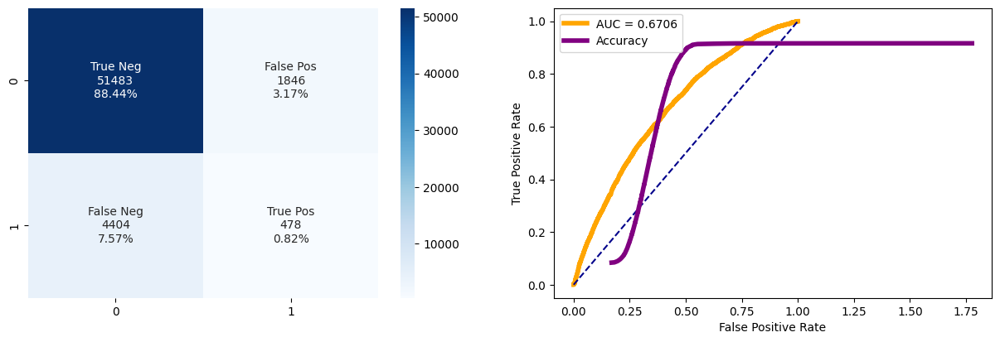

In [35]:
########## GRIDSEARCH CV ##########

# attention, bien mettre le modèle et __ avant nom du paramètre
param_grid = {
    'classification__depth' : [4, 5, 6, 7, 8, 9, 10],
    'classification__learning_rate' : [0.01, 0.02, 0.03, 0.04],
    'classification__iterations' : [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
             }

model = Pipeline([('sampling', SMOTE(sampling_strategy = 'auto')), ('classification', CatBoostClassifier())])

with mlflow.start_run(run_name = 'Fine tunning'):
    print(type(model).__name__)
    grid = GridSearchCV(
        model,
        param_grid,
        scoring = custom_score,
        cv = 5,
        verbose = 0,
        n_jobs = -1 # use all CPUs
        )

    # On entraîne la grille
    grid.fit(X_train, y_train)

    # Meilleur score obtenu: best_score_
    print(f'\nBest score = {grid.best_score_}')

    # Optimal hyperparameters: best_params_
    display(grid.best_params_)

    # Sauvegarder le meilleur modèle
    best_model = grid.best_estimator_

    # Predire
    y_pred_test_best = best_model.predict(X_test)
    y_pred_train_best = best_model.predict(X_train)

    # Visualisation des résultats
    fonctions.cf_matrix_roc_auc(best_model, y_test, X_test, best_model.predict(X_test), best_model.predict_proba(X_test)[:,1])

    mlflow.sklearn.log_model(model, 'CatBoostClassifier grid')
    # Log model configuration/params
    mlflow.log_params(grid.best_params_)
    mlflow.log_metric('custom', cost.custom_metric(y_test, best_model.predict(X_test)))
    mlflow.log_metric('AUC', roc_auc_score(y_test, best_model.predict_proba(X_test)[:,1]))
    mlflow.log_metric('Accuracy', accuracy_score(y_test, best_model.predict(X_test)))


In [36]:
# identifier les étapes du pipeline
model

Pipeline(steps=[('sampling', SMOTE()),
                ('classification',
                 <catboost.core.CatBoostClassifier object at 0x35a805910>)])

In [37]:
model.steps

[('sampling', SMOTE()),
 ('classification', <catboost.core.CatBoostClassifier at 0x35a805910>)]

In [38]:
Pipeline(steps = 'classification')

Pipeline(steps='classification')

0:	learn: 0.6850903	total: 18.7ms	remaining: 1.48s
1:	learn: 0.6779720	total: 35.7ms	remaining: 1.39s
2:	learn: 0.6717803	total: 51.5ms	remaining: 1.32s
3:	learn: 0.6657241	total: 67.4ms	remaining: 1.28s
4:	learn: 0.6598542	total: 83.8ms	remaining: 1.26s
5:	learn: 0.6528817	total: 99.8ms	remaining: 1.23s
6:	learn: 0.6475553	total: 116ms	remaining: 1.21s
7:	learn: 0.6423668	total: 132ms	remaining: 1.18s
8:	learn: 0.6372603	total: 147ms	remaining: 1.16s
9:	learn: 0.6316460	total: 164ms	remaining: 1.15s
10:	learn: 0.6242186	total: 182ms	remaining: 1.14s
11:	learn: 0.6196713	total: 197ms	remaining: 1.12s
12:	learn: 0.6155001	total: 213ms	remaining: 1.1s
13:	learn: 0.6093645	total: 230ms	remaining: 1.08s
14:	learn: 0.6041851	total: 246ms	remaining: 1.06s
15:	learn: 0.5982350	total: 272ms	remaining: 1.09s
16:	learn: 0.5942038	total: 290ms	remaining: 1.07s
17:	learn: 0.5918899	total: 307ms	remaining: 1.06s
18:	learn: 0.5853778	total: 324ms	remaining: 1.04s
19:	learn: 0.5786965	total: 341ms	re

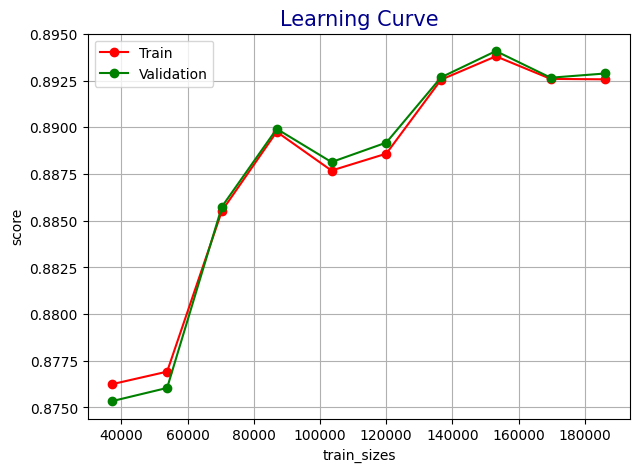

In [39]:
# Courbe d'apprentissage (learning curve)
# montre l'évolution des performances du modèle en fonction de la quantité de données qu'on lui fournit

N, train_score, val_score = learning_curve(best_model, X_train, y_train, train_sizes = np.linspace(0.2, 1.0, 10), cv = 5)

# Train sizes
print(f"Quantités de données à utiliser pour l'entrainement (10 lots): {N}")

# Learning curve
fonctions.plot_learning_curve(N, train_score, val_score)

In [40]:
best_model

Pipeline(steps=[('sampling', SMOTE()),
                ('classification',
                 <catboost.core.CatBoostClassifier object at 0x35a799b50>)])

## Feature importance

In [45]:
# https://stackoverflow.com/questions/62933365/how-to-get-the-feature-importance-in-gaussian-naive-bayes

In [46]:
# pour explicabilité globale

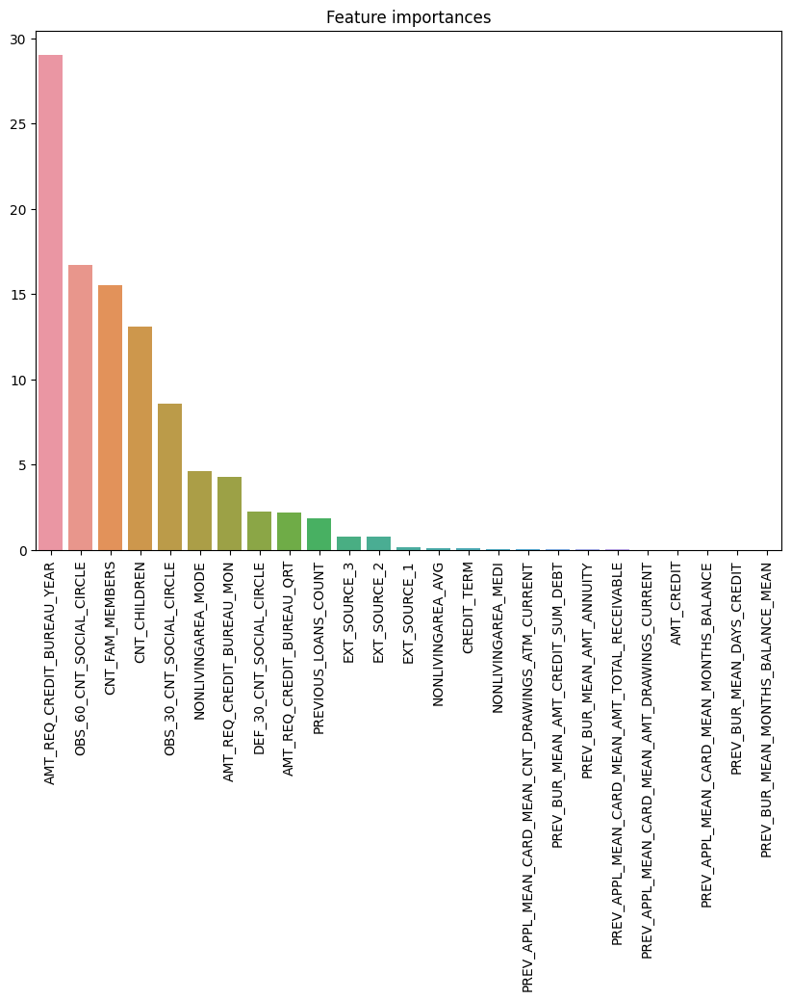

In [47]:
########## FEATURES IMPORTANTES ##########
# identifier les features importantes

# get importance
score = best_model.steps[1][1].feature_importances_
feature = X.columns #(pour ne pas prendre l'index)

# transformer en df pour visualiser plus facilement
df_feature = pd.DataFrame()
df_feature['feature'] = feature
df_feature['score'] = score

df_feature.sort_values(['score'], ascending = False, inplace = True)

# bar plot pour visualiser les 25 features les plus importantes
plt.figure(figsize = (10, 7))
plt.title('Feature importances')
sns.barplot(x = df_feature['feature'].values[:25], y = df_feature['score'].values[:25])
plt.xticks(rotation = 90)
plt.show()

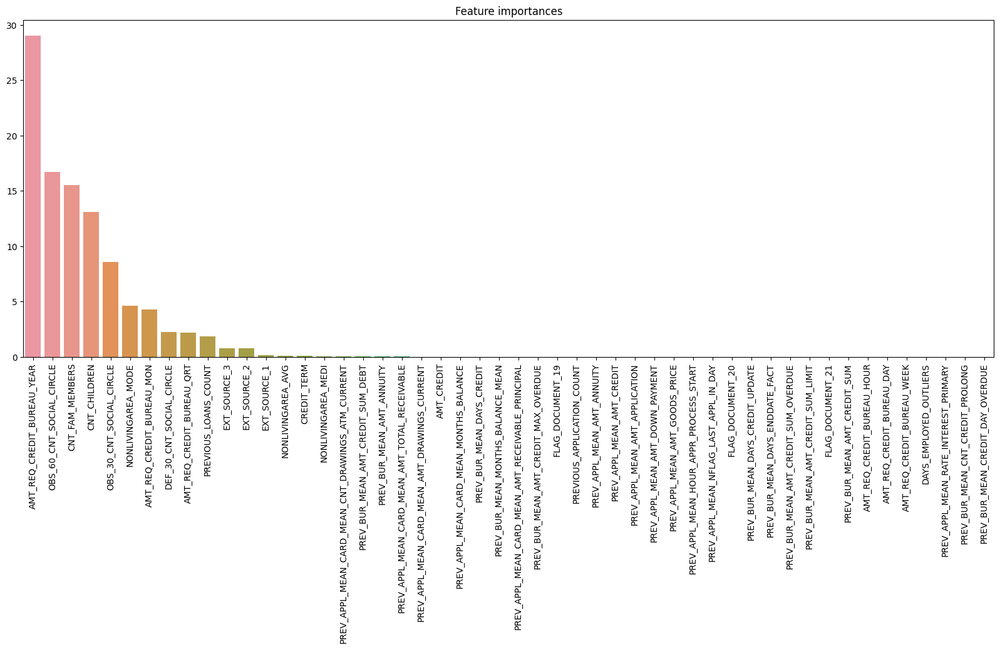

In [48]:
# bar plot pour visualiser toutes les features et leur importance
plt.figure(figsize = (20, 7))
plt.title('Feature importances')
sns.barplot(x = df_feature['feature'].values[:50], y = df_feature['score'].values[:50])
plt.xticks(rotation = 90)
plt.show()

In [49]:
# 6 features les plus importantes (DEFINIR UN SEUIL)
df_feature['feature'].values[:10]

array(['AMT_REQ_CREDIT_BUREAU_YEAR', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'CNT_FAM_MEMBERS', 'CNT_CHILDREN', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'NONLIVINGAREA_MODE', 'AMT_REQ_CREDIT_BUREAU_MON',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'PREVIOUS_LOANS_COUNT'], dtype=object)

In [50]:
# 'GaussianNB' object has no attribute 'fea_importances_'
# -> permutation importance

# EXPLIQUER CE QUE C'EST

# https://scikit-learn.org/stable/modules/generated/sklearn.inspection.permutation_importance.html#sklearn.inspection.permutation_importance

In [51]:
imps = permutation_importance(best_model, X_test, y_test)
print(imps.importances_mean)

[ 3.53885005e-04  0.00000000e+00 -4.81008744e-05  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  7.21513116e-04  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.22963014e-04
  2.42222260e-03  3.93396437e-03  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -1.32277405e-03
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.79196372e-04  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000

<Figure size 2000x1000 with 0 Axes>

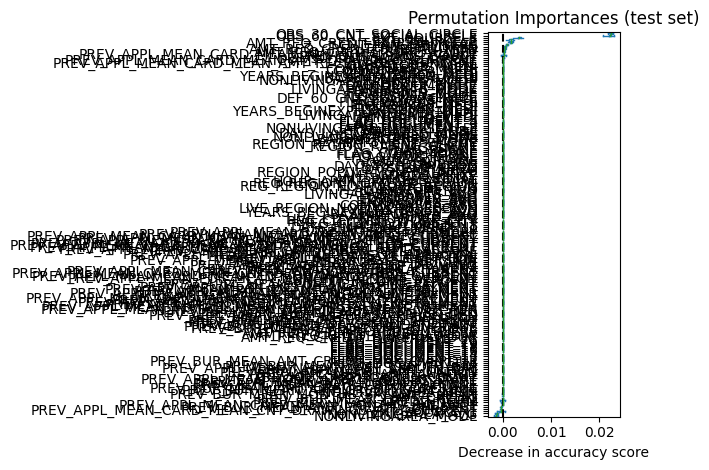

In [52]:
result = permutation_importance(
    estimator = best_model,
    X = X_test,
    y = y_test,
    scoring = None, # scorer to use - if None, the estimator’s default scorer is used
    n_repeats = 10, # Number of times to permute a feature
    random_state = 42,
    n_jobs = 2 # Number of jobs to run in parallel
)

sorted_importances_idx = result.importances_mean.argsort()
importances = pd.DataFrame(
    result.importances[sorted_importances_idx].T,
    columns = X.columns[sorted_importances_idx],
)
plt.figure(figsize = (20, 10))
ax = importances.plot.box(vert = False, whis = 10)
ax.set_title('Permutation Importances (test set)')
ax.axvline(x = 0, color = 'k', linestyle = '--')
ax.set_xlabel('Decrease in accuracy score') # HEIN
ax.figure.tight_layout()

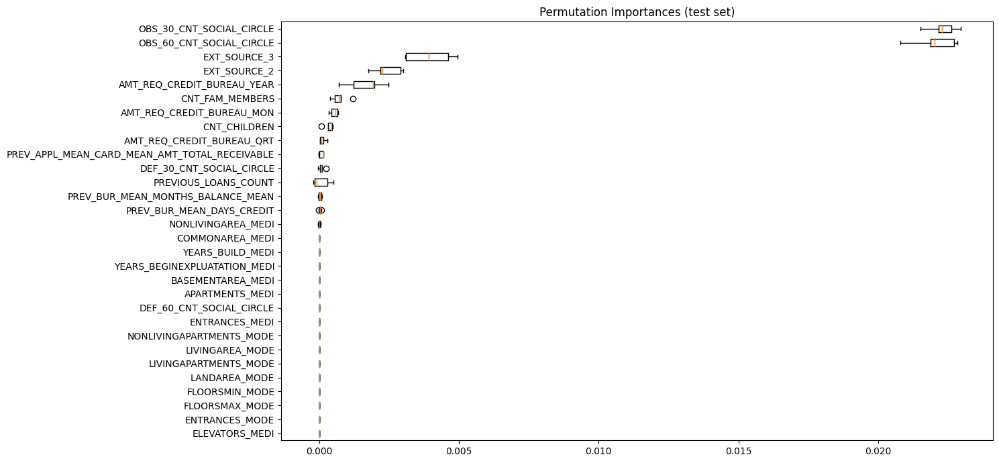

In [53]:
#sorted_idx = imps.importances_mean.argsort()
sorted_idx = imps.importances_mean.argsort()[-30:]

fig, ax = plt.subplots(figsize = (15, 7))
ax.boxplot(
    imps.importances[sorted_idx].T,
    vert = False,
    labels = X.columns[sorted_idx]
    )

ax.set_title('Permutation Importances (test set)')
fig.tight_layout()
plt.show()

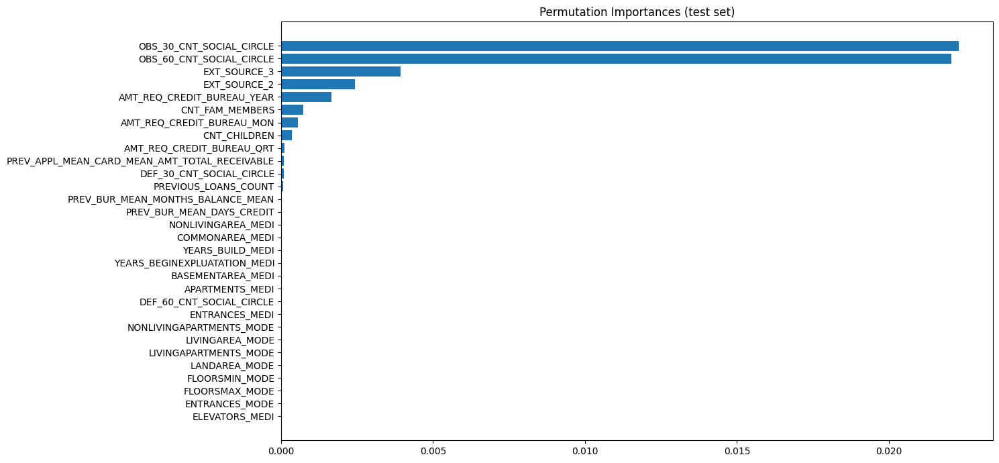

In [54]:
sorted_idx = imps.importances_mean.argsort()[-30:]

fig, ax = plt.subplots(figsize = (15, 7))
ax.barh(X.columns[sorted_idx], imps.importances[sorted_idx].mean(axis = 1).T)
ax.set_title('Permutation Importances (test set)')
fig.tight_layout()
plt.show()

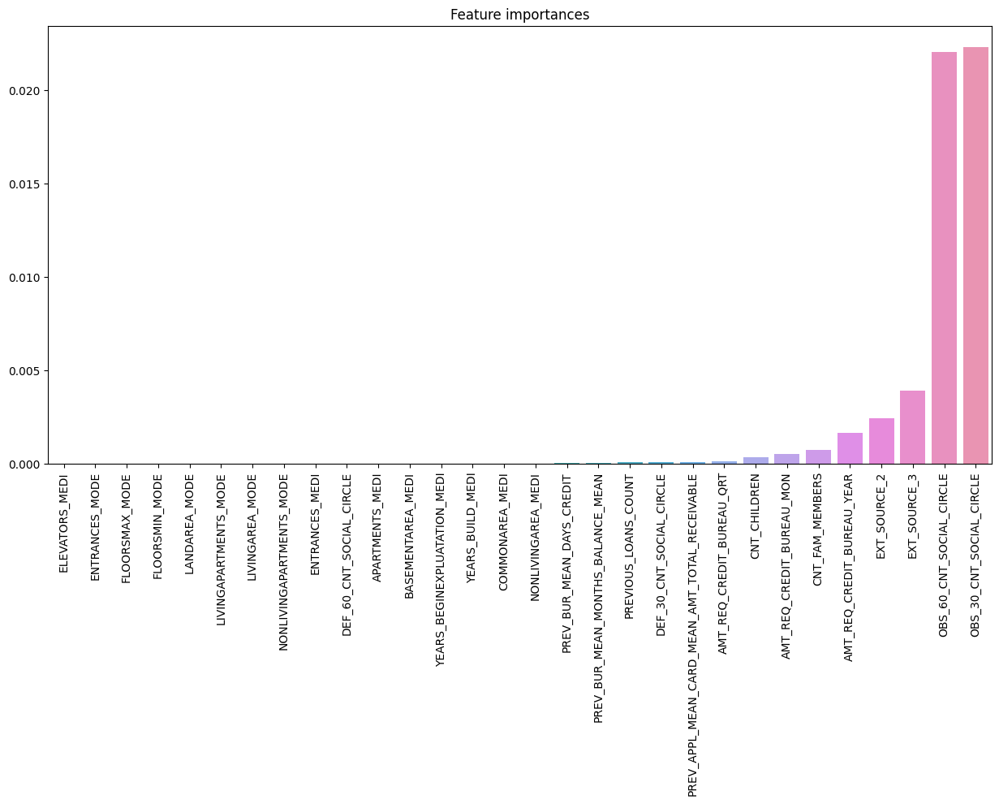

In [55]:
# bar plot pour visualiser les 25 features les plus importantes
plt.figure(figsize = (15, 7))
plt.title('Feature importances')
sns.barplot(y = imps.importances[sorted_idx].mean(axis = 1).T, x = X.columns[sorted_idx])
plt.xticks(rotation = 90)
plt.show()

In [56]:
# 6 features les plus importantes (DEFINIR UN SEUIL)
X.columns[sorted_idx]

Index(['ELEVATORS_MEDI', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE',
       'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE',
       'NONLIVINGAPARTMENTS_MODE', 'ENTRANCES_MEDI',
       'DEF_60_CNT_SOCIAL_CIRCLE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'NONLIVINGAREA_MEDI', 'PREV_BUR_MEAN_DAYS_CREDIT',
       'PREV_BUR_MEAN_MONTHS_BALANCE_MEAN', 'PREVIOUS_LOANS_COUNT',
       'DEF_30_CNT_SOCIAL_CIRCLE',
       'PREV_APPL_MEAN_CARD_MEAN_AMT_TOTAL_RECEIVABLE',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'CNT_CHILDREN',
       'AMT_REQ_CREDIT_BUREAU_MON', 'CNT_FAM_MEMBERS',
       'AMT_REQ_CREDIT_BUREAU_YEAR', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE'],
      dtype='object')

In [57]:
df_feature['feature'].values[:10]

array(['AMT_REQ_CREDIT_BUREAU_YEAR', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'CNT_FAM_MEMBERS', 'CNT_CHILDREN', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'NONLIVINGAREA_MODE', 'AMT_REQ_CREDIT_BUREAU_MON',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'PREVIOUS_LOANS_COUNT'], dtype=object)

In [15]:
best_model['classification'].feature_names_in_

array(['AMT_REQ_CREDIT_BUREAU_YEAR', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'AMT_REQ_CREDIT_BUREAU_MON', 'NONLIVINGAREA_MODE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'PREVIOUS_LOANS_COUNT', 'EXT_SOURCE_3'],
      dtype=object)

In [18]:
################### Reduction du jeu de données pour ne garder que les features les plus importantes #################
df_reduit = df[['AMT_REQ_CREDIT_BUREAU_YEAR', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'AMT_REQ_CREDIT_BUREAU_MON', 'NONLIVINGAREA_MODE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'PREVIOUS_LOANS_COUNT', 'EXT_SOURCE_3']]
#df_reduit = df[df_feature['feature'].values[:10]]
df_reduit.reset_index(drop = True, inplace = True)
df_reduit.head()

,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,CNT_FAM_MEMBERS,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_MON,NONLIVINGAREA_MODE,DEF_30_CNT_SOCIAL_CIRCLE,PREVIOUS_LOANS_COUNT,EXT_SOURCE_3
0,0.04,0.0,0.000000,0.005747,0.005814,0.0,0.000,0.058824,0.060870,0.155054
1,0.00,0.0,0.052632,0.002874,0.002907,0.0,0.000,0.000000,0.026087,0.597163
2,0.00,0.0,0.000000,0.000000,0.000000,0.0,0.001,0.000000,0.008696,0.814130
3,0.08,0.0,0.052632,0.005747,0.005814,0.0,0.001,0.000000,0.034783,0.597163
4,0.00,0.0,0.000000,0.000000,0.000000,0.0,0.001,0.000000,0.000000,0.597163


In [19]:
X = df_reduit
y = df_target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

print('train shape :', X_train.shape)
print('test shape :', X_test.shape)

print('train shape (target):', y_train.shape)
print('test shape (target):', y_test.shape)

train shape : (232842, 10)
test shape : (58211, 10)
train shape (target): (232842,)
test shape (target): (58211,)


In [9]:
######### SMOTE ###########

sm = SMOTE(
    k_neighbors = 5,
    sampling_strategy = 'auto',
    random_state = 0,
    n_jobs = None
    )

# Application du SMOTE aux données
X_train_smote, y_train_smote = sm.fit_resample(X_train, y_train)

In [61]:
# Liste des modèles qu'on souhaite tester

models = [
    DummyClassifier(), # modèle baseline
    KNeighborsClassifier(), # k-nearest neighbors
    LogisticRegression(), # Regression logistique
    GaussianNB(), # Naives Bayes
    CatBoostClassifier(logging_level = 'Silent'),
    LGBMClassifier(), # LightGBM
    DecisionTreeClassifier(), # Arbres de decision
    RandomForestClassifier(), # random forest
    AdaBoostClassifier(),
    GradientBoostingClassifier(), # gradient boosting
    XGBClassifier() # XGBoost - erreur sur mac perso mais pas pro
    ]

In [62]:
name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
custom = []
time_ = []

# Set our tracking server uri for logging
mlflow.set_tracking_uri(uri = 'http://127.0.0.1:8080')
mlflow.set_experiment(experiment_name = 'scoring')

<Experiment: artifact_location='mlflow-artifacts:/758371766557830604', creation_time=1714046714905, experiment_id='758371766557830604', last_update_time=1714046714905, lifecycle_stage='active', name='scoring', tags={}>

In [63]:
with mlflow.start_run(run_name = 'Test modèles'):
    for model in models:
        print(type(model).__name__)
        start = time.time()
        results = fonctions.train_models(model, X_train_smote, X_test, y_train_smote, y_test)

        name.append(type(model).__name__)
        auc.append(results['AUC'])
        accuracy.append(results['Accuracy'])
        precision.append(results['Precision'])
        recall.append(results['Recall'])
        f1.append(results['F1'])
        custom.append(results['Custom'])
        time_.append(time.time() - start)

        mlflow.sklearn.log_model(model, 'model')
        mlflow.log_metric('f1 score', results['F1'])
        mlflow.log_metric('custom', results['Custom'])

# Initialise data of lists
base_models = pd.DataFrame(data = [name, auc, accuracy, precision, recall, f1, custom, time_]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Custom', 'Time']
base_models.sort_values('AUC', ascending = False, inplace = True)
base_models.reset_index(drop = True, inplace = True)

DummyClassifier
KNeighborsClassifier
LogisticRegression
GaussianNB
CatBoostClassifier
LGBMClassifier
[LightGBM] [Info] Number of positive: 213879, number of negative: 213879
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2537
[LightGBM] [Info] Number of data points in the train set: 427758, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
DecisionTreeClassifier
RandomForestClassifier
AdaBoostClassifier
GradientBoostingClassifier
XGBClassifier


In [64]:
base_models.sort_values('Custom', ascending = False)

,Model,AUC,Accuracy,Precision,Recall,F1,Custom,Time
10,DummyClassifier,0.5,0.916133,0.0,0.0,0.0,4509,0.058181
2,GradientBoostingClassifier,0.628971,0.846953,0.144697,0.167964,0.155465,3835,33.642698
3,LGBMClassifier,0.628711,0.84417,0.130404,0.151372,0.140108,2782,1.710947
4,XGBClassifier,0.626367,0.842263,0.126477,0.149119,0.136868,2461,6.773683
5,CatBoostClassifier,0.625735,0.842212,0.123798,0.145023,0.133572,2275,20.612458
7,RandomForestClassifier,0.588475,0.821718,0.118863,0.175543,0.141747,1230,39.41872
1,AdaBoostClassifier,0.630973,0.759736,0.131953,0.334289,0.189217,989,8.280568
9,DecisionTreeClassifier,0.538156,0.783701,0.114511,0.234535,0.153888,-604,1.503861
0,LogisticRegression,0.654596,0.670543,0.130136,0.515158,0.207783,-1448,2.140226
8,KNeighborsClassifier,0.556458,0.746422,0.110542,0.287177,0.159636,-2631,44.252216


In [65]:
base_models.sort_values(['Custom', 'AUC', 'Accuracy'], ascending = False)

,Model,AUC,Accuracy,Precision,Recall,F1,Custom,Time
10,DummyClassifier,0.5,0.916133,0.0,0.0,0.0,4509,0.058181
2,GradientBoostingClassifier,0.628971,0.846953,0.144697,0.167964,0.155465,3835,33.642698
3,LGBMClassifier,0.628711,0.84417,0.130404,0.151372,0.140108,2782,1.710947
4,XGBClassifier,0.626367,0.842263,0.126477,0.149119,0.136868,2461,6.773683
5,CatBoostClassifier,0.625735,0.842212,0.123798,0.145023,0.133572,2275,20.612458
7,RandomForestClassifier,0.588475,0.821718,0.118863,0.175543,0.141747,1230,39.41872
1,AdaBoostClassifier,0.630973,0.759736,0.131953,0.334289,0.189217,989,8.280568
9,DecisionTreeClassifier,0.538156,0.783701,0.114511,0.234535,0.153888,-604,1.503861
0,LogisticRegression,0.654596,0.670543,0.130136,0.515158,0.207783,-1448,2.140226
8,KNeighborsClassifier,0.556458,0.746422,0.110542,0.287177,0.159636,-2631,44.252216


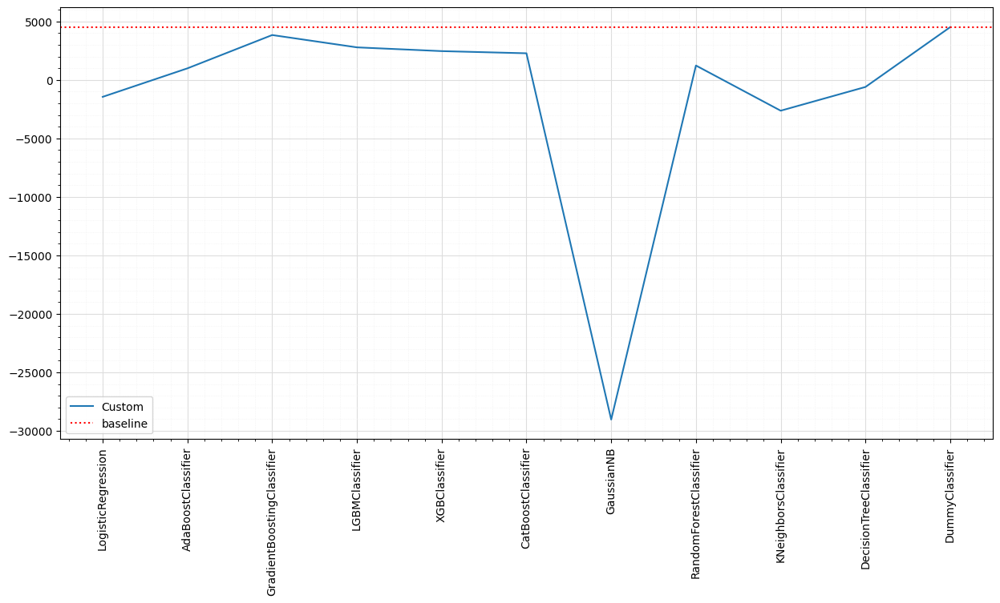

In [66]:
# plot results métrique custom only
base_models_custom = base_models[['Model', 'Custom']]

plt.figure(figsize = (15, 7))
for i in base_models_custom.drop(['Model'], axis = 1).columns:
    plt.plot(base_models_custom['Model'], base_models_custom[i], label = i)
plt.axhline(y = 4509, color = 'r', linestyle = ':', label = 'baseline')
plt.legend(loc = 'best')
plt.grid(which = 'major', color = '#DDDDDD', linewidth = 0.8)
plt.grid(which = 'minor', color = '#EEEEEE', linestyle = ':', linewidth = 0.5)
plt.minorticks_on()
plt.xticks(rotation = 90)
plt.show()

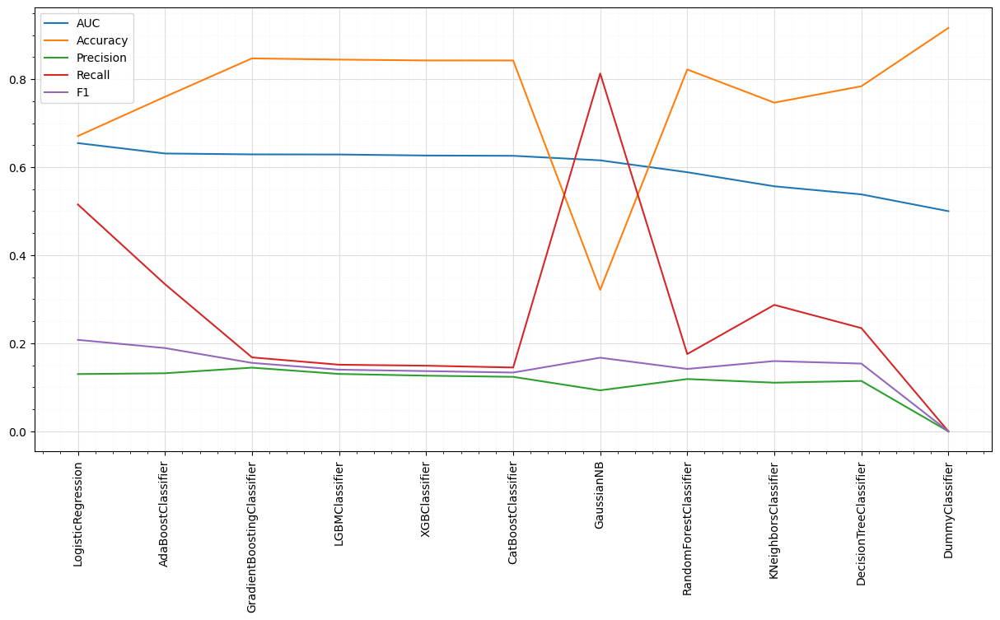

In [67]:
# plot results métrique sans custom
base_models_sans_custom = base_models[['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1']]

plt.figure(figsize = (15, 7))
for i in base_models_sans_custom.drop(['Model'], axis = 1).columns:
    plt.plot(base_models_sans_custom['Model'], base_models_sans_custom[i], label = i)
plt.legend(loc = 'best')
plt.grid(which = 'major', color = '#DDDDDD', linewidth = 0.8)
plt.grid(which = 'minor', color = '#EEEEEE', linestyle = ':', linewidth = 0.5)
plt.minorticks_on()
plt.xticks(rotation = 90)
plt.show()

In [68]:
# CHOISIR LE BEST MODEL ET FAIRE GRIDSEARCH
# -> best modèle = GradientBoostingClassifier

In [12]:
########## GRIDSEARCH CV ##########

# attention, bien mettre le modèle et __ avant nom du paramètre
# param_grid -> besoin de réduire la selection -> kernel crash 3 fois de suite...

param_grid = {
#    "classification__loss":["deviance"],
    "classification__learning_rate": [0.01, 0.025, 0.05, 0.075, 0.1, 0.15, 0.2],
#    "classification__min_samples_split": np.linspace(0.1, 0.5, 12),
#    "classification__min_samples_leaf": np.linspace(0.1, 0.5, 12),
    "classification__max_depth":[3, 5, 7, 8],
#    "classification__max_features":["log2","sqrt"],
#    "classification__criterion": ["friedman_mse",  "mae"],
#    "classification__subsample":[0.5, 0.618, 0.8, 0.85, 0.9, 0.95, 1.0],
    "classification__n_estimators":[10, 50, 100, 200]
             }

model = Pipeline([('sampling', SMOTE(sampling_strategy = 'auto')), ('classification', GradientBoostingClassifier())])

with mlflow.start_run(run_name = 'Fine tunning'):
    print(type(model).__name__)
    grid = GridSearchCV(
        model,
        param_grid,
        scoring = custom_score,
        cv = 5,
        verbose = 1,
        n_jobs = -1 # use all CPUs
        )

    # On entraîne la grille
    grid.fit(X_train, y_train)

    # Meilleur score obtenu: best_score_
    print(f'\nBest score = {grid.best_score_}')

    # Optimal hyperparameters: best_params_
    display(grid.best_params_)

    # Sauvegarder le meilleur modèle
    best_model = grid.best_estimator_

    # Predire
    y_pred_test_best = best_model.predict(X_test)
    y_pred_train_best = best_model.predict(X_train)

    mlflow.sklearn.log_model(model, 'GradientBoostingClassifier grid')
    # Log model configuration/params
    mlflow.log_params(grid.best_params_)
    mlflow.log_metric('custom', cost.custom_metric(y_test, best_model.predict(X_test)))
    mlflow.log_metric('AUC', roc_auc_score(y_test, best_model.predict_proba(X_test)[:,1]))
    mlflow.log_metric('Accuracy', accuracy_score(y_test, best_model.predict(X_test)))

Pipeline
Fitting 5 folds for each of 112 candidates, totalling 560 fits


/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/homebrew/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d


Best score = 4211.8


{'classification__learning_rate': 0.025,
 'classification__max_depth': 5,
 'classification__n_estimators': 100}

Quantités de données à utiliser pour l'entrainement (10 lots): [ 37254  53812  70369  86927 103485 120042 136600 153157 169715 186273]


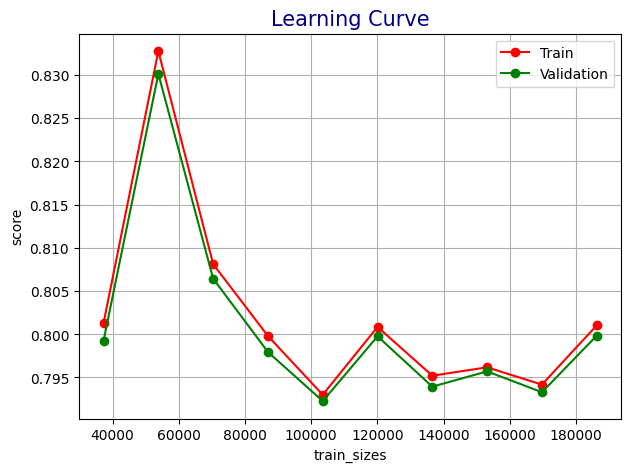

In [13]:
# Courbe d'apprentissage (learning curve)
# montre l'évolution des performances du modèle en fonction de la quantité de données qu'on lui fournit

N, train_score, val_score = learning_curve(best_model, X_train, y_train, train_sizes = np.linspace(0.2, 1.0, 10), cv = 5)

# Train sizes
print(f"Quantités de données à utiliser pour l'entrainement (10 lots): {N}")

# Learning curve
fonctions.plot_learning_curve(N, train_score, val_score)

### Seuil de classification

In [ ]:
# seuil du score de classification :
# -> par défaut = 0,5
# cependant, valeur par défaut n'est pas forcément la valeur optimale

# -> le faire varier et prendre le seuil qui nous permet d'obtenir le meilleur score

In [22]:
def gain_seuil(model, X_test, y_test):

    """
    Evolution du gain en fonction du seuil de solvabilité fixé
    Si score < seuil : client solvable
    Sinon : client non solvable
    """

    cost_function = []
    threshold_x = np.linspace(0.0, 1, 20)

    for threshold in threshold_x:

        # Score du modèle : 0 à 1
        y_scores = model.predict(X_test)

        # Score > seuil de solvabilité : retourne 1 sinon 0
        y_pred = (y_scores > threshold)
        y_pred = np.array(y_pred > 0) * 1

        # Calcul de l'indice bancaire
        cost_function.append(cost.custom_metric(y_test, y_pred))

    # Affichage du gain en fonction du seuil de solvabilité
    plt.plot(threshold_x, cost_function)
    plt.xlabel('Seuil de classification')
    plt.ylabel('Score métier')
    plt.title('Définition du seuil de classification optimal')
    plt.xticks(np.linspace(0.1, 1, 10))

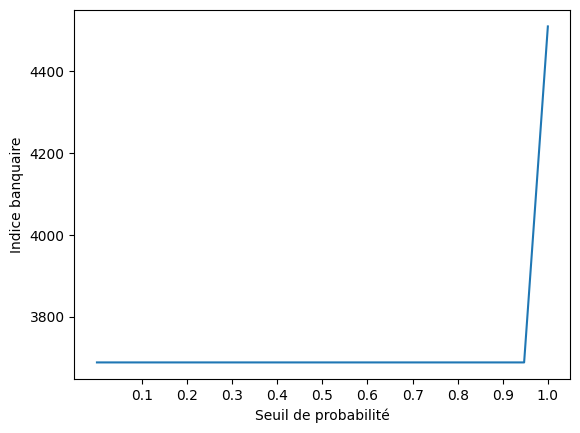

In [23]:
# Affiche le meilleur seuil de probabilité
gain_seuil(best_model, X_test, y_test)

In [ ]:
### seuil d'acceptation -> pourtant simple ici non ? positif, on gagne de l'argent, négatif on en perd
# Classify as 'Credit accepted' if probability of class 0 is greater than 0.5

### Feature importance locale

In [ ]:
# SHAP

# https://www.kaggle.com/code/wrosinski/shap-feature-importance-with-feature-engineering
# https://www.datacamp.com/tutorial/introduction-to-shap-values-machine-learning-interpretability
# https://maxsteele731.medium.com/shap-force-plots-for-classification-d30be430e195

In [ ]:
# SHAP est une méthode d'interprétation de modèles d'apprentissage automatique qui permet de comprendre comment les caractéristiques 
# d'entrée affectent les prédictions du modèle.

# Shapley values give us a metric for evaluating the importance of a predictor relative to other predictors
# Essentially these values take into account how the loss function (model error) is affected by knowing vs. not knowing about that predictive feature.
# These values also indicate the direction of the relationship (positive or negative) between the predictive feature and the target variable.

In [ ]:
# SHAP EXPLAINERS
# explainer = algorithme ou une méthode utilisée pour expliquer les prédictions d'un modèle d'apprentissage automatique
# SHAP fournit différents types d'explainers pour expliquer les prédictions des modèles d'apprentissage automatique
# Le choix du type d'explainer dépend du type de modèle qu' on veut utiliser et de la complexité de l'ensemble de données

# - Exact :
# Cet explainer calcule les valeurs SHAP exactes pour les modèles linéaires et les arbres de décision peu profonds. 
# Il est généralement très rapide, mais ne peut pas être utilisé pour les modèles plus complexes.

# - TreeExplainer :
# Cet explainer est conçu pour les modèles basés sur les arbres, tels que les forêts aléatoires et les gradient boosting machines.
# Il utilise une approche d'agrégation pour calculer les valeurs SHAP approximatives pour chaque échantillon.

# - DeepExplainer :
# Cet explainer est conçu pour les réseaux de neurones profonds.
# Il utilise une approche de rétropropagation pour calculer les valeurs SHAP approximatives pour chaque échantillon.

# - KernelExplainer :
# Cet explainer est un explainer générique qui peut être utilisé pour n'importe quel modèle.
# Il utilise une approche de régression pondérée pour calculer les valeurs SHAP approximatives pour chaque échantillon.
# Cependant, il peut être plus lent que les autres explainers pour les modèles plus complexes.

# - PermutationExplainer :
# Il est conçu pour les modèles qui ne sont pas basés sur les arbres ou les réseaux de neurones profonds, mais qui peuvent être trop complexes 
# pour Exact ou KernelExplainer. PermutationExplainer utilise une approche de perturbation pour calculer les valeurs SHAP approximatives. 
# Il fonctionne en permutant aléatoirement les valeurs des caractéristiques d'entrée pour chaque échantillon, puis en calculant la différence 
# entre la prédiction du modèle pour l'échantillon original et la prédiction pour l'échantillon perturbé. 
# Les valeurs SHAP sont ensuite calculées en utilisant une approche de régression pondérée similaire à KernelExplainer. 
# PermutationExplainer peut être utile pour les modèles qui ont des interactions de caractéristiques complexes ou non linéaires, 
# car il peut capturer ces interactions en perturbant les valeurs des caractéristiques. Cependant, il peut être plus lent que les 
# autres explainers pour les grands ensembles de données ou les modèles très complexes. En résumé, PermutationExplainer est un choix approprié pour 
#les modèles qui ne sont pas basés sur les arbres ou les réseaux de neurones profonds, mais qui ont des interactions de caractéristiques 
# complexes ou non linéaires. Cependant, il peut être plus lent que les autres explainers pour les grands ensembles de données ou les 
# modèles très complexes.

# l n'existe pas de méthode de sélection formalisée pour choisir le bon type d'explainer pour un ensemble de données donné. 
# Le choix de l'explainer dépend du type de modèle qu'on utilise, de la complexité de l'ensemble de données et des objectifs en matière d'interprétabilité.
# -> essayer différents types d'explainers et comparer leurs résultats pour choisir le meilleur explainer pour notre cas


In [ ]:
# pas besoin de suréchantillonner les données avant shap car on a déjà utilisé smote -> risquerait au contraire de créer un déséquilibre encore plus important

In [19]:
best_model['classification']

GradientBoostingClassifier(learning_rate=0.025, max_depth=5)

In [ ]:
########## Shap - Force plot ###########

# KERNEL EXPLAINER

# Utilisez SHAP pour expliquer les prédictions du modèle sur les données d'entraînement d'origine
#explainer_mcr = shap.KernelExplainer(best_model['classification'].predict_proba, X_train)
#shap_values = explainer_mcr.shap_values(X_train)

# Calculez la valeur de base comme la moyenne des prédictions du modèle sur vos données d'entraînement
#base_value = np.mean(best_model.predict_proba(X_train)[:, 1])

# Utilisez shap.force_plot avec la valeur de base calculée et la première échantillon
#shap.force_plot(base_value, shap_values[0], X_train.iloc[0], feature_names = X_train.columns)

# Beeaucoup trop long (rage quit au bout de plus de 300min)
# -> prendre échantillon

In [21]:
########## Shap - Force plot ###########

shap.initjs() # -> à appeler avant de créer et d'afficher les visualisations intéractives shap (permet d'initialiser les dépendances JavaScript)

# Assuming you have `best_model` already trained and `X_train` data available

# Sample a smaller subset from X_train
sample_X_train = shap.sample(X_train, 10000)

# Get the base value using the mean prediction for the sample
base_value = np.mean(best_model['classification'].predict_proba(sample_X_train)[:, 1])

# Calculate SHAP values for the same sample
explainer = shap.Explainer(best_model['classification'], X_train, feature_names = sample_X_train.columns)
shap_values = explainer(sample_X_train)

# Use shap.force_plot with the calculated base_value and the first sample's shap values
shap.force_plot(base_value, shap_values.values[0], sample_X_train.iloc[0], feature_names = sample_X_train.columns)

 98%|===================| 9834/10000 [00:12<00:00]        

In [ ]:
# en rouge : features that pushed the model score higher
# en bleu (absent ici) : features that pushed the model score lower
# les features qui ont le plus d'impact sur le score sont située prêt de la zone de division entre rouge et bleu et taille de l'impact est représenté par la taille de la barre

In [21]:
########## Shap - Force plot ###########
# SHAP force plots show the features from left to right, with the positive contributions on the left and the negative contributions on the right

# Sample a smaller subset from X_train
sample_X_train = shap.sample(X_train, 10000)

# Create a SHAP explainer and compute SHAP values for the sample
explainer_mcr = shap.Explainer(best_model['classification'].predict_proba, X_train, feature_names = sample_X_train.columns)
shap_values = explainer_mcr(sample_X_train)

# Get the base value from the explainer
base_value = shap_values.base_values[0][1]  # For binary classification, expected_value is a list

# Use shap.force_plot with the calculated base_value and the first sample's shap values
shap.force_plot(base_value, shap_values.values[0][:, 1], sample_X_train.iloc[0], feature_names = sample_X_train.columns)

ExactExplainer explainer: 10001it [13:22, 12.31it/s]                          


In [22]:
explainer = shap.Explainer(best_model.named_steps['classification'])
shap_values = explainer.shap_values(X_test)
shap_values

array([[-2.53158738e-04, -5.78257229e-05, -1.01883592e-03, ...,
        -1.67199171e-03, -1.15567791e-01,  1.42885757e-01],
       [ 5.37709154e-04, -5.27762228e-05, -4.00274893e-04, ...,
        -1.54269081e-03,  5.86351089e-02,  1.97852060e-01],
       [ 5.55686063e-03,  1.34300440e-04,  1.32545687e-02, ...,
        -1.63265693e-03, -1.35612517e-01, -4.92524103e-01],
       ...,
       [-3.36047763e-03,  1.91025482e-04, -1.02232341e-03, ...,
        -1.96210384e-02, -1.38543192e-01, -3.42172130e-02],
       [-2.30229020e-04, -1.25639181e-05,  1.63162474e-03, ...,
         9.34159128e-03, -9.54594747e-03, -5.67323762e-01],
       [ 7.27684756e-03,  5.16885383e-05, -4.82325891e-03, ...,
        -1.63265693e-03, -1.52022036e-01, -4.58804419e-01]])

In [28]:
########## Shap - Bar plot ###########
# Sample a smaller subset from X_test to speed up computation
sample_X_test = shap.sample(X_test, 1000)  # Adjust the sample size as needed

# Create a SHAP explainer using the sampled data
explainer = shap.Explainer(best_model['classification'].predict_proba, sample_X_test, feature_names = sample_X_test.columns)

# Compute SHAP values for the sampled test set
shap_values = explainer(sample_X_test)

# shap values pour la classe positive
shap_values_positive_class = shap_values[:, :, 1]

# Use shap.bar_plot with the SHAP values for the positive class
shap.bar_plot(shap_values_positive_class, max_display = len(df_reduit.columns))

ExactExplainer explainer: 1001it [01:20, 11.12it/s]                          


ValueError: Cannot use array of shape (10, 0) as subkey.

ExactExplainer explainer: 1001it [01:17, 11.24it/s]                          


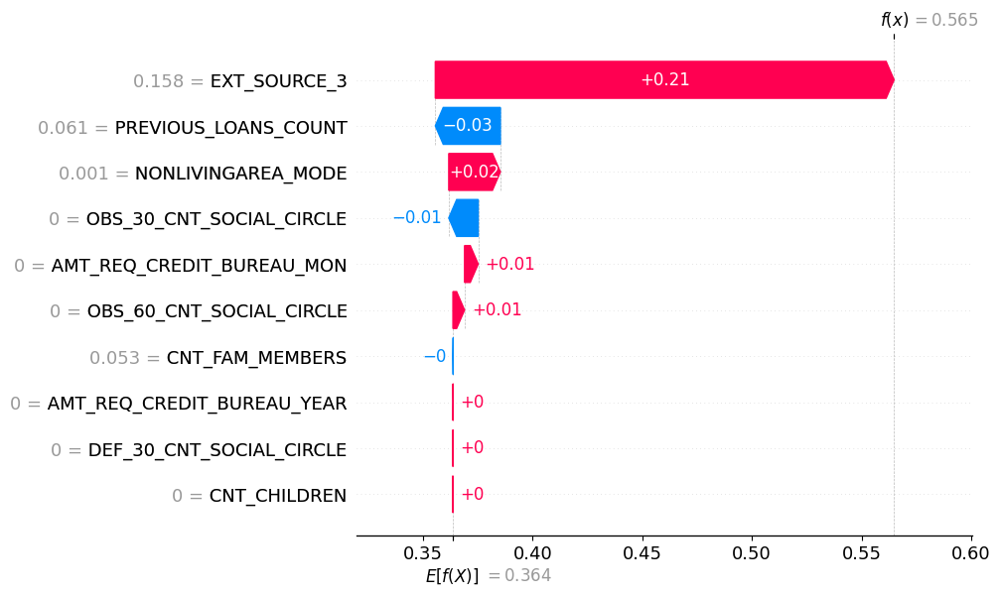

In [33]:
########## Shap - Waterfall_plot ##########
# fournit une vue détaillée des contributions de chaque caractéristique individuelle à une prédiction
# permet de visualiser de manière détaillée et interprétable les contributions individuelles des caractéristiques à la prédiction d'un modèle,
# facilitant ainsi l'interprétation

# échantillon réduit (sinon temps d'execution très long)
sample_X_test = shap.sample(X_test, 1000)

# créer un SHAP explainer en utilisant l'échantillon de X_test
explainer = shap.Explainer(best_model['classification'].predict_proba, sample_X_test)

# calculer les shap values pour l'échantillon test
shap_values = explainer(sample_X_test)

# créer le waterfall_plot avec les shap values pour le 1er échantillon et la classe positive (1)
shap.waterfall_plot(shap_values[0, :, 1], max_display = len(df_reduit.columns))

In [22]:
# save explainer
explainerFileSave = open('explainer', 'wb')
pickle.dump(explainer, explainerFileSave)

In [ ]:
# SHAP tutoriel :
# https://coderzcolumn.com/tutorials/machine-learning/shap-explain-machine-learning-model-predictions-using-game-theoretic-approach

# + cf notebook colab dans dossier cours

In [ ]:
#'AMT_REQ_CREDIT_BUREAU_YEAR' = Number of enquiries to Credit Bureau about the client one day year (excluding last 3 months before application)
#'OBS_60_CNT_SOCIAL_CIRCLE' = "How many observation of client's social surroundings with observable 60 DPD (days past due) default"
#'CNT_FAM_MEMBERS' = nombre de personnes dans la famille
#'CNT_CHILDREN' = nombre d'enfants qu'a le client
#'OBS_30_CNT_SOCIAL_CIRCLE' = "How many observation of client's social surroundings with observable 30 DPD (days past due) default"
#'NONLIVINGAREA_MODE' = 'Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor'
#'AMT_REQ_CREDIT_BUREAU_MON' = 'Number of enquiries to Credit Bureau about the client one month before application (excluding one week before application)'
#'DEF_30_CNT_SOCIAL_CIRCLE' = "How many observation of client's social surroundings defaulted on 30 DPD (days past due) "
#'AMT_REQ_CREDIT_BUREAU_QRT' = 'Number of enquiries to Credit Bureau about the client 3 month before application (excluding one month before application)'
#'PREVIOUS_LOANS_COUNT'

In [ ]:
# utiliser mon approche pour "trier" mes features et ne garder que celles qui sont vraiment importantes
# importance global -> s'appuyer sur coef d'importance
# importance "locale" -> utiliser shap
# regarder importance des features et regarder plus localement: pour une prédiction, à quel point chaque feature à joué
# pouvoir expliquer à la fin pourquoi on refuse ou accèpte un crédit (salaire, age...) pour chaque individu

In [ ]:
# implémenter api avant de passer du temps sur le dash (heroku) et déploiement
# modèle "static" -> on l'entraine une fois, on le sauvegarde et on le met derrière une api
# ok si dashboard qui fait appel à l'api tourne en local (peut être plus simple)

In [ ]:
# TO DO
# analyse de data drift
# https://docs.evidentlyai.com/presets/data-drift
# -> sortir un tableau HTML d'analyse de data drift réalisé à partir d'evidently

In [28]:
# export du modèle
# => "sérialisation du modèle"

# save the model
pickle.dump(best_model, open('utils/best_model.pkl', 'wb'))

In [29]:
# load the model from disk
best_model = pickle.load(open('utils/best_model.pkl', 'rb'))

In [24]:
# Export des données séparées en train et en test (pour l'analyse de data drift)

# X_test
filesave = open('data/X_test', 'wb')
pickle.dump(X_test, filesave)

In [25]:
# y_test
filesave = open('data/y_test', 'wb')
pickle.dump(y_test, filesave)

In [ ]:
# streamlit tuto
# https://www.datacamp.com/tutorial/streamlit

In [ ]:
# QUESTIONS

# ordre des étapes :



# data drift -> tableau HTML ????? -> cf notebook
# engendre baisse perf du modèle

# features importantes -> que faire si ne sont pas des variables "classiques" ?
# -> ext source etc... soit je prends l'hypothèse que les clients savent ce que c'est et je garde, soit je prends l'hypothèse que non et je choisis d'autres features
# autre possibilité : les sortir du jeu de données et rerun pour voir l'impact de leur absence sur les bénéfices

# fichier introductif + note méthodologique ?? -> à rédiger avec phrases et tout

# dashboard -> aller à l'essentiel
# -> se focaliser sur page prédiction
# -> possible aussi de réduire et de n'avoir que le selection du client ID pour savoir si oui ou non le pret est accordé
# -> utiliser shap pour interpretabilité du résultat
# -> voir s'il existe un outil pour checker compliance de mon dash (handicap etc)